In [93]:
import numpy as np
import matplotlib.pyplot as plt
import math

In [3]:
#plot 
# data的数据格式{x1,x2,y} x1 x2为点坐标y为其标签
# 决策边界 w 与 b 画一个线来分类两个点
def plot_with_line(data,w,b):
    
    x_1_list = [] #存放所有标签为1的数据
    x_0_list = [] #存放所有标签为0的数据
    
    fig = plt.figure()  
    ax1 = fig.add_subplot(111)  
    #设置标题  
    ax1.set_title('Logistics Logression')  
    #设置X轴标签  
    plt.xlabel('X1')  
    #设置Y轴标签  
    plt.ylabel('X2')  
    
    for index in range(np.shape(data)[0]): 
        if(data[index,3] == 1):
            x_1_list.append([data[index,0],data[index,1]])
        else:
            x_0_list.append([data[index,0],data[index,1]])
            
    x_0 = np.array(x_0_list)        
    x_1 = np.array(x_1_list)
    
    #画对应的散点图与决策边界
    ax1.scatter(x_0[...,0],x_0[...,1],c = 'r',marker = 'o')  
    ax1.scatter(x_1[...,0],x_1[...,1],c = 'g',marker = 'x')  
    
    #确定边界函数的定义域，所有点的最小值与最大值作为画图的x范围
    if(min(x_0[...,0]) > min(x_1[...,0])):
       l = min(x_1[...,0]) 
    else:
       l = min(x_0[...,0]) 

    if(max(x_0[...,0]) > max(x_1[...,0])):
       h = max(x_0[...,0]) 
    else:
       h = max(x_1[...,0])
    
    w_x = np.linspace(l,h,100)
    w_y = w * w_x + b
    
    ax1.plot(w_x,w_y)
    
    #显示所画的图  
    plt.show() 
     
def plot(data):
    
    x_1_list = [] #存放所有标签为1的数据
    x_0_list = [] #存放所有标签为0的数据
    
    fig = plt.figure()  
    ax1 = fig.add_subplot(111)  
    #设置标题  
    ax1.set_title('Logistics Logression')  
    #设置X轴标签  
    plt.xlabel('X1')  
    #设置Y轴标签  
    plt.ylabel('X2')  
    
    for index in range(np.shape(data)[0]): 
        if(data[index,3] == 1):
            x_1_list.append([data[index,0],data[index,1]])
        else:
            x_0_list.append([data[index,0],data[index,1]])
            
    x_0 = np.array(x_0_list)        
    x_1 = np.array(x_1_list)
    
    #画对应的散点图与决策边界
    ax1.scatter(x_0[...,0],x_0[...,1],c = 'r',marker = 'o')  
    ax1.scatter(x_1[...,0],x_1[...,1],c = 'g',marker = 'x')  
    
    #显示所画的图  
    plt.show()  

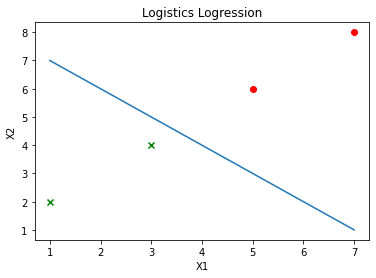

In [213]:
data=np.array([[1,2,1,1],[3,4,1,1],[7,8,1,0],[5,6,1,0]])
plot_with_line(data,-1,8)

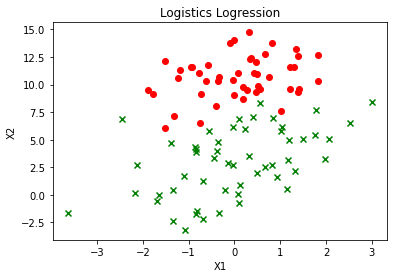

In [4]:
def loadData(data_url):
    train_x = []
    train_y = []
    data_all =[]

    file = open(data_url)
    for line in file.readlines():
        lineArr=line.strip().split()
        train_x.append([float(lineArr[0]),float(lineArr[1]),1])
        train_y.append(float(lineArr[2]))
        
        data_all.append([float(lineArr[0]),float(lineArr[1]),1,float(lineArr[2])])
        
    train_x_array = np.array(train_x)
    train_y_array = np.array(train_y)
    data_all_array = np.array(data_all)
                         
    return train_x_array,train_y_array,data_all_array

(xdata,ydata,allData)=loadData('../../data/data.d')
plot(allData)

# 总体回归思路

$$z=w1*x1+w2*x2+b $$$$\downarrow$$$$\hat{y}=a=\sigma(z)$$$$\downarrow$$$$L(a,y)=-(yln(a)+(1-y)ln(1-a))$$

目的是找一个最佳的{w1,w2,b}参数集合，使得损失函数L(a,y)最小。

In [8]:
#准备sigmoid函数
def sigmod(x):
    rlt = 1.0 /(1.0 + (math.exp(-1.0 * x)))
    return rlt

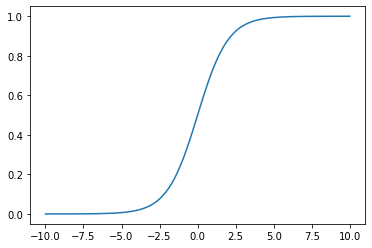

In [9]:
#测试sigmoid函数
t = np.linspace(-10,10,100)
y=[]
for i in t:
    y.append(sigmod(i))

plt.plot(t,y)

# 1 随机取80%数据作为训练集 20%数据作为测试集

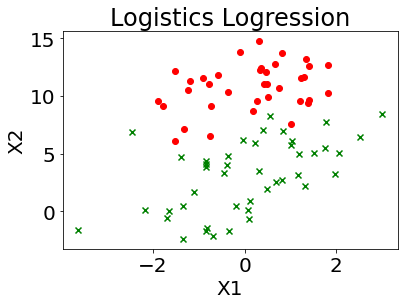

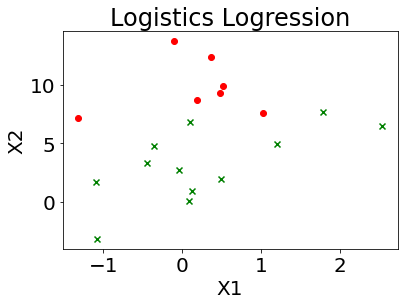

In [95]:
#输入全体数据 x =(x1,x2) y={0,1} 随机取80%作为训练集 20%作为测试集合
def prepare_train_and_test_data():
    (xdata,ydata,allData)=loadData('../../data/data.d')
    #获取行数的顺序编号
    trainIndex = np.arange(allData.shape[0])
    #随机打乱行号编号
    np.random.shuffle(trainIndex)
    #获得其中随机取到的行数据
    tran_data = allData[trainIndex[0:80]]
    test_data = allData[trainIndex[80:99]]
    
    return tran_data,test_data

(train,test_data) = prepare_train_and_test_data()

plot(train)
plot(test)

# 正向传播


$$z=w1*x1+w2*x2+b $$$$\downarrow$$$$\hat{y}=a=\sigma(z)$$$$\downarrow$$$$L(a,y)=-(yln(a)+(1-y)ln(1-a))$$

由输入的w0 w1 b 算出对于的线性变化z,然后将z激活。得到每一个样本点的a,计算损失函数L(a,$y^{i}$)求和,得到w0 w1 b 这一组参数的损失值。

In [10]:
#正向传播
# w 是一行三列的数组(w1,w2,b)
# tran_data是m行4列的数组(x1,x2,1,y)
def forword_cal(w,tran_data):
    #最后一列是样本的y值，将其取出
    tran_y_data = tran_data[...,3]
    #tran_data数据格式 (x1,x2,1,y)删除最后一列y值
    #np.delete输入参数（待操作数组,删除的index，0是行1是列）
    tran_data= np.delete(tran_data,3,1) 
    #print(tran_data)
    #初始参数对数据进行线性变化(1,3) muti (3 * 80)
    #print(np.shape(w))
    #print(np.shape(tran_data.transpose()))
    z = np.dot(w,tran_data.transpose())
    
    a=[] #a是z经过sigma函数后的元组
    for z_ind in z[0,...]:
        a.append(sigmod(z_ind))
    
    #由理论得到的损失函数 L = 求和 -(yi *ln a/(1-a)) + ln(1-a))
    L=[]
    for index in range(0,len(a)):
        L.append(- tran_y_data[index] * math.log(a[index]/(1-a[index])) - math.log(1-a[index]))
    
    #print(L)
    L_result = np.sum(L)
    
    return L_result

#当w取[1,0,0]也就是 y=x1+0 * x2 + 0作为边界的损失是68
w = np.array([[1,0,0]])
print(forword_cal(w,train))

#当w取[0.5,0,0]也就是 y=x1+0 * x2 + 0作为边界的损失是68
w = np.array([[0.5,0,0]])
print(forword_cal(w,train))

#当w取[0.25,0,0]也就是 y=x1+0 * x2 + 0作为边界的损失是68
w = np.array([[0.25,0,0]])
print(forword_cal(w,train))


69.14530402276836
59.66219028046573
56.78649847338521


# 反向误差传播

确定了正向传播的规则，接下来当务之急是找到w的变化方向，使得其迭代多次后代入损失函数最小。


$$\frac{\partial z}{\partial w1}=x_1$$ $$\frac{\partial z}{\partial w2}=x_2$$$$\frac{\partial z}{\partial b}=1$$$$\uparrow$$$$ \frac{\partial a}{\partial z}=\sigma(z)(1-\sigma(z))$$$$\uparrow$$$$ \frac {\partial L(a,y)}{\partial a}=\frac{1-y}{1-a}- \frac{y}{a}$$

# 梯度下降法

梯度下降法告诉我们最快的下降方向是损失函数的负梯度方向

$$w: w0 -  \frac {\partial L(a,y)}{\partial w}$$ 

根据上式推导 $$\frac{\partial L(a,y)}{\partial w1} = \frac{\partial z}{\partial w1} \frac{\partial a}{\partial z} \frac {\partial L(a,y)}{\partial a}$$

$$\frac{\partial L(a,y)}{\partial w2} = \frac{\partial z}{\partial w2} \frac{\partial a}{\partial z} \frac {\partial L(a,y)}{\partial a}$$

$$\frac{\partial L(a,y)}{\partial b} = \frac{\partial z}{\partial b} \frac{\partial a}{\partial z} \frac {\partial L(a,y)}{\partial a} $$



# 回顾之前的正向传播过程推导反向误差传递

初始给了一个w0初值，然后得到了对应w0初值的z以及a还有损失L，一次正向传播结束后，会生成中间数据a,输入样本x，根据这些遗留的中间数据可以反向传递误差。首先计算$$ \frac {\partial L(a,y)}{\partial a}=\frac{1-y}{1-a}- \frac{y}{a}$$
之前w0对应的a还在，y是对应的样本初值，所有数据都在可以计算成功。
然后再计算$$ \frac{\partial a}{\partial z}=\sigma(z)(1-\sigma(z))$$
z的中间值依旧存在，轻易可计算成功。
最后计算$$\frac{\partial z}{\partial w1}=x_1$$$$\frac{\partial z}{\partial w2}=x_2$$$$\frac{\partial z}{\partial b}=1$$

三个数据都计算成功后，将其连乘得到w1 w2 b的下降方向。

In [96]:
#正向传播
# w 是一行三列的数组(w1,w2,b)
# tran_data是m行4列的数组(x1,x2,1,y)
#强化正向传播过程，加入反向误差传递
def forword_cal_with_backword(w,tran_data,lambada):
    #最后一列是样本的y值，将其取出
    tran_y_data = tran_data[...,3]
    #tran_data数据格式 (x1,x2,1,y)删除最后一列y值
    #np.delete输入参数（待操作数组,删除的index，0是行1是列）
    tran_data= np.delete(tran_data,3,1) 
    #print(tran_data)
    #初始参数对数据进行线性变化(1,3) muti (3 * 80)
    #print(np.shape(w))
    #print(np.shape(tran_data.transpose()))
    z = np.dot(w,tran_data.transpose())
    
    a=[] #a是z经过sigma函数后的元组
    for z_ind in z[0,...]:
        a.append(sigmod(z_ind))
    
    #由理论得到的损失函数 L = 求和 -(yi *ln a/(1-a)) + ln(1-a))
    L=[]
    for index in range(0,len(a)):
        L.append(- tran_y_data[index] * math.log(a[index]/(1-a[index])) - math.log(1-a[index]))
        
    #print(L)
    L_result = np.sum(L)
    
    #开始反向回归
    dL_div_da = []
    da_div_dz = []
    dz_div_dw1 = []
    dz_div_dw2 = []
    dz_div_db = []
    for index in range(0,len(a)):
        dL_div_da.append((1 - tran_y_data[index])/ (1-a[index]) - (tran_y_data[index]/a[index]))
        da_div_dz.append(a[index] * (1 - a[index]))
        dz_div_dw1.append(tran_data[index,0])
        dz_div_dw2.append(tran_data[index,1])
        dz_div_db.append(1.0)
 
    dL_div_da_mat = np.mat(dL_div_da) 
    da_div_dz_mat = np.mat(da_div_dz) 
    dz_div_dw1_mat = np.mat(dz_div_dw1) 
    dz_div_dw2_mat = np.mat(dz_div_dw2) 
    dz_div_db_mat = np.mat(dz_div_db) 
    
    
    dw1 =lambada * np.sum(np.multiply(np.multiply(dL_div_da_mat,da_div_dz_mat),dz_div_dw1_mat))
    dw2 =lambada * np.sum(np.multiply(np.multiply(dL_div_da_mat,da_div_dz_mat),dz_div_dw2_mat))
    dwb =lambada * np.sum(np.multiply(np.multiply(dL_div_da_mat,da_div_dz_mat),dz_div_db_mat))
    
    #print(dw1)
    #print(dw2)
    #print(dwb)
    #print(dL_div_da_mat)
    #print(da_div_dz_mat)
    #print(dw1)
    
    return L_result,dw1,dw2,dwb

#当初始的正向传播给到的w是[1,0,0]时，算出的loss=69.145，梯度下降算法给出的下一个要试的参数试 -2.81 -1.42 0.845
w = np.array([[1,0,0]])
print(forword_cal_with_backword(w,train,0.001))

#根据上一次的梯度下降法指导，输入新的w参数
w = np.array([[0.9771,-0.165,0.002]])
print(forword_cal_with_backword(w,train,0.001))


(70.72857596813034, 0.025972006556823416, 0.16430937913434684, -0.002459984524067379)
(56.75350366790145, 0.016934005414406532, 0.00519952637271307, -0.018531549126705068)


In [97]:
#迭代多次查看结果
w=np.array([[1.0,0.0,0.0]])
for i in range(1000000):
    loss,dw1,dw2,dwb = forword_cal_with_backword(w,train,0.001)
    w[0,0] = w[0,0] - dw1
    w[0,1] = w[0,1] - dw2
    w[0,2] = w[0,2] - dwb
    print('dw1={0} dw2={1} dwb={2} loss={3}'.format(w[0,0],w[0,1],w[0,2],loss))
 

dw1=0.9740279934431766 dw2=-0.16430937913434684 dwb=0.002459984524067379 loss=70.72857596813034
dw1=0.9571023141861498 dw2=-0.16988588556129938 dwb=0.020945847266949317 loss=56.696702305231064
dw1=0.9407331621294436 dw2=-0.17159959898508517 dwb=0.03972195532276589 loss=56.05021294351721
dw1=0.9246679908199289 dw2=-0.17248514878828222 dwb=0.05846649268595963 loss=55.430270215316625
dw1=0.9088536618375185 dw2=-0.17319464915126184 dwb=0.07710942530919783 loss=54.82307437896337
dw1=0.8932795929527675 dw2=-0.1738763765828398 dwb=0.09563423128838554 loss=54.227920368669984
dw1=0.8779447454922547 dw2=-0.17456405497167907 dwb=0.11403662225153458 loss=53.64472096158862
dw1=0.8628501371918599 dw2=-0.17526518464491603 dwb=0.13231516302675886 loss=53.07341046899951
dw1=0.8479971293111302 dw2=-0.17598130189451128 dwb=0.15046911914404798 loss=52.51391467347483
dw1=0.8333870351149397 dw2=-0.17671259319556723 dwb=0.1684979670248211 loss=51.96614957472012
dw1=0.8190210288569619 dw2=-0.1774589347674862 

dw1=0.4165979175391102 dw2=-0.47160195879520583 dwb=3.0393215625281345 loss=19.280314270945
dw1=0.41702224228629975 dw2=-0.4721457374129693 dwb=3.043695334281651 loss=19.260650220422665
dw1=0.4174454728711258 dw2=-0.4726884822264863 dwb=3.048060477741889 loss=19.24106398393364
dw1=0.41786761299919983 dw2=-0.47323019738485406 dwb=3.052417029317201 loss=19.22155508019412
dw1=0.418288666382963 dw2=-0.473770887013291 dwb=3.0567650251835037 loss=19.202123031919434
dw1=0.41870863674103154 dw2=-0.47431055521330057 dwb=3.0611045012862594 loss=19.182767365782738
dw1=0.41912752779755985 dw2=-0.47484920606283326 dwb=3.0654354933424317 loss=19.163487612374233
dw1=0.41954534328162224 dw2=-0.47538684361644834 dwb=3.069758036842422 loss=19.144283306160887
dw1=0.41996208692661186 dw2=-0.47592347190547385 dwb=3.0740721670519866 loss=19.125153985446623
dw1=0.4203777624696569 dw2=-0.47645909493816585 dwb=3.0783779190141294 loss=19.106099192332998
dw1=0.4207923736510532 dw2=-0.47699371669986645 dwb=3.0826

dw1=0.5213970957979026 dw2=-0.6206755681611039 dwb=4.228989922566086 loss=15.121696628299432
dw1=0.521605325448007 dw2=-0.621004913817449 dwb=4.231600169742162 loss=15.114720009137395
dw1=0.5218132507541724 dw2=-0.6213339109617775 dwb=4.234207581094498 loss=15.107758581644475
dw1=0.5220208726340044 dw2=-0.6216625604014185 dwb=4.236812163271811 loss=15.100812293578166
dw1=0.5222281920012714 dw2=-0.6219908629408125 dwb=4.239413922898764 loss=15.093881092941896
dw1=0.5224352097659233 dw2=-0.6223188193815249 dwb=4.2420128665760926 loss=15.08696492798359
dw1=0.5226419268341116 dw2=-0.6226464305222597 dwb=4.244609000880711 loss=15.08006374719419
dw1=0.5228483441082082 dw2=-0.6229736971588733 dwb=4.247202332365834 loss=15.073177499306233
dw1=0.5230544624868246 dw2=-0.623300620084388 dwb=4.249792867561087 loss=15.0663061332924
dw1=0.5232602828648311 dw2=-0.6236272000890054 dwb=4.2523806129726225 loss=15.059449598364116
dw1=0.5234658061333752 dw2=-0.6239534379601196 dwb=4.254965575083233 loss=1

dw1=0.5821120488373576 dw2=-0.7219383974030964 dwb=5.028139705419614 loss=13.300546989337576
dw1=0.5822495948196696 dw2=-0.7221784916496208 dwb=5.0300264778051025 loss=13.29690642401734
dw1=0.5823870168114698 dw2=-0.7224184110035123 dwb=5.031911838538234 loss=13.293271311287226
dw1=0.5825243150641571 dw2=-0.7226581557405644 dwb=5.033795789872258 loss=13.289641638347549
dw1=0.5826614898283689 dw2=-0.7228977261358884 dwb=5.035678334054823 loss=13.286017392439849
dw1=0.5827985413539823 dw2=-0.7231371224639175 dwb=5.037559473328002 loss=13.282398560846797
dw1=0.5829354698901187 dw2=-0.7233763449984075 dwb=5.039439209928306 loss=13.278785130891983
dw1=0.5830722756851453 dw2=-0.7236153940124401 dwb=5.041317546086705 loss=13.275177089939744
dw1=0.5832089589866789 dw2=-0.7238542697784247 dwb=5.043194484028647 loss=13.271574425395043
dw1=0.5833455200415884 dw2=-0.7240929725681006 dwb=5.045070025974076 loss=13.267977124703256
dw1=0.5834819590959978 dw2=-0.7243315026525394 dwb=5.046944174137448 l

dw1=0.6211108426402036 dw2=-0.7914831279840592 dwb=5.573115521038686 loss=12.353915512953026
dw1=0.6212182532483662 dw2=-0.7916781947320889 dwb=5.574639850171547 loss=12.351540245063116
dw1=0.6213255932195416 dw2=-0.7918731495639457 dwb=5.576163281231482 loss=12.349167776947397
dw1=0.6214328626599 dw2=-0.792067992616425 dwb=5.577685815331604 loss=12.34679810348252
dw1=0.6215400616753619 dw2=-0.7922627240260594 dwb=5.579207453582875 loss=12.344431219557999
dw1=0.6216471903715982 dw2=-0.7924573439291189 dwb=5.580728197094108 loss=12.342067120076198
dw1=0.6217542488540316 dw2=-0.7926518524616124 dwb=5.582248046971975 loss=12.339705799952226
dw1=0.6218612372278371 dw2=-0.7928462497592876 dwb=5.583767004321012 loss=12.337347254113968
dw1=0.6219681555979427 dw2=-0.7930405359576321 dwb=5.585285070243626 loss=12.334991477501994
dw1=0.6220750040690302 dw2=-0.7932347111918739 dwb=5.586802245840097 loss=12.33263846506953
dw1=0.6221817827455359 dw2=-0.7934287755969822 dwb=5.588318532208588 loss=12

dw1=0.6469265181265271 dw2=-0.8387852021495353 dwb=5.942072808394151 loss=11.81783623877099
dw1=0.647018534451682 dw2=-0.8389551246836864 dwb=5.943395782032112 loss=11.816047284112646
dw1=0.6471105011244785 dw2=-0.8391249636563826 dwb=5.944718087993318 loss=11.81426013527851
dw1=0.6472024182055884 dw2=-0.8392947191539956 dwb=5.946039726978411 loss=11.812474789461163
dw1=0.6472942857555646 dw2=-0.8394643912627565 dwb=5.94736069968688 loss=11.810691243859157
dw1=0.647386103834841 dw2=-0.8396339800687563 dwb=5.948681006817072 loss=11.808909495676996
dw1=0.6474778725037333 dw2=-0.839803485657946 dwb=5.950000649066189 loss=11.807129542125164
dw1=0.6475695918224394 dw2=-0.8399729081161372 dwb=5.951319627130294 loss=11.805351380420028
dw1=0.647661261851039 dw2=-0.840142247529002 dwb=5.952637941704312 loss=11.803575007783918
dw1=0.6477528826494944 dw2=-0.8403115039820739 dwb=5.953955593482031 loss=11.80180042144503
dw1=0.6478444542776507 dw2=-0.8404806775607473 dwb=5.955272583156108 loss=11.80

dw1=0.6723818184398287 dw2=-0.886061347399246 dwb=6.309504332108273 loss=11.35404392200593
dw1=0.6724612881996038 dw2=-0.8862096635383678 dwb=6.310655037028278 loss=11.35269060410203
dw1=0.6725407222206915 dw2=-0.8863579167637807 dwb=6.311805241489746 loss=11.351338463217399
dw1=0.6726201205387101 dw2=-0.8865061071307371 dwb=6.312954945939286 loss=11.349987497789563
dw1=0.6726994831892202 dw2=-0.8866542346944125 dwb=6.314104150822886 loss=11.348637706258867
dw1=0.6727788102077246 dw2=-0.8868022995099069 dwb=6.315252856585911 loss=11.347289087068487
dw1=0.6728581016296683 dw2=-0.8869503016322435 dwb=6.316401063673106 loss=11.345941638664424
dw1=0.6729373574904389 dw2=-0.8870982411163704 dwb=6.317548772528598 loss=11.34459535949551
dw1=0.6730165778253668 dw2=-0.8872461180171591 dwb=6.318695983595896 loss=11.343250248013362
dw1=0.6730957626697248 dw2=-0.8873939323894061 dwb=6.319842697317893 loss=11.341906302672413
dw1=0.6731749120587288 dw2=-0.8875416842878322 dwb=6.320988914136866 loss=

dw1=0.6958106339011023 dw2=-0.9299271109163594 dwb=6.649306418705079 loss=10.978894161934432
dw1=0.695880352861657 dw2=-0.9300579983095653 dwb=6.650318768040259 loss=10.977846720340683
dw1=0.6959500449845021 dw2=-0.9301888370440157 dwb=6.651330731941853 loss=10.976800076150717
dw1=0.6960197102919198 dw2=-0.9303196271565938 dwb=6.652342310706887 loss=10.975754228446483
dw1=0.6960893488061618 dw2=-0.930450368684139 dwb=6.653353504632031 loss=10.974709176311356
dw1=0.6961589605494496 dw2=-0.9305810616634468 dwb=6.654364314013599 loss=10.97366491883016
dw1=0.6962285455439743 dw2=-0.9307117061312686 dwb=6.655374739147548 loss=10.972621455089147
dw1=0.6962981038118968 dw2=-0.9308423021243124 dwb=6.6563847803294784 loss=10.971578784176007
dw1=0.6963676353753482 dw2=-0.9309728496792424 dwb=6.657394437854638 loss=10.97053690517986
dw1=0.696437140256429 dw2=-0.9311033488326794 dwb=6.658403712017918 loss=10.969495817191227
dw1=0.6965066184772101 dw2=-0.9312337996212003 dwb=6.659412603113858 loss=

dw1=0.7151117242832147 dw2=-0.9662184665671016 dwb=6.929659848015745 loss=10.703532845795428
dw1=0.7151744435456979 dw2=-0.9663365511259963 dwb=6.930570957789439 loss=10.70268441163676
dw1=0.7152371413872936 dw2=-0.9664545961846168 dwb=6.931481755768453 loss=10.701836557999911
dw1=0.7152998178233879 dw2=-0.9665726017695421 dwb=6.932392242166119 loss=10.70098928428909
dw1=0.7153624728693494 dw2=-0.9666905679073224 dwb=6.933302417195544 loss=10.700142589909394
dw1=0.715425106540528 dw2=-0.9668084946244805 dwb=6.934212281069606 loss=10.699296474266689
dw1=0.715487718852256 dw2=-0.9669263819475108 dwb=6.935121834000958 loss=10.698450936767694
dw1=0.7155503098198474 dw2=-0.9670442299028799 dwb=6.936031076202022 loss=10.697605976819972
dw1=0.7156128794585981 dw2=-0.9671620385170262 dwb=6.936940007884999 loss=10.696761593831878
dw1=0.7156754277837861 dw2=-0.9672798078163608 dwb=6.93784862926186 loss=10.695917787212622
dw1=0.7157379548106716 dw2=-0.9673975378272665 dwb=6.938756940544351 loss=1

dw1=0.7339383357340173 dw2=-1.0016952100738359 dwb=7.203078680082626 loss=10.461521947618548
dw1=0.7339949680379144 dw2=-1.001802003928086 dwb=7.203900815007513 loss=10.460831109274928
dw1=0.7340515830136692 dw2=-1.0019087654680598 dwb=7.204722695722615 loss=10.460140698013939
dw1=0.7341081806721503 dw2=-1.0020154947131523 dwb=7.205544322383073 loss=10.45945071344298
dw1=0.7341647610242151 dw2=-1.0021221916827394 dwb=7.206365695143881 loss=10.458761155169928
dw1=0.7342213240807098 dw2=-1.0022288563961794 dwb=7.207186814159886 loss=10.458072022803158
dw1=0.7342778698524697 dw2=-1.002335488872812 dwb=7.208007679585787 loss=10.45738331595152
dw1=0.7343343983503186 dw2=-1.0024420891319588 dwb=7.208828291576136 loss=10.456695034224369
dw1=0.7343909095850695 dw2=-1.0025486571929234 dwb=7.209648650285338 loss=10.456007177231525
dw1=0.7344474035675242 dw2=-1.0026551930749912 dwb=7.210468755867652 loss=10.455319744583328
dw1=0.7345038803084738 dw2=-1.0027616967974295 dwb=7.211288608477189 loss=

dw1=0.7508174416423964 dw2=-1.0335378127516817 dwb=7.447976348813848 loss=10.264905231080828
dw1=0.7508691445475391 dw2=-1.0336353822578275 dwb=7.448726024337185 loss=10.264330780933978
dw1=0.7509208330449676 dw2=-1.0337329247197677 dwb=7.449475487743498 loss=10.263756655749674
dw1=0.7509725071427241 dw2=-1.0338304401521754 dwb=7.450224739149786 loss=10.263182855256797
dw1=0.7510241668488435 dw2=-1.0339279285697103 dwb=7.4509737786729495 loss=10.262609379184546
dw1=0.7510758121713534 dw2=-1.0340253899870202 dwb=7.451722606429788 loss=10.262036227262428
dw1=0.7511274431182741 dw2=-1.0341228244187404 dwb=7.4524712225370005 loss=10.26146339922024
dw1=0.7511790596976184 dw2=-1.0342202318794935 dwb=7.453219627111185 loss=10.26089089478808
dw1=0.7512306619173924 dw2=-1.03431761238389 dwb=7.453967820268841 loss=10.260318713696378
dw1=0.7512822497855943 dw2=-1.0344149659465278 dwb=7.454715802126367 loss=10.259746855675846
dw1=0.7513338233102156 dw2=-1.0345122925819927 dwb=7.455463572800063 los

dw1=0.7667625351542131 dw2=-1.0636333023176252 dwb=7.6790132803062345 loss=10.095355441179583
dw1=0.7668099778587424 dw2=-1.0637228589864498 dwb=7.67970019388933 loss=10.09487313115632
dw1=0.7668574084131661 dw2=-1.0638123927628063 dwb=7.680386928413421 loss=10.094391072493393
dw1=0.7669048268235841 dw2=-1.0639019036579989 dwb=7.681073483968375 loss=10.093909264999198
dw1=0.7669522330960914 dw2=-1.0639913916833228 dwb=7.681759860643989 loss=10.093427708482302
dw1=0.7669996272367781 dw2=-1.0640808568500646 dwb=7.682446058529991 loss=10.092946402751508
dw1=0.7670470092517292 dw2=-1.0641702991695021 dwb=7.683132077716037 loss=10.092465347615768
dw1=0.7670943791470249 dw2=-1.0642597186529046 dwb=7.683817918291714 loss=10.091984542884259
dw1=0.7671417369287405 dw2=-1.0643491153115325 dwb=7.684503580346539 loss=10.09150398836635
dw1=0.7671890826029464 dw2=-1.0644384891566379 dwb=7.685189063969959 loss=10.091023683871612
dw1=0.7672364161757077 dw2=-1.0645278401994636 dwb=7.685874369251353 los

dw1=0.7810039737013563 dw2=-1.0905178283820642 dwb=7.885068106510553 loss=9.95617973907634
dw1=0.7810478987077251 dw2=-1.0906007505678654 dwb=7.885703188474412 loss=9.95576745446845
dw1=0.7810918132524378 dw2=-1.090683653006452 dwb=7.886338116351171 loss=9.955355369851848
dw1=0.7811357173402876 dw2=-1.0907665357067975 dwb=7.886972890211967 loss=9.954943485085728
dw1=0.781179610976064 dw2=-1.0908493986778678 dwb=7.887607510127893 loss=9.954531800029386
dw1=0.781223494164553 dw2=-1.0909322419286231 dwb=7.8882419761699865 loss=9.954120314542308
dw1=0.7812673669105369 dw2=-1.0910150654680175 dwb=7.888876288409236 loss=9.953709028484067
dw1=0.7813112292187948 dw2=-1.0910978693049984 dwb=7.889510446916578 loss=9.953297941714403
dw1=0.7813550810941021 dw2=-1.0911806534485067 dwb=7.890144451762899 loss=9.95288705409315
dw1=0.7813989225412308 dw2=-1.0912634179074772 dwb=7.890778303019036 loss=9.952476365480315
dw1=0.7814427535649492 dw2=-1.0913461626908383 dwb=7.891412000755771 loss=9.952065875

dw1=0.7927872868087052 dw2=-1.1127624068379578 dwb=8.055333320884131 loss=9.849158418553262
dw1=0.7928284856129656 dw2=-1.1128401811238942 dwb=8.055928272442168 loss=9.848796580818775
dw1=0.7928696751601305 dw2=-1.1129179379246965 dwb=8.056523087828307 loss=9.848434908661215
dw1=0.7929108554541402 dw2=-1.1129956772477858 dwb=8.057117767101253 loss=9.848073401971329
dw1=0.792952026498932 dw2=-1.1130733991005788 dwb=8.057712310319676 loss=9.847712060639992
dw1=0.7929931882984409 dw2=-1.1131511034904866 dwb=8.058306717542205 loss=9.847350884558148
dw1=0.7930343408565989 dw2=-1.113228790424916 dwb=8.058900988827428 loss=9.846989873616828
dw1=0.7930754841773353 dw2=-1.1133064599112685 dwb=8.059495124233896 loss=9.846629027707188
dw1=0.7931166182645771 dw2=-1.113384111956941 dwb=8.060089123820122 loss=9.84626834672046
dw1=0.7931577431222484 dw2=-1.113461746569325 dwb=8.060682987644576 loss=9.845907830547993
dw1=0.7931988587542705 dw2=-1.113539363755808 dwb=8.061276715765691 loss=9.8455474790

dw1=0.8051339667441216 dw2=-1.1360697203049694 dwb=8.233520973623198 loss=9.74441602629696
dw1=0.805172472287271 dw2=-1.1361424070556323 dwb=8.23407634300971 loss=9.744100723192577
dw1=0.8052109696779503 dw2=-1.1362150784065768 dwb=8.234631592702602 loss=9.743785555951305
dw1=0.8052494589193777 dw2=-1.1362877343638915 dwb=8.235186722749932 loss=9.743470524489343
dw1=0.8052879400147697 dw2=-1.1363603749336617 dwb=8.23574173319972 loss=9.74315562872297
dw1=0.8053264129673402 dw2=-1.1364330001219682 dwb=8.236296624099964 loss=9.742840868568518
dw1=0.8053648777803016 dw2=-1.1365056099348887 dwb=8.236851395498626 loss=9.742526243942407
dw1=0.8054033344568641 dw2=-1.136578204378497 dwb=8.237406047443638 loss=9.742211754761112
dw1=0.8054417830002356 dw2=-1.136650783458863 dwb=8.237960579982907 loss=9.74189740094118
dw1=0.8054802234136226 dw2=-1.1367233471820533 dwb=8.238514993164305 loss=9.741583182399232
dw1=0.805518655700229 dw2=-1.13679589555413 dwb=8.239069287035678 loss=9.741269099051955

dw1=0.8174164139137468 dw2=-1.1592547874486672 dwb=8.410566745475084 loss=9.647275419105464
dw1=0.8174523926709965 dw2=-1.1593227020016024 dwb=8.411085058424339 loss=9.647000780242475
dw1=0.8174883642379006 dw2=-1.1593906029778225 dwb=8.411603266051348 loss=9.646726252957755
dw1=0.8175243286170972 dw2=-1.1594584903823322 dwb=8.412121368395518 loss=9.646451837186898
dw1=0.8175602858112226 dw2=-1.1595263642201332 dwb=8.412639365496235 loss=9.64617753286554
dw1=0.8175962358229117 dw2=-1.159594224496225 dwb=8.413157257392863 loss=9.64590333992939
dw1=0.8176321786547979 dw2=-1.1596620712156036 dwb=8.41367504412474 loss=9.645629258314202
dw1=0.8176681143095129 dw2=-1.1597299043832625 dwb=8.414192725731185 loss=9.645355287955768
dw1=0.8177040427896871 dw2=-1.1597977240041921 dwb=8.41471030225149 loss=9.645081428789943
dw1=0.8177399640979494 dw2=-1.1598655300833802 dwb=8.415227773724931 loss=9.644807680752624
dw1=0.8177758782369268 dw2=-1.1599333226258115 dwb=8.415745140190753 loss=9.644534043

dw1=0.8295203828403225 dw2=-1.1821025338128694 dwb=8.584841912478378 loss=9.558017450379442
dw1=0.8295540086840345 dw2=-1.1821660071410045 dwb=8.585325803727251 loss=9.557778071177651
dw1=0.8295876281710493 dw2=-1.1822294684753358 dwb=8.585809602104172 loss=9.557538783834248
dw1=0.8296212413035394 dw2=-1.1822929178199917 dwb=8.586293307641576 loss=9.557299588299538
dw1=0.8296548480836767 dw2=-1.182356355179098 dwb=8.586776920371879 loss=9.55706048452387
dw1=0.8296884485136315 dw2=-1.1824197805567787 dwb=8.587260440327476 loss=9.556821472457603
dw1=0.8297220425955731 dw2=-1.1824831939571552 dwb=8.587743867540752 loss=9.55658255205118
dw1=0.8297556303316697 dw2=-1.182546595384347 dwb=8.588227202044067 loss=9.556343723255033
dw1=0.829789211724088 dw2=-1.1826099848424716 dwb=8.588710443869768 loss=9.556104986019658
dw1=0.829822786774994 dw2=-1.1826733623356436 dwb=8.589193593050185 loss=9.555866340295582
dw1=0.8298563554865522 dw2=-1.1827367278679761 dwb=8.589676649617626 loss=9.5556277860

dw1=0.8429222263518066 dw2=-1.2074010876939925 dwb=8.777594024508453 loss=9.466224276643594
dw1=0.8429533935629818 dw2=-1.2074599244296713 dwb=8.778042048233917 loss=9.466019062721958
dw1=0.8429845552266324 dw2=-1.2075187507093688 dwb=8.778489991154833 loss=9.46581392280253
dw1=0.843015711344514 dw2=-1.207577566536422 dwb=8.778937853297354 loss=9.465608856848018
dw1=0.8430468619183817 dw2=-1.2076363719141663 dwb=8.77938563468762 loss=9.465403864821159
dw1=0.8430780069499896 dw2=-1.2076951668459357 dwb=8.77983333535176 loss=9.465198946684716
dw1=0.8431091464410909 dw2=-1.2077539513350626 dwb=8.780280955315892 loss=9.464994102401478
dw1=0.843140280393438 dw2=-1.2078127253848776 dwb=8.780728494606114 loss=9.464789331934261
dw1=0.8431714088087824 dw2=-1.2078714889987097 dwb=8.78117595324852 loss=9.4645846352459
dw1=0.8432025316888746 dw2=-1.2079302421798859 dwb=8.781623331269182 loss=9.464380012299257
dw1=0.8432336490354645 dw2=-1.2079889849317322 dwb=8.782070628694168 loss=9.4641754630572

dw1=0.8530045430318601 dw2=-1.226435293929753 dwb=8.922472432226689 loss=9.401763200185087
dw1=0.8530339549718301 dw2=-1.2264908237690892 dwb=8.922894918321704 loss=9.40158070992165
dw1=0.8530633619044266 dw2=-1.226546344178906 dwb=8.92331733164971 loss=9.401398282503218
dw1=0.8530927638311466 dw2=-1.2266018551620468 dwb=8.923739672232957 loss=9.401215917899773
dw1=0.8531221607534867 dw2=-1.2266573567213548 dwb=8.924161940093684 loss=9.401033616081287
dw1=0.8531515526729424 dw2=-1.2267128488596715 dwb=8.924584135254124 loss=9.400851377017776
dw1=0.8531809395910087 dw2=-1.226768331579837 dwb=8.925006257736491 loss=9.400669200679264
dw1=0.85321032150918 dw2=-1.2268238048846902 dwb=8.925428307562997 loss=9.4004870870358
dw1=0.8532396984289498 dw2=-1.2268792687770687 dwb=8.92585028475584 loss=9.400305036057443
dw1=0.853269070351811 dw2=-1.2269347232598087 dwb=8.926272189337208 loss=9.400123047714276
dw1=0.8532984372792559 dw2=-1.2269901683357451 dwb=8.926694021329276 loss=9.3999411219764
d

dw1=0.862892064242758 dw2=-1.2451045368857319 dwb=9.064455904015851 loss=9.342177509544197
dw1=0.8629198284762238 dw2=-1.2451569652605796 dwb=9.064854472699464 loss=9.342015092839578
dw1=0.8629475881816796 dw2=-1.2452093851162547 dwb=9.065252975731752 loss=9.341852729626611
dw1=0.8629753433604063 dw2=-1.2452617964551884 dwb=9.065651413131704 loss=9.341690419881022
dw1=0.8630030940136841 dw2=-1.2453141992798111 dwb=9.066049784918299 loss=9.341528163578557
dw1=0.8630308401427931 dw2=-1.2453665935925522 dwb=9.06644809111051 loss=9.341365960694969
dw1=0.8630585817490124 dw2=-1.24541897939584 dwb=9.066846331727302 loss=9.341203811206018
dw1=0.8630863188336207 dw2=-1.2454713566921016 dwb=9.067244506787628 loss=9.341041715087492
dw1=0.8631140513978964 dw2=-1.2455237254837632 dwb=9.067642616310433 loss=9.340879672315204
dw1=0.8631417794431169 dw2=-1.2455760857732499 dwb=9.068040660314658 loss=9.340717682864934
dw1=0.8631695029705593 dw2=-1.2456284375629856 dwb=9.06843863881923 loss=9.340555746

dw1=0.8726827226705206 dw2=-1.2635947952926228 dwb=9.204967212494587 loss=9.28655268976207
dw1=0.872708923198503 dw2=-1.2636442829329917 dwb=9.205343133989507 loss=9.286408203129199
dw1=0.8727351196291604 dw2=-1.2636937628712355 dwb=9.205718996208542 loss=9.286263762050659
dw1=0.8727613119635906 dw2=-1.2637432351094358 dwb=9.206094799167921 loss=9.286119366506798
dw1=0.8727875002028912 dw2=-1.2637926996496731 dwb=9.206470542883865 loss=9.28597501647798
dw1=0.8728136843481592 dw2=-1.2638421564940274 dwb=9.206846227372589 loss=9.285830711944588
dw1=0.8728398644004912 dw2=-1.2638916056445777 dwb=9.207221852650301 loss=9.28568645288699
dw1=0.8728660403609834 dw2=-1.263941047103402 dwb=9.207597418733203 loss=9.285542239285594
dw1=0.8728922122307313 dw2=-1.2639904808725777 dwb=9.207972925637488 loss=9.285398071120802
dw1=0.8729183800108303 dw2=-1.264039906954181 dwb=9.208348373379344 loss=9.285253948373036
dw1=0.8729445437023753 dw2=-1.2640893253502874 dwb=9.208723761974953 loss=9.2851098710

dw1=0.8812621545707705 dw2=-1.279801774295794 dwb=9.328039043790533 loss=9.240451410340084
dw1=0.8812870374810658 dw2=-1.279848785991591 dwb=9.328395921115426 loss=9.240321190004543
dw1=0.8813119166389846 dw2=-1.27989579063884 dwb=9.328752744256247 loss=9.24019100920183
dw1=0.8813367920454859 dw2=-1.279942788239357 dwb=9.329109513227136 loss=9.240060867915645
dw1=0.8813616637015286 dw2=-1.2799897787949575 dwb=9.329466228042225 loss=9.239930766129682
dw1=0.8813865316080712 dw2=-1.2800367623074562 dwb=9.329822888715642 loss=9.239800703827644
dw1=0.8814113957660719 dw2=-1.2800837387786674 dwb=9.330179495261508 loss=9.23967068099325
dw1=0.8814362561764881 dw2=-1.2801307082104043 dwb=9.33053604769394 loss=9.239540697610204
dw1=0.8814611128402774 dw2=-1.2801776706044794 dwb=9.33089254602705 loss=9.239410753662256
dw1=0.8814859657583967 dw2=-1.2802246259627048 dwb=9.331248990274942 loss=9.239280849133138
dw1=0.8815108149318024 dw2=-1.2802715742868915 dwb=9.331605380451716 loss=9.2391509840066

dw1=0.8893700915492703 dw2=-1.2951225278094345 dwb=9.444307074801717 loss=9.199060182698183
dw1=0.889393772293496 dw2=-1.2951672820561722 dwb=9.4446466076238 loss=9.19894231053366
dw1=0.8894174495859956 dw2=-1.2952120298232574 dwb=9.444986090687646 loss=9.198824472909433
dw1=0.889441123427613 dw2=-1.2952567711122867 dwb=9.445325524005662 loss=9.198706669811829
dw1=0.8894647938191921 dw2=-1.2953015059248552 dwb=9.445664907590253 loss=9.19858890122719
dw1=0.8894884607615764 dw2=-1.2953462342625581 dwb=9.446004241453817 loss=9.19847116714185
dw1=0.889512124255609 dw2=-1.2953909561269896 dwb=9.446343525608752 loss=9.198353467542166
dw1=0.8895357843021329 dw2=-1.2954356715197435 dwb=9.446682760067446 loss=9.198235802414494
dw1=0.8895594409019905 dw2=-1.2954803804424129 dwb=9.447021944842284 loss=9.19811817174519
dw1=0.8895830940560241 dw2=-1.2955250828965905 dwb=9.447361079945647 loss=9.198000575520641
dw1=0.8896067437650756 dw2=-1.295569778883868 dwb=9.447700165389913 loss=9.19788301372720

dw1=0.8966856870049037 dw2=-1.3089504542109962 dwb=9.549185751394202 loss=9.163463199541775
dw1=0.8967083174363257 dw2=-1.308993237309954 dwb=9.549510154508626 loss=9.163355596717558
dw1=0.896730944667872 dw2=-1.3090360144051842 dwb=9.549834511562599 loss=9.163248024442764
dw1=0.8967535687002943 dw2=-1.309078785498107 dwb=9.550158822567148 loss=9.163140482705748
dw1=0.8967761895343446 dw2=-1.3091215505901421 dwb=9.550483087533298 loss=9.16303297149486
dw1=0.8967988071707742 dw2=-1.3091643096827086 dwb=9.550807306472066 loss=9.162925490798461
dw1=0.8968214216103345 dw2=-1.309207062777225 dwb=9.551131479394469 loss=9.162818040604932
dw1=0.8968440328537763 dw2=-1.3092498098751093 dwb=9.551455606311517 loss=9.16271062090264
dw1=0.8968666409018503 dw2=-1.3092925509777793 dwb=9.55177968723422 loss=9.162603231679974
dw1=0.8968892457553069 dw2=-1.309335286086652 dwb=9.552103722173577 loss=9.162495872925298
dw1=0.8969118474148963 dw2=-1.309378015203144 dwb=9.55242771114059 loss=9.16238854462703

dw1=0.9038546160376391 dw2=-1.322505778669127 dwb=9.651942373308223 loss=9.130135502019279
dw1=0.9038762476050886 dw2=-1.3225466880943981 dwb=9.652252408079356 loss=9.130037218658524
dw1=0.9038978762029407 dw2=-1.3225875919505332 dwb=9.652562400162664 loss=9.129938962356924
dw1=0.9039195018318668 dw2=-1.3226284902387984 dwb=9.652872349567966 loss=9.129840733104523
dw1=0.9039411244925378 dw2=-1.3226693829604592 dwb=9.653182256305078 loss=9.129742530891384
dw1=0.9039627441856247 dw2=-1.3227102701167808 dwb=9.653492120383813 loss=9.12964435570758
dw1=0.9039843609117981 dw2=-1.322751151709028 dwb=9.653801941813981 loss=9.12954620754316
dw1=0.9040059746717284 dw2=-1.322792027738465 dwb=9.654111720605387 loss=9.129448086388198
dw1=0.9040275854660856 dw2=-1.322832898206356 dwb=9.654421456767833 loss=9.129349992232791
dw1=0.9040491932955398 dw2=-1.322873763113964 dwb=9.654731150311118 loss=9.129251925066995
dw1=0.9040707981607605 dw2=-1.322914622462552 dwb=9.655040801245036 loss=9.129153884880

dw1=0.9097978360092601 dw2=-1.3337473625504375 dwb=9.737119424049467 loss=9.103638239183965
dw1=0.9098186615032862 dw2=-1.3337867605301141 dwb=9.737417877714991 loss=9.103547160353092
dw1=0.9098394842070608 dw2=-1.3338261532787126 dwb=9.737716291313378 loss=9.103456105971915
dw1=0.909860304121195 dw2=-1.3338655407973834 dwb=9.738014664853543 loss=9.103365076031682
dw1=0.9098811212462993 dw2=-1.3339049230872768 dwb=9.738312998344401 loss=9.103274070523689
dw1=0.909901935582984 dw2=-1.333944300149543 dwb=9.738611291794863 loss=9.10318308943921
dw1=0.9099227471318596 dw2=-1.3339836719853313 dwb=9.738909545213835 loss=9.103092132769547
dw1=0.9099435558935359 dw2=-1.3340230385957912 dwb=9.739207758610222 loss=9.10300120050599
dw1=0.9099643618686228 dw2=-1.3340623999820713 dwb=9.739505931992925 loss=9.10291029263984
dw1=0.9099851650577299 dw2=-1.33410175614532 dwb=9.739804065370842 loss=9.102819409162413
dw1=0.9100059654614665 dw2=-1.3341411070866853 dwb=9.740102158752869 loss=9.102728550064

dw1=0.9154217722679442 dw2=-1.344388583506924 dwb=9.817714535072342 loss=9.079483714280965
dw1=0.9154418527826391 dw2=-1.3444265850110588 dwb=9.818002296163646 loss=9.079399043846145
dw1=0.9154619306677382 dw2=-1.3444645815866143 dwb=9.81829001953067 loss=9.079314395607017
dw1=0.9154820059237998 dw2=-1.3445025732346412 dwb=9.818577705181548 loss=9.079229769555859
dw1=0.9155020785513822 dw2=-1.34454055995619 dwb=9.818865353124416 loss=9.079145165684979
dw1=0.9155221485510435 dw2=-1.344578541752311 dwb=9.819152963367403 loss=9.079060583986701
dw1=0.9155422159233417 dw2=-1.3446165186240544 dwb=9.819440535918638 loss=9.078976024453333
dw1=0.9155622806688345 dw2=-1.3446544905724698 dwb=9.819728070786246 loss=9.0788914870772
dw1=0.9155823427880794 dw2=-1.3446924575986063 dwb=9.820015567978349 loss=9.078806971850623
dw1=0.9156024022816338 dw2=-1.3447304197035128 dwb=9.820303027503067 loss=9.078722478765927
dw1=0.915622459150055 dw2=-1.344768376888238 dwb=9.82059044936852 loss=9.07863800781543

dw1=0.9209823102648876 dw2=-1.3549135330211597 dwb=9.897397905069312 loss=9.056458474201678
dw1=0.9210016707177678 dw2=-1.354950185083198 dwb=9.897675340714057 loss=9.056379770346343
dw1=0.9210210286917232 dw2=-1.3549868325000591 dwb=9.897952740827533 loss=9.056301086646599
dw1=0.9210403841872646 dw2=-1.3550234752727035 dwb=9.898230105417166 loss=9.056222423095633
dw1=0.9210597372049029 dw2=-1.3550601134020914 dwb=9.898507434490385 loss=9.056143779686675
dw1=0.9210790877451486 dw2=-1.3550967468891826 dwb=9.898784728054613 loss=9.056065156412929
dw1=0.9210984358085121 dw2=-1.3551333757349369 dwb=9.899061986117273 loss=9.0559865532676
dw1=0.9211177813955039 dw2=-1.3551699999403133 dwb=9.899339208685786 loss=9.055907970243927
dw1=0.921137124506634 dw2=-1.355206619506271 dwb=9.899616395767568 loss=9.055829407335116
dw1=0.9211564651424123 dw2=-1.355243234433769 dwb=9.899893547370036 loss=9.055750864534389
dw1=0.9211758033033488 dw2=-1.3552798447237653 dwb=9.900170663500601 loss=9.0556723418

dw1=0.9260650926523386 dw2=-1.3645376306004906 dwb=9.97023429894535 loss=9.036139572721238
dw1=0.9260838088920118 dw2=-1.3645730755893224 dwb=9.970502504382331 loss=9.036066018087922
dw1=0.9261025227837512 dw2=-1.3646085161791193 dwb=9.970770676191139 loss=9.03599248189627
dw1=0.9261212343280276 dw2=-1.3646439523707654 dwb=9.971038814378606 loss=9.03591896414018
dw1=0.9261399435253118 dw2=-1.364679384165145 dwb=9.971306918951566 loss=9.035845464813633
dw1=0.9261586503760744 dw2=-1.364714811563142 dwb=9.97157498991685 loss=9.03577198391056
dw1=0.9261773548807858 dw2=-1.36475023456564 dwb=9.971843027281285 loss=9.035698521424901
dw1=0.9261960570399163 dw2=-1.3647856531735223 dwb=9.9721110310517 loss=9.035625077350627
dw1=0.9262147568539361 dw2=-1.3648210673876717 dwb=9.972379001234918 loss=9.035551651681676
dw1=0.9262334543233152 dw2=-1.3648564772089713 dwb=9.972646937837762 loss=9.035478244412015
dw1=0.9262521494485234 dw2=-1.3648918826383034 dwb=9.972914840867054 loss=9.035404855535582

dw1=0.9310889998452955 dw2=-1.3740536916805814 dwb=10.042228295203552 loss=9.016724101290885
dw1=0.9311070921188246 dw2=-1.3740879676896678 dwb=10.042487567066683 loss=9.016655364557316
dw1=0.9311251821678918 dw2=-1.3741222395315187 dwb=10.042746807092435 loss=9.016586644702004
dw1=0.9311432699929312 dw2=-1.3741565072069488 dwb=10.0430060152871 loss=9.016517941719542
dw1=0.931161355594377 dw2=-1.3741907707167726 dwb=10.04326519165697 loss=9.01644925560453
dw1=0.9311794389726632 dw2=-1.3742250300618046 dwb=10.04352433620833 loss=9.01638058635155
dw1=0.9311975201282237 dw2=-1.374259285242859 dwb=10.04378344894747 loss=9.016311933955222
dw1=0.931215599061492 dw2=-1.3742935362607496 dwb=10.044042529880675 loss=9.016243298410123
dw1=0.9312336757729018 dw2=-1.3743277831162897 dwb=10.044301579014228 loss=9.016174679710886
dw1=0.9312517502628866 dw2=-1.374362025810293 dwb=10.044560596354408 loss=9.016106077852093
dw1=0.9312698225318797 dw2=-1.3743962643435725 dwb=10.044819581907497 loss=9.0160

dw1=0.9366802458783533 dw2=-1.3846486536061462 dwb=10.12235614529515 loss=8.995879711498356
dw1=0.9366976582854311 dw2=-1.3846816560275517 dwb=10.122605690186486 loss=8.995816035033695
dw1=0.9367150685987985 dw2=-1.384714654526956 dwb=10.122855205133488 loss=8.995752373848378
dw1=0.9367324768188523 dw2=-1.384747649105103 dwb=10.123104690141894 loss=8.995688727937655
dw1=0.9367498829459889 dw2=-1.3847806397627356 dwb=10.123354145217437 loss=8.99562509729677
dw1=0.9367672869806047 dw2=-1.384813626500597 dwb=10.123603570365852 loss=8.995561481920955
dw1=0.936784688923096 dw2=-1.38484660931943 dwb=10.123852965592869 loss=8.995497881805456
dw1=0.9368020887738588 dw2=-1.3848795882199774 dwb=10.12410233090422 loss=8.995434296945536
dw1=0.9368194865332894 dw2=-1.3849125632029815 dwb=10.124351666305632 loss=8.995370727336427
dw1=0.9368368822017835 dw2=-1.3849455342691845 dwb=10.124600971802833 loss=8.995307172973405
dw1=0.936854275779737 dw2=-1.3849785014193285 dwb=10.124850247401547 loss=8.995

dw1=0.9417445695106038 dw2=-1.3942492517685476 dwb=10.194938101896742 loss=8.97767878751931
dw1=0.9417613790280226 dw2=-1.3942811248538545 dwb=10.19517902684517 loss=8.977619433772407
dw1=0.9417781865644037 dw2=-1.3943129942282921 dwb=10.195419923477733 loss=8.977560093975026
dw1=0.9417949921201123 dw2=-1.3943448598925443 dwb=10.195660791799707 loss=8.977500768122905
dw1=0.9418117956955134 dw2=-1.394376721847295 dwb=10.195901631816366 loss=8.977441456211825
dw1=0.9418285972909721 dw2=-1.394408580093228 dwb=10.196142443532977 loss=8.977382158237543
dw1=0.9418453969068532 dw2=-1.3944404346310264 dwb=10.196383226954813 loss=8.977322874195835
dw1=0.9418621945435215 dw2=-1.3944722854613738 dwb=10.19662398208714 loss=8.977263604082466
dw1=0.9418789902013417 dw2=-1.394504132584953 dwb=10.196864708935223 loss=8.97720434789322
dw1=0.9418957838806783 dw2=-1.394535976002447 dwb=10.19710540750433 loss=8.977145105623848
dw1=0.9419125755818959 dw2=-1.3945678157145383 dwb=10.19734607779972 loss=8.977

dw1=0.9466352262926565 dw2=-1.4035245369030425 dwb=10.265037727884277 loss=8.960701487658227
dw1=0.9466514649490386 dw2=-1.4035553406445187 dwb=10.26527049544145 loss=8.96064608478465
dw1=0.9466677017282528 dw2=-1.4035861408696015 dwb=10.26550323618164 loss=8.960590694675016
dw1=0.946683936630636 dw2=-1.403616937578922 dwb=10.265735950109704 loss=8.960535317325565
dw1=0.9467001696565253 dw2=-1.4036477307731108 dwb=10.265968637230502 loss=8.960479952732499
dw1=0.9467164008062574 dw2=-1.4036785204527982 dwb=10.266201297548893 loss=8.960424600892043
dw1=0.9467326300801693 dw2=-1.4037093066186148 dwb=10.26643393106973 loss=8.96036926180041
dw1=0.9467488574785975 dw2=-1.4037400892711904 dwb=10.266666537797871 loss=8.96031393545382
dw1=0.9467650830018787 dw2=-1.4037708684111554 dwb=10.266899117738168 loss=8.960258621848517
dw1=0.9467813066503494 dw2=-1.4038016440391392 dwb=10.267131670895473 loss=8.960203320980714
dw1=0.9467975284243461 dw2=-1.4038324161557716 dwb=10.267364197274636 loss=8.9

dw1=0.9516279389933037 dw2=-1.4129975374603065 dwb=10.336608647884317 loss=8.943965022025917
dw1=0.9516436061110508 dw2=-1.4130272705359979 dwb=10.336833252533184 loss=8.943913436528053
dw1=0.9516592714528963 dw2=-1.4130570002847496 dwb=10.337057831824154 loss=8.943861862676542
dw1=0.9516749350191506 dw2=-1.413086726707142 dwb=10.337282385761698 loss=8.943810300468028
dw1=0.9516905968101239 dw2=-1.413116449803756 dwb=10.337506914350284 loss=8.943758749899132
dw1=0.9517062568261265 dw2=-1.4131461695751715 dwb=10.337731417594378 loss=8.943707210966503
dw1=0.9517219150674687 dw2=-1.4131758860219685 dwb=10.337955895498448 loss=8.943655683666767
dw1=0.9517375715344605 dw2=-1.4132055991447272 dwb=10.338180348066956 loss=8.943604167996572
dw1=0.9517532262274119 dw2=-1.413235308944027 dwb=10.338404775304367 loss=8.943552663952541
dw1=0.9517688791466329 dw2=-1.413265015420448 dwb=10.338629177215143 loss=8.943501171531324
dw1=0.9517845302924334 dw2=-1.4132947185745692 dwb=10.338853553803744 loss

dw1=0.9568996234695457 dw2=-1.423004633803994 dwb=10.412189870155672 loss=8.926932523080938
dw1=0.9569146991397217 dw2=-1.4230332588073042 dwb=10.412406031559543 loss=8.926884742741052
dw1=0.9569297731359362 dw2=-1.4230618806742434 dwb=10.412622169072074 loss=8.926836972961606
dw1=0.9569448454584737 dw2=-1.4230904994053428 dwb=10.412838282697354 loss=8.926789213739633
dw1=0.9569599161076184 dw2=-1.4231191150011335 dwb=10.41305437243947 loss=8.926741465072169
dw1=0.9569749850836549 dw2=-1.4231477274621471 dwb=10.41327043830251 loss=8.926693726956234
dw1=0.9569900523868671 dw2=-1.4231763367889145 dwb=10.413486480290556 loss=8.92664599938885
dw1=0.9570051180175392 dw2=-1.4232049429819666 dwb=10.413702498407696 loss=8.926598282367067
dw1=0.9570201819759553 dw2=-1.4232335460418344 dwb=10.413918492658013 loss=8.9265505758879
dw1=0.9570352442623993 dw2=-1.4232621459690484 dwb=10.414134463045588 loss=8.926502879948377
dw1=0.9570503048771553 dw2=-1.4232907427641395 dwb=10.414350409574503 loss=8

dw1=0.9621918520924956 dw2=-1.4330559034334238 dwb=10.488079242969597 loss=8.910480146483568
dw1=0.9622063461340161 dw2=-1.4330834385896023 dwb=10.488287104865314 loss=8.910435964483332
dw1=0.9622208385990112 dw2=-1.4331109707914234 dwb=10.488494944269325 loss=8.910391792043287
dw1=0.9622353294877412 dw2=-1.4331385000393728 dwb=10.488702761185367 loss=8.910347629160793
dw1=0.9622498188004662 dw2=-1.4331660263339367 dwb=10.488910555617174 loss=8.910303475833249
dw1=0.9622643065374467 dw2=-1.433193549675601 dwb=10.489118327568482 loss=8.910259332058022
dw1=0.9622787926989426 dw2=-1.4332210700648516 dwb=10.489326077043025 loss=8.910215197832507
dw1=0.962293277285214 dw2=-1.4332485875021739 dwb=10.489533804044536 loss=8.910171073154054
dw1=0.962307760296521 dw2=-1.4332761019880536 dwb=10.489741508576747 loss=8.910126958020086
dw1=0.9623222417331235 dw2=-1.4333036135229762 dwb=10.48994919064339 loss=8.910082852427957
dw1=0.9623367215952815 dw2=-1.433331122107427 dwb=10.490156850248194 loss=

dw1=0.9669467603880281 dw2=-1.4420912832445434 dwb=10.556276866684 loss=8.896239321183394
dw1=0.9669607419679064 dw2=-1.4421178579660188 dwb=10.556477418623128 loss=8.896198191853003
dw1=0.9669747220548122 dw2=-1.4421444298891148 dwb=10.556677949269098 loss=8.89615707125515
dw1=0.9669887006489856 dw2=-1.44217099901428 dwb=10.556878458625352 loss=8.896115959387497
dw1=0.967002677750667 dw2=-1.4421975653419625 dwb=10.557078946695336 loss=8.896074856247708
dw1=0.9670166533600965 dw2=-1.4422241288726108 dwb=10.557279413482492 loss=8.896033761833445
dw1=0.9670306274775141 dw2=-1.442250689606673 dwb=10.557479858990263 loss=8.89599267614237
dw1=0.9670446001031601 dw2=-1.4422772475445969 dwb=10.55768028322209 loss=8.89595159917214
dw1=0.9670585712372743 dw2=-1.4423038026868307 dwb=10.557880686181415 loss=8.895910530920428
dw1=0.9670725408800969 dw2=-1.442330355033822 dwb=10.558081067871676 loss=8.895869471384898
dw1=0.9670865090318674 dw2=-1.4423569045860185 dwb=10.558281428296311 loss=8.89582

dw1=0.9715215354690191 dw2=-1.4507886591440777 dwb=10.621904220782755 loss=8.88301208969564
dw1=0.9715350328340737 dw2=-1.450814326160088 dwb=10.622097867601914 loss=8.88297374363382
dw1=0.9715485287831385 dw2=-1.4508399905213532 dwb=10.62229149423086 loss=8.882935405567206
dw1=0.9715620233164356 dw2=-1.4508656522282875 dwb=10.622485100672774 loss=8.882897075493693
dw1=0.9715755164341875 dw2=-1.4508913112813056 dwb=10.622678686930842 loss=8.882858753411194
dw1=0.9715890081366164 dw2=-1.4509169676808222 dwb=10.622872253008243 loss=8.882820439317609
dw1=0.9716024984239444 dw2=-1.4509426214272518 dwb=10.62306579890816 loss=8.882782133210863
dw1=0.9716159872963938 dw2=-1.4509682725210085 dwb=10.623259324633771 loss=8.882743835088835
dw1=0.9716294747541864 dw2=-1.4509939209625067 dwb=10.62345283018826 loss=8.882705544949463
dw1=0.9716429607975444 dw2=-1.4510195667521604 dwb=10.623646315574803 loss=8.882667262790651
dw1=0.9716564454266898 dw2=-1.4510452098903839 dwb=10.623839780796578 loss=8

dw1=0.9758609605211642 dw2=-1.4590426234913896 dwb=10.684168613906056 loss=8.870887302587782
dw1=0.9758740064199884 dw2=-1.4590674439700753 dwb=10.684355824026019 loss=8.870851463197658
dw1=0.9758870509728884 dw2=-1.4590922619246813 dwb=10.684543014958486 loss=8.87081563115317
dw1=0.9759000941800706 dw2=-1.4591170773555926 dwb=10.684730186706409 loss=8.870779806452433
dw1=0.9759131360417415 dw2=-1.4591418902631939 dwb=10.68491733927274 loss=8.870743989093569
dw1=0.9759261765581072 dw2=-1.4591667006478697 dwb=10.685104472660433 loss=8.8707081790747
dw1=0.9759392157293741 dw2=-1.4591915085100047 dwb=10.685291586872436 loss=8.870672376393946
dw1=0.9759522535557486 dw2=-1.4592163138499834 dwb=10.6854786819117 loss=8.870636581049414
dw1=0.9759652900374366 dw2=-1.4592411166681905 dwb=10.685665757781173 loss=8.870600793039234
dw1=0.9759783251746444 dw2=-1.4592659169650102 dwb=10.685852814483805 loss=8.870565012361524
dw1=0.9759913589675783 dw2=-1.4592907147408267 dwb=10.686039852022544 loss=8

dw1=0.9801068594646699 dw2=-1.4671226127520365 dwb=10.74510459984742 loss=8.859414658207815
dw1=0.9801194708660564 dw2=-1.4671466182735902 dwb=10.74528561624236 loss=8.859381150894329
dw1=0.9801320809874001 dw2=-1.4671706213938758 dwb=10.74546661439167 loss=8.859347650334865
dw1=0.9801446898288928 dw2=-1.4671946221132508 dwb=10.745647594298095 loss=8.85931415652773
dw1=0.9801572973907262 dw2=-1.467218620432073 dwb=10.745828555964373 loss=8.859280669471225
dw1=0.9801699036730921 dw2=-1.4672426163506995 dwb=10.746009499393244 loss=8.859247189163662
dw1=0.9801825086761823 dw2=-1.4672666098694878 dwb=10.746190424587448 loss=8.859213715603332
dw1=0.9801951124001884 dw2=-1.467290600988795 dwb=10.746371331549726 loss=8.859180248788562
dw1=0.9802077148453021 dw2=-1.4673145897089783 dwb=10.746552220282814 loss=8.859146788717634
dw1=0.980220316011715 dw2=-1.467338576030395 dwb=10.74673309078945 loss=8.859113335388884
dw1=0.9802329158996186 dw2=-1.467362559953402 dwb=10.746913943072371 loss=8.859

dw1=0.984383112980816 dw2=-1.4752644077457289 dwb=10.806490814838137 loss=8.848244217142167
dw1=0.9843952938744833 dw2=-1.475287605528613 dwb=10.806665695153875 loss=8.848212942856332
dw1=0.984407473551891 dw2=-1.475310801029087 dwb=10.806840558134974 loss=8.848181674769839
dw1=0.9844196520132171 dw2=-1.4753339942474828 dwb=10.807015403783979 loss=8.848150412881154
dw1=0.9844318292586398 dw2=-1.475357185184132 dwb=10.80719023210343 loss=8.848119157188753
dw1=0.9844440052883371 dw2=-1.4753803738393665 dwb=10.80736504309587 loss=8.84808790769111
dw1=0.9844561801024869 dw2=-1.4754035602135178 dwb=10.80753983676384 loss=8.84805666438672
dw1=0.9844683537012673 dw2=-1.4754267443069176 dwb=10.80771461310988 loss=8.848025427274054
dw1=0.9844805260848561 dw2=-1.4754499261198972 dwb=10.807889372136527 loss=8.847994196351571
dw1=0.9844926972534312 dw2=-1.475473105652788 dwb=10.808064113846324 loss=8.847962971617772
dw1=0.9845048672071705 dw2=-1.4754962829059215 dwb=10.808238838241808 loss=8.84793

dw1=0.9886557181221974 dw2=-1.4834034272116217 dwb=10.867840302577124 loss=8.837462085655272
dw1=0.9886674758509459 dw2=-1.4834258307409298 dwb=10.868009151982287 loss=8.837432931108317
dw1=0.9886792324246887 dw2=-1.483448232101937 dwb=10.868177984926875 loss=8.837403782245156
dw1=0.9886909878435909 dw2=-1.483470631294951 dwb=10.868346801413244 loss=8.8373746390644
dw1=0.9887027421078177 dw2=-1.4834930283202796 dwb=10.86851560144375 loss=8.837345501564695
dw1=0.9887144952175344 dw2=-1.4835154231782304 dwb=10.86868438502075 loss=8.837316369744666
dw1=0.988726247172906 dw2=-1.4835378158691108 dwb=10.868853152146597 loss=8.837287243602956
dw1=0.9887379979740977 dw2=-1.4835602063932287 dwb=10.869021902823649 loss=8.837258123138195
dw1=0.9887497476212744 dw2=-1.4835825947508914 dwb=10.869190637054258 loss=8.837229008349006
dw1=0.9887614961146014 dw2=-1.4836049809424061 dwb=10.869359354840778 loss=8.837199899234031
dw1=0.9887732434542436 dw2=-1.4836273649680805 dwb=10.869528056185565 loss=8.

dw1=0.9926105849894596 dw2=-1.4909409972639829 dwb=10.924642270466684 loss=8.827813842263684
dw1=0.9926219571204866 dw2=-1.4909626767683863 dwb=10.924805624597514 loss=8.82778655443601
dw1=0.9926333281510848 dw2=-1.4909843542061347 dwb=10.92496896304591 loss=8.82775927184725
dw1=0.9926446980814083 dw2=-1.491006029577515 dwb=10.925132285814067 loss=8.827731994496133
dw1=0.9926560669116111 dw2=-1.4910277028828138 dwb=10.925295592904181 loss=8.82770472238144
dw1=0.9926674346418473 dw2=-1.491049374122318 dwb=10.925458884318447 loss=8.827677455501926
dw1=0.9926788012722706 dw2=-1.4910710432963146 dwb=10.925622160059058 loss=8.82765019385637
dw1=0.9926901668030352 dw2=-1.49109271040509 dwb=10.925785420128209 loss=8.82762293744353
dw1=0.9927015312342949 dw2=-1.4911143754489309 dwb=10.925948664528093 loss=8.827595686262171
dw1=0.9927128945662037 dw2=-1.4911360384281238 dwb=10.926111893260904 loss=8.82756844031105
dw1=0.9927242567989153 dw2=-1.4911576993429554 dwb=10.926275106328834 loss=8.8275

dw1=0.9962053491388223 dw2=-1.497795516853921 dwb=10.976285297091396 loss=8.819316920631088
dw1=0.9962163757786224 dw2=-1.497816547386956 dwb=10.97644372753984 loss=8.819291252908915
dw1=0.9962274013658948 dw2=-1.4978375759425324 dwb=10.976602142988321 loss=8.819265590046642
dw1=0.996238425900784 dw2=-1.497858602520919 dwb=10.976760543438898 loss=8.819239932043146
dw1=0.9962494493834345 dw2=-1.497879627122385 dwb=10.976918928893626 loss=8.819214278897306
dw1=0.9962604718139908 dw2=-1.4979006497471994 dwb=10.977077299354564 loss=8.819188630607986
dw1=0.9962714931925971 dw2=-1.4979216703956308 dwb=10.977235654823767 loss=8.81916298717407
dw1=0.9962825135193979 dw2=-1.4979426890679481 dwb=10.977393995303293 loss=8.81913734859442
dw1=0.9962935327945376 dw2=-1.4979637057644202 dwb=10.977552320795198 loss=8.819111714867917
dw1=0.9963045510181604 dw2=-1.4979847204853156 dwb=10.977710631301537 loss=8.819086085993428
dw1=0.9963155681904107 dw2=-1.4980057332309031 dwb=10.977868926824366 loss=8.8

dw1=1.0000227291317552 dw2=-1.5050780110824729 dwb=11.031140755687913 loss=8.810574185086516
dw1=1.000033394006635 dw2=-1.5050983617946356 dwb=11.0312940303884 loss=8.810550160699705
dw1=1.0000440578781364 dw2=-1.505118710620848 dwb=11.03144729078872 loss=8.810526140795332
dw1=1.0000547207463943 dw2=-1.5051390575613608 dwb=11.03160053689079 loss=8.81050212537236
dw1=1.0000653826115435 dw2=-1.5051594026164254 dwb=11.031753768696534 loss=8.810478114429774
dw1=1.0000760434737188 dw2=-1.505179745786293 dwb=11.031906986207868 loss=8.810454107966565
dw1=1.000086703333055 dw2=-1.5052000870712143 dwb=11.032060189426714 loss=8.810430105981702
dw1=1.0000973621896867 dw2=-1.5052204264714404 dwb=11.032213378354987 loss=8.810406108474162
dw1=1.0001080200437489 dw2=-1.505240763987222 dwb=11.032366552994606 loss=8.810382115442938
dw1=1.0001186768953763 dw2=-1.50526109961881 dwb=11.03251971334749 loss=8.810358126887
dw1=1.0001293327447036 dw2=-1.5052814333664553 dwb=11.032672859415555 loss=8.810334142

dw1=1.0031777825266919 dw2=-1.5110997428407167 dwb=11.07649023503694 loss=8.803563454829165
dw1=1.0031881523239436 dw2=-1.5111195388186995 dwb=11.07663930416243 loss=8.803540730669807
dw1=1.003198521157145 dw2=-1.5111393329839486 dwb=11.076788359547391 loss=8.803518010699293
dw1=1.0032088890264235 dw2=-1.511159125336701 dwb=11.076937401193637 loss=8.803495294916674
dw1=1.0032192559319062 dw2=-1.5111789158771938 dwb=11.077086429102978 loss=8.803472583321037
dw1=1.0032296218737204 dw2=-1.511198704605664 dwb=11.077235443277226 loss=8.803449875911443
dw1=1.0032399868519937 dw2=-1.5112184915223488 dwb=11.077384443718191 loss=8.803427172686948
dw1=1.003250350866853 dw2=-1.511238276627485 dwb=11.077533430427685 loss=8.803404473646614
dw1=1.003260713918426 dw2=-1.5112580599213095 dwb=11.077682403407518 loss=8.803381778789504
dw1=1.0032710760068393 dw2=-1.511277841404059 dwb=11.077831362659499 loss=8.803359088114684
dw1=1.0032814371322205 dw2=-1.5112976210759705 dwb=11.077980308185438 loss=8.80

dw1=1.0059329113710453 dw2=-1.5163602703689616 dwb=11.11610027915094 loss=8.797598690939882
dw1=1.005943026353922 dw2=-1.5163795871271561 dwb=11.116245716300797 loss=8.797577060566093
dw1=1.0059531404061615 dw2=-1.5163989021348199 dwb=11.116391140185383 loss=8.797555434137761
dw1=1.005963253527885 dw2=-1.5164182153921784 dwb=11.116536550806421 loss=8.797533811654013
dw1=1.0059733657192138 dw2=-1.516437526899457 dwb=11.116681948165633 loss=8.797512193113983
dw1=1.005983476980269 dw2=-1.516456836656881 dwb=11.116827332264739 loss=8.79749057851678
dw1=1.0059935873111712 dw2=-1.5164761446646757 dwb=11.116972703105462 loss=8.797468967861562
dw1=1.0060036967120416 dw2=-1.5164954509230664 dwb=11.117118060689522 loss=8.79744736114743
dw1=1.0060138051830014 dw2=-1.5165147554322784 dwb=11.11726340501864 loss=8.797425758373542
dw1=1.0060239127241715 dw2=-1.5165340581925368 dwb=11.117408736094536 loss=8.797404159539001
dw1=1.0060340193356725 dw2=-1.516553359204067 dwb=11.11755405391893 loss=8.7973

dw1=1.0081459115593738 dw2=-1.520587114599131 dwb=11.147922435889454 loss=8.792912767454203
dw1=1.0081558237760624 dw2=-1.5206060498972251 dwb=11.148064982715654 loss=8.792891988240118
dw1=1.0081657350883402 dw2=-1.5206249834936112 dwb=11.148207516649483 loss=8.79287121278438
dw1=1.0081756454963235 dw2=-1.5206439153885059 dwb=11.148350037692593 loss=8.792850441086195
dw1=1.0081855550001286 dw2=-1.5206628455821254 dwb=11.148492545846635 loss=8.792829673144698
dw1=1.0081954635998716 dw2=-1.5206817740746863 dwb=11.14863504111326 loss=8.792808908959103
dw1=1.0082053712956687 dw2=-1.5207007008664046 dwb=11.148777523494124 loss=8.792788148528576
dw1=1.0082152780876361 dw2=-1.5207196259574967 dwb=11.148919992990875 loss=8.79276739185229
dw1=1.00822518397589 dw2=-1.5207385493481789 dwb=11.149062449605166 loss=8.792746638929438
dw1=1.0082350889605465 dw2=-1.5207574710386673 dwb=11.149204893338649 loss=8.79272588975919
dw1=1.0082449930417217 dw2=-1.5207763910291783 dwb=11.149347324192972 loss=8.

dw1=1.0103147295016912 dw2=-1.5247308272484774 dwb=11.179114774807767 loss=8.788410489577698
dw1=1.0103244446325739 dw2=-1.5247493916611174 dwb=11.179254512064832 loss=8.788390521368912
dw1=1.0103341588842305 dw2=-1.5247679544189339 dwb=11.179394236787505 loss=8.788370556742102
dw1=1.0103438722567726 dw2=-1.5247865155221345 dwb=11.179533948977376 loss=8.788350595696528
dw1=1.010353584750312 dw2=-1.5248050749709274 dwb=11.179673648636031 loss=8.788330638231379
dw1=1.0103632963649603 dw2=-1.5248236327655202 dwb=11.179813335765056 loss=8.788310684345895
dw1=1.010373007100829 dw2=-1.5248421889061208 dwb=11.179953010366038 loss=8.788290734039304
dw1=1.0103827169580297 dw2=-1.5248607433929369 dwb=11.180092672440562 loss=8.788270787310827
dw1=1.010392425936674 dw2=-1.5248792962261761 dwb=11.180232321990214 loss=8.788250844159693
dw1=1.0104021340368736 dw2=-1.5248978474060462 dwb=11.18037195901658 loss=8.788230904585134
dw1=1.01041184125874 dw2=-1.5249163969327548 dwb=11.180511583521247 loss=8

dw1=1.0125833584814041 dw2=-1.5290665853666177 dwb=11.211748585773332 loss=8.78379567044248
dw1=1.0125928691686192 dw2=-1.5290847649258275 dwb=11.211885408310167 loss=8.783776526532753
dw1=1.0126023790024141 dw2=-1.5291029428782557 dwb=11.212022218679321 loss=8.783757386027698
dw1=1.0126118879828958 dw2=-1.5291211192241019 dwb=11.212159016882316 loss=8.78373824892659
dw1=1.0126213961101713 dw2=-1.529139293963565 dwb=11.21229580292067 loss=8.783719115228697
dw1=1.0126309033843477 dw2=-1.5291574670968446 dwb=11.212432576795905 loss=8.783699984933296
dw1=1.012640409805532 dw2=-1.5291756386241395 dwb=11.212569338509542 loss=8.783680858039666
dw1=1.012649915373831 dw2=-1.5291938085456491 dwb=11.2127060880631 loss=8.783661734547062
dw1=1.012659420089352 dw2=-1.5292119768615724 dwb=11.212842825458099 loss=8.783642614454783
dw1=1.0126689239522015 dw2=-1.5292301435721085 dwb=11.212979550696057 loss=8.78362349776206
dw1=1.0126784269624867 dw2=-1.5292483086774564 dwb=11.213116263778494 loss=8.783

dw1=1.014962639373551 dw2=-1.5336153185404893 dwb=11.245980817788231 loss=8.779058884298816
dw1=1.0149719375076593 dw2=-1.533633097843567 dwb=11.246114609668703 loss=8.779040579052786
dw1=1.0149812348148335 dw2=-1.533650875589174 dwb=11.246248389757763 loss=8.779022277033084
dw1=1.0149905312951757 dw2=-1.5336686517775004 dwb=11.246382158056864 loss=8.779003978239027
dw1=1.014999826948788 dw2=-1.533686426408737 dwb=11.24651591456746 loss=8.778985682669907
dw1=1.0150091217757733 dw2=-1.5337041994830745 dwb=11.246649659291005 loss=8.778967390325072
dw1=1.0150184157762334 dw2=-1.533721971000703 dwb=11.246783392228952 loss=8.778949101203828
dw1=1.0150277089502708 dw2=-1.5337397409618132 dwb=11.246917113382754 loss=8.77893081530549
dw1=1.015037001297988 dw2=-1.5337575093665954 dwb=11.247050822753863 loss=8.77891253262938
dw1=1.0150462928194868 dw2=-1.53377527621524 dwb=11.247184520343732 loss=8.77889425317483
dw1=1.0150555835148698 dw2=-1.5337930415079373 dwb=11.247318206153812 loss=8.778875

dw1=1.017343517129044 dw2=-1.5381686608019434 dwb=11.280243067063314 loss=8.774423699460343
dw1=1.017352604456462 dw2=-1.538186042993256 dwb=11.280373852823015 loss=8.774406207533701
dw1=1.0173616909828689 dw2=-1.5382034236753637 dwb=11.28050462715948 loss=8.77438871866243
dw1=1.0173707767083622 dw2=-1.5382208028484485 dwb=11.2806353900741 loss=8.774371232845871
dw1=1.0173798616330398 dw2=-1.5382381805126928 dwb=11.28076614156826 loss=8.774353750083408
dw1=1.0173889457569996 dw2=-1.5382555566682787 dwb=11.28089688164335 loss=8.77433627037439
dw1=1.0173980290803393 dw2=-1.5382729313153882 dwb=11.281027610300763 loss=8.77431879371819
dw1=1.0174071116031567 dw2=-1.5382903044542033 dwb=11.281158327541883 loss=8.774301320114159
dw1=1.0174161933255497 dw2=-1.5383076760849062 dwb=11.2812890333681 loss=8.774283849561657
dw1=1.017425274247616 dw2=-1.5383250462076787 dwb=11.281419727780802 loss=8.774266382060052
dw1=1.017434354369453 dw2=-1.538342414822703 dwb=11.281550410781376 loss=8.774248917

dw1=1.02006077209167 dw2=-1.5433672397893907 dwb=11.319354801553388 loss=8.769260561667858
dw1=1.0200696211131266 dw2=-1.5433841728855 dwb=11.319482188557645 loss=8.769243967032182
dw1=1.0200784693624634 dw2=-1.543401104526203 dwb=11.319609564548898 loss=8.7692273752656
dw1=1.0200873168397733 dw2=-1.5434180347116726 dwb=11.319736929528466 loss=8.769210786367521
dw1=1.020096163545149 dw2=-1.5434349634420816 dwb=11.319864283497667 loss=8.769194200337376
dw1=1.0201050094786837 dw2=-1.5434518907176031 dwb=11.31999162645782 loss=8.769177617174561
dw1=1.02011385464047 dw2=-1.5434688165384098 dwb=11.320118958410243 loss=8.769161036878458
dw1=1.0201226990306007 dw2=-1.5434857409046747 dwb=11.320246279356253 loss=8.769144459448524
dw1=1.0201315426491688 dw2=-1.5435026638165708 dwb=11.32037358929717 loss=8.769127884884128
dw1=1.0201403854962672 dw2=-1.5435195852742707 dwb=11.320500888234308 loss=8.769111313184705
dw1=1.0201492275719883 dw2=-1.5435365052779473 dwb=11.320628176168988 loss=8.769094

dw1=1.0225777417460935 dw2=-1.5481844959060895 dwb=11.355592247390724 loss=8.764597590784021
dw1=1.0225863721752053 dw2=-1.5482010168811626 dwb=11.355716516285373 loss=8.764581798570354
dw1=1.022595001858314 dw2=-1.5482175364494675 dwb=11.355840774537766 loss=8.764566009061348
dw1=1.0226036307955084 dw2=-1.548234054611169 dwb=11.355965022149158 loss=8.764550222256448
dw1=1.022612258986877 dw2=-1.548250571366432 dwb=11.356089259120807 loss=8.764534438155106
dw1=1.022620886432508 dw2=-1.5482670867154211 dwb=11.356213485453967 loss=8.764518656756776
dw1=1.0226295131324898 dw2=-1.5482836006583012 dwb=11.356337701149895 loss=8.764502878060902
dw1=1.0226381390869113 dw2=-1.548300113195237 dwb=11.356461906209846 loss=8.764487102066926
dw1=1.0226467642958605 dw2=-1.5483166243263933 dwb=11.356586100635074 loss=8.764471328774311
dw1=1.022655388759426 dw2=-1.5483331340519344 dwb=11.356710284426835 loss=8.764455558182501
dw1=1.0226640124776964 dw2=-1.5483496423720253 dwb=11.356834457586384 loss=8.

dw1=1.0251169784828593 dw2=-1.5530462037475097 dwb=11.392158844306266 loss=8.760008838224863
dw1=1.0251253904561035 dw2=-1.5530623126821055 dwb=11.392279996495372 loss=8.759993828203054
dw1=1.0251338017090785 dw2=-1.5530784202578651 dwb=11.39240113840746 loss=8.759978820727577
dw1=1.0251422122418687 dw2=-1.5530945264749458 dwb=11.392522270043722 loss=8.759963815797937
dw1=1.0251506220545583 dw2=-1.5531106313335041 dwb=11.392643391405356 loss=8.759948813413597
dw1=1.0251590311472316 dw2=-1.553126734833697 dwb=11.392764502493556 loss=8.759933813574072
dw1=1.0251674395199726 dw2=-1.5531428369756815 dwb=11.392885603309516 loss=8.75991881627884
dw1=1.0251758471728656 dw2=-1.553158937759614 dwb=11.393006693854433 loss=8.759903821527384
dw1=1.0251842541059948 dw2=-1.5531750371856516 dwb=11.3931277741295 loss=8.759888829319197
dw1=1.0251926603194443 dw2=-1.5531911352539511 dwb=11.393248844135911 loss=8.759873839653773
dw1=1.0252010658132982 dw2=-1.5532072319646693 dwb=11.393369903874863 loss=8

dw1=1.0275594249024869 dw2=-1.557724354216091 dwb=11.427339898966645 loss=8.755703455345156
dw1=1.027567628687917 dw2=-1.5577400703057687 dwb=11.427458080391379 loss=8.755689172397648
dw1=1.0275758317772616 dw2=-1.557755785081663 dwb=11.42757625188227 loss=8.75567489185111
dw1=1.0275840341706015 dw2=-1.557771498543924 dwb=11.42769441344046 loss=8.75566061370505
dw1=1.0275922358680167 dw2=-1.5577872106927009 dwb=11.427812565067086 loss=8.755646337959002
dw1=1.0276004368695875 dw2=-1.5578029215281435 dwb=11.427930706763288 loss=8.75563206461249
dw1=1.027608637175394 dw2=-1.5578186310504012 dwb=11.428048838530204 loss=8.755617793665033
dw1=1.0276168367855167 dw2=-1.5578343392596234 dwb=11.428166960368975 loss=8.755603525116161
dw1=1.0276250357000358 dw2=-1.55785004615596 dwb=11.428285072280737 loss=8.755589258965388
dw1=1.0276332339190315 dw2=-1.55786575173956 dwb=11.42840317426663 loss=8.755574995212243
dw1=1.027641431442584 dw2=-1.5578814560105732 dwb=11.428521266327794 loss=8.755560733

dw1=1.0303250536233788 dw2=-1.563023624327148 dwb=11.467186122227167 loss=8.750955599188494
dw1=1.0303330239460473 dw2=-1.5630388996709554 dwb=11.467300971522645 loss=8.750942110282434
dw1=1.0303409935993562 dw2=-1.5630541737507782 dwb=11.46741581126347 loss=8.75092862362058
dw1=1.0303489625833813 dw2=-1.5630694465667578 dwb=11.46753064145072 loss=8.750915139202515
dw1=1.0303569308981988 dw2=-1.5630847181190362 dwb=11.467645462085473 loss=8.750901657027772
dw1=1.0303648985438847 dw2=-1.5630999884077548 dwb=11.467760273168807 loss=8.750888177095916
dw1=1.0303728655205149 dw2=-1.5631152574330551 dwb=11.467875074701801 loss=8.750874699406525
dw1=1.0303808318281655 dw2=-1.563130525195079 dwb=11.467989866685533 loss=8.750861223959143
dw1=1.0303887974669124 dw2=-1.5631457916939677 dwb=11.46810464912108 loss=8.750847750753348
dw1=1.0303967624368315 dw2=-1.5631610569298633 dwb=11.46821942200952 loss=8.750834279788666
dw1=1.0304047267379988 dw2=-1.5631763209029068 dwb=11.46833418535193 loss=8.7

dw1=1.0325308709770242 dw2=-1.5672518566285019 dwb=11.498974581782006 loss=8.747264797363847
dw1=1.0325386568055752 dw2=-1.5672667835108378 dwb=11.499086797293204 loss=8.747251920018183
dw1=1.0325464419855923 dw2=-1.5672817091680027 dwb=11.499199003545192 loss=8.747239044797475
dw1=1.0325542265171481 dw2=-1.5672966336001324 dwb=11.499311200539001 loss=8.747226171701305
dw1=1.0325620104003153 dw2=-1.5673115568073623 dwb=11.499423388275664 loss=8.74721330072926
dw1=1.0325697936351668 dw2=-1.5673264787898282 dwb=11.499535566756212 loss=8.74720043188092
dw1=1.032577576221775 dw2=-1.5673413995476655 dwb=11.499647735981677 loss=8.747187565155889
dw1=1.032585358160213 dw2=-1.5673563190810098 dwb=11.499759895953089 loss=8.747174700553757
dw1=1.0325931394505532 dw2=-1.5673712373899964 dwb=11.49987204667148 loss=8.747161838074092
dw1=1.0326009200928685 dw2=-1.567386154474761 dwb=11.499984188137883 loss=8.747148977716499
dw1=1.0326087000872315 dw2=-1.5674010703354389 dwb=11.500096320353327 loss=8

dw1=1.0349061809409115 dw2=-1.5718066148639491 dwb=11.533213532036314 loss=8.743384843527231
dw1=1.034913769779822 dw2=-1.571821169520183 dwb=11.533322934786467 loss=8.743372603635429
dw1=1.0349213579921488 dw2=-1.5718357229921647 dwb=11.533432328588777 loss=8.743360365745655
dw1=1.034928945577961 dw2=-1.5718502752800236 dwb=11.533541713444226 loss=8.743348129857512
dw1=1.0349365325373276 dw2=-1.5718648263838892 dwb=11.5336510893538 loss=8.74333589597064
dw1=1.0349441188703186 dw2=-1.5718793763038907 dwb=11.533760456318479 loss=8.743323664084643
dw1=1.0349517045770027 dw2=-1.5718939250401573 dwb=11.53386981433925 loss=8.743311434199128
dw1=1.0349592896574495 dw2=-1.5719084725928183 dwb=11.533979163417092 loss=8.743299206313722
dw1=1.0349668741117284 dw2=-1.5719230189620028 dwb=11.53408850355299 loss=8.743286980428055
dw1=1.0349744579399085 dw2=-1.5719375641478401 dwb=11.534197834747928 loss=8.743274756541716
dw1=1.0349820411420592 dw2=-1.5719521081504593 dwb=11.534307157002887 loss=8.7

dw1=1.0372438429196487 dw2=-1.5762908530745088 dwb=11.566917950091417 loss=8.739661236950393
dw1=1.0372512395762392 dw2=-1.576305044419428 dwb=11.567024608091373 loss=8.739649603501768
dw1=1.0372586356273759 dw2=-1.576319234619496 dwb=11.5671312574432 loss=8.739637971939581
dw1=1.037266031073125 dw2=-1.5763334236748363 dwb=11.567237898147841 loss=8.739626342263449
dw1=1.0372734259135525 dw2=-1.5763476115855721 dwb=11.56734453020623 loss=8.739614714473037
dw1=1.0372808201487245 dw2=-1.576361798351827 dwb=11.567451153619304 loss=8.739603088567982
dw1=1.0372882137787072 dw2=-1.576375983973724 dwb=11.567557768388001 loss=8.73959146454792
dw1=1.0372956068035666 dw2=-1.5763901684513861 dwb=11.56766437451326 loss=8.739579842412498
dw1=1.0373029992233689 dw2=-1.5764043517849369 dwb=11.567770971996017 loss=8.739568222161349
dw1=1.03731039103818 dw2=-1.5764185339744996 dwb=11.567877560837209 loss=8.739556603794144
dw1=1.037317782248066 dw2=-1.5764327150201973 dwb=11.567984141037773 loss=8.739544

dw1=1.0394720604732248 dw2=-1.5805667089344588 dwb=11.599052055005998 loss=8.736198843909584
dw1=1.0394792754858715 dw2=-1.5805805567314288 dwb=11.599156118154506 loss=8.736187769617011
dw1=1.0394864899127783 dw2=-1.580594403420318 dwb=11.599260172934503 loss=8.736176697105456
dw1=1.0394937037540084 dw2=-1.5806082490012445 dwb=11.599364219346887 loss=8.736165626374596
dw1=1.039500917009625 dw2=-1.580622093474326 dwb=11.599468257392552 loss=8.7361545574241
dw1=1.0395081296796913 dw2=-1.5806359368396803 dwb=11.599572287072393 loss=8.736143490253623
dw1=1.0395153417642704 dw2=-1.5806497790974252 dwb=11.599676308387307 loss=8.736132424862843
dw1=1.0395225532634254 dw2=-1.5806636202476785 dwb=11.599780321338189 loss=8.73612136125142
dw1=1.0395297641772194 dw2=-1.5806774602905578 dwb=11.599884325925935 loss=8.736110299419021
dw1=1.0395369745057157 dw2=-1.580691299226181 dwb=11.599988322151438 loss=8.736099239365316
dw1=1.0395441842489772 dw2=-1.5807051370546656 dwb=11.600092310015594 loss=8.

dw1=1.0416528161609517 dw2=-1.5847529772592455 dwb=11.630509051239203 loss=8.73289166945352
dw1=1.0416598548410485 dw2=-1.5847664914010626 dwb=11.630610594809978 loss=8.732881124919984
dw1=1.0416668929543043 dw2=-1.5847800044700588 dwb=11.63071213028029 loss=8.732870582068697
dw1=1.041673930500779 dw2=-1.584793516466347 dwb=11.630813657650995 loss=8.732860040899325
dw1=1.0416809674805332 dw2=-1.5848070273900394 dwb=11.630915176922949 loss=8.732849501411582
dw1=1.0416880038936274 dw2=-1.584820537241249 dwb=11.631016688097008 loss=8.732838963605161
dw1=1.0416950397401217 dw2=-1.584834046020088 dwb=11.631118191174027 loss=8.732828427479717
dw1=1.0417020750200765 dw2=-1.5848475537266695 dwb=11.631219686154862 loss=8.732817893034959
dw1=1.0417091097335522 dw2=-1.584861060361106 dwb=11.631321173040371 loss=8.732807360270584
dw1=1.0417161438806093 dw2=-1.5848745659235097 dwb=11.631422651831407 loss=8.732796829186256
dw1=1.0417231774613078 dw2=-1.5848880704139934 dwb=11.631524122528827 loss=8.

dw1=1.043835411632852 dw2=-1.5889442676066565 dwb=11.661999994478675 loss=8.729661785343037
dw1=1.043842275246981 dw2=-1.5889574503361545 dwb=11.662099035950494 loss=8.729651754045634
dw1=1.0438491383127988 dw2=-1.5889706320274155 dwb=11.662198069584674 loss=8.729641724335789
dw1=1.0438560008303637 dw2=-1.588983812680547 dwb=11.662297095382034 loss=8.729631696213211
dw1=1.043862862799733 dw2=-1.5889969922956564 dwb=11.662396113343393 loss=8.729621669677611
dw1=1.0438697242209645 dw2=-1.5890101708728517 dwb=11.662495123469567 loss=8.729611644728696
dw1=1.0438765850941158 dw2=-1.5890233484122402 dwb=11.662594125761375 loss=8.729601621366168
dw1=1.0438834454192447 dw2=-1.5890365249139298 dwb=11.662693120219634 loss=8.729591599589753
dw1=1.0438903051964086 dw2=-1.5890497003780277 dwb=11.662792106845162 loss=8.729581579399142
dw1=1.0438971644256652 dw2=-1.5890628748046418 dwb=11.662891085638774 loss=8.729571560794062
dw1=1.0439040231070722 dw2=-1.5890760481938795 dwb=11.662990056601291 loss

dw1=1.045943847514411 dw2=-1.5929945769467382 dwb=11.692428095857478 loss=8.726617157557016
dw1=1.0459505433432907 dw2=-1.5930074418984794 dwb=11.692524738679092 loss=8.726607606255945
dw1=1.0459572386414024 dw2=-1.5930203058447345 dwb=11.69262137391189 loss=8.726598056454815
dw1=1.0459639334088013 dw2=-1.5930331687856065 dwb=11.692718001556658 loss=8.726588508153359
dw1=1.0459706276455425 dw2=-1.5930460307211984 dwb=11.692814621614177 loss=8.726578961351265
dw1=1.045977321351681 dw2=-1.5930588916516133 dwb=11.692911234085228 loss=8.726569416048312
dw1=1.045984014527272 dw2=-1.593071751576954 dwb=11.693007838970594 loss=8.726559872244191
dw1=1.0459907071723709 dw2=-1.5930846104973233 dwb=11.693104436271057 loss=8.726550329938643
dw1=1.0459973992870326 dw2=-1.5930974684128245 dwb=11.693201025987397 loss=8.726540789131398
dw1=1.0460040908713122 dw2=-1.5931103253235603 dwb=11.6932976081204 loss=8.72653124982218
dw1=1.0460107819252649 dw2=-1.5931231812296336 dwb=11.693394182670843 loss=8.7

dw1=1.0483204676896827 dw2=-1.5975617693985884 dwb=11.72673507998828 loss=8.723273553823041
dw1=1.0483269759468339 dw2=-1.5975742789204417 dwb=11.726829040549571 loss=8.723264525336248
dw1=1.0483334836925777 dw2=-1.597586787472967 dwb=11.726922993796668 loss=8.723255498254971
dw1=1.0483399909269666 dw2=-1.5975992950562623 dwb=11.727016939730316 loss=8.723246472578973
dw1=1.048346497650053 dw2=-1.5976118016704255 dwb=11.727110878351258 loss=8.723237448308016
dw1=1.0483530038618891 dw2=-1.5976243073155545 dwb=11.727204809660238 loss=8.723228425441821
dw1=1.0483595095625278 dw2=-1.5976368119917472 dwb=11.727298733658 loss=8.723219403980167
dw1=1.048366014752021 dw2=-1.5976493156991016 dwb=11.727392650345285 loss=8.723210383922776
dw1=1.0483725194304214 dw2=-1.5976618184377156 dwb=11.727486559722838 loss=8.723201365269407
dw1=1.0483790235977812 dw2=-1.5976743202076868 dwb=11.727580461791401 loss=8.723192348019815
dw1=1.0483855272541527 dw2=-1.5976868210091133 dwb=11.727674356551718 loss=8.

dw1=1.0502820201793046 dw2=-1.6013326893037536 dwb=11.755057410842781 loss=8.72058386316544
dw1=1.0502883748537155 dw2=-1.601344907657762 dwb=11.755149174570375 loss=8.720575251915399
dw1=1.0502947290323745 dw2=-1.6013571250716918 dwb=11.755240931205856 loss=8.720566641996355
dw1=1.0503010827153318 dw2=-1.601369341545637 dwb=11.755332680749937 loss=8.720558033408068
dw1=1.0503074359026376 dw2=-1.6013815570796912 dwb=11.755424423203332 loss=8.720549426150308
dw1=1.0503137885943423 dw2=-1.6013937716739486 dwb=11.755516158566751 loss=8.720540820222837
dw1=1.050320140790496 dw2=-1.601405985328503 dwb=11.75560788684091 loss=8.72053221562541
dw1=1.050326492491149 dw2=-1.601418198043448 dwb=11.755699608026518 loss=8.720523612357796
dw1=1.0503328436963517 dw2=-1.6014304098188779 dwb=11.755791322124288 loss=8.720515010419774
dw1=1.050339194406154 dw2=-1.6014426206548862 dwb=11.755883029134935 loss=8.720506409811073
dw1=1.0503455446206063 dw2=-1.6014548305515668 dwb=11.755974729059169 loss=8.720

dw1=1.0523276658969987 dw2=-1.6052666033844603 dwb=11.784600714760952 loss=8.717845773869408
dw1=1.052333861579068 dw2=-1.6052785201745092 dwb=11.784690203667559 loss=8.717837584266308
dw1=1.052340056781406 dw2=-1.605290436054422 dwb=11.78477968570933 loss=8.717829395919614
dw1=1.0523462515040607 dw2=-1.6053023510242883 dwb=11.784869160886947 loss=8.717821208829111
dw1=1.05235244574708 dw2=-1.605314265084198 dwb=11.78495862920109 loss=8.717813022994562
dw1=1.0523586395105122 dw2=-1.605326178234241 dwb=11.785048090652444 loss=8.717804838415772
dw1=1.052364832794405 dw2=-1.6053380904745067 dwb=11.785137545241687 loss=8.717796655092497
dw1=1.0523710255988068 dw2=-1.6053500018050852 dwb=11.785226992969502 loss=8.717788473024516
dw1=1.0523772179237652 dw2=-1.6053619122260663 dwb=11.78531643383657 loss=8.717780292211627
dw1=1.0523834097693283 dw2=-1.6053738217375395 dwb=11.785405867843572 loss=8.717772112653599
dw1=1.0523896011355445 dw2=-1.6053857303395949 dwb=11.78549529499119 loss=8.71776

dw1=1.054134790071262 dw2=-1.608742965130038 dwb=11.810705107644955 loss=8.715483402393962
dw1=1.0541408462890258 dw2=-1.6087546172746126 dwb=11.810792600601564 loss=8.715475574031398
dw1=1.054146902040955 dw2=-1.608766268535034 dwb=11.810880086890506 loss=8.715467746861949
dw1=1.0541529573270958 dw2=-1.6087779189113882 dwb=11.810967566512437 loss=8.715459920885387
dw1=1.0541590121474944 dw2=-1.6087895684037619 dwb=11.81105503946801 loss=8.71545209610153
dw1=1.054165066502197 dw2=-1.608801217012241 dwb=11.811142505757882 loss=8.71544427251014
dw1=1.0541711203912498 dw2=-1.6088128647369122 dwb=11.811229965382706 loss=8.71543645011102
dw1=1.0541771738146988 dw2=-1.6088245115778617 dwb=11.811317418343139 loss=8.71542862890398
dw1=1.0541832267725901 dw2=-1.6088361575351755 dwb=11.811404864639833 loss=8.715420808888782
dw1=1.05418927926497 dw2=-1.6088478026089403 dwb=11.811492304273445 loss=8.71541299006525
dw1=1.0541953312918846 dw2=-1.608859446799242 dwb=11.81157973724463 loss=8.715405172

dw1=1.0561083251808885 dw2=-1.6125406835473648 dwb=11.83921967537263 loss=8.712963595427054
dw1=1.0561142301435347 dw2=-1.6125520485414702 dwb=11.839305003050818 loss=8.712956149737686
dw1=1.0561201346552538 dw2=-1.612563412679305 dwb=11.839390324272866 loss=8.712948705174984
dw1=1.0561260387160898 dw2=-1.612574775960952 dwb=11.839475639039405 loss=8.712941261738763
dw1=1.0561319423260869 dw2=-1.6125861383864937 dwb=11.839560947351059 loss=8.712933819428809
dw1=1.0561378454852892 dw2=-1.6125974999560129 dwb=11.839646249208455 loss=8.712926378244955
dw1=1.056143748193741 dw2=-1.612608860669592 dwb=11.83973154461222 loss=8.712918938186968
dw1=1.0561496504514865 dw2=-1.612620220527314 dwb=11.839816833562983 loss=8.71291149925468
dw1=1.0561555522585695 dw2=-1.612631579529261 dwb=11.839902116061369 loss=8.712904061447889
dw1=1.0561614536150346 dw2=-1.6126429376755158 dwb=11.839987392108004 loss=8.712896624766412
dw1=1.0561673545209256 dw2=-1.6126542949661613 dwb=11.840072661703514 loss=8.71

dw1=1.05806728829367 dw2=-1.6163116430330968 dwb=11.867530310018239 loss=8.71052405306224
dw1=1.0580730441954556 dw2=-1.616322724905715 dwb=11.867613503212501 loss=8.710516975218784
dw1=1.0580787996608378 dw2=-1.6163338059492398 dwb=11.867696690156743 loss=8.710509898438735
dw1=1.058084554689859 dw2=-1.61634488616375 dwb=11.867779870851562 loss=8.710502822721912
dw1=1.0580903092825613 dw2=-1.616355965549325 dwb=11.86786304529756 loss=8.710495748068158
dw1=1.0580960634389869 dw2=-1.6163670441060436 dwb=11.867946213495335 loss=8.710488674477265
dw1=1.0581018171591783 dw2=-1.6163781218339852 dwb=11.868029375445488 loss=8.710481601949047
dw1=1.0581075704431775 dw2=-1.6163891987332286 dwb=11.868112531148618 loss=8.710474530483342
dw1=1.058113323291027 dw2=-1.616400274803853 dwb=11.868195680605327 loss=8.710467460079972
dw1=1.0581190757027688 dw2=-1.6164113500459376 dwb=11.868278823816212 loss=8.710460390738735
dw1=1.0581248276784452 dw2=-1.6164224244595615 dwb=11.868361960781872 loss=8.7104

dw1=1.0600779170410393 dw2=-1.6201833969379555 dwb=11.896594542505229 loss=8.708083628602488
dw1=1.0600835210577435 dw2=-1.6201941901815853 dwb=11.896675560119183 loss=8.708076916098687
dw1=1.060089124652673 dw2=-1.6202049826235065 dwb=11.896756571690752 loss=8.708070204596085
dw1=1.0600947278258679 dw2=-1.620215774263795 dwb=11.896837577220506 loss=8.70806349409451
dw1=1.0601003305773686 dw2=-1.620226565102526 dwb=11.896918576709021 loss=8.708056784593806
dw1=1.0601059329072158 dw2=-1.6202373551397755 dwb=11.896999570156868 loss=8.708050076093793
dw1=1.0601115348154495 dw2=-1.620248144375619 dwb=11.897080557564623 loss=8.708043368594302
dw1=1.0601171363021102 dw2=-1.6202589328101318 dwb=11.897161538932856 loss=8.708036662095164
dw1=1.0601227373672384 dw2=-1.6202697204433898 dwb=11.89724251426214 loss=8.708029956596226
dw1=1.0601283380108744 dw2=-1.6202805072754685 dwb=11.89732348355305 loss=8.708023252097286
dw1=1.0601339382330583 dw2=-1.6202912933064433 dwb=11.897404446806156 loss=8.

dw1=1.0620847788643126 dw2=-1.6240492608017683 dwb=11.925611414061907 loss=8.70571145388178
dw1=1.062090232389633 dw2=-1.6240597679185138 dwb=11.925690275381804 loss=8.705705093927225
dw1=1.0620956855075034 dw2=-1.6240702742603803 dwb=11.925769130862676 loss=8.705698734914439
dw1=1.0621011382179626 dw2=-1.6240807798274397 dwb=11.92584798050507 loss=8.705692376843228
dw1=1.062106590521049 dw2=-1.6240912846197644 dwb=11.925926824309535 loss=8.705686019713479
dw1=1.062112042416801 dw2=-1.6241017886374265 dwb=11.926005662276618 loss=8.705679663524997
dw1=1.0621174939052571 dw2=-1.6241122918804982 dwb=11.926084494406863 loss=8.70567330827766
dw1=1.0621229449864562 dw2=-1.6241227943490517 dwb=11.926163320700821 loss=8.70566695397128
dw1=1.0621283956604366 dw2=-1.6241332960431591 dwb=11.926242141159038 loss=8.705660600605707
dw1=1.062133845927237 dw2=-1.6241437969628927 dwb=11.92632095578206 loss=8.705654248180792
dw1=1.0621392957868956 dw2=-1.6241542971083245 dwb=11.926399764570435 loss=8.70

dw1=1.063899789916937 dw2=-1.6275467404937534 dwb=11.951860521346306 loss=8.703620484789141
dw1=1.0639051082840563 dw2=-1.6275569905090495 dwb=11.951937445476206 loss=8.70361443345186
dw1=1.0639104262564476 dw2=-1.6275672397733043 dwb=11.95201436394772 loss=8.703608383004788
dw1=1.0639157438341478 dw2=-1.6275774882865872 dwb=11.952091276761372 loss=8.703602333447774
dw1=1.0639210610171939 dw2=-1.6275877360489674 dwb=11.952168183917689 loss=8.703596284780673
dw1=1.0639263778056227 dw2=-1.627597983060514 dwb=11.952245085417193 loss=8.703590237003331
dw1=1.0639316941994714 dw2=-1.6276082293212963 dwb=11.95232198126041 loss=8.703584190115608
dw1=1.0639370101987768 dw2=-1.6276184748313838 dwb=11.952398871447862 loss=8.703578144117344
dw1=1.0639423258035758 dw2=-1.6276287195908452 dwb=11.952475755980076 loss=8.703572099008401
dw1=1.0639476410139055 dw2=-1.6276389635997501 dwb=11.952552634857577 loss=8.70356605478863
dw1=1.0639529558298024 dw2=-1.6276492068581676 dwb=11.952629508080888 loss=8

dw1=1.0655765241554416 dw2=-1.6307787694336455 dwb=11.976115105005855 loss=8.701734478847454
dw1=1.0655817184543044 dw2=-1.6307887833345345 dwb=11.976190250382752 loss=8.70172870412753
dw1=1.0655869123699977 dw2=-1.63079879650605 dwb=11.976265390265416 loss=8.701722930251986
dw1=1.0655921059025573 dw2=-1.6308088089482589 dwb=11.97634052465435 loss=8.701717157220703
dw1=1.0655972990520184 dw2=-1.6308188206612275 dwb=11.97641565355006 loss=8.701711385033539
dw1=1.0656024918184166 dw2=-1.6308288316450226 dwb=11.97649077695305 loss=8.701705613690343
dw1=1.0656076842017874 dw2=-1.6308388418997106 dwb=11.976565894863823 loss=8.701699843190987
dw1=1.0656128762021664 dw2=-1.6308488514253583 dwb=11.976641007282884 loss=8.701694073535336
dw1=1.065618067819589 dw2=-1.630858860222032 dwb=11.976716114210738 loss=8.701688304723247
dw1=1.0656232590540908 dw2=-1.6308688682897983 dwb=11.976791215647888 loss=8.70168253675456
dw1=1.0656284499057072 dw2=-1.6308788756287238 dwb=11.976866311594838 loss=8.70

dw1=1.0671127041829034 dw2=-1.63374072261011 dwb=11.998341004199167 loss=8.700044850516722
dw1=1.0671177854774874 dw2=-1.6337505213601264 dwb=11.998414529006352 loss=8.700039322181443
dw1=1.0671228663993306 dw2=-1.6337603194003274 dwb=11.998488048467435 loss=8.700033794650077
dw1=1.0671279469484671 dw2=-1.633770116730777 dwb=11.9985615625829 loss=8.700028267922496
dw1=1.0671330271249313 dw2=-1.6337799133515392 dwb=11.998635071353236 loss=8.700022741998549
dw1=1.0671381069287573 dw2=-1.6337897092626785 dwb=11.998708574778929 loss=8.700017216878122
dw1=1.0671431863599792 dw2=-1.633799504464259 dwb=11.998782072860465 loss=8.700011692561079
dw1=1.0671482654186315 dw2=-1.6338092989563449 dwb=11.998855565598328 loss=8.700006169047292
dw1=1.0671533441047483 dw2=-1.6338190927390002 dwb=11.998929052993008 loss=8.70000064633663
dw1=1.0671584224183637 dw2=-1.6338288858122894 dwb=11.999002535044989 loss=8.699995124428947
dw1=1.0671635003595121 dw2=-1.6338386781762766 dwb=11.999076011754756 loss=8.

dw1=1.0688488169906325 dw2=-1.6370891598558992 dwb=12.023464800159669 loss=8.698179141663719
dw1=1.0688537713323936 dw2=-1.6370987167909974 dwb=12.023536503849552 loss=8.698173883794178
dw1=1.0688587253130168 dw2=-1.6371082730380497 dwb=12.023608202358181 loss=8.698168626684467
dw1=1.068863678932535 dw2=-1.637117828597118 dwb=12.023679895686021 loss=8.698163370334461
dw1=1.0688686321909808 dw2=-1.6371273834682636 dwb=12.023751583833537 loss=8.698158114744018
dw1=1.0688735850883873 dw2=-1.6371369376515483 dwb=12.023823266801198 loss=8.698152859913044
dw1=1.068878537624787 dw2=-1.6371464911470337 dwb=12.02389494458947 loss=8.698147605841402
dw1=1.0688834898002129 dw2=-1.6371560439547814 dwb=12.023966617198818 loss=8.69814235252896
dw1=1.0688884416146978 dw2=-1.637165596074853 dwb=12.02403828462971 loss=8.698137099975604
dw1=1.0688933930682745 dw2=-1.63717514750731 dwb=12.024109946882609 loss=8.698131848181214
dw1=1.0688983441609758 dw2=-1.6371846982522138 dwb=12.024181603957985 loss=8.69

dw1=1.070672010067125 dw2=-1.6406066843736298 dwb=12.049854770605812 loss=8.696269631394738
dw1=1.070676831949145 dw2=-1.6406159888810121 dwb=12.049924573585113 loss=8.696264648577865
dw1=1.0706816534820065 dw2=-1.6406252927228355 dwb=12.049994371553392 loss=8.696259666476372
dw1=1.0706864746657405 dw2=-1.6406345958991593 dwb=12.050064164511095 loss=8.696254685090148
dw1=1.0706912955003784 dw2=-1.6406438984100422 dwb=12.050133952458667 loss=8.69624970441907
dw1=1.0706961159859518 dw2=-1.6406532002555432 dwb=12.050203735396556 loss=8.696244724463039
dw1=1.070700936122492 dw2=-1.6406625014357212 dwb=12.050273513325207 loss=8.69623974522192
dw1=1.0707057559100304 dw2=-1.6406718019506352 dwb=12.050343286245067 loss=8.696234766695618
dw1=1.0707105753485984 dw2=-1.6406811018003442 dwb=12.05041305415658 loss=8.696229788884
dw1=1.0707153944382273 dw2=-1.640690400984907 dwb=12.050482817060196 loss=8.696224811786951
dw1=1.0707202131789486 dw2=-1.6406996995043825 dwb=12.050552574956358 loss=8.696

dw1=1.0723949606268957 dw2=-1.6439318853292535 dwb=12.074799487044128 loss=8.694511707909939
dw1=1.072399658136675 dw2=-1.6439409527039905 dwb=12.074867504791179 loss=8.694506976705807
dw1=1.0724043553084253 dw2=-1.6439500194340722 dwb=12.07493551768541 loss=8.694502246176775
dw1=1.0724090521421765 dw2=-1.6439590855195547 dwb=12.075003525727247 loss=8.694497516322706
dw1=1.072413748637959 dw2=-1.6439681509604949 dwb=12.075071528917121 loss=8.694492787143506
dw1=1.0724184447958027 dw2=-1.6439772157569492 dwb=12.075139527255459 loss=8.694488058639047
dw1=1.0724231406157378 dw2=-1.6439862799089744 dwb=12.075207520742689 loss=8.694483330809252
dw1=1.0724278360977944 dw2=-1.6439953434166268 dwb=12.075275509379237 loss=8.694478603653984
dw1=1.0724325312420022 dw2=-1.6440044062799628 dwb=12.075343493165532 loss=8.694473877173163
dw1=1.0724372260483916 dw2=-1.644013468499039 dwb=12.075411472102 loss=8.694469151366654
dw1=1.0724419205169928 dw2=-1.644022530073912 dwb=12.07547944618907 loss=8.69

dw1=1.073770792841441 dw2=-1.646587922461677 dwb=12.094722681109578 loss=8.69314029082388
dw1=1.0737753915936177 dw2=-1.6465968014590822 dwb=12.094789280890083 loss=8.693135754824954
dw1=1.0737799900165217 dw2=-1.646605679828285 dwb=12.094855875942264 loss=8.693131219470077
dw1=1.073784588110182 dw2=-1.6466145575693405 dwb=12.094922466266532 loss=8.693126684759143
dw1=1.0737891858746276 dw2=-1.646623434682303 dwb=12.094989051863301 loss=8.693122150692055
dw1=1.0737937833098876 dw2=-1.6466323111672274 dwb=12.095055632732986 loss=8.693117617268701
dw1=1.0737983804159912 dw2=-1.6466411870241682 dwb=12.095122208875999 loss=8.693113084489003
dw1=1.0738029771929674 dw2=-1.64665006225318 dwb=12.095188780292753 loss=8.69310855235283
dw1=1.0738075736408452 dw2=-1.6466589368543172 dwb=12.095255346983663 loss=8.693104020860096
dw1=1.0738121697596537 dw2=-1.6466678108276347 dwb=12.09532190894914 loss=8.6930994900107
dw1=1.0738167655494217 dw2=-1.646676684173187 dwb=12.095388466189599 loss=8.693094

dw1=1.0754187331732838 dw2=-1.6497701513790992 dwb=12.11859097141204 loss=8.691535245399765
dw1=1.075423214283466 dw2=-1.6497788058806084 dwb=12.118655881602471 loss=8.691530936630034
dw1=1.0754276950747124 dw2=-1.649787459773348 dwb=12.118720787211581 loss=8.691526628468509
dw1=1.0754321755470506 dw2=-1.64979611305737 dwb=12.118785688239765 loss=8.691522320915077
dw1=1.0754366557005088 dw2=-1.6498047657327268 dwb=12.118850584687419 loss=8.691518013969652
dw1=1.0754411355351146 dw2=-1.6498134177994712 dwb=12.11891547655494 loss=8.69151370763213
dw1=1.075445615050896 dw2=-1.6498220692576555 dwb=12.118980363842725 loss=8.691509401902428
dw1=1.0754500942478809 dw2=-1.6498307201073321 dwb=12.11904524655117 loss=8.691505096780435
dw1=1.075454573126097 dw2=-1.6498393703485532 dwb=12.119110124680672 loss=8.691500792266066
dw1=1.0754590516855722 dw2=-1.6498480199813714 dwb=12.119174998231626 loss=8.69149648835922
dw1=1.0754635299263346 dw2=-1.6498566690058392 dwb=12.11923986720443 loss=8.69149

dw1=1.0770464719739739 dw2=-1.6529143265079427 dwb=12.142171787976162 loss=8.689989913625535
dw1=1.0770508375728622 dw2=-1.652922760474912 dwb=12.142235038656887 loss=8.68998582235604
dw1=1.0770552028628653 dw2=-1.6529311938520153 dwb=12.142298284899258 loss=8.689981731660701
dw1=1.0770595678440094 dw2=-1.6529396266393028 dwb=12.142361526703658 loss=8.689977641539427
dw1=1.0770639325163216 dw2=-1.6529480588368248 dwb=12.142424764070466 loss=8.68997355199212
dw1=1.0770682968798284 dw2=-1.6529564904446317 dwb=12.142487997000064 loss=8.689969463018697
dw1=1.0770726609345567 dw2=-1.6529649214627737 dwb=12.14255122549283 loss=8.689965374619073
dw1=1.0770770246805332 dw2=-1.6529733518913015 dwb=12.142614449549146 loss=8.689961286793146
dw1=1.0770813881177848 dw2=-1.6529817817302648 dwb=12.142677669169393 loss=8.689957199540842
dw1=1.0770857512463379 dw2=-1.6529902109797143 dwb=12.14274088435395 loss=8.689953112862057
dw1=1.0770901140662192 dw2=-1.6529986396397 dwb=12.142804095103196 loss=8.6

dw1=1.078577046550139 dw2=-1.6558716889570462 dwb=12.164349681534908 loss=8.688572938176602
dw1=1.0785813041531138 dw2=-1.6558799166422797 dwb=12.164411380197834 loss=8.68856904522208
dw1=1.078585561456511 dw2=-1.6558881437551634 dwb=12.16447307455485 loss=8.688565152810915
dw1=1.0785898184603562 dw2=-1.6558963702957454 dwb=12.164534764606323 loss=8.688561260943011
dw1=1.078594075164675 dw2=-1.6559045962640742 dwb=12.164596450352619 loss=8.688557369618295
dw1=1.0785983315694931 dw2=-1.6559128216601982 dwb=12.164658131794102 loss=8.688553478836676
dw1=1.0786025876748364 dw2=-1.6559210464841656 dwb=12.164719808931139 loss=8.68854958859807
dw1=1.0786068434807305 dw2=-1.655929270736025 dwb=12.164781481764095 loss=8.688545698902399
dw1=1.078611098987201 dw2=-1.6559374944158245 dwb=12.164843150293336 loss=8.688541809749577
dw1=1.0786153541942738 dw2=-1.6559457175236127 dwb=12.164904814519227 loss=8.688537921139515
dw1=1.0786196091019742 dw2=-1.6559539400594379 dwb=12.164966474442133 loss=8.6

dw1=1.080186029748339 dw2=-1.6589814680847352 dwb=12.187668641906562 loss=8.687120916154175
dw1=1.0801901744668632 dw2=-1.6589894800501084 dwb=12.187728717791137 loss=8.687117225287823
dw1=1.0801943188954473 dw2=-1.6589974914612777 dwb=12.187788789506978 loss=8.68711353493368
dw1=1.0801984630341157 dw2=-1.6590055023182897 dwb=12.187848857054437 loss=8.687109845091673
dw1=1.0802026068828934 dw2=-1.659013512621191 dwb=12.187908920433864 loss=8.687106155761697
dw1=1.0802067504418047 dw2=-1.6590215223700275 dwb=12.187968979645609 loss=8.687102466943692
dw1=1.0802108937108743 dw2=-1.659029531564846 dwb=12.188029034690024 loss=8.68709877863758
dw1=1.0802150366901269 dw2=-1.6590375402056927 dwb=12.188089085567457 loss=8.687095090843284
dw1=1.080219179379587 dw2=-1.6590455482926139 dwb=12.18814913227826 loss=8.687091403560729
dw1=1.0802233217792794 dw2=-1.659053555825656 dwb=12.188209174822784 loss=8.687087716789817
dw1=1.0802274638892286 dw2=-1.6590615628048655 dwb=12.18826921320138 loss=8.68

dw1=1.0817080649695505 dw2=-1.6619240667589585 dwb=12.209732158088416 loss=8.68578260057053
dw1=1.0817121035074118 dw2=-1.661931875719729 dwb=12.209790707081087 loss=8.685779094933407
dw1=1.0817161417643126 dw2=-1.6619396841432128 dwb=12.209849252032878 loss=8.685775589780167
dw1=1.081720179740277 dw2=-1.6619474920294546 dwb=12.209907792944128 loss=8.68577208511073
dw1=1.081724217435328 dw2=-1.661955299378499 dwb=12.20996632981517 loss=8.685768580925034
dw1=1.08172825484949 dw2=-1.6619631061903906 dwb=12.210024862646344 loss=8.685765077222982
dw1=1.081732291982786 dw2=-1.6619709124651738 dwb=12.210083391437987 loss=8.68576157400452
dw1=1.08173632883524 dw2=-1.6619787182028933 dwb=12.210141916190434 loss=8.685758071269563
dw1=1.0817403654068753 dw2=-1.6619865234035935 dwb=12.210200436904021 loss=8.685754569018044
dw1=1.081744401697716 dw2=-1.661994328067319 dwb=12.210258953579086 loss=8.685751067249889
dw1=1.0817484377077855 dw2=-1.6620021321941145 dwb=12.210317466215965 loss=8.68574756

dw1=1.0829782832699228 dw2=-1.664380470072652 dwb=12.228148838390636 loss=8.684691810715046
dw1=1.0829822336410169 dw2=-1.6643881103976323 dwb=12.228206119168842 loss=8.684688455301693
dw1=1.082986183738544 dw2=-1.6643957501992617 dwb=12.228263396011469 loss=8.684685100349396
dw1=1.0829901335625272 dw2=-1.6644033894775834 dwb=12.228320668918842 loss=8.6846817458581
dw1=1.0829940831129894 dw2=-1.6644110282326403 dwb=12.228377937891286 loss=8.684678391827719
dw1=1.0829980323899535 dw2=-1.6644186664644758 dwb=12.228435202929127 loss=8.684675038258188
dw1=1.0830019813934422 dw2=-1.6644263041731326 dwb=12.228492464032689 loss=8.684671685149436
dw1=1.0830059301234782 dw2=-1.6644339413586542 dwb=12.228549721202299 loss=8.68466833250141
dw1=1.0830098785800848 dw2=-1.6644415780210833 dwb=12.228606974438282 loss=8.684664980314013
dw1=1.0830138267632845 dw2=-1.664449214160463 dwb=12.228664223740962 loss=8.684661628587186
dw1=1.0830177746731002 dw2=-1.6644568497768364 dwb=12.228721469110665 loss=8

dw1=1.0842401529159478 dw2=-1.6668213169402815 dwb=12.246447663708171 loss=8.683631605573805
dw1=1.0842440160998572 dw2=-1.6668287904382495 dwb=12.246503690030442 loss=8.683628395518308
dw1=1.0842478790174555 dw2=-1.6668362634265483 dwb=12.246559712520494 loss=8.683625185901926
dw1=1.0842517416687645 dw2=-1.6668437359052197 dwb=12.24661573117864 loss=8.683621976724602
dw1=1.0842556040538063 dw2=-1.6668512078743054 dwb=12.246671746005195 loss=8.683618767986278
dw1=1.084259466172603 dw2=-1.6668586793338467 dwb=12.246727757000473 loss=8.68361555968686
dw1=1.0842633280251768 dw2=-1.6668661502838855 dwb=12.24678376416479 loss=8.683612351826312
dw1=1.0842671896115497 dw2=-1.6668736207244632 dwb=12.24683976749846 loss=8.683609144404539
dw1=1.0842710509317435 dw2=-1.6668810906556217 dwb=12.246895767001797 loss=8.683605937421504
dw1=1.0842749119857806 dw2=-1.6668885600774024 dwb=12.246951762675115 loss=8.683602730877126
dw1=1.084278772773683 dw2=-1.666896028989847 dwb=12.24700775451873 loss=8.6

dw1=1.085677891829944 dw2=-1.6696030676872289 dwb=12.267300734254347 loss=8.682451961513149
dw1=1.085681656158634 dw2=-1.669610351952952 dwb=12.267355337832802 loss=8.68244891242042
dw1=1.085685420229172 dw2=-1.6696176357243995 dwb=12.267409937695305 loss=8.682445863742679
dw1=1.0856891840415788 dw2=-1.6696249190016115 dwb=12.26746453384216 loss=8.682442815479874
dw1=1.0856929475958759 dw2=-1.669632201784628 dwb=12.267519126273669 loss=8.682439767631909
dw1=1.0856967108920845 dw2=-1.669639484073489 dwb=12.267573714990133 loss=8.682436720198758
dw1=1.0857004739302258 dw2=-1.6696467658682346 dwb=12.267628299991856 loss=8.682433673180345
dw1=1.0857042367103211 dw2=-1.6696540471689048 dwb=12.26768288127914 loss=8.682430626576595
dw1=1.0857079992323915 dw2=-1.6696613279755395 dwb=12.267737458852285 loss=8.682427580387472
dw1=1.085711761496458 dw2=-1.6696686082881786 dwb=12.267792032711595 loss=8.682424534612885
dw1=1.085715523502542 dw2=-1.6696758881068625 dwb=12.267846602857373 loss=8.6824

dw1=1.0869577323588466 dw2=-1.6720799617048316 dwb=12.285867154510942 loss=8.681427144976407
dw1=1.0869614091198692 dw2=-1.672087078273985 dwb=12.28592049742969 loss=8.681424235049596
dw1=1.0869650856299073 dw2=-1.6720941943623933 dwb=12.285973836734659 loss=8.681421325517041
dw1=1.0869687618889818 dw2=-1.672101309970095 dwb=12.286027172426143 loss=8.68141841637869
dw1=1.0869724378971128 dw2=-1.6721084250971288 dwb=12.286080504504437 loss=8.681415507634478
dw1=1.086976113654321 dw2=-1.6721155397435332 dwb=12.286133832969828 loss=8.681412599284354
dw1=1.0869797891606265 dw2=-1.672122653909347 dwb=12.286187157822608 loss=8.681409691328241
dw1=1.08698346441605 dw2=-1.6721297675946087 dwb=12.286240479063071 loss=8.681406783766096
dw1=1.086987139420612 dw2=-1.672136880799357 dwb=12.286293796691508 loss=8.681403876597866
dw1=1.086990814174333 dw2=-1.6721439935236306 dwb=12.28634711070821 loss=8.681400969823477
dw1=1.0869944886772331 dw2=-1.672151105767468 dwb=12.286400421113468 loss=8.681398

dw1=1.0880712050591792 dw2=-1.6742353791916604 dwb=12.30202281966111 loss=8.680554832051545
dw1=1.0880748059639749 dw2=-1.674242350437276 dwb=12.302075070237725 loss=8.6805520400814
dw1=1.0880784066239502 dw2=-1.6742493212137874 dwb=12.302127317288452 loss=8.680549248488061
dw1=1.0880820070391248 dw2=-1.6742562915212318 dwb=12.302179560813574 loss=8.68054645727145
dw1=1.0880856072095189 dw2=-1.6742632613596466 dwb=12.302231800813374 loss=8.680543666431516
dw1=1.0880892071351518 dw2=-1.6742702307290693 dwb=12.302284037288135 loss=8.680540875968216
dw1=1.0880928068160436 dw2=-1.6742771996295374 dwb=12.30233627023814 loss=8.680538085881475
dw1=1.0880964062522143 dw2=-1.6742841680610883 dwb=12.302388499663671 loss=8.680535296171257
dw1=1.0881000054436833 dw2=-1.6742911360237593 dwb=12.30244072556501 loss=8.680532506837494
dw1=1.0881036043904708 dw2=-1.6742981035175881 dwb=12.30249294794244 loss=8.68052971788013
dw1=1.0881072030925965 dw2=-1.674305070542612 dwb=12.302545166796243 loss=8.680

dw1=1.089302640508239 dw2=-1.6766196857643936 dwb=12.319892994706525 loss=8.679610923773843
dw1=1.0893061578746401 dw2=-1.676626496909306 dwb=12.319944042005003 loss=8.679608258915028
dw1=1.0893096750029603 dw2=-1.6766333075978481 dwb=12.31999508587372 loss=8.6796055944143
dw1=1.0893131918932186 dw2=-1.6766401178300556 dwb=12.320046126312945 loss=8.6796029302716
dw1=1.0893167085454345 dw2=-1.676646927605965 dwb=12.320097163322954 loss=8.679600266486876
dw1=1.089320224959627 dw2=-1.6766537369256123 dwb=12.320148196904018 loss=8.679597603060067
dw1=1.0893237411358152 dw2=-1.6766605457890336 dwb=12.320199227056412 loss=8.679594939991127
dw1=1.089327257074018 dw2=-1.676667354196265 dwb=12.320250253780406 loss=8.67959227728
dw1=1.089330772774255 dw2=-1.6766741621473427 dwb=12.320301277076275 loss=8.679589614926645
dw1=1.0893342882365449 dw2=-1.6766809696423028 dwb=12.320352296944291 loss=8.679586952930997
dw1=1.089337803460907 dw2=-1.6766877766811816 dwb=12.320403313384727 loss=8.6795842912

dw1=1.0905055692484213 dw2=-1.6789493488026297 dwb=12.337352506600359 loss=8.678709899915884
dw1=1.0905090053677 dw2=-1.6789560041770704 dwb=12.337402383305443 loss=8.678707355873948
dw1=1.0905124412554037 dw2=-1.6789626591074387 dwb=12.337452256673584 loss=8.6787048121724
dw1=1.0905158769115508 dw2=-1.67896931359377 dwb=12.337502126705047 loss=8.678702268811207
dw1=1.09051931233616 dw2=-1.678975967636099 dwb=12.337551993400094 loss=8.678699725790317
dw1=1.0905227475292496 dw2=-1.6789826212344605 dwb=12.337601856758988 loss=8.678697183109676
dw1=1.090526182490838 dw2=-1.6789892743888897 dwb=12.337651716781995 loss=8.67869464076923
dw1=1.090529617220944 dw2=-1.6789959270994212 dwb=12.337701573469376 loss=8.678692098768948
dw1=1.0905330517195857 dw2=-1.67900257936609 dwb=12.337751426821395 loss=8.67868955710876
dw1=1.0905364859867819 dw2=-1.6790092311889313 dwb=12.337801276838317 loss=8.678687015788629
dw1=1.0905399200225507 dw2=-1.6790158825679797 dwb=12.337851123520403 loss=8.678684474

dw1=1.0915530339965729 dw2=-1.680978376474745 dwb=12.352558029435858 loss=8.677942191858609
dw1=1.0915563996553066 dw2=-1.6809848967098928 dwb=12.352606890700091 loss=8.677939750350228
dw1=1.0915597650880686 dw2=-1.6809914165115654 dwb=12.352655748707347 loss=8.677937309167323
dw1=1.0915631302948767 dw2=-1.6809979358797966 dwb=12.35270460345788 loss=8.677934868309846
dw1=1.091566495275749 dw2=-1.6810044548146206 dwb=12.352753454951946 loss=8.677932427777753
dw1=1.091569860030703 dw2=-1.681010973316071 dwb=12.3528023031898 loss=8.677929987571014
dw1=1.0915732245597571 dw2=-1.6810174913841816 dwb=12.3528511481717 loss=8.677927547689542
dw1=1.091576588862929 dw2=-1.6810240090189863 dwb=12.3528999898979 loss=8.677925108133323
dw1=1.0915799529402366 dw2=-1.6810305262205192 dwb=12.352948828368655 loss=8.677922668902301
dw1=1.0915833167916977 dw2=-1.681037042988814 dwb=12.35299766358422 loss=8.677920229996431
dw1=1.0915866804173304 dw2=-1.6810435593239046 dwb=12.353046495544852 loss=8.6779177

dw1=1.092592245384373 dw2=-1.6829918279392304 dwb=12.367646000283875 loss=8.677195998246304
dw1=1.0925955414000286 dw2=-1.6829982145573836 dwb=12.36769385764863 loss=8.677193656033001
dw1=1.0925988371952151 dw2=-1.683004600752473 dwb=12.36774171183496 loss=8.6771913141308
dw1=1.0926021327699498 dw2=-1.6830109865245315 dwb=12.367789562843111 loss=8.677188972539652
dw1=1.09260542812425 dw2=-1.683017371873592 dwb=12.367837410673332 loss=8.677186631259529
dw1=1.0926087232581334 dw2=-1.6830237567996873 dwb=12.36788525532587 loss=8.677184290290368
dw1=1.0926120181716172 dw2=-1.6830301413028503 dwb=12.367933096800973 loss=8.677181949632129
dw1=1.0926153128647187 dw2=-1.6830365253831139 dwb=12.367980935098888 loss=8.677179609284766
dw1=1.0926186073374553 dw2=-1.6830429090405106 dwb=12.368028770219865 loss=8.67717726924824
dw1=1.0926219015898442 dw2=-1.6830492922750735 dwb=12.36807660216415 loss=8.67717492952249
dw1=1.0926251956219029 dw2=-1.6830556750868355 dwb=12.368124430931992 loss=8.677172

dw1=1.0935583140964173 dw2=-1.6848639355494293 dwb=12.381674063294822 loss=8.676516095876906
dw1=1.093561545604027 dw2=-1.684870198361789 dwb=12.381720990565746 loss=8.6765138438191
dw1=1.093564776896233 dw2=-1.6848764607606734 dwb=12.381767914730576 loss=8.676511592059418
dw1=1.0935680079730525 dw2=-1.6848827227461143 dwb=12.38181483578955 loss=8.67650934059778
dw1=1.093571238834502 dw2=-1.6848889843181436 dwb=12.381861753742909 loss=8.676507089434185
dw1=1.0935744694805984 dw2=-1.6848952454767931 dwb=12.381908668590894 loss=8.67650483856858
dw1=1.0935776999113587 dw2=-1.684901506222095 dwb=12.381955580333747 loss=8.676502588000924
dw1=1.0935809301267996 dw2=-1.6849077665540808 dwb=12.382002488971708 loss=8.676500337731158
dw1=1.0935841601269378 dw2=-1.6849140264727827 dwb=12.382049394505016 loss=8.676498087759253
dw1=1.0935873899117905 dw2=-1.6849202859782324 dwb=12.382096296933913 loss=8.676495838085163
dw1=1.0935906194813745 dw2=-1.684926545070462 dwb=12.38214319625864 loss=8.67649

dw1=1.094521347746808 dw2=-1.6867305162951118 dwb=12.395660007525166 loss=8.675851495826109
dw1=1.0945245151719285 dw2=-1.686736656079094 dwb=12.395706010630109 loss=8.675849331596778
dw1=1.0945276823866474 dw2=-1.6867427954590728 dwb=12.3957520107004 loss=8.675847167652954
dw1=1.094530849390981 dw2=-1.6867489344350795 dwb=12.395798007736273 loss=8.675845003994617
dw1=1.094534016184946 dw2=-1.686755073007145 dwb=12.395844001737961 loss=8.675842840621714
dw1=1.0945371827685584 dw2=-1.6867612111753003 dwb=12.3958899927057 loss=8.675840677534218
dw1=1.0945403491418346 dw2=-1.6867673489395765 dwb=12.395935980639722 loss=8.675838514732085
dw1=1.094543515304791 dw2=-1.6867734863000046 dwb=12.395981965540262 loss=8.675836352215253
dw1=1.0945466812574443 dw2=-1.6867796232566155 dwb=12.396027947407553 loss=8.675834189983716
dw1=1.0945498469998105 dw2=-1.6867857598094402 dwb=12.39607392624183 loss=8.675832028037409
dw1=1.094553012531906 dw2=-1.6867918959585098 dwb=12.396119902043324 loss=8.67582

dw1=1.0954746300909954 dw2=-1.6885785466120806 dwb=12.409506264122083 loss=8.675206532991364
dw1=1.095477734300831 dw2=-1.6885845649937767 dwb=12.409551355361716 loss=8.675204453709377
dw1=1.0954808383051702 dw2=-1.6885905829807624 dwb=12.409596443636774 loss=8.675202374700799
dw1=1.0954839421040288 dw2=-1.6885966005730677 dwb=12.409641528947487 loss=8.67520029596558
dw1=1.0954870456974226 dw2=-1.6886026177707227 dwb=12.409686611294083 loss=8.675198217503674
dw1=1.0954901490853677 dw2=-1.6886086345737574 dwb=12.409731690676786 loss=8.675196139315059
dw1=1.09549325226788 dw2=-1.6886146509822022 dwb=12.409776767095824 loss=8.67519406139968
dw1=1.0954963552449752 dw2=-1.688620666996087 dwb=12.409821840551425 loss=8.675191983757509
dw1=1.0954994580166695 dw2=-1.688626682615442 dwb=12.409866911043816 loss=8.675189906388507
dw1=1.0955025605829785 dw2=-1.6886326978402972 dwb=12.409911978573223 loss=8.675187829292625
dw1=1.0955056629439182 dw2=-1.6886387126706828 dwb=12.409957043139876 loss=8.

dw1=1.0964393343217655 dw2=-1.6904490748204952 dwb=12.423520383664883 loss=8.67456687706899
dw1=1.096442374779181 dw2=-1.6904549707289196 dwb=12.423564555081532 loss=8.674564881752723
dw1=1.0964454150360172 dw2=-1.6904608662519534 dwb=12.42360872360388 loss=8.674562886697919
dw1=1.09644845509229 dw2=-1.6904667613896256 dwb=12.423652889232152 loss=8.674560891904559
dw1=1.0964514949480144 dw2=-1.6904726561419658 dwb=12.423697051966565 loss=8.674558897372592
dw1=1.0964545346032062 dw2=-1.6904785505090032 dwb=12.42374121180734 loss=8.674556903101987
dw1=1.0964575740578806 dw2=-1.690484444490767 dwb=12.423785368754697 loss=8.674554909092715
dw1=1.0964606133120531 dw2=-1.6904903380872862 dwb=12.423829522808857 loss=8.674552915344716
dw1=1.0964636523657392 dw2=-1.6904962312985903 dwb=12.423873673970041 loss=8.674550921857985
dw1=1.096466691218954 dw2=-1.6905021241247085 dwb=12.423917822238469 loss=8.674548928632468
dw1=1.0964697298717132 dw2=-1.6905080165656698 dwb=12.42396196761436 loss=8.67

dw1=1.0973693654751422 dw2=-1.6922527126974187 dwb=12.437032689132852 loss=8.673962588567955
dw1=1.0973723446805035 dw2=-1.6922584908982756 dwb=12.437075976601099 loss=8.673960672312054
dw1=1.0973753236899824 dw2=-1.6922642687226475 dwb=12.437119261242184 loss=8.673958756306446
dw1=1.0973783025035941 dw2=-1.6922700461705626 dwb=12.437162543056326 loss=8.673956840551101
dw1=1.0973812811213535 dw2=-1.6922758232420496 dwb=12.437205822043735 loss=8.673954925045978
dw1=1.0973842595432755 dw2=-1.6922815999371368 dwb=12.437249098204628 loss=8.673953009791045
dw1=1.097387237769375 dw2=-1.6922873762558526 dwb=12.437292371539218 loss=8.673951094786279
dw1=1.0973902157996671 dw2=-1.6922931521982254 dwb=12.437335642047719 loss=8.67394918003163
dw1=1.097393193634167 dw2=-1.6922989277642837 dwb=12.437378909730345 loss=8.673947265527065
dw1=1.0973961712728892 dw2=-1.6923047029540557 dwb=12.43742217458731 loss=8.673945351272558
dw1=1.097399148715849 dw2=-1.6923104777675697 dwb=12.437465436618826 loss=

dw1=1.0983681894214976 dw2=-1.6941901349520965 dwb=12.451546537250538 loss=8.673327093350078
dw1=1.098371103071714 dw2=-1.6941957871348272 dwb=12.451588878450233 loss=8.673325259957382
dw1=1.0983740165310447 dw2=-1.6942014389505513 dwb=12.451631216894214 loss=8.673323426803321
dw1=1.098376929799504 dw2=-1.694207090399296 dwb=12.451673552582688 loss=8.67332159388786
dw1=1.0983798428771068 dw2=-1.6942127414810892 dwb=12.451715885515865 loss=8.67331976121097
dw1=1.0983827557638672 dw2=-1.6942183921959582 dwb=12.451758215693951 loss=8.673317928772628
dw1=1.0983856684598 dw2=-1.6942240425439306 dwb=12.451800543117153 loss=8.673316096572778
dw1=1.0983885809649194 dw2=-1.6942296925250337 dwb=12.451842867785679 loss=8.673314264611411
dw1=1.0983914932792402 dw2=-1.6942353421392953 dwb=12.451885189699734 loss=8.673312432888475
dw1=1.0983944054027768 dw2=-1.6942409913867424 dwb=12.451927508859528 loss=8.673310601403948
dw1=1.0983973173355437 dw2=-1.694246640267403 dwb=12.451969825265268 loss=8.67

dw1=1.0992194994844005 dw2=-1.695841729378775 dwb=12.463918562198328 loss=8.67279645081525
dw1=1.0992223574465463 dw2=-1.6958472744771644 dwb=12.463960099376111 loss=8.672794686390311
dw1=1.0992252152220263 dw2=-1.6958528192165558 dwb=12.46400163385854 loss=8.672792922194352
dw1=1.0992280728108548 dw2=-1.695858363596976 dwb=12.464043165645817 loss=8.672791158227337
dw1=1.0992309302130459 dw2=-1.6958639076184514 dwb=12.464084694738144 loss=8.672789394489236
dw1=1.0992337874286136 dw2=-1.6958694512810093 dwb=12.464126221135723 loss=8.67278763098002
dw1=1.0992366444575719 dw2=-1.695874994584676 dwb=12.464167744838756 loss=8.672785867699659
dw1=1.099239501299935 dw2=-1.6958805375294788 dwb=12.464209265847442 loss=8.67278410464812
dw1=1.0992423579557171 dw2=-1.695886080115444 dwb=12.464250784161985 loss=8.672782341825371
dw1=1.0992452144249323 dw2=-1.6958916223425986 dwb=12.464292299782587 loss=8.672780579231368
dw1=1.0992480707075947 dw2=-1.6958971642109693 dwb=12.464333812709448 loss=8.67

dw1=1.1001105982745565 dw2=-1.6975708183096343 dwb=12.476870508319168 loss=8.672251817987082
dw1=1.1001133981279627 dw2=-1.697576251635363 dwb=12.476911206345553 loss=8.672250124133171
dw1=1.1001161977990828 dw2=-1.6975816846104084 dwb=12.476951901739243 loss=8.67224843049839
dw1=1.1001189972879304 dw2=-1.6975871172347965 dwb=12.476992594500434 loss=8.672246737082713
dw1=1.1001217965945191 dw2=-1.6975925495085535 dwb=12.47703328462932 loss=8.672245043886125
dw1=1.1001245957188628 dw2=-1.6975979814317053 dwb=12.477073972126098 loss=8.672243350908577
dw1=1.100127394660975 dw2=-1.6976034130042776 dwb=12.477114656990963 loss=8.67224165815005
dw1=1.1001301934208696 dw2=-1.6976088442262969 dwb=12.477155339224113 loss=8.672239965610506
dw1=1.1001329919985603 dw2=-1.697614275097789 dwb=12.477196018825744 loss=8.672238273289915
dw1=1.1001357903940605 dw2=-1.6976197056187796 dwb=12.47723669579605 loss=8.672236581188251
dw1=1.1001385886073842 dw2=-1.697625135789295 dwb=12.477277370135228 loss=8.6

dw1=1.101019253788593 dw2=-1.699334293197923 dwb=12.490079408700275 loss=8.67170781034443
dw1=1.1010219945794975 dw2=-1.699339612880991 dwb=12.4901192536114 loss=8.671706186759486
dw1=1.101024735192542 dw2=-1.699344932221783 dwb=12.490159095953175 loss=8.67170456338392
dw1=1.1010274756277398 dw2=-1.6993502512203245 dwb=12.49019893572579 loss=8.671702940217711
dw1=1.1010302158851044 dw2=-1.6993555698766403 dwb=12.490238772929436 loss=8.671701317260826
dw1=1.101032955964649 dw2=-1.699360888190756 dwb=12.490278607564303 loss=8.671699694513244
dw1=1.101035695866387 dw2=-1.6993662061626968 dwb=12.49031843963058 loss=8.671698071974916
dw1=1.1010384355903315 dw2=-1.6993715237924878 dwb=12.490358269128457 loss=8.671696449645829
dw1=1.101041175136496 dw2=-1.6993768410801542 dwb=12.490398096058128 loss=8.671694827525947
dw1=1.1010439145048934 dw2=-1.6993821580257216 dwb=12.49043792041978 loss=8.671693205615254
dw1=1.1010466536955372 dw2=-1.6993874746292148 dwb=12.490477742213603 loss=8.671691583

dw1=1.1018765603716532 dw2=-1.7009984085848537 dwb=12.502543508078942 loss=8.671205029163554
dw1=1.1018792456140347 dw2=-1.7010036213536386 dwb=12.502582550454399 loss=8.671203470322657
dw1=1.1018819306826964 dw2=-1.701008833788014 dwb=12.502621590319771 loss=8.671201911682202
dw1=1.101884615577651 dw2=-1.701014045888005 dwb=12.502660627675244 loss=8.671200353242144
dw1=1.1018873002989116 dw2=-1.7010192576536356 dwb=12.502699662521 loss=8.671198795002468
dw1=1.101889984846491 dw2=-1.7010244690849308 dwb=12.502738694857225 loss=8.671197236963136
dw1=1.101892669220402 dw2=-1.7010296801819147 dwb=12.502777724684105 loss=8.671195679124134
dw1=1.1018953534206577 dw2=-1.7010348909446122 dwb=12.502816752001824 loss=8.67119412148542
dw1=1.1018980374472709 dw2=-1.7010401013730478 dwb=12.502855776810566 loss=8.671192564046976
dw1=1.1019007213002545 dw2=-1.701045311467246 dwb=12.502894799110516 loss=8.671191006808769
dw1=1.1019034049796215 dw2=-1.7010505212272309 dwb=12.502933818901859 loss=8.671

dw1=1.1026005862461228 dw2=-1.7024040376215948 dwb=12.513071132005463 loss=8.670788320818943
dw1=1.1026032247086908 dw2=-1.7024091603282832 dwb=12.513109498396178 loss=8.6707868154906
dw1=1.1026058630010078 dw2=-1.702414282707157 dwb=12.513147862326482 loss=8.670785310355317
dw1=1.1026085011230866 dw2=-1.70241940475824 dwb=12.513186223796556 loss=8.670783805413082
dw1=1.1026111390749398 dw2=-1.7024245264815563 dwb=12.51322458280658 loss=8.670782300663845
dw1=1.10261377685658 dw2=-1.70242964787713 dwb=12.513262939356732 loss=8.670780796107593
dw1=1.1026164144680197 dw2=-1.7024347689449846 dwb=12.513301293447196 loss=8.670779291744314
dw1=1.1026190519092716 dw2=-1.7024398896851445 dwb=12.513339645078151 loss=8.67077778757395
dw1=1.1026216891803482 dw2=-1.7024450100976334 dwb=12.513377994249778 loss=8.670776283596492
dw1=1.102624326281262 dw2=-1.7024501301824753 dwb=12.513416340962255 loss=8.670774779811925
dw1=1.1026269632120258 dw2=-1.702455249939694 dwb=12.513454685215764 loss=8.670773

dw1=1.1033327510773068 dw2=-1.7038256772102651 dwb=12.52371826667132 loss=8.670374274941567
dw1=1.103335342357564 dw2=-1.7038307090566582 dwb=12.523755951135042 loss=8.670372822649208
dw1=1.1033379334710534 dw2=-1.70383574058186 dwb=12.52379363318824 loss=8.670371370542638
dw1=1.1033405244177872 dw2=-1.7038407717858939 dwb=12.523831312831085 loss=8.670369918621834
dw1=1.1033431151977777 dw2=-1.703845802668783 dwb=12.523868990063756 loss=8.670368466886758
dw1=1.1033457058110372 dw2=-1.7038508332305509 dwb=12.523906664886429 loss=8.67036701533739
dw1=1.1033482962575778 dw2=-1.7038558634712209 dwb=12.523944337299278 loss=8.670365563973721
dw1=1.103350886537412 dw2=-1.7038608933908164 dwb=12.523982007302482 loss=8.670364112795712
dw1=1.1033534766505517 dw2=-1.7038659229893607 dwb=12.524019674896214 loss=8.670362661803331
dw1=1.1033560665970097 dw2=-1.7038709522668771 dwb=12.524057340080653 loss=8.670361210996562
dw1=1.1033586563767979 dw2=-1.703875981223389 dwb=12.52409500285597 loss=8.670

dw1=1.1040976258866995 dw2=-1.7053110550900643 dwb=12.534842326999971 loss=8.669949603643095
dw1=1.1041001680088467 dw2=-1.705315992246228 dwb=12.534879300844517 loss=8.669948205606236
dw1=1.1041027099678375 dw2=-1.705320929088071 dwb=12.534916272330278 loss=8.669946807747754
dw1=1.1041052517636842 dw2=-1.7053258656156163 dwb=12.534953241457426 loss=8.66994541006762
dw1=1.1041077933963985 dw2=-1.7053308018288862 dwb=12.534990208226132 loss=8.669944012565796
dw1=1.1041103348659924 dw2=-1.7053357377279037 dwb=12.535027172636568 loss=8.669942615242281
dw1=1.1041128761724779 dw2=-1.7053406733126917 dwb=12.535064134688904 loss=8.669941218097044
dw1=1.104115417315867 dw2=-1.7053456085832728 dwb=12.535101094383313 loss=8.669939821130054
dw1=1.1041179582961713 dw2=-1.7053505435396696 dwb=12.535138051719965 loss=8.669938424341293
dw1=1.1041204991134033 dw2=-1.7053554781819051 dwb=12.535175006699031 loss=8.66993702773073
dw1=1.1041230397675745 dw2=-1.705360412510002 dwb=12.535211959320684 loss=8

dw1=1.1047881054537352 dw2=-1.7066521566703587 dwb=12.544885517052053 loss=8.66957313115665
dw1=1.1047906033147135 dw2=-1.706657008546903 dwb=12.544921850946803 loss=8.669571781095842
dw1=1.1047931010157725 dw2=-1.706661860115287 dwb=12.544958182529154 loss=8.669570431206873
dw1=1.1047955985569238 dw2=-1.7066667113755325 dwb=12.544994511799272 loss=8.669569081489726
dw1=1.1047980959381791 dw2=-1.706671562327662 dwb=12.545030838757325 loss=8.669567731944364
dw1=1.1048005931595501 dw2=-1.7066764129716976 dwb=12.54506716340348 loss=8.669566382570771
dw1=1.1048030902210486 dw2=-1.7066812633076613 dwb=12.545103485737906 loss=8.66956503336893
dw1=1.104805587122686 dw2=-1.7066861133355757 dwb=12.545139805760767 loss=8.6695636843388
dw1=1.104808083864474 dw2=-1.7066909630554628 dwb=12.545176123472233 loss=8.66956233548037
dw1=1.1048105804464246 dw2=-1.7066958124673448 dwb=12.54521243887247 loss=8.669560986793615
dw1=1.104813076868549 dw2=-1.706700661571244 dwb=12.545248751961646 loss=8.6695596

dw1=1.1054886621968387 dw2=-1.708013023717332 dwb=12.555076358866561 loss=8.669197834384459
dw1=1.1054911152624611 dw2=-1.7080177892635715 dwb=12.555112044971379 loss=8.669196532034402
dw1=1.105493568171426 dw2=-1.7080225545078596 dwb=12.555147728810548 loss=8.66919522984969
dw1=1.1054960209237443 dw2=-1.7080273194502182 dwb=12.555183410384231 loss=8.669193927830339
dw1=1.1054984735194278 dw2=-1.7080320840906689 dwb=12.55521908969259 loss=8.669192625976294
dw1=1.1055009259584876 dw2=-1.7080368484292334 dwb=12.55525476673579 loss=8.669191324287546
dw1=1.1055033782409354 dw2=-1.7080416124659332 dwb=12.555290441513993 loss=8.669190022764067
dw1=1.1055058303667822 dw2=-1.7080463762007903 dwb=12.555326114027363 loss=8.669188721405849
dw1=1.1055082823360396 dw2=-1.708051139633826 dwb=12.55536178427606 loss=8.669187420212848
dw1=1.105510734148719 dw2=-1.7080559027650621 dwb=12.555397452260252 loss=8.66918611918505
dw1=1.1055131858048315 dw2=-1.7080606655945205 dwb=12.555433117980098 loss=8.66

dw1=1.1062127925498124 dw2=-1.7094198882661962 dwb=12.565611264122674 loss=8.668816955076672
dw1=1.1062151994307294 dw2=-1.7094245647817976 dwb=12.565646282222138 loss=8.66881570102738
dw1=1.1062176061583362 dw2=-1.7094292410018233 dwb=12.565681298103947 loss=8.66881444713692
dw1=1.106220012732644 dw2=-1.709433916926294 dwb=12.56571631176826 loss=8.668813193405274
dw1=1.1062224191536638 dw2=-1.7094385925552311 dwb=12.565751323215236 loss=8.668811939832409
dw1=1.1062248254214069 dw2=-1.7094432678886557 dwb=12.565786332445036 loss=8.668810686418306
dw1=1.106227231535884 dw2=-1.709447942926589 dwb=12.565821339457816 loss=8.66880943316296
dw1=1.1062296374971066 dw2=-1.709452617669052 dwb=12.565856344253737 loss=8.668808180066321
dw1=1.1062320433050854 dw2=-1.709457292116066 dwb=12.565891346832956 loss=8.66880692712839
dw1=1.1062344489598317 dw2=-1.7094619662676518 dwb=12.565926347195633 loss=8.668805674349143
dw1=1.1062368544613566 dw2=-1.7094666401238305 dwb=12.565961345341927 loss=8.6688

dw1=1.1070247236453465 dw2=-1.7109975828890984 dwb=12.577424912398243 loss=8.668398392883203
dw1=1.107027078883902 dw2=-1.7110021598257212 dwb=12.577459183403656 loss=8.668397191772113
dw1=1.1070294339728723 dw2=-1.7110067364738653 dwb=12.577493452244836 loss=8.668395990812723
dw1=1.1070317889122683 dw2=-1.7110113128335507 dwb=12.577527718921935 loss=8.668394790005015
dw1=1.1070341437021005 dw2=-1.7110158889047982 dwb=12.577561983435109 loss=8.668393589348964
dw1=1.10703649834238 dw2=-1.7110204646876284 dwb=12.57759624578451 loss=8.668392388844543
dw1=1.1070388528331172 dw2=-1.7110250401820617 dwb=12.577630505970296 loss=8.668391188491732
dw1=1.107041207174323 dw2=-1.7110296153881186 dwb=12.577664763992617 loss=8.668389988290524
dw1=1.1070435613660081 dw2=-1.7110341903058195 dwb=12.57769901985163 loss=8.668388788240897
dw1=1.1070459154081835 dw2=-1.7110387649351848 dwb=12.577733273547489 loss=8.66838758834281
dw1=1.1070482693008599 dw2=-1.7110433392762352 dwb=12.577767525080349 loss=8.

dw1=1.1079504021839206 dw2=-1.7127966250325013 dwb=12.59089538766414 loss=8.667932125484626
dw1=1.1079526987281234 dw2=-1.7128010887565543 dwb=12.590928809361799 loss=8.667930983167944
dw1=1.1079549951269514 dw2=-1.7128055522001537 dwb=12.590962228955622 loss=8.667929840995082
dw1=1.1079572913804148 dw2=-1.7128100153633192 dwb=12.590995646445759 loss=8.66792869896599
dw1=1.107959587488524 dw2=-1.7128144782460706 dwb=12.591029061832359 loss=8.667927557080679
dw1=1.1079618834512894 dw2=-1.7128189408484278 dwb=12.59106247511557 loss=8.667926415339117
dw1=1.1079641792687216 dw2=-1.7128234031704106 dwb=12.591095886295545 loss=8.667925273741286
dw1=1.107966474940831 dw2=-1.7128278652120388 dwb=12.59112929537243 loss=8.66792413228718
dw1=1.1079687704676275 dw2=-1.7128323269733323 dwb=12.591162702346374 loss=8.667922990976741
dw1=1.107971065849122 dw2=-1.7128367884543108 dwb=12.591196107217527 loss=8.66792184981
dw1=1.1079733610853248 dw2=-1.712841249654994 dwb=12.591229509986038 loss=8.667920

dw1=1.1087004313708841 dw2=-1.7142545463845713 dwb=12.601811220476076 loss=8.667562854739332
dw1=1.1087026805005056 dw2=-1.7142589186251074 dwb=12.601843955931518 loss=8.667561758851015
dw1=1.108704929488135 dw2=-1.714263290591641 dwb=12.601876689331672 loss=8.667560663100303
dw1=1.1087071783337827 dw2=-1.7142676622841917 dwb=12.601909420676682 loss=8.667559567487164
dw1=1.1087094270374587 dw2=-1.7142720337027784 dwb=12.601942149966694 loss=8.667558472011606
dw1=1.108711675599173 dw2=-1.7142764048474206 dwb=12.601974877201853 loss=8.6675573766736
dw1=1.1087139240189359 dw2=-1.7142807757181375 dwb=12.602007602382303 loss=8.667556281473127
dw1=1.1087161722967573 dw2=-1.7142851463149484 dwb=12.60204032550819 loss=8.667555186410166
dw1=1.1087184204326475 dw2=-1.7142895166378727 dwb=12.602073046579658 loss=8.667554091484698
dw1=1.1087206684266164 dw2=-1.7142938866869295 dwb=12.602105765596853 loss=8.667552996696706
dw1=1.1087229162786743 dw2=-1.714298256462138 dwb=12.602138482559921 loss=8.

dw1=1.1094746251552878 dw2=-1.715759675647406 dwb=12.613080067546505 loss=8.667189667754112
dw1=1.109476825475983 dw2=-1.715763953687833 dwb=12.613112096434936 loss=8.667188618662838
dw1=1.109479025658152 dw2=-1.7157682314608693 dwb=12.613144123317824 loss=8.667187569702953
dw1=1.1094812257018043 dw2=-1.7157725089665334 dwb=12.61317614819531 loss=8.667186520874417
dw1=1.10948342560695 dw2=-1.7157767862048443 dwb=12.613208171067535 loss=8.667185472177223
dw1=1.1094856253735985 dw2=-1.7157810631758204 dwb=12.613240191934642 loss=8.667184423611356
dw1=1.1094878250017601 dw2=-1.7157853398794805 dwb=12.613272210796769 loss=8.667183375176805
dw1=1.1094900244914445 dw2=-1.7157896163158435 dwb=12.613304227654059 loss=8.667182326873524
dw1=1.1094922238426614 dw2=-1.715793892484928 dwb=12.613336242506652 loss=8.66718127870153
dw1=1.1094944230554207 dw2=-1.7157981683867527 dwb=12.613368255354688 loss=8.667180230660783
dw1=1.109496622129732 dw2=-1.7158024440213364 dwb=12.613400266198308 loss=8.667

dw1=1.110193268913104 dw2=-1.7171570240407967 dwb=12.623541560176655 loss=8.666850497053128
dw1=1.1101954240478158 dw2=-1.7171612148493551 dwb=12.623572934812929 loss=8.666849490383534
dw1=1.1101975790471943 dw2=-1.7171654053966168 dwb=12.623604307489506 loss=8.666848483839683
dw1=1.110199733911249 dw2=-1.7171695956825999 dwb=12.623635678206526 loss=8.666847477421573
dw1=1.1102018886399896 dw2=-1.7171737857073228 dwb=12.623667046964126 loss=8.666846471129178
dw1=1.1102040432334255 dw2=-1.7171779754708036 dwb=12.623698413762442 loss=8.666845464962481
dw1=1.1102061976915663 dw2=-1.7171821649730608 dwb=12.62372977860161 loss=8.666844458921467
dw1=1.1102083520144215 dw2=-1.7171863542141121 dwb=12.62376114148177 loss=8.66684345300613
dw1=1.1102105062020007 dw2=-1.7171905431939762 dwb=12.623792502403058 loss=8.666842447216434
dw1=1.1102126602543134 dw2=-1.717194731912671 dwb=12.623823861365608 loss=8.666841441552396
dw1=1.110214814171369 dw2=-1.7171989203702147 dwb=12.62385521836956 loss=8.6

dw1=1.110954123330215 dw2=-1.718636674296517 dwb=12.634618797317229 loss=8.666498983398895
dw1=1.1109562307512506 dw2=-1.718640772968283 dwb=12.634649480964102 loss=8.666498020582413
dw1=1.1109583380403087 dw2=-1.7186448713851599 dwb=12.634680162699476 loss=8.666497057885877
dw1=1.1109604451973984 dw2=-1.718648969547165 dwb=12.634710842523486 loss=8.666496095309281
dw1=1.110962552222529 dw2=-1.718653067454316 dwb=12.634741520436263 loss=8.666495132852617
dw1=1.1109646591157099 dw2=-1.7186571651066305 dwb=12.634772196437941 loss=8.666494170515866
dw1=1.1109667658769502 dw2=-1.7186612625041264 dwb=12.634802870528654 loss=8.666493208299002
dw1=1.1109688725062592 dw2=-1.7186653596468213 dwb=12.634833542708535 loss=8.666492246202028
dw1=1.1109709790036462 dw2=-1.7186694565347327 dwb=12.634864212977714 loss=8.666491284224902
dw1=1.1109730853691202 dw2=-1.7186735531678783 dwb=12.634894881336328 loss=8.66649032236762
dw1=1.1109751916026909 dw2=-1.7186776495462759 dwb=12.634925547784507 loss=8.

dw1=1.1116960940898954 dw2=-1.7200798258799126 dwb=12.64542237262126 loss=8.666163684337203
dw1=1.1116981551062775 dw2=-1.7200838349176446 dwb=12.64545238409826 loss=8.666162763242427
dw1=1.1117002159939298 dw2=-1.7200878437066913 dwb=12.645482393710424 loss=8.66616184226211
dw1=1.1117022767528615 dw2=-1.7200918522470696 dwb=12.645512401457882 loss=8.666160921396251
dw1=1.1117043373830815 dw2=-1.720095860538797 dwb=12.645542407340765 loss=8.66616000064483
dw1=1.111706397884599 dw2=-1.7200998685818907 dwb=12.645572411359199 loss=8.666159080007828
dw1=1.1117084582574226 dw2=-1.7201038763763674 dwb=12.645602413513314 loss=8.666158159485231
dw1=1.1117105185015614 dw2=-1.7201078839222448 dwb=12.645632413803241 loss=8.666157239077023
dw1=1.1117125786170245 dw2=-1.7201118912195397 dwb=12.645662412229107 loss=8.666156318783196
dw1=1.111714638603821 dw2=-1.7201158982682694 dwb=12.645692408791042 loss=8.666155398603712
dw1=1.1117166984619598 dw2=-1.7201199050684512 dwb=12.645722403489176 loss=8.

dw1=1.112476129255871 dw2=-1.7215972535628028 dwb=12.656781540651757 loss=8.66581914064586
dw1=1.1124781416194538 dw2=-1.7216011685973511 dwb=12.65681084724737 loss=8.665818262310578
dw1=1.1124801538576956 dw2=-1.7216050833896896 dwb=12.656840152026845 loss=8.665817384084132
dw1=1.112482165970605 dw2=-1.7216089979398352 dwb=12.65686945499031 loss=8.665816505966536
dw1=1.1124841779581909 dw2=-1.7216129122478043 dwb=12.656898756137892 loss=8.665815627957771
dw1=1.1124861898204619 dw2=-1.7216168263136138 dwb=12.656928055469713 loss=8.665814750057825
dw1=1.1124882015574267 dw2=-1.72162074013728 dwb=12.656957352985899 loss=8.665813872266682
dw1=1.1124902131690941 dw2=-1.7216246537188198 dwb=12.656986648686575 loss=8.665812994584316
dw1=1.1124922246554727 dw2=-1.7216285670582496 dwb=12.657015942571867 loss=8.66581211701073
dw1=1.1124942360165713 dw2=-1.7216324801555865 dwb=12.657045234641899 loss=8.665811239545903
dw1=1.1124962472523985 dw2=-1.7216363930108467 dwb=12.657074524896798 loss=8.6

dw1=1.1132397406976406 dw2=-1.72308297035339 dwb=12.667902884988793 loss=8.665489733218347
dw1=1.1132417055639678 dw2=-1.7230867935908487 dwb=12.667931503297831 loss=8.665488895655235
dw1=1.1132436703082458 dw2=-1.723090616592391 dwb=12.667960119838055 loss=8.665488058195658
dw1=1.113245634930483 dw2=-1.723094439358033 dwb=12.667988734609587 loss=8.665487220839605
dw1=1.1132475994306876 dw2=-1.7230982618877908 dwb=12.668017347612547 loss=8.665486383587055
dw1=1.1132495638088684 dw2=-1.7231020841816806 dwb=12.668045958847058 loss=8.665485546437981
dw1=1.1132515280650337 dw2=-1.7231059062397187 dwb=12.66807456831324 loss=8.665484709392405
dw1=1.113253492199192 dw2=-1.723109728061921 dwb=12.668103176011217 loss=8.665483872450281
dw1=1.1132554562113515 dw2=-1.7231135496483037 dwb=12.668131781941106 loss=8.665483035611615
dw1=1.1132574201015208 dw2=-1.7231173709988827 dwb=12.668160386103033 loss=8.665482198876381
dw1=1.1132593838697085 dw2=-1.7231211921136746 dwb=12.668188988497114 loss=8.6

dw1=1.114063918523331 dw2=-1.7246867934581733 dwb=12.679907824397961 loss=8.66514292808088
dw1=1.114065832270275 dw2=-1.7246905178685707 dwb=12.679935701768411 loss=8.665142133325963
dw1=1.1140677458986943 dw2=-1.7246942420497935 dwb=12.679963577420734 loss=8.665141338669006
dw1=1.1140696594085973 dw2=-1.7246979660018573 dwb=12.679991451355047 loss=8.665140544110002
dw1=1.114071572799992 dw2=-1.7247016897247776 dwb=12.680019323571468 loss=8.665139749648926
dw1=1.1140734860728865 dw2=-1.72470541321857 dwb=12.680047194070115 loss=8.665138955285782
dw1=1.114075399227289 dw2=-1.72470913648325 dwb=12.680075062851103 loss=8.665138161020547
dw1=1.1140773122632075 dw2=-1.7247128595188335 dwb=12.68010292991455 loss=8.665137366853202
dw1=1.1140792251806504 dw2=-1.7247165823253359 dwb=12.680130795260574 loss=8.66513657278374
dw1=1.1140811379796258 dw2=-1.7247203049027726 dwb=12.680158658889292 loss=8.665135778812157
dw1=1.1140830506601418 dw2=-1.7247240272511595 dwb=12.68018652080082 loss=8.66513

dw1=1.1147452707625154 dw2=-1.7260128913279342 dwb=12.68983354996361 loss=8.664863049660255
dw1=1.1147471423622315 dw2=-1.7260165342335623 dwb=12.68986081631177 loss=8.664862289362741
dw1=1.114749013846315 dw2=-1.7260201769155494 dwb=12.689888080983403 loss=8.664861529158726
dw1=1.1147508852147736 dw2=-1.726023819373911 dwb=12.689915343978624 loss=8.664860769048197
dw1=1.1147527564676154 dw2=-1.7260274616086622 dwb=12.689942605297547 loss=8.664860009031125
dw1=1.1147546276048483 dw2=-1.7260311036198182 dwb=12.689969864940286 loss=8.66485924910752
dw1=1.1147564986264802 dw2=-1.7260347454073939 dwb=12.689997122906954 loss=8.664858489277355
dw1=1.114758369532519 dw2=-1.7260383869714047 dwb=12.690024379197666 loss=8.66485772954062
dw1=1.1147602403229726 dw2=-1.7260420283118656 dwb=12.690051633812535 loss=8.66485696989732
dw1=1.114762110997849 dw2=-1.726045669428792 dwb=12.690078886751676 loss=8.664856210347418
dw1=1.114763981557156 dw2=-1.7260493103221988 dwb=12.690106138015201 loss=8.6648

dw1=1.1154719813547236 dw2=-1.7274274775876364 dwb=12.700421219977363 loss=8.664571334537126
dw1=1.1154738081142535 dw2=-1.7274310337576124 dwb=12.700447836133767 loss=8.664570610067301
dw1=1.1154756347612134 dw2=-1.727434589709811 dwb=12.700474450657715 loss=8.664569885686333
dw1=1.115477461295611 dw2=-1.7274381454442465 dwb=12.70050106354932 loss=8.664569161394224
dw1=1.1154792877174542 dw2=-1.727441700960934 dwb=12.700527674808688 loss=8.66456843719096
dw1=1.1154811140267502 dw2=-1.7274452562598879 dwb=12.700554284435933 loss=8.664567713076531
dw1=1.115482940223507 dw2=-1.727448811341123 dwb=12.700580892431164 loss=8.664566989050913
dw1=1.115484766307732 dw2=-1.727452366204654 dwb=12.700607498794492 loss=8.664566265114102
dw1=1.1154865922794333 dw2=-1.7274559208504954 dwb=12.700634103526026 loss=8.664565541266091
dw1=1.1154884181386182 dw2=-1.727459475278662 dwb=12.700660706625877 loss=8.664564817506868
dw1=1.1154902438852945 dw2=-1.7274630294891686 dwb=12.700687308094157 loss=8.664

dw1=1.116161681839068 dw2=-1.7287702210090388 dwb=12.71047080630736 loss=8.664300949625332
dw1=1.116163466149465 dw2=-1.7287736950462418 dwb=12.710496806819428 loss=8.664300258282559
dw1=1.1161652503501782 dw2=-1.7287771688711946 dwb=12.710522805740583 loss=8.66429956702438
dw1=1.116167034441215 dw2=-1.7287806424839114 dwb=12.710548803070932 loss=8.66429887585079
dw1=1.1161688184225824 dw2=-1.7287841158844066 dwb=12.710574798810581 loss=8.664298184761781
dw1=1.1161706022942885 dw2=-1.7287875890726945 dwb=12.710600792959639 loss=8.664297493757331
dw1=1.1161723860563404 dw2=-1.7287910620487892 dwb=12.71062678551821 loss=8.664296802837454
dw1=1.1161741697087457 dw2=-1.728794534812705 dwb=12.710652776486404 loss=8.664296112002122
dw1=1.1161759532515116 dw2=-1.7287980073644562 dwb=12.710678765864326 loss=8.66429542125131
dw1=1.1161777366846457 dw2=-1.728801479704057 dwb=12.710704753652086 loss=8.664294730585043
dw1=1.1161795200081555 dw2=-1.7288049518315216 dwb=12.710730739849788 loss=8.664

dw1=1.1168022383622476 dw2=-1.730017462942026 dwb=12.719805305324684 loss=8.664055465818823
dw1=1.1168039833416297 dw2=-1.7300208608601457 dwb=12.71983073530689 loss=8.664054804483463
dw1=1.1168057282139905 dw2=-1.7300242585711167 dwb=12.719856163736518 loss=8.664054143228858
dw1=1.1168074729793371 dw2=-1.7300276560749528 dwb=12.719881590613673 loss=8.664053482054983
dw1=1.116809217637677 dw2=-1.7300310533716676 dwb=12.719907015938457 loss=8.664052820961846
dw1=1.1168109621890172 dw2=-1.7300344504612752 dwb=12.719932439710975 loss=8.664052159949422
dw1=1.116812706633365 dw2=-1.7300378473437896 dwb=12.719957861931332 loss=8.66405149901772
dw1=1.1168144509707276 dw2=-1.7300412440192245 dwb=12.719983282599632 loss=8.664050838166707
dw1=1.1168161952011122 dw2=-1.7300446404875938 dwb=12.720008701715978 loss=8.664050177396383
dw1=1.116817939324526 dw2=-1.730048036748911 dwb=12.720034119280474 loss=8.664049516706738
dw1=1.1168196833409765 dw2=-1.7300514328031904 dwb=12.720059535293224 loss=8.

dw1=1.1174252774966975 dw2=-1.7312307578430752 dwb=12.728885446305616 loss=8.663821891464288
dw1=1.1174269843067695 dw2=-1.7312340818724479 dwb=12.728910322509453 loss=8.663821258618576
dw1=1.1174286910123934 dw2=-1.7312374056996038 dwb=12.728935197197773 loss=8.663820625849958
dw1=1.1174303976135764 dw2=-1.7312407293245569 dwb=12.728960070370675 loss=8.66381999315844
dw1=1.1174321041103255 dw2=-1.7312440527473203 dwb=12.728984942028264 loss=8.663819360544007
dw1=1.1174338105026476 dw2=-1.7312473759679077 dwb=12.72900981217064 loss=8.663818728006653
dw1=1.1174355167905496 dw2=-1.7312506989863323 dwb=12.729034680797902 loss=8.663818095546365
dw1=1.1174372229740388 dw2=-1.7312540218026078 dwb=12.729059547910154 loss=8.663817463163134
dw1=1.1174389290531221 dw2=-1.7312573444167476 dwb=12.729084413507495 loss=8.66381683085696
dw1=1.1174406350278066 dw2=-1.7312606668287653 dwb=12.729109277590029 loss=8.663816198627815
dw1=1.1174423408980991 dw2=-1.7312639890386743 dwb=12.729134140157853 los

dw1=1.1180397115271017 dw2=-1.7324274515518168 dwb=12.737841061663078 loss=8.663596552197621
dw1=1.1180413807780032 dw2=-1.7324307028561805 dwb=12.737865392843858 loss=8.663595946778674
dw1=1.1180430499269787 dw2=-1.7324339539631635 dwb=12.737889722545452 loss=8.663595341433341
dw1=1.1180447189740348 dw2=-1.7324372048727787 dwb=12.737914050767959 loss=8.663594736161595
dw1=1.1180463879191784 dw2=-1.7324404555850392 dwb=12.737938377511478 loss=8.66359413096346
dw1=1.1180480567624167 dw2=-1.7324437060999585 dwb=12.737962702776105 loss=8.663593525838891
dw1=1.118049725503756 dw2=-1.732446956417549 dwb=12.73798702656194 loss=8.663592920787897
dw1=1.1180513941432035 dw2=-1.7324502065378244 dwb=12.738011348869083 loss=8.663592315810472
dw1=1.1180530626807659 dw2=-1.7324534564607976 dwb=12.738035669697629 loss=8.663591710906593
dw1=1.11805473111645 dw2=-1.7324567061864817 dwb=12.738059989047679 loss=8.663591106076261
dw1=1.1180563994502626 dw2=-1.7324599557148899 dwb=12.73808430691933 loss=8.

dw1=1.1186275747213432 dw2=-1.7335725404278282 dwb=12.746410221096973 loss=8.663385605367743
dw1=1.118629208114234 dw2=-1.733575722284919 dwb=12.746434031850008 loss=8.663385025570822
dw1=1.118630841407597 dw2=-1.7335789039492295 dwb=12.746457841158417 loss=8.663384445844262
dw1=1.1186324746014389 dw2=-1.7335820854207722 dwb=12.746481649022295 loss=8.663383866188049
dw1=1.1186341076957662 dw2=-1.73358526669956 dwb=12.746505455441739 loss=8.663383286602173
dw1=1.1186357406905858 dw2=-1.7335884477856056 dwb=12.746529260416843 loss=8.66338270708661
dw1=1.118637373585904 dw2=-1.7335916286789217 dwb=12.746553063947704 loss=8.663382127641357
dw1=1.118639006381728 dw2=-1.7335948093795213 dwb=12.746576866034419 loss=8.663381548266427
dw1=1.1186406390780639 dw2=-1.7335979898874168 dwb=12.74660066667708 loss=8.663380968961793
dw1=1.1186422716749187 dw2=-1.733601170202621 dwb=12.746624465875787 loss=8.663380389727445
dw1=1.1186439041722989 dw2=-1.7336043503251468 dwb=12.74664826363063 loss=8.6633

dw1=1.1191852340715291 dw2=-1.734658927451135 dwb=12.754539852165511 loss=8.663189690207737
dw1=1.1191868335181354 dw2=-1.7346620435487994 dwb=12.754563170154933 loss=8.663189134160294
dw1=1.119188432867476 dw2=-1.7346651594580236 dwb=12.754586486732332 loss=8.663188578180218
dw1=1.1191900321195571 dw2=-1.73466827517882 dwb=12.754609801897802 loss=8.663188022267459
dw1=1.1191916312743855 dw2=-1.7346713907112015 dwb=12.754633115651433 loss=8.66318746642202
dw1=1.1191932303319674 dw2=-1.73467450605518 dwb=12.754656427993321 loss=8.663186910643903
dw1=1.1191948292923093 dw2=-1.7346776212107682 dwb=12.75467973892356 loss=8.663186354933082
dw1=1.1191964281554179 dw2=-1.7346807361779781 dwb=12.754703048442241 loss=8.663185799289575
dw1=1.1191980269212995 dw2=-1.7346838509568225 dwb=12.75472635654946 loss=8.663185243713345
dw1=1.1191996255899606 dw2=-1.7346869655473138 dwb=12.754749663245308 loss=8.663184688204403
dw1=1.1192012241614075 dw2=-1.7346900799494644 dwb=12.754772968529878 loss=8.66

dw1=1.1197782617894407 dw2=-1.7358143572078653 dwb=12.763185887451892 loss=8.662985821297411
dw1=1.1197798252107314 dw2=-1.7358174035030098 dwb=12.763208682410877 loss=8.662985289914895
dw1=1.1197813885371477 dw2=-1.7358204496143048 dwb=12.763231475992317 loss=8.662984758596588
dw1=1.1197829517686961 dw2=-1.7358234955417624 dwb=12.763254268196304 loss=8.6629842273425
dw1=1.1197845149053827 dw2=-1.7358265412853946 dwb=12.763277059022927 loss=8.66298369615262
dw1=1.1197860779472137 dw2=-1.7358295868452134 dwb=12.763299848472279 loss=8.662983165026944
dw1=1.1197876408941958 dw2=-1.735832632221231 dwb=12.76332263654445 loss=8.66298263396546
dw1=1.1197892037463348 dw2=-1.7358356774134593 dwb=12.763345423239528 loss=8.662982102968153
dw1=1.1197907665036373 dw2=-1.7358387224219105 dwb=12.763368208557607 loss=8.662981572035019
dw1=1.1197923291661094 dw2=-1.7358417672465967 dwb=12.763390992498774 loss=8.662981041166047
dw1=1.1197938917337575 dw2=-1.7358448118875298 dwb=12.763413775063123 loss=8

dw1=1.1203747521206806 dw2=-1.7369766801510584 dwb=12.771883239032789 loss=8.66278540361415
dw1=1.1203762793830148 dw2=-1.7369796563684174 dwb=12.771905508929715 loss=8.66278489642956
dw1=1.1203778065528656 dw2=-1.7369826324065183 dwb=12.771927777483578 loss=8.662784389306138
dw1=1.1203793336302392 dw2=-1.7369856082653727 dwb=12.771950044694465 loss=8.6627838822439
dw1=1.1203808606151417 dw2=-1.7369885839449923 dwb=12.771972310562466 loss=8.6627833752428
dw1=1.1203823875075791 dw2=-1.736991559445389 dwb=12.77199457508767 loss=8.662782868302859
dw1=1.1203839143075576 dw2=-1.7369945347665745 dwb=12.772016838270162 loss=8.662782361424055
dw1=1.1203854410150833 dw2=-1.7369975099085604 dwb=12.77203910011003 loss=8.662781854606388
dw1=1.1203869676301623 dw2=-1.7370004848713585 dwb=12.772061360607365 loss=8.662781347849853
dw1=1.1203884941528006 dw2=-1.7370034596549804 dwb=12.772083619762252 loss=8.662780841154438
dw1=1.1203900205830044 dw2=-1.737006434259438 dwb=12.77210587757478 loss=8.6627

dw1=1.120914153417304 dw2=-1.7380278861770195 dwb=12.779748903555987 loss=8.662608168812444
dw1=1.1209156480474791 dw2=-1.738030799137577 dwb=12.77977069952417 loss=8.66260768298509
dw1=1.1209171425873208 dw2=-1.7380337119230058 dwb=12.7797924941803 loss=8.662607197216218
dw1=1.120918637036835 dw2=-1.7380366245333176 dwb=12.779814287524465 loss=8.662606711505841
dw1=1.1209201313960273 dw2=-1.7380395369685238 dwb=12.779836079556748 loss=8.662606225853931
dw1=1.120921625664904 dw2=-1.7380424492286355 dwb=12.779857870277237 loss=8.662605740260489
dw1=1.1209231198434708 dw2=-1.7380453613136644 dwb=12.779879659686017 loss=8.6626052547255
dw1=1.1209246139317337 dw2=-1.7380482732236218 dwb=12.779901447783173 loss=8.662604769248974
dw1=1.1209261079296986 dw2=-1.7380511849585192 dwb=12.779923234568791 loss=8.66260428383088
dw1=1.1209276018373715 dw2=-1.738054096518368 dwb=12.779945020042957 loss=8.662603798471231
dw1=1.1209290956547584 dw2=-1.7380570079031794 dwb=12.779966804205758 loss=8.66260

dw1=1.121431798668193 dw2=-1.7390368067392223 dwb=12.78729796211202 loss=8.662441650034713
dw1=1.1214332620412772 dw2=-1.7390396590958928 dwb=12.787319304051259 loss=8.662441184236965
dw1=1.1214347253260801 dw2=-1.7390425112813779 dwb=12.787340644708053 loss=8.662440718495183
dw1=1.1214361885226072 dw2=-1.7390453632956888 dwb=12.787361984082487 loss=8.662440252809386
dw1=1.1214376516308642 dw2=-1.7390482151388367 dwb=12.787383322174644 loss=8.66243978717954
dw1=1.121439114650857 dw2=-1.7390510668108328 dwb=12.787404658984608 loss=8.662439321605657
dw1=1.1214405775825915 dw2=-1.739053918311688 dwb=12.787425994512462 loss=8.662438856087729
dw1=1.1214420404260734 dw2=-1.7390567696414134 dwb=12.78744732875829 loss=8.66243839062573
dw1=1.1214435031813084 dw2=-1.7390596208000204 dwb=12.787468661722176 loss=8.66243792521968
dw1=1.1214449658483023 dw2=-1.73906247178752 dwb=12.787489993404202 loss=8.662437459869558
dw1=1.121446428427061 dw2=-1.7390653226039232 dwb=12.787511323804454 loss=8.6624

dw1=1.1219801450879565 dw2=-1.7401056871503473 dwb=12.795295440710804 loss=8.662269060153236
dw1=1.1219815754128957 dw2=-1.7401084754169747 dwb=12.79531630252908 loss=8.662268615077476
dw1=1.1219830056517155 dw2=-1.7401112635165727 dwb=12.795337163096116 loss=8.66226817005509
dw1=1.1219844358044213 dw2=-1.7401140514491524 dwb=12.795358022411992 loss=8.6622677250861
dw1=1.121985865871019 dw2=-1.7401168392147246 dwb=12.795378880476791 loss=8.662267280170482
dw1=1.1219872958515138 dw2=-1.7401196268133 dwb=12.795399737290595 loss=8.662266835308222
dw1=1.1219887257459116 dw2=-1.7401224142448892 dwb=12.795420592853482 loss=8.66226639049933
dw1=1.121990155554218 dw2=-1.7401252015095034 dwb=12.795441447165533 loss=8.662265945743792
dw1=1.1219915852764386 dw2=-1.7401279886071532 dwb=12.795462300226832 loss=8.6622655010416
dw1=1.121993014912579 dw2=-1.7401307755378495 dwb=12.795483152037459 loss=8.662265056392751
dw1=1.1219944444626448 dw2=-1.740133562301603 dwb=12.795504002597495 loss=8.6622646

dw1=1.1225468581451943 dw2=-1.741210500815332 dwb=12.803561539896789 loss=8.662094796275326
dw1=1.1225482543827807 dw2=-1.7412132229619637 dwb=12.803581906414413 loss=8.662094372082638
dw1=1.1225496505364694 dw2=-1.7412159449458386 dwb=12.803602271712872 loss=8.66209394794073
dw1=1.1225510466062658 dw2=-1.7412186667669673 dwb=12.803622635792244 loss=8.662093523849595
dw1=1.1225524425921753 dw2=-1.7412213884253605 dwb=12.80364299865261 loss=8.662093099809248
dw1=1.1225538384942035 dw2=-1.7412241099210284 dwb=12.803663360294046 loss=8.66209267581965
dw1=1.122555234312356 dw2=-1.7412268312539816 dwb=12.80368372071663 loss=8.66209225188082
dw1=1.1225566300466379 dw2=-1.7412295524242307 dwb=12.803704079920445 loss=8.662091827992736
dw1=1.1225580256970549 dw2=-1.7412322734317862 dwb=12.803724437905567 loss=8.662091404155408
dw1=1.1225594212636123 dw2=-1.7412349942766585 dwb=12.803744794672076 loss=8.66209098036881
dw1=1.1225608167463157 dw2=-1.741237714958858 dwb=12.803765150220048 loss=8.66

dw1=1.123042757552122 dw2=-1.7421773723090623 dwb=12.81079537366117 loss=8.661945726735567
dw1=1.1230441240180995 dw2=-1.7421800366948292 dwb=12.810815307518672 loss=8.66194532037428
dw1=1.1230454904021128 dw2=-1.7421827009215591 dwb=12.81083524018493 loss=8.661944914061557
dw1=1.1230468567041674 dw2=-1.7421853649892625 dwb=12.810855171660025 loss=8.661944507797408
dw1=1.1230482229242686 dw2=-1.7421880288979497 dwb=12.81087510194403 loss=8.661944101581815
dw1=1.123049589062422 dw2=-1.7421906926476307 dwb=12.810895031037022 loss=8.661943695414756
dw1=1.1230509551186325 dw2=-1.7421933562383158 dwb=12.81091495893908 loss=8.66194328929625
dw1=1.1230523210929055 dw2=-1.7421960196700153 dwb=12.810934885650278 loss=8.661942883226285
dw1=1.1230536869852465 dw2=-1.7421986829427392 dwb=12.810954811170696 loss=8.661942477204837
dw1=1.1230550527956606 dw2=-1.7422013460564978 dwb=12.810974735500407 loss=8.661942071231916
dw1=1.1230564185241532 dw2=-1.7422040090113013 dwb=12.81099465863949 loss=8.66

dw1=1.1236068606651768 dw2=-1.743277347679598 dwb=12.819024826399374 loss=8.661780028536265
dw1=1.1236081933287114 dw2=-1.7432799464702708 dwb=12.819044268939988 loss=8.6617796419596
dw1=1.1236095259124699 dw2=-1.7432825451061171 dwb=12.819063710320961 loss=8.66177925542903
dw1=1.1236108584164572 dw2=-1.7432851435871468 dwb=12.819083150542367 loss=8.66177886894457
dw1=1.1236121908406789 dw2=-1.7432877419133699 dwb=12.819102589604281 loss=8.661778482506218
dw1=1.1236135231851396 dw2=-1.743290340084796 dwb=12.819122027506776 loss=8.661778096113963
dw1=1.1236148554498449 dw2=-1.7432929381014353 dwb=12.819141464249928 loss=8.661777709767788
dw1=1.1236161876347999 dw2=-1.7432955359632976 dwb=12.81916089983381 loss=8.661777323467707
dw1=1.1236175197400096 dw2=-1.7432981336703925 dwb=12.819180334258498 loss=8.661776937213705
dw1=1.123618851765479 dw2=-1.7433007312227304 dwb=12.819199767524065 loss=8.661776551005772
dw1=1.1236201837112136 dw2=-1.7433033286203212 dwb=12.819219199630586 loss=8.6

dw1=1.1240593192931498 dw2=-1.7441597175649484 dwb=12.825626094695968 loss=8.6616500997479
dw1=1.124060624893244 dw2=-1.7441622638271614 dwb=12.825645143810561 loss=8.661649728657954
dw1=1.1240619304153079 dw2=-1.7441648099379086 dwb=12.825664191790736 loss=8.661649357612195
dw1=1.1240632358593463 dw2=-1.7441673558971995 dwb=12.825683238636564 loss=8.661648986610619
dw1=1.1240645412253645 dw2=-1.744169901705044 dwb=12.825702284348118 loss=8.66164861565323
dw1=1.1240658465133673 dw2=-1.7441724473614515 dwb=12.825721328925471 loss=8.661648244740036
dw1=1.1240671517233598 dw2=-1.7441749928664319 dwb=12.825740372368696 loss=8.661647873871011
dw1=1.1240684568553472 dw2=-1.7441775382199947 dwb=12.825759414677863 loss=8.661647503046153
dw1=1.1240697619093343 dw2=-1.7441800834221497 dwb=12.825778455853047 loss=8.661647132265458
dw1=1.1240710668853262 dw2=-1.7441826284729065 dwb=12.82579749589432 loss=8.661646761528921
dw1=1.1240723717833279 dw2=-1.7441851733722746 dwb=12.825816534801756 loss=8

dw1=1.1245524261894764 dw2=-1.7451214559935264 dwb=12.832820968487393 loss=8.661511509935405
dw1=1.124553702344353 dw2=-1.7451239450935472 dwb=12.832839589490485 loss=8.661511155337838
dw1=1.1245549784230928 dw2=-1.7451264340457482 dwb=12.83285820938652 loss=8.661510800782429
dw1=1.1245562544257006 dw2=-1.745128922850139 dwb=12.83287682817557 loss=8.661510446269187
dw1=1.1245575303521813 dw2=-1.7451314115067287 dwb=12.832895445857703 loss=8.661510091798078
dw1=1.1245588062025398 dw2=-1.745133900015527 dwb=12.832914062432993 loss=8.66150973736913
dw1=1.124560081976781 dw2=-1.7451363883765432 dwb=12.832932677901509 loss=8.661509382982324
dw1=1.1245613576749096 dw2=-1.7451388765897866 dwb=12.83295129226332 loss=8.66150902863765
dw1=1.1245626332969307 dw2=-1.7451413646552667 dwb=12.8329699055185 loss=8.6615086743351
dw1=1.1245639088428492 dw2=-1.745143852572993 dwb=12.832988517667117 loss=8.661508320074683
dw1=1.1245651843126698 dw2=-1.7451463403429748 dwb=12.833007128709243 loss=8.6615079

dw1=1.1250069594288659 dw2=-1.7460080520213102 dwb=12.839453532887024 loss=8.661386539693757
dw1=1.1250082084876043 dw2=-1.7460104885093852 dwb=12.83947175987586 loss=8.661386199943758
dw1=1.1250094574719427 dw2=-1.7460129248529865 dwb=12.839489985782746 loss=8.661385860234086
dw1=1.125010706381886 dw2=-1.746015361052123 dwb=12.839508210607752 loss=8.661385520564755
dw1=1.125011955217439 dw2=-1.7460177971068038 dwb=12.839526434350944 loss=8.661385180935746
dw1=1.1250132039786063 dw2=-1.7460202330170382 dwb=12.839544657012393 loss=8.66138484134706
dw1=1.1250144526653927 dw2=-1.7460226687828355 dwb=12.839562878592167 loss=8.661384501798686
dw1=1.1250157012778028 dw2=-1.7460251044042048 dwb=12.839581099090335 loss=8.661384162290622
dw1=1.1250169498158418 dw2=-1.746027539881155 dwb=12.839599318506966 loss=8.661383822822861
dw1=1.125018198279514 dw2=-1.7460299752136956 dwb=12.83961753684213 loss=8.661383483395394
dw1=1.1250194466688244 dw2=-1.7460324104018357 dwb=12.839635754095895 loss=8.6

dw1=1.1254787293054995 dw2=-1.7469283609519695 dwb=12.846338138304468 loss=8.661259645156674
dw1=1.1254799502868547 dw2=-1.7469307429126435 dwb=12.846355956952875 loss=8.661259320459052
dw1=1.125481171195604 dw2=-1.7469331247323012 dwb=12.846373774545274 loss=8.661258995799905
dw1=1.1254823920317527 dw2=-1.7469355064109513 dwb=12.846391591081732 loss=8.661258671179244
dw1=1.125483612795305 dw2=-1.7469378879486028 dwb=12.846409406562316 loss=8.661258346597052
dw1=1.1254848334862655 dw2=-1.7469402693452645 dwb=12.846427220987092 loss=8.661258022053342
dw1=1.125486054104639 dw2=-1.7469426506009453 dwb=12.84644503435613 loss=8.661257697548084
dw1=1.1254872746504299 dw2=-1.7469450317156545 dwb=12.846462846669493 loss=8.661257373081293
dw1=1.125488495123643 dw2=-1.7469474126894007 dwb=12.84648065792725 loss=8.661257048652967
dw1=1.125489715524283 dw2=-1.7469497935221927 dwb=12.846498468129468 loss=8.661256724263081
dw1=1.1254909358523544 dw2=-1.7469521742140397 dwb=12.846516277276214 loss=8.

dw1=1.125932740044713 dw2=-1.7478141144543866 dwb=12.85296408638151 loss=8.661140231018074
dw1=1.125933934050057 dw2=-1.7478164440167514 dwb=12.852981512651718 loss=8.661139920463105
dw1=1.1259351279845138 dw2=-1.7478187734414126 dwb=12.85299893789077 loss=8.661139609944891
dw1=1.1259363218480882 dw2=-1.7478211027283785 dwb=12.853016362098735 loss=8.661139299463423
dw1=1.1259375156407847 dw2=-1.747823431877658 dwb=12.853033785275676 loss=8.6611389890187
dw1=1.1259387093626076 dw2=-1.7478257608892598 dwb=12.853051207421656 loss=8.661138678610715
dw1=1.1259399030135617 dw2=-1.7478280897631924 dwb=12.853068628536743 loss=8.661138368239442
dw1=1.1259410965936514 dw2=-1.7478304184994646 dwb=12.853086048621002 loss=8.661138057904928
dw1=1.125942290102881 dw2=-1.7478327470980852 dwb=12.853103467674497 loss=8.661137747607128
dw1=1.1259434835412554 dw2=-1.7478350755590628 dwb=12.853120885697294 loss=8.661137437346047
dw1=1.1259446769087789 dw2=-1.747837403882406 dwb=12.853138302689457 loss=8.66

dw1=1.1263895684231269 dw2=-1.748705452616834 dwb=12.859631655890077 loss=8.661022748653947
dw1=1.1263907353289555 dw2=-1.7487077295312654 dwb=12.859648687930658 loss=8.661022451991236
dw1=1.1263919021656184 dw2=-1.7487100063113117 dwb=12.859665718964983 loss=8.661022155363584
dw1=1.1263930689331199 dw2=-1.7487122829569814 dwb=12.859682748993114 loss=8.661021858770981
dw1=1.1263942356314645 dw2=-1.7487145594682831 dwb=12.859699778015115 loss=8.661021562213422
dw1=1.1263954022606566 dw2=-1.7487168358452252 dwb=12.859716806031049 loss=8.661021265690904
dw1=1.1263965688207007 dw2=-1.7487191120878158 dwb=12.85973383304098 loss=8.661020969203415
dw1=1.126397735311601 dw2=-1.748721388196064 dwb=12.859750859044972 loss=8.661020672750961
dw1=1.126398901733362 dw2=-1.7487236641699777 dwb=12.859767884043087 loss=8.66102037633354
dw1=1.1264000680859878 dw2=-1.7487259400095656 dwb=12.859784908035389 loss=8.661020079951134
dw1=1.1264012343694831 dw2=-1.748728215714836 dwb=12.859801931021941 loss=8.

dw1=1.1268154967987047 dw2=-1.7495365796449787 dwb=12.865848681711366 loss=8.660915624911901
dw1=1.1268166384776477 dw2=-1.7495388075407499 dwb=12.865865346714566 loss=8.660915340897475
dw1=1.1268177800890224 dw2=-1.7495410353052172 dwb=12.865882010734623 loss=8.660915056916588
dw1=1.1268189216328335 dw2=-1.7495432629383891 dwb=12.8658986737716 loss=8.660914772969186
dw1=1.126820063109085 dw2=-1.7495454904402739 dwb=12.865915335825557 loss=8.660914489055276
dw1=1.1268212045177812 dw2=-1.7495477178108796 dwb=12.865931996896556 loss=8.660914205174883
dw1=1.1268223458589266 dw2=-1.7495499450502148 dwb=12.86594865698466 loss=8.660913921327966
dw1=1.1268234871325251 dw2=-1.7495521721582874 dwb=12.86596531608993 loss=8.66091363751455
dw1=1.1268246283385812 dw2=-1.7495543991351057 dwb=12.865981974212428 loss=8.660913353734621
dw1=1.1268257694770993 dw2=-1.7495566259806778 dwb=12.865998631352216 loss=8.660913069988169
dw1=1.1268269105480835 dw2=-1.7495588526950123 dwb=12.866015287509356 loss=8

dw1=1.127247856460687 dw2=-1.7503803345352318 dwb=12.872160028685782 loss=8.660809261229158
dw1=1.127248972570859 dw2=-1.7503825127393253 dwb=12.872176321628128 loss=8.660808989754926
dw1=1.1272500886150776 dw2=-1.7503846908152303 dwb=12.872192613610698 loss=8.66080871831268
dw1=1.127251204593347 dw2=-1.7503868687629547 dwb=12.87220890463355 loss=8.660808446902404
dw1=1.1272523205056713 dw2=-1.7503890465825065 dwb=12.872225194696746 loss=8.660808175524116
dw1=1.1272534363520548 dw2=-1.7503912242738937 dwb=12.872241483800344 loss=8.66080790417778
dw1=1.1272545521325015 dw2=-1.7503934018371243 dwb=12.872257771944406 loss=8.660807632863428
dw1=1.1272556678470156 dw2=-1.7503955792722063 dwb=12.872274059128992 loss=8.660807361581035
dw1=1.127256783495601 dw2=-1.750397756579148 dwb=12.872290345354163 loss=8.660807090330595
dw1=1.1272578990782625 dw2=-1.7503999337579572 dwb=12.872306630619978 loss=8.660806819112123
dw1=1.1272590145950037 dw2=-1.750402110808642 dwb=12.872322914926496 loss=8.66

dw1=1.1275819428880118 dw2=-1.7510323621549269 dwb=12.877037146589311 loss=8.66072871215028
dw1=1.1275830392679576 dw2=-1.7510345020082656 dwb=12.877053152395641 loss=8.660728450160303
dw1=1.1275841355831926 dw2=-1.7510366417358139 dwb=12.877069157260182 loss=8.660728188201155
dw1=1.1275852318337212 dw2=-1.7510387813375796 dwb=12.877085161182993 loss=8.660727926272834
dw1=1.127586328019547 dw2=-1.7510409208135709 dwb=12.877101164164133 loss=8.660727664375331
dw1=1.1275874241406747 dw2=-1.7510430601637952 dwb=12.877117166203659 loss=8.660727402508646
dw1=1.1275885201971079 dw2=-1.7510451993882608 dwb=12.877133167301631 loss=8.660727140672787
dw1=1.1275896161888508 dw2=-1.7510473384869751 dwb=12.877149167458109 loss=8.66072687886772
dw1=1.1275907121159074 dw2=-1.7510494774599463 dwb=12.877165166673151 loss=8.660726617093486
dw1=1.127591807978282 dw2=-1.7510516163071823 dwb=12.877181164946816 loss=8.660726355350034
dw1=1.1275929037759786 dw2=-1.7510537550286907 dwb=12.877197162279161 loss

dw1=1.1279198177811343 dw2=-1.7516918316271932 dwb=12.881969844452385 loss=8.660648701037314
dw1=1.1279208942309236 dw2=-1.7516939327358299 dwb=12.88198556018288 loss=8.660648448457456
dw1=1.1279219706172547 dw2=-1.7516960337210938 dwb=12.882001274989717 loss=8.660648195907303
dw1=1.1279230469401318 dw2=-1.751698134582993 dwb=12.882016988872955 loss=8.660647943386824
dw1=1.1279241231995587 dw2=-1.751700235321535 dwb=12.882032701832651 loss=8.66064769089602
dw1=1.1279251993955395 dw2=-1.7517023359367272 dwb=12.882048413868864 loss=8.6606474384349
dw1=1.1279262755280781 dw2=-1.7517044364285776 dwb=12.88206412498165 loss=8.660647186003455
dw1=1.1279273515971786 dw2=-1.7517065367970939 dwb=12.882079835171066 loss=8.66064693360168
dw1=1.1279284276028447 dw2=-1.7517086370422836 dwb=12.88209554443717 loss=8.660646681229572
dw1=1.1279295035450807 dw2=-1.7517107371641545 dwb=12.882111252780023 loss=8.66064642888713
dw1=1.1279305794238905 dw2=-1.7517128371627142 dwb=12.88212696019968 loss=8.6606

dw1=1.128277958304601 dw2=-1.752390908626795 dwb=12.887198705777278 loss=8.660565482778187
dw1=1.1282790136549319 dw2=-1.7523929687117201 dwb=12.887214114379969 loss=8.66056523997406
dw1=1.1282800689431276 dw2=-1.7523950286758267 dwb=12.887229522078158 loss=8.660564997198435
dw1=1.128281124169192 dw2=-1.7523970885191225 dwb=12.887244928871901 loss=8.660564754451311
dw1=1.128282179333129 dw2=-1.7523991482416148 dwb=12.887260334761255 loss=8.660564511732677
dw1=1.1282832344349425 dw2=-1.752401207843311 dwb=12.887275739746276 loss=8.660564269042549
dw1=1.1282842894746363 dw2=-1.7524032673242191 dwb=12.88729114382702 loss=8.660564026380904
dw1=1.1282853444522145 dw2=-1.7524053266843465 dwb=12.887306547003545 loss=8.660563783747762
dw1=1.128286399367681 dw2=-1.7524073859237004 dwb=12.887321949275906 loss=8.660563541143082
dw1=1.1282874542210395 dw2=-1.7524094450422885 dwb=12.88733735064416 loss=8.66056329856691
dw1=1.128288509012294 dw2=-1.7524115040401183 dwb=12.887352751108361 loss=8.6605

dw1=1.1286435634180982 dw2=-1.7531046122831273 dwb=12.892536871083562 loss=8.660482218100874
dw1=1.1286445972568726 dw2=-1.753106630536873 dwb=12.892551966524557 loss=8.660481985065873
dw1=1.1286456310348572 dw2=-1.7531086486723988 dwb=12.892567061080536 loss=8.660481752058196
dw1=1.1286466647520559 dw2=-1.753110666689712 dwb=12.892582154751553 loss=8.660481519077832
dw1=1.1286476984084726 dw2=-1.75311268458882 dwb=12.892597247537664 loss=8.660481286124801
dw1=1.128648732004111 dw2=-1.7531147023697302 dwb=12.892612339438923 loss=8.66048105319907
dw1=1.1286497655389751 dw2=-1.7531167200324498 dwb=12.892627430455386 loss=8.66048082030065
dw1=1.1286507990130685 dw2=-1.753118737576986 dwb=12.892642520587108 loss=8.660480587429543
dw1=1.128651832426395 dw2=-1.7531207550033465 dwb=12.892657609834144 loss=8.660480354585733
dw1=1.1286528657789585 dw2=-1.7531227723115383 dwb=12.892672698196549 loss=8.660480121769227
dw1=1.1286538990707626 dw2=-1.753124789501569 dwb=12.892687785674378 loss=8.660

dw1=1.1289469417861935 dw2=-1.7536968851376311 dwb=12.89696671596654 loss=8.660414418714705
dw1=1.1289479577959174 dw2=-1.7536988687163877 dwb=12.896981551828034 loss=8.660414193625282
dw1=1.1289489737459644 dw2=-1.7537008521790738 dwb=12.896996386820629 loss=8.66041396856222
dw1=1.1289499896363382 dw2=-1.7537028355256965 dwb=12.897011220944378 loss=8.660413743525531
dw1=1.1289510054670424 dw2=-1.7537048187562632 dwb=12.897026054199335 loss=8.660413518515199
dw1=1.1289520212380808 dw2=-1.7537068018707807 dwb=12.897040886585556 loss=8.660413293531219
dw1=1.1289530369494571 dw2=-1.7537087848692565 dwb=12.897055718103092 loss=8.66041306857359
dw1=1.1289540526011752 dw2=-1.7537107677516977 dwb=12.897070548751998 loss=8.660412843642316
dw1=1.1289550681932385 dw2=-1.7537127505181114 dwb=12.897085378532328 loss=8.660412618737373
dw1=1.128956083725651 dw2=-1.7537147331685048 dwb=12.897100207444135 loss=8.660412393858785
dw1=1.1289570991984161 dw2=-1.7537167157028852 dwb=12.897115035487474 loss

dw1=1.1292221091749737 dw2=-1.754234116666336 dwb=12.900984825576982 loss=8.66035393761248
dw1=1.1292231090301654 dw2=-1.7542360688230536 dwb=12.900999426217576 loss=8.660353719604021
dw1=1.1292241088266863 dw2=-1.7542380208656447 dwb=12.901014026003848 loss=8.660353501621062
dw1=1.1292251085645402 dw2=-1.7542399727941165 dwb=12.90102862493585 loss=8.66035328366362
dw1=1.1292261082437305 dw2=-1.7542419246084757 dwb=12.901043223013636 loss=8.66035306573168
dw1=1.129227107864261 dw2=-1.7542438763087298 dwb=12.901057820237257 loss=8.660352847825243
dw1=1.1292281074261357 dw2=-1.7542458278948856 dwb=12.901072416606768 loss=8.660352629944306
dw1=1.1292291069293576 dw2=-1.7542477793669502 dwb=12.90108701212222 loss=8.660352412088859
dw1=1.1292301063739307 dw2=-1.7542497307249307 dwb=12.901101606783667 loss=8.660352194258916
dw1=1.1292311057598587 dw2=-1.7542516819688343 dwb=12.901116200591161 loss=8.660351976454454
dw1=1.1292321050871452 dw2=-1.7542536330986678 dwb=12.901130793544757 loss=8.

dw1=1.129497822790821 dw2=-1.7547724468966726 dwb=12.905011096175784 loss=8.66029430274937
dw1=1.1294988064752371 dw2=-1.7547743675961747 dwb=12.905025461338617 loss=8.660294091716247
dw1=1.1294997901019879 dw2=-1.7547762881834932 dwb=12.905039825661694 loss=8.66029388070779
dw1=1.1295007736710767 dw2=-1.7547782086586352 dwb=12.905054189145067 loss=8.660293669724002
dw1=1.1295017571825074 dw2=-1.7547801290216074 dwb=12.905068551788789 loss=8.660293458764881
dw1=1.1295027406362836 dw2=-1.7547820492724167 dwb=12.90508291359291 loss=8.660293247830419
dw1=1.1295037240324086 dw2=-1.75478396941107 dwb=12.905097274557484 loss=8.660293036920624
dw1=1.1295047073708862 dw2=-1.7547858894375745 dwb=12.90511163468256 loss=8.660292826035485
dw1=1.1295056906517198 dw2=-1.754787809351937 dwb=12.905125993968193 loss=8.660292615175003
dw1=1.1295066738749133 dw2=-1.754789729154164 dwb=12.905140352414433 loss=8.660292404339168
dw1=1.12950765704047 dw2=-1.7547916488442632 dwb=12.905154710021332 loss=8.6602

dw1=1.1298492134513698 dw2=-1.755458583230311 dwb=12.910142753761702 loss=8.660219700183243
dw1=1.1298501765494362 dw2=-1.7554604638777258 dwb=12.910156819117926 loss=8.66021949786689
dw1=1.1298511395911146 dw2=-1.755462344415426 dwb=12.910170883652903 loss=8.660219295574151
dw1=1.1298521025764083 dw2=-1.755464224843418 dwb=12.910184947366682 loss=8.660219093305042
dw1=1.1298530655053207 dw2=-1.7554661051617086 dwb=12.910199010259316 loss=8.660218891059557
dw1=1.1298540283778555 dw2=-1.7554679853703046 dwb=12.910213072330855 loss=8.66021868883768
dw1=1.1298549911940161 dw2=-1.7554698654692127 dwb=12.910227133581348 loss=8.66021848663942
dw1=1.129855953953806 dw2=-1.7554717454584399 dwb=12.910241194010847 loss=8.660218284464763
dw1=1.1298569166572288 dw2=-1.7554736253379926 dwb=12.910255253619404 loss=8.66021808231373
dw1=1.1298578793042877 dw2=-1.7554755051078776 dwb=12.910269312407067 loss=8.66021788018629
dw1=1.1298588418949864 dw2=-1.755477384768102 dwb=12.910283370373888 loss=8.660

dw1=1.1301365756879047 dw2=-1.7560197347201272 dwb=12.914339573409983 loss=8.660159856983316
dw1=1.130137521969829 dw2=-1.7560215826463055 dwb=12.914353393841875 loss=8.660159661651598
dw1=1.1301384681964064 dw2=-1.7560234304647815 dwb=12.914367213467608 loss=8.66015946634268
dw1=1.13013941436764 dw2=-1.756025278175562 dwb=12.914381032287233 loss=8.660159271056552
dw1=1.1301403604835334 dw2=-1.7560271257786537 dwb=12.914394850300798 loss=8.660159075793185
dw1=1.13014130654409 dw2=-1.7560289732740633 dwb=12.914408667508354 loss=8.660158880552617
dw1=1.130142252549313 dw2=-1.7560308206617972 dwb=12.91442248390995 loss=8.66015868533481
dw1=1.130143198499206 dw2=-1.7560326679418619 dwb=12.914436299505637 loss=8.660158490139787
dw1=1.1301441443937725 dw2=-1.7560345151142642 dwb=12.914450114295462 loss=8.660158294967529
dw1=1.130145090233016 dw2=-1.7560363621790107 dwb=12.914463928279478 loss=8.660158099818036
dw1=1.1301460360169395 dw2=-1.756038209136108 dwb=12.914477741457732 loss=8.660157

dw1=1.1304068309183803 dw2=-1.7565475122987269 dwb=12.918286735444019 loss=8.660104532528429
dw1=1.1304077614008927 dw2=-1.7565493294784837 dwb=12.918300325739823 loss=8.660104343647832
dw1=1.1304086918290341 dw2=-1.7565511465524262 dwb=12.91831391524362 loss=8.660104154789256
dw1=1.1304096222028082 dw2=-1.756552963520561 dwb=12.918327503955462 loss=8.660103965952691
dw1=1.1304105525222181 dw2=-1.7565547803828945 dwb=12.918341091875394 loss=8.660103777138138
dw1=1.1304114827872673 dw2=-1.7565565971394332 dwb=12.918354679003468 loss=8.660103588345589
dw1=1.1304124129979591 dw2=-1.7565584137901837 dwb=12.918368265339728 loss=8.66010339957504
dw1=1.1304133431542969 dw2=-1.7565602303351524 dwb=12.918381850884227 loss=8.660103210826492
dw1=1.1304142732562839 dw2=-1.756562046774346 dwb=12.918395435637011 loss=8.660103022099953
dw1=1.1304152033039234 dw2=-1.7565638631077705 dwb=12.91840901959813 loss=8.6601028333954
dw1=1.1304161332972191 dw2=-1.7565656793354327 dwb=12.918422602767633 loss=8.

dw1=1.1307574393520567 dw2=-1.7572322568844343 dwb=12.923407747043694 loss=8.66003413881513
dw1=1.1307583493601951 dw2=-1.7572340342149195 dwb=12.923421039078072 loss=8.660033958134163
dw1=1.1307592593152251 dw2=-1.7572358114420326 dwb=12.923434330338749 loss=8.660033777474222
dw1=1.13076016921715 dw2=-1.7572375885657796 dwb=12.923447620825772 loss=8.660033596835312
dw1=1.1307610790659732 dw2=-1.7572393655861671 dwb=12.92346091053919 loss=8.660033416217424
dw1=1.130761988861698 dw2=-1.7572411425032013 dwb=12.923474199479047 loss=8.660033235620581
dw1=1.1307628986043274 dw2=-1.7572429193168884 dwb=12.923487487645394 loss=8.660033055044746
dw1=1.130763808293865 dw2=-1.7572446960272348 dwb=12.923500775038276 loss=8.66003287448994
dw1=1.1307647179303137 dw2=-1.757246472634247 dwb=12.923514061657741 loss=8.660032693956154
dw1=1.130765627513677 dw2=-1.757248249137931 dwb=12.923527347503837 loss=8.66003251344338
dw1=1.1307665370439581 dw2=-1.7572500255382935 dwb=12.923540632576612 loss=8.6600

dw1=1.1310495213140093 dw2=-1.7578027382498007 dwb=12.92767414644128 loss=8.659976684801737
dw1=1.131050414284969 dw2=-1.7578044824163854 dwb=12.92768719026045 loss=8.659976510805825
dw1=1.131051307203869 dw2=-1.7578062264816259 dwb=12.927700233321119 loss=8.659976336830155
dw1=1.1310522000707122 dw2=-1.7578079704455283 dwb=12.927713275623335 loss=8.65997616287471
dw1=1.1310530928855016 dw2=-1.7578097143080988 dwb=12.927726317167144 loss=8.659975988939498
dw1=1.1310539856482404 dw2=-1.7578114580693438 dwb=12.927739357952593 loss=8.659975815024517
dw1=1.1310548783589323 dw2=-1.7578132017292694 dwb=12.927752397979727 loss=8.659975641129755
dw1=1.13105577101758 dw2=-1.7578149452878815 dwb=12.927765437248594 loss=8.659975467255222
dw1=1.1310566636241868 dw2=-1.7578166887451867 dwb=12.92777847575924 loss=8.659975293400905
dw1=1.131057556178756 dw2=-1.757818432101191 dwb=12.92779151351171 loss=8.659975119566807
dw1=1.1310584486812907 dw2=-1.7578201753559004 dwb=12.927804550506053 loss=8.6599

dw1=1.1313501518808318 dw2=-1.7583899543989057 dwb=12.932065632261542 loss=8.65991867682987
dw1=1.1313510273344052 dw2=-1.7583916644626156 dwb=12.932078420845299 loss=8.659918509576691
dw1=1.1313519027369943 dw2=-1.758393374427063 dwb=12.932091208686156 loss=8.65991834234293
dw1=1.1313527780886021 dw2=-1.7583950842922536 dwb=12.93210399578416 loss=8.659918175128611
dw1=1.1313536533892319 dw2=-1.7583967940581935 dwb=12.932116782139358 loss=8.659918007933705
dw1=1.1313545286388866 dw2=-1.758398503724889 dwb=12.932129567751794 loss=8.659917840758236
dw1=1.1313554038375695 dw2=-1.7584002132923462 dwb=12.932142352621511 loss=8.65991767360218
dw1=1.1313562789852838 dw2=-1.758401922760571 dwb=12.932155136748557 loss=8.659917506465549
dw1=1.1313571540820324 dw2=-1.7584036321295693 dwb=12.932167920132978 loss=8.65991733934833
dw1=1.1313580291278187 dw2=-1.7584053413993472 dwb=12.932180702774817 loss=8.65991717225053
dw1=1.1313589041226455 dw2=-1.758407050569911 dwb=12.932193484674121 loss=8.659

dw1=1.1316268522669362 dw2=-1.7589304622903577 dwb=12.936107751791432 loss=8.659866296343491
dw1=1.1316277116140134 dw2=-1.7589321409941303 dwb=12.936120305675445 loss=8.659866135172942
dw1=1.1316285709110936 dw2=-1.7589338196005508 dwb=12.936132858830877 loss=8.659865974021088
dw1=1.1316294301581795 dw2=-1.7589354981096252 dwb=12.936145411257774 loss=8.65986581288794
dw1=1.1316302893552743 dw2=-1.7589371765213593 dwb=12.936157962956182 loss=8.659865651773504
dw1=1.1316311485023811 dw2=-1.758938854835759 dwb=12.936170513926143 loss=8.659865490677745
dw1=1.131632007599503 dw2=-1.7589405330528303 dwb=12.936183064167702 loss=8.659865329600708
dw1=1.1316328666466429 dw2=-1.758942211172579 dwb=12.936195613680905 loss=8.659865168542359
dw1=1.1316337256438038 dw2=-1.7589438891950113 dwb=12.936208162465794 loss=8.659865007502706
dw1=1.131634584590989 dw2=-1.7589455671201328 dwb=12.936220710522415 loss=8.659864846481737
dw1=1.1316354434882014 dw2=-1.7589472449479497 dwb=12.936233257850812 loss=

dw1=1.1318950896962934 dw2=-1.7594544698481382 dwb=12.940026421334595 loss=8.65981644139216
dw1=1.131895933444584 dw2=-1.7594561181770356 dwb=12.940038747897312 loss=8.659816286005595
dw1=1.1318967771438315 dw2=-1.7594577664104283 dwb=12.940051073745293 loss=8.659816130637058
dw1=1.1318976207940392 dw2=-1.7594594145483218 dwb=12.940063398878582 loss=8.65981597528652
dw1=1.13189846439521 dw2=-1.759461062590722 dwb=12.940075723297223 loss=8.659815819954016
dw1=1.1318993079473465 dw2=-1.759462710537635 dwb=12.940088047001261 loss=8.659815664639517
dw1=1.131900151450452 dw2=-1.7594643583890663 dwb=12.940100369990738 loss=8.659815509343032
dw1=1.1319009949045298 dw2=-1.759466006145022 dwb=12.940112692265696 loss=8.659815354064555
dw1=1.1319018383095825 dw2=-1.7594676538055076 dwb=12.940125013826181 loss=8.659815198804075
dw1=1.131902681665613 dw2=-1.7594693013705291 dwb=12.940137334672235 loss=8.659815043561608
dw1=1.1319035249726246 dw2=-1.7594709488400921 dwb=12.940149654803902 loss=8.659

dw1=1.132167570643261 dw2=-1.7599867987275615 dwb=12.944007265194434 loss=8.6597667278071
dw1=1.1321683985611837 dw2=-1.7599884162271384 dwb=12.944019361041079 loss=8.65976657818284
dw1=1.1321692264310301 dw2=-1.7599900336330825 dwb=12.944031456187014 loss=8.659766428575917
dw1=1.132170054252803 dw2=-1.759991650945399 dwb=12.944043550632284 loss=8.659766278986321
dw1=1.1321708820265055 dw2=-1.7599932681640937 dwb=12.94405564437693 loss=8.659766129414065
dw1=1.1321717097521404 dw2=-1.7599948852891725 dwb=12.944067737420994 loss=8.65976597985912
dw1=1.1321725374297107 dw2=-1.7599965023206408 dwb=12.94407982976452 loss=8.659765830321518
dw1=1.1321733650592192 dw2=-1.7599981192585044 dwb=12.944091921407551 loss=8.659765680801241
dw1=1.132174192640669 dw2=-1.7599997361027688 dwb=12.94410401235013 loss=8.659765531298275
dw1=1.132175020174063 dw2=-1.76000135285344 dwb=12.944116102592297 loss=8.659765381812637
dw1=1.1321758476594042 dw2=-1.7600029695105235 dwb=12.944128192134096 loss=8.6597652

dw1=1.1324471227732071 dw2=-1.7605329751702568 dwb=12.94809160607763 loss=8.65971669750066
dw1=1.1324479344658416 dw2=-1.7605345610677494 dwb=12.948103465431618 loss=8.659716553669984
dw1=1.1324487461113886 dw2=-1.760536146873524 dwb=12.94811532409925 loss=8.659716409855953
dw1=1.132449557709851 dw2=-1.7605377325875864 dwb=12.948127182080565 loss=8.659716266058561
dw1=1.1324503692612318 dw2=-1.760539318209942 dwb=12.948139039375608 loss=8.659716122277832
dw1=1.1324511807655335 dw2=-1.7605409037405964 dwb=12.948150895984417 loss=8.65971597851373
dw1=1.1324519922227594 dw2=-1.760542489179555 dwb=12.948162751907036 loss=8.659715834766265
dw1=1.132452803632912 dw2=-1.7605440745268233 dwb=12.948174607143507 loss=8.659715691035437
dw1=1.1324536149959945 dw2=-1.7605456597824072 dwb=12.94818646169387 loss=8.659715547321264
dw1=1.1324544263120095 dw2=-1.760547244946312 dwb=12.948198315558168 loss=8.659715403623709
dw1=1.13245523758096 dw2=-1.7605488300185432 dwb=12.948210168736441 loss=8.659715

dw1=1.132702882824795 dw2=-1.7610326970467405 dwb=12.951828505989546 loss=8.659671788072774
dw1=1.1327036796871275 dw2=-1.7610342540559183 dwb=12.951840149165019 loss=8.659671649437946
dw1=1.1327044765032748 dw2=-1.7610358109751258 dwb=12.95185179166723 loss=8.659671510819145
dw1=1.1327052732732397 dw2=-1.7610373678043687 dwb=12.951863433496223 loss=8.659671372216387
dw1=1.132706069997025 dw2=-1.7610389245436522 dwb=12.951875074652035 loss=8.659671233629648
dw1=1.1327068666746336 dw2=-1.7610404811929818 dwb=12.951886715134709 loss=8.659671095058947
dw1=1.1327076633060682 dw2=-1.761042037752363 dwb=12.951898354944284 loss=8.659670956504264
dw1=1.1327084598913317 dw2=-1.761043594221801 dwb=12.951909994080802 loss=8.659670817965601
dw1=1.1327092564304269 dw2=-1.7610451506013016 dwb=12.951921632544304 loss=8.659670679442968
dw1=1.1327100529233562 dw2=-1.76104670689087 dwb=12.95193327033483 loss=8.659670540936343
dw1=1.132710849370123 dw2=-1.7610482630905118 dwb=12.951944907452422 loss=8.65

dw1=1.1329406656955066 dw2=-1.7614973190096082 dwb=12.955302886563244 loss=8.659630774397192
dw1=1.132941448782011 dw2=-1.7614988491817163 dwb=12.955314328915135 loss=8.659630640503524
dw1=1.132942231823167 dw2=-1.761500379265475 dwb=12.95532577060591 loss=8.65963050662532
dw1=1.1329430148189772 dw2=-1.7615019092608901 dwb=12.95533721163561 loss=8.659630372762589
dw1=1.1329437977694443 dw2=-1.7615034391679667 dwb=12.955348652004277 loss=8.65963023891533
dw1=1.1329445806745713 dw2=-1.7615049689867102 dwb=12.955360091711949 loss=8.659630105083533
dw1=1.1329453635343607 dw2=-1.7615064987171258 dwb=12.955371530758665 loss=8.659629971267197
dw1=1.1329461463488153 dw2=-1.761508028359219 dwb=12.955382969144466 loss=8.659629837466333
dw1=1.132946929117938 dw2=-1.7615095579129951 dwb=12.955394406869393 loss=8.659629703680922
dw1=1.1329477118417313 dw2=-1.7615110873784592 dwb=12.955405843933486 loss=8.659629569910987
dw1=1.132948494520198 dw2=-1.761512616755617 dwb=12.955417280336782 loss=8.6596

dw1=1.1331835713533276 dw2=-1.7619719758230252 dwb=12.958852263016459 loss=8.659589611961373
dw1=1.1331843403792083 dw2=-1.7619734786004677 dwb=12.958863500377161 loss=8.659589482822172
dw1=1.1331851093605931 dw2=-1.761974981291213 dwb=12.958874737089127 loss=8.659589353697887
dw1=1.1331858782974848 dw2=-1.7619764838952667 dwb=12.958885973152398 loss=8.659589224588505
dw1=1.133186647189886 dw2=-1.761977986412634 dwb=12.958897208567011 loss=8.659589095494034
dw1=1.1331874160377993 dw2=-1.7619794888433198 dwb=12.958908443333005 loss=8.65958896641446
dw1=1.1331881848412273 dw2=-1.7619809911873294 dwb=12.958919677450421 loss=8.659588837349794
dw1=1.133188953600173 dw2=-1.7619824934446684 dwb=12.958930910919296 loss=8.659588708300026
dw1=1.1331897223146388 dw2=-1.7619839956153416 dwb=12.95894214373967 loss=8.659588579265165
dw1=1.1331904909846275 dw2=-1.7619854976993545 dwb=12.958953375911582 loss=8.659588450245195
dw1=1.133191259610142 dw2=-1.7619869996967121 dwb=12.958964607435071 loss=8.

dw1=1.133420606793994 dw2=-1.7624351861901488 dwb=12.962316003263775 loss=8.659550159750726
dw1=1.133421362110721 dw2=-1.7624366622549954 dwb=12.962327040741933 loss=8.65955003516475
dw1=1.133422117383782 dw2=-1.7624381382347534 dwb=12.962338077583405 loss=8.659549910593144
dw1=1.1334228726131796 dw2=-1.762439614129428 dwb=12.962349113788234 loss=8.659549786035917
dw1=1.1334236277989165 dw2=-1.7624410899390246 dwb=12.962360149356453 loss=8.659549661493054
dw1=1.1334243829409953 dw2=-1.762442565663548 dwb=12.962371184288104 loss=8.65954953696456
dw1=1.1334251380394187 dw2=-1.7624440413030036 dwb=12.962382218583222 loss=8.659549412450437
dw1=1.1334258930941894 dw2=-1.762445516857396 dwb=12.96239325224185 loss=8.65954928795067
dw1=1.13342664810531 dw2=-1.762446992326731 dwb=12.962404285264022 loss=8.659549163465275
dw1=1.133427403072783 dw2=-1.7624484677110133 dwb=12.962415317649779 loss=8.659549038994225
dw1=1.133428157996611 dw2=-1.762449943010248 dwb=12.962426349399157 loss=8.659548914

dw1=1.1336489663469824 dw2=-1.7628814651231108 dwb=12.965653096134263 loss=8.659512819487274
dw1=1.133649708467227 dw2=-1.7628829154717818 dwb=12.965663941190273 loss=8.659512699207387
dw1=1.1336504505446032 dw2=-1.7628843657369104 dwb=12.965674785621182 loss=8.65951257894135
dw1=1.1336511925791137 dw2=-1.762885815918502 dwb=12.965685629427028 loss=8.65951245868919
dw1=1.133651934570761 dw2=-1.762887266016561 dwb=12.96569647260785 loss=8.659512338450892
dw1=1.1336526765195476 dw2=-1.762888716031093 dwb=12.965707315163684 loss=8.659512218226446
dw1=1.1336534184254763 dw2=-1.762890165962103 dwb=12.965718157094567 loss=8.659512098015867
dw1=1.1336541602885495 dw2=-1.7628916158095957 dwb=12.965728998400538 loss=8.65951197781913
dw1=1.1336549021087698 dw2=-1.7628930655735764 dwb=12.965739839081634 loss=8.659511857636268
dw1=1.13365564388614 dw2=-1.7628945152540498 dwb=12.965750679137892 loss=8.65951173746725
dw1=1.1336563856206625 dw2=-1.7628959648510212 dwb=12.965761518569352 loss=8.659511

dw1=1.1338660437460861 dw2=-1.7633057163299608 dwb=12.968825438684581 loss=8.65947793133062
dw1=1.133866773331726 dw2=-1.7633071422499624 dwb=12.968836100956322 loss=8.65947781507099
dw1=1.133867502875254 dw2=-1.7633085680878886 dwb=12.968846762613952 loss=8.65947769882476
dw1=1.1338682323766727 dw2=-1.7633099938437442 dwb=12.968857423657505 loss=8.659477582591915
dw1=1.1338689618359845 dw2=-1.7633114195175341 dwb=12.968868084087019 loss=8.65947746637246
dw1=1.133869691253192 dw2=-1.7633128451092632 dwb=12.96887874390253 loss=8.65947735016639
dw1=1.133870420628298 dw2=-1.7633142706189364 dwb=12.968889403104077 loss=8.659477233973707
dw1=1.1338711499613046 dw2=-1.7633156960465586 dwb=12.968900061691695 loss=8.659477117794413
dw1=1.1338718792522147 dw2=-1.7633171213921348 dwb=12.968910719665422 loss=8.659477001628499
dw1=1.1338726085010307 dw2=-1.76331854665567 dwb=12.968921377025294 loss=8.659476885475971
dw1=1.133873337707755 dw2=-1.763319971837169 dwb=12.968932033771349 loss=8.6594767

dw1=1.1341066833100235 dw2=-1.7637760405919964 dwb=12.972342252045355 loss=8.659439947642186
dw1=1.1341073990117891 dw2=-1.7637774394511139 dwb=12.972352711842259 loss=8.659439835756139
dw1=1.1341081146722796 dw2=-1.763778838229778 dwb=12.972363171037204 loss=8.659439723882974
dw1=1.1341088302914972 dw2=-1.7637802369279938 dwb=12.972373629630226 loss=8.659439612022677
dw1=1.1341095458694446 dw2=-1.763781635545766 dwb=12.97238408762136 loss=8.659439500175264
dw1=1.134110261406124 dw2=-1.7637830340830993 dwb=12.972394545010644 loss=8.659439388340722
dw1=1.134110976901538 dw2=-1.7637844325399987 dwb=12.972405001798112 loss=8.659439276519048
dw1=1.1341116923556893 dw2=-1.7637858309164691 dwb=12.972415457983802 loss=8.659439164710243
dw1=1.1341124077685802 dw2=-1.7637872292125152 dwb=12.972425913567749 loss=8.659439052914312
dw1=1.1341131231402133 dw2=-1.7637886274281416 dwb=12.972436368549989 loss=8.65943894113125
dw1=1.1341138384705909 dw2=-1.7637900255633534 dwb=12.972446822930557 loss=8

dw1=1.1343251799665643 dw2=-1.7642031086599672 dwb=12.975535583296322 loss=8.659406088339788
dw1=1.1343258830722627 dw2=-1.7642044829658554 dwb=12.975545859385374 loss=8.659405980349387
dw1=1.1343265861374436 dw2=-1.7642058571927601 dwb=12.975556134883478 loss=8.659405872371414
dw1=1.1343272891621095 dw2=-1.7642072313406862 dwb=12.975566409790668 loss=8.659405764405863
dw1=1.1343279921462628 dw2=-1.7642086054096384 dwb=12.975576684106978 loss=8.659405656452714
dw1=1.1343286950899059 dw2=-1.7642099793996213 dwb=12.975586957832444 loss=8.659405548511991
dw1=1.1343293979930413 dw2=-1.7642113533106396 dwb=12.975597230967104 loss=8.65940544058368
dw1=1.1343301008556714 dw2=-1.7642127271426982 dwb=12.975607503510991 loss=8.659405332667788
dw1=1.1343308036777988 dw2=-1.7642141008958017 dwb=12.97561777546414 loss=8.659405224764303
dw1=1.1343315064594257 dw2=-1.7642154745699548 dwb=12.97562804682659 loss=8.659405116873224
dw1=1.1343322092005548 dw2=-1.764216848165162 dwb=12.97563831759837 loss=

dw1=1.134565363562247 dw2=-1.7646725891953143 dwb=12.979046005885944 loss=8.659369558871422
dw1=1.1345660528329047 dw2=-1.7646739365302413 dwb=12.979056080182243 loss=8.65936945508063
dw1=1.134566742063876 dw2=-1.764675283787797 dwb=12.979066153899668 loss=8.659369351301756
dw1=1.1345674312551635 dw2=-1.764676630967986 dwb=12.979076227038254 loss=8.659369247534805
dw1=1.1345681204067692 dw2=-1.764677978070813 dwb=12.979086299598036 loss=8.65936914377979
dw1=1.1345688095186959 dw2=-1.7646793250962827 dwb=12.979096371579049 loss=8.659369040036701
dw1=1.1345694985909456 dw2=-1.7646806720443995 dwb=12.979106442981326 loss=8.659368936305526
dw1=1.1345701876235208 dw2=-1.7646820189151682 dwb=12.979116513804902 loss=8.659368832586278
dw1=1.134570876616424 dw2=-1.7646833657085934 dwb=12.979126584049814 loss=8.659368728878931
dw1=1.1345715655696573 dw2=-1.7646847124246796 dwb=12.979136653716093 loss=8.659368625183522
dw1=1.1345722544832235 dw2=-1.7646860590634315 dwb=12.979146722803776 loss=8.6

dw1=1.1348069030944752 dw2=-1.7651447452136464 dwb=12.98257639052052 loss=8.659333552019488
dw1=1.1348075784638614 dw2=-1.7651460654457185 dwb=12.982586262042142 loss=8.659333452364832
dw1=1.1348082537943949 dw2=-1.765147385602037 dwb=12.982596132997005 loss=8.659333352721614
dw1=1.134808929086078 dw2=-1.7651487056826063 dwb=12.982606003385143 loss=8.659333253089844
dw1=1.1348096043389133 dw2=-1.7651500256874308 dwb=12.982615873206592 loss=8.659333153469507
dw1=1.1348102795529027 dw2=-1.765151345616515 dwb=12.982625742461385 loss=8.659333053860614
dw1=1.1348109547280487 dw2=-1.7651526654698637 dwb=12.982635611149556 loss=8.659332954263151
dw1=1.1348116298643538 dw2=-1.7651539852474811 dwb=12.982645479271138 loss=8.659332854677135
dw1=1.13481230496182 dw2=-1.765155304949372 dwb=12.982655346826164 loss=8.65933275510255
dw1=1.1348129800204498 dw2=-1.7651566245755406 dwb=12.982665213814668 loss=8.659332655539394
dw1=1.1348136550402457 dw2=-1.7651579441259915 dwb=12.982675080236685 loss=8.6

dw1=1.1350150815812798 dw2=-1.765551707998191 dwb=12.9856192803554 loss=8.659303104424247
dw1=1.1350157449789608 dw2=-1.7655530048871837 dwb=12.985628977235677 loss=8.659303008264459
dw1=1.135016408338506 dw2=-1.7655543017018136 dwb=12.985638673559617 loss=8.659302912115717
dw1=1.1350170716599175 dw2=-1.7655555984420854 dwb=12.98564836932725 loss=8.659302815978009
dw1=1.1350177349431978 dw2=-1.7655568951080034 dwb=12.985658064538613 loss=8.659302719851318
dw1=1.135018398188349 dw2=-1.765558191699572 dwb=12.985667759193737 loss=8.659302623735663
dw1=1.1350190613953737 dw2=-1.7655594882167955 dwb=12.985677453292654 loss=8.659302527631041
dw1=1.135019724564274 dw2=-1.7655607846596788 dwb=12.985687146835398 loss=8.659302431537446
dw1=1.135020387695052 dw2=-1.765562081028226 dwb=12.985696839822001 loss=8.65930233545487
dw1=1.13502105078771 dw2=-1.7655633773224413 dwb=12.985706532252498 loss=8.659302239383326
dw1=1.1350217138422507 dw2=-1.7655646735423294 dwb=12.985716224126923 loss=8.659302

dw1=1.1352019625766985 dw2=-1.7659170527887418 dwb=12.988350962063645 loss=8.659276233608994
dw1=1.1352026152349486 dw2=-1.7659183287356452 dwb=12.988360502268698 loss=8.659276140531475
dw1=1.1352032678557051 dw2=-1.7659196046094325 dwb=12.988370041926746 loss=8.659276047464633
dw1=1.1352039204389703 dw2=-1.765920880410108 dwb=12.988379581037824 loss=8.659275954408452
dw1=1.1352045729847462 dw2=-1.7659221561376761 dwb=12.988389119601964 loss=8.659275861362945
dw1=1.1352052254930352 dw2=-1.7659234317921408 dwb=12.988398657619198 loss=8.659275768328115
dw1=1.1352058779638394 dw2=-1.7659247073735067 dwb=12.988408195089558 loss=8.659275675303943
dw1=1.1352065303971612 dw2=-1.7659259828817782 dwb=12.98841773201308 loss=8.659275582290437
dw1=1.135207182793003 dw2=-1.7659272583169594 dwb=12.988427268389792 loss=8.659275489287609
dw1=1.1352078351513668 dw2=-1.765928533679055 dwb=12.98843680421973 loss=8.659275396295445
dw1=1.1352084874722548 dw2=-1.765929808968069 dwb=12.988446339502923 loss=8

dw1=1.1353581740415288 dw2=-1.7662224514535385 dwb=12.99063440690489 loss=8.659254107741823
dw1=1.1353588177282803 dw2=-1.7662237099045717 dwb=12.990643816219352 loss=8.659254017200807
dw1=1.135359461378074 dw2=-1.7662249682835287 dwb=12.9906532249946 loss=8.659253926670168
dw1=1.1353601049909121 dw2=-1.7662262265904138 dwb=12.990662633230668 loss=8.659253836149908
dw1=1.135360748566797 dw2=-1.7662274848252315 dwb=12.990672040927587 loss=8.659253745640033
dw1=1.1353613921057304 dw2=-1.7662287429879862 dwb=12.990681448085388 loss=8.659253655140509
dw1=1.135362035607715 dw2=-1.7662300010786818 dwb=12.990690854704104 loss=8.659253564651376
dw1=1.135362679072753 dw2=-1.7662312590973228 dwb=12.990700260783766 loss=8.659253474172596
dw1=1.1353633225008462 dw2=-1.7662325170439135 dwb=12.990709666324408 loss=8.65925338370421
dw1=1.1353639658919972 dw2=-1.766233774918458 dwb=12.990719071326062 loss=8.65925329324617
dw1=1.135364609246208 dw2=-1.7662350327209606 dwb=12.990728475788758 loss=8.6592

dw1=1.1355382375232947 dw2=-1.7665744946870243 dwb=12.993266587505213 loss=8.659228981873088
dw1=1.1355388708748442 dw2=-1.7665757329812966 dwb=12.993275846024893 loss=8.659228894210859
dw1=1.1355395041900525 dw2=-1.7665769712046897 dwb=12.993285104014326 loss=8.659228806558682
dw1=1.1355401374689216 dw2=-1.7665782093572082 dwb=12.993294361473541 loss=8.659228718916536
dw1=1.135540770711454 dw2=-1.766579447438856 dwb=12.993303618402573 loss=8.659228631284439
dw1=1.1355414039176517 dw2=-1.7665806854496375 dwb=12.993312874801449 loss=8.659228543662365
dw1=1.1355420370875169 dw2=-1.7665819233895568 dwb=12.993322130670203 loss=8.65922845605033
dw1=1.1355426702210516 dw2=-1.766583161258618 dwb=12.993331386008867 loss=8.659228368448336
dw1=1.1355433033182583 dw2=-1.7665843990568255 dwb=12.993340640817472 loss=8.659228280856372
dw1=1.1355439363791389 dw2=-1.7665856367841835 dwb=12.993349895096049 loss=8.65922819327444
dw1=1.1355445694036956 dw2=-1.766586874440696 dwb=12.993359148844629 loss=8

dw1=1.1357228866691307 dw2=-1.7669355179280395 dwb=12.995965885434238 loss=8.65920363677699
dw1=1.1357235094291185 dw2=-1.7669367355639607 dwb=12.995974989409511 loss=8.659203552016887
dw1=1.1357241321533962 dw2=-1.7669379531302283 dwb=12.995984092863713 loss=8.65920346726648
dw1=1.135724754841966 dw2=-1.7669391706268465 dwb=12.995993195796874 loss=8.659203382525765
dw1=1.13572537749483 dw2=-1.7669403880538193 dwb=12.996002298209026 loss=8.659203297794761
dw1=1.1357260001119902 dw2=-1.7669416054111506 dwb=12.9960114001002 loss=8.65920321307346
dw1=1.135726622693449 dw2=-1.766942822698845 dwb=12.996020501470424 loss=8.659203128361852
dw1=1.1357272452392084 dw2=-1.7669440399169065 dwb=12.996029602319732 loss=8.659203043659934
dw1=1.1357278677492704 dw2=-1.766945257065339 dwb=12.996038702648155 loss=8.65920295896772
dw1=1.135728490223637 dw2=-1.7669464741441467 dwb=12.996047802455722 loss=8.659202874285201
dw1=1.1357291126623108 dw2=-1.766947691153334 dwb=12.996056901742465 loss=8.6592027

dw1=1.1359038365228071 dw2=-1.767289322665734 dwb=12.99861118751586 loss=8.659179212457712
dw1=1.1359044489101473 dw2=-1.7672905200687015 dwb=12.998620140131878 loss=8.659179130492552
dw1=1.1359050612623947 dw2=-1.7672917174032141 dwb=12.998629092235802 loss=8.659179048536767
dw1=1.1359056735795514 dw2=-1.767292914669276 dwb=12.998638043827663 loss=8.659178966590357
dw1=1.1359062858616196 dw2=-1.767294111866891 dwb=12.998646994907489 loss=8.659178884653334
dw1=1.1359068981086011 dw2=-1.7672953089960632 dwb=12.998655945475312 loss=8.65917880272568
dw1=1.1359075103204983 dw2=-1.767296506056797 dwb=12.998664895531162 loss=8.659178720807393
dw1=1.135908122497313 dw2=-1.767297703049096 dwb=12.998673845075068 loss=8.659178638898478
dw1=1.1359087346390475 dw2=-1.7672988999729644 dwb=12.998682794107062 loss=8.659178556998935
dw1=1.1359093467457038 dw2=-1.7673000968284063 dwb=12.998691742627173 loss=8.659178475108755
dw1=1.135909958817284 dw2=-1.7673012936154255 dwb=12.998700690635433 loss=8.65

dw1=1.1361034307025881 dw2=-1.7676795984065565 dwb=13.001529145208124 loss=8.659152745485851
dw1=1.1361040316562365 dw2=-1.7676807735050712 dwb=13.001537930971537 loss=8.659152666547437
dw1=1.1361046325754716 dw2=-1.767681948536451 dwb=13.00154671623274 loss=8.659152587618044
dw1=1.1361052334602955 dw2=-1.7676831235006996 dwb=13.001555500991762 loss=8.659152508697689
dw1=1.1361058343107102 dw2=-1.7676842983978212 dwb=13.00156428524863 loss=8.65915242978636
dw1=1.1361064351267178 dw2=-1.7676854732278195 dwb=13.001573069003378 loss=8.659152350884035
dw1=1.1361070359083205 dw2=-1.7676866479906987 dwb=13.001581852256033 loss=8.659152271990738
dw1=1.13610763665552 dw2=-1.7676878226864627 dwb=13.001590635006625 loss=8.659152193106458
dw1=1.1361082373683187 dw2=-1.7676889973151155 dwb=13.001599417255186 loss=8.6591521142312
dw1=1.1361088380467184 dw2=-1.767690171876661 dwb=13.001608199001742 loss=8.659152035364947
dw1=1.1361094386907211 dw2=-1.7676913463711033 dwb=13.001616980246325 loss=8.65

dw1=1.136301658373295 dw2=-1.7680672192088767 dwb=13.004427223571009 loss=8.659126951498827
dw1=1.1363022479795313 dw2=-1.76806837216936 dwb=13.004435843730061 loss=8.659126875508216
dw1=1.1363028375520277 dw2=-1.7680695250640166 dwb=13.0044444633967 loss=8.659126799526295
dw1=1.1363034270907864 dw2=-1.7680706778928503 dwb=13.004453082570953 loss=8.659126723553051
dw1=1.1363040165958094 dw2=-1.7680718306558652 dwb=13.00446170125285 loss=8.659126647588488
dw1=1.1363046060670987 dw2=-1.7680729833530648 dwb=13.00447031944242 loss=8.659126571632598
dw1=1.1363051955046561 dw2=-1.7680741359844534 dwb=13.004478937139693 loss=8.659126495685392
dw1=1.1363057849084839 dw2=-1.7680752885500346 dwb=13.004487554344696 loss=8.659126419746855
dw1=1.136306374278584 dw2=-1.7680764410498124 dwb=13.00449617105746 loss=8.659126343816997
dw1=1.1363069636149583 dw2=-1.7680775934837907 dwb=13.004504787278012 loss=8.659126267895815
dw1=1.136307552917609 dw2=-1.7680787458519733 dwb=13.004513403006383 loss=8.659

dw1=1.1365071298062772 dw2=-1.7684690226524888 dwb=13.007431308820374 loss=8.659100731913723
dw1=1.1365077076588446 dw2=-1.7684701526803732 dwb=13.007439757434742 loss=8.65910065891751
dw1=1.136508285478369 dw2=-1.7684712826437843 dwb=13.00744820556683 loss=8.65910058592963
dw1=1.1365088632648523 dw2=-1.768472412542726 dwb=13.007456653216666 loss=8.65910051295009
dw1=1.1365094410182963 dw2=-1.768473542377202 dwb=13.00746510038428 loss=8.659100439978873
dw1=1.1365100187387032 dw2=-1.7684746721472162 dwb=13.007473547069699 loss=8.65910036701599
dw1=1.1365105964260747 dw2=-1.7684758018527724 dwb=13.007481993272952 loss=8.659100294061432
dw1=1.136511174080413 dw2=-1.7684769314938742 dwb=13.007490438994068 loss=8.65910022111521
dw1=1.13651175170172 dw2=-1.7684780610705257 dwb=13.007498884233074 loss=8.65910014817732
dw1=1.1365123292899977 dw2=-1.7684791905827304 dwb=13.00750732899 loss=8.659100075247744
dw1=1.1365129068452478 dw2=-1.7684803200304924 dwb=13.007515773264874 loss=8.65910000232

dw1=1.1366875292682637 dw2=-1.768821812436736 dwb=13.010068917395593 loss=8.659078145297258
dw1=1.1366880968084154 dw2=-1.7688229223423826 dwb=13.01007721549077 loss=8.65907807487886
dw1=1.1366886643161345 dw2=-1.768824032184742 dwb=13.010085513112546 loss=8.6590780044685
dw1=1.1366892317914228 dw2=-1.768825141963818 dwb=13.010093810260953 loss=8.659077934066149
dw1=1.1366897992342824 dw2=-1.7688262516796143 dwb=13.010102106936017 loss=8.659077863671858
dw1=1.136690366644715 dw2=-1.7688273613321346 dwb=13.010110403137766 loss=8.659077793285585
dw1=1.1366909340227227 dw2=-1.7688284709213828 dwb=13.010118698866227 loss=8.659077722907346
dw1=1.1366915013683072 dw2=-1.7688295804473626 dwb=13.01012699412143 loss=8.659077652537132
dw1=1.1366920686814705 dw2=-1.7688306899100776 dwb=13.010135288903403 loss=8.659077582174952
dw1=1.1366926359622147 dw2=-1.7688317993095315 dwb=13.010143583212171 loss=8.659077511820804
dw1=1.1366932032105417 dw2=-1.7688329086457282 dwb=13.010151877047765 loss=8.65

dw1=1.1368569031125737 dw2=-1.7691530533223463 dwb=13.012545395130072 loss=8.65905730795315
dw1=1.136857460976578 dw2=-1.76915414434586 dwb=13.012553551984817 loss=8.659057239911505
dw1=1.1368580188087218 dw2=-1.7691552353071986 dwb=13.012561708374488 loss=8.659057171877626
dw1=1.136858576609007 dw2=-1.7691563262063654 dwb=13.012569864299111 loss=8.659057103851499
dw1=1.1368591343774352 dw2=-1.7691574170433642 dwb=13.012578019758715 loss=8.65905703583313
dw1=1.1368596921140086 dw2=-1.7691585078181986 dwb=13.012586174753327 loss=8.659056967822515
dw1=1.1368602498187288 dw2=-1.7691595985308723 dwb=13.012594329282974 loss=8.659056899819653
dw1=1.1368608074915978 dw2=-1.769160689181389 dwb=13.012602483347683 loss=8.65905683182455
dw1=1.1368613651326176 dw2=-1.769161779769752 dwb=13.012610636947482 loss=8.659056763837198
dw1=1.13686192274179 dw2=-1.7691628702959656 dwb=13.012618790082398 loss=8.659056695857597
dw1=1.1368624803191167 dw2=-1.7691639607600331 dwb=13.012626942752458 loss=8.6590

dw1=1.1370266797854753 dw2=-1.769485094492589 dwb=13.015027834721623 loss=8.659036779349126
dw1=1.137027227956143 dw2=-1.7694861665990447 dwb=13.015035850077094 loss=8.659036713647687
dw1=1.1370277760955225 dw2=-1.7694872386444376 dwb=13.015043864975821 loss=8.65903664795372
dw1=1.1370283242036157 dw2=-1.7694883106287713 dwb=13.01505187941783 loss=8.659036582267259
dw1=1.1370288722804245 dw2=-1.7694893825520495 dwb=13.01505989340315 loss=8.659036516588271
dw1=1.1370294203259506 dw2=-1.7694904544142758 dwb=13.015067906931804 loss=8.65903645091678
dw1=1.1370299683401959 dw2=-1.7694915262154536 dwb=13.015075920003822 loss=8.65903638525278
dw1=1.1370305163231622 dw2=-1.7694925979555867 dwb=13.01508393261923 loss=8.659036319596236
dw1=1.1370310642748516 dw2=-1.7694936696346786 dwb=13.015091944778055 loss=8.659036253947193
dw1=1.1370316121952657 dw2=-1.7694947412527329 dwb=13.015099956480324 loss=8.659036188305624
dw1=1.1370321600844064 dw2=-1.769495812809753 dwb=13.015107967726061 loss=8.65

dw1=1.1372134169718502 dw2=-1.7698503206687293 dwb=13.017758350693352 loss=8.659014614017956
dw1=1.1372139544875561 dw2=-1.7698513719798656 dwb=13.017766210502966 loss=8.659014550841782
dw1=1.1372144919726024 dw2=-1.769852423231161 dwb=13.017774069864982 loss=8.659014487672781
dw1=1.1372150294269907 dw2=-1.7698534744226189 dwb=13.017781928779428 loss=8.659014424510994
dw1=1.137215566850723 dw2=-1.7698545255542426 dwb=13.017789787246327 loss=8.659014361356396
dw1=1.1372161042438007 dw2=-1.7698555766260358 dwb=13.017797645265707 loss=8.659014298208993
dw1=1.137216641606226 dw2=-1.769856627638002 dwb=13.017805502837595 loss=8.659014235068774
dw1=1.1372171789380006 dw2=-1.7698576785901445 dwb=13.017813359962014 loss=8.659014171935752
dw1=1.1372177162391264 dw2=-1.7698587294824673 dwb=13.017821216638994 loss=8.65901410880992
dw1=1.1372182535096051 dw2=-1.7698597803149734 dwb=13.01782907286856 loss=8.659014045691281
dw1=1.1372187907494387 dw2=-1.7698608310876665 dwb=13.017836928650738 loss=8

dw1=1.1374012682535308 dw2=-1.7702177410930084 dwb=13.02050524527155 loss=8.65899275386405
dw1=1.1374017950578137 dw2=-1.7702187714969395 dwb=13.020512948701352 loss=8.65899269317678
dw1=1.1374023218320677 dw2=-1.7702198018422564 dwb=13.02052065169274 loss=8.658992632496425
dw1=1.1374028485762948 dw2=-1.7702208321289623 dwb=13.020528354245739 loss=8.65899257182297
dw1=1.1374033752904966 dw2=-1.7702218623570607 dwb=13.020536056360376 loss=8.65899251115642
dw1=1.137403901974675 dw2=-1.770222892526555 dwb=13.020543758036675 loss=8.658992450496777
dw1=1.1374044286288316 dw2=-1.7702239226374488 dwb=13.020551459274664 loss=8.65899238984404
dw1=1.1374049552529684 dw2=-1.7702249526897453 dwb=13.020559160074367 loss=8.65899232919821
dw1=1.137405481847087 dw2=-1.770225982683448 dwb=13.02056686043581 loss=8.658992268559274
dw1=1.137406008411189 dw2=-1.7702270126185606 dwb=13.02057456035902 loss=8.658992207927252
dw1=1.1374065349452767 dw2=-1.7702280424950863 dwb=13.020582259844021 loss=8.65899214

dw1=1.137568839757282 dw2=-1.7705455090009714 dwb=13.022955669125091 loss=8.658973623696385
dw1=1.1375693570125218 dw2=-1.7705465207650695 dwb=13.022963233136847 loss=8.658973565185901
dw1=1.1375698742382945 dw2=-1.7705475324716455 dwb=13.022970796718369 loss=8.658973506682068
dw1=1.137570391434602 dw2=-1.770548544120703 dwb=13.022978359869679 loss=8.658973448184883
dw1=1.137570908601446 dw2=-1.7705495557122453 dwb=13.022985922590804 loss=8.658973389694374
dw1=1.1375714257388283 dw2=-1.7705505672462758 dwb=13.02299348488177 loss=8.658973331210502
dw1=1.1375719428467506 dw2=-1.770551578722798 dwb=13.0230010467426 loss=8.658973272733288
dw1=1.1375724599252144 dw2=-1.770552590141815 dwb=13.02300860817332 loss=8.658973214262737
dw1=1.1375729769742218 dw2=-1.7705536015033305 dwb=13.023016169173957 loss=8.658973155798826
dw1=1.1375734939937743 dw2=-1.7705546128073475 dwb=13.023023729744533 loss=8.658973097341562
dw1=1.1375740109838737 dw2=-1.7705556240538696 dwb=13.023031289885076 loss=8.658

dw1=1.1377374369503483 dw2=-1.7708752954536908 dwb=13.025421162787385 loss=8.658954728393502
dw1=1.137737944603813 dw2=-1.7708762884736597 dwb=13.02542858660337 loss=8.658954672031843
dw1=1.1377384522283749 dw2=-1.770877281437204 dwb=13.025436009997334 loss=8.658954615676604
dw1=1.1377389598240357 dw2=-1.770878274344327 dwb=13.0254434329693 loss=8.658954559327771
dw1=1.1377394673907972 dw2=-1.770879267195032 dwb=13.025450855519296 loss=8.658954502985337
dw1=1.1377399749286612 dw2=-1.7708802599893223 dwb=13.025458277647344 loss=8.658954446649316
dw1=1.1377404824376294 dw2=-1.7708812527272013 dwb=13.02546569935347 loss=8.658954390319703
dw1=1.1377409899177033 dw2=-1.7708822454086723 dwb=13.025473120637699 loss=8.658954333996483
dw1=1.1377414973688846 dw2=-1.7708832380337387 dwb=13.025480541500055 loss=8.658954277679669
dw1=1.137742004791175 dw2=-1.7708842306024035 dwb=13.025487961940563 loss=8.658954221369267
dw1=1.1377425121845763 dw2=-1.7708852231146701 dwb=13.025495381959248 loss=8.65

dw1=1.1379108737648178 dw2=-1.77121456139114 dwb=13.027957503366979 loss=8.65893565889552
dw1=1.1379113715468658 dw2=-1.7712155351391716 dwb=13.027964783041947 loss=8.658935604701266
dw1=1.1379118693005905 dw2=-1.7712165088319056 dwb=13.02797206230333 loss=8.658935550513164
dw1=1.1379123670259936 dw2=-1.7712174824693452 dwb=13.027979341151154 loss=8.658935496331221
dw1=1.1379128647230767 dw2=-1.7712184560514936 dwb=13.027986619585441 loss=8.658935442155435
dw1=1.1379133623918416 dw2=-1.7712194295783543 dwb=13.027993897606216 loss=8.658935387985803
dw1=1.1379138600322898 dw2=-1.7712204030499303 dwb=13.028001175213502 loss=8.658935333822324
dw1=1.137914357644423 dw2=-1.771221376466225 dwb=13.028008452407326 loss=8.658935279665005
dw1=1.137914855228243 dw2=-1.7712223498272415 dwb=13.02801572918771 loss=8.658935225513833
dw1=1.1379153527837513 dw2=-1.771223323132983 dwb=13.028023005554678 loss=8.658935171368814
dw1=1.1379158503109497 dw2=-1.7712242963834528 dwb=13.028030281508254 loss=8.65

dw1=1.1380780098468524 dw2=-1.7715415146137574 dwb=13.030401773399433 loss=8.65891763530211
dw1=1.1380784981218335 dw2=-1.7715424697998006 dwb=13.030408914245692 loss=8.658917583155189
dw1=1.1380789863690486 dw2=-1.7715434249316306 dwb=13.030416054686484 loss=8.658917531014193
dw1=1.1380794745884995 dw2=-1.7715443800092505 dwb=13.03042319472183 loss=8.658917478879115
dw1=1.1380799627801876 dw2=-1.7715453350326633 dwb=13.030430334351756 loss=8.65891742674996
dw1=1.138080450944115 dw2=-1.7715462900018724 dwb=13.030437473576285 loss=8.658917374626718
dw1=1.1380809390802828 dw2=-1.7715472449168808 dwb=13.03044461239544 loss=8.658917322509406
dw1=1.138081427188693 dw2=-1.7715481997776918 dwb=13.030451750809245 loss=8.658917270398002
dw1=1.1380819152693469 dw2=-1.7715491545843085 dwb=13.030458888817725 loss=8.658917218292524
dw1=1.1380824033222463 dw2=-1.771550109336734 dwb=13.030466026420902 loss=8.658917166192957
dw1=1.1380828913473928 dw2=-1.7715510640349716 dwb=13.0304731636188 loss=8.65

dw1=1.1382395595618833 dw2=-1.771857551277784 dwb=13.03276441262506 loss=8.658900543389896
dw1=1.1382400386529077 dw2=-1.7718584885314146 dwb=13.032771419353539 loss=8.658900493183406
dw1=1.138240517716704 dw2=-1.7718594257318783 dwb=13.032778425684382 loss=8.658900442982606
dw1=1.138240996753274 dw2=-1.771860362879178 dwb=13.032785431617613 loss=8.658900392787514
dw1=1.1382414757626191 dw2=-1.7718612999733172 dwb=13.032792437153255 loss=8.658900342598113
dw1=1.1382419547447409 dw2=-1.771862237014299 dwb=13.03279944229133 loss=8.658900292414417
dw1=1.1382424336996408 dw2=-1.771863174002126 dwb=13.032806447031863 loss=8.658900242236415
dw1=1.1382429126273208 dw2=-1.7718641109368016 dwb=13.032813451374876 loss=8.658900192064102
dw1=1.138243391527782 dw2=-1.771865047818329 dwb=13.032820455320392 loss=8.65890014189748
dw1=1.1382438704010265 dw2=-1.7718659846467113 dwb=13.032827458868436 loss=8.65890009173656
dw1=1.1382443492470555 dw2=-1.7718669214219513 dwb=13.032834462019029 loss=8.65890

dw1=1.1384173231417911 dw2=-1.7722053199423173 dwb=13.03536425281076 loss=8.658882109894172
dw1=1.1384177921331835 dw2=-1.7722062374741527 dwb=13.035371112041052 loss=8.658882061779211
dw1=1.1384182610979385 dw2=-1.7722071549539709 dwb=13.035377970882312 loss=8.658882013669729
dw1=1.1384187300360578 dw2=-1.7722080723817746 dwb=13.035384829334562 loss=8.658881965565689
dw1=1.1384191989475427 dw2=-1.772208989757567 dwb=13.035391687397828 loss=8.658881917467108
dw1=1.138419667832395 dw2=-1.7722099070813513 dwb=13.03539854507213 loss=8.658881869373987
dw1=1.1384201366906161 dw2=-1.7722108243531303 dwb=13.03540540235749 loss=8.658881821286322
dw1=1.138420605522208 dw2=-1.772211741572907 dwb=13.035412259253933 loss=8.658881773204108
dw1=1.1384210743271717 dw2=-1.7722126587406846 dwb=13.03541911576148 loss=8.658881725127348
dw1=1.138421543105509 dw2=-1.7722135758564659 dwb=13.035425971880155 loss=8.658881677056035
dw1=1.1384220118572212 dw2=-1.7722144929202541 dwb=13.03543282760998 loss=8.658

dw1=1.1385761751858359 dw2=-1.7725161025674174 dwb=13.03768757387049 loss=8.658865968715686
dw1=1.1385766351574305 dw2=-1.7725170024847883 dwb=13.037694301365423 loss=8.658865922431133
dw1=1.1385770951029146 dw2=-1.7725179023511675 dwb=13.037701028479 loss=8.658865876151834
dw1=1.1385775550222899 dw2=-1.7725188021665577 dwb=13.037707755211246 loss=8.658865829877785
dw1=1.138578014915558 dw2=-1.7725197019309622 dwb=13.03771448156218 loss=8.658865783608967
dw1=1.1385784747827203 dw2=-1.7725206016443837 dwb=13.037721207531824 loss=8.658865737345408
dw1=1.1385789346237785 dw2=-1.7725215013068254 dwb=13.037727933120204 loss=8.658865691087085
dw1=1.1385793944387337 dw2=-1.77252240091829 dwb=13.037734658327338 loss=8.658865644834018
dw1=1.1385798542275878 dw2=-1.7725233004787808 dwb=13.03774138315325 loss=8.658865598586187
dw1=1.1385803139903423 dw2=-1.7725241999883006 dwb=13.037748107597963 loss=8.658865552343599
dw1=1.1385807737269986 dw2=-1.7725250994468522 dwb=13.037754831661498 loss=8.65

dw1=1.138722944994611 dw2=-1.7728032569329866 dwb=13.039834240260708 loss=8.658851332979715
dw1=1.1387233966369577 dw2=-1.772804140583364 dwb=13.039840846099638 loss=8.658851288354006
dw1=1.13872384825368 dw2=-1.7728050241836961 dwb=13.039847451564293 loss=8.658851243733332
dw1=1.1387242998447795 dw2=-1.7728059077339853 dwb=13.039854056654697 loss=8.658851199117727
dw1=1.1387247514102579 dw2=-1.7728067912342347 dwb=13.039860661370872 loss=8.658851154507175
dw1=1.1387252029501165 dw2=-1.7728076746844472 dwb=13.039867265712838 loss=8.658851109901683
dw1=1.138725654464357 dw2=-1.7728085580846258 dwb=13.039873869680617 loss=8.65885106530124
dw1=1.1387261059529805 dw2=-1.7728094414347733 dwb=13.039880473274232 loss=8.65885102070585
dw1=1.138726557415989 dw2=-1.7728103247348925 dwb=13.039887076493704 loss=8.65885097611551
dw1=1.1387270088533838 dw2=-1.7728112079849865 dwb=13.039893679339055 loss=8.658850931530234
dw1=1.1387274602651662 dw2=-1.7728120911850582 dwb=13.039900281810308 loss=8.65

dw1=1.1388604027049751 dw2=-1.7730722007366102 dwb=13.04184475632352 loss=8.6588378676519
dw1=1.1388608465504626 dw2=-1.773073069158806 dwb=13.041851248277034 loss=8.658837824551624
dw1=1.1388612903707804 dw2=-1.773073937531841 dwb=13.041857739862897 loss=8.65883778145622
dw1=1.1388617341659302 dw2=-1.7730748058557182 dwb=13.041864231081131 loss=8.658837738365714
dw1=1.1388621779359132 dw2=-1.7730756741304405 dwb=13.041870721931758 loss=8.658837695280074
dw1=1.138862621680731 dw2=-1.7730765423560109 dwb=13.041877212414798 loss=8.658837652199324
dw1=1.138863065400385 dw2=-1.7730774105324318 dwb=13.041883702530274 loss=8.658837609123447
dw1=1.1388635090948769 dw2=-1.7730782786597064 dwb=13.041890192278206 loss=8.658837566052453
dw1=1.138863952764208 dw2=-1.7730791467378375 dwb=13.041896681658617 loss=8.658837522986325
dw1=1.1388643964083796 dw2=-1.773080014766828 dwb=13.041903170671526 loss=8.658837479925081
dw1=1.1388648400273933 dw2=-1.7730808827466804 dwb=13.041909659316957 loss=8.658

dw1=1.1390233541788581 dw2=-1.7733910352007949 dwb=13.044228216815759 loss=8.658822207814993
dw1=1.1390237887863452 dw2=-1.7733918855789106 dwb=13.044234573826925 loss=8.658822166487871
dw1=1.139024223369201 dw2=-1.7733927359089132 dwb=13.044240930478281 loss=8.65882212516542
dw1=1.1390246579274266 dw2=-1.7733935861908054 dwb=13.044247286769847 loss=8.658822083847646
dw1=1.1390250924610235 dw2=-1.7733944364245902 dwb=13.044253642701646 loss=8.658822042534556
dw1=1.1390255269699932 dw2=-1.7733952866102702 dwb=13.044259998273697 loss=8.658822001226136
dw1=1.139025961454337 dw2=-1.7733961367478484 dwb=13.044266353486021 loss=8.658821959922399
dw1=1.1390263959140565 dw2=-1.7733969868373272 dwb=13.044272708338639 loss=8.658821918623326
dw1=1.139026830349153 dw2=-1.7733978368787098 dwb=13.044279062831572 loss=8.658821877328943
dw1=1.1390272647596282 dw2=-1.7733986868719986 dwb=13.044285416964842 loss=8.658821836039227
dw1=1.1390276991454833 dw2=-1.7733995368171969 dwb=13.044291770738468 loss

dw1=1.1391799353659207 dw2=-1.7736974163272785 dwb=13.046518563307801 loss=8.658807469575684
dw1=1.1391803611015685 dw2=-1.7736982493753095 dwb=13.0465247907183 loss=8.658807429916465
dw1=1.139180786813101 dw2=-1.7736990823762324 dwb=13.046531017776509 loss=8.658807390261725
dw1=1.1391812125005196 dw2=-1.77369991533005 dwb=13.046537244482451 loss=8.65880735061147
dw1=1.1391816381638256 dw2=-1.7737007482367648 dwb=13.046543470836145 loss=8.6588073109657
dw1=1.1391820638030203 dw2=-1.7737015810963799 dwb=13.046549696837612 loss=8.658807271324415
dw1=1.1391824894181055 dw2=-1.773702413908898 dwb=13.046555922486872 loss=8.658807231687614
dw1=1.1391829150090824 dw2=-1.7737032466743214 dwb=13.046562147783947 loss=8.65880719205531
dw1=1.1391833405759524 dw2=-1.7737040793926533 dwb=13.046568372728855 loss=8.65880715242748
dw1=1.1391837661187167 dw2=-1.7737049120638961 dwb=13.046574597321618 loss=8.658807112804132
dw1=1.139184191637377 dw2=-1.7737057446880529 dwb=13.046580821562255 loss=8.65880

dw1=1.1393316526208115 dw2=-1.7739942904379638 dwb=13.048737822937953 loss=8.658793478278609
dw1=1.1393320697648976 dw2=-1.7739951067022703 dwb=13.048743924835605 loss=8.658793440201924
dw1=1.1393324868853678 dw2=-1.7739959229204412 dwb=13.048750026388246 loss=8.658793402129549
dw1=1.1393329039822233 dw2=-1.7739967390924791 dwb=13.048756127595896 loss=8.658793364061474
dw1=1.1393333210554655 dw2=-1.7739975552183866 dwb=13.048762228458575 loss=8.658793325997713
dw1=1.1393337381050959 dw2=-1.7739983712981664 dwb=13.048768328976301 loss=8.658793287938263
dw1=1.1393341551311156 dw2=-1.7739991873318213 dwb=13.048774429149097 loss=8.658793249883098
dw1=1.1393345721335262 dw2=-1.7740000033193537 dwb=13.04878052897698 loss=8.658793211832238
dw1=1.139334989112329 dw2=-1.7740008192607666 dwb=13.048786628459974 loss=8.658793173785687
dw1=1.1393354060675254 dw2=-1.7740016351560624 dwb=13.048792727598094 loss=8.658793135743439
dw1=1.1393358229991168 dw2=-1.774002451005244 dwb=13.048798826391364 los

dw1=1.1394799001939855 dw2=-1.774284384919139 dwb=13.050906385483774 loss=8.658780081708986
dw1=1.1394803089474486 dw2=-1.7742851847911842 dwb=13.050912364797886 loss=8.658780045146818
dw1=1.1394807176777828 dw2=-1.7742859846180428 dwb=13.050918343774088 loss=8.65878000858877
dw1=1.1394811263849896 dw2=-1.774286784399717 dwb=13.050924322412396 loss=8.658779972034868
dw1=1.1394815350690701 dw2=-1.7742875841362094 dwb=13.050930300712832 loss=8.658779935485097
dw1=1.1394819437300259 dw2=-1.7742883838275227 dwb=13.050936278675415 loss=8.65877989893945
dw1=1.1394823523678583 dw2=-1.7742891834736596 dwb=13.050942256300166 loss=8.658779862397939
dw1=1.1394827609825686 dw2=-1.7742899830746226 dwb=13.050948233587103 loss=8.658779825860556
dw1=1.139483169574158 dw2=-1.7742907826304144 dwb=13.050954210536247 loss=8.658779789327296
dw1=1.139483578142628 dw2=-1.7742915821410377 dwb=13.050960187147616 loss=8.658779752798175
dw1=1.13948398668798 dw2=-1.774292381606495 dwb=13.050966163421231 loss=8.65

dw1=1.1396255671491913 dw2=-1.774569438927894 dwb=13.053037252781497 loss=8.658767182754241
dw1=1.139625967662378 dw2=-1.7745702227003672 dwb=13.053043111702612 loss=8.658767147649595
dw1=1.1396263681529135 dw2=-1.7745710064285845 dwb=13.053048970292783 loss=8.658767112548922
dw1=1.1396267686207997 dw2=-1.7745717901125484 dwb=13.053054828552028 loss=8.658767077452206
dw1=1.1396271690660376 dw2=-1.7745725737522615 dwb=13.053060686480366 loss=8.658767042359464
dw1=1.1396275694886284 dw2=-1.7745733573477263 dwb=13.053066544077817 loss=8.65876700727068
dw1=1.1396279698885736 dw2=-1.7745741408989453 dwb=13.0530724013444 loss=8.658766972185873
dw1=1.1396283702658745 dw2=-1.774574924405921 dwb=13.053078258280134 loss=8.658766937105012
dw1=1.1396287706205324 dw2=-1.7745757078686561 dwb=13.053084114885039 loss=8.658766902028113
dw1=1.1396291709525486 dw2=-1.7745764912871533 dwb=13.053089971159132 loss=8.658766866955194
dw1=1.1396295712619244 dw2=-1.774577274661415 dwb=13.053095827102434 loss=8.

dw1=1.1397718294564188 dw2=-1.7748556672966178 dwb=13.055176882958706 loss=8.658754494671227
dw1=1.1397722216999229 dw2=-1.7748564349110354 dwb=13.055182621051255 loss=8.658754460999585
dw1=1.1397726139212554 dw2=-1.7748572024821305 dwb=13.055188358819844 loss=8.658754427331733
dw1=1.1397730061204174 dw2=-1.7748579700099056 dwb=13.055194096264492 loss=8.658754393667703
dw1=1.1397733982974103 dw2=-1.7748587374943632 dwb=13.055199833385217 loss=8.658754360007457
dw1=1.1397737904522354 dw2=-1.7748595049355058 dwb=13.05520557018204 loss=8.658754326351023
dw1=1.1397741825848937 dw2=-1.7748602723333358 dwb=13.055211306654977 loss=8.658754292698381
dw1=1.139774574695387 dw2=-1.7748610396878557 dwb=13.055217042804047 loss=8.658754259049548
dw1=1.139774966783716 dw2=-1.7748618069990683 dwb=13.05522277862927 loss=8.658754225404499
dw1=1.1397753588498825 dw2=-1.7748625742669757 dwb=13.055228514130665 loss=8.658754191763263
dw1=1.1397757508938873 dw2=-1.7748633414915806 dwb=13.05523424930825 loss=

dw1=1.1399070004064795 dw2=-1.7751201987163787 dwb=13.0571543088001 loss=8.658743003498348
dw1=1.1399073850112122 dw2=-1.7751209514045525 dwb=13.057159935277044 loss=8.65874297112392
dw1=1.1399077695942155 dw2=-1.7751217040502651 dwb=13.057165561436474 loss=8.658742938753118
dw1=1.1399081541554903 dw2=-1.7751224566535193 dwb=13.057171187278408 loss=8.658742906385978
dw1=1.139908538695038 dw2=-1.7751232092143174 dwb=13.057176812802867 loss=8.658742874022497
dw1=1.13990892321286 dw2=-1.7751239617326617 dwb=13.057182438009866 loss=8.658742841662663
dw1=1.1399093077089577 dw2=-1.7751247142085549 dwb=13.057188062899426 loss=8.658742809306489
dw1=1.139909692183332 dw2=-1.7751254666419993 dwb=13.057193687471564 loss=8.658742776953959
dw1=1.1399100766359844 dw2=-1.7751262190329973 dwb=13.057199311726299 loss=8.65874274460508
dw1=1.139910461066916 dw2=-1.7751269713815514 dwb=13.057204935663648 loss=8.658742712259867
dw1=1.139910845476128 dw2=-1.7751277236876641 dwb=13.05721055928363 loss=8.6587

dw1=1.1400467011825033 dw2=-1.7753936034582363 dwb=13.059198050286431 loss=8.658731364098283
dw1=1.1400470778963137 dw2=-1.7753943407265327 dwb=13.059203561458062 loss=8.658731333037165
dw1=1.1400474545888508 dw2=-1.7753950779532575 dwb=13.059209072318835 loss=8.65873130197955
dw1=1.140047831260116 dw2=-1.7753958151384126 dwb=13.059214582868764 loss=8.658731270925442
dw1=1.1400482079101106 dw2=-1.7753965522820008 dwb=13.05922009310787 loss=8.658731239874832
dw1=1.1400485845388355 dw2=-1.7753972893840242 dwb=13.05922560303617 loss=8.65873120882773
dw1=1.1400489611462923 dw2=-1.7753980264444855 dwb=13.059231112653682 loss=8.658731177784126
dw1=1.1400493377324818 dw2=-1.775398763463387 dwb=13.059236621960423 loss=8.658731146744024
dw1=1.1400497142974058 dw2=-1.7753995004407308 dwb=13.059242130956411 loss=8.658731115707429
dw1=1.140050090841065 dw2=-1.7754002373765196 dwb=13.059247639641667 loss=8.658731084674326
dw1=1.1400504673634608 dw2=-1.7754009742707557 dwb=13.059253148016206 loss=8.

dw1=1.1401809529113764 dw2=-1.7756563520507873 dwb=13.061162121826962 loss=8.658720405468951
dw1=1.1401813220457255 dw2=-1.775657074506952 dwb=13.06116752223935 loss=8.658720375643771
dw1=1.1401816911592393 dw2=-1.7756577969223983 dwb=13.061172922347263 loss=8.658720345821953
dw1=1.1401820602519188 dw2=-1.7756585192971286 dwb=13.061178322150719 loss=8.658720316003494
dw1=1.1401824293237655 dw2=-1.775659241631145 dwb=13.061183721649735 loss=8.658720286188409
dw1=1.1401827983747805 dw2=-1.77565996392445 dwb=13.061189120844329 loss=8.65872025637668
dw1=1.1401831674049652 dw2=-1.7756606861770459 dwb=13.061194519734519 loss=8.658720226568313
dw1=1.1401835364143205 dw2=-1.775661408388935 dwb=13.061199918320321 loss=8.658720196763298
dw1=1.1401839054028478 dw2=-1.7756621305601197 dwb=13.061205316601756 loss=8.658720166961652
dw1=1.1401842743705481 dw2=-1.7756628526906024 dwb=13.061210714578838 loss=8.658720137163366
dw1=1.140184643317423 dw2=-1.7756635747803853 dwb=13.061216112251586 loss=8.6

dw1=1.1403106952692106 dw2=-1.775910282689798 dwb=13.063060265605642 loss=8.658710026037571
dw1=1.1403110570821042 dw2=-1.7759109908372102 dwb=13.063065559024272 loss=8.658709997382484
dw1=1.1403114188745853 dw2=-1.7759116989447274 dwb=13.063070852144591 loss=8.658709968730626
dw1=1.140311780646655 dw2=-1.7759124070123522 dwb=13.063076144966615 loss=8.65870994008201
dw1=1.1403121423983142 dw2=-1.7759131150400869 dwb=13.063081437490363 loss=8.658709911436603
dw1=1.1403125041295643 dw2=-1.7759138230279337 dwb=13.063086729715849 loss=8.65870988279444
dw1=1.1403128658404065 dw2=-1.7759145309758948 dwb=13.063092021643092 loss=8.658709854155498
dw1=1.1403132275308419 dw2=-1.7759152388839725 dwb=13.06309731327211 loss=8.658709825519793
dw1=1.1403135892008716 dw2=-1.7759159467521692 dwb=13.063102604602918 loss=8.658709796887303
dw1=1.140313950850497 dw2=-1.7759166545804872 dwb=13.063107895635534 loss=8.658709768258046
dw1=1.140314312479719 dw2=-1.7759173623689286 dwb=13.063113186369977 loss=8.

dw1=1.1404346722195773 dw2=-1.776152936202163 dwb=13.064874100662243 loss=8.658700301645844
dw1=1.1404350270395012 dw2=-1.7761536306820405 dwb=13.064879291883127 loss=8.658700274086547
dw1=1.1404353818394157 dw2=-1.7761543251228091 dwb=13.06488448281158 loss=8.658700246530342
dw1=1.140435736619322 dw2=-1.7761550195244713 dwb=13.06488967344762 loss=8.658700218977241
dw1=1.1404360913792213 dw2=-1.7761557138870292 dwb=13.064894863791265 loss=8.658700191427265
dw1=1.1404364461191148 dw2=-1.7761564082104853 dwb=13.06490005384253 loss=8.65870016388038
dw1=1.1404368008390033 dw2=-1.7761571024948415 dwb=13.064905243601432 loss=8.658700136336591
dw1=1.1404371555388884 dw2=-1.7761577967401003 dwb=13.064910433067988 loss=8.658700108795916
dw1=1.140437510218771 dw2=-1.7761584909462638 dwb=13.064915622242214 loss=8.658700081258344
dw1=1.1404378648786524 dw2=-1.7761591851133343 dwb=13.064920811124129 loss=8.658700053723866
dw1=1.1404382195185336 dw2=-1.776159879241314 dwb=13.064925999713749 loss=8.6

dw1=1.1405743217080635 dw2=-1.7764262727973592 dwb=13.066917278127626 loss=8.658689574690008
dw1=1.1405746686546743 dw2=-1.7764269518882083 dwb=13.066922354279978 loss=8.658689548338916
dw1=1.1405750155817294 dw2=-1.7764276309408331 dwb=13.066927430146515 loss=8.658689521990807
dw1=1.1405753624892299 dw2=-1.7764283099552356 dwb=13.066932505727257 loss=8.65868949564565
dw1=1.140575709377177 dw2=-1.7764289889314182 dwb=13.066937581022216 loss=8.65868946930347
dw1=1.1405760562455718 dw2=-1.776429667869383 dwb=13.066942656031413 loss=8.658689442964253
dw1=1.1405764030944154 dw2=-1.776430346769132 dwb=13.066947730754862 loss=8.658689416628
dw1=1.140576749923709 dw2=-1.776431025630668 dwb=13.066952805192578 loss=8.658689390294715
dw1=1.1405770967334536 dw2=-1.7764317044539926 dwb=13.06695787934458 loss=8.658689363964392
dw1=1.1405774435236504 dw2=-1.776432383239108 dwb=13.066962953210883 loss=8.658689337637032
dw1=1.1405777902943006 dw2=-1.7764330619860167 dwb=13.066968026791505 loss=8.65868

dw1=1.1406840118002048 dw2=-1.7766409757122081 dwb=13.06852216161213 loss=8.658681317406415
dw1=1.1406843525653134 dw2=-1.7766416427201486 dwb=13.06852714741796 loss=8.658681291984985
dw1=1.1406846933112222 dw2=-1.7766423096905584 dwb=13.068532132943169 loss=8.658681266566418
dw1=1.1406850340379324 dw2=-1.7766429766234397 dwb=13.06853711818777 loss=8.658681241150713
dw1=1.1406853747454448 dw2=-1.776643643518795 dwb=13.068542103151781 loss=8.658681215737875
dw1=1.1406857154337608 dw2=-1.7766443103766258 dwb=13.068547087835219 loss=8.658681190327897
dw1=1.1406860561028815 dw2=-1.7766449771969348 dwb=13.068552072238097 loss=8.658681164920768
dw1=1.1406863967528078 dw2=-1.776645643979724 dwb=13.068557056360433 loss=8.658681139516506
dw1=1.140686737383541 dw2=-1.7766463107249957 dwb=13.068562040202243 loss=8.658681114115105
dw1=1.140687077995082 dw2=-1.7766469774327518 dwb=13.068567023763544 loss=8.658681088716566
dw1=1.140687418587432 dw2=-1.7766476441029946 dwb=13.06857200704435 loss=8.65

dw1=1.140813797484093 dw2=-1.7768950197236597 dwb=13.070421104465805 loss=8.65867173864756
dw1=1.140814130938325 dw2=-1.7768956724403642 dwb=13.07042598341426 loss=8.658671714304141
dw1=1.1408144643737779 dw2=-1.776896325120358 dwb=13.070430862088228 loss=8.658671689963464
dw1=1.1408147977904524 dw2=-1.7768969777636434 dwb=13.070435740487724 loss=8.658671665625516
dw1=1.1408151311883499 dw2=-1.7768976303702224 dwb=13.070440618612762 loss=8.658671641290308
dw1=1.1408154645674713 dw2=-1.776898282940097 dwb=13.07044549646336 loss=8.658671616957836
dw1=1.1408157979278177 dw2=-1.7768989354732694 dwb=13.070450374039533 loss=8.658671592628114
dw1=1.1408161312693903 dw2=-1.7768995879697416 dwb=13.070455251341295 loss=8.658671568301118
dw1=1.14081646459219 dw2=-1.7769002404295158 dwb=13.070460128368664 loss=8.658671543976869
dw1=1.1408167978962183 dw2=-1.7769008928525942 dwb=13.070465005121655 loss=8.658671519655343
dw1=1.1408171311814757 dw2=-1.776901545238979 dwb=13.070469881600284 loss=8.658

dw1=1.1409254423312862 dw2=-1.777113560552745 dwb=13.072054656094066 loss=8.658663664600105
dw1=1.140925769499207 dw2=-1.7771142009803718 dwb=13.07205944315665 loss=8.658663641164976
dw1=1.1409260966487098 dw2=-1.7771148413719924 dwb=13.072064229950017 loss=8.658663617732472
dw1=1.1409264237797956 dw2=-1.777115481727609 dwb=13.072069016474183 loss=8.65866359430262
dw1=1.1409267508924654 dw2=-1.7771161220472236 dwb=13.072073802729163 loss=8.658663570875394
dw1=1.1409270779867207 dw2=-1.7771167623308382 dwb=13.072078588714971 loss=8.658663547450802
dw1=1.140927405062562 dw2=-1.777117402578455 dwb=13.072083374431624 loss=8.658663524028848
dw1=1.1409277321199907 dw2=-1.7771180427900761 dwb=13.072088159879137 loss=8.658663500609523
dw1=1.1409280591590076 dw2=-1.7771186829657035 dwb=13.072092945057523 loss=8.658663477192842
dw1=1.1409283861796142 dw2=-1.7771193231053393 dwb=13.072097729966801 loss=8.65866345377878
dw1=1.1409287131818113 dw2=-1.7771199632089854 dwb=13.072102514606986 loss=8.6

dw1=1.1410417201062202 dw2=-1.7773411759793099 dwb=13.073756028814318 loss=8.65865541850366
dw1=1.1410420407296051 dw2=-1.7773418036124153 dwb=13.073760720212908 loss=8.658655395995819
dw1=1.1410423613349479 dw2=-1.7773424312102477 dwb=13.073765411347765 loss=8.658655373490511
dw1=1.1410426819222494 dw2=-1.777343058772809 dwb=13.073770102218903 loss=8.658655350987726
dw1=1.141043002491511 dw2=-1.777343686300101 dwb=13.073774792826338 loss=8.65865532848747
dw1=1.1410433230427337 dw2=-1.777344313792126 dwb=13.073779483170084 loss=8.658655305989758
dw1=1.1410436435759184 dw2=-1.777344941248886 dwb=13.073784173250155 loss=8.658655283494568
dw1=1.1410439640910661 dw2=-1.777345568670383 dwb=13.07378886306657 loss=8.6586552610019
dw1=1.1410442845881779 dw2=-1.7773461960566188 dwb=13.07379355261934 loss=8.65865523851177
dw1=1.1410446050672547 dw2=-1.7773468234075958 dwb=13.073798241908483 loss=8.658655216024153
dw1=1.1410449255282977 dw2=-1.7773474507233156 dwb=13.073802930934011 loss=8.658655

dw1=1.1411544153484754 dw2=-1.7775617842007692 dwb=13.075405014735706 loss=8.658647585124848
dw1=1.1411547296315305 dw2=-1.7775623994379497 dwb=13.075409613451654 loss=8.658647563497555
dw1=1.1411550438969076 dw2=-1.7775630146405668 dwb=13.075414211909177 loss=8.658647541872675
dw1=1.1411553581446072 dw2=-1.7775636298086221 dwb=13.075418810108289 loss=8.658647520250232
dw1=1.1411556723746306 dw2=-1.777564244942118 dwb=13.075423408049005 loss=8.658647498630227
dw1=1.1411559865869787 dw2=-1.7775648600410563 dwb=13.07542800573134 loss=8.658647477012643
dw1=1.1411563007816525 dw2=-1.7775654751054388 dwb=13.075432603155308 loss=8.658647455397501
dw1=1.1411566149586532 dw2=-1.7775660901352677 dwb=13.075437200320925 loss=8.658647433784772
dw1=1.1411569291179817 dw2=-1.7775667051305448 dwb=13.075441797228207 loss=8.658647412174474
dw1=1.141157243259639 dw2=-1.7775673200912723 dwb=13.075446393877165 loss=8.65864739056661
dw1=1.1411575573836261 dw2=-1.777567935017452 dwb=13.075450990267816 loss=

dw1=1.1412658066352777 dw2=-1.7777798453164728 dwb=13.077034952493303 loss=8.658639995805485
dw1=1.141266114653848 dw2=-1.7777804483054072 dwb=13.077039459631813 loss=8.658639975030967
dw1=1.1412664226550993 dw2=-1.7777810512604786 dwb=13.077043966517138 loss=8.65863995425878
dw1=1.1412667306390325 dw2=-1.7777816541816889 dwb=13.077048473149294 loss=8.658639933488924
dw1=1.1412670386056485 dw2=-1.7777822570690403 dwb=13.077052979528295 loss=8.658639912721407
dw1=1.1412673465549483 dw2=-1.7777828599225345 dwb=13.077057485654155 loss=8.658639891956225
dw1=1.1412676544869331 dw2=-1.7777834627421736 dwb=13.07706199152689 loss=8.658639871193369
dw1=1.1412679624016038 dw2=-1.7777840655279593 dwb=13.077066497146511 loss=8.658639850432854
dw1=1.1412682702989614 dw2=-1.7777846682798937 dwb=13.077071002513035 loss=8.65863982967467
dw1=1.1412685781790068 dw2=-1.7777852709979787 dwb=13.077075507626477 loss=8.65863980891881
dw1=1.141268886041741 dw2=-1.7777858736822163 dwb=13.07708001248685 loss=8.

dw1=1.1413719582826063 dw2=-1.777987654304992 dwb=13.07858825029352 loss=8.658632905365188
dw1=1.1413722603336578 dw2=-1.7779882456257448 dwb=13.078592670192561 loss=8.6586328853871
dw1=1.1413725623677322 dw2=-1.7779888369133015 dwb=13.078597089843408 loss=8.658632865411267
dw1=1.1413728643848304 dw2=-1.7779894281676643 dwb=13.078601509246074 loss=8.658632845437669
dw1=1.1413731663849533 dw2=-1.7779900193888347 dwb=13.078605928400574 loss=8.658632825466317
dw1=1.141373468368102 dw2=-1.777990610576815 dwb=13.078610347306922 loss=8.65863280549719
dw1=1.1413737703342774 dw2=-1.777991201731607 dwb=13.078614765965131 loss=8.658632785530328
dw1=1.1413740722834804 dw2=-1.7779917928532125 dwb=13.078619184375217 loss=8.6586327655657
dw1=1.141374374215712 dw2=-1.7779923839416334 dwb=13.078623602537194 loss=8.658632745603319
dw1=1.1413746761309733 dw2=-1.7779929749968715 dwb=13.078628020451074 loss=8.658632725643177
dw1=1.1413749780292652 dw2=-1.777993566018929 dwb=13.078632438116873 loss=8.65863

dw1=1.1414769422907038 dw2=-1.7781931823125061 dwb=13.080124490366249 loss=8.658626029073663
dw1=1.1414772384420808 dw2=-1.7781937620971946 dwb=13.080128824014539 loss=8.658626009867673
dw1=1.1414775345768184 dw2=-1.7781943418493462 dwb=13.080133157419564 loss=8.658625990663854
dw1=1.1414778306949176 dw2=-1.7781949215689625 dwb=13.080137490581336 loss=8.658625971462186
dw1=1.1414781267963792 dw2=-1.7781955012560458 dwb=13.080141823499872 loss=8.658625952262675
dw1=1.1414784228812043 dw2=-1.7781960809105974 dwb=13.080146156175184 loss=8.65862593306531
dw1=1.1414787189493938 dw2=-1.7781966605326196 dwb=13.080150488607286 loss=8.658625913870111
dw1=1.1414790150009486 dw2=-1.778197240122114 dwb=13.080154820796192 loss=8.658625894677062
dw1=1.1414793110358696 dw2=-1.7781978196790826 dwb=13.080159152741917 loss=8.658625875486162
dw1=1.141479607054158 dw2=-1.7781983992035273 dwb=13.080163484444473 loss=8.658625856297444
dw1=1.1414799030558145 dw2=-1.7781989786954497 dwb=13.080167815903874 los

dw1=1.1415923472722496 dw2=-1.7784191171202324 dwb=13.081813253729026 loss=8.658618626406366
dw1=1.1415926369408627 dw2=-1.7784196842280828 dwb=13.081817492598484 loss=8.658618608031281
dw1=1.1415929265932072 dw2=-1.7784202513041198 dwb=13.08182173123009 loss=8.658618589658271
dw1=1.1415932162292841 dw2=-1.7784208183483452 dwb=13.081825969623855 loss=8.65861857128731
dw1=1.1415935058490945 dw2=-1.7784213853607609 dwb=13.081830207779795 loss=8.658618552918407
dw1=1.141593795452639 dw2=-1.7784219523413687 dwb=13.081834445697924 loss=8.658618534551579
dw1=1.1415940850399187 dw2=-1.7784225192901704 dwb=13.081838683378253 loss=8.658618516186817
dw1=1.1415943746109345 dw2=-1.7784230862071675 dwb=13.0818429208208 loss=8.658618497824108
dw1=1.1415946641656873 dw2=-1.7784236530923623 dwb=13.081847158025573 loss=8.658618479463447
dw1=1.1415949537041783 dw2=-1.7784242199457563 dwb=13.08185139499259 loss=8.658618461104854
dw1=1.141595243226408 dw2=-1.7784247867673515 dwb=13.081855631721863 loss=8.

dw1=1.1416930282751119 dw2=-1.7786162307427344 dwb=13.083286583344055 loss=8.658612301764917
dw1=1.141693312290227 dw2=-1.7786167867948222 dwb=13.083290739555606 loss=8.65861228409948
dw1=1.1416935962893968 dw2=-1.7786173428157273 dwb=13.083294895534022 loss=8.658612266436027
dw1=1.1416938802726222 dw2=-1.7786178988054513 dwb=13.083299051279317 loss=8.658612248774547
dw1=1.141694164239904 dw2=-1.778618454763996 dwb=13.083303206791502 loss=8.658612231115049
dw1=1.1416944481912434 dw2=-1.7786190106913635 dwb=13.083307362070592 loss=8.658612213457536
dw1=1.141694732126641 dw2=-1.7786195665875553 dwb=13.083311517116599 loss=8.658612195802004
dw1=1.141695016046098 dw2=-1.778620122452573 dwb=13.083315671929537 loss=8.65861217814846
dw1=1.1416952999496148 dw2=-1.7786206782864187 dwb=13.08331982650942 loss=8.65861216049688
dw1=1.1416955838371927 dw2=-1.7786212340890941 dwb=13.083323980856262 loss=8.658612142847291
dw1=1.1416958677088327 dw2=-1.778621789860601 dwb=13.083328134970074 loss=8.6586

dw1=1.1417961983237894 dw2=-1.7788182220442126 dwb=13.08479636347581 loss=8.658605949833063
dw1=1.1417964765477282 dw2=-1.7788187667707889 dwb=13.084800435013559 loss=8.658605932880082
dw1=1.1417967547560526 dw2=-1.7788193114668278 dwb=13.084804506323 loss=8.658605915929005
dw1=1.1417970329487632 dw2=-1.7788198561323314 dwb=13.084808577404148 loss=8.658605898979825
dw1=1.1417973111258612 dw2=-1.7788204007673012 dwb=13.084812648257016 loss=8.658605882032546
dw1=1.1417975892873473 dw2=-1.7788209453717392 dwb=13.084816718881616 loss=8.658605865087162
dw1=1.1417978674332225 dw2=-1.7788214899456467 dwb=13.08482078927796 loss=8.658605848143688
dw1=1.1417981455634876 dw2=-1.7788220344890258 dwb=13.084824859446066 loss=8.658605831202108
dw1=1.1417984236781435 dw2=-1.7788225790018781 dwb=13.084828929385942 loss=8.658605814262433
dw1=1.1417987017771913 dw2=-1.7788231234842056 dwb=13.084832999097603 loss=8.658605797324645
dw1=1.1417989798606316 dw2=-1.7788236679360097 dwb=13.084837068581061 loss=

dw1=1.141886350407345 dw2=-1.7789947299716027 dwb=13.08611566215863 loss=8.658600506313153
dw1=1.141886623572566 dw2=-1.7789952648046763 dwb=13.086119659729533 loss=8.658600489970539
dw1=1.1418868967224611 dw2=-1.7789957996077763 dwb=13.086123657076346 loss=8.658600473629763
dw1=1.1418871698570314 dw2=-1.7789963343809043 dwb=13.08612765419908 loss=8.658600457290811
dw1=1.1418874429762778 dw2=-1.7789968691240623 dwb=13.08613165109775 loss=8.658600440953698
dw1=1.141887716080201 dw2=-1.7789974038372518 dwb=13.086135647772368 loss=8.65860042461841
dw1=1.141887989168802 dw2=-1.7789979385204744 dwb=13.086139644222945 loss=8.658600408284958
dw1=1.1418882622420816 dw2=-1.778998473173732 dwb=13.086143640449494 loss=8.658600391953335
dw1=1.1418885353000408 dw2=-1.7789990077970264 dwb=13.086147636452031 loss=8.658600375623536
dw1=1.1418888083426804 dw2=-1.7789995423903588 dwb=13.086151632230566 loss=8.658600359295573
dw1=1.1418890813700011 dw2=-1.7790000769537315 dwb=13.086155627785113 loss=8.65

dw1=1.1419732540689829 dw2=-1.779164881222876 dwb=13.087387442520665 loss=8.6585953533142
dw1=1.1419735223592913 dw2=-1.7791654065215483 dwb=13.08739136881011 loss=8.658595337549205
dw1=1.1419737906345522 dw2=-1.7791659317907897 dwb=13.087395294879524 loss=8.658595321785983
dw1=1.1419740588947662 dw2=-1.7791664570306023 dwb=13.08739922072892 loss=8.658595306024525
dw1=1.1419743271399345 dw2=-1.7791669822409872 dwb=13.087403146358309 loss=8.658595290264829
dw1=1.1419745953700577 dw2=-1.7791675074219464 dwb=13.087407071767705 loss=8.658595274506908
dw1=1.1419748635851368 dw2=-1.7791680325734816 dwb=13.087410996957122 loss=8.658595258750745
dw1=1.1419751317851725 dw2=-1.7791685576955942 dwb=13.08741492192657 loss=8.658595242996341
dw1=1.1419753999701658 dw2=-1.7791690827882862 dwb=13.087418846676062 loss=8.658595227243717
dw1=1.1419756681401176 dw2=-1.779169607851559 dwb=13.087422771205613 loss=8.658595211492852
dw1=1.1419759362950286 dw2=-1.7791701328854146 dwb=13.087426695515234 loss=8.

dw1=1.142060978082038 dw2=-1.7793366420293468 dwb=13.088671247685994 loss=8.658590245609146
dw1=1.1420612414529352 dw2=-1.7793371577062145 dwb=13.088675102041162 loss=8.658590230416536
dw1=1.1420615048090652 dw2=-1.7793376733541988 dwb=13.088678956180393 loss=8.658590215225617
dw1=1.1420617681504288 dw2=-1.7793381889733013 dwb=13.088682810103702 loss=8.658590200036402
dw1=1.1420620314770271 dw2=-1.7793387045635238 dwb=13.0886866638111 loss=8.658590184848894
dw1=1.1420622947888608 dw2=-1.7793392201248681 dwb=13.088690517302599 loss=8.658590169663086
dw1=1.1420625580859307 dw2=-1.7793397356573355 dwb=13.088694370578212 loss=8.658590154478974
dw1=1.1420628213682378 dw2=-1.779340251160928 dwb=13.088698223637952 loss=8.658590139296571
dw1=1.1420630846357829 dw2=-1.7793407666356469 dwb=13.088702076481828 loss=8.658590124115864
dw1=1.1420633478885667 dw2=-1.779341282081494 dwb=13.088705929109857 loss=8.65859010893686
dw1=1.1420636111265903 dw2=-1.779341797498471 dwb=13.088709781522047 loss=8.

dw1=1.1421494201853546 dw2=-1.7795098122566169 dwb=13.08996558162467 loss=8.658585191609987
dw1=1.1421496785981156 dw2=-1.7795103182355603 dwb=13.089969363477122 loss=8.658585176983571
dw1=1.142149936996392 dw2=-1.779510824186172 dwb=13.089973145117764 loss=8.658585162358776
dw1=1.1421501953801845 dw2=-1.7795113301084533 dwb=13.089976926546607 loss=8.658585147735621
dw1=1.1421504537494942 dw2=-1.779511836002406 dwb=13.089980707763663 loss=8.658585133114112
dw1=1.1421507121043217 dw2=-1.7795123418680319 dwb=13.089984488768946 loss=8.658585118494234
dw1=1.1421509704446682 dw2=-1.7795128477053324 dwb=13.089988269562467 loss=8.658585103875994
dw1=1.1421512287705342 dw2=-1.779513353514309 dwb=13.089992050144236 loss=8.658585089259393
dw1=1.1421514870819205 dw2=-1.7795138592949638 dwb=13.089995830514267 loss=8.658585074644432
dw1=1.1421517453788281 dw2=-1.7795143650472978 dwb=13.089999610672573 loss=8.6585850600311
dw1=1.1421520036612578 dw2=-1.7795148707713129 dwb=13.090003390619163 loss=8.

dw1=1.1422346759655029 dw2=-1.7796767468961487 dwb=13.091213303148066 loss=8.658580410455068
dw1=1.142234929600223 dw2=-1.779677243529068 dwb=13.091217015129256 loss=8.6585803963641
dw1=1.1422351832207307 dw2=-1.7796777401341868 dwb=13.091220726902609 loss=8.658580382274717
dw1=1.1422354368270269 dw2=-1.7796782367115065 dwb=13.091224438468135 loss=8.658580368186907
dw1=1.1422356904191122 dw2=-1.7796787332610287 dwb=13.091228149825847 loss=8.658580354100682
dw1=1.1422359439969876 dw2=-1.779679229782755 dwb=13.091231860975757 loss=8.658580340016032
dw1=1.1422361975606536 dw2=-1.779679726276687 dwb=13.091235571917876 loss=8.658580325932954
dw1=1.1422364511101113 dw2=-1.7796802227428263 dwb=13.091239282652216 loss=8.658580311851463
dw1=1.1422367046453614 dw2=-1.7796807191811745 dwb=13.09124299317879 loss=8.658580297771541
dw1=1.1422369581664047 dw2=-1.7796812155917332 dwb=13.09124670349761 loss=8.658580283693189
dw1=1.142237211673242 dw2=-1.7796817119745039 dwb=13.091250413608687 loss=8.65

dw1=1.1423315305638768 dw2=-1.7798663964186539 dwb=13.092630796254268 loss=8.658575086913704
dw1=1.1423317787722642 dw2=-1.7798668824370372 dwb=13.092634428881475 loss=8.658575073418755
dw1=1.1423320269667478 dw2=-1.779867368428223 dwb=13.092638061305353 loss=8.658575059925337
dw1=1.1423322751473288 dw2=-1.7798678543922124 dwb=13.092641693525914 loss=8.658575046433427
dw1=1.1423325233140076 dw2=-1.7798683403290072 dwb=13.092645325543172 loss=8.658575032943016
dw1=1.1423327714667852 dw2=-1.779868826238609 dwb=13.092648957357136 loss=8.658575019454132
dw1=1.1423330196056625 dw2=-1.7798693121210194 dwb=13.092652588967818 loss=8.65857500596675
dw1=1.14233326773064 dw2=-1.77986979797624 dwb=13.092656220375229 loss=8.65857499248087
dw1=1.1423335158417185 dw2=-1.779870283804272 dwb=13.09265985157938 loss=8.658574978996517
dw1=1.142333763938899 dw2=-1.779870769605117 dwb=13.092663482580285 loss=8.658574965513653
dw1=1.1423340120221823 dw2=-1.7798712553787768 dwb=13.092667113377955 loss=8.65857

dw1=1.1424107394516365 dw2=-1.7800214972083968 dwb=13.093790057389763 loss=8.658570818686226
dw1=1.1424109832236828 dw2=-1.7800219745484442 dwb=13.09379362513854 loss=8.658570805669019
dw1=1.1424112269820779 dw2=-1.7800224518617866 dwb=13.093797192687674 loss=8.65857079265327
dw1=1.1424114707268225 dw2=-1.7800229291484255 dwb=13.093800760037176 loss=8.658570779638984
dw1=1.1424117144579173 dw2=-1.7800234064083624 dwb=13.093804327187057 loss=8.658570766626148
dw1=1.1424119581753631 dw2=-1.7800238836415987 dwb=13.093807894137328 loss=8.658570753614773
dw1=1.1424122018791607 dw2=-1.780024360848136 dwb=13.093811460888 loss=8.658570740604848
dw1=1.142412445569311 dw2=-1.780024838027976 dwb=13.093815027439087 loss=8.658570727596382
dw1=1.1424126892458146 dw2=-1.78002531518112 dwb=13.093818593790598 loss=8.658570714589377
dw1=1.1424129329086723 dw2=-1.7800257923075697 dwb=13.093822159942544 loss=8.658570701583828
dw1=1.1424131765578849 dw2=-1.7800262694073263 dwb=13.093825725894938 loss=8.658

dw1=1.1424894903814977 dw2=-1.7801757039954098 dwb=13.094942631924352 loss=8.658566651320633
dw1=1.142489729744084 dw2=-1.7801761727094032 dwb=13.094946135186067 loss=8.658566638769754
dw1=1.1424899690932695 dw2=-1.7801766413971811 dwb=13.0949496382518 loss=8.658566626220267
dw1=1.1424902084290551 dw2=-1.780177110058745 dwb=13.09495314112156 loss=8.6585666136722
dw1=1.1424904477514417 dw2=-1.7801775786940959 dwb=13.094956643795358 loss=8.658566601125525
dw1=1.1424906870604299 dw2=-1.7801780473032358 dwb=13.094960146273207 loss=8.658566588580257
dw1=1.1424909263560206 dw2=-1.780178515886166 dwb=13.094963648555119 loss=8.658566576036396
dw1=1.1424911656382144 dw2=-1.7801789844428881 dwb=13.094967150641104 loss=8.658566563493931
dw1=1.142491404907012 dw2=-1.7801794529734036 dwb=13.09497065253117 loss=8.658566550952884
dw1=1.1424916441624144 dw2=-1.7801799214777139 dwb=13.094974154225334 loss=8.658566538413229
dw1=1.1424918834044224 dw2=-1.7801803899558204 dwb=13.094977655723602 loss=8.658

dw1=1.142574096965268 dw2=-1.7803413801196086 dwb=13.096180925622177 loss=8.65856225871052
dw1=1.1425743315918893 dw2=-1.7803418395684836 dwb=13.096184359619851 loss=8.658562246651028
dw1=1.142574566205379 dw2=-1.7803422989916684 dwb=13.096187793425473 loss=8.658562234592878
dw1=1.142574800805738 dw2=-1.7803427583891647 dwb=13.096191227039052 loss=8.658562222536087
dw1=1.142575035392967 dw2=-1.7803432177609735 dwb=13.096194660460599 loss=8.658562210480637
dw1=1.1425752699670664 dw2=-1.7803436771070966 dwb=13.096198093690125 loss=8.658562198426527
dw1=1.1425755045280375 dw2=-1.7803441364275354 dwb=13.096201526727642 loss=8.658562186373782
dw1=1.1425757390758806 dw2=-1.7803445957222912 dwb=13.096204959573159 loss=8.658562174322373
dw1=1.1425759736105967 dw2=-1.7803450549913655 dwb=13.096208392226687 loss=8.65856216227232
dw1=1.1425762081321864 dw2=-1.78034551423476 dwb=13.09621182468824 loss=8.658562150223606
dw1=1.1425764426406506 dw2=-1.7803459734524758 dwb=13.096215256957825 loss=8.65

dw1=1.1426521971162693 dw2=-1.7804943181801909 dwb=13.097324007993992 loss=8.658558281691509
dw1=1.1426524273723893 dw2=-1.7804947690786064 dwb=13.097327378070785 loss=8.658558270076789
dw1=1.1426526576156257 dw2=-1.7804952199518163 dwb=13.09733074795915 loss=8.65855825846337
dw1=1.1426528878459796 dw2=-1.780495670799822 dwb=13.097334117659097 loss=8.65855824685125
dw1=1.1426531180634514 dw2=-1.7804961216226252 dwb=13.097337487170636 loss=8.65855823524043
dw1=1.142653348268042 dw2=-1.780496572420227 dwb=13.097340856493778 loss=8.658558223630907
dw1=1.1426535784597522 dw2=-1.7804970231926291 dwb=13.097344225628534 loss=8.658558212022678
dw1=1.1426538086385827 dw2=-1.7804974739398327 dwb=13.097347594574913 loss=8.658558200415747
dw1=1.142654038804534 dw2=-1.7804979246618393 dwb=13.097350963332927 loss=8.658558188810119
dw1=1.1426542689576071 dw2=-1.7804983753586503 dwb=13.097354331902586 loss=8.658558177205782
dw1=1.1426544990978027 dw2=-1.7804988260302672 dwb=13.097357700283903 loss=8.6

dw1=1.1427272605238572 dw2=-1.7806413121283644 dwb=13.098422658906722 loss=8.658554529673648
dw1=1.1427274865805495 dw2=-1.7806417548107303 dwb=13.098425967563065 loss=8.658554518478429
dw1=1.1427277126245967 dw2=-1.780642197468356 dwb=13.09842927603446 loss=8.658554507284475
dw1=1.1427279386559996 dw2=-1.780642640101243 dwb=13.098432584320918 loss=8.658554496091762
dw1=1.142728164674759 dw2=-1.7806430827093926 dwb=13.098435892422447 loss=8.6585544849003
dw1=1.1427283906808752 dw2=-1.7806435252928066 dwb=13.09843920033906 loss=8.658554473710087
dw1=1.1427286166743493 dw2=-1.7806439678514858 dwb=13.098442508070766 loss=8.658554462521131
dw1=1.142728842655182 dw2=-1.780644410385432 dwb=13.098445815617577 loss=8.658554451333423
dw1=1.142729068623374 dw2=-1.7806448528946466 dwb=13.098449122979503 loss=8.658554440146965
dw1=1.1427292945789258 dw2=-1.7806452953791307 dwb=13.098452430156554 loss=8.658554428961757
dw1=1.1427295205218384 dw2=-1.780645737838886 dwb=13.098455737148742 loss=8.6585

dw1=1.1428011770323818 dw2=-1.7807860625692047 dwb=13.09950453749128 loss=8.658550902364874
dw1=1.1428013989548989 dw2=-1.7807864971629173 dwb=13.099507785679997 loss=8.658550891575114
dw1=1.1428016208650054 dw2=-1.7807869317323477 dwb=13.099511033687191 loss=8.658550880786567
dw1=1.142801842762702 dw2=-1.7807873662774973 dwb=13.099514281512873 loss=8.65855086999922
dw1=1.1428020646479895 dw2=-1.7807878007983675 dwb=13.099517529157051 loss=8.65855085921309
dw1=1.1428022865208685 dw2=-1.7807882352949598 dwb=13.099520776619737 loss=8.658550848428156
dw1=1.1428025083813396 dw2=-1.7807886697672755 dwb=13.099524023900942 loss=8.658550837644427
dw1=1.1428027302294037 dw2=-1.7807891042153159 dwb=13.099527271000676 loss=8.658550826861891
dw1=1.1428029520650616 dw2=-1.7807895386390824 dwb=13.099530517918948 loss=8.658550816080588
dw1=1.1428031738883138 dw2=-1.7807899730385766 dwb=13.099533764655769 loss=8.658550805300477
dw1=1.142803395699161 dw2=-1.7807904074137995 dwb=13.099537011211149 loss=

dw1=1.1428761377572099 dw2=-1.7809328603516907 dwb=13.100601713970248 loss=8.658547292085242
dw1=1.1428763554882515 dw2=-1.7809332867443686 dwb=13.10060490085168 loss=8.658547281698937
dw1=1.14287657320712 dw2=-1.7809337131132286 dwb=13.100608087555061 loss=8.658547271313793
dw1=1.1428767909138162 dw2=-1.7809341394582718 dwb=13.1006112740804 loss=8.658547260929812
dw1=1.142877008608341 dw2=-1.7809345657795 dwb=13.100614460427707 loss=8.658547250546995
dw1=1.142877226290695 dw2=-1.780934992076914 dwb=13.100617646596993 loss=8.658547240165337
dw1=1.1428774439608786 dw2=-1.7809354183505155 dwb=13.100620832588266 loss=8.658547229784835
dw1=1.142877661618893 dw2=-1.7809358446003059 dwb=13.100624018401538 loss=8.658547219405497
dw1=1.1428778792647383 dw2=-1.7809362708262864 dwb=13.100627204036819 loss=8.658547209027322
dw1=1.1428780968984156 dw2=-1.7809366970284581 dwb=13.100630389494118 loss=8.6585471986503
dw1=1.1428783145199255 dw2=-1.7809371232068227 dwb=13.100633574773445 loss=8.6585471

dw1=1.1429496828739072 dw2=-1.7810768883118746 dwb=13.101678184567573 loss=8.658543816786054
dw1=1.1429498964937073 dw2=-1.781077306660238 dwb=13.101681311313738 loss=8.65854380678803
dw1=1.1429501101015673 dw2=-1.7810777249852383 dwb=13.101684437885256 loss=8.658543796791122
dw1=1.142950323697488 dw2=-1.781078143286877 dwb=13.101687564282134 loss=8.658543786795319
dw1=1.1429505372814701 dw2=-1.7810785615651554 dwb=13.101690690504382 loss=8.658543776800643
dw1=1.1429507508535142 dw2=-1.781078979820075 dwb=13.101693816552013 loss=8.658543766807083
dw1=1.1429509644136209 dw2=-1.7810793980516368 dwb=13.101696942425033 loss=8.658543756814636
dw1=1.1429511779617911 dw2=-1.7810798162598425 dwb=13.101700068123453 loss=8.658543746823305
dw1=1.1429513914980254 dw2=-1.781080234444693 dwb=13.101703193647284 loss=8.658543736833096
dw1=1.1429516050223243 dw2=-1.7810806526061898 dwb=13.101706318996536 loss=8.658543726843998
dw1=1.1429518185346887 dw2=-1.7810810707443343 dwb=13.101709444171219 loss=8

dw1=1.1430251914638603 dw2=-1.781224763941756 dwb=13.102783408631407 loss=8.65854031752831
dw1=1.1430254008637706 dw2=-1.7812251740329432 dwb=13.102786473651523 loss=8.65854030792113
dw1=1.1430256102519798 dw2=-1.7812255841012343 dwb=13.102789538500483 loss=8.658540298315039
dw1=1.1430258196284888 dw2=-1.7812259941466306 dwb=13.102792603178294 loss=8.658540288709997
dw1=1.143026028993298 dw2=-1.7812264041691335 dwb=13.102795667684967 loss=8.658540279106044
dw1=1.1430262383464083 dw2=-1.7812268141687442 dwb=13.102798732020512 loss=8.658540269503163
dw1=1.1430264476878202 dw2=-1.781227224145464 dwb=13.102801796184938 loss=8.65854025990135
dw1=1.1430266570175345 dw2=-1.7812276340992943 dwb=13.102804860178255 loss=8.6585402503006
dw1=1.1430268663355516 dw2=-1.7812280440302362 dwb=13.102807924000471 loss=8.658540240700935
dw1=1.1430270756418723 dw2=-1.781228453938291 dwb=13.102810987651598 loss=8.658540231102341
dw1=1.1430272849364975 dw2=-1.7812288638234601 dwb=13.102814051131645 loss=8.65

dw1=1.1430907829120782 dw2=-1.7813532199311612 dwb=13.103743486664895 loss=8.658537334438389
dw1=1.1430909886472445 dw2=-1.7813536228512161 dwb=13.103746498078001 loss=8.658537325164332
dw1=1.1430911943709172 dw2=-1.7813540257487803 dwb=13.10374950932298 loss=8.65853731589132
dw1=1.143091400083097 dw2=-1.781354428623855 dwb=13.103752520399844 loss=8.658537306619332
dw1=1.1430916057837845 dw2=-1.7813548314764411 dwb=13.103755531308598 loss=8.658537297348378
dw1=1.1430918114729804 dw2=-1.7813552343065404 dwb=13.103758542049254 loss=8.658537288078456
dw1=1.1430920171506855 dw2=-1.781355637114154 dwb=13.103761552621823 loss=8.658537278809582
dw1=1.1430922228169003 dw2=-1.7813560398992832 dwb=13.10376456302631 loss=8.658537269541736
dw1=1.1430924284716253 dw2=-1.781356442661929 dwb=13.103767573262727 loss=8.658537260274922
dw1=1.1430926341148613 dw2=-1.7813568454020932 dwb=13.103770583331086 loss=8.658537251009143
dw1=1.143092839746609 dw2=-1.7813572481197766 dwb=13.103773593231391 loss=8.6

dw1=1.143158055431526 dw2=-1.7814849701428497 dwb=13.104728182354515 loss=8.658534329528134
dw1=1.1431582574089054 dw2=-1.7814853657094898 dwb=13.104731138798346 loss=8.658534320589562
dw1=1.143158459375004 dw2=-1.7814857612540544 dwb=13.104734095077157 loss=8.65853431165198
dw1=1.1431586613298221 dw2=-1.781486156776545 dwb=13.104737051190957 loss=8.658534302715397
dw1=1.1431588632733607 dw2=-1.7814865522769625 dwb=13.104740007139755 loss=8.658534293779823
dw1=1.1431590652056203 dw2=-1.7814869477553084 dwb=13.10474296292356 loss=8.658534284845235
dw1=1.1431592671266015 dw2=-1.7814873432115839 dwb=13.104745918542381 loss=8.658534275911641
dw1=1.143159469036305 dw2=-1.7814877386457901 dwb=13.104748873996229 loss=8.658534266979053
dw1=1.1431596709347314 dw2=-1.7814881340579285 dwb=13.104751829285112 loss=8.658534258047457
dw1=1.1431598728218813 dw2=-1.781488529448 dwb=13.104754784409039 loss=8.658534249116856
dw1=1.1431600746977553 dw2=-1.7814889248160062 dwb=13.10475773936802 loss=8.6585

dw1=1.1432201312423258 dw2=-1.7816065446027682 dwb=13.10563682191927 loss=8.658531605814066
dw1=1.143220329752995 dw2=-1.7816069333853901 dwb=13.10563972765059 loss=8.658531597179502
dw1=1.1432205282525794 dw2=-1.7816073221463198 dwb=13.105642633219755 loss=8.658531588545916
dw1=1.1432207267410794 dw2=-1.7816077108855584 dwb=13.105645538626773 loss=8.658531579913289
dw1=1.143220925218496 dw2=-1.781608099603107 dwb=13.105648443871653 loss=8.658531571281625
dw1=1.1432211236848293 dw2=-1.781608488298967 dwb=13.105651348954405 loss=8.658531562650921
dw1=1.1432213221400804 dw2=-1.7816088769731393 dwb=13.105654253875036 loss=8.658531554021188
dw1=1.1432215205842498 dw2=-1.7816092656256255 dwb=13.105657158633557 loss=8.658531545392414
dw1=1.143221719017338 dw2=-1.7816096542564268 dwb=13.105660063229978 loss=8.658531536764594
dw1=1.1432219174393456 dw2=-1.7816100428655444 dwb=13.105662967664307 loss=8.658531528137742
dw1=1.1432221158502733 dw2=-1.7816104314529793 dwb=13.105665871936552 loss=8.

dw1=1.1432887427055132 dw2=-1.781740921006805 dwb=13.106641139057805 loss=8.658528650122383
dw1=1.1432889373853643 dw2=-1.781741302292667 dwb=13.106643988749031 loss=8.658528641817654
dw1=1.1432891320543472 dw2=-1.7817416835572597 dwb=13.106646838281264 loss=8.658528633513873
dw1=1.1432893267124624 dw2=-1.7817420648005844 dwb=13.106649687654514 loss=8.658528625211007
dw1=1.1432895213597105 dw2=-1.7817424460226423 dwb=13.10665253686879 loss=8.658528616909074
dw1=1.143289715996092 dw2=-1.7817428272234346 dwb=13.1066553859241 loss=8.658528608608066
dw1=1.1432899106216077 dw2=-1.7817432084029623 dwb=13.106658234820454 loss=8.658528600307987
dw1=1.143290105236258 dw2=-1.7817435895612268 dwb=13.106661083557862 loss=8.65852859200883
dw1=1.1432902998400438 dw2=-1.7817439706982294 dwb=13.10666393213633 loss=8.658528583710595
dw1=1.1432904944329656 dw2=-1.781744351813971 dwb=13.10666678055587 loss=8.658528575413307
dw1=1.1432906890150238 dw2=-1.781744732908453 dwb=13.106669628816489 loss=8.65852

dw1=1.1433458960468956 dw2=-1.7818528581208966 dwb=13.107477744303747 loss=8.658526231943592
dw1=1.143346087536385 dw2=-1.7818532331631711 dwb=13.107480547322941 loss=8.658526223908682
dw1=1.1433462790151863 dw2=-1.7818536081845286 dwb=13.107483350185777 loss=8.658526215874662
dw1=1.1433464704833 dw2=-1.7818539831849705 dwb=13.107486152892264 loss=8.65852620784154
dw1=1.143346661940727 dw2=-1.7818543581644977 dwb=13.10748895544241 loss=8.65852619980932
dw1=1.1433468533874678 dw2=-1.7818547331231114 dwb=13.107491757836224 loss=8.658526191777984
dw1=1.1433470448235228 dw2=-1.7818551080608127 dwb=13.107494560073716 loss=8.658526183747552
dw1=1.1433472362488928 dw2=-1.781855482977603 dwb=13.107497362154895 loss=8.658526175718016
dw1=1.1433474276635784 dw2=-1.7818558578734836 dwb=13.107500164079768 loss=8.65852616768938
dw1=1.1433476190675802 dw2=-1.7818562327484553 dwb=13.107502965848346 loss=8.658526159661626
dw1=1.1433478104608987 dw2=-1.7818566076025195 dwb=13.107505767460635 loss=8.658

dw1=1.1434041841615823 dw2=-1.7819670192172665 dwb=13.108330968849023 loss=8.658523806852827
dw1=1.1434043723980294 dw2=-1.781967387893123 dwb=13.10833372427828 loss=8.658523799088435
dw1=1.1434045606239722 dw2=-1.7819677565484218 dwb=13.108336479553863 loss=8.65852379132491
dw1=1.1434047488394112 dw2=-1.7819681251831636 dwb=13.108339234675782 loss=8.658523783562247
dw1=1.143404937044347 dw2=-1.78196849379735 dwb=13.108341989644044 loss=8.658523775800443
dw1=1.1434051252387805 dw2=-1.7819688623909817 dwb=13.10834474445866 loss=8.658523768039515
dw1=1.1434053134227118 dw2=-1.7819692309640602 dwb=13.108347499119638 loss=8.658523760279447
dw1=1.1434055015961417 dw2=-1.7819695995165865 dwb=13.108350253626986 loss=8.658523752520246
dw1=1.143405689759071 dw2=-1.781969968048562 dwb=13.108353007980712 loss=8.658523744761919
dw1=1.1434058779115 dw2=-1.7819703365599875 dwb=13.108355762180825 loss=8.658523737004444
dw1=1.1434060660534293 dw2=-1.7819707050508644 dwb=13.108358516227334 loss=8.65852

dw1=1.1434633321006238 dw2=-1.782082865867347 dwb=13.10919678842267 loss=8.65852138840945
dw1=1.143463517036727 dw2=-1.7820832280840444 dwb=13.10919949556902 loss=8.65852138091479
dw1=1.1434637019625125 dw2=-1.782083590280548 dwb=13.10920220256442 loss=8.658521373420943
dw1=1.1434638868779803 dw2=-1.782083952456859 dwb=13.109204909408877 loss=8.658521365927953
dw1=1.1434640717831313 dw2=-1.7820843146129783 dwb=13.1092076161024 loss=8.658521358435793
dw1=1.143464256677966 dw2=-1.7820846767489074 dwb=13.109210322645 loss=8.658521350944456
dw1=1.143464441562485 dw2=-1.782085038864647 dwb=13.109213029036683 loss=8.658521343453966
dw1=1.143464626436689 dw2=-1.7820854009601985 dwb=13.109215735277457 loss=8.658521335964313
dw1=1.1434648113005785 dw2=-1.782085763035563 dwb=13.109218441367332 loss=8.658521328475484
dw1=1.143464996154154 dw2=-1.7820861250907418 dwb=13.109221147306316 loss=8.658521320987498
dw1=1.1434651809974163 dw2=-1.7820864871257358 dwb=13.109223853094418 loss=8.6585213135003

dw1=1.1435179889889007 dw2=-1.7821899177551 dwb=13.109996875028518 loss=8.658519191577684
dw1=1.1435181708758657 dw2=-1.782190274004125 dwb=13.109999537566136 loss=8.658519184327968
dw1=1.1435183527526847 dw2=-1.7821906302332928 dwb=13.110002199955318 loss=8.65851917707907
dw1=1.1435185346193584 dw2=-1.7821909864426042 dwb=13.110004862196073 loss=8.658519169830992
dw1=1.1435187164758873 dw2=-1.7821913426320604 dwb=13.110007524288408 loss=8.658519162583698
dw1=1.143518898322272 dw2=-1.7821916988016622 dwb=13.110010186232332 loss=8.658519155337217
dw1=1.143519080158513 dw2=-1.782192054951411 dwb=13.110012848027853 loss=8.65851914809155
dw1=1.1435192619846108 dw2=-1.7821924110813079 dwb=13.110015509674982 loss=8.658519140846694
dw1=1.1435194438005662 dw2=-1.782192767191354 dwb=13.110018171173724 loss=8.658519133602633
dw1=1.1435196256063798 dw2=-1.7821931232815504 dwb=13.11002083252409 loss=8.6585191263594
dw1=1.143519807402052 dw2=-1.7821934793518983 dwb=13.110023493726086 loss=8.6585191

dw1=1.1435724603005943 dw2=-1.7822966074803228 dwb=13.110794252696124 loss=8.658517038495926
dw1=1.1435726391493597 dw2=-1.78229695778294 dwb=13.110796870784204 loss=8.658517031486252
dw1=1.1435728179881506 dw2=-1.7822973080660347 dwb=13.110799488726354 loss=8.658517024477355
dw1=1.1435729968169674 dw2=-1.782297658329608 dwb=13.11080210652258 loss=8.658517017469249
dw1=1.143573175635811 dw2=-1.7822980085736608 dwb=13.110804724172892 loss=8.65851701046193
dw1=1.1435733544446816 dw2=-1.7822983587981944 dwb=13.110807341677297 loss=8.65851700345538
dw1=1.14357353324358 dw2=-1.78229870900321 dwb=13.110809959035805 loss=8.658516996449622
dw1=1.1435737120325065 dw2=-1.7822990591887087 dwb=13.110812576248422 loss=8.658516989444635
dw1=1.1435738908114619 dw2=-1.7822994093546913 dwb=13.110815193315158 loss=8.658516982440426
dw1=1.1435740695804468 dw2=-1.7822997595011592 dwb=13.110817810236021 loss=8.658516975437015
dw1=1.1435742483394618 dw2=-1.782300109628113 dwb=13.110820427011019 loss=8.65851

dw1=1.1436319956274268 dw2=-1.782413217288409 dwb=13.111665768566471 loss=8.658514726680886
dw1=1.1436321711562103 dw2=-1.7824135610929446 dwb=13.11166833808152 loss=8.658514719928895
dw1=1.1436323466752065 dw2=-1.7824139048783236 dwb=13.111670907453373 loss=8.658514713177667
dw1=1.143632522184416 dw2=-1.7824142486445471 dwb=13.11167347668204 loss=8.658514706427187
dw1=1.1436326976838391 dw2=-1.7824145923916161 dwb=13.111676045767528 loss=8.65851469967746
dw1=1.1436328731734766 dw2=-1.7824149361195318 dwb=13.111678614709845 loss=8.658514692928497
dw1=1.143633048653329 dw2=-1.782415279828295 dwb=13.111681183508999 loss=8.658514686180276
dw1=1.1436332241233969 dw2=-1.7824156235179072 dwb=13.111683752164998 loss=8.658514679432798
dw1=1.1436333995836807 dw2=-1.782415967188369 dwb=13.111686320677851 loss=8.658514672686078
dw1=1.143633575034181 dw2=-1.7824163108396818 dwb=13.111688889047565 loss=8.658514665940112
dw1=1.1436337504748986 dw2=-1.7824166544718467 dwb=13.11169145727415 loss=8.658

dw1=1.1436831818440396 dw2=-1.7825134752300362 dwb=13.112415072111842 loss=8.658512773659382
dw1=1.143683354518987 dw2=-1.7825138134487226 dwb=13.11241759987301 loss=8.658512767125055
dw1=1.143683527184308 dw2=-1.7825141516485667 dwb=13.112420127493335 loss=8.65851276059145
dw1=1.143683699840003 dw2=-1.7825144898295697 dwb=13.112422654972823 loss=8.658512754058577
dw1=1.1436838724860727 dw2=-1.7825148279917327 dwb=13.112425182311483 loss=8.658512747526425
dw1=1.1436840451225176 dw2=-1.7825151661350567 dwb=13.112427709509324 loss=8.658512740995015
dw1=1.1436842177493383 dw2=-1.7825155042595426 dwb=13.112430236566354 loss=8.65851273446432
dw1=1.1436843903665352 dw2=-1.7825158423651917 dwb=13.112432763482579 loss=8.658512727934353
dw1=1.143684562974109 dw2=-1.782516180452005 dwb=13.112435290258007 loss=8.658512721405117
dw1=1.14368473557206 dw2=-1.7825165185199836 dwb=13.112437816892648 loss=8.658512714876618
dw1=1.143684908160389 dw2=-1.7825168565691285 dwb=13.112440343386508 loss=8.6585

dw1=1.1437340454985805 dw2=-1.782613102517604 dwb=13.11315966038035 loss=8.658510864619934
dw1=1.1437342153381873 dw2=-1.782613435186516 dwb=13.11316214665751 loss=8.65851085829832
dw1=1.1437343851683275 dw2=-1.782613767836898 dwb=13.113164632796162 loss=8.658510851977407
dw1=1.1437345549890015 dw2=-1.7826141004687515 dwb=13.113167118796312 loss=8.658510845657197
dw1=1.1437347248002099 dw2=-1.782614433082077 dwb=13.113169604657969 loss=8.658510839337694
dw1=1.1437348946019532 dw2=-1.7826147656768758 dwb=13.113172090381141 loss=8.658510833018887
dw1=1.143735064394232 dw2=-1.782615098253149 dwb=13.113174575965836 loss=8.658510826700798
dw1=1.1437352341770466 dw2=-1.7826154308108975 dwb=13.113177061412062 loss=8.658510820383402
dw1=1.143735403950398 dw2=-1.7826157633501223 dwb=13.113179546719824 loss=8.658510814066716
dw1=1.1437355737142862 dw2=-1.7826160958708244 dwb=13.113182031889133 loss=8.658510807750737
dw1=1.143735743468712 dw2=-1.782616428373005 dwb=13.113184516919995 loss=8.65851

dw1=1.1437849092036976 dw2=-1.782712731045881 dwb=13.11390425600635 loss=8.658508987148569
dw1=1.1437850762084707 dw2=-1.7827130581658848 dwb=13.113906700806186 loss=8.658508981036109
dw1=1.1437852432039368 dw2=-1.7827133852676706 dwb=13.113909145469849 loss=8.658508974924342
dw1=1.1437854101900964 dw2=-1.78271371235124 dwb=13.113911589997345 loss=8.658508968813248
dw1=1.14378557716695 dw2=-1.7827140394165937 dwb=13.113914034388682 loss=8.658508962702827
dw1=1.1437857441344983 dw2=-1.7827143664637326 dwb=13.113916478643866 loss=8.658508956593097
dw1=1.1437859110927417 dw2=-1.7827146934926579 dwb=13.113918922762906 loss=8.658508950484052
dw1=1.1437860780416806 dw2=-1.7827150205033706 dwb=13.11392136674581 loss=8.65850894437568
dw1=1.1437862449813159 dw2=-1.7827153474958717 dwb=13.113923810592585 loss=8.658508938267985
dw1=1.1437864119116476 dw2=-1.7827156744701622 dwb=13.113926254303239 loss=8.658508932160977
dw1=1.1437865788326766 dw2=-1.7827160014262433 dwb=13.11392869787778 loss=8.65

dw1=1.1438339385065783 dw2=-1.7828087675467341 dwb=13.114622004015844 loss=8.6585072072667
dw1=1.1438341027792385 dw2=-1.7828090893187758 dwb=13.114624408840605 loss=8.6585072013525
dw1=1.1438342670427453 dw2=-1.7828094110729007 dwb=13.11462681353144 loss=8.658507195438954
dw1=1.1438344312970996 dw2=-1.7828097328091095 dwb=13.114629218088357 loss=8.658507189526086
dw1=1.1438345955423017 dw2=-1.7828100545274033 dwb=13.114631622511363 loss=8.658507183613855
dw1=1.1438347597783523 dw2=-1.7828103762277832 dwb=13.114634026800465 loss=8.658507177702292
dw1=1.1438349240052517 dw2=-1.78281069791025 dwb=13.114636430955672 loss=8.658507171791385
dw1=1.1438350882230006 dw2=-1.782811019574805 dwb=13.11463883497699 loss=8.658507165881138
dw1=1.1438352524315996 dw2=-1.782811341221449 dwb=13.114641238864428 loss=8.658507159971553
dw1=1.143835416631049 dw2=-1.782811662850183 dwb=13.114643642617992 loss=8.658507154062622
dw1=1.1438355808213492 dw2=-1.7828119844610082 dwb=13.114646046237691 loss=8.65850

dw1=1.1438886221947224 dw2=-1.782915880867193 dwb=13.115422534754329 loss=8.658505256710466
dw1=1.1438887834207425 dw2=-1.7829161966754652 dwb=13.115424895001194 loss=8.658505251013509
dw1=1.143888944637781 dw2=-1.7829165124661557 dwb=13.11542725511664 loss=8.658505245317167
dw1=1.143889105845838 dw2=-1.7829168282392653 dwb=13.115429615100673 loss=8.658505239621459
dw1=1.1438892670449146 dw2=-1.7829171439947953 dwb=13.115431974953303 loss=8.6585052339264
dw1=1.143889428235011 dw2=-1.7829174597327466 dwb=13.115434334674536 loss=8.658505228231961
dw1=1.1438895894161276 dw2=-1.78291777545312 dwb=13.115436694264378 loss=8.658505222538151
dw1=1.1438897505882653 dw2=-1.7829180911559168 dwb=13.115439053722838 loss=8.658505216845
dw1=1.1438899117514243 dw2=-1.7829184068411377 dwb=13.115441413049924 loss=8.658505211152473
dw1=1.1438900729056052 dw2=-1.7829187225087837 dwb=13.11544377224564 loss=8.658505205460576
dw1=1.1438902340508084 dw2=-1.782919038158856 dwb=13.115446131309998 loss=8.6585051

dw1=1.1439329402337477 dw2=-1.7830026911288142 dwb=13.116071325293131 loss=8.658503702653586
dw1=1.14393309899107 dw2=-1.7830030021045267 dwb=13.11607364941783 loss=8.658503697129659
dw1=1.1439332577395496 dw2=-1.783003313062929 dwb=13.11607597341314 loss=8.65850369160636
dw1=1.1439334164791868 dw2=-1.7830036240040221 dwb=13.116078297279069 loss=8.658503686083659
dw1=1.1439335752099824 dw2=-1.783003934927807 dwb=13.116080621015623 loss=8.65850368056157
dw1=1.1439337339319366 dw2=-1.7830042458342847 dwb=13.11608294462281 loss=8.658503675040103
dw1=1.1439338926450502 dw2=-1.7830045567234563 dwb=13.116085268100639 loss=8.65850366951925
dw1=1.1439340513493235 dw2=-1.7830048675953223 dwb=13.116087591449114 loss=8.65850366399902
dw1=1.143934210044757 dw2=-1.7830051784498842 dwb=13.116089914668246 loss=8.658503658479395
dw1=1.1439343687313512 dw2=-1.7830054892871428 dwb=13.11609223775804 loss=8.658503652960384
dw1=1.1439345274091068 dw2=-1.783005800107099 dwb=13.116094560718501 loss=8.6585036

dw1=1.1439836058197521 dw2=-1.7831019360402338 dwb=13.116813046418311 loss=8.658501955359101
dw1=1.1439837617552657 dw2=-1.7831022414920426 dwb=13.11681532925342 loss=8.65850195002971
dw1=1.1439839176820954 dw2=-1.7831025469268516 dwb=13.11681761196146 loss=8.6585019447009
dw1=1.1439840736002416 dw2=-1.7831028523446615 dwb=13.11681989454244 loss=8.658501939372687
dw1=1.1439842295097047 dw2=-1.7831031577454737 dwb=13.116822176996365 loss=8.658501934045074
dw1=1.1439843854104852 dw2=-1.7831034631292888 dwb=13.116824459323244 loss=8.658501928718046
dw1=1.1439845413025838 dw2=-1.783103768496108 dwb=13.116826741523083 loss=8.658501923391615
dw1=1.1439846971860006 dw2=-1.7831040738459323 dwb=13.116829023595889 loss=8.658501918065785
dw1=1.1439848530607364 dw2=-1.7831043791787624 dwb=13.11683130554167 loss=8.658501912740531
dw1=1.1439850089267916 dw2=-1.7831046844945995 dwb=13.116833587360432 loss=8.658501907415875
dw1=1.1439851647841666 dw2=-1.7831049897934443 dwb=13.116835869052183 loss=8.6

dw1=1.1440347491088643 dw2=-1.78320211783702 dwb=13.117561767563917 loss=8.658500223336569
dw1=1.1440349021964762 dw2=-1.7832024177137187 dwb=13.117564008726896 loss=8.658500218199972
dw1=1.1440350552755643 dw2=-1.7832027175737306 dwb=13.117566249765149 loss=8.658500213063942
dw1=1.144035208346129 dw2=-1.7832030174170568 dwb=13.11756849067868 loss=8.658500207928483
dw1=1.1440353614081706 dw2=-1.783203317243698 dwb=13.117570731467499 loss=8.658500202793594
dw1=1.1440355144616898 dw2=-1.7832036170536556 dwb=13.117572972131612 loss=8.658500197659276
dw1=1.1440356675066872 dw2=-1.78320391684693 dwb=13.117575212671024 loss=8.658500192525537
dw1=1.1440358205431629 dw2=-1.7832042166235225 dwb=13.117577453085746 loss=8.65850018739236
dw1=1.1440359735711176 dw2=-1.7832045163834338 dwb=13.117579693375781 loss=8.658500182259761
dw1=1.1440361265905519 dw2=-1.7832048161266651 dwb=13.117581933541137 loss=8.658500177127728
dw1=1.144036279601466 dw2=-1.7832051158532172 dwb=13.117584173581823 loss=8.65

dw1=1.1440846578242574 dw2=-1.7832998824083666 dwb=13.118292421407267 loss=8.658498563869545
dw1=1.1440848081332105 dw2=-1.7833001768453838 dwb=13.118294621910609 loss=8.658498558917627
dw1=1.144084958433796 dw2=-1.7833004712660199 dwb=13.118296822291509 loss=8.658498553966265
dw1=1.1440851087260142 dw2=-1.7833007656702755 dwb=13.118299022549971 loss=8.658498549015452
dw1=1.1440852590098658 dw2=-1.7833010600581518 dwb=13.118301222686004 loss=8.658498544065193
dw1=1.144085409285351 dw2=-1.7833013544296494 dwb=13.118303422699611 loss=8.658498539115474
dw1=1.1440855595524704 dw2=-1.7833016487847695 dwb=13.118305622590803 loss=8.658498534166323
dw1=1.1440857098112245 dw2=-1.7833019431235129 dwb=13.118307822359586 loss=8.658498529217717
dw1=1.1440858600616137 dw2=-1.7833022374458805 dwb=13.118310022005966 loss=8.658498524269657
dw1=1.1440860103036385 dw2=-1.7833025317518731 dwb=13.11831222152995 loss=8.658498519322144
dw1=1.1440861605372994 dw2=-1.7833028260414918 dwb=13.118314420931545 los

dw1=1.1441335131465953 dw2=-1.7833955845876317 dwb=13.11900765995987 loss=8.658496968838692
dw1=1.1441336607360117 dw2=-1.7833958737005913 dwb=13.119009820668019 loss=8.65849696406426
dw1=1.1441338083172135 dw2=-1.7833961627974684 dwb=13.119011981255959 loss=8.658496959290376
dw1=1.1441339558902006 dw2=-1.783396451878264 dwb=13.119014141723694 loss=8.65849695451701
dw1=1.144134103454974 dw2=-1.7833967409429787 dwb=13.119016302071234 loss=8.658496949744178
dw1=1.1441342510115338 dw2=-1.7833970299916138 dwb=13.119018462298584 loss=8.658496944971874
dw1=1.1441343985598806 dw2=-1.7833973190241699 dwb=13.11902062240575 loss=8.658496940200099
dw1=1.144134546100015 dw2=-1.7833976080406482 dwb=13.119022782392742 loss=8.65849693542887
dw1=1.144134693631937 dw2=-1.7833978970410493 dwb=13.119024942259564 loss=8.658496930658156
dw1=1.1441348411556476 dw2=-1.7833981860253743 dwb=13.119027102006223 loss=8.65849692588797
dw1=1.144134988671147 dw2=-1.783398474993624 dwb=13.119029261632726 loss=8.65849

dw1=1.1441777138651152 dw2=-1.7834821698206655 dwb=13.119654760700321 loss=8.65849555083909
dw1=1.1441778589944986 dw2=-1.7834824541174992 dwb=13.11965688541003 loss=8.658495546222428
dw1=1.1441780041158054 dw2=-1.7834827383985206 dwb=13.11965901000155 loss=8.658495541606278
dw1=1.144178149229036 dw2=-1.7834830226637306 dwb=13.119661134474887 loss=8.658495536990646
dw1=1.1441782943341907 dw2=-1.78348330691313 dwb=13.119663258830048 loss=8.658495532375522
dw1=1.1441784394312702 dw2=-1.7834835911467197 dwb=13.119665383067039 loss=8.658495527760913
dw1=1.1441785845202748 dw2=-1.7834838753645008 dwb=13.119667507185866 loss=8.658495523146811
dw1=1.144178729601205 dw2=-1.783484159566474 dwb=13.119669631186538 loss=8.658495518533236
dw1=1.144178874674061 dw2=-1.7834844437526405 dwb=13.11967175506906 loss=8.658495513920153
dw1=1.1441790197388437 dw2=-1.7834847279230008 dwb=13.119673878833439 loss=8.658495509307606
dw1=1.1441791647955533 dw2=-1.783485012077556 dwb=13.11967600247968 loss=8.65849

dw1=1.1442194647503852 dw2=-1.7835639568433204 dwb=13.120266000354812 loss=8.658494233300019
dw1=1.1442196075564361 dw2=-1.783564236591566 dwb=13.120268091065958 loss=8.658494228829927
dw1=1.1442197503545408 dw2=-1.7835645163242544 dwb=13.120270181660821 loss=8.658494224360314
dw1=1.1442198931446999 dw2=-1.7835647960413865 dwb=13.12027227213941 loss=8.658494219891221
dw1=1.1442200359269135 dw2=-1.7835650757429633 dwb=13.120274362501728 loss=8.658494215422612
dw1=1.1442201787011823 dw2=-1.7835653554289856 dwb=13.120276452747786 loss=8.658494210954503
dw1=1.1442203214675066 dw2=-1.7835656350994542 dwb=13.120278542877587 loss=8.658494206486882
dw1=1.144220464225887 dw2=-1.78356591475437 dwb=13.12028063289114 loss=8.658494202019769
dw1=1.1442206069763239 dw2=-1.783566194393734 dwb=13.120282722788449 loss=8.658494197553146
dw1=1.1442207497188177 dw2=-1.783566474017547 dwb=13.120284812569523 loss=8.658494193087027
dw1=1.1442208924533688 dw2=-1.7835667536258097 dwb=13.120286902234366 loss=8.6

dw1=1.144262373460202 dw2=-1.7836480127646188 dwb=13.120894195399313 loss=8.658492901356833
dw1=1.1442625138788476 dw2=-1.7836482878387467 dwb=13.12089625117377 loss=8.658492897034883
dw1=1.144262654289681 dw2=-1.7836485628975796 dwb=13.120898306833904 loss=8.65849289271341
dw1=1.1442627946927026 dw2=-1.7836488379411182 dwb=13.120900362379723 loss=8.65849288839241
dw1=1.144262935087913 dw2=-1.7836491129693635 dwb=13.120902417811232 loss=8.658492884071906
dw1=1.1442630754753125 dw2=-1.7836493879823163 dwb=13.120904473128437 loss=8.658492879751877
dw1=1.1442632158549015 dw2=-1.7836496629799776 dwb=13.120906528331346 loss=8.65849287543233
dw1=1.1442633562266806 dw2=-1.7836499379623483 dwb=13.120908583419965 loss=8.65849287111326
dw1=1.1442634965906502 dw2=-1.783650212929429 dwb=13.1209106383943 loss=8.658492866794674
dw1=1.1442636369468107 dw2=-1.7836504878812207 dwb=13.120912693254358 loss=8.658492862476564
dw1=1.1442637772951625 dw2=-1.7836507628177243 dwb=13.120914748000144 loss=8.6584

dw1=1.144301525366299 dw2=-1.7837247100134856 dwb=13.12146739394352 loss=8.65849170560319
dw1=1.1443016636068806 dw2=-1.7837249808232707 dwb=13.121469417844281 loss=8.658491701414222
dw1=1.1443018018397721 dw2=-1.7837252516179998 dwb=13.121471441632508 loss=8.658491697225713
dw1=1.1443019400649743 dw2=-1.7837255223976738 dwb=13.121473465308206 loss=8.658491693037682
dw1=1.1443020782824873 dw2=-1.7837257931622936 dwb=13.121475488871381 loss=8.658491688850098
dw1=1.1443022164923118 dw2=-1.78372606391186 dwb=13.12147751232204 loss=8.658491684662991
dw1=1.144302354694448 dw2=-1.7837263346463736 dwb=13.121479535660189 loss=8.658491680476352
dw1=1.1443024928888963 dw2=-1.7837266053658356 dwb=13.121481558885835 loss=8.658491676290172
dw1=1.1443026310756574 dw2=-1.7837268760702467 dwb=13.121483581998984 loss=8.658491672104457
dw1=1.1443027692547316 dw2=-1.7837271467596079 dwb=13.121485604999641 loss=8.658491667919208
dw1=1.1443029074261193 dw2=-1.7837274174339197 dwb=13.121487627887815 loss=8.

dw1=1.144341974683533 dw2=-1.7838039495579645 dwb=13.122059591197226 loss=8.658490489838474
dw1=1.1443421106741907 dw2=-1.7838042159626366 dwb=13.122061582172242 loss=8.658490485784696
dw1=1.1443422466572846 dw2=-1.7838044823524994 dwb=13.122063573036568 loss=8.658490481731357
dw1=1.1443423826328152 dw2=-1.7838047487275541 dwb=13.122065563790212 loss=8.658490477678475
dw1=1.144342518600783 dw2=-1.7838050150878015 dwb=13.122067554433178 loss=8.658490473626035
dw1=1.1443426545611883 dw2=-1.7838052814332424 dwb=13.122069544965473 loss=8.658490469574064
dw1=1.1443427905140315 dw2=-1.7838055477638772 dwb=13.122071535387104 loss=8.65849046552253
dw1=1.1443429264593132 dw2=-1.7838058140797073 dwb=13.122073525698076 loss=8.658490461471457
dw1=1.1443430623970337 dw2=-1.7838060803807332 dwb=13.122075515898397 loss=8.658490457420822
dw1=1.1443431983271934 dw2=-1.7838063466669558 dwb=13.122077505988072 loss=8.658490453370641
dw1=1.1443433342497928 dw2=-1.783806612938376 dwb=13.122079495967107 loss

dw1=1.144386042914376 dw2=-1.7838902793174927 dwb=13.12270477584108 loss=8.658489187987461
dw1=1.1443861764541796 dw2=-1.7838905409235613 dwb=13.122706730949384 loss=8.65848918407842
dw1=1.144386309986557 dw2=-1.7838908025150897 dwb=13.122708685949007 loss=8.65848918016981
dw1=1.1443864435115085 dw2=-1.7838910640920786 dwb=13.122710640839959 loss=8.658489176261636
dw1=1.1443865770290347 dw2=-1.783891325654529 dwb=13.122712595622241 loss=8.6584891723539
dw1=1.1443867105391359 dw2=-1.7838915872024417 dwb=13.122714550295864 loss=8.658489168446586
dw1=1.1443868440418126 dw2=-1.7838918487358175 dwb=13.122716504860833 loss=8.658489164539713
dw1=1.144386977537065 dw2=-1.7838921102546572 dwb=13.122718459317152 loss=8.658489160633275
dw1=1.1443871110248938 dw2=-1.7838923717589614 dwb=13.12272041366483 loss=8.658489156727267
dw1=1.1443872445052992 dw2=-1.7838926332487313 dwb=13.12272236790387 loss=8.658489152821701
dw1=1.1443873779782816 dw2=-1.7838928947239674 dwb=13.12272432203428 loss=8.65848

dw1=1.1444276115992507 dw2=-1.783971713247798 dwb=13.123313370234003 loss=8.658487981656979
dw1=1.1444277428275624 dw2=-1.7839719703280374 dwb=13.123315291514565 loss=8.658487977882034
dw1=1.1444278740485776 dw2=-1.7839722273939902 dwb=13.123317212688344 loss=8.658487974107508
dw1=1.1444280052622964 dw2=-1.783972484445657 dwb=13.123319133755343 loss=8.65848797033341
dw1=1.1444281364687194 dw2=-1.7839727414830389 dwb=13.123321054715571 loss=8.658487966559726
dw1=1.144428267667847 dw2=-1.7839729985061363 dwb=13.123322975569033 loss=8.658487962786452
dw1=1.1444283988596797 dw2=-1.7839732555149503 dwb=13.123324896315737 loss=8.658487959013609
dw1=1.1444285300442179 dw2=-1.7839735125094818 dwb=13.123326816955686 loss=8.658487955241176
dw1=1.1444286612214618 dw2=-1.7839737694897313 dwb=13.123328737488887 loss=8.658487951469171
dw1=1.144428792391412 dw2=-1.7839740264556998 dwb=13.123330657915346 loss=8.658487947697582
dw1=1.1444289235540688 dw2=-1.783974283407388 dwb=13.12333257823507 loss=8.

dw1=1.144468073892999 dw2=-1.7840509804681755 dwb=13.12390577054744 loss=8.658486827645817
dw1=1.1444682028716675 dw2=-1.7840512331436027 dwb=13.123907658904923 loss=8.658486823999132
dw1=1.1444683318431654 dw2=-1.7840514858049898 dwb=13.123909547157465 loss=8.658486820352866
dw1=1.1444684608074933 dw2=-1.7840517384523378 dwb=13.123911435305073 loss=8.658486816706995
dw1=1.1444685897646514 dw2=-1.7840519910856474 dwb=13.123913323347754 loss=8.658486813061536
dw1=1.14446871871464 dw2=-1.784052243704919 dwb=13.123915211285512 loss=8.65848680941648
dw1=1.14446884765746 dw2=-1.784052496310154 dwb=13.123917099118355 loss=8.658486805771819
dw1=1.1444689765931115 dw2=-1.784052748901353 dwb=13.123918986846286 loss=8.65848680212758
dw1=1.1444691055215948 dw2=-1.7840530014785165 dwb=13.123920874469313 loss=8.658486798483736
dw1=1.1444692344429104 dw2=-1.7840532540416456 dwb=13.123922761987442 loss=8.6584867948403
dw1=1.1444693633570586 dw2=-1.784053506590741 dwb=13.12392464940068 loss=8.65848679

dw1=1.1445092366507679 dw2=-1.7841316206677538 dwb=13.124508430521114 loss=8.658485674114367
dw1=1.1445093633411783 dw2=-1.7841318688626788 dwb=13.124510285389922 loss=8.658485670595883
dw1=1.1445094900245463 dw2=-1.7841321170438147 dwb=13.124512140155666 loss=8.658485667077791
dw1=1.1445096167008726 dw2=-1.784132365211162 dwb=13.12451399481835 loss=8.658485663560084
dw1=1.1445097433701574 dw2=-1.784132613364722 dwb=13.124515849377982 loss=8.658485660042778
dw1=1.144509870032401 dw2=-1.784132861504495 dwb=13.124517703834567 loss=8.658485656525858
dw1=1.144509996687604 dw2=-1.7841331096304818 dwb=13.12451955818811 loss=8.658485653009325
dw1=1.1445101233357666 dw2=-1.7841333577426832 dwb=13.124521412438618 loss=8.65848564949319
dw1=1.1445102499768893 dw2=-1.7841336058411001 dwb=13.124523266586097 loss=8.65848564597744
dw1=1.1445103766109725 dw2=-1.7841338539257334 dwb=13.124525120630551 loss=8.658485642462086
dw1=1.1445105032380167 dw2=-1.7841341019965835 dwb=13.124526974571987 loss=8.65

dw1=1.1445495447269152 dw2=-1.7842105872230833 dwb=13.125098581393834 loss=8.65848456452671
dw1=1.1445496691769022 dw2=-1.7842108310310882 dwb=13.125100403473564 loss=8.658484561131534
dw1=1.1445497936199724 dw2=-1.7842110748255495 dwb=13.125102225452064 loss=8.65848455773671
dw1=1.1445499180561263 dw2=-1.7842113186064679 dwb=13.125104047329343 loss=8.65848455434229
dw1=1.1445500424853643 dw2=-1.7842115623738442 dwb=13.125105869105404 loss=8.658484550948224
dw1=1.1445501669076867 dw2=-1.784211806127679 dwb=13.125107690780252 loss=8.658484547554556
dw1=1.1445502913230938 dw2=-1.7842120498679732 dwb=13.125109512353895 loss=8.658484544161244
dw1=1.1445504157315862 dw2=-1.7842122935947275 dwb=13.125111333826338 loss=8.65848454076832
dw1=1.1445505401331642 dw2=-1.784212537307943 dwb=13.125113155197585 loss=8.65848453737578
dw1=1.144550664527828 dw2=-1.7842127810076198 dwb=13.125114976467644 loss=8.658484533983604
dw1=1.1445507889155784 dw2=-1.7842130246937593 dwb=13.125116797636519 loss=8.6

dw1=1.1445886509692493 dw2=-1.7842871999821366 dwb=13.125671140190104 loss=8.658483506927379
dw1=1.1445887732459188 dw2=-1.784287439534544 dwb=13.125672930462425 loss=8.658483503649702
dw1=1.1445888955157932 dw2=-1.784287679073646 dwb=13.125674720635297 loss=8.658483500372373
dw1=1.1445890177788731 dw2=-1.784287918599443 dwb=13.125676510708727 loss=8.658483497095427
dw1=1.1445891400351587 dw2=-1.7842881581119359 dwb=13.12567830068272 loss=8.658483493818823
dw1=1.1445892622846503 dw2=-1.7842883976111257 dwb=13.125680090557282 loss=8.658483490542592
dw1=1.1445893845273485 dw2=-1.784288637097013 dwb=13.125681880332415 loss=8.658483487266734
dw1=1.1445895067632537 dw2=-1.7842888765695983 dwb=13.12568367000813 loss=8.658483483991237
dw1=1.144589628992366 dw2=-1.7842891160288827 dwb=13.125685459584428 loss=8.658483480716098
dw1=1.144589751214686 dw2=-1.784289355474867 dwb=13.125687249061317 loss=8.658483477441319
dw1=1.1445898734302142 dw2=-1.7842895949075515 dwb=13.125689038438802 loss=8.65

dw1=1.1446300758686963 dw2=-1.784368355943367 dwb=13.126277650978496 loss=8.658482406926487
dw1=1.144630195843517 dw2=-1.784368590988417 dwb=13.12627940756183 loss=8.658482403771
dw1=1.1446303158116717 dw2=-1.7843688260204138 dwb=13.126281164047601 loss=8.658482400615858
dw1=1.1446304357731607 dw2=-1.7843690610393579 dwb=13.126282920435813 loss=8.658482397461077
dw1=1.1446305557279843 dw2=-1.78436929604525 dwb=13.126284676726472 loss=8.65848239430664
dw1=1.1446306756761429 dw2=-1.784369531038091 dwb=13.126286432919585 loss=8.658482391152557
dw1=1.1446307956176367 dw2=-1.7843697660178814 dwb=13.126288189015156 loss=8.658482387998813
dw1=1.1446309155524663 dw2=-1.7843700009846222 dwb=13.126289945013191 loss=8.658482384845428
dw1=1.1446310354806322 dw2=-1.784370235938314 dwb=13.126291700913695 loss=8.658482381692396
dw1=1.1446311554021344 dw2=-1.7843704708789576 dwb=13.126293456716674 loss=8.658482378539711
dw1=1.1446312753169736 dw2=-1.7843707058065537 dwb=13.126295212422132 loss=8.65848

dw1=1.1446730740939466 dw2=-1.784452595026672 dwb=13.126907201821576 loss=8.658481287239322
dw1=1.1446731916798505 dw2=-1.7844528253937837 dwb=13.126908923441109 loss=8.658481284208209
dw1=1.1446733092592218 dw2=-1.7844530557481035 dwb=13.126910644965035 loss=8.65848128117742
dw1=1.1446734268320613 dw2=-1.7844532860896325 dwb=13.126912366393357 loss=8.658481278146972
dw1=1.144673544398369 dw2=-1.784453516418371 dwb=13.126914087726083 loss=8.658481275116861
dw1=1.1446736619581455 dw2=-1.78445374673432 dwb=13.126915808963219 loss=8.658481272087087
dw1=1.1446737795113908 dw2=-1.78445397703748 dwb=13.126917530104766 loss=8.658481269057646
dw1=1.1446738970581056 dw2=-1.784454207327852 dwb=13.126919251150733 loss=8.65848126602855
dw1=1.1446740145982903 dw2=-1.7844544376054363 dwb=13.126920972101123 loss=8.658481262999778
dw1=1.1446741321319451 dw2=-1.7844546678702338 dwb=13.126922692955944 loss=8.65848125997135
dw1=1.1446742496590705 dw2=-1.7844548981222452 dwb=13.1269244137152 loss=8.658481

dw1=1.1447125638094666 dw2=-1.7845299612061591 dwb=13.127485387624056 loss=8.658480278736796
dw1=1.1447126792017006 dw2=-1.7845301872775827 dwb=13.127487077136935 loss=8.658480275817677
dw1=1.144712794587525 dw2=-1.7845304133364548 dwb=13.127488766556002 loss=8.65848027289888
dw1=1.1447129099669402 dw2=-1.784530639382776 dwb=13.127490455881262 loss=8.658480269980409
dw1=1.1447130253399465 dw2=-1.784530865416547 dwb=13.127492145112718 loss=8.658480267062266
dw1=1.144713140706544 dw2=-1.7845310914377686 dwb=13.12749383425038 loss=8.658480264144435
dw1=1.1447132560667335 dw2=-1.7845313174464412 dwb=13.12749552329425 loss=8.658480261226941
dw1=1.144713371420515 dw2=-1.784531543442566 dwb=13.127497212244334 loss=8.65848025830976
dw1=1.1447134867678892 dw2=-1.784531769426143 dwb=13.127498901100637 loss=8.658480255392906
dw1=1.1447136021088562 dw2=-1.7845319953971737 dwb=13.127500589863164 loss=8.65848025247638
dw1=1.1447137174434163 dw2=-1.7845322213556583 dwb=13.12750227853192 loss=8.658480

dw1=1.1447535804605804 dw2=-1.7846103196081584 dwb=13.128085934179673 loss=8.658479251330299
dw1=1.1447536935746467 dw2=-1.784610541218348 dwb=13.128087590348715 loss=8.658479248525264
dw1=1.144753806682431 dw2=-1.7846107628162353 dwb=13.128089246425809 loss=8.658479245720537
dw1=1.1447539197839334 dw2=-1.784610984401821 dwb=13.12809090241096 loss=8.658479242916123
dw1=1.1447540328791543 dw2=-1.7846112059751058 dwb=13.128092558304173 loss=8.658479240112037
dw1=1.144754145968094 dw2=-1.7846114275360905 dwb=13.128094214105454 loss=8.658479237308235
dw1=1.1447542590507531 dw2=-1.7846116490847759 dwb=13.128095869814807 loss=8.658479234504757
dw1=1.1447543721271316 dw2=-1.7846118706211624 dwb=13.128097525432237 loss=8.658479231701588
dw1=1.14475448519723 dw2=-1.7846120921452509 dwb=13.128099180957749 loss=8.658479228898727
dw1=1.1447545982610488 dw2=-1.7846123136570418 dwb=13.128100836391349 loss=8.658479226096183
dw1=1.144754711318588 dw2=-1.784612535156536 dwb=13.128102491733042 loss=8.65

dw1=1.1447935656039918 dw2=-1.7846886578324657 dwb=13.128671382039535 loss=8.658478269466016
dw1=1.1447936764975009 dw2=-1.7846888750941576 dwb=13.128673005707482 loss=8.65847826677
dw1=1.144793787384852 dw2=-1.7846890923437906 dwb=13.128674629285296 loss=8.658478264074281
dw1=1.1447938982660453 dw2=-1.784689309581365 dwb=13.128676252772983 loss=8.658478261378853
dw1=1.1447940091410813 dw2=-1.7846895268068814 dwb=13.12867787617055 loss=8.658478258683726
dw1=1.1447941200099605 dw2=-1.7846897440203406 dwb=13.128679499477999 loss=8.658478255988905
dw1=1.144794230872683 dw2=-1.7846899612217433 dwb=13.128681122695337 loss=8.658478253294383
dw1=1.1447943417292494 dw2=-1.78469017841109 dwb=13.128682745822568 loss=8.658478250600162
dw1=1.1447944525796598 dw2=-1.7846903955883815 dwb=13.128684368859698 loss=8.658478247906224
dw1=1.1447945634239145 dw2=-1.7846906127536186 dwb=13.128685991806732 loss=8.658478245212592
dw1=1.144794674262014 dw2=-1.7846908299068018 dwb=13.128687614663674 loss=8.6584

dw1=1.144830916737665 dw2=-1.7847618361879933 dwb=13.12921826739822 loss=8.658477369853317
dw1=1.1448310255571785 dw2=-1.7847620493881282 dwb=13.12921986070981 loss=8.658477367257166
dw1=1.14483113437065 dw2=-1.7847622625764308 dwb=13.129221453932963 loss=8.658477364661303
dw1=1.14483124317808 dw2=-1.7847624757529017 dwb=13.129223047067686 loss=8.658477362065728
dw1=1.1448313519794686 dw2=-1.7847626889175416 dwb=13.129224640113984 loss=8.658477359470425
dw1=1.1448314607748162 dw2=-1.7847629020703513 dwb=13.12922623307186 loss=8.658477356875427
dw1=1.1448315695641231 dw2=-1.7847631152113312 dwb=13.12922782594132 loss=8.658477354280718
dw1=1.1448316783473897 dw2=-1.7847633283404822 dwb=13.129229418722371 loss=8.658477351686292
dw1=1.1448317871246163 dw2=-1.7847635414578047 dwb=13.129231011415015 loss=8.65847734909216
dw1=1.1448318958958033 dw2=-1.7847637545632995 dwb=13.129232604019258 loss=8.6584773464983
dw1=1.1448320046609508 dw2=-1.7847639676569673 dwb=13.129234196535105 loss=8.65847

dw1=1.144867142156062 dw2=-1.7848328096314268 dwb=13.12974867375428 loss=8.658476513565514
dw1=1.144867248964349 dw2=-1.7848330188928616 dwb=13.129750237627862 loss=8.658476511064407
dw1=1.1448673557667066 dw2=-1.7848332281426842 dwb=13.129751801414653 loss=8.658476508563576
dw1=1.144867462563135 dw2=-1.784833437380895 dwb=13.129753365114658 loss=8.658476506063023
dw1=1.1448675693536343 dw2=-1.7848336466074948 dwb=13.12975492872788 loss=8.658476503562746
dw1=1.144867676138205 dw2=-1.784833855822484 dwb=13.129756492254328 loss=8.65847650106275
dw1=1.1448677829168477 dw2=-1.7848340650258636 dwb=13.129758055694003 loss=8.658476498563036
dw1=1.1448678896895623 dw2=-1.784834274217634 dwb=13.129759619046911 loss=8.65847649606359
dw1=1.1448679964563493 dw2=-1.784834483397796 dwb=13.129761182313057 loss=8.658476493564432
dw1=1.144868103217209 dw2=-1.7848346925663503 dwb=13.129762745492448 loss=8.658476491065533
dw1=1.144868209972142 dw2=-1.7848349017232974 dwb=13.129764308585084 loss=8.6584764

dw1=1.1449039557199177 dw2=-1.7849049359742115 dwb=13.130287695086611 loss=8.65847565972812
dw1=1.1449040604845884 dw2=-1.7849051412334493 dwb=13.130289229047719 loss=8.658475657321777
dw1=1.1449041652434437 dw2=-1.7849053464812983 dwb=13.130290762923705 loss=8.658475654915703
dw1=1.144904269996484 dw2=-1.784905551717759 dwb=13.130292296714577 loss=8.658475652509889
dw1=1.1449043747437095 dw2=-1.7849057569428322 dwb=13.130293830420337 loss=8.65847565010435
dw1=1.1449044794851206 dw2=-1.7849059621565184 dwb=13.130295364040991 loss=8.658475647699067
dw1=1.1449045842207177 dw2=-1.7849061673588182 dwb=13.130296897576544 loss=8.658475645294068
dw1=1.144904688950501 dw2=-1.7849063725497325 dwb=13.130298431027 loss=8.658475642889325
dw1=1.144904793674471 dw2=-1.7849065777292616 dwb=13.130299964392364 loss=8.658475640484852
dw1=1.1449048983926278 dw2=-1.7849067828974063 dwb=13.130301497672642 loss=8.658475638080642
dw1=1.1449050031049717 dw2=-1.7849069880541673 dwb=13.130303030867836 loss=8.65

dw1=1.1449362588085916 dw2=-1.7849682257400312 dwb=13.130760677259175 loss=8.658474924082016
dw1=1.144936361780253 dw2=-1.784968427487804 dwb=13.130762184975636 loss=8.658474921757303
dw1=1.1449364647461993 dw2=-1.7849686292243838 dwb=13.13076369260844 loss=8.65847491943287
dw1=1.1449365677064305 dw2=-1.7849688309497713 dwb=13.130765200157594 loss=8.658474917108666
dw1=1.1449366706609472 dw2=-1.7849690326639673 dwb=13.130766707623103 loss=8.658474914784724
dw1=1.1449367736097498 dw2=-1.7849692343669723 dwb=13.13076821500497 loss=8.658474912461056
dw1=1.1449368765528383 dw2=-1.7849694360587869 dwb=13.130769722303201 loss=8.658474910137638
dw1=1.1449369794902133 dw2=-1.7849696377394118 dwb=13.130771229517801 loss=8.658474907814472
dw1=1.144937082421875 dw2=-1.7849698394088476 dwb=13.130772736648774 loss=8.658474905491579
dw1=1.1449371853478236 dw2=-1.784970041067095 dwb=13.130774243696125 loss=8.658474903168923
dw1=1.1449372882680597 dw2=-1.7849702427141545 dwb=13.130775750659858 loss=8.

dw1=1.1449689197561792 dw2=-1.7850322171098314 dwb=13.131238901929997 loss=8.65847419318803
dw1=1.144969020915176 dw2=-1.7850324153075938 dwb=13.131240383113813 loss=8.65847419094442
dw1=1.1449691220685587 dw2=-1.7850326134943615 dwb=13.131241864215454 loss=8.658474188701062
dw1=1.144969223216328 dw2=-1.785032811670135 dwb=13.131243345234926 loss=8.658474186457951
dw1=1.144969324358484 dw2=-1.7850330098349152 dwb=13.131244826172233 loss=8.65847418421508
dw1=1.144969425495027 dw2=-1.7850332079887026 dwb=13.13124630702738 loss=8.658474181972473
dw1=1.1449695266259572 dw2=-1.7850334061314976 dwb=13.131247787800373 loss=8.65847417973011
dw1=1.144969627751275 dw2=-1.785033604263301 dwb=13.131249268491214 loss=8.65847417748801
dw1=1.1449697288709808 dw2=-1.7850338023841135 dwb=13.131250749099907 loss=8.658474175246134
dw1=1.1449698299850748 dw2=-1.7850340004939356 dwb=13.13125222962646 loss=8.658474173004521
dw1=1.1449699310935575 dw2=-1.7850341985927678 dwb=13.131253710070876 loss=8.6584741

dw1=1.1450030915780123 dw2=-1.7850991691843507 dwb=13.131739251896311 loss=8.658473442368898
dw1=1.1450031908407157 dw2=-1.7850993636682646 dwb=13.131740705323052 loss=8.658473440208596
dw1=1.145003290097911 dw2=-1.7850995581413909 dwb=13.131742158669168 loss=8.658473438048528
dw1=1.1450033893495988 dw2=-1.7850997526037304 dwb=13.131743611934663 loss=8.658473435888698
dw1=1.145003488595779 dw2=-1.7850999470552835 dwb=13.131745065119542 loss=8.658473433729117
dw1=1.1450035878364522 dw2=-1.785100141496051 dwb=13.13174651822381 loss=8.658473431569771
dw1=1.1450036870716185 dw2=-1.7851003359260336 dwb=13.131747971247473 loss=8.65847342941066
dw1=1.1450037863012783 dw2=-1.7851005303452316 dwb=13.131749424190533 loss=8.658473427251796
dw1=1.1450038855254319 dw2=-1.785100724753646 dwb=13.131750877052994 loss=8.658473425093165
dw1=1.1450039847440796 dw2=-1.7851009191512768 dwb=13.131752329834862 loss=8.65847342293478
dw1=1.1450040839572218 dw2=-1.785101113538125 dwb=13.131753782536142 loss=8.6

dw1=1.145036817662862 dw2=-1.7851652484433975 dwb=13.132233078242212 loss=8.658472715264974
dw1=1.1450369150542319 dw2=-1.7851654392622895 dwb=13.132234504276902 loss=8.65847271318532
dw1=1.145037012440198 dw2=-1.7851656300705987 dwb=13.132235930232495 loss=8.658472711105912
dw1=1.145037109820761 dw2=-1.7851658208683254 dwb=13.132237356108996 loss=8.658472709026729
dw1=1.145037207195921 dw2=-1.7851660116554704 dwb=13.13223878190641 loss=8.658472706947768
dw1=1.1450373045656783 dw2=-1.785166202432034 dwb=13.132240207624742 loss=8.658472704869052
dw1=1.1450374019300333 dw2=-1.785166393198017 dwb=13.132241633263995 loss=8.658472702790554
dw1=1.1450374992889862 dw2=-1.78516658395342 dwb=13.132243058824173 loss=8.658472700712295
dw1=1.1450375966425375 dw2=-1.7851667746982436 dwb=13.132244484305282 loss=8.658472698634267
dw1=1.1450376939906872 dw2=-1.7851669654324882 dwb=13.132245909707326 loss=8.658472696556466
dw1=1.1450377913334358 dw2=-1.7851671561561546 dwb=13.132247335030309 loss=8.658

dw1=1.1450700990750964 dw2=-1.7852304569524744 dwb=13.132720396437042 loss=8.658472011304266
dw1=1.1450701946200244 dw2=-1.785230644155041 dwb=13.132721795443723 loss=8.658472009302706
dw1=1.1450702901596517 dw2=-1.7852308313472263 dwb=13.132723194372817 loss=8.658472007301377
dw1=1.1450703856939788 dw2=-1.785231018529031 dwb=13.132724593224326 loss=8.65847200530026
dw1=1.1450704812230061 dw2=-1.7852312057004556 dwb=13.132725991998257 loss=8.65847200329937
dw1=1.1450705767467337 dw2=-1.7852313928615005 dwb=13.13272739069461 loss=8.658472001298687
dw1=1.145070672265162 dw2=-1.7852315800121665 dwb=13.132728789313393 loss=8.65847199929825
dw1=1.1450707677782914 dw2=-1.7852317671524542 dwb=13.13273018785461 loss=8.65847199729801
dw1=1.1450708632861222 dw2=-1.785231954282364 dwb=13.132731586318265 loss=8.658471995298004
dw1=1.1450709587886545 dw2=-1.7852321414018966 dwb=13.13273298470436 loss=8.658471993298228
dw1=1.1450710542858886 dw2=-1.7852323285110525 dwb=13.132734383012902 loss=8.6584

dw1=1.145099089868692 dw2=-1.7852872592214302 dwb=13.13314489219695 loss=8.658471409071057
dw1=1.145099183805397 dw2=-1.785287443274188 dwb=13.133146267662392 loss=8.658471407136282
dw1=1.1450992777368914 dw2=-1.7852876273167404 dwb=13.133147643051558 loss=8.658471405201734
dw1=1.1450993716631752 dw2=-1.7852878113490878 dwb=13.133149018364453 loss=8.658471403267402
dw1=1.1450994655842488 dw2=-1.7852879953712306 dwb=13.133150393601081 loss=8.658471401333273
dw1=1.1450995595001126 dw2=-1.7852881793831694 dwb=13.133151768761447 loss=8.65847139939937
dw1=1.1450996534107667 dw2=-1.785288363384905 dwb=13.133153143845554 loss=8.658471397465672
dw1=1.1450997473162117 dw2=-1.7852885473764377 dwb=13.133154518853408 loss=8.658471395532194
dw1=1.1450998412164477 dw2=-1.7852887313577683 dwb=13.13315589378501 loss=8.658471393598933
dw1=1.145099935111475 dw2=-1.785288915328897 dwb=13.13315726864037 loss=8.658471391665882
dw1=1.1451000290012938 dw2=-1.785289099289825 dwb=13.133158643419485 loss=8.6584

dw1=1.1451288852244164 dw2=-1.785345638273608 dwb=13.13358117095414 loss=8.658470800770017
dw1=1.1451289775084381 dw2=-1.785345819089436 dwb=13.13358252222728 loss=8.658470798902716
dw1=1.1451290697873413 dw2=-1.785345999895239 dwb=13.133583873425495 loss=8.658470797035616
dw1=1.1451291620611264 dw2=-1.7853461806910174 dwb=13.133585224548789 loss=8.658470795168723
dw1=1.1451292543297935 dw2=-1.7853463614767717 dwb=13.133586575597164 loss=8.65847079330204
dw1=1.145129346593343 dw2=-1.7853465422525026 dwb=13.133587926570625 loss=8.658470791435562
dw1=1.145129438851775 dw2=-1.7853467230182105 dwb=13.133589277469175 loss=8.658470789569296
dw1=1.14512953110509 dw2=-1.785346903773896 dwb=13.13359062829282 loss=8.65847078770323
dw1=1.1451296233532882 dw2=-1.7853470845195598 dwb=13.133591979041565 loss=8.658470785837377
dw1=1.1451297155963698 dw2=-1.7853472652552025 dwb=13.133593329715412 loss=8.658470783971726
dw1=1.1451298078343353 dw2=-1.7853474459808243 dwb=13.133594680314367 loss=8.658470

dw1=1.1451569773548493 dw2=-1.7854006804987097 dwb=13.133992512309291 loss=8.658470237124764
dw1=1.1451570680808214 dw2=-1.7854008582629166 dwb=13.133993840775165 loss=8.65847023531996
dw1=1.145157158801762 dw2=-1.7854010360172683 dwb=13.133995169167385 loss=8.65847023351536
dw1=1.1451572495176712 dw2=-1.7854012137617656 dwb=13.133996497485953 loss=8.658470231710954
dw1=1.1451573402285493 dw2=-1.785401391496409 dwb=13.133997825730875 loss=8.65847022990676
dw1=1.1451574309343966 dw2=-1.785401569221199 dwb=13.133999153902154 loss=8.65847022810275
dw1=1.1451575216352134 dw2=-1.785401746936136 dwb=13.134000481999795 loss=8.658470226298942
dw1=1.145157612331 dw2=-1.785401924641221 dwb=13.134001810023802 loss=8.658470224495353
dw1=1.1451577030217568 dw2=-1.785402102336454 dwb=13.13400313797418 loss=8.658470222691943
dw1=1.145157793707484 dw2=-1.7854022800218357 dwb=13.13400446585093 loss=8.658470220888747
dw1=1.1451578843881818 dw2=-1.7854024576973668 dwb=13.13400579365406 loss=8.65847021908

dw1=1.1451841491771726 dw2=-1.7854539198535957 dwb=13.134390379905764 loss=8.658469701069775
dw1=1.1451842383962845 dw2=-1.7854540946664048 dwb=13.134391686313485 loss=8.658469699324414
dw1=1.1451843276104487 dw2=-1.7854542694695235 dwb=13.134392992648781 loss=8.658469697579243
dw1=1.1451844168196657 dw2=-1.785454444262952 dwb=13.134394298911657 loss=8.658469695834263
dw1=1.1451845060239356 dw2=-1.7854546190466911 dwb=13.134395605102114 loss=8.658469694089481
dw1=1.1451845952232589 dw2=-1.7854547938207412 dwb=13.134396911220158 loss=8.658469692344886
dw1=1.1451846844176357 dw2=-1.7854549685851029 dwb=13.134398217265794 loss=8.658469690600485
dw1=1.1451847736070662 dw2=-1.7854551433397767 dwb=13.134399523239024 loss=8.658469688856288
dw1=1.1451848627915509 dw2=-1.7854553180847632 dwb=13.134400829139853 loss=8.658469687112268
dw1=1.14518495197109 dw2=-1.785455492820063 dwb=13.134402134968285 loss=8.658469685368454
dw1=1.1451850411456836 dw2=-1.7854556675456765 dwb=13.134403440724325 loss

dw1=1.145211571489269 dw2=-1.785507650339411 dwb=13.134791917261072 loss=8.658469169169893
dw1=1.1452116591877757 dw2=-1.7855078221738647 dwb=13.134793201409227 loss=8.6584691674835
dw1=1.1452117468814196 dw2=-1.785507993998794 dwb=13.134794485486196 loss=8.658469165797293
dw1=1.1452118345702011 dw2=-1.7855081658141991 dwb=13.134795769491985 loss=8.658469164111269
dw1=1.1452119222541204 dw2=-1.7855083376200809 dwb=13.134797053426597 loss=8.658469162425435
dw1=1.1452120099331777 dw2=-1.7855085094164396 dwb=13.134798337290038 loss=8.658469160739788
dw1=1.1452120976073734 dw2=-1.7855086812032759 dwb=13.134799621082308 loss=8.658469159054329
dw1=1.1452121852767077 dw2=-1.78550885298059 dwb=13.134800904803415 loss=8.658469157369057
dw1=1.1452122729411807 dw2=-1.785509024748383 dwb=13.13480218845336 loss=8.65846915568397
dw1=1.145212360600793 dw2=-1.785509196506655 dwb=13.13480347203215 loss=8.658469153999066
dw1=1.1452124482555446 dw2=-1.7855093682554066 dwb=13.134804755539786 loss=8.658469

dw1=1.1452393882762049 dw2=-1.7855621540881204 dwb=13.135199232777271 loss=8.658468638954531
dw1=1.1452394744323828 dw2=-1.785562322901632 dwb=13.135200494347636 loss=8.658468637326909
dw1=1.145239560583784 dw2=-1.7855624917057873 dwb=13.135201755848074 loss=8.658468635699483
dw1=1.1452396467304087 dw2=-1.785562660500587 dwb=13.13520301727859 loss=8.658468634072214
dw1=1.1452397328722572 dw2=-1.7855628292860313 dwb=13.135204278639188 loss=8.658468632445139
dw1=1.1452398190093298 dw2=-1.785562998062121 dwb=13.13520553992987 loss=8.658468630818248
dw1=1.1452399051416267 dw2=-1.7855631668288565 dwb=13.135206801150643 loss=8.658468629191537
dw1=1.145239991269148 dw2=-1.7855633355862384 dwb=13.135208062301508 loss=8.658468627565002
dw1=1.1452400773918943 dw2=-1.785563504334267 dwb=13.13520932338247 loss=8.658468625938646
dw1=1.1452401635098655 dw2=-1.7855636730729432 dwb=13.135210584393533 loss=8.658468624312476
dw1=1.145240249623062 dw2=-1.785563841802267 dwb=13.1352118453347 loss=8.658468

dw1=1.1452733038169387 dw2=-1.785628608097089 dwb=13.135695853787528 loss=8.658468005210748
dw1=1.1452733880928416 dw2=-1.7856287732276754 dwb=13.13569708783269 loss=8.658468003653377
dw1=1.1452734723640727 dw2=-1.7856289383491109 dwb=13.13569832180946 loss=8.658468002096178
dw1=1.145273556630632 dw2=-1.7856291034613958 dwb=13.13569955571784 loss=8.658468000539155
dw1=1.14527364089252 dw2=-1.7856292685645305 dwb=13.135700789557836 loss=8.658467998982305
dw1=1.1452737251497367 dw2=-1.7856294336585157 dwb=13.135702023329449 loss=8.658467997425635
dw1=1.1452738094022825 dw2=-1.7856295987433517 dwb=13.135703257032684 loss=8.65846799586913
dw1=1.1452738936501576 dw2=-1.7856297638190393 dwb=13.135704490667546 loss=8.6584679943128
dw1=1.1452739778933623 dw2=-1.7856299288855786 dwb=13.135705724234038 loss=8.658467992756641
dw1=1.1452740621318969 dw2=-1.7856300939429706 dwb=13.135706957732163 loss=8.658467991200656
dw1=1.1452741463657614 dw2=-1.7856302589912154 dwb=13.135708191161926 loss=8.658

dw1=1.1452995381901958 dw2=-1.7856800119990237 dwb=13.136080002453792 loss=8.658467524582866
dw1=1.1452996210118216 dw2=-1.7856801742810557 dwb=13.136081215209678 loss=8.658467523078777
dw1=1.1452997038288566 dw2=-1.7856803365540952 dwb=13.136082427898359 loss=8.658467521574838
dw1=1.1452997866413008 dw2=-1.7856804988181427 dwb=13.136083640519834 loss=8.658467520071078
dw1=1.1452998694491547 dw2=-1.7856806610731986 dwb=13.13608485307411 loss=8.658467518567484
dw1=1.1452999522524183 dw2=-1.7856808233192636 dwb=13.136086065561189 loss=8.65846751706405
dw1=1.145300035051092 dw2=-1.785680985556338 dwb=13.136087277981078 loss=8.658467515560783
dw1=1.145300117845176 dw2=-1.7856811477844226 dwb=13.136088490333778 loss=8.658467514057685
dw1=1.1453002006346709 dw2=-1.7856813100035176 dwb=13.136089702619293 loss=8.658467512554761
dw1=1.1453002834195765 dw2=-1.7856814722136236 dwb=13.136090914837627 loss=8.658467511052004
dw1=1.1453003661998933 dw2=-1.785681634414741 dwb=13.136092126988784 loss=8

dw1=1.145325319879867 dw2=-1.785730529205128 dwb=13.136457524219914 loss=8.65846706039446
dw1=1.145325401272441 dw2=-1.7857306886879825 dwb=13.13645871605561 loss=8.65846705894181
dw1=1.1453254826605037 dw2=-1.7857308481620002 dwb=13.136459907825266 loss=8.658467057489306
dw1=1.1453255640440554 dw2=-1.785731007627182 dwb=13.136461099528882 loss=8.658467056036976
dw1=1.1453256454230962 dw2=-1.785731167083528 dwb=13.136462291166463 loss=8.658467054584815
dw1=1.1453257267976267 dw2=-1.785731326531039 dwb=13.136463482738014 loss=8.6584670531328
dw1=1.1453258081676467 dw2=-1.7857314859697153 dwb=13.136464674243538 loss=8.658467051680958
dw1=1.1453258895331568 dw2=-1.7857316453995573 dwb=13.136465865683036 loss=8.65846705022927
dw1=1.145325970894157 dw2=-1.7857318048205657 dwb=13.136467057056514 loss=8.65846704877774
dw1=1.1453260522506477 dw2=-1.785731964232741 dwb=13.136468248363977 loss=8.65846704732638
dw1=1.145326133602629 dw2=-1.7857321236360835 dwb=13.136469439605428 loss=8.6584670458

dw1=1.1453496965318002 dw2=-1.7857782936204496 dwb=13.136814473563886 loss=8.658466628929679
dw1=1.1453497765733218 dw2=-1.7857784504568792 dwb=13.13681564562107 loss=8.658466627524833
dw1=1.1453498566104074 dw2=-1.7857786072846196 dwb=13.136816817613314 loss=8.658466626120147
dw1=1.1453499366430573 dw2=-1.785778764103671 dwb=13.136817989540619 loss=8.658466624715622
dw1=1.1453500166712716 dw2=-1.7857789209140345 dwb=13.136819161402991 loss=8.658466623311256
dw1=1.1453500966950507 dw2=-1.7857790777157099 dwb=13.136820333200433 loss=8.658466621907037
dw1=1.1453501767143948 dw2=-1.785779234508698 dwb=13.136821504932948 loss=8.658466620502972
dw1=1.145350256729304 dw2=-1.7857793912929991 dwb=13.136822676600541 loss=8.65846661909907
dw1=1.1453503367397786 dw2=-1.785779548068614 dwb=13.136823848203216 loss=8.658466617695314
dw1=1.145350416745819 dw2=-1.785779704835543 dwb=13.136825019740973 loss=8.658466616291719
dw1=1.1453504967474253 dw2=-1.7857798615937865 dwb=13.13682619121382 loss=8.65

dw1=1.1453737472806826 dw2=-1.7858254197086194 dwb=13.137166652179728 loss=8.658466210307218
dw1=1.145373825989329 dw2=-1.7858255739342006 dwb=13.137167804724331 loss=8.658466208948767
dw1=1.1453739046936133 dw2=-1.7858257281512377 dwb=13.13716895720508 loss=8.658466207590456
dw1=1.1453739833935361 dw2=-1.7858258823597315 dwb=13.137170109621978 loss=8.658466206232305
dw1=1.1453740620890978 dw2=-1.7858260365596823 dwb=13.137171261975029 loss=8.658466204874308
dw1=1.1453741407802982 dw2=-1.7858261907510904 dwb=13.137172414264235 loss=8.65846620351645
dw1=1.145374219467138 dw2=-1.7858263449339564 dwb=13.1371735664896 loss=8.658466202158756
dw1=1.145374298149617 dw2=-1.7858264991082808 dwb=13.13717471865113 loss=8.65846620080121
dw1=1.145374376827736 dw2=-1.7858266532740643 dwb=13.137175870748825 loss=8.658466199443808
dw1=1.1453744555014946 dw2=-1.785826807431307 dwb=13.13717702278269 loss=8.658466198086565
dw1=1.1453745341708934 dw2=-1.7858269615800098 dwb=13.13717817475273 loss=8.658466

dw1=1.1454000266759292 dw2=-1.7858769129968914 dwb=13.137551466889219 loss=8.658465760925885
dw1=1.1454001039283195 dw2=-1.7858770643699127 dwb=13.137552598114828 loss=8.658465759617222
dw1=1.145400181176429 dw2=-1.7858772157345488 dwb=13.13755372927777 loss=8.658465758308703
dw1=1.145400258420258 dw2=-1.7858773670908001 dwb=13.137554860378048 loss=8.658465757000332
dw1=1.145400335659807 dw2=-1.7858775184386673 dwb=13.137555991415665 loss=8.658465755692097
dw1=1.1454004128950759 dw2=-1.7858776697781507 dwb=13.137557122390625 loss=8.658465754384022
dw1=1.145400490126065 dw2=-1.7858778211092505 dwb=13.137558253302931 loss=8.658465753076083
dw1=1.1454005673527747 dw2=-1.7858779724319676 dwb=13.137559384152587 loss=8.658465751768297
dw1=1.1454006445752052 dw2=-1.7858781237463022 dwb=13.137560514939594 loss=8.658465750460646
dw1=1.1454007217933566 dw2=-1.785878275052255 dwb=13.137561645663958 loss=8.658465749153144
dw1=1.1454007990072292 dw2=-1.7858784263498264 dwb=13.137562776325682 loss=8

dw1=1.1454268810183796 dw2=-1.7859295331843963 dwb=13.137944702506228 loss=8.658465310377697
dw1=1.1454269567827933 dw2=-1.7859296816426873 dwb=13.137945811948265 loss=8.658465309118952
dw1=1.145427032543009 dw2=-1.7859298300927553 dwb=13.137946921328846 loss=8.658465307860343
dw1=1.145427108299027 dw2=-1.7859299785346008 dwb=13.137948030647975 loss=8.658465306601876
dw1=1.1454271840508479 dw2=-1.7859301269682242 dwb=13.137949139905654 loss=8.658465305343553
dw1=1.1454272597984714 dw2=-1.785930275393626 dwb=13.13795024910189 loss=8.658465304085357
dw1=1.145427335541898 dw2=-1.7859304238108065 dwb=13.137951358236682 loss=8.658465302827311
dw1=1.145427411281128 dw2=-1.7859305722197665 dwb=13.137952467310036 loss=8.658465301569406
dw1=1.1454274870161616 dw2=-1.7859307206205062 dwb=13.137953576321955 loss=8.658465300311637
dw1=1.145427562746999 dw2=-1.785930869013026 dwb=13.137954685272442 loss=8.658465299054
dw1=1.1454276384736404 dw2=-1.7859310173973264 dwb=13.1379557941615 loss=8.658465

dw1=1.1454566319204267 dw2=-1.7859878294568963 dwb=13.138380355417958 loss=8.658464821458365
dw1=1.1454567060365324 dw2=-1.7859879746863505 dwb=13.138381440728978 loss=8.658464820253768
dw1=1.145456780148532 dw2=-1.7859881199077614 dwb=13.138382525979884 loss=8.658464819049316
dw1=1.1454568542564258 dw2=-1.7859882651211294 dwb=13.138383611170681 loss=8.658464817845003
dw1=1.145456928360214 dw2=-1.785988410326455 dwb=13.138384696301372 loss=8.658464816640812
dw1=1.145457002459897 dw2=-1.7859885555237385 dwb=13.13838578137196 loss=8.65846481543677
dw1=1.1454570765554746 dw2=-1.7859887007129802 dwb=13.138386866382449 loss=8.65846481423284
dw1=1.1454571506469473 dw2=-1.7859888458941808 dwb=13.138387951332842 loss=8.658464813029068
dw1=1.1454572247343153 dw2=-1.7859889910673408 dwb=13.138389036223142 loss=8.658464811825407
dw1=1.1454572988175789 dw2=-1.7859891362324605 dwb=13.138390121053352 loss=8.65846481062189
dw1=1.145457372896738 dw2=-1.7859892813895404 dwb=13.138391205823476 loss=8.65

dw1=1.1454805047591838 dw2=-1.7860346080705682 dwb=13.138729935430025 loss=8.658464436910378
dw1=1.145480577552773 dw2=-1.7860347507093404 dwb=13.138731001379389 loss=8.658464435748385
dw1=1.1454806503423296 dw2=-1.7860348933402133 dwb=13.138732067269718 loss=8.658464434586525
dw1=1.145480723127854 dw2=-1.7860350359631871 dwb=13.138733133101013 loss=8.658464433424799
dw1=1.1454807959093465 dw2=-1.7860351785782627 dwb=13.13873419887328 loss=8.65846443226319
dw1=1.145480868686807 dw2=-1.7860353211854403 dwb=13.13873526458652 loss=8.658464431101718
dw1=1.145480941460236 dw2=-1.7860354637847204 dwb=13.138736330240738 loss=8.65846442994037
dw1=1.1454810142296337 dw2=-1.7860356063761034 dwb=13.138737395835937 loss=8.658464428779153
dw1=1.1454810869950003 dw2=-1.7860357489595897 dwb=13.13873846137212 loss=8.658464427618066
dw1=1.145481159756336 dw2=-1.78603589153518 dwb=13.138739526849289 loss=8.658464426457098
dw1=1.1454812325136408 dw2=-1.7860360341028743 dwb=13.13874059226745 loss=8.658464

dw1=1.145506380234336 dw2=-1.7860853111175932 dwb=13.139108842544244 loss=8.658464027918807
dw1=1.1455064515945916 dw2=-1.786085450948572 dwb=13.13910988750941 loss=8.658464026802113
dw1=1.1455065229508947 dw2=-1.7860855907718076 dwb=13.139110932416706 loss=8.658464025685552
dw1=1.1455065943032452 dw2=-1.7860857305873006 dwb=13.139111977266138 loss=8.658464024569103
dw1=1.1455066656516435 dw2=-1.7860858703950513 dwb=13.139113022057709 loss=8.658464023452785
dw1=1.1455067369960896 dw2=-1.7860860101950602 dwb=13.13911406679142 loss=8.658464022336595
dw1=1.145506808336584 dw2=-1.7860861499873277 dwb=13.139115111467275 loss=8.65846402122052
dw1=1.1455068796731267 dw2=-1.7860862897718544 dwb=13.139116156085278 loss=8.65846402010457
dw1=1.145506951005718 dw2=-1.7860864295486405 dwb=13.139117200645432 loss=8.658464018988756
dw1=1.1455070223343582 dw2=-1.7860865693176866 dwb=13.139118245147738 loss=8.658464017873044
dw1=1.1455070936590475 dw2=-1.786086709078993 dwb=13.139119289592204 loss=8.65

dw1=1.1455292953571867 dw2=-1.7861302135959536 dwb=13.139444401224116 loss=8.658463672506414
dw1=1.1455293654482026 dw2=-1.786130350940559 dwb=13.13944542760728 loss=8.658463671429077
dw1=1.1455294355353365 dw2=-1.7861304882775597 dwb=13.139446453933608 loss=8.658463670351871
dw1=1.1455295056185884 dw2=-1.786130625606956 dwb=13.139447480203104 loss=8.65846366927477
dw1=1.1455295756979587 dw2=-1.7861307629287484 dwb=13.139448506415771 loss=8.658463668197804
dw1=1.1455296457734476 dw2=-1.786130900242937 dwb=13.139449532571613 loss=8.658463667120953
dw1=1.1455297158450553 dw2=-1.7861310375495225 dwb=13.139450558670632 loss=8.658463666044229
dw1=1.145529785912782 dw2=-1.7861311748485054 dwb=13.139451584712832 loss=8.658463664967616
dw1=1.1455298559766278 dw2=-1.7861313121398859 dwb=13.139452610698216 loss=8.658463663891126
dw1=1.145529926036593 dw2=-1.7861314494236644 dwb=13.139453636626786 loss=8.658463662814745
dw1=1.145529996092678 dw2=-1.7861315866998415 dwb=13.139454662498547 loss=8.6

dw1=1.1455523535682446 dw2=-1.786175396692456 dwb=13.13978205658657 loss=8.658463321309712
dw1=1.1455524223821991 dw2=-1.78617553153534 dwb=13.139783064273068 loss=8.658463320271267
dw1=1.1455524911923425 dw2=-1.7861756663707582 dwb=13.13978407190377 loss=8.658463319232954
dw1=1.1455525599986751 dw2=-1.786175801198711 dwb=13.13978507947868 loss=8.658463318194741
dw1=1.145552628801197 dw2=-1.7861759360191989 dwb=13.1397860869978 loss=8.658463317156652
dw1=1.1455526975999084 dw2=-1.7861760708322223 dwb=13.139787094461134 loss=8.658463316118674
dw1=1.1455527663948097 dw2=-1.7861762056377815 dwb=13.139788101868685 loss=8.658463315080814
dw1=1.145552835185901 dw2=-1.786176340435877 dwb=13.139789109220455 loss=8.658463314043061
dw1=1.1455529039731824 dw2=-1.7861764752265092 dwb=13.13979011651645 loss=8.65846331300543
dw1=1.1455529727566545 dw2=-1.7861766100096788 dwb=13.13979112375667 loss=8.658463311967925
dw1=1.145553041536317 dw2=-1.7861767447853858 dwb=13.13979213094112 loss=8.6584633109

dw1=1.1455746538169513 dw2=-1.786219094768449 dwb=13.14010861394812 loss=8.658462987797261
dw1=1.1455747213959224 dw2=-1.7862192271920163 dwb=13.140109603553848 loss=8.658462986795755
dw1=1.1455747889711512 dw2=-1.7862193596082523 dwb=13.140110593104785 loss=8.658462985794364
dw1=1.1455748565426376 dw2=-1.7862194920171572 dwb=13.140111582600934 loss=8.658462984793072
dw1=1.145574924110382 dw2=-1.7862196244187318 dwb=13.1401125720423 loss=8.658462983791907
dw1=1.145574991674385 dw2=-1.7862197568129763 dwb=13.140113561428885 loss=8.65846298279084
dw1=1.145575059234646 dw2=-1.786219889199891 dwb=13.140114550760691 loss=8.658462981789885
dw1=1.145575126791166 dw2=-1.7862200215794768 dwb=13.140115540037723 loss=8.658462980789043
dw1=1.145575194343945 dw2=-1.7862201539517335 dwb=13.140116529259982 loss=8.658462979788327
dw1=1.1455752618929829 dw2=-1.7862202863166619 dwb=13.140117518427473 loss=8.658462978787707
dw1=1.14557532943828 dw2=-1.7862204186742623 dwb=13.140118507540198 loss=8.658462

dw1=1.1455961555905507 dw2=-1.7862612284147932 dwb=13.140423479919788 loss=8.65846267194294
dw1=1.1455962219788498 dw2=-1.7862613585058262 dwb=13.140424452093354 loss=8.6584626709764
dw1=1.1455962883634727 dw2=-1.7862614885896577 dwb=13.140425424213099 loss=8.658462670009978
dw1=1.1455963547444197 dw2=-1.7862616186662879 dwb=13.140426396279025 loss=8.658462669043658
dw1=1.145596421121691 dw2=-1.7862617487357173 dwb=13.140427368291137 loss=8.658462668077448
dw1=1.1455964874952866 dw2=-1.7862618787979463 dwb=13.140428340249436 loss=8.658462667111337
dw1=1.145596553865207 dw2=-1.7862620088529753 dwb=13.140429312153925 loss=8.658462666145343
dw1=1.1455966202314523 dw2=-1.7862621389008044 dwb=13.140430284004609 loss=8.658462665179457
dw1=1.1455966865940226 dw2=-1.7862622689414345 dwb=13.140431255801488 loss=8.658462664213662
dw1=1.1455967529529183 dw2=-1.7862623989748656 dwb=13.140432227544569 loss=8.658462663247986
dw1=1.1455968193081394 dw2=-1.7862625290010985 dwb=13.14043319923385 loss=8

dw1=1.1456172133168125 dw2=-1.7863024921300317 dwb=13.140731844539312 loss=8.658462368050802
dw1=1.1456172785391168 dw2=-1.786302619936851 dwb=13.140732799641876 loss=8.658462367117918
dw1=1.1456173437578097 dw2=-1.7863027477365958 dwb=13.140733754691567 loss=8.658462366185141
dw1=1.1456174089728914 dw2=-1.7863028755292663 dwb=13.140734709688388 loss=8.658462365252458
dw1=1.1456174741843623 dw2=-1.7863030033148628 dwb=13.140735664632343 loss=8.658462364319892
dw1=1.1456175393922226 dw2=-1.786303131093386 dwb=13.140736619523436 loss=8.658462363387413
dw1=1.145617604596472 dw2=-1.7863032588648358 dwb=13.140737574361667 loss=8.65846236245505
dw1=1.1456176697971114 dw2=-1.7863033866292128 dwb=13.14073852914704 loss=8.658462361522773
dw1=1.1456177349941405 dw2=-1.7863035143865178 dwb=13.140739483879559 loss=8.658462360590615
dw1=1.1456178001875599 dw2=-1.7863036421367506 dwb=13.140740438559225 loss=8.658462359658552
dw1=1.1456178653773694 dw2=-1.786303769879912 dwb=13.140741393186044 loss=8

dw1=1.1456366830793625 dw2=-1.7863406443223042 dwb=13.141016956389793 loss=8.658462091863917
dw1=1.1456367472236766 dw2=-1.7863407700172944 dwb=13.141017895709696 loss=8.658462090961605
dw1=1.1456368113644393 dw2=-1.7863408957053273 dwb=13.141018834977604 loss=8.658462090059396
dw1=1.1456368755016508 dw2=-1.7863410213864033 dwb=13.14101977419352 loss=8.658462089157286
dw1=1.1456369396353114 dw2=-1.7863411470605226 dwb=13.141020713357447 loss=8.658462088255282
dw1=1.145637003765421 dw2=-1.7863412727276857 dwb=13.141021652469387 loss=8.658462087353366
dw1=1.1456370678919803 dw2=-1.786341398387893 dwb=13.141022591529344 loss=8.658462086451552
dw1=1.145637132014989 dw2=-1.786341524041145 dwb=13.14102353053732 loss=8.658462085549843
dw1=1.1456371961344476 dw2=-1.786341649687442 dwb=13.141024469493317 loss=8.658462084648221
dw1=1.1456372602503562 dw2=-1.7863417753267845 dwb=13.14102540839734 loss=8.658462083746722
dw1=1.145637324362715 dw2=-1.7863419009591726 dwb=13.14102634724939 loss=8.658

dw1=1.1456584146487536 dw2=-1.7863832288621242 dwb=13.141335190902401 loss=8.65846178902591
dw1=1.1456584775899348 dw2=-1.7863833522001031 dwb=13.141336112607325 loss=8.658461788157119
dw1=1.1456585405276316 dw2=-1.7863834755312558 dwb=13.141337034261232 loss=8.658461787288424
dw1=1.1456586034618441 dw2=-1.7863835988555823 dwb=13.141337955864126 loss=8.658461786419839
dw1=1.1456586663925725 dw2=-1.7863837221730834 dwb=13.141338877416008 loss=8.658461785551344
dw1=1.1456587293198168 dw2=-1.786383845483759 dwb=13.141339798916881 loss=8.65846178468294
dw1=1.1456587922435775 dw2=-1.78638396878761 dwb=13.14134072036675 loss=8.65846178381463
dw1=1.1456588551638547 dw2=-1.7863840920846363 dwb=13.141341641765617 loss=8.658461782946429
dw1=1.1456589180806485 dw2=-1.7863842153748386 dwb=13.141342563113485 loss=8.658461782078302
dw1=1.145658980993959 dw2=-1.786384338658217 dwb=13.141343484410354 loss=8.658461781210296
dw1=1.1456590439037868 dw2=-1.7863844619347722 dwb=13.14134440565623 loss=8.658

dw1=1.1456778223432362 dw2=-1.7864212597825155 dwb=13.141619395895297 loss=8.658461523416943
dw1=1.1456778842100201 dw2=-1.7864213810156646 dwb=13.141620301869937 loss=8.658461522577568
dw1=1.1456779460733792 dw2=-1.7864215022421044 dwb=13.141621207794433 loss=8.658461521738278
dw1=1.1456780079333138 dw2=-1.786421623461835 dwb=13.14162211366879 loss=8.658461520899076
dw1=1.145678069789824 dw2=-1.786421744674857 dwb=13.141623019493009 loss=8.658461520059971
dw1=1.1456781316429099 dw2=-1.7864218658811706 dwb=13.141623925267094 loss=8.65846151922096
dw1=1.145678193492572 dw2=-1.7864219870807763 dwb=13.141624830991047 loss=8.658461518382039
dw1=1.14567825533881 dw2=-1.7864221082736742 dwb=13.14162573666487 loss=8.658461517543213
dw1=1.1456783171816245 dw2=-1.7864222294598648 dwb=13.14162664228857 loss=8.658461516704477
dw1=1.1456783790210154 dw2=-1.7864223506393488 dwb=13.141627547862145 loss=8.658461515865834
dw1=1.1456784408569831 dw2=-1.7864224718121262 dwb=13.1416284533856 loss=8.65846

dw1=1.1456970203804133 dw2=-1.7864588800270818 dwb=13.141900531634397 loss=8.658461265174518
dw1=1.145697081184479 dw2=-1.786458999178263 dwb=13.141901422049637 loss=8.658461264363712
dw1=1.1456971419851791 dw2=-1.7864591183228504 dwb=13.1419023124156 loss=8.658461263553
dw1=1.1456972027825136 dw2=-1.7864592374608443 dwb=13.141903202732285 loss=8.658461262742385
dw1=1.1456972635764826 dw2=-1.7864593565922453 dwb=13.141904092999699 loss=8.65846126193184
dw1=1.1456973243670865 dw2=-1.7864594757170535 dwb=13.141904983217842 loss=8.65846126112141
dw1=1.1456973851543255 dw2=-1.7864595948352693 dwb=13.141905873386717 loss=8.658461260311054
dw1=1.1456974459381997 dw2=-1.786459713946893 dwb=13.141906763506329 loss=8.658461259500799
dw1=1.1456975067187092 dw2=-1.7864598330519252 dwb=13.141907653576679 loss=8.65846125869062
dw1=1.1456975674958543 dw2=-1.7864599521503661 dwb=13.14190854359777 loss=8.658461257880536
dw1=1.1456976282696352 dw2=-1.7864600712422163 dwb=13.141909433569605 loss=8.65846

dw1=1.1457182168316336 dw2=-1.78650041652981 dwb=13.142210933217713 loss=8.658460985245517
dw1=1.1457182764624412 dw2=-1.7865005333824444 dwb=13.142211806455007 loss=8.658460984465687
dw1=1.1457183360899483 dw2=-1.7865006502286127 dwb=13.142212679643977 loss=8.65846098368596
dw1=1.1457183957141552 dw2=-1.786500767068315 dwb=13.142213552784627 loss=8.658460982906316
dw1=1.145718455335062 dw2=-1.7865008839015522 dwb=13.142214425876958 loss=8.658460982126758
dw1=1.1457185149526685 dw2=-1.7865010007283242 dwb=13.142215298920972 loss=8.658460981347286
dw1=1.1457185745669753 dw2=-1.7865011175486314 dwb=13.142216171916672 loss=8.658460980567892
dw1=1.1457186341779826 dw2=-1.7865012343624742 dwb=13.142217044864063 loss=8.658460979788591
dw1=1.1457186937856905 dw2=-1.786501351169853 dwb=13.142217917763146 loss=8.658460979009378
dw1=1.145718753390099 dw2=-1.7865014679707683 dwb=13.142218790613923 loss=8.65846097823026
dw1=1.1457188129912084 dw2=-1.7865015847652201 dwb=13.142219663416396 loss=8.6

dw1=1.145738653347514 dw2=-1.7865404640541802 dwb=13.14251020737617 loss=8.65846072051465
dw1=1.1457387118472107 dw2=-1.7865405786908175 dwb=13.14251106405248 loss=8.658460719764129
dw1=1.1457387703436694 dw2=-1.7865406933211117 dwb=13.142511920681384 loss=8.658460719013696
dw1=1.1457388288368908 dw2=-1.786540807945063 dwb=13.142512777262889 loss=8.658460718263337
dw1=1.1457388873268748 dw2=-1.786540922562672 dwb=13.142513633796993 loss=8.65846071751307
dw1=1.1457389458136216 dw2=-1.786541037173939 dwb=13.1425144902837 loss=8.658460716762876
dw1=1.1457390042971314 dw2=-1.7865411517788643 dwb=13.142515346723014 loss=8.658460716012772
dw1=1.1457390627774044 dw2=-1.7865412663774483 dwb=13.142516203114937 loss=8.658460715262754
dw1=1.145739121254441 dw2=-1.7865413809696913 dwb=13.142517059459472 loss=8.658460714512813
dw1=1.145739179728241 dw2=-1.7865414955555936 dwb=13.14251791575662 loss=8.658460713762958
dw1=1.1457392381988047 dw2=-1.7865416101351557 dwb=13.142518772006385 loss=8.658460

dw1=1.1457562889702586 dw2=-1.7865750230797313 dwb=13.142768465870414 loss=8.658460496139456
dw1=1.1457563464939322 dw2=-1.7865751358041935 dwb=13.142769308256344 loss=8.65846049541376
dw1=1.1457564040144224 dw2=-1.7865752485224187 dwb=13.142770150595663 loss=8.65846049468815
dw1=1.1457564615317293 dw2=-1.7865753612344073 dwb=13.142770992888373 loss=8.658460493962615
dw1=1.145756519045853 dw2=-1.7865754739401598 dwb=13.142771835134477 loss=8.658460493237172
dw1=1.1457565765567939 dw2=-1.7865755866396762 dwb=13.142772677333978 loss=8.658460492511798
dw1=1.145756634064552 dw2=-1.7865756993329571 dwb=13.142773519486878 loss=8.658460491786514
dw1=1.1457566915691273 dw2=-1.7865758120200028 dwb=13.142774361593181 loss=8.658460491061307
dw1=1.1457567490705203 dw2=-1.7865759247008137 dwb=13.142775203652889 loss=8.658460490336179
dw1=1.1457568065687311 dw2=-1.78657603737539 dwb=13.142776045666004 loss=8.658460489611137
dw1=1.1457568640637599 dw2=-1.7865761500437323 dwb=13.142776887632529 loss=8

dw1=1.1457736869290294 dw2=-1.786609116510637 dwb=13.14302324476527 loss=8.658460278485613
dw1=1.145773743489893 dw2=-1.786609227348795 dwb=13.143024073054187 loss=8.658460277784009
dw1=1.1457738000476265 dw2=-1.7866093381808208 dwb=13.143024901297276 loss=8.658460277082474
dw1=1.1457738566022302 dw2=-1.7866094490067146 dwb=13.143025729494537 loss=8.658460276381028
dw1=1.1457739131537041 dw2=-1.7866095598264768 dwb=13.143026557645976 loss=8.658460275679653
dw1=1.1457739697020486 dw2=-1.786609670640108 dwb=13.143027385751596 loss=8.658460274978363
dw1=1.1457740262472638 dw2=-1.7866097814476083 dwb=13.143028213811396 loss=8.658460274277145
dw1=1.14577408278935 dw2=-1.786609892248978 dwb=13.14302904182538 loss=8.65846027357601
dw1=1.145774139328307 dw2=-1.7866100030442174 dwb=13.143029869793553 loss=8.658460272874942
dw1=1.1457741958641354 dw2=-1.786610113833327 dwb=13.143030697715915 loss=8.658460272173956
dw1=1.1457742523968353 dw2=-1.7866102246163071 dwb=13.14303152559247 loss=8.658460

dw1=1.1457927383638704 dw2=-1.7866464502844082 dwb=13.143302238360576 loss=8.658460044358701
dw1=1.1457927938704877 dw2=-1.7866465590571063 dwb=13.143303051213616 loss=8.658460043683009
dw1=1.1457928493740335 dw2=-1.7866466678237871 dwb=13.143303864021684 loss=8.658460043007384
dw1=1.145792904874508 dw2=-1.7866467765844505 dwb=13.143304676784783 loss=8.658460042331832
dw1=1.1457929603719113 dw2=-1.7866468853390969 dwb=13.143305489502916 loss=8.65846004165636
dw1=1.1457930158662437 dw2=-1.7866469940877268 dwb=13.143306302176086 loss=8.658460040980962
dw1=1.1457930713575053 dw2=-1.7866471028303406 dwb=13.143307114804294 loss=8.658460040305638
dw1=1.1457931268456965 dw2=-1.7866472115669383 dwb=13.143307927387543 loss=8.658460039630386
dw1=1.1457931823308172 dw2=-1.7866473202975206 dwb=13.143308739925835 loss=8.658460038955205
dw1=1.1457932378128675 dw2=-1.7866474290220875 dwb=13.143309552419176 loss=8.6584600382801
dw1=1.1457932932918478 dw2=-1.7866475377406397 dwb=13.143310364867563 loss

dw1=1.145809853705447 dw2=-1.786679990167955 dwb=13.14355288015761 loss=8.658459837779647
dw1=1.1458099082650157 dw2=-1.7866800970851984 dwb=13.143553679144235 loss=8.658459837126813
dw1=1.1458099628215657 dw2=-1.786680203996527 dwb=13.143554478086658 loss=8.65845983647404
dw1=1.145810017375097 dw2=-1.7866803109019413 dwb=13.143555276984882 loss=8.658459835821347
dw1=1.1458100719256095 dw2=-1.7866804178014417 dwb=13.143556075838909 loss=8.658459835168717
dw1=1.1458101264731038 dw2=-1.7866805246950286 dwb=13.143556874648741 loss=8.658459834516169
dw1=1.1458101810175798 dw2=-1.7866806315827022 dwb=13.143557673414382 loss=8.658459833863677
dw1=1.1458102355590378 dw2=-1.7866807384644627 dwb=13.143558472135833 loss=8.658459833211278
dw1=1.145810290097478 dw2=-1.7866808453403107 dwb=13.143559270813098 loss=8.65845983255894
dw1=1.1458103446329004 dw2=-1.7866809522102463 dwb=13.14356006944618 loss=8.65845983190668
dw1=1.1458103991653052 dw2=-1.7866810590742699 dwb=13.143560868035078 loss=8.658

dw1=1.1458279097458477 dw2=-1.786715373622054 dwb=13.14381729862612 loss=8.658459623698509
dw1=1.145827963306378 dw2=-1.786715478581968 dwb=13.143818082985018 loss=8.658459623069353
dw1=1.1458280168639448 dw2=-1.7867155835360762 dwb=13.143818867300526 loss=8.658459622440265
dw1=1.1458280704185484 dw2=-1.7867156884843787 dwb=13.143819651572647 loss=8.65845962181125
dw1=1.1458281239701888 dw2=-1.7867157934268758 dwb=13.143820435801382 loss=8.658459621182294
dw1=1.1458281775188666 dw2=-1.786715898363568 dwb=13.143821219986735 loss=8.658459620553415
dw1=1.1458282310645815 dw2=-1.7867160032944556 dwb=13.143822004128708 loss=8.658459619924606
dw1=1.1458282846073338 dw2=-1.7867161082195386 dwb=13.143822788227304 loss=8.658459619295872
dw1=1.1458283381471237 dw2=-1.786716213138818 dwb=13.143823572282525 loss=8.658459618667202
dw1=1.1458283916839513 dw2=-1.7867163180522934 dwb=13.143824356294372 loss=8.658459618038602
dw1=1.145828445217817 dw2=-1.7867164229599655 dwb=13.143825140262848 loss=8.6

dw1=1.145846738739122 dw2=-1.7867522719445017 dwb=13.14409303735968 loss=8.65845940466522
dw1=1.1458467912579142 dw2=-1.7867523748634122 dwb=13.144093806465554 loss=8.658459404060295
dw1=1.145846843773801 dw2=-1.7867524777766302 dwb=13.144094575528884 loss=8.658459403455437
dw1=1.1458468962867823 dw2=-1.7867525806841555 dwb=13.144095344549674 loss=8.658459402850646
dw1=1.1458469487968583 dw2=-1.786752683585989 dwb=13.144096113527924 loss=8.658459402245924
dw1=1.1458470013040294 dw2=-1.7867527864821307 dwb=13.14409688246364 loss=8.658459401641263
dw1=1.1458470538082954 dw2=-1.7867528893725808 dwb=13.14409765135682 loss=8.65845940103668
dw1=1.1458471063096567 dw2=-1.78675299225734 dwb=13.144098420207468 loss=8.658459400432147
dw1=1.1458471588081134 dw2=-1.7867530951364081 dwb=13.14409918901559 loss=8.658459399827699
dw1=1.1458472113036655 dw2=-1.786753198009786 dwb=13.144099957781183 loss=8.658459399223304
dw1=1.1458472637963135 dw2=-1.7867533008774734 dwb=13.144100726504252 loss=8.65845

dw1=1.1458642225336613 dw2=-1.7867865342829512 dwb=13.144349077323572 loss=8.658459205130855
dw1=1.1458642740852025 dw2=-1.7867866353067794 dwb=13.14434983226696 loss=8.658459204548013
dw1=1.1458643256338918 dw2=-1.78678673632502 dwb=13.14435058716859 loss=8.658459203965222
dw1=1.1458643771797294 dw2=-1.7867868373376736 dwb=13.144351342028466 loss=8.658459203382494
dw1=1.1458644287227155 dw2=-1.7867869383447401 dwb=13.144352096846589 loss=8.65845920279984
dw1=1.1458644802628501 dw2=-1.78678703934622 dwb=13.144352851622962 loss=8.65845920221723
dw1=1.1458645318001335 dw2=-1.7867871403421136 dwb=13.144353606357587 loss=8.658459201634717
dw1=1.1458645833345658 dw2=-1.7867872413324213 dwb=13.144354361050466 loss=8.65845920105225
dw1=1.1458646348661472 dw2=-1.7867873423171432 dwb=13.144355115701602 loss=8.65845920046985
dw1=1.1458646863948778 dw2=-1.7867874432962796 dwb=13.144355870310996 loss=8.658459199887519
dw1=1.1458647379207578 dw2=-1.7867875442698309 dwb=13.144356624878652 loss=8.658

dw1=1.1458823452972826 dw2=-1.7868220489283575 dwb=13.144614475447595 loss=8.658459002217676
dw1=1.1458823958462863 dw2=-1.786822147987953 dwb=13.144615215711744 loss=8.658459001657276
dw1=1.1458824463924937 dw2=-1.7868222470420698 dwb=13.144615955934949 loss=8.658459001096917
dw1=1.145882496935905 dw2=-1.7868223460907084 dwb=13.144616696117213 loss=8.658459000536636
dw1=1.1458825474765202 dw2=-1.786822445133869 dwb=13.144617436258539 loss=8.658458999976434
dw1=1.1458825980143397 dw2=-1.786822544171552 dwb=13.144618176358929 loss=8.658458999416265
dw1=1.1458826485493636 dw2=-1.7868226432037575 dwb=13.144618916418384 loss=8.658458998856176
dw1=1.145882699081592 dw2=-1.7868227422304859 dwb=13.144619656436909 loss=8.658458998296135
dw1=1.145882749611025 dw2=-1.7868228412517375 dwb=13.144620396414505 loss=8.658458997736169
dw1=1.145882800137663 dw2=-1.7868229402675126 dwb=13.144621136351173 loss=8.65845899717625
dw1=1.1458828506615062 dw2=-1.7868230392778117 dwb=13.144621876246916 loss=8.6

dw1=1.1458994214210543 dw2=-1.7868555126378567 dwb=13.144864546868163 loss=8.658458814668323
dw1=1.1458994710254784 dw2=-1.7868556098467594 dwb=13.144865273301612 loss=8.658458814128657
dw1=1.1458995206271587 dw2=-1.7868557070502862 dwb=13.144865999694884 loss=8.65845881358906
dw1=1.1458995702260952 dw2=-1.7868558042484373 dwb=13.144866726047983 loss=8.65845881304951
dw1=1.1458996198222882 dw2=-1.786855901441213 dwb=13.144867452360911 loss=8.658458812510036
dw1=1.1458996694157377 dw2=-1.7868559986286139 dwb=13.14486817863367 loss=8.658458811970615
dw1=1.1458997190064442 dw2=-1.7868560958106399 dwb=13.144868904866263 loss=8.658458811431252
dw1=1.1458997685944075 dw2=-1.7868561929872915 dwb=13.14486963105869 loss=8.658458810891943
dw1=1.1458998181796278 dw2=-1.786856290158569 dwb=13.144870357210955 loss=8.658458810352705
dw1=1.1458998677621055 dw2=-1.7868563873244725 dwb=13.14487108332306 loss=8.658458809813517
dw1=1.1458999173418407 dw2=-1.7868564844850026 dwb=13.144871809395008 loss=8.

dw1=1.1459155941220813 dw2=-1.7868872060486845 dwb=13.145101388800244 loss=8.658458640302147
dw1=1.145915642831952 dw2=-1.7868873015048963 dwb=13.145102102135407 loss=8.658458639781767
dw1=1.1459156915391282 dw2=-1.7868873969558294 dwb=13.145102815431121 loss=8.65845863926145
dw1=1.1459157402436106 dw2=-1.7868874924014841 dwb=13.145103528687388 loss=8.658458638741195
dw1=1.145915788945399 dw2=-1.7868875878418606 dwb=13.14510424190421 loss=8.658458638220985
dw1=1.1459158376444938 dw2=-1.7868876832769593 dwb=13.14510495508159 loss=8.65845863770084
dw1=1.145915886340895 dw2=-1.7868877787067805 dwb=13.14510566821953 loss=8.658458637180766
dw1=1.1459159350346027 dw2=-1.7868878741313245 dwb=13.145106381318032 loss=8.658458636660725
dw1=1.145915983725617 dw2=-1.7868879695505915 dwb=13.145107094377096 loss=8.658458636140757
dw1=1.1459160324139381 dw2=-1.7868880649645817 dwb=13.145107807396727 loss=8.658458635620843
dw1=1.1459160810995663 dw2=-1.7868881603732956 dwb=13.145108520376926 loss=8.65

dw1=1.1459332909153446 dw2=-1.786921886334243 dwb=13.14536055114962 loss=8.658458453138447
dw1=1.1459333386464188 dw2=-1.786921979872693 dwb=13.145361250152906 loss=8.65845845263878
dw1=1.145933386374853 dw2=-1.7869220734059705 dwb=13.145361949117538 loss=8.658458452139152
dw1=1.1459334341006477 dw2=-1.786922166934076 dwb=13.145362648043518 loss=8.658458451639593
dw1=1.1459334818238027 dw2=-1.7869222604570096 dwb=13.145363346930848 loss=8.658458451140081
dw1=1.1459335295443183 dw2=-1.7869223539747718 dwb=13.14536404577953 loss=8.658458450640621
dw1=1.1459335772621946 dw2=-1.7869224474873628 dwb=13.145364744589566 loss=8.658458450141223
dw1=1.1459336249774317 dw2=-1.7869225409947829 dwb=13.145365443360959 loss=8.65845844964188
dw1=1.1459336726900298 dw2=-1.7869226344970321 dwb=13.14536614209371 loss=8.658458449142595
dw1=1.145933720399989 dw2=-1.7869227279941111 dwb=13.145366840787823 loss=8.658458448643355
dw1=1.1459337681073096 dw2=-1.78692282148602 dwb=13.145367539443297 loss=8.65845

dw1=1.1459488997288236 dw2=-1.7869524749353367 dwb=13.145589136552742 loss=8.658458291209662
dw1=1.1459489465966368 dw2=-1.7869525667823811 dwb=13.145589822915786 loss=8.658458290727895
dw1=1.145948993461858 dw2=-1.786952658624347 dwb=13.145590509240877 loss=8.658458290246184
dw1=1.1459490403244874 dw2=-1.7869527504612346 dwb=13.145591195528016 loss=8.658458289764525
dw1=1.145949087184525 dw2=-1.786952842293044 dwb=13.145591881777207 loss=8.658458289282908
dw1=1.1459491340419712 dw2=-1.7869529341197758 dwb=13.145592567988452 loss=8.658458288801363
dw1=1.1459491808968258 dw2=-1.7869530259414301 dwb=13.145593254161751 loss=8.658458288319858
dw1=1.1459492277490892 dw2=-1.7869531177580074 dwb=13.145593940297108 loss=8.658458287838418
dw1=1.1459492745987616 dw2=-1.7869532095695078 dwb=13.145594626394523 loss=8.65845828735702
dw1=1.145949321445843 dw2=-1.7869533013759316 dwb=13.145595312454 loss=8.658458286875678
dw1=1.1459493682903334 dw2=-1.786953393177279 dwb=13.14559599847554 loss=8.6584

dw1=1.1459645943404082 dw2=-1.7869832317840406 dwb=13.145818979070851 loss=8.658458131369596
dw1=1.1459646403402632 dw2=-1.7869833219304643 dwb=13.145819652724807 loss=8.658458130905506
dw1=1.1459646863375745 dw2=-1.7869834120719037 dwb=13.145820326341513 loss=8.658458130441478
dw1=1.145964732332342 dw2=-1.786983502208359 dwb=13.145820999920973 loss=8.658458129977483
dw1=1.1459647783245661 dw2=-1.7869835923398307 dwb=13.145821673463189 loss=8.658458129513544
dw1=1.1459648243142466 dw2=-1.7869836824663188 dwb=13.145822346968162 loss=8.658458129049656
dw1=1.1459648703013838 dw2=-1.7869837725878237 dwb=13.145823020435895 loss=8.658458128585828
dw1=1.145964916285978 dw2=-1.7869838627043457 dwb=13.14582369386639 loss=8.658458128122051
dw1=1.145964962268029 dw2=-1.7869839528158853 dwb=13.145824367259648 loss=8.658458127658307
dw1=1.1459650082475372 dw2=-1.7869840429224424 dwb=13.145825040615671 loss=8.65845812719463
dw1=1.1459650542245028 dw2=-1.7869841330240175 dwb=13.145825713934464 loss=8

dw1=1.1459787783662778 dw2=-1.787011028420556 dwb=13.146026700094929 loss=8.658457989483384
dw1=1.145978823581756 dw2=-1.7870111170301122 dwb=13.146027362263574 loss=8.65845798903499
dw1=1.1459788687947339 dw2=-1.7870112056347691 dwb=13.146028024395607 loss=8.658457988586637
dw1=1.1459789140052115 dw2=-1.7870112942345273 dwb=13.146028686491029 loss=8.658457988138334
dw1=1.145978959213189 dw2=-1.787011382829387 dwb=13.146029348549844 loss=8.658457987690085
dw1=1.1459790044186666 dw2=-1.7870114714193484 dwb=13.146030010572053 loss=8.65845798724188
dw1=1.1459790496216444 dw2=-1.7870115600044116 dwb=13.146030672557659 loss=8.658457986793728
dw1=1.1459790948221225 dw2=-1.7870116485845773 dwb=13.146031334506663 loss=8.658457986345628
dw1=1.1459791400201012 dw2=-1.7870117371598455 dwb=13.146031996419067 loss=8.658457985897572
dw1=1.1459791852155803 dw2=-1.7870118257302166 dwb=13.146032658294875 loss=8.658457985449559
dw1=1.1459792304085603 dw2=-1.7870119142956906 dwb=13.146033320134086 loss=8

dw1=1.14599391967562 dw2=-1.7870407011575855 dwb=13.146248440835189 loss=8.658457840713213
dw1=1.1459939640538266 dw2=-1.7870407881266246 dwb=13.146249090743948 loss=8.658457840281264
dw1=1.1459940084295794 dw2=-1.7870408750908555 dwb=13.146249740616776 loss=8.658457839849357
dw1=1.1459940528028785 dw2=-1.7870409620502785 dwb=13.146250390453673 loss=8.658457839417505
dw1=1.145994097173724 dw2=-1.787041049004894 dwb=13.146251040254642 loss=8.658457838985703
dw1=1.1459941415421158 dw2=-1.787041135954702 dwb=13.146251690019685 loss=8.658457838553943
dw1=1.1459941859080542 dw2=-1.787041222899703 dwb=13.146252339748804 loss=8.658457838122235
dw1=1.1459942302715396 dw2=-1.7870413098398974 dwb=13.146252989442 loss=8.658457837690564
dw1=1.1459942746325718 dw2=-1.7870413967752852 dwb=13.146253639099278 loss=8.658457837258945
dw1=1.145994318991151 dw2=-1.7870414837058666 dwb=13.146254288720636 loss=8.658457836827385
dw1=1.1459943633472773 dw2=-1.787041570631642 dwb=13.146254938306077 loss=8.6584

dw1=1.1460081705714815 dw2=-1.7870686290258502 dwb=13.14645714222931 loss=8.658457703231083
dw1=1.1460082141616952 dw2=-1.7870687144509159 dwb=13.14645778059969 loss=8.658457702814328
dw1=1.1460082577494985 dw2=-1.7870687998712589 dwb=13.146458418934776 loss=8.658457702397635
dw1=1.1460083013348918 dw2=-1.7870688852868797 dwb=13.146459057234573 loss=8.65845770198097
dw1=1.1460083449178753 dw2=-1.7870689706977785 dwb=13.14645969549908 loss=8.658457701564362
dw1=1.1460083884984489 dw2=-1.7870690561039555 dwb=13.146460333728301 loss=8.658457701147803
dw1=1.1460084320766126 dw2=-1.787069141505411 dwb=13.146460971922238 loss=8.65845770073128
dw1=1.146008475652367 dw2=-1.787069226902145 dwb=13.146461610080891 loss=8.65845770031481
dw1=1.146008519225712 dw2=-1.7870693122941583 dwb=13.146462248204264 loss=8.658457699898376
dw1=1.1460085627966474 dw2=-1.787069397681451 dwb=13.146462886292358 loss=8.658457699481996
dw1=1.1460086063651738 dw2=-1.787069483064023 dwb=13.146463524345176 loss=8.65845

dw1=1.1460223824878535 dw2=-1.7870964805947107 dwb=13.146665273298105 loss=8.6584575685772
dw1=1.1460224252922688 dw2=-1.7870965644800936 dwb=13.146665900162185 loss=8.658457568175347
dw1=1.1460224680943174 dw2=-1.7870966483608393 dwb=13.146666526991611 loss=8.658457567773524
dw1=1.1460225108939996 dw2=-1.787096732236948 dwb=13.146667153786384 loss=8.658457567371752
dw1=1.1460225536913153 dw2=-1.78709681610842 dwb=13.146667780546505 loss=8.658457566970032
dw1=1.1460225964862647 dw2=-1.7870968999752554 dwb=13.146668407271978 loss=8.658457566568345
dw1=1.146022639278848 dw2=-1.7870969838374546 dwb=13.146669033962803 loss=8.658457566166707
dw1=1.1460226820690653 dw2=-1.787097067695018 dwb=13.146669660618985 loss=8.658457565765113
dw1=1.1460227248569168 dw2=-1.7870971515479457 dwb=13.146670287240523 loss=8.658457565363557
dw1=1.1460227676424026 dw2=-1.787097235396238 dwb=13.14667091382742 loss=8.658457564962053
dw1=1.1460228104255228 dw2=-1.7870973192398951 dwb=13.146671540379677 loss=8.65

dw1=1.1460361280141447 dw2=-1.7871234182485811 dwb=13.146866574659612 loss=8.658457440671778
dw1=1.1460361700585866 dw2=-1.7871235006448727 dwb=13.146867190395488 loss=8.658457440284057
dw1=1.146036212100704 dw2=-1.7871235830366097 dwb=13.146867806097326 loss=8.658457439896376
dw1=1.146036254140497 dw2=-1.787123665423792 dwb=13.146868421765129 loss=8.658457439508751
dw1=1.1460362961779658 dw2=-1.7871237478064204 dwb=13.146869037398897 loss=8.658457439121158
dw1=1.1460363382131105 dw2=-1.7871238301844947 dwb=13.146869652998634 loss=8.658457438733606
dw1=1.146036380245931 dw2=-1.7871239125580154 dwb=13.146870268564339 loss=8.658457438346105
dw1=1.1460364222764277 dw2=-1.7871239949269826 dwb=13.146870884096016 loss=8.658457437958642
dw1=1.1460364643046006 dw2=-1.7871240772913966 dwb=13.146871499593667 loss=8.658457437571226
dw1=1.1460365063304498 dw2=-1.7871241596512577 dwb=13.146872115057294 loss=8.658457437183849
dw1=1.1460365483539756 dw2=-1.7871242420065663 dwb=13.146872730486896 loss

dw1=1.1460486376633194 dw2=-1.7871479339778629 dwb=13.147049777192173 loss=8.658457326257405
dw1=1.1460486790161502 dw2=-1.787148015019004 dwb=13.147050382800819 loss=8.658457325882333
dw1=1.1460487203666947 dw2=-1.7871480960556656 dwb=13.147050988375987 loss=8.658457325507293
dw1=1.1460487617149533 dw2=-1.787148177087848 dwb=13.147051593917682 loss=8.658457325132312
dw1=1.146048803060926 dw2=-1.7871482581155511 dwb=13.147052199425904 loss=8.658457324757372
dw1=1.1460488444046126 dw2=-1.7871483391387755 dwb=13.147052804900653 loss=8.658457324382463
dw1=1.1460488857460138 dw2=-1.7871484201575212 dwb=13.147053410341934 loss=8.658457324007598
dw1=1.1460489270851293 dw2=-1.7871485011717885 dwb=13.147054015749747 loss=8.658457323632776
dw1=1.1460489684219595 dw2=-1.7871485821815778 dwb=13.147054621124095 loss=8.658457323257993
dw1=1.1460490097565044 dw2=-1.7871486631868891 dwb=13.14705522646498 loss=8.658457322883253
dw1=1.146049051088764 dw2=-1.787148744187723 dwb=13.147055831772402 loss=8

dw1=1.1460612262003087 dw2=-1.7871726043773095 dwb=13.147234135435848 loss=8.65845721303662
dw1=1.1460612668571977 dw2=-1.7871726840548072 dwb=13.147234730853807 loss=8.658457212674074
dw1=1.146061307511839 dw2=-1.787172763727901 dwb=13.147235326238853 loss=8.658457212311554
dw1=1.146061348164233 dw2=-1.7871728433965908 dwb=13.147235921590989 loss=8.658457211949084
dw1=1.1460613888143796 dw2=-1.787172923060877 dwb=13.147236516910215 loss=8.658457211586654
dw1=1.1460614294622788 dw2=-1.7871730027207602 dwb=13.147237112196537 loss=8.658457211224254
dw1=1.146061470107931 dw2=-1.7871730823762402 dwb=13.147237707449953 loss=8.658457210861897
dw1=1.1460615107513363 dw2=-1.7871731620273172 dwb=13.147238302670466 loss=8.658457210499588
dw1=1.1460615513924948 dw2=-1.7871732416739918 dwb=13.14723889785808 loss=8.658457210137316
dw1=1.1460615920314063 dw2=-1.7871733213162642 dwb=13.147239493012792 loss=8.658457209775083
dw1=1.1460616326680713 dw2=-1.7871734009541342 dwb=13.147240088134609 loss=8.

dw1=1.1460743220553038 dw2=-1.7871982690684338 dwb=13.147425923749658 loss=8.658457097291807
dw1=1.1460743619882374 dw2=-1.7871983473273894 dwb=13.147426508566676 loss=8.658457096942048
dw1=1.1460744019189637 dw2=-1.7871984255820195 dwb=13.14742709335137 loss=8.658457096592326
dw1=1.1460744418474826 dw2=-1.7871985038323244 dwb=13.14742767810374 loss=8.658457096242646
dw1=1.1460744817737942 dw2=-1.7871985820783043 dwb=13.14742826282379 loss=8.65845709589301
dw1=1.1460745216978987 dw2=-1.7871986603199594 dwb=13.147428847511522 loss=8.658457095543405
dw1=1.1460745616197963 dw2=-1.78719873855729 dwb=13.147429432166936 loss=8.658457095193832
dw1=1.146074601539487 dw2=-1.7871988167902966 dwb=13.147430016790034 loss=8.658457094844309
dw1=1.1460746414569707 dw2=-1.787198895018979 dwb=13.147430601380819 loss=8.658457094494816
dw1=1.1460746813722478 dw2=-1.7871989732433378 dwb=13.147431185939292 loss=8.658457094145366
dw1=1.1460747212853184 dw2=-1.7871990514633729 dwb=13.147431770465454 loss=8.6

dw1=1.1460895732974619 dw2=-1.787228157890201 dwb=13.147649278186174 loss=8.65845696511742
dw1=1.1460896123873299 dw2=-1.787228234497215 dwb=13.147649850658048 loss=8.658456964782276
dw1=1.1460896514750372 dw2=-1.7872283110999951 dwb=13.147650423098282 loss=8.658456964447167
dw1=1.1460896905605837 dw2=-1.7872283876985415 dwb=13.147650995506877 loss=8.658456964112087
dw1=1.1460897296439698 dw2=-1.7872284642928544 dwb=13.147651567883836 loss=8.658456963777052
dw1=1.1460897687251954 dw2=-1.7872285408829343 dwb=13.147652140229159 loss=8.658456963442053
dw1=1.1460898078042607 dw2=-1.787228617468781 dwb=13.147652712542849 loss=8.658456963107087
dw1=1.146089846881166 dw2=-1.787228694050395 dwb=13.147653284824907 loss=8.658456962772167
dw1=1.1460898859559112 dw2=-1.7872287706277765 dwb=13.147653857075335 loss=8.658456962437283
dw1=1.1460899250284964 dw2=-1.7872288472009257 dwb=13.147654429294136 loss=8.658456962102424
dw1=1.1460899640989217 dw2=-1.7872289237698429 dwb=13.147655001481308 loss=8

dw1=1.1461035835769708 dw2=-1.7872556148101404 dwb=13.147854459253425 loss=8.658456846182496
dw1=1.1461036218924119 dw2=-1.7872556898996965 dwb=13.147855020385183 loss=8.658456845860494
dw1=1.146103660205735 dw2=-1.7872557649851026 dwb=13.14785558148593 loss=8.658456845538524
dw1=1.1461036985169404 dw2=-1.7872558400663592 dwb=13.147856142555666 loss=8.658456845216586
dw1=1.146103736826028 dw2=-1.7872559151434664 dwb=13.147856703594393 loss=8.6584568448947
dw1=1.1461037751329983 dw2=-1.7872559902164242 dwb=13.147857264602113 loss=8.658456844572838
dw1=1.1461038134378512 dw2=-1.7872560652852332 dwb=13.147857825578827 loss=8.658456844251019
dw1=1.1461038517405868 dw2=-1.7872561403498934 dwb=13.147858386524538 loss=8.658456843929224
dw1=1.1461038900412053 dw2=-1.7872562154104052 dwb=13.147858947439246 loss=8.658456843607473
dw1=1.1461039283397065 dw2=-1.7872562904667688 dwb=13.147859508322954 loss=8.658456843285752
dw1=1.146103966636091 dw2=-1.7872563655189844 dwb=13.147860069175664 loss=8

dw1=1.146117316299191 dw2=-1.7872825278663047 dwb=13.148055575974812 loss=8.658456731912754
dw1=1.146117353855584 dw2=-1.7872826014685286 dwb=13.148056125991603 loss=8.65845673160338
dw1=1.1461173914099014 dw2=-1.787282675066685 dwb=13.148056675977998 loss=8.658456731294045
dw1=1.1461174289621432 dw2=-1.787282748660774 dwb=13.148057225933998 loss=8.658456730984746
dw1=1.1461174665123093 dw2=-1.7872828222507962 dwb=13.148057775859606 loss=8.658456730675468
dw1=1.1461175040604 dw2=-1.7872828958367515 dwb=13.148058325754821 loss=8.658456730366236
dw1=1.1461175416064153 dw2=-1.78728296941864 dwb=13.148058875619647 loss=8.65845673005704
dw1=1.1461175791503555 dw2=-1.7872830429964623 dwb=13.148059425454084 loss=8.658456729747874
dw1=1.1461176166922205 dw2=-1.7872831165702185 dwb=13.148059975258136 loss=8.658456729438747
dw1=1.1461176542320104 dw2=-1.7872831901399089 dwb=13.1480605250318 loss=8.658456729129634
dw1=1.1461176917697256 dw2=-1.7872832637055336 dwb=13.148061074775082 loss=8.658456

dw1=1.1461307401614136 dw2=-1.7873088357070517 dwb=13.148252169888814 loss=8.65845662242229
dw1=1.1461307769758662 dw2=-1.7873089078554556 dwb=13.148252709041092 loss=8.65845662212502
dw1=1.146130813788284 dw2=-1.7873089799998725 dwb=13.148253248163575 loss=8.658456621827787
dw1=1.1461308505986674 dw2=-1.7873090521403026 dwb=13.148253787256266 loss=8.658456621530572
dw1=1.1461308874070162 dw2=-1.7873091242767463 dwb=13.148254326319165 loss=8.65845662123341
dw1=1.1461309242133306 dw2=-1.7873091964092036 dwb=13.148254865352273 loss=8.65845662093627
dw1=1.146130961017611 dw2=-1.7873092685376748 dwb=13.148255404355593 loss=8.658456620639155
dw1=1.146130997819857 dw2=-1.78730934066216 dwb=13.148255943329128 loss=8.658456620342086
dw1=1.146131034620069 dw2=-1.7873094127826599 dwb=13.148256482272876 loss=8.658456620045055
dw1=1.146131071418247 dw2=-1.7873094848991742 dwb=13.148257021186842 loss=8.65845661974804
dw1=1.1461311082143915 dw2=-1.7873095570117032 dwb=13.148257560071025 loss=8.65845

dw1=1.146143790562789 dw2=-1.7873344117227241 dwb=13.148443294873637 loss=8.658456518071672
dw1=1.146143826655976 dw2=-1.7873344824578117 dwb=13.148443823464104 loss=8.658456517785947
dw1=1.1461438627471683 dw2=-1.7873345531889906 dwb=13.148444352025361 loss=8.658456517500229
dw1=1.146143898836366 dw2=-1.787334623916261 dwb=13.14844488055741 loss=8.65845651721456
dw1=1.146143934923569 dw2=-1.7873346946396231 dwb=13.148445409060253 loss=8.658456516928918
dw1=1.1461439710087775 dw2=-1.7873347653590772 dwb=13.148445937533891 loss=8.6584565166433
dw1=1.146144007091992 dw2=-1.7873348360746235 dwb=13.148446465978324 loss=8.658456516357731
dw1=1.1461440431732122 dw2=-1.7873349067862623 dwb=13.148446994393556 loss=8.658456516072178
dw1=1.1461440792524382 dw2=-1.7873349774939935 dwb=13.148447522779588 loss=8.658456515786666
dw1=1.1461441153296703 dw2=-1.7873350481978176 dwb=13.148448051136421 loss=8.658456515501172
dw1=1.1461441514049087 dw2=-1.7873351188977349 dwb=13.148448579464057 loss=8.658

dw1=1.1461584227732735 dw2=-1.7873630878382964 dwb=13.14865758620001 loss=8.658456403527536
dw1=1.1461584580578115 dw2=-1.7873631569888306 dwb=13.148658102949014 loss=8.658456403254462
dw1=1.1461584933403994 dw2=-1.7873632261355439 dwb=13.148658619669465 loss=8.658456402981415
dw1=1.1461585286210376 dw2=-1.7873632952784364 dwb=13.148659136361363 loss=8.6584564027084
dw1=1.146158563899726 dw2=-1.7873633644175082 dwb=13.14865965302471 loss=8.658456402435403
dw1=1.146158599176465 dw2=-1.7873634335527597 dwb=13.148660169659507 loss=8.658456402162441
dw1=1.1461586344512542 dw2=-1.7873635026841912 dwb=13.148660686265757 loss=8.658456401889515
dw1=1.1461586697240942 dw2=-1.7873635718118028 dwb=13.14866120284346 loss=8.658456401616629
dw1=1.1461587049949848 dw2=-1.7873636409355946 dwb=13.148661719392619 loss=8.65845640134376
dw1=1.1461587402639264 dw2=-1.787363710055567 dwb=13.148662235913235 loss=8.658456401070918
dw1=1.1461587755309188 dw2=-1.7873637791717203 dwb=13.14866275240531 loss=8.658

dw1=1.1461707232452323 dw2=-1.7873871943006747 dwb=13.148837729227765 loss=8.658456309244219
dw1=1.146170757850017 dw2=-1.7873872621192197 dwb=13.148838236022748 loss=8.658456308981556
dw1=1.1461707924528897 dw2=-1.7873873299340175 dwb=13.148838742789728 loss=8.658456308718936
dw1=1.14617082705385 dw2=-1.7873873977450683 dwb=13.148839249528708 loss=8.658456308456328
dw1=1.1461708616528983 dw2=-1.7873874655523723 dwb=13.148839756239687 loss=8.658456308193749
dw1=1.1461708962500345 dw2=-1.7873875333559295 dwb=13.148840262922668 loss=8.65845630793121
dw1=1.146170930845259 dw2=-1.7873876011557404 dwb=13.148840769577653 loss=8.658456307668695
dw1=1.1461709654385717 dw2=-1.7873876689518051 dwb=13.148841276204642 loss=8.658456307406214
dw1=1.1461710000299725 dw2=-1.787387736744124 dwb=13.148841782803638 loss=8.658456307143751
dw1=1.146171034619462 dw2=-1.7873878045326972 dwb=13.148842289374642 loss=8.65845630688132
dw1=1.14617106920704 dw2=-1.7873878723175247 dwb=13.148842795917654 loss=8.658

dw1=1.1461832278046118 dw2=-1.7874117008023986 dwb=13.149020861559055 loss=8.658456215276034
dw1=1.1461832617183954 dw2=-1.7874117672669059 dwb=13.149021358235261 loss=8.658456215023762
dw1=1.1461832956303049 dw2=-1.7874118337277407 dwb=13.149021854884024 loss=8.658456214771503
dw1=1.1461833295403405 dw2=-1.7874119001849036 dwb=13.149022351505346 loss=8.658456214519289
dw1=1.1461833634485024 dw2=-1.7874119666383947 dwb=13.149022848099229 loss=8.658456214267087
dw1=1.1461833973547904 dw2=-1.7874120330882142 dwb=13.149023344665673 loss=8.658456214014937
dw1=1.1461834312592047 dw2=-1.7874120995343623 dwb=13.14902384120468 loss=8.6584562137628
dw1=1.1461834651617457 dw2=-1.7874121659768392 dwb=13.149024337716254 loss=8.65845621351069
dw1=1.1461834990624133 dw2=-1.787412232415645 dwb=13.149024834200393 loss=8.658456213258605
dw1=1.1461835329612076 dw2=-1.78741229885078 dwb=13.1490253306571 loss=8.658456213006554
dw1=1.1461835668581286 dw2=-1.7874123652822445 dwb=13.149025827086376 loss=8.65

dw1=1.1461953497088704 dw2=-1.7874354574408624 dwb=13.149198390197322 loss=8.658456125992172
dw1=1.1461953829528273 dw2=-1.787435522592817 dwb=13.149198877064782 loss=8.658456125749758
dw1=1.1461954161949472 dw2=-1.7874355877411718 dwb=13.14919936390534 loss=8.658456125507366
dw1=1.1461954494352304 dw2=-1.7874356528859274 dwb=13.149199850719002 loss=8.658456125265014
dw1=1.1461954826736769 dw2=-1.787435718027084 dwb=13.149200337505768 loss=8.658456125022692
dw1=1.1461955159102868 dw2=-1.7874357831646412 dwb=13.149200824265638 loss=8.658456124780379
dw1=1.1461955491450602 dw2=-1.7874358482986 dwb=13.149201310998613 loss=8.658456124538104
dw1=1.146195582377997 dw2=-1.78743591342896 dwb=13.149201797704697 loss=8.658456124295856
dw1=1.1461956156090976 dw2=-1.7874359785557217 dwb=13.14920228438389 loss=8.658456124053632
dw1=1.1461956488383618 dw2=-1.7874360436788852 dwb=13.149202771036194 loss=8.658456123811437
dw1=1.14619568206579 dw2=-1.7874361087984507 dwb=13.14920325766161 loss=8.658456

dw1=1.1462065148217484 dw2=-1.7874573390070023 dwb=13.149361906696566 loss=8.658456045330887
dw1=1.1462065474487741 dw2=-1.7874574029500483 dwb=13.149362384529825 loss=8.65845604509738
dw1=1.1462065800739971 dw2=-1.7874574668895618 dwb=13.149362862336686 loss=8.658456044863907
dw1=1.1462066126974173 dw2=-1.7874575308255427 dwb=13.149363340117148 loss=8.658456044630473
dw1=1.146206645319035 dw2=-1.7874575947579914 dwb=13.149363817871214 loss=8.658456044397049
dw1=1.14620667793885 dw2=-1.787457658686908 dwb=13.149364295598884 loss=8.658456044163655
dw1=1.1462067105568627 dw2=-1.7874577226122927 dwb=13.14936477330016 loss=8.658456043930299
dw1=1.1462067431730731 dw2=-1.7874577865341457 dwb=13.149365250975045 loss=8.658456043696944
dw1=1.1462067757874814 dw2=-1.7874578504524672 dwb=13.149365728623538 loss=8.658456043463627
dw1=1.1462068084000876 dw2=-1.7874579143672575 dwb=13.149366206245642 loss=8.658456043230345
dw1=1.1462068410108919 dw2=-1.7874579782785167 dwb=13.149366683841357 loss=8

dw1=1.146218272748449 dw2=-1.7874803824389545 dwb=13.149534105483333 loss=8.658455962019882
dw1=1.1462183047258134 dw2=-1.7874804451089497 dwb=13.149534573803066 loss=8.658455961795585
dw1=1.1462183367014112 dw2=-1.7874805077754825 dwb=13.149535042096927 loss=8.658455961571324
dw1=1.1462183686752423 dw2=-1.7874805704385535 dwb=13.149535510364917 loss=8.658455961347082
dw1=1.1462184006473068 dw2=-1.7874806330981625 dwb=13.149535978607036 loss=8.658455961122861
dw1=1.1462184326176048 dw2=-1.7874806957543101 dwb=13.149536446823285 loss=8.65845596089867
dw1=1.1462184645861364 dw2=-1.7874807584069963 dwb=13.14953691501367 loss=8.658455960674488
dw1=1.1462184965529016 dw2=-1.7874808210562212 dwb=13.149537383178187 loss=8.658455960450354
dw1=1.1462185285179005 dw2=-1.787480883701985 dwb=13.14953785131684 loss=8.658455960226238
dw1=1.1462185604811335 dw2=-1.787480946344288 dwb=13.149538319429631 loss=8.658455960002144
dw1=1.1462185924426003 dw2=-1.7874810089831303 dwb=13.14953878751656 loss=8.

dw1=1.1462313302170766 dw2=-1.787505972812446 dwb=13.149725336916037 loss=8.658455871464072
dw1=1.146231361473008 dw2=-1.7875060340687408 dwb=13.14972579467118 loss=8.658455871249789
dw1=1.1462313927272125 dw2=-1.7875060953216515 dwb=13.149726252401036 loss=8.658455871035518
dw1=1.1462314239796902 dw2=-1.7875061565711785 dwb=13.149726710105606 loss=8.658455870821284
dw1=1.1462314552304413 dw2=-1.7875062178173218 dwb=13.14972716778489 loss=8.658455870607074
dw1=1.1462314864794658 dw2=-1.7875062790600817 dwb=13.14972762543889 loss=8.658455870392874
dw1=1.146231517726764 dw2=-1.7875063402994587 dwb=13.149728083067608 loss=8.658455870178715
dw1=1.1462315489723356 dw2=-1.7875064015354525 dwb=13.149728540671044 loss=8.658455869964568
dw1=1.1462315802161809 dw2=-1.7875064627680635 dwb=13.1497289982492 loss=8.658455869750451
dw1=1.1462316114583 dw2=-1.7875065239972918 dwb=13.14972945580208 loss=8.65845586953635
dw1=1.1462316426986932 dw2=-1.7875065852231378 dwb=13.149729913329681 loss=8.658455

dw1=1.1462428696887828 dw2=-1.7875285882383092 dwb=13.149894337091197 loss=8.658455793155412
dw1=1.146242900307179 dw2=-1.7875286482453006 dwb=13.149894785510305 loss=8.658455792949784
dw1=1.1462429309238837 dw2=-1.7875287082489772 dwb=13.149895233904642 loss=8.65845579274416
dw1=1.146242961538897 dw2=-1.7875287682493393 dwb=13.149895682274208 loss=8.658455792538586
dw1=1.1462429921522188 dw2=-1.7875288282463868 dwb=13.149896130619005 loss=8.658455792333019
dw1=1.1462430227638494 dw2=-1.7875288882401201 dwb=13.149896578939035 loss=8.658455792127466
dw1=1.1462430533737886 dw2=-1.7875289482305394 dwb=13.1498970272343 loss=8.658455791921947
dw1=1.1462430839820368 dw2=-1.7875290082176447 dwb=13.1498974755048 loss=8.658455791716445
dw1=1.146243114588594 dw2=-1.7875290682014364 dwb=13.149897923750537 loss=8.658455791510976
dw1=1.1462431451934603 dw2=-1.7875291281819146 dwb=13.149898371971512 loss=8.65845579130552
dw1=1.1462431757966358 dw2=-1.7875291881590794 dwb=13.149898820167726 loss=8.65

dw1=1.1462526118237255 dw2=-1.7875476812321092 dwb=13.150037014818418 loss=8.65845572829979
dw1=1.1462526419039065 dw2=-1.7875477401844178 dwb=13.150037455355895 loss=8.658455728101318
dw1=1.1462526719824258 dw2=-1.7875477991334698 dwb=13.150037895869037 loss=8.658455727902865
dw1=1.1462527020592832 dw2=-1.7875478580792656 dwb=13.150038336357845 loss=8.658455727704444
dw1=1.146252732134479 dw2=-1.7875479170218054 dwb=13.15003877682232 loss=8.658455727506041
dw1=1.1462527622080134 dw2=-1.7875479759610893 dwb=13.150039217262465 loss=8.658455727307663
dw1=1.1462527922798864 dw2=-1.7875480348971176 dwb=13.15003965767828 loss=8.658455727109303
dw1=1.146252822350098 dw2=-1.7875480938298902 dwb=13.150040098069766 loss=8.658455726910965
dw1=1.1462528524186484 dw2=-1.7875481527594075 dwb=13.150040538436926 loss=8.658455726712646
dw1=1.1462528824855376 dw2=-1.7875482116856696 dwb=13.150040978779758 loss=8.658455726514344
dw1=1.146252912550766 dw2=-1.7875482706086767 dwb=13.150041419098267 loss=8

dw1=1.1462620053697157 dw2=-1.7875660910883941 dwb=13.150174587543333 loss=8.658455666853719
dw1=1.1462620349309571 dw2=-1.787566149023788 dwb=13.150175020481427 loss=8.658455666662052
dw1=1.1462620644905654 dw2=-1.7875662069559817 dwb=13.150175453395608 loss=8.658455666470397
dw1=1.1462620940485408 dw2=-1.7875662648849755 dwb=13.150175886285876 loss=8.658455666278753
dw1=1.1462621236048833 dw2=-1.7875663228107694 dwb=13.15017631915223 loss=8.658455666087136
dw1=1.1462621531595931 dw2=-1.7875663807333637 dwb=13.150176751994675 loss=8.658455665895538
dw1=1.1462621827126702 dw2=-1.7875664386527585 dwb=13.15017718481321 loss=8.658455665703961
dw1=1.1462622122641146 dw2=-1.7875664965689542 dwb=13.150177617607836 loss=8.658455665512403
dw1=1.1462622418139266 dw2=-1.7875665544819508 dwb=13.150178050378557 loss=8.65845566532087
dw1=1.146262271362106 dw2=-1.7875666123917484 dwb=13.150178483125371 loss=8.658455665129363
dw1=1.1462623009086532 dw2=-1.7875666702983473 dwb=13.150178915848281 loss=

dw1=1.1462700443770628 dw2=-1.7875818462954691 dwb=13.15029232261856 loss=8.658455615117072
dw1=1.1462700734942088 dw2=-1.7875819033606097 dwb=13.150292749053275 loss=8.658455614931103
dw1=1.1462701026097464 dw2=-1.7875819604225982 dwb=13.150293175464435 loss=8.658455614745161
dw1=1.1462701317236754 dw2=-1.787582017481435 dwb=13.150293601852043 loss=8.65845561455924
dw1=1.1462701608359962 dw2=-1.78758207453712 dwb=13.150294028216098 loss=8.658455614373327
dw1=1.1462701899467087 dw2=-1.7875821315896536 dwb=13.150294454556603 loss=8.658455614187446
dw1=1.1462702190558132 dw2=-1.787582188639036 dwb=13.150294880873558 loss=8.658455614001582
dw1=1.1462702481633096 dw2=-1.787582245685267 dwb=13.150295307166964 loss=8.65845561381574
dw1=1.1462702772691982 dw2=-1.7875823027283473 dwb=13.150295733436822 loss=8.658455613629918
dw1=1.1462703063734787 dw2=-1.7875823597682767 dwb=13.150296159683135 loss=8.658455613444119
dw1=1.1462703354761516 dw2=-1.7875824168050556 dwb=13.150296585905904 loss=8.6

dw1=1.1462801092065642 dw2=-1.7876015718401022 dwb=13.150439727054975 loss=8.658455551446597
dw1=1.146280137767721 dw2=-1.7876016278157167 dwb=13.1504401453477 loss=8.658455551267664
dw1=1.1462801663273 dw2=-1.7876016837882396 dwb=13.15044056361732 loss=8.658455551088752
dw1=1.1462801948853012 dw2=-1.787601739757671 dwb=13.150440981863836 loss=8.658455550909864
dw1=1.146280223441725 dw2=-1.7876017957240107 dwb=13.150441400087251 loss=8.658455550730991
dw1=1.1462802519965716 dw2=-1.7876018516872594 dwb=13.150441818287566 loss=8.65845555055213
dw1=1.1462802805498407 dw2=-1.787601907647417 dwb=13.150442236464782 loss=8.658455550373308
dw1=1.1462803091015323 dw2=-1.7876019636044838 dwb=13.1504426546189 loss=8.658455550194489
dw1=1.1462803376516468 dw2=-1.7876020195584597 dwb=13.15044307274992 loss=8.658455550015692
dw1=1.1462803662001844 dw2=-1.7876020755093451 dwb=13.150443490857846 loss=8.658455549836921
dw1=1.146280394747145 dw2=-1.7876021314571402 dwb=13.150443908942679 loss=8.65845554

dw1=1.146290009868204 dw2=-1.787620975684436 dwb=13.15058472742629 loss=8.658455490012052
dw1=1.1462900378824596 dw2=-1.7876210305883287 dwb=13.150585137710083 loss=8.658455489839902
dw1=1.1462900658951678 dw2=-1.787621085489189 dwb=13.150585547971215 loss=8.658455489667778
dw1=1.1462900939063285 dw2=-1.787621140387017 dwb=13.150585958209685 loss=8.658455489495674
dw1=1.146290121915942 dw2=-1.787621195281813 dwb=13.150586368425499 loss=8.65845548932358
dw1=1.1462901499240084 dw2=-1.787621250173577 dwb=13.150586778618655 loss=8.658455489151503
dw1=1.1462901779305275 dw2=-1.7876213050623095 dwb=13.150587188789153 loss=8.658455488979463
dw1=1.1462902059354996 dw2=-1.7876213599480102 dwb=13.150587598936998 loss=8.658455488807437
dw1=1.1462902339389247 dw2=-1.7876214148306795 dwb=13.150588009062188 loss=8.658455488635422
dw1=1.146290261940803 dw2=-1.7876214697103177 dwb=13.150588419164727 loss=8.658455488463424
dw1=1.1462902899411347 dw2=-1.7876215245869247 dwb=13.150588829244613 loss=8.658

dw1=1.1462987032029708 dw2=-1.787638013381115 dwb=13.150712046072135 loss=8.658455437048218
dw1=1.1462987307370323 dw2=-1.787638067344003 dwb=13.150712449323844 loss=8.658455436881923
dw1=1.1462987582695727 dw2=-1.7876381213039108 dwb=13.150712852553282 loss=8.658455436715641
dw1=1.1462987858005924 dw2=-1.7876381752608381 dwb=13.150713255760449 loss=8.658455436549382
dw1=1.1462988133300915 dw2=-1.7876382292147857 dwb=13.150713658945346 loss=8.658455436383143
dw1=1.1462988408580699 dw2=-1.7876382831657531 dwb=13.150714062107975 loss=8.658455436216911
dw1=1.1462988683845279 dw2=-1.787638337113741 dwb=13.150714465248337 loss=8.658455436050714
dw1=1.1462988959094653 dw2=-1.7876383910587492 dwb=13.150714868366432 loss=8.65845543588453
dw1=1.1462989234328824 dw2=-1.787638445000778 dwb=13.150715271462262 loss=8.658455435718368
dw1=1.1462989509547792 dw2=-1.7876384989398277 dwb=13.15071567453583 loss=8.658455435552218
dw1=1.1462989784751558 dw2=-1.7876385528758985 dwb=13.150716077587134 loss=8

dw1=1.1463068685004152 dw2=-1.7876540162304977 dwb=13.150831631499905 loss=8.658455388135238
dw1=1.1463068955834632 dw2=-1.787654069309561 dwb=13.15083202814684 loss=8.658455387974346
dw1=1.1463069226650153 dw2=-1.7876541223856928 dwb=13.15083242477187 loss=8.658455387813463
dw1=1.1463069497450715 dw2=-1.7876541754588933 dwb=13.150832821374994 loss=8.658455387652605
dw1=1.146306976823632 dw2=-1.7876542285291626 dwb=13.150833217956214 loss=8.65845538749177
dw1=1.1463070039006968 dw2=-1.7876542815965009 dwb=13.15083361451553 loss=8.658455387330946
dw1=1.146307030976266 dw2=-1.7876543346609084 dwb=13.150834011052945 loss=8.65845538717014
dw1=1.1463070580503396 dw2=-1.7876543877223854 dwb=13.150834407568459 loss=8.65845538700935
dw1=1.1463070851229178 dw2=-1.7876544407809318 dwb=13.150834804062074 loss=8.658455386848589
dw1=1.1463071121940007 dw2=-1.787654493836548 dwb=13.15083520053379 loss=8.658455386687834
dw1=1.1463071392635884 dw2=-1.7876545468892338 dwb=13.150835596983608 loss=8.6584

dw1=1.1463156719970684 dw2=-1.7876712698949002 dwb=13.150960563910921 loss=8.658455336304046
dw1=1.1463156985938663 dw2=-1.787671322021084 dwb=13.150960953437048 loss=8.658455336148872
dw1=1.1463157251891951 dw2=-1.787671374144389 dwb=13.150961342941661 loss=8.658455335993729
dw1=1.1463157517830551 dw2=-1.7876714262648155 dwb=13.150961732424763 loss=8.65845533583859
dw1=1.1463157783754463 dw2=-1.7876714783823635 dwb=13.150962121886355 loss=8.658455335683477
dw1=1.1463158049663686 dw2=-1.7876715304970332 dwb=13.150962511326437 loss=8.65845533552838
dw1=1.1463158315558224 dw2=-1.7876715826088247 dwb=13.15096290074501 loss=8.65845533537329
dw1=1.1463158581438075 dw2=-1.7876716347177384 dwb=13.150963290142078 loss=8.658455335218227
dw1=1.146315884730324 dw2=-1.7876716868237743 dwb=13.15096367951764 loss=8.65845533506318
dw1=1.1463159113153722 dw2=-1.7876717389269325 dwb=13.150964068871696 loss=8.65845533490815
dw1=1.146315937898952 dw2=-1.7876717910272133 dwb=13.15096445820425 loss=8.65845

dw1=1.1463245263517707 dw2=-1.7876886232689273 dwb=13.151090241369728 loss=8.658455285120409
dw1=1.1463245524595247 dw2=-1.7876886744367528 dwb=13.151090623734108 loss=8.658455284970898
dw1=1.1463245785658367 dw2=-1.7876887256017526 dwb=13.15109100607737 loss=8.658455284821402
dw1=1.146324604670707 dw2=-1.787688776763927 dwb=13.151091388399518 loss=8.658455284671925
dw1=1.1463246307741353 dw2=-1.7876888279232757 dwb=13.151091770700551 loss=8.658455284522452
dw1=1.1463246568761218 dw2=-1.7876888790797991 dwb=13.151092152980471 loss=8.658455284373002
dw1=1.146324682976667 dw2=-1.7876889302334975 dwb=13.151092535239279 loss=8.658455284223574
dw1=1.1463247090757704 dw2=-1.7876889813843708 dwb=13.151092917476976 loss=8.65845528407415
dw1=1.1463247351734325 dw2=-1.7876890325324193 dwb=13.151093299693564 loss=8.658455283924754
dw1=1.146324761269653 dw2=-1.7876890836776431 dwb=13.151093681889042 loss=8.658455283775371
dw1=1.1463247873644322 dw2=-1.7876891348200423 dwb=13.151094064063415 loss=8

dw1=1.14633334602552 dw2=-1.7877059087074565 dwb=13.151219411105762 loss=8.658455235081378
dw1=1.1463333716461608 dw2=-1.7877059589207034 dwb=13.151219786336648 loss=8.658455234937394
dw1=1.1463333972653866 dw2=-1.7877060091311774 dwb=13.151220161546812 loss=8.658455234793417
dw1=1.1463334228831976 dw2=-1.7877060593388787 dwb=13.151220536736254 loss=8.658455234649459
dw1=1.1463334484995937 dw2=-1.7877061095438074 dwb=13.151220911904977 loss=8.65845523450552
dw1=1.146333474114575 dw2=-1.7877061597459634 dwb=13.15122128705298 loss=8.658455234361597
dw1=1.1463334997281416 dw2=-1.7877062099453471 dwb=13.151221662180266 loss=8.658455234217687
dw1=1.1463335253402935 dw2=-1.7877062601419587 dwb=13.151222037286836 loss=8.658455234073795
dw1=1.1463335509510308 dw2=-1.7877063103357982 dwb=13.151222412372691 loss=8.658455233929917
dw1=1.1463335765603537 dw2=-1.7877063605268657 dwb=13.151222787437833 loss=8.658455233786054
dw1=1.1463336021682622 dw2=-1.7877064107151617 dwb=13.15122316248226 loss=8

dw1=1.14634096910172 dw2=-1.7877208489948573 dwb=13.151331056070696 loss=8.65845519259048
dw1=1.1463409943013483 dw2=-1.7877208983830577 dwb=13.151331425136075 loss=8.658455192451186
dw1=1.146341019499585 dw2=-1.7877209477685307 dwb=13.151331794181074 loss=8.658455192311905
dw1=1.1463410446964297 dw2=-1.7877209971512766 dwb=13.151332163205693 loss=8.658455192172637
dw1=1.146341069891883 dw2=-1.7877210465312956 dwb=13.151332532209933 loss=8.658455192033388
dw1=1.146341095085945 dw2=-1.7877210959085876 dwb=13.151332901193795 loss=8.658455191894152
dw1=1.1463411202786153 dw2=-1.787721145283153 dwb=13.15133327015728 loss=8.658455191754939
dw1=1.1463411454698944 dw2=-1.7877211946549918 dwb=13.151333639100391 loss=8.658455191615737
dw1=1.1463411706597824 dw2=-1.7877212440241042 dwb=13.151334008023127 loss=8.658455191476548
dw1=1.146341195848279 dw2=-1.7877212933904902 dwb=13.15133437692549 loss=8.658455191337373
dw1=1.1463412210353845 dw2=-1.7877213427541503 dwb=13.15133474580748 loss=8.6584

dw1=1.1463489623638825 dw2=-1.787736514828723 dwb=13.15144812281352 loss=8.658455148792168
dw1=1.1463489871220656 dw2=-1.7877365633518325 dwb=13.15144848541415 loss=8.65845514865771
dw1=1.1463490118788813 dw2=-1.7877366118722624 dwb=13.151448847994756 loss=8.658455148523268
dw1=1.1463490366343299 dw2=-1.787736660390013 dwb=13.15144921055534 loss=8.658455148388848
dw1=1.1463490613884113 dw2=-1.7877367089050846 dwb=13.151449573095903 loss=8.658455148254431
dw1=1.1463490861411256 dw2=-1.787736757417477 dwb=13.151449935616444 loss=8.658455148120023
dw1=1.1463491108924728 dw2=-1.7877368059271905 dwb=13.151450298116968 loss=8.658455147985649
dw1=1.146349135642453 dw2=-1.7877368544342254 dwb=13.151450660597472 loss=8.65845514785128
dw1=1.1463491603910667 dw2=-1.7877369029385815 dwb=13.15145102305796 loss=8.658455147716923
dw1=1.1463491851383134 dw2=-1.7877369514402592 dwb=13.151451385498433 loss=8.658455147582586
dw1=1.1463492098841934 dw2=-1.7877369999392587 dwb=13.151451747918891 loss=8.658

dw1=1.1463581757069974 dw2=-1.7877545719099361 dwb=13.151583058673438 loss=8.658455099268656
dw1=1.146358199956369 dw2=-1.7877546194359346 dwb=13.15158341382275 loss=8.658455099139658
dw1=1.1463582242044015 dw2=-1.7877546669593087 dwb=13.151583768952452 loss=8.658455099010686
dw1=1.1463582484510948 dw2=-1.7877547144800587 dwb=13.151584124062543 loss=8.658455098881724
dw1=1.1463582726964492 dw2=-1.7877547619981846 dwb=13.151584479153025 loss=8.658455098752793
dw1=1.1463582969404646 dw2=-1.7877548095136866 dwb=13.151584834223899 loss=8.658455098623858
dw1=1.1463583211831412 dw2=-1.787754857026565 dwb=13.151585189275165 loss=8.658455098494942
dw1=1.146358345424479 dw2=-1.7877549045368195 dwb=13.151585544306826 loss=8.658455098366034
dw1=1.1463583696644781 dw2=-1.7877549520444507 dwb=13.151585899318881 loss=8.658455098237152
dw1=1.1463583939031385 dw2=-1.7877549995494586 dwb=13.151586254311333 loss=8.658455098108265
dw1=1.1463584181404605 dw2=-1.7877550470518433 dwb=13.151586609284182 loss

dw1=1.1463654861815245 dw2=-1.7877688996168046 dwb=13.151690125846555 loss=8.658455060704998
dw1=1.1463655100271832 dw2=-1.7877689463516497 dwb=13.151690475083656 loss=8.658455060580268
dw1=1.1463655338715253 dw2=-1.7877689930839142 dwb=13.151690824301474 loss=8.658455060455545
dw1=1.1463655577145506 dw2=-1.7877690398135981 dwb=13.151691173500007 loss=8.658455060330848
dw1=1.1463655815562592 dw2=-1.7877690865407019 dwb=13.151691522679258 loss=8.658455060206162
dw1=1.146365605396651 dw2=-1.7877691332652255 dwb=13.151691871839228 loss=8.658455060081483
dw1=1.1463656292357265 dw2=-1.7877691799871689 dwb=13.151692220979918 loss=8.658455059956822
dw1=1.1463656530734854 dw2=-1.7877692267065326 dwb=13.151692570101329 loss=8.658455059832178
dw1=1.146365676909928 dw2=-1.7877692734233164 dwb=13.15169291920346 loss=8.658455059707546
dw1=1.1463657007450543 dw2=-1.7877693201375207 dwb=13.151693268286316 loss=8.658455059582929
dw1=1.1463657245788643 dw2=-1.7877693668491454 dwb=13.151693617349896 los

dw1=1.1463735182871493 dw2=-1.7877846416667353 dwb=13.15180776198663 loss=8.658455019080947
dw1=1.1463735416892562 dw2=-1.787784687532351 dwb=13.151808104728072 loss=8.658455018960815
dw1=1.1463735650900708 dw2=-1.7877847333954344 dwb=13.15180844745059 loss=8.658455018840696
dw1=1.1463735884895931 dw2=-1.7877847792559853 dwb=13.151808790154183 loss=8.658455018720591
dw1=1.1463736118878234 dw2=-1.787784825114004 dwb=13.151809132838853 loss=8.658455018600495
dw1=1.1463736352847613 dw2=-1.7877848709694906 dwb=13.151809475504601 loss=8.658455018480423
dw1=1.1463736586804074 dw2=-1.7877849168224451 dwb=13.151809818151428 loss=8.658455018360348
dw1=1.1463736820747614 dw2=-1.787784962672868 dwb=13.151810160779334 loss=8.6584550182403
dw1=1.1463737054678236 dw2=-1.787785008520759 dwb=13.151810503388322 loss=8.658455018120254
dw1=1.146373728859594 dw2=-1.7877850543661185 dwb=13.151810845978392 loss=8.658455018000232
dw1=1.1463737522500728 dw2=-1.7877851002089464 dwb=13.151811188549544 loss=8.65

dw1=1.1463808264071953 dw2=-1.7877989648088937 dwb=13.151914794965936 loss=8.65845498188766
dw1=1.1463808494057413 dw2=-1.787799009883648 dwb=13.15191513179736 loss=8.658454981771632
dw1=1.1463808724030171 dw2=-1.7877990549559137 dwb=13.151915468610184 loss=8.658454981655627
dw1=1.146380895399023 dw2=-1.7877991000256908 dwb=13.151915805404412 loss=8.65845498153963
dw1=1.1463809183937592 dw2=-1.787799145092979 dwb=13.151916142180044 loss=8.658454981423638
dw1=1.1463809413872257 dw2=-1.7877991901577792 dwb=13.15191647893708 loss=8.65845498130766
dw1=1.1463809643794225 dw2=-1.787799235220091 dwb=13.151916815675522 loss=8.658454981191705
dw1=1.1463809873703497 dw2=-1.7877992802799147 dwb=13.15191715239537 loss=8.658454981075751
dw1=1.1463810103600072 dw2=-1.7877993253372506 dwb=13.151917489096626 loss=8.65845498095981
dw1=1.1463810333483953 dw2=-1.7877993703920985 dwb=13.15191782577929 loss=8.658454980843889
dw1=1.146381056335514 dw2=-1.7877994154444588 dwb=13.151918162443364 loss=8.658454

dw1=1.146387669323814 dw2=-1.787812376223051 dwb=13.152015014811912 loss=8.658454947648345
dw1=1.1463876919444973 dw2=-1.787812420557303 dwb=13.152015346109648 loss=8.658454947536104
dw1=1.1463877145639316 dw2=-1.7878124648891072 dwb=13.152015677389091 loss=8.65845494742386
dw1=1.146387737182117 dw2=-1.7878125092184636 dwb=13.152016008650243 loss=8.658454947311647
dw1=1.1463877597990533 dw2=-1.7878125535453724 dwb=13.152016339893104 loss=8.658454947199449
dw1=1.1463877824147408 dw2=-1.7878125978698338 dwb=13.152016671117675 loss=8.658454947087247
dw1=1.1463878050291796 dw2=-1.7878126421918479 dwb=13.152017002323959 loss=8.658454946975063
dw1=1.1463878276423696 dw2=-1.7878126865114148 dwb=13.152017333511955 loss=8.658454946862896
dw1=1.1463878502543108 dw2=-1.7878127308285348 dwb=13.152017664681663 loss=8.658454946750732
dw1=1.1463878728650034 dw2=-1.7878127751432078 dwb=13.152017995833086 loss=8.658454946638587
dw1=1.1463878954744475 dw2=-1.787812819455434 dwb=13.152018326966225 loss=8

dw1=1.1463946889554044 dw2=-1.7878261340020278 dwb=13.152117822911881 loss=8.658454913114099
dw1=1.1463947111884767 dw2=-1.7878261775766706 dwb=13.15211814853315 loss=8.658454913005654
dw1=1.1463947334203213 dw2=-1.7878262211489075 dwb=13.152118474136438 loss=8.65845491289725
dw1=1.1463947556509384 dw2=-1.7878262647187388 dwb=13.15211879972175 loss=8.658454912788837
dw1=1.1463947778803278 dw2=-1.7878263082861645 dwb=13.152119125289085 loss=8.658454912680437
dw1=1.14639480010849 dw2=-1.7878263518511848 dwb=13.152119450838445 loss=8.658454912572056
dw1=1.1463948223354248 dw2=-1.7878263954137996 dwb=13.15211977636983 loss=8.658454912463686
dw1=1.1463948445611323 dw2=-1.7878264389740093 dwb=13.15212010188324 loss=8.65845491235533
dw1=1.1463948667856125 dw2=-1.7878264825318138 dwb=13.152120427378678 loss=8.658454912246984
dw1=1.1463948890088655 dw2=-1.7878265260872135 dwb=13.152120752856144 loss=8.658454912138646
dw1=1.1463949112308913 dw2=-1.7878265696402083 dwb=13.15212107831564 loss=8.65

dw1=1.1464025268573927 dw2=-1.7878414955353836 dwb=13.15223261538434 loss=8.658454875259395
dw1=1.1464025486576819 dw2=-1.7878415382618897 dwb=13.152232934667591 loss=8.65845487515515
dw1=1.1464025704567673 dw2=-1.7878415809860368 dwb=13.152233253933213 loss=8.658454875050909
dw1=1.146402592254649 dw2=-1.7878416237078252 dwb=13.152233573181208 loss=8.658454874946683
dw1=1.1464026140513273 dw2=-1.7878416664272547 dwb=13.152233892411576 loss=8.65845487484246
dw1=1.146402635846802 dw2=-1.7878417091443257 dwb=13.15223421162432 loss=8.658454874738261
dw1=1.1464026576410733 dw2=-1.7878417518590382 dwb=13.152234530819438 loss=8.658454874634064
dw1=1.146402679434141 dw2=-1.7878417945713925 dwb=13.152234849996933 loss=8.65845487452988
dw1=1.1464027012260056 dw2=-1.7878418372813885 dwb=13.152235169156807 loss=8.658454874425713
dw1=1.146402723016667 dw2=-1.7878418799890263 dwb=13.152235488299059 loss=8.65845487432155
dw1=1.146402744806125 dw2=-1.7878419226943063 dwb=13.15223580742369 loss=8.65845

dw1=1.1464103404288504 dw2=-1.7878568094104033 dwb=13.152347051674065 loss=8.658454838262754
dw1=1.1464103617977117 dw2=-1.787856851291426 dwb=13.15234736463913 loss=8.658454838162585
dw1=1.1464103831653931 dw2=-1.7878568931701364 dwb=13.152347677586915 loss=8.658454838062433
dw1=1.1464104045318948 dw2=-1.7878569350465348 dwb=13.152347990517423 loss=8.658454837962282
dw1=1.1464104258972168 dw2=-1.787856976920621 dwb=13.152348303430655 loss=8.658454837862164
dw1=1.146410447261359 dw2=-1.7878570187923954 dwb=13.15234861632661 loss=8.658454837762038
dw1=1.1464104686243217 dw2=-1.7878570606618582 dwb=13.152348929205289 loss=8.658454837661921
dw1=1.146410489986105 dw2=-1.7878571025290093 dwb=13.152349242066693 loss=8.658454837561816
dw1=1.1464105113467087 dw2=-1.787857144393849 dwb=13.152349554910824 loss=8.658454837461733
dw1=1.146410532706133 dw2=-1.7878571862563772 dwb=13.152349867737684 loss=8.658454837361656
dw1=1.1464105540643779 dw2=-1.7878572281165943 dwb=13.152350180547272 loss=8.6

dw1=1.1464175802091703 dw2=-1.787870998732247 dwb=13.152453084453235 loss=8.658454804642883
dw1=1.1464176011782965 dw2=-1.7878710398298925 dwb=13.152453391564231 loss=8.658454804546434
dw1=1.146417622146265 dw2=-1.7878710809252691 dwb=13.152453698658272 loss=8.658454804449986
dw1=1.1464176431130757 dw2=-1.787871122018377 dwb=13.15245400573536 loss=8.658454804353543
dw1=1.1464176640787287 dw2=-1.7878711631092161 dwb=13.152454312795493 loss=8.658454804257126
dw1=1.1464176850432242 dw2=-1.7878712041977867 dwb=13.152454619838673 loss=8.658454804160716
dw1=1.1464177060065621 dw2=-1.7878712452840888 dwb=13.152454926864902 loss=8.65845480406432
dw1=1.1464177269687426 dw2=-1.7878712863681225 dwb=13.15245523387418 loss=8.658454803967931
dw1=1.1464177479297657 dw2=-1.787871327449888 dwb=13.152455540866509 loss=8.658454803871562
dw1=1.1464177688896315 dw2=-1.7878713685293857 dwb=13.152455847841889 loss=8.65845480377519
dw1=1.14641778984834 dw2=-1.7878714096066153 dwb=13.152456154800321 loss=8.658

dw1=1.146424375771168 dw2=-1.7878843174470986 dwb=13.152552611397914 loss=8.658454773663387
dw1=1.1464243963650953 dw2=-1.7878843578094494 dwb=13.152552913014159 loss=8.658454773570355
dw1=1.1464244169578854 dw2=-1.7878843981695718 dwb=13.152553214613752 loss=8.658454773477334
dw1=1.1464244375495387 dw2=-1.7878844385274661 dwb=13.152553516196694 loss=8.658454773384321
dw1=1.1464244581400551 dw2=-1.7878844788831323 dwb=13.152553817762985 loss=8.658454773291314
dw1=1.1464244787294346 dw2=-1.7878845192365707 dwb=13.15255411931263 loss=8.658454773198324
dw1=1.1464244993176773 dw2=-1.7878845595877813 dwb=13.152554420845625 loss=8.658454773105344
dw1=1.1464245199047833 dw2=-1.787884599936764 dwb=13.152554722361973 loss=8.658454773012377
dw1=1.1464245404907527 dw2=-1.7878846402835193 dwb=13.152555023861675 loss=8.658454772919413
dw1=1.1464245610755854 dw2=-1.7878846806280473 dwb=13.152555325344732 loss=8.658454772826458
dw1=1.1464245816592817 dw2=-1.787884720970348 dwb=13.152555626811145 loss

dw1=1.1464318175247628 dw2=-1.7878989026652308 dwb=13.15266160251999 loss=8.658454740379575
dw1=1.1464318377078238 dw2=-1.787898942222385 dwb=13.15266189811912 loss=8.658454740290221
dw1=1.1464318578897703 dw2=-1.7878989817773554 dwb=13.152662193701934 loss=8.658454740200874
dw1=1.1464318780706027 dw2=-1.7878990213301422 dwb=13.152662489268428 loss=8.658454740111535
dw1=1.1464318982503208 dw2=-1.7878990608807455 dwb=13.152662784818604 loss=8.658454740022206
dw1=1.146431918428925 dw2=-1.7878991004291653 dwb=13.152663080352465 loss=8.658454739932882
dw1=1.1464319386064148 dw2=-1.7878991399754018 dwb=13.15266337587001 loss=8.658454739843577
dw1=1.1464319587827907 dw2=-1.7878991795194552 dwb=13.15266367137124 loss=8.658454739754278
dw1=1.1464319789580526 dw2=-1.7878992190613254 dwb=13.152663966856156 loss=8.65845473966499
dw1=1.1464319991322007 dw2=-1.7878992586010127 dwb=13.15266426232476 loss=8.658454739575713
dw1=1.146432019305235 dw2=-1.7878992981385173 dwb=13.152664557777053 loss=8.65

dw1=1.1464393085658384 dw2=-1.7879135845075749 dwb=13.152771315645515 loss=8.658454707552643
dw1=1.1464393283353227 dw2=-1.7879136232542183 dwb=13.152771605187825 loss=8.658454707466912
dw1=1.1464393481037154 dw2=-1.7879136619987228 dwb=13.152771894714151 loss=8.658454707381182
dw1=1.1464393678710167 dw2=-1.7879137007410884 dwb=13.152772184224494 loss=8.658454707295476
dw1=1.1464393876372267 dw2=-1.7879137394813152 dwb=13.152772473718855 loss=8.65845470720977
dw1=1.1464394074023456 dw2=-1.7879137782194034 dwb=13.152772763197234 loss=8.658454707124069
dw1=1.1464394271663731 dw2=-1.7879138169553532 dwb=13.152773052659631 loss=8.658454707038377
dw1=1.1464394469293095 dw2=-1.7879138556891645 dwb=13.15277334210605 loss=8.658454706952707
dw1=1.1464394666911548 dw2=-1.7879138944208377 dwb=13.152773631536489 loss=8.658454706867035
dw1=1.1464394864519092 dw2=-1.7879139331503726 dwb=13.152773920950949 loss=8.658454706781374
dw1=1.1464395062115726 dw2=-1.7879139718777695 dwb=13.152774210349433 lo

dw1=1.146445948277278 dw2=-1.7879265978326548 dwb=13.152868560393491 loss=8.658454679024457
dw1=1.1464459676801961 dw2=-1.7879266358609147 dwb=13.152868844567436 loss=8.658454678941878
dw1=1.1464459870820431 dw2=-1.7879266738870754 dwb=13.152869128725694 loss=8.658454678859293
dw1=1.146446006482819 dw2=-1.7879267119111368 dwb=13.152869412868265 loss=8.658454678776728
dw1=1.1464460258825238 dw2=-1.7879267499330993 dwb=13.15286969699515 loss=8.658454678694175
dw1=1.1464460452811576 dw2=-1.7879267879529628 dwb=13.15286998110635 loss=8.658454678611626
dw1=1.1464460646787205 dw2=-1.7879268259707275 dwb=13.152870265201868 loss=8.65845467852909
dw1=1.1464460840752124 dw2=-1.7879268639863934 dwb=13.152870549281701 loss=8.658454678446555
dw1=1.1464461034706335 dw2=-1.7879269019999608 dwb=13.152870833345851 loss=8.658454678364038
dw1=1.1464461228649838 dw2=-1.7879269400114297 dwb=13.152871117394321 loss=8.658454678281526
dw1=1.1464461422582635 dw2=-1.7879269780208003 dwb=13.15287140142711 loss=8

dw1=1.1464518549400466 dw2=-1.7879381744550338 dwb=13.152955069057658 loss=8.65845465409457
dw1=1.1464518740168763 dw2=-1.7879382118442348 dwb=13.152955348456022 loss=8.658454654014745
dw1=1.1464518930926528 dw2=-1.7879382492313718 dwb=13.152955627838962 loss=8.658454653934925
dw1=1.1464519121673762 dw2=-1.787938286616445 dwb=13.15295590720648 loss=8.658454653855111
dw1=1.1464519312410466 dw2=-1.7879383239994544 dwb=13.152956186558574 loss=8.658454653775301
dw1=1.1464519503136639 dw2=-1.7879383613804003 dwb=13.15295646589525 loss=8.658454653695504
dw1=1.1464519693852282 dw2=-1.7879383987592827 dwb=13.152956745216503 loss=8.658454653615717
dw1=1.1464519884557398 dw2=-1.7879384361361017 dwb=13.152957024522337 loss=8.658454653535937
dw1=1.1464520075251985 dw2=-1.7879384735108574 dwb=13.152957303812753 loss=8.658454653456163
dw1=1.1464520265936045 dw2=-1.78793851088355 dwb=13.152957583087751 loss=8.65845465337641
dw1=1.1464520456609577 dw2=-1.7879385482541794 dwb=13.152957862347332 loss=8.

dw1=1.1464578498511966 dw2=-1.7879499240535681 dwb=13.15304287029492 loss=8.658454629224215
dw1=1.1464578685970728 dw2=-1.7879499607941742 dwb=13.153043144846443 loss=8.658454629147133
dw1=1.146457887341914 dw2=-1.7879499975327522 dwb=13.15304341938281 loss=8.658454629070059
dw1=1.1464579060857205 dw2=-1.787950034269302 dwb=13.153043693904023 loss=8.658454628992985
dw1=1.146457924828492 dw2=-1.787950071003824 dwb=13.153043968410081 loss=8.658454628915932
dw1=1.1464579435702291 dw2=-1.7879501077363182 dwb=13.153044242900986 loss=8.658454628838873
dw1=1.1464579623109314 dw2=-1.7879501444667847 dwb=13.153044517376738 loss=8.658454628761831
dw1=1.1464579810505993 dw2=-1.7879501811952236 dwb=13.15304479183734 loss=8.658454628684794
dw1=1.1464579997892326 dw2=-1.787950217921635 dwb=13.153045066282791 loss=8.65845462860777
dw1=1.1464580185268314 dw2=-1.7879502546460193 dwb=13.153045340713092 loss=8.658454628530755
dw1=1.1464580372633957 dw2=-1.7879502913683762 dwb=13.153045615128244 loss=8.65

dw1=1.1464640905798873 dw2=-1.787962155453924 dwb=13.153134271864914 loss=8.65845460379638
dw1=1.1464641089812468 dw2=-1.7879621915193524 dwb=13.153134541370953 loss=8.658454603722106
dw1=1.1464641273815905 dw2=-1.7879622275827902 dwb=13.153134810862115 loss=8.658454603647828
dw1=1.1464641457809184 dw2=-1.7879622636442372 dwb=13.153135080338402 loss=8.658454603573569
dw1=1.1464641641792306 dw2=-1.7879622997036937 dwb=13.153135349799813 loss=8.658454603499319
dw1=1.1464641825765272 dw2=-1.7879623357611596 dwb=13.153135619246349 loss=8.658454603425067
dw1=1.146464200972808 dw2=-1.787962371816635 dwb=13.153135888678012 loss=8.65845460335083
dw1=1.1464642193680734 dw2=-1.7879624078701204 dwb=13.153136158094803 loss=8.658454603276597
dw1=1.1464642377623233 dw2=-1.7879624439216155 dwb=13.15313642749672 loss=8.658454603202387
dw1=1.1464642561555578 dw2=-1.7879624799711207 dwb=13.153136696883768 loss=8.65845460312817
dw1=1.1464642745477769 dw2=-1.7879625160186359 dwb=13.153136966255945 loss=8.

dw1=1.1464708302051816 dw2=-1.787975364676854 dwb=13.153232980376067 loss=8.658454576865445
dw1=1.1464708482344916 dw2=-1.7879754000131445 dwb=13.15323324443339 loss=8.658454576794139
dw1=1.1464708662628065 dw2=-1.7879754353474844 dwb=13.153233508476136 loss=8.65845457672284
dw1=1.1464708842901261 dw2=-1.787975470679874 dwb=13.153233772504308 loss=8.658454576651547
dw1=1.1464709023164505 dw2=-1.7879755060103133 dwb=13.153234036517905 loss=8.658454576580258
dw1=1.1464709203417798 dw2=-1.7879755413388023 dwb=13.153234300516928 loss=8.658454576509
dw1=1.146470938366114 dw2=-1.7879755766653413 dwb=13.153234564501378 loss=8.658454576437718
dw1=1.1464709563894533 dw2=-1.7879756119899304 dwb=13.153234828471257 loss=8.658454576366466
dw1=1.1464709744117976 dw2=-1.7879756473125696 dwb=13.153235092426566 loss=8.65845457629522
dw1=1.146470992433147 dw2=-1.7879756826332591 dwb=13.153235356367304 loss=8.658454576223967
dw1=1.1464710104535016 dw2=-1.7879757179519988 dwb=13.153235620293472 loss=8.658

dw1=1.1464768500808573 dw2=-1.7879871632548703 dwb=13.153321147537811 loss=8.658454553275595
dw1=1.1464768677778578 dw2=-1.7879871979399031 dwb=13.153321406728404 loss=8.658454553206886
dw1=1.1464768854738816 dw2=-1.7879872326230213 dwb=13.15332166590469 loss=8.658454553138185
dw1=1.1464769031689284 dw2=-1.787987267304225 dwb=13.153321925066669 loss=8.658454553069502
dw1=1.1464769208629983 dw2=-1.7879873019835144 dwb=13.153322184214343 loss=8.658454553000833
dw1=1.1464769385560916 dw2=-1.7879873366608896 dwb=13.153322443347712 loss=8.658454552932156
dw1=1.1464769562482082 dw2=-1.7879873713363508 dwb=13.153322702466777 loss=8.658454552863486
dw1=1.146476973939348 dw2=-1.787987406009898 dwb=13.15332296157154 loss=8.658454552794835
dw1=1.1464769916295114 dw2=-1.7879874406815313 dwb=13.153323220662001 loss=8.658454552726184
dw1=1.1464770093186982 dw2=-1.7879874753512508 dwb=13.15332347973816 loss=8.658454552657549
dw1=1.1464770270069087 dw2=-1.7879875100190565 dwb=13.153323738800019 loss=8

dw1=1.1464832623663697 dw2=-1.7879997309492124 dwb=13.153415062040926 loss=8.658454528630646
dw1=1.1464832797094067 dw2=-1.787999764940548 dwb=13.15341531604765 loss=8.658454528564658
dw1=1.1464832970514864 dw2=-1.7879997989300072 dwb=13.153415570040352 loss=8.658454528498677
dw1=1.146483314392609 dw2=-1.7879998329175903 dwb=13.153415824019035 loss=8.65845452843271
dw1=1.1464833317327743 dw2=-1.7879998669032975 dwb=13.1534160779837 loss=8.658454528366757
dw1=1.1464833490719823 dw2=-1.7879999008871288 dwb=13.153416331934347 loss=8.658454528300805
dw1=1.1464833664102332 dw2=-1.7879999348690843 dwb=13.153416585870977 loss=8.658454528234861
dw1=1.146483383747527 dw2=-1.7879999688491641 dwb=13.15341683979359 loss=8.658454528168923
dw1=1.1464834010838638 dw2=-1.7880000028273684 dwb=13.153417093702187 loss=8.658454528102995
dw1=1.1464834184192436 dw2=-1.7880000368036972 dwb=13.153417347596768 loss=8.658454528037058
dw1=1.1464834357536666 dw2=-1.7880000707781507 dwb=13.153417601477337 loss=8.6

dw1=1.1464893593793777 dw2=-1.7880116807453375 dwb=13.153504359153061 loss=8.658454505659138
dw1=1.1464893763858621 dw2=-1.7880117140770952 dwb=13.15350460823089 loss=8.658454505595696
dw1=1.1464893933914078 dw2=-1.7880117474070134 dwb=13.153504857294969 loss=8.658454505532257
dw1=1.1464894103960146 dw2=-1.788011780735092 dwb=13.153505106345301 loss=8.658454505468825
dw1=1.1464894273996828 dw2=-1.7880118140613308 dwb=13.153505355381887 loss=8.658454505405402
dw1=1.1464894444024125 dw2=-1.7880118473857303 dwb=13.153505604404726 loss=8.658454505341986
dw1=1.1464894614042036 dw2=-1.7880118807082903 dwb=13.15350585341382 loss=8.658454505278574
dw1=1.1464894784050563 dw2=-1.7880119140290112 dwb=13.153506102409171 loss=8.658454505215175
dw1=1.1464894954049705 dw2=-1.788011947347893 dwb=13.153506351390778 loss=8.658454505151777
dw1=1.1464895124039463 dw2=-1.7880119806649357 dwb=13.153506600358643 loss=8.65845450508838
dw1=1.146489529401984 dw2=-1.7880120139801394 dwb=13.153506849312766 loss=8

dw1=1.1464954214503302 dw2=-1.78802356207341 dwb=13.153593144597462 loss=8.658454483265515
dw1=1.146495438122198 dw2=-1.7880235947493825 dwb=13.153593388774736 loss=8.65845448320455
dw1=1.1464954547931452 dw2=-1.7880236274235517 dwb=13.153593632938533 loss=8.658454483143576
dw1=1.1464954714631723 dw2=-1.7880236600959174 dwb=13.153593877088854 loss=8.658454483082624
dw1=1.1464954881322793 dw2=-1.7880236927664799 dwb=13.153594121225698 loss=8.658454483021671
dw1=1.1464955048004661 dw2=-1.7880237254352391 dwb=13.153594365349068 loss=8.658454482960723
dw1=1.146495521467733 dw2=-1.7880237581021952 dwb=13.153594609458963 loss=8.658454482899787
dw1=1.1464955381340798 dw2=-1.7880237907673482 dwb=13.153594853555385 loss=8.658454482838852
dw1=1.1464955547995066 dw2=-1.7880238234306982 dwb=13.153595097638334 loss=8.658454482777922
dw1=1.1464955714640135 dw2=-1.7880238560922455 dwb=13.15359534170781 loss=8.658454482717005
dw1=1.1464955881276007 dw2=-1.78802388875199 dwb=13.153595585763815 loss=8.6

dw1=1.1465012007581803 dw2=-1.788034889216445 dwb=13.15367778876529 loss=8.658454462330736
dw1=1.1465012171110458 dw2=-1.7880349212672326 dwb=13.153678028270683 loss=8.658454462272072
dw1=1.1465012334630087 dw2=-1.7880349533162512 dwb=13.153678267762857 loss=8.658454462213413
dw1=1.146501249814069 dw2=-1.788034985363501 dwb=13.153678507241812 loss=8.658454462154774
dw1=1.1465012661642269 dw2=-1.7880350174089819 dwb=13.15367874670755 loss=8.658454462096131
dw1=1.1465012825134822 dw2=-1.7880350494526942 dwb=13.153678986160072 loss=8.658454462037493
dw1=1.146501298861835 dw2=-1.788035081494638 dwb=13.153679225599376 loss=8.658454461978865
dw1=1.1465013152092856 dw2=-1.7880351135348131 dwb=13.153679465025466 loss=8.658454461920234
dw1=1.1465013315558337 dw2=-1.78803514557322 dwb=13.15367970443834 loss=8.658454461861623
dw1=1.1465013479014796 dw2=-1.7880351776098584 dwb=13.153679943838 loss=8.658454461803009
dw1=1.1465013642462234 dw2=-1.7880352096447287 dwb=13.153680183224447 loss=8.658454

dw1=1.1465067411333172 dw2=-1.7880457480777157 dwb=13.153758933587977 loss=8.658454442641116
dw1=1.1465067571803753 dw2=-1.7880457795291755 dwb=13.153759168614718 loss=8.658454442584624
dw1=1.1465067732265477 dw2=-1.7880458109788997 dwb=13.153759403628488 loss=8.658454442528145
dw1=1.1465067892718344 dw2=-1.788045842426888 dwb=13.153759638629287 loss=8.658454442471669
dw1=1.1465068053162353 dw2=-1.7880458738731406 dwb=13.153759873617116 loss=8.658454442415199
dw1=1.1465068213597507 dw2=-1.7880459053176576 dwb=13.153760108591975 loss=8.658454442358739
dw1=1.1465068374023806 dw2=-1.788045936760439 dwb=13.153760343553865 loss=8.65845444230228
dw1=1.146506853444125 dw2=-1.7880459682014853 dwb=13.153760578502787 loss=8.658454442245823
dw1=1.146506869484984 dw2=-1.7880459996407962 dwb=13.153760813438742 loss=8.658454442189376
dw1=1.1465068855249576 dw2=-1.788046031078372 dwb=13.15376104836173 loss=8.658454442132939
dw1=1.1465069015640459 dw2=-1.7880460625142125 dwb=13.153761283271752 loss=8.

dw1=1.1465125398620344 dw2=-1.788057113313834 dwb=13.153843862364813 loss=8.65845442243139
dw1=1.1465125555890312 dw2=-1.78805714413803 dwb=13.153844092704142 loss=8.658454422377137
dw1=1.14651257131516 dw2=-1.7880571749605247 dwb=13.15384432303076 loss=8.65845442232288
dw1=1.146512587040421 dw2=-1.7880572057813184 dwb=13.153844553344666 loss=8.65845442226863
dw1=1.1465126027648138 dw2=-1.788057236600411 dwb=13.153844783645859 loss=8.658454422214387
dw1=1.1465126184883387 dw2=-1.7880572674178028 dwb=13.153845013934342 loss=8.658454422160155
dw1=1.146512634210996 dw2=-1.7880572982334937 dwb=13.153845244210116 loss=8.658454422105931
dw1=1.1465126499327851 dw2=-1.7880573290474837 dwb=13.15384547447318 loss=8.658454422051708
dw1=1.1465126656537066 dw2=-1.788057359859773 dwb=13.153845704723535 loss=8.658454421997487
dw1=1.1465126813737605 dw2=-1.7880573906703618 dwb=13.153845934961183 loss=8.658454421943274
dw1=1.1465126970929467 dw2=-1.7880574214792502 dwb=13.153846165186122 loss=8.6584544

dw1=1.1465179762063653 dw2=-1.7880677683071395 dwb=13.153923483701535 loss=8.658454403854375
dw1=1.1465179916333088 dw2=-1.7880677985432818 dwb=13.153923709646465 loss=8.658454403802173
dw1=1.1465180070594008 dw2=-1.7880678287777552 dwb=13.153923935578925 loss=8.658454403749964
dw1=1.1465180224846414 dw2=-1.78806785901056 dwb=13.153924161498917 loss=8.658454403697766
dw1=1.1465180379090305 dw2=-1.7880678892416964 dwb=13.153924387406441 loss=8.658454403645582
dw1=1.1465180533325683 dw2=-1.7880679194711642 dwb=13.153924613301497 loss=8.658454403593394
dw1=1.1465180687552547 dw2=-1.7880679496989638 dwb=13.153924839184084 loss=8.658454403541215
dw1=1.1465180841770901 dw2=-1.788067979925095 dwb=13.153925065054205 loss=8.658454403489042
dw1=1.1465180995980742 dw2=-1.7880680101495579 dwb=13.15392529091186 loss=8.658454403436878
dw1=1.146518115018207 dw2=-1.7880680403723528 dwb=13.153925516757049 loss=8.65845440338472
dw1=1.146518130437489 dw2=-1.7880680705934797 dwb=13.153925742589774 loss=8.

dw1=1.146524290717432 dw2=-1.788080144484706 dwb=13.154015966867005 loss=8.658454382725674
dw1=1.1465243057958596 dw2=-1.788080174037815 dwb=13.154016187707779 loss=8.658454382675798
dw1=1.146524320873455 dw2=-1.7880802035892926 dwb=13.154016408536362 loss=8.658454382625917
dw1=1.1465243359502184 dw2=-1.7880802331391397 dwb=13.154016629352759 loss=8.658454382576064
dw1=1.1465243510261496 dw2=-1.7880802626873558 dwb=13.15401685015697 loss=8.6584543825262
dw1=1.1465243661012487 dw2=-1.7880802922339412 dwb=13.154017070948994 loss=8.658454382476352
dw1=1.146524381175516 dw2=-1.7880803217788959 dwb=13.154017291728833 loss=8.658454382426509
dw1=1.146524396248951 dw2=-1.78808035132222 dwb=13.154017512496488 loss=8.658454382376659
dw1=1.1465244113215542 dw2=-1.7880803808639139 dwb=13.154017733251958 loss=8.658454382326823
dw1=1.1465244263933256 dw2=-1.7880804104039771 dwb=13.154017953995245 loss=8.658454382276995
dw1=1.146524441464265 dw2=-1.7880804399424102 dwb=13.15401817472635 loss=8.658454

dw1=1.1465295472430401 dw2=-1.7880904470685375 dwb=13.154092954715775 loss=8.658454365505225
dw1=1.1465295620313514 dw2=-1.788090476053064 dwb=13.154093171307661 loss=8.658454365457263
dw1=1.1465295768188464 dw2=-1.788090505035991 dwb=13.154093387887594 loss=8.658454365409295
dw1=1.1465295916055251 dw2=-1.7880905340173185 dwb=13.154093604455573 loss=8.658454365361326
dw1=1.146529606391388 dw2=-1.7880905629970467 dwb=13.1540938210116 loss=8.658454365313368
dw1=1.1465296211764346 dw2=-1.7880905919751755 dwb=13.154094037555675 loss=8.65845436526541
dw1=1.1465296359606654 dw2=-1.7880906209517051 dwb=13.1540942540878 loss=8.65845436521746
dw1=1.14652965074408 dw2=-1.7880906499266356 dwb=13.154094470607975 loss=8.658454365169518
dw1=1.1465296655266788 dw2=-1.7880906788999669 dwb=13.1540946871162 loss=8.658454365121582
dw1=1.1465296803084617 dw2=-1.7880907078716992 dwb=13.154094903612476 loss=8.658454365073645
dw1=1.1465296950894288 dw2=-1.7880907368418326 dwb=13.154095120096805 loss=8.658454

dw1=1.146534615591853 dw2=-1.788100380844869 dwb=13.154167186567035 loss=8.658454349218026
dw1=1.1465346301004384 dw2=-1.7881004092811768 dwb=13.154167399062205 loss=8.658454349171851
dw1=1.1465346446082232 dw2=-1.788100437715915 dwb=13.154167611545647 loss=8.65845434912567
dw1=1.1465346591152072 dw2=-1.7881004661490842 dwb=13.154167824017364 loss=8.65845434907951
dw1=1.1465346736213906 dw2=-1.7881004945806842 dwb=13.154168036477355 loss=8.65845434903335
dw1=1.1465346881267735 dw2=-1.7881005230107152 dwb=13.15416824892562 loss=8.658454348987188
dw1=1.1465347026313557 dw2=-1.7881005514391772 dwb=13.154168461362161 loss=8.658454348941037
dw1=1.1465347171351374 dw2=-1.7881005798660703 dwb=13.154168673786979 loss=8.658454348894898
dw1=1.1465347316381187 dw2=-1.7881006082913946 dwb=13.154168886200072 loss=8.65845434884875
dw1=1.1465347461402995 dw2=-1.7881006367151502 dwb=13.154169098601443 loss=8.658454348802612
dw1=1.14653476064168 dw2=-1.788100665137337 dwb=13.154169310991092 loss=8.6584

dw1=1.1465400431756056 dw2=-1.7881110187210665 dwb=13.15424667990451 loss=8.658454332121249
dw1=1.1465400573846445 dw2=-1.7881110465703078 dwb=13.15424688801267 loss=8.65845433207695
dw1=1.1465400715928993 dw2=-1.7881110744180124 dwb=13.154247096109346 loss=8.658454332032669
dw1=1.1465400858003698 dw2=-1.7881111022641802 dwb=13.154247304194538 loss=8.658454331988388
dw1=1.1465401000070563 dw2=-1.7881111301088113 dwb=13.154247512268245 loss=8.658454331944117
dw1=1.1465401142129588 dw2=-1.7881111579519058 dwb=13.15424772033047 loss=8.65845433189984
dw1=1.1465401284180772 dw2=-1.7881111857934637 dwb=13.154247928381213 loss=8.658454331855578
dw1=1.1465401426224116 dw2=-1.7881112136334851 dwb=13.154248136420474 loss=8.658454331811313
dw1=1.146540156825962 dw2=-1.7881112414719702 dwb=13.154248344448254 loss=8.658454331767063
dw1=1.1465401710287288 dw2=-1.788111269308919 dwb=13.154248552464553 loss=8.658454331722808
dw1=1.1465401852307118 dw2=-1.7881112971443314 dwb=13.154248760469374 loss=8.

dw1=1.146544968750581 dw2=-1.7881206726887724 dwb=13.154318820799732 loss=8.658454316914456
dw1=1.146544982687784 dw2=-1.788120700005255 dwb=13.154319024926712 loss=8.658454316871847
dw1=1.1465449966242178 dw2=-1.7881207273202302 dwb=13.154319229042427 loss=8.658454316829243
dw1=1.1465450105598827 dw2=-1.7881207546336981 dwb=13.154319433146878 loss=8.658454316786631
dw1=1.1465450244947784 dw2=-1.7881207819456586 dwb=13.154319637240064 loss=8.658454316744033
dw1=1.1465450384289049 dw2=-1.788120809256112 dwb=13.154319841321987 loss=8.658454316701444
dw1=1.1465450523622625 dw2=-1.7881208365650583 dwb=13.154320045392648 loss=8.658454316658862
dw1=1.146545066294851 dw2=-1.7881208638724975 dwb=13.154320249452047 loss=8.658454316616274
dw1=1.1465450802266708 dw2=-1.7881208911784297 dwb=13.154320453500185 loss=8.658454316573689
dw1=1.1465450941577218 dw2=-1.7881209184828548 dwb=13.154320657537063 loss=8.658454316531124
dw1=1.1465451080880038 dw2=-1.7881209457857734 dwb=13.154320861562681 loss=

dw1=1.146550155284021 dw2=-1.7881308381382868 dwb=13.154394783809286 loss=8.658454301219475
dw1=1.1465501689349913 dw2=-1.7881308648937937 dwb=13.154394983744229 loss=8.65845430117859
dw1=1.1465501825852082 dw2=-1.7881308916478242 dwb=13.154395183668138 loss=8.658454301137716
dw1=1.1465501962346718 dw2=-1.7881309184003784 dwb=13.154395383581013 loss=8.658454301096844
dw1=1.1465502098833822 dw2=-1.7881309451514562 dwb=13.154395583482858 loss=8.658454301055977
dw1=1.1465502235313394 dw2=-1.7881309719010576 dwb=13.15439578337367 loss=8.658454301015109
dw1=1.1465502371785434 dw2=-1.788130998649183 dwb=13.154395983253453 loss=8.65845430097426
dw1=1.1465502508249943 dw2=-1.7881310253958322 dwb=13.154396183122204 loss=8.658454300933414
dw1=1.146550264470692 dw2=-1.7881310521410057 dwb=13.154396382979925 loss=8.658454300892565
dw1=1.1465502781156367 dw2=-1.7881310788847031 dwb=13.154396582826617 loss=8.658454300851718
dw1=1.1465502917598283 dw2=-1.7881311056269247 dwb=13.154396782662282 loss=8

dw1=1.1465541229631397 dw2=-1.788138614678068 dwb=13.154452895280729 loss=8.658454289432704
dw1=1.1465541363951466 dw2=-1.7881386410044366 dwb=13.154453092008824 loss=8.658454289393124
dw1=1.1465541498264122 dw2=-1.7881386673293524 dwb=13.154453288726064 loss=8.65845428935355
dw1=1.1465541632569367 dw2=-1.7881386936528156 dwb=13.154453485432448 loss=8.658454289313985
dw1=1.14655417668672 dw2=-1.7881387199748262 dwb=13.154453682127977 loss=8.658454289274419
dw1=1.146554190115762 dw2=-1.7881387462953842 dwb=13.154453878812651 loss=8.658454289234859
dw1=1.146554203544063 dw2=-1.7881387726144897 dwb=13.154454075486472 loss=8.658454289195292
dw1=1.146554216971623 dw2=-1.788138798932143 dwb=13.154454272149438 loss=8.658454289155749
dw1=1.146554230398442 dw2=-1.7881388252483437 dwb=13.154454468801553 loss=8.658454289116197
dw1=1.14655424382452 dw2=-1.7881388515630923 dwb=13.154454665442817 loss=8.658454289076664
dw1=1.146554257249857 dw2=-1.7881388778763887 dwb=13.154454862073228 loss=8.65845

dw1=1.1465581327126255 dw2=-1.7881464736816977 dwb=13.154511622964996 loss=8.65845427771457
dw1=1.1465581459233503 dw2=-1.788146499574383 dwb=13.154511816452285 loss=8.658454277676302
dw1=1.146558159133346 dw2=-1.7881465254656395 dwb=13.154512009928895 loss=8.658454277638016
dw1=1.1465581723426128 dw2=-1.7881465513554673 dwb=13.154512203394829 loss=8.658454277599734
dw1=1.1465581855511506 dw2=-1.7881465772438663 dwb=13.154512396850086 loss=8.658454277561463
dw1=1.1465581987589595 dw2=-1.7881466031308368 dwb=13.154512590294667 loss=8.658454277523195
dw1=1.1465582119660396 dw2=-1.7881466290163788 dwb=13.154512783728574 loss=8.65845427748493
dw1=1.1465582251723907 dw2=-1.7881466549004923 dwb=13.154512977151807 loss=8.658454277446669
dw1=1.146558238378013 dw2=-1.7881466807831774 dwb=13.154513170564366 loss=8.658454277408412
dw1=1.1465582515829067 dw2=-1.7881467066644343 dwb=13.154513363966252 loss=8.658454277370163
dw1=1.1465582647870716 dw2=-1.788146732544263 dwb=13.154513557357467 loss=8

dw1=1.146562167341592 dw2=-1.7881543814556675 dwb=13.154570715081574 loss=8.658454266120188
dw1=1.1465621803296648 dw2=-1.7881544069119841 dwb=13.154570905307986 loss=8.658454266083195
dw1=1.1465621933170211 dw2=-1.788154432366896 dwb=13.154571095523902 loss=8.658454266046194
dw1=1.1465622063036607 dw2=-1.7881544578204034 dwb=13.154571285729322 loss=8.65845426600919
dw1=1.1465622192895835 dw2=-1.788154483272506 dwb=13.154571475924245 loss=8.658454265972196
dw1=1.1465622322747897 dw2=-1.7881545087232043 dwb=13.154571666108671 loss=8.658454265935209
dw1=1.1465622452592794 dw2=-1.788154534172498 dwb=13.154571856282603 loss=8.658454265898222
dw1=1.1465622582430526 dw2=-1.7881545596203874 dwb=13.154572046446042 loss=8.65845426586124
dw1=1.1465622712261092 dw2=-1.7881545850668725 dwb=13.154572236598986 loss=8.65845426582426
dw1=1.1465622842084493 dw2=-1.7881546105119535 dwb=13.154572426741437 loss=8.658454265787286
dw1=1.1465622971900729 dw2=-1.7881546359556302 dwb=13.154572616873395 loss=8.

dw1=1.1465669116035628 dw2=-1.7881636801022038 dwb=13.154640200702355 loss=8.658454252738611
dw1=1.1465669243298267 dw2=-1.7881637050454076 dwb=13.154640387094405 loss=8.658454252703091
dw1=1.1465669370553881 dw2=-1.7881637299872348 dwb=13.15464057347617 loss=8.65845425266755
dw1=1.1465669497802475 dw2=-1.7881637549276859 dwb=13.15464075984765 loss=8.658454252632033
dw1=1.1465669625044046 dw2=-1.7881637798667607 dwb=13.154640946208845 loss=8.658454252596517
dw1=1.1465669752278596 dw2=-1.7881638048044592 dwb=13.154641132559757 loss=8.658454252561011
dw1=1.1465669879506124 dw2=-1.7881638297407818 dwb=13.154641318900385 loss=8.658454252525498
dw1=1.1465670006726632 dw2=-1.7881638546757284 dwb=13.154641505230732 loss=8.65845425249
dw1=1.1465670133940118 dw2=-1.7881638796092991 dwb=13.154641691550795 loss=8.658454252454487
dw1=1.1465670261146585 dw2=-1.7881639045414939 dwb=13.154641877860577 loss=8.658454252418998
dw1=1.1465670388346032 dw2=-1.7881639294723128 dwb=13.154642064160079 loss=8.

dw1=1.1465716848995262 dw2=-1.7881730356648078 dwb=13.154710111620743 loss=8.658454239550107
dw1=1.1465716973623832 dw2=-1.7881730600917662 dwb=13.154710294155024 loss=8.658454239516033
dw1=1.1465717098245525 dw2=-1.7881730845173767 dwb=13.15471047667923 loss=8.658454239481964
dw1=1.146571722286034 dw2=-1.7881731089416393 dwb=13.154710659193366 loss=8.658454239447895
dw1=1.146571734746828 dw2=-1.7881731333645543 dwb=13.154710841697431 loss=8.658454239413839
dw1=1.1465717472069343 dw2=-1.7881731577861215 dwb=13.154711024191426 loss=8.65845423937978
dw1=1.146571759666353 dw2=-1.7881731822063414 dwb=13.154711206675351 loss=8.65845423934573
dw1=1.146571772125084 dw2=-1.7881732066252136 dwb=13.154711389149206 loss=8.658454239311677
dw1=1.1465717845831278 dw2=-1.7881732310427385 dwb=13.15471157161299 loss=8.658454239277624
dw1=1.1465717970404838 dw2=-1.7881732554589158 dwb=13.154711754066707 loss=8.658454239243584
dw1=1.1465718094971526 dw2=-1.788173279873746 dwb=13.154711936510356 loss=8.65

dw1=1.146575895113255 dw2=-1.788181287606134 dwb=13.154771775540928 loss=8.65845422814631
dw1=1.1465759073437816 dw2=-1.7881813115777523 dwb=13.154771954672569 loss=8.658454228113488
dw1=1.1465759195736331 dw2=-1.7881813355480478 dwb=13.154772133794326 loss=8.658454228080684
dw1=1.14657593180281 dw2=-1.7881813595170206 dwb=13.1547723129062 loss=8.658454228047876
dw1=1.146575944031312 dw2=-1.788181383484671 dwb=13.15477249200819 loss=8.658454228015074
dw1=1.146575956259139 dw2=-1.7881814074509985 dwb=13.154772671100297 loss=8.658454227982272
dw1=1.1465759684862915 dw2=-1.7881814314160038 dwb=13.154772850182521 loss=8.658454227949473
dw1=1.1465759807127691 dw2=-1.7881814553796866 dwb=13.154773029254864 loss=8.658454227916682
dw1=1.1465759929385722 dw2=-1.7881814793420472 dwb=13.154773208317325 loss=8.65845422788389
dw1=1.1465760051637006 dw2=-1.7881815033030855 dwb=13.154773387369906 loss=8.658454227851095
dw1=1.1465760173881543 dw2=-1.7881815272628017 dwb=13.154773566412606 loss=8.65845

dw1=1.1465800028344433 dw2=-1.788189338671564 dwb=13.154831938371974 loss=8.658454217226922
dw1=1.1465800148382985 dw2=-1.7881893621989324 dwb=13.154832114183852 loss=8.658454217195304
dw1=1.1465800268414914 dw2=-1.7881893857250026 dwb=13.15483228998603 loss=8.65845421716369
dw1=1.146580038844022 dw2=-1.7881894092497748 dwb=13.154832465778508 loss=8.6584542171321
dw1=1.14658005084589 dw2=-1.7881894327732488 dwb=13.154832641561285 loss=8.658454217100498
dw1=1.1465800628470961 dw2=-1.7881894562954248 dwb=13.154832817334363 loss=8.658454217068897
dw1=1.1465800748476398 dw2=-1.788189479816303 dwb=13.154832993097742 loss=8.658454217037312
dw1=1.1465800868475213 dw2=-1.7881895033358832 dwb=13.154833168851422 loss=8.658454217005712
dw1=1.1465800988467407 dw2=-1.7881895268541657 dwb=13.154833344595405 loss=8.658454216974137
dw1=1.146580110845298 dw2=-1.7881895503711505 dwb=13.15483352032969 loss=8.658454216942554
dw1=1.146580122843193 dw2=-1.7881895738868376 dwb=13.154833696054279 loss=8.65845

dw1=1.1465838222506017 dw2=-1.7881968246706466 dwb=13.15488787864619 loss=8.658454207257169
dw1=1.146583834043698 dw2=-1.7881968477849504 dwb=13.154888051371346 loss=8.65845420722666
dw1=1.1465838458361435 dw2=-1.7881968708979787 dwb=13.154888224086973 loss=8.658454207196149
dw1=1.1465838576279381 dw2=-1.788196894009732 dwb=13.15488839679307 loss=8.658454207165642
dw1=1.1465838694190822 dw2=-1.7881969171202097 dwb=13.154888569489636 loss=8.658454207135144
dw1=1.1465838812095757 dw2=-1.7881969402294124 dwb=13.154888742176674 loss=8.658454207104644
dw1=1.1465838929994185 dw2=-1.78819696333734 dwb=13.154888914854183 loss=8.658454207074147
dw1=1.1465839047886108 dw2=-1.7881969864439926 dwb=13.154889087522164 loss=8.658454207043667
dw1=1.1465839165771525 dw2=-1.7881970095493702 dwb=13.154889260180617 loss=8.658454207013175
dw1=1.1465839283650436 dw2=-1.7881970326534729 dwb=13.154889432829544 loss=8.658454206982697
dw1=1.1465839401522844 dw2=-1.7881970557563007 dwb=13.154889605468943 loss=8.

dw1=1.1465876904389853 dw2=-1.7882044062691718 dwb=13.154944533290877 loss=8.658454197340083
dw1=1.146587702018634 dw2=-1.7882044289651413 dwb=13.154944702889935 loss=8.658454197310663
dw1=1.1465877135976437 dw2=-1.7882044516598585 dwb=13.154944872479636 loss=8.658454197281248
dw1=1.1465877251760144 dw2=-1.7882044743533236 dwb=13.154945042059978 loss=8.65845419725184
dw1=1.1465877367537463 dw2=-1.7882044970455366 dwb=13.154945211630963 loss=8.658454197222436
dw1=1.1465877483308393 dw2=-1.7882045197364975 dwb=13.154945381192592 loss=8.65845419719303
dw1=1.1465877599072936 dw2=-1.7882045424262063 dwb=13.154945550744864 loss=8.658454197163636
dw1=1.146587771483109 dw2=-1.7882045651146632 dwb=13.154945720287781 loss=8.658454197134237
dw1=1.1465877830582856 dw2=-1.7882045878018682 dwb=13.154945889821343 loss=8.658454197104843
dw1=1.1465877946328236 dw2=-1.7882046104878213 dwb=13.154946059345551 loss=8.658454197075457
dw1=1.1465878062067227 dw2=-1.7882046331725228 dwb=13.154946228860405 loss

dw1=1.1465912838475567 dw2=-1.7882114493088295 dwb=13.15499716346284 loss=8.658454188289737
dw1=1.1465912952289228 dw2=-1.7882114716161859 dwb=13.154997330157897 loss=8.658454188261313
dw1=1.146591306609661 dw2=-1.7882114939223115 dwb=13.154997496843757 loss=8.658454188232898
dw1=1.146591317989771 dw2=-1.7882115162272063 dwb=13.154997663520419 loss=8.658454188204495
dw1=1.1465913293692533 dw2=-1.7882115385308703 dwb=13.154997830187884 loss=8.658454188176082
dw1=1.1465913407481076 dw2=-1.7882115608333038 dwb=13.154997996846154 loss=8.658454188147683
dw1=1.146591352126334 dw2=-1.7882115831345067 dwb=13.154998163495227 loss=8.658454188119283
dw1=1.1465913635039326 dw2=-1.7882116054344792 dwb=13.154998330135106 loss=8.658454188090882
dw1=1.1465913748809033 dw2=-1.7882116277332212 dwb=13.15499849676579 loss=8.65845418806249
dw1=1.1465913862572463 dw2=-1.7882116500307328 dwb=13.15499866338728 loss=8.6584541880341
dw1=1.1465913976329616 dw2=-1.788211672327014 dwb=13.154998829999576 loss=8.658

dw1=1.1465948716515155 dw2=-1.7882184813692308 dwb=13.155049711581134 loss=8.658454179409436
dw1=1.146594882834911 dw2=-1.7882185032885844 dwb=13.155049875376752 loss=8.658454179382003
dw1=1.1465948940176893 dw2=-1.7882185252067289 dwb=13.155050039163335 loss=8.658454179354568
dw1=1.1465949051998505 dw2=-1.7882185471236638 dwb=13.15505020294088 loss=8.65845417932714
dw1=1.1465949163813949 dw2=-1.7882185690393895 dwb=13.155050366709387 loss=8.65845417929971
dw1=1.1465949275623222 dw2=-1.788218590953906 dwb=13.15505053046886 loss=8.658454179272288
dw1=1.1465949387426326 dw2=-1.7882186128672133 dwb=13.155050694219296 loss=8.658454179244865
dw1=1.146594949922326 dw2=-1.7882186347793116 dwb=13.155050857960697 loss=8.65845417921745
dw1=1.1465949611014026 dw2=-1.788218656690201 dwb=13.155051021693064 loss=8.658454179190038
dw1=1.1465949722798623 dw2=-1.7882186785998813 dwb=13.155051185416395 loss=8.658454179162609
dw1=1.1465949834577052 dw2=-1.7882187005083527 dwb=13.155051349130694 loss=8.65

dw1=1.1465983750690123 dw2=-1.7882253480385215 dwb=13.155101023780542 loss=8.658454170888369
dw1=1.1465983860590958 dw2=-1.7882253695790027 dwb=13.155101184744952 loss=8.658454170861873
dw1=1.146598397048573 dw2=-1.7882253911182955 dwb=13.15510134570048 loss=8.658454170835384
dw1=1.1465984080374436 dw2=-1.7882254126563997 dwb=13.155101506647128 loss=8.658454170808893
dw1=1.146598419025708 dw2=-1.7882254341933155 dwb=13.155101667584894 loss=8.658454170782406
dw1=1.146598430013366 dw2=-1.7882254557290431 dwb=13.155101828513782 loss=8.658454170755917
dw1=1.1465984410004177 dw2=-1.7882254772635824 dwb=13.15510198943379 loss=8.658454170729431
dw1=1.1465984519868633 dw2=-1.7882254987969335 dwb=13.155102150344918 loss=8.65845417070296
dw1=1.1465984629727026 dw2=-1.7882255203290967 dwb=13.155102311247168 loss=8.658454170676478
dw1=1.1465984739579358 dw2=-1.7882255418600717 dwb=13.155102472140541 loss=8.658454170650014
dw1=1.1465984849425628 dw2=-1.7882255633898587 dwb=13.155102633025036 loss=8

dw1=1.1466015152828124 dw2=-1.7882315028362108 dwb=13.15514701640666 loss=8.658454163376955
dw1=1.1466015260996267 dw2=-1.788231524037101 dwb=13.155147174833402 loss=8.65845416335129
dw1=1.1466015369158442 dw2=-1.7882315452368214 dwb=13.155147333251403 loss=8.658454163325626
dw1=1.146601547731465 dw2=-1.7882315664353723 dwb=13.155147491660662 loss=8.658454163299961
dw1=1.146601558546489 dw2=-1.7882315876327535 dwb=13.155147650061181 loss=8.658454163274293
dw1=1.1466015693609164 dw2=-1.7882316088289651 dwb=13.155147808452961 loss=8.658454163248646
dw1=1.146601580174747 dw2=-1.7882316300240073 dwb=13.155147966836001 loss=8.65845416322299
dw1=1.1466015909879808 dw2=-1.78823165121788 dwb=13.155148125210301 loss=8.65845416319734
dw1=1.146601601800618 dw2=-1.7882316724105833 dwb=13.155148283575864 loss=8.658454163171688
dw1=1.1466016126126586 dw2=-1.7882316936021174 dwb=13.155148441932688 loss=8.658454163146036
dw1=1.1466016234241025 dw2=-1.7882317147924822 dwb=13.155148600280777 loss=8.6584

dw1=1.1466046485700383 dw2=-1.788237644062228 dwb=13.155192907609205 loss=8.65845415600107
dw1=1.1466046592139678 dw2=-1.7882376649242797 dwb=13.155193063503901 loss=8.65845415597621
dw1=1.14660466985731 dw2=-1.7882376857851803 dwb=13.155193219389997 loss=8.658454155951361
dw1=1.146604680500065 dw2=-1.78823770664493 dwb=13.15519337526749 loss=8.658454155926513
dw1=1.1466046911422325 dw2=-1.7882377275035288 dwb=13.155193531136383 loss=8.658454155901667
dw1=1.146604701783813 dw2=-1.7882377483609768 dwb=13.155193686996677 loss=8.65845415587683
dw1=1.1466047124248064 dw2=-1.788237769217274 dwb=13.155193842848371 loss=8.658454155851983
dw1=1.1466047230652125 dw2=-1.7882377900724202 dwb=13.155193998691466 loss=8.658454155827146
dw1=1.1466047337050316 dw2=-1.7882378109264159 dwb=13.155194154525962 loss=8.658454155802318
dw1=1.1466047443442635 dw2=-1.7882378317792609 dwb=13.15519431035186 loss=8.658454155777486
dw1=1.1466047549829086 dw2=-1.7882378526309555 dwb=13.15519446616916 loss=8.6584541

dw1=1.1466077317782655 dw2=-1.7882436871379428 dwb=13.155238065362283 loss=8.658454148859065
dw1=1.146607742252075 dw2=-1.7882437076665747 dwb=13.155238218765428 loss=8.658454148834993
dw1=1.1466077527253067 dw2=-1.788243728194074 dwb=13.155238372160108 loss=8.658454148810925
dw1=1.1466077631979605 dw2=-1.7882437487204406 dwb=13.155238525546325 loss=8.658454148786873
dw1=1.1466077736700366 dw2=-1.7882437692456747 dwb=13.15523867892408 loss=8.658454148762813
dw1=1.1466077841415347 dw2=-1.7882437897697765 dwb=13.155238832293373 loss=8.658454148738764
dw1=1.146607794612455 dw2=-1.7882438102927458 dwb=13.155238985654202 loss=8.658454148714702
dw1=1.1466078050827977 dw2=-1.7882438308145827 dwb=13.155239139006571 loss=8.658454148690662
dw1=1.1466078155525627 dw2=-1.7882438513352874 dwb=13.155239292350478 loss=8.658454148666609
dw1=1.14660782602175 dw2=-1.78824387185486 dwb=13.155239445685924 loss=8.658454148642566
dw1=1.1466078364903596 dw2=-1.7882438923733004 dwb=13.15523959901291 loss=8.65

dw1=1.1466105285039696 dw2=-1.7882491687127176 dwb=13.155279027212687 loss=8.658454142480188
dw1=1.146610538823468 dw2=-1.7882491889389127 dwb=13.155279178355809 loss=8.658454142456833
dw1=1.146610549142397 dw2=-1.7882492091639919 dwb=13.155279329490591 loss=8.658454142433468
dw1=1.1466105594607567 dw2=-1.7882492293879553 dwb=13.155279480617036 loss=8.658454142410113
dw1=1.1466105697785471 dw2=-1.788249249610803 dwb=13.155279631735143 loss=8.658454142386764
dw1=1.1466105800957682 dw2=-1.7882492698325347 dwb=13.15527978284491 loss=8.658454142363404
dw1=1.14661059041242 dw2=-1.7882492900531508 dwb=13.15527993394634 loss=8.658454142340059
dw1=1.1466106007285026 dw2=-1.7882493102726513 dwb=13.155280085039434 loss=8.658454142316717
dw1=1.146610611044016 dw2=-1.7882493304910363 dwb=13.155280236124192 loss=8.658454142293369
dw1=1.1466106213589602 dw2=-1.7882493507083057 dwb=13.155280387200614 loss=8.658454142270028
dw1=1.1466106316733353 dw2=-1.7882493709244596 dwb=13.1552805382687 loss=8.658

dw1=1.1466135786543075 dw2=-1.7882551470030474 dwb=13.155323700834423 loss=8.658454135631231
dw1=1.1466135888055136 dw2=-1.7882551668994036 dwb=13.155323849512753 loss=8.658454135608624
dw1=1.1466135989561594 dw2=-1.788255186794662 dwb=13.15532399818288 loss=8.65845413558602
dw1=1.1466136091062453 dw2=-1.7882552066888229 dwb=13.155324146844805 loss=8.658454135563424
dw1=1.1466136192557712 dw2=-1.788255226581886 dwb=13.155324295498527 loss=8.658454135540824
dw1=1.146613629404737 dw2=-1.7882552464738517 dwb=13.155324444144048 loss=8.65845413551822
dw1=1.146613639553143 dw2=-1.78825526636472 dwb=13.155324592781367 loss=8.658454135495631
dw1=1.146613649700989 dw2=-1.7882552862544907 dwb=13.155324741410487 loss=8.658454135473033
dw1=1.146613659848275 dw2=-1.788255306143164 dwb=13.155324890031405 loss=8.658454135450455
dw1=1.1466136699950011 dw2=-1.7882553260307401 dwb=13.155325038644124 loss=8.658454135427867
dw1=1.1466136801411675 dw2=-1.788255345917219 dwb=13.155325187248643 loss=8.658454

dw1=1.1466166090177927 dw2=-1.7882610865152713 dwb=13.155368084674452 loss=8.658454128938207
dw1=1.1466166190018 dw2=-1.7882611060839313 dwb=13.155368230904005 loss=8.658454128916345
dw1=1.1466166289852562 dw2=-1.7882611256515117 dwb=13.15536837712549 loss=8.658454128894475
dw1=1.1466166389681616 dw2=-1.7882611452180126 dwb=13.155368523338906 loss=8.658454128872616
dw1=1.1466166489505163 dw2=-1.7882611647834339 dwb=13.155368669544256 loss=8.65845412885076
dw1=1.1466166589323201 dw2=-1.7882611843477758 dwb=13.15536881574154 loss=8.65845412882889
dw1=1.1466166689135733 dw2=-1.7882612039110384 dwb=13.155368961930757 loss=8.65845412880704
dw1=1.1466166788942758 dw2=-1.7882612234732216 dwb=13.155369108111909 loss=8.658454128785182
dw1=1.1466166888744276 dw2=-1.7882612430343254 dwb=13.155369254284995 loss=8.658454128763339
dw1=1.1466166988540287 dw2=-1.7882612625943501 dwb=13.155369400450017 loss=8.658454128741486
dw1=1.1466167088330792 dw2=-1.7882612821532955 dwb=13.155369546606975 loss=8.6

dw1=1.1466197759480243 dw2=-1.7882672937026682 dwb=13.155414468747582 loss=8.658454122062333
dw1=1.1466197857572995 dw2=-1.7882673129288675 dwb=13.155414612418024 loss=8.658454122041231
dw1=1.1466197955660336 dw2=-1.788267332154006 dwb=13.15541475608054 loss=8.658454122020121
dw1=1.1466198053742265 dw2=-1.7882673513780838 dwb=13.155414899735131 loss=8.658454121999016
dw1=1.146619815181878 dw2=-1.788267370601101 dwb=13.155415043381796 loss=8.658454121977915
dw1=1.1466198249889885 dw2=-1.7882673898230577 dwb=13.155415187020534 loss=8.658454121956819
dw1=1.146619834795558 dw2=-1.7882674090439539 dwb=13.155415330651348 loss=8.658454121935712
dw1=1.1466198446015865 dw2=-1.7882674282637896 dwb=13.155415474274237 loss=8.65845412191462
dw1=1.1466198544070738 dw2=-1.7882674474825648 dwb=13.155415617889203 loss=8.65845412189353
dw1=1.1466198642120202 dw2=-1.7882674667002798 dwb=13.155415761496245 loss=8.658454121872435
dw1=1.1466198740164255 dw2=-1.7882674859169345 dwb=13.155415905095364 loss=8.

dw1=1.1466227910482505 dw2=-1.7882732033072004 dwb=13.15545862908438 loss=8.658454115628905
dw1=1.1466228006911727 dw2=-1.7882732222073603 dwb=13.155458770318427 loss=8.6584541156085
dw1=1.146622810333563 dw2=-1.7882732411064775 dwb=13.155458911544681 loss=8.658454115588112
dw1=1.1466228199754211 dw2=-1.788273260004552 dwb=13.155459052763144 loss=8.65845411556771
dw1=1.1466228296167473 dw2=-1.7882732789015836 dwb=13.155459193973815 loss=8.658454115547322
dw1=1.1466228392575415 dw2=-1.7882732977975728 dwb=13.155459335176696 loss=8.658454115526938
dw1=1.1466228488978039 dw2=-1.7882733166925195 dwb=13.155459476371785 loss=8.658454115506542
dw1=1.1466228585375342 dw2=-1.7882733355864238 dwb=13.155459617559085 loss=8.658454115486162
dw1=1.1466228681767328 dw2=-1.7882733544792857 dwb=13.155459758738596 loss=8.658454115465771
dw1=1.1466228778153995 dw2=-1.7882733733711051 dwb=13.155459899910317 loss=8.658454115445394
dw1=1.1466228874535345 dw2=-1.7882733922618823 dwb=13.155460041074251 loss=8

dw1=1.146625280379345 dw2=-1.788278082405872 dwb=13.15549508881861 loss=8.65845411040025
dw1=1.146625289884924 dw2=-1.788278101036849 dwb=13.155495228041133 loss=8.658454110380431
dw1=1.1466252993899786 dw2=-1.788278119666798 dwb=13.155495367255975 loss=8.658454110360598
dw1=1.1466253088945086 dw2=-1.7882781382957194 dwb=13.155495506463136 loss=8.65845411034079
dw1=1.1466253183985142 dw2=-1.7882781569236128 dwb=13.155495645662619 loss=8.658454110320973
dw1=1.1466253279019956 dw2=-1.7882781755504786 dwb=13.15549578485442 loss=8.658454110301163
dw1=1.1466253374049524 dw2=-1.7882781941763168 dwb=13.155495924038542 loss=8.658454110281344
dw1=1.146625346907385 dw2=-1.7882782128011274 dwb=13.155496063214985 loss=8.658454110261538
dw1=1.1466253564092934 dw2=-1.7882782314249104 dwb=13.15549620238375 loss=8.658454110241735
dw1=1.1466253659106775 dw2=-1.788278250047666 dwb=13.155496341544836 loss=8.65845411022193
dw1=1.1466253754115374 dw2=-1.788278268669394 dwb=13.155496480698245 loss=8.6584541

dw1=1.1466280244909826 dw2=-1.788283460878596 dwb=13.155535280188653 loss=8.658454104723358
dw1=1.1466280338451627 dw2=-1.7882834792128421 dwb=13.155535417193795 loss=8.658454104704152
dw1=1.1466280431988265 dw2=-1.7882834975460766 dwb=13.155535554191378 loss=8.658454104684965
dw1=1.1466280525519743 dw2=-1.7882835158782997 dwb=13.155535691181402 loss=8.658454104665767
dw1=1.146628061904606 dw2=-1.7882835342095114 dwb=13.155535828163869 loss=8.658454104646584
dw1=1.1466280712567218 dw2=-1.7882835525397118 dwb=13.155535965138778 loss=8.658454104627394
dw1=1.1466280806083218 dw2=-1.7882835708689009 dwb=13.15553610210613 loss=8.658454104608214
dw1=1.1466280899594057 dw2=-1.7882835891970787 dwb=13.155536239065926 loss=8.658454104589026
dw1=1.1466280993099738 dw2=-1.7882836075242454 dwb=13.155536376018166 loss=8.658454104569847
dw1=1.1466281086600258 dw2=-1.7882836258504011 dwb=13.155536512962849 loss=8.658454104550668
dw1=1.146628118009562 dw2=-1.7882836441755456 dwb=13.155536649899977 loss

dw1=1.146630908903773 dw2=-1.788289114345892 dwb=13.155577526487084 loss=8.658454098854456
dw1=1.146630918098815 dw2=-1.7882891323682386 dwb=13.155577661161493 loss=8.65845409883591
dw1=1.1466309272933497 dw2=-1.7882891503895908 dwb=13.155577795828473 loss=8.658454098817362
dw1=1.1466309364873772 dw2=-1.7882891684099487 dwb=13.155577930488022 loss=8.658454098798819
dw1=1.1466309456808974 dw2=-1.7882891864293124 dwb=13.155578065140142 loss=8.65845409878028
dw1=1.1466309548739104 dw2=-1.788289204447682 dwb=13.155578199784834 loss=8.658454098761737
dw1=1.1466309640664163 dw2=-1.7882892224650575 dwb=13.155578334422097 loss=8.658454098743201
dw1=1.146630973258415 dw2=-1.788289240481439 dwb=13.155578469051934 loss=8.658454098724658
dw1=1.1466309824499066 dw2=-1.7882892584968266 dwb=13.155578603674341 loss=8.658454098706127
dw1=1.146630991640891 dw2=-1.7882892765112204 dwb=13.155578738289321 loss=8.658454098687592
dw1=1.1466310008313683 dw2=-1.7882892945246203 dwb=13.155578872896877 loss=8.65

dw1=1.1466336900035796 dw2=-1.7882945653225892 dwb=13.155618259641322 loss=8.658454093291114
dw1=1.146633699045185 dw2=-1.7882945830442103 dwb=13.1556183920685 loss=8.658454093273182
dw1=1.1466337080862918 dw2=-1.7882946007648535 dwb=13.155618524488375 loss=8.658454093255246
dw1=1.1466337171268997 dw2=-1.7882946184845192 dwb=13.155618656900943 loss=8.658454093237324
dw1=1.1466337261670088 dw2=-1.7882946362032073 dwb=13.155618789306207 loss=8.658454093219387
dw1=1.1466337352066192 dw2=-1.788294653920918 dwb=13.155618921704164 loss=8.658454093201463
dw1=1.1466337442457308 dw2=-1.7882946716376509 dwb=13.155619054094817 loss=8.658454093183542
dw1=1.1466337532843438 dw2=-1.7882946893534066 dwb=13.155619186478168 loss=8.658454093165627
dw1=1.146633762322458 dw2=-1.788294707068185 dwb=13.155619318854214 loss=8.6584540931477
dw1=1.1466337713600736 dw2=-1.788294724781986 dwb=13.155619451222957 loss=8.658454093129782
dw1=1.1466337803971907 dw2=-1.7882947424948097 dwb=13.155619583584398 loss=8.65

dw1=1.146636486920562 dw2=-1.788300047304541 dwb=13.155659224480713 loss=8.658454087790549
dw1=1.1466364958078599 dw2=-1.7883000647237286 dwb=13.155659354647902 loss=8.658454087773219
dw1=1.1466365046946674 dw2=-1.7883000821419555 dwb=13.15565948480791 loss=8.658454087755887
dw1=1.1466365135809846 dw2=-1.7883000995592213 dwb=13.155659614960737 loss=8.658454087738573
dw1=1.1466365224668116 dw2=-1.7883001169755264 dwb=13.155659745106382 loss=8.658454087721251
dw1=1.1466365313521483 dw2=-1.7883001343908704 dwb=13.155659875244847 loss=8.658454087703925
dw1=1.146636540236995 dw2=-1.7883001518052537 dwb=13.155660005376134 loss=8.65845408768661
dw1=1.1466365491213513 dw2=-1.7883001692186764 dwb=13.155660135500241 loss=8.658454087669302
dw1=1.1466365580052176 dw2=-1.7883001866311383 dwb=13.15566026561717 loss=8.65845408765199
dw1=1.1466365668885936 dw2=-1.7883002040426397 dwb=13.15566039572692 loss=8.658454087634677
dw1=1.1466365757714796 dw2=-1.7883002214531805 dwb=13.155660525829493 loss=8.6

dw1=1.1466394456265132 dw2=-1.78830584639809 dwb=13.155702558972402 loss=8.658454082074844
dw1=1.1466394543505791 dw2=-1.788305863497353 dwb=13.155702686748892 loss=8.65845408205815
dw1=1.1466394630741636 dw2=-1.7883058805956726 dwb=13.155702814518332 loss=8.658454082041462
dw1=1.146639471797267 dw2=-1.788305897693049 dwb=13.155702942280723 loss=8.658454082024761
dw1=1.146639480519889 dw2=-1.7883059147894822 dwb=13.155703070036065 loss=8.658454082008074
dw1=1.1466394892420297 dw2=-1.788305931884972 dwb=13.15570319778436 loss=8.658454081991387
dw1=1.1466394979636894 dw2=-1.788305948979519 dwb=13.155703325525607 loss=8.658454081974694
dw1=1.1466395066848678 dw2=-1.7883059660731229 dwb=13.155703453259807 loss=8.65845408195801
dw1=1.146639515405565 dw2=-1.7883059831657837 dwb=13.15570358098696 loss=8.65845408194133
dw1=1.1466395241257812 dw2=-1.7883060002575015 dwb=13.155703708707067 loss=8.658454081924642
dw1=1.1466395328455163 dw2=-1.7883060173482763 dwb=13.155703836420127 loss=8.6584540

dw1=1.1466423842430327 dw2=-1.7883116061199922 dwb=13.155745599247854 loss=8.658454076502824
dw1=1.1466423928049765 dw2=-1.7883116229015055 dwb=13.155745724649899 loss=8.658454076486754
dw1=1.146642401366448 dw2=-1.788311639682093 dwb=13.155745850045026 loss=8.658454076470665
dw1=1.1466424099274473 dw2=-1.788311656461755 dwb=13.155745975433234 loss=8.65845407645459
dw1=1.1466424184879742 dw2=-1.7883116732404911 dwb=13.155746100814525 loss=8.658454076438506
dw1=1.1466424270480289 dw2=-1.7883116900183016 dwb=13.1557462261889 loss=8.658454076422446
dw1=1.1466424356076113 dw2=-1.7883117067951866 dwb=13.155746351556358 loss=8.658454076406358
dw1=1.1466424441667213 dw2=-1.7883117235711459 dwb=13.1557464769169 loss=8.658454076390285
dw1=1.1466424527253594 dw2=-1.7883117403461797 dwb=13.155746602270526 loss=8.658454076374232
dw1=1.146642461283525 dw2=-1.7883117571202882 dwb=13.155746727617236 loss=8.65845407635815
dw1=1.1466424698412188 dw2=-1.7883117738934713 dwb=13.155746852957032 loss=8.658

dw1=1.1466449570195563 dw2=-1.7883166487944813 dwb=13.155783281287462 loss=8.658454071710297
dw1=1.1466449654395627 dw2=-1.7883166652978053 dwb=13.155783404610686 loss=8.658454071694736
dw1=1.1466449738591047 dw2=-1.788316681800219 dwb=13.155783527927106 loss=8.658454071679188
dw1=1.1466449822781821 dw2=-1.7883166983017222 dwb=13.155783651236723 loss=8.658454071663638
dw1=1.1466449906967953 dw2=-1.7883167148023151 dwb=13.155783774539536 loss=8.658454071648087
dw1=1.1466449991149439 dw2=-1.7883167313019979 dwb=13.155783897835548 loss=8.658454071632544
dw1=1.146645007532628 dw2=-1.7883167478007702 dwb=13.155784021124758 loss=8.658454071616996
dw1=1.1466450159498478 dw2=-1.7883167642986324 dwb=13.155784144407166 loss=8.658454071601462
dw1=1.1466450243666033 dw2=-1.7883167807955844 dwb=13.155784267682773 loss=8.658454071585918
dw1=1.1466450327828943 dw2=-1.7883167972916265 dwb=13.15578439095158 loss=8.658454071570379
dw1=1.146645041198721 dw2=-1.7883168137867584 dwb=13.155784514213584 loss

dw1=1.1466478014807018 dw2=-1.7883222239776886 dwb=13.155824942561878 loss=8.658454066504916
dw1=1.146647809743784 dw2=-1.788322240173449 dwb=13.155825063586775 loss=8.658454066489933
dw1=1.1466478180064104 dw2=-1.788322256368316 dwb=13.155825184604996 loss=8.65845406647495
dw1=1.1466478262685809 dw2=-1.7883222725622898 dwb=13.15582530561654 loss=8.658454066459978
dw1=1.1466478345302955 dw2=-1.78832228875537 dwb=13.155825426621409 loss=8.658454066445007
dw1=1.1466478427915543 dw2=-1.788322304947557 dwb=13.155825547619601 loss=8.658454066430036
dw1=1.1466478510523574 dw2=-1.7883223211388506 dwb=13.15582566861112 loss=8.65845406641506
dw1=1.1466478593127047 dw2=-1.7883223373292512 dwb=13.155825789595964 loss=8.658454066400095
dw1=1.1466478675725964 dw2=-1.7883223535187585 dwb=13.155825910574134 loss=8.658454066385127
dw1=1.1466478758320324 dw2=-1.7883223697073727 dwb=13.15582603154563 loss=8.65845406637016
dw1=1.1466478840910128 dw2=-1.7883223858950938 dwb=13.155826152510452 loss=8.65845

dw1=1.1466505848200945 dw2=-1.788327679364896 dwb=13.155865708639467 loss=8.658454061506172
dw1=1.1466505929296258 dw2=-1.7883276952597045 dwb=13.155865827415447 loss=8.65845406149174
dw1=1.1466506010387096 dw2=-1.7883277111536362 dwb=13.155865946184873 loss=8.658454061477322
dw1=1.146650609147346 dw2=-1.788327727046691 dwb=13.155866064947746 loss=8.658454061462894
dw1=1.1466506172555353 dw2=-1.7883277429388693 dwb=13.155866183704068 loss=8.658454061448477
dw1=1.146650625363277 dw2=-1.7883277588301707 dwb=13.15586630245384 loss=8.658454061434043
dw1=1.1466506334705717 dw2=-1.7883277747205955 dwb=13.155866421197059 loss=8.658454061419636
dw1=1.146650641577419 dw2=-1.7883277906101436 dwb=13.15586653993373 loss=8.658454061405212
dw1=1.146650649683819 dw2=-1.7883278064988153 dwb=13.155866658663848 loss=8.658454061390788
dw1=1.1466506577897717 dw2=-1.7883278223866104 dwb=13.155866777387418 loss=8.658454061376384
dw1=1.1466506658952773 dw2=-1.788327838273529 dwb=13.155866896104438 loss=8.658

dw1=1.1466538724970368 dw2=-1.7883341232657508 dwb=13.155913861504144 loss=8.65845405572244
dw1=1.1466538804251958 dw2=-1.7883341388050786 dwb=13.155913977623728 loss=8.658454055708651
dw1=1.1466538883529174 dw2=-1.7883341543435491 dwb=13.155914093736905 loss=8.658454055694863
dw1=1.1466538962802018 dw2=-1.7883341698811626 dwb=13.155914209843678 loss=8.658454055681078
dw1=1.1466539042070487 dw2=-1.7883341854179187 dwb=13.155914325944046 loss=8.658454055667299
dw1=1.1466539121334585 dw2=-1.788334200953818 dwb=13.155914442038009 loss=8.658454055653515
dw1=1.1466539200594308 dw2=-1.78833421648886 dwb=13.155914558125568 loss=8.658454055639734
dw1=1.146653927984966 dw2=-1.788334232023045 dwb=13.155914674206722 loss=8.658454055625956
dw1=1.1466539359100638 dw2=-1.7883342475563733 dwb=13.155914790281473 loss=8.658454055612177
dw1=1.1466539438347245 dw2=-1.7883342630888446 dwb=13.155914906349821 loss=8.658454055598398
dw1=1.146653951758948 dw2=-1.788334278620459 dwb=13.155915022411765 loss=8.6

dw1=1.1466562470313153 dw2=-1.788338777394956 dwb=13.155948640068683 loss=8.658454051626489
dw1=1.146656254828479 dw2=-1.788338792677539 dwb=13.155948754269696 loss=8.65845405161315
dw1=1.1466562626252126 dw2=-1.7883388079592788 dwb=13.155948868464408 loss=8.658454051599811
dw1=1.146656270421516 dw2=-1.7883388232401758 dwb=13.155948982652822 loss=8.658454051586478
dw1=1.1466562782173892 dw2=-1.7883388385202297 dwb=13.155949096834936 loss=8.658454051573148
dw1=1.1466562860128326 dw2=-1.7883388537994407 dwb=13.155949211010752 loss=8.658454051559815
dw1=1.146656293807846 dw2=-1.7883388690778088 dwb=13.155949325180268 loss=8.658454051546485
dw1=1.1466563016024292 dw2=-1.7883388843553343 dwb=13.155949439343486 loss=8.65845405153316
dw1=1.1466563093965825 dw2=-1.7883388996320169 dwb=13.155949553500406 loss=8.658454051519833
dw1=1.1466563171903057 dw2=-1.7883389149078568 dwb=13.15594966765103 loss=8.65845405150651
dw1=1.146656324983599 dw2=-1.7883389301828538 dwb=13.155949781795355 loss=8.658

dw1=1.1466588963868813 dw2=-1.7883439701817077 dwb=13.155987443814414 loss=8.658454047137017
dw1=1.14665890403789 dw2=-1.7883439851778333 dwb=13.155987555874823 loss=8.658454047124177
dw1=1.1466589116884767 dw2=-1.7883440001731317 dwb=13.15598766792905 loss=8.658454047111329
dw1=1.1466589193386412 dw2=-1.7883440151676029 dwb=13.155987779977096 loss=8.658454047098505
dw1=1.1466589269883838 dw2=-1.7883440301612468 dwb=13.15598789201896 loss=8.658454047085653
dw1=1.1466589346377043 dw2=-1.7883440451540635 dwb=13.155988004054644 loss=8.658454047072818
dw1=1.146658942286603 dw2=-1.7883440601460534 dwb=13.155988116084147 loss=8.658454047059985
dw1=1.1466589499350794 dw2=-1.7883440751372162 dwb=13.15598822810747 loss=8.65845404704716
dw1=1.146658957583134 dw2=-1.788344090127552 dwb=13.155988340124614 loss=8.658454047034319
dw1=1.1466589652307668 dw2=-1.788344105117061 dwb=13.155988452135578 loss=8.658454047021493
dw1=1.1466589728779777 dw2=-1.788344120105743 dwb=13.155988564140362 loss=8.6584

dw1=1.1466615711387826 dw2=-1.7883492127489242 dwb=13.156026619545603 loss=8.65845404269069
dw1=1.1466615786422367 dw2=-1.7883492274558488 dwb=13.156026729444907 loss=8.658454042678335
dw1=1.146661586145277 dw2=-1.788349242161962 dwb=13.156026839338148 loss=8.65845404266598
dw1=1.1466615936479032 dw2=-1.788349256867264 dwb=13.156026949225327 loss=8.658454042653634
dw1=1.1466616011501156 dw2=-1.788349271571755 dwb=13.156027059106444 loss=8.658454042641287
dw1=1.1466616086519141 dw2=-1.7883492862754349 dwb=13.156027168981499 loss=8.658454042628936
dw1=1.1466616161532988 dw2=-1.7883493009783034 dwb=13.156027278850493 loss=8.658454042616588
dw1=1.1466616236542697 dw2=-1.788349315680361 dwb=13.156027388713426 loss=8.658454042604252
dw1=1.1466616311548268 dw2=-1.7883493303816074 dwb=13.1560274985703 loss=8.658454042591913
dw1=1.1466616386549702 dw2=-1.788349345082043 dwb=13.156027608421113 loss=8.658454042579567
dw1=1.1466616461546997 dw2=-1.7883493597816675 dwb=13.156027718265866 loss=8.658

dw1=1.1466638627425043 dw2=-1.7883537043405737 dwb=13.156060183514883 loss=8.658454038950135
dw1=1.1466638701195415 dw2=-1.7883537187997263 dwb=13.156060291562666 loss=8.658454038938194
dw1=1.1466638774961717 dw2=-1.788353733258081 dwb=13.156060399604488 loss=8.658454038926251
dw1=1.1466638848723951 dw2=-1.7883537477156384 dwb=13.156060507640351 loss=8.658454038914325
dw1=1.1466638922482115 dw2=-1.7883537621723982 dwb=13.156060615670254 loss=8.658454038902384
dw1=1.1466638996236211 dw2=-1.7883537766283604 dwb=13.156060723694198 loss=8.658454038890453
dw1=1.1466639069986237 dw2=-1.7883537910835252 dwb=13.156060831712184 loss=8.65845403887852
dw1=1.1466639143732196 dw2=-1.7883538055378927 dwb=13.15606093972421 loss=8.658454038866587
dw1=1.1466639217474086 dw2=-1.7883538199914628 dwb=13.156061047730278 loss=8.65845403885467
dw1=1.1466639291211909 dw2=-1.7883538344442356 dwb=13.156061155730388 loss=8.658454038842734
dw1=1.1466639364945663 dw2=-1.788353848896211 dwb=13.15606126372454 loss=8

dw1=1.146666035931169 dw2=-1.7883579638383686 dwb=13.156092013130788 loss=8.658454035461588
dw1=1.1466660431883227 dw2=-1.7883579780625538 dwb=13.156092119422738 loss=8.65845403545003
dw1=1.146666050445076 dw2=-1.7883579922859543 dwb=13.156092225708823 loss=8.658454035438478
dw1=1.1466660577014292 dw2=-1.7883580065085702 dwb=13.156092331989047 loss=8.658454035426931
dw1=1.1466660649573819 dw2=-1.7883580207304015 dwb=13.156092438263407 loss=8.658454035415373
dw1=1.1466660722129345 dw2=-1.7883580349514483 dwb=13.156092544531905 loss=8.658454035403825
dw1=1.1466660794680867 dw2=-1.7883580491717106 dwb=13.156092650794541 loss=8.658454035392273
dw1=1.1466660867228389 dw2=-1.7883580633911886 dwb=13.156092757051315 loss=8.658454035380732
dw1=1.1466660939771907 dw2=-1.7883580776098822 dwb=13.156092863302227 loss=8.658454035369186
dw1=1.1466661012311423 dw2=-1.7883580918277913 dwb=13.156092969547279 loss=8.658454035357648
dw1=1.1466661084846939 dw2=-1.788358106044916 dwb=13.156093075786469 loss

dw1=1.1466683949364516 dw2=-1.7883625875432179 dwb=13.1561265643243 loss=8.658454031739442
dw1=1.1466684020634723 dw2=-1.7883626015123468 dwb=13.156126668710298 loss=8.658454031728303
dw1=1.1466684091900998 dw2=-1.7883626154807053 dwb=13.15612677309054 loss=8.658454031717154
dw1=1.1466684163163343 dw2=-1.788362629448293 dwb=13.156126877465022 loss=8.658454031706011
dw1=1.1466684234421756 dw2=-1.7883626434151103 dwb=13.156126981833747 loss=8.65845403169487
dw1=1.1466684305676238 dw2=-1.7883626573811573 dwb=13.156127086196715 loss=8.658454031683739
dw1=1.146668437692679 dw2=-1.7883626713464338 dwb=13.156127190553926 loss=8.658454031672607
dw1=1.1466684448173412 dw2=-1.78836268531094 dwb=13.15612729490538 loss=8.65845403166146
dw1=1.1466684519416104 dw2=-1.788362699274676 dwb=13.156127399251078 loss=8.658454031650335
dw1=1.1466684590654865 dw2=-1.7883627132376416 dwb=13.15612750359102 loss=8.65845403163919
dw1=1.1466684661889697 dw2=-1.788362727199837 dwb=13.156127607925205 loss=8.6584540

dw1=1.1466706556332786 dw2=-1.788367018563544 dwb=13.156159675655555 loss=8.658454028235614
dw1=1.1466706626355905 dw2=-1.7883670322882477 dwb=13.156159778215045 loss=8.658454028224853
dw1=1.146670669637516 dw2=-1.7883670460121943 dwb=13.156159880768877 loss=8.658454028214095
dw1=1.1466706766390553 dw2=-1.7883670597353838 dwb=13.156159983317051 loss=8.658454028203339
dw1=1.1466706836402083 dw2=-1.7883670734578163 dwb=13.15616008585957 loss=8.658454028192589
dw1=1.1466706906409752 dw2=-1.7883670871794919 dwb=13.156160188396433 loss=8.658454028181835
dw1=1.1466706976413559 dw2=-1.7883671009004105 dwb=13.156160290927637 loss=8.658454028171079
dw1=1.1466707046413505 dw2=-1.7883671146205722 dwb=13.156160393453186 loss=8.658454028160335
dw1=1.146670711640959 dw2=-1.7883671283399771 dwb=13.156160495973081 loss=8.658454028149585
dw1=1.1466707186401812 dw2=-1.7883671420586253 dwb=13.15616059848732 loss=8.658454028138845
dw1=1.1466707256390174 dw2=-1.7883671557765168 dwb=13.156160700995905 loss=

dw1=1.1466730555236524 dw2=-1.7883717224090652 dwb=13.156194825701691 loss=8.658454024583714
dw1=1.146673062393578 dw2=-1.7883717358742959 dwb=13.156194926322225 loss=8.658454024573363
dw1=1.1466730692631246 dw2=-1.7883717493387838 dwb=13.15619502693721 loss=8.658454024563005
dw1=1.1466730761322923 dw2=-1.788371762802529 dwb=13.156195127546644 loss=8.658454024552656
dw1=1.146673083001081 dw2=-1.7883717762655316 dwb=13.156195228150528 loss=8.658454024542305
dw1=1.1466730898694908 dw2=-1.7883717897277913 dwb=13.156195328748863 loss=8.65845402453196
dw1=1.1466730967375218 dw2=-1.7883718031893086 dwb=13.156195429341649 loss=8.658454024521612
dw1=1.1466731036051738 dw2=-1.7883718166500833 dwb=13.156195529928885 loss=8.658454024511254
dw1=1.146673110472447 dw2=-1.7883718301101155 dwb=13.156195630510574 loss=8.658454024500909
dw1=1.1466731173393414 dw2=-1.7883718435694052 dwb=13.156195731086713 loss=8.658454024490563
dw1=1.146673124205857 dw2=-1.7883718570279525 dwb=13.156195831657305 loss=8.

dw1=1.146675403301284 dw2=-1.78837632411478 dwb=13.156229212491834 loss=8.658454021078573
dw1=1.1466754100416992 dw2=-1.788376337326174 dwb=13.156229311215531 loss=8.658454021068604
dw1=1.1466754167817426 dw2=-1.7883763505368393 dwb=13.156229409933783 loss=8.658454021058636
dw1=1.146675423521414 dw2=-1.7883763637467758 dwb=13.15622950864659 loss=8.65845402104867
dw1=1.1466754302607138 dw2=-1.7883763769559835 dwb=13.15622960735395 loss=8.658454021038704
dw1=1.146675436999642 dw2=-1.7883763901644627 dwb=13.156229706055866 loss=8.658454021028735
dw1=1.146675443738198 dw2=-1.7883764033722132 dwb=13.156229804752337 loss=8.658454021018787
dw1=1.1466754504763825 dw2=-1.788376416579235 dwb=13.156229903443364 loss=8.658454021008822
dw1=1.1466754572141953 dw2=-1.7883764297855285 dwb=13.156230002128948 loss=8.658454020998866
dw1=1.1466754639516363 dw2=-1.7883764429910933 dwb=13.156230100809088 loss=8.658454020988906
dw1=1.146675470688706 dw2=-1.7883764561959299 dwb=13.156230199483785 loss=8.65845

dw1=1.1466775744756832 dw2=-1.788380579675707 dwb=13.156261012670484 loss=8.658454017896455
dw1=1.1466775810963308 dw2=-1.7883805926523597 dwb=13.15626110964004 loss=8.658454017886843
dw1=1.146677587716613 dw2=-1.7883806056282967 dwb=13.156261206604247 loss=8.658454017877219
dw1=1.1466775943365304 dw2=-1.7883806186035178 dwb=13.156261303563106 loss=8.658454017867609
dw1=1.1466776009560824 dw2=-1.7883806315780233 dwb=13.156261400516616 loss=8.658454017857997
dw1=1.1466776075752694 dw2=-1.7883806445518131 dwb=13.156261497464778 loss=8.658454017848381
dw1=1.146677614194091 dw2=-1.7883806575248873 dwb=13.156261594407592 loss=8.658454017838773
dw1=1.1466776208125478 dw2=-1.7883806704972458 dwb=13.156261691345058 loss=8.658454017829161
dw1=1.1466776274306394 dw2=-1.7883806834688887 dwb=13.156261788277178 loss=8.658454017819555
dw1=1.1466776340483658 dw2=-1.7883806964398161 dwb=13.15626188520395 loss=8.658454017809948
dw1=1.146677640665727 dw2=-1.7883807094100281 dwb=13.156261982125375 loss=8

dw1=1.1466800642048833 dw2=-1.7883854596153013 dwb=13.15629747858774 loss=8.658454014317673
dw1=1.1466800706881923 dw2=-1.7883854723227735 dwb=13.156297573545801 loss=8.658454014308443
dw1=1.1466800771711436 dw2=-1.7883854850295449 dwb=13.156297668498624 loss=8.658454014299224
dw1=1.1466800836537372 dw2=-1.7883854977356153 dwb=13.15629776344621 loss=8.658454014290006
dw1=1.1466800901359733 dw2=-1.7883855104409847 dwb=13.156297858388557 loss=8.658454014280789
dw1=1.1466800966178519 dw2=-1.7883855231456534 dwb=13.156297953325668 loss=8.658454014271566
dw1=1.1466801030993727 dw2=-1.7883855358496212 dwb=13.156298048257542 loss=8.658454014262354
dw1=1.1466801095805361 dw2=-1.7883855485528883 dwb=13.156298143184179 loss=8.658454014253138
dw1=1.146680116061342 dw2=-1.7883855612554547 dwb=13.156298238105581 loss=8.658454014243922
dw1=1.1466801225417904 dw2=-1.7883855739573205 dwb=13.156298333021747 loss=8.658454014234714
dw1=1.1466801290218813 dw2=-1.7883855866584855 dwb=13.156298427932677 los

dw1=1.1466823561678023 dw2=-1.7883899519298252 dwb=13.156331047927434 loss=8.658454011089468
dw1=1.146682362524683 dw2=-1.7883899643895005 dwb=13.156331141033794 loss=8.658454011080604
dw1=1.1466823688812127 dw2=-1.7883899768484885 dwb=13.156331234135019 loss=8.658454011071738
dw1=1.1466823752373918 dw2=-1.7883899893067894 dwb=13.156331327231108 loss=8.658454011062874
dw1=1.1466823815932203 dw2=-1.788390001764403 dwb=13.156331420322061 loss=8.658454011054006
dw1=1.1466823879486983 dw2=-1.7883900142213296 dwb=13.15633151340788 loss=8.658454011045151
dw1=1.1466823943038256 dw2=-1.788390026677569 dwb=13.156331606488562 loss=8.658454011036287
dw1=1.1466824006586025 dw2=-1.7883900391331213 dwb=13.156331699564111 loss=8.658454011027432
dw1=1.1466824070130288 dw2=-1.7883900515879867 dwb=13.156331792634527 loss=8.658454011018577
dw1=1.1466824133671045 dw2=-1.7883900640421648 dwb=13.156331885699808 loss=8.658454011009718
dw1=1.1466824197208298 dw2=-1.7883900764956562 dwb=13.156331978759956 loss

dw1=1.146684653289963 dw2=-1.7883944543589592 dwb=13.156364692845823 loss=8.658454007917788
dw1=1.1466846595201314 dw2=-1.7883944665702816 dwb=13.156364784096326 loss=8.658454007909267
dw1=1.1466846657499563 dw2=-1.7883944787809303 dwb=13.156364875341795 loss=8.65845400790076
dw1=1.1466846719794375 dw2=-1.7883944909909055 dwb=13.156364966582233 loss=8.658454007892239
dw1=1.1466846782085751 dw2=-1.7883945032002073 dwb=13.156365057817636 loss=8.658454007883732
dw1=1.146684684437369 dw2=-1.7883945154088356 dwb=13.156365149048007 loss=8.658454007875218
dw1=1.1466846906658195 dw2=-1.7883945276167905 dwb=13.156365240273345 loss=8.658454007866705
dw1=1.1466846968939262 dw2=-1.7883945398240721 dwb=13.156365331493653 loss=8.658454007858197
dw1=1.1466847031216894 dw2=-1.7883945520306803 dwb=13.156365422708928 loss=8.658454007849686
dw1=1.146684709349109 dw2=-1.7883945642366152 dwb=13.156365513919173 loss=8.658454007841184
dw1=1.1466847155761852 dw2=-1.788394576441877 dwb=13.156365605124385 loss=

dw1=1.1466868740886946 dw2=-1.7883988071940862 dwb=13.156397219902122 loss=8.658454004912192
dw1=1.1466868801963621 dw2=-1.788398819165309 dwb=13.156397309358443 loss=8.658454004904007
dw1=1.1466868863036928 dw2=-1.7883988311358716 dwb=13.15639739880983 loss=8.658454004895832
dw1=1.1466868924106866 dw2=-1.7883988431057738 dwb=13.156397488256284 loss=8.658454004887645
dw1=1.1466868985173435 dw2=-1.7883988550750158 dwb=13.156397577697803 loss=8.658454004879452
dw1=1.1466869046236636 dw2=-1.7883988670435977 dwb=13.156397667134389 loss=8.658454004871288
dw1=1.146686910729647 dw2=-1.7883988790115193 dwb=13.156397756566042 loss=8.658454004863113
dw1=1.1466869168352933 dw2=-1.788398890978781 dwb=13.156397845992762 loss=8.658454004854928
dw1=1.146686922940603 dw2=-1.7883989029453824 dwb=13.15639793541455 loss=8.658454004846757
dw1=1.146686929045576 dw2=-1.7883989149113237 dwb=13.156398024831404 loss=8.658454004838575
dw1=1.146686935150212 dw2=-1.788398926876605 dwb=13.156398114243325 loss=8.65

dw1=1.1466890631958768 dw2=-1.7884030979149315 dwb=13.156429282798804 loss=8.658454002007897
dw1=1.1466890691827925 dw2=-1.7884031096494828 dwb=13.15642937048656 loss=8.658454002000038
dw1=1.146689075169378 dw2=-1.7884031213833866 dwb=13.156429458169479 loss=8.658454001992173
dw1=1.1466890811556332 dw2=-1.7884031331166435 dwb=13.156429545847562 loss=8.658454001984323
dw1=1.1466890871415583 dw2=-1.788403144849253 dwb=13.156429633520808 loss=8.658454001976448
dw1=1.1466890931271532 dw2=-1.7884031565812153 dwb=13.15642972118922 loss=8.658454001968597
dw1=1.146689099112418 dw2=-1.7884031683125305 dwb=13.156429808852794 loss=8.658454001960735
dw1=1.1466891050973524 dw2=-1.7884031800431988 dwb=13.156429896511533 loss=8.658454001952869
dw1=1.1466891110819568 dw2=-1.78840319177322 dwb=13.156429984165436 loss=8.658454001945023
dw1=1.1466891170662312 dw2=-1.788403203502594 dwb=13.156430071814507 loss=8.65845400193717
dw1=1.1466891230501755 dw2=-1.7884032152313212 dwb=13.156430159458742 loss=8.65

dw1=1.146691326332962 dw2=-1.7884075337390177 dwb=13.156462429992134 loss=8.658453999066353
dw1=1.1466913321950432 dw2=-1.7884075452288954 dwb=13.15646251585153 loss=8.658453999058823
dw1=1.1466913380568011 dw2=-1.7884075567181392 dwb=13.15646260170619 loss=8.658453999051284
dw1=1.1466913439182358 dw2=-1.7884075682067495 dwb=13.156462687556115 loss=8.658453999043747
dw1=1.1466913497793472 dw2=-1.788407579694726 dwb=13.156462773401303 loss=8.658453999036208
dw1=1.1466913556401352 dw2=-1.788407591182069 dwb=13.156462859241756 loss=8.658453999028673
dw1=1.1466913615006 dw2=-1.788407602668778 dwb=13.156462945077475 loss=8.658453999021141
dw1=1.1466913673607415 dw2=-1.7884076141548537 dwb=13.156463030908458 loss=8.658453999013613
dw1=1.1466913732205597 dw2=-1.7884076256402957 dwb=13.156463116734708 loss=8.65845399900607
dw1=1.1466913790800548 dw2=-1.788407637125104 dwb=13.156463202556223 loss=8.658453998998537
dw1=1.1466913849392266 dw2=-1.7884076486092793 dwb=13.156463288373004 loss=8.6584

dw1=1.1466934216710698 dw2=-1.7884116406735482 dwb=13.15649311951797 loss=8.658453996398164
dw1=1.1466934274175735 dw2=-1.7884116519368949 dwb=13.15649320368458 loss=8.658453996390922
dw1=1.1466934331637602 dw2=-1.7884116631996205 dwb=13.156493287846546 loss=8.658453996383678
dw1=1.14669343890963 dw2=-1.7884116744617249 dwb=13.15649337200387 loss=8.658453996376437
dw1=1.1466934446551826 dw2=-1.788411685723208 dwb=13.156493456156554 loss=8.658453996369197
dw1=1.1466934504004185 dw2=-1.78841169698407 dwb=13.156493540304595 loss=8.658453996361962
dw1=1.1466934561453375 dw2=-1.7884117082443107 dwb=13.156493624447995 loss=8.65845399635472
dw1=1.1466934618899396 dw2=-1.7884117195039304 dwb=13.156493708586753 loss=8.65845399634747
dw1=1.1466934676342249 dw2=-1.788411730762929 dwb=13.15649379272087 loss=8.658453996340238
dw1=1.1466934733781933 dw2=-1.7884117420213066 dwb=13.156493876850346 loss=8.658453996332998
dw1=1.1466934791218448 dw2=-1.7884117532790633 dwb=13.156493960975183 loss=8.65845

dw1=1.1466954137115382 dw2=-1.7884155451429733 dwb=13.156522296097739 loss=8.658453993910774
dw1=1.1466954193481627 dw2=-1.7884155561909583 dwb=13.156522378655024 loss=8.658453993903809
dw1=1.1466954249844763 dw2=-1.788415567238334 dwb=13.156522461207757 loss=8.65845399389684
dw1=1.146695430620479 dw2=-1.7884155782851001 dwb=13.156522543755935 loss=8.658453993889879
dw1=1.146695436256171 dw2=-1.788415589331257 dwb=13.15652262629956 loss=8.658453993882894
dw1=1.146695441891552 dw2=-1.7884156003768046 dwb=13.156522708838633 loss=8.658453993875945
dw1=1.1466954475266222 dw2=-1.7884156114217429 dwb=13.156522791373153 loss=8.65845399386897
dw1=1.1466954531613816 dw2=-1.788415622466072 dwb=13.15652287390312 loss=8.658453993862011
dw1=1.14669545879583 dw2=-1.788415633509792 dwb=13.156522956428535 loss=8.658453993855044
dw1=1.1466954644299678 dw2=-1.788415644552903 dwb=13.156523038949398 loss=8.658453993848076
dw1=1.1466954700637948 dw2=-1.7884156555954047 dwb=13.15652312146571 loss=8.65845399

dw1=1.1466974837040365 dw2=-1.7884196024029881 dwb=13.15655261441898 loss=8.65845399137694
dw1=1.146697489226483 dw2=-1.788419613227185 dwb=13.156552695303976 loss=8.658453991370248
dw1=1.1466974947486248 dw2=-1.788419624050785 dwb=13.156552776184512 loss=8.65845399136356
dw1=1.146697500270462 dw2=-1.788419634873788 dwb=13.156552857060586 loss=8.658453991356861
dw1=1.1466975057919948 dw2=-1.7884196456961938 dwb=13.156552937932199 loss=8.658453991350175
dw1=1.146697511313223 dw2=-1.7884196565180028 dwb=13.156553018799352 loss=8.658453991343498
dw1=1.1466975168341467 dw2=-1.788419667339215 dwb=13.156553099662045 loss=8.658453991336806
dw1=1.1466975223547657 dw2=-1.7884196781598303 dwb=13.156553180520277 loss=8.658453991330118
dw1=1.1466975278750804 dw2=-1.7884196889798487 dwb=13.156553261374048 loss=8.658453991323434
dw1=1.1466975333950904 dw2=-1.7884196997992703 dwb=13.156553342223361 loss=8.658453991316751
dw1=1.146697538914796 dw2=-1.7884197106180952 dwb=13.156553423068214 loss=8.6584

dw1=1.14669945222987 dw2=-1.7884234607864453 dwb=13.156581446610355 loss=8.658453989015396
dw1=1.146699457643736 dw2=-1.7884234713978253 dwb=13.156581525905047 loss=8.658453989008954
dw1=1.1466994630573033 dw2=-1.78842348200862 dwb=13.156581605195365 loss=8.658453989002533
dw1=1.146699468470572 dw2=-1.7884234926188294 dwb=13.156581684481308 loss=8.6584539889961
dw1=1.1466994738835423 dw2=-1.7884235032284537 dwb=13.15658176376288 loss=8.658453988989677
dw1=1.146699479296214 dw2=-1.7884235138374927 dwb=13.156581843040078 loss=8.65845398898325
dw1=1.146699484708587 dw2=-1.7884235244459465 dwb=13.156581922312903 loss=8.658453988976825
dw1=1.1466994901206615 dw2=-1.7884235350538153 dwb=13.156582001581356 loss=8.658453988970393
dw1=1.1466994955324374 dw2=-1.788423545661099 dwb=13.156582080845435 loss=8.65845398896398
dw1=1.146699500943915 dw2=-1.7884235562677977 dwb=13.156582160105144 loss=8.65845398895754
dw1=1.146699506355094 dw2=-1.7884235668739112 dwb=13.15658223936048 loss=8.65845398895

dw1=1.1467016364776161 dw2=-1.7884277419948473 dwb=13.156613438403912 loss=8.658453986449942
dw1=1.1467016417710036 dw2=-1.7884277523700902 dwb=13.156613515934035 loss=8.658453986443794
dw1=1.1467016470640992 dw2=-1.788427762744761 dwb=13.15661359345988 loss=8.65845398643764
dw1=1.1467016523569027 dw2=-1.7884277731188594 dwb=13.15661367098145 loss=8.658453986431496
dw1=1.1467016576494145 dw2=-1.7884277834923856 dwb=13.156613748498744 loss=8.658453986425357
dw1=1.1467016629416342 dw2=-1.7884277938653397 dwb=13.156613826011762 loss=8.658453986419204
dw1=1.146701668233562 dw2=-1.7884278042377215 dwb=13.156613903520505 loss=8.658453986413063
dw1=1.146701673525198 dw2=-1.7884278146095312 dwb=13.156613981024973 loss=8.658453986406922
dw1=1.146701678816542 dw2=-1.7884278249807688 dwb=13.156614058525166 loss=8.658453986400785
dw1=1.1467016841075943 dw2=-1.7884278353514345 dwb=13.156614136021085 loss=8.658453986394642
dw1=1.1467016893983546 dw2=-1.7884278457215281 dwb=13.156614213512729 loss=8.

dw1=1.146703461059515 dw2=-1.7884313182461824 dwb=13.156640162326715 loss=8.658453984351175
dw1=1.1467034662522633 dw2=-1.7884313284241724 dwb=13.156640238382838 loss=8.658453984345261
dw1=1.146703471444725 dw2=-1.788431338601601 dwb=13.156640314434766 loss=8.658453984339346
dw1=1.1467034766369004 dw2=-1.7884313487784684 dwb=13.1566403904825 loss=8.658453984333438
dw1=1.1467034818287893 dw2=-1.7884313589547745 dwb=13.156640466526037 loss=8.658453984327522
dw1=1.146703487020392 dw2=-1.7884313691305194 dwb=13.15664054256538 loss=8.658453984321605
dw1=1.1467034922117083 dw2=-1.788431379305703 dwb=13.15664061860053 loss=8.658453984315702
dw1=1.1467034974027381 dw2=-1.7884313894803252 dwb=13.156640694631486 loss=8.658453984309771
dw1=1.1467035025934817 dw2=-1.7884313996543864 dwb=13.156640770658248 loss=8.658453984303872
dw1=1.1467035077839391 dw2=-1.7884314098278864 dwb=13.156640846680817 loss=8.658453984297957
dw1=1.14670351297411 dw2=-1.7884314200008251 dwb=13.156640922699193 loss=8.6584

dw1=1.146705291696389 dw2=-1.7884349063669855 dwb=13.15666697494292 loss=8.658453982285934
dw1=1.1467052967881644 dw2=-1.7884349163470694 dwb=13.156667049520161 loss=8.658453982280255
dw1=1.1467053018796591 dw2=-1.7884349263266028 dwb=13.156667124093287 loss=8.658453982274551
dw1=1.146705306970873 dw2=-1.7884349363055858 dwb=13.156667198662301 loss=8.658453982268874
dw1=1.146705312061806 dw2=-1.7884349462840183 dwb=13.156667273227201 loss=8.65845398226318
dw1=1.1467053171524584 dw2=-1.7884349562619006 dwb=13.15666734778799 loss=8.658453982257498
dw1=1.1467053222428298 dw2=-1.7884349662392325 dwb=13.156667422344665 loss=8.658453982251821
dw1=1.1467053273329206 dw2=-1.788434976216014 dwb=13.156667496897228 loss=8.658453982246135
dw1=1.1467053324227305 dw2=-1.7884349861922455 dwb=13.156667571445679 loss=8.658453982240458
dw1=1.1467053375122598 dw2=-1.7884349961679264 dwb=13.156667645990018 loss=8.658453982234763
dw1=1.1467053426015084 dw2=-1.7884350061430574 dwb=13.156667720530246 loss=8.

dw1=1.1467072015007487 dw2=-1.7884386496607905 dwb=13.156694947103324 loss=8.658453980174595
dw1=1.1467072064871855 dw2=-1.7884386594344106 dwb=13.156695020137734 loss=8.658453980169146
dw1=1.1467072114733474 dw2=-1.7884386692074916 dwb=13.156695093168118 loss=8.658453980163683
dw1=1.1467072164592342 dw2=-1.7884386789800337 dwb=13.156695166194472 loss=8.658453980158233
dw1=1.1467072214448462 dw2=-1.7884386887520367 dwb=13.1566952392168 loss=8.658453980152775
dw1=1.146707226430183 dw2=-1.7884386985235008 dwb=13.1566953122351 loss=8.658453980147323
dw1=1.1467072314152449 dw2=-1.788438708294426 dwb=13.156695385249371 loss=8.658453980141864
dw1=1.146707236400032 dw2=-1.7884387180648122 dwb=13.156695458259616 loss=8.658453980136425
dw1=1.1467072413845438 dw2=-1.7884387278346596 dwb=13.156695531265834 loss=8.658453980130973
dw1=1.1467072463687809 dw2=-1.788438737603968 dwb=13.156695604268025 loss=8.658453980125525
dw1=1.146707251352743 dw2=-1.7884387473727377 dwb=13.156695677266189 loss=8.65

dw1=1.14670890071068 dw2=-1.7884419801823555 dwb=13.156719834777071 loss=8.658453978333178
dw1=1.1467089056033948 dw2=-1.7884419897722799 dwb=13.15671990643879 loss=8.65845397832792
dw1=1.1467089104958395 dw2=-1.7884419993616751 dwb=13.156719978096556 loss=8.65845397832267
dw1=1.1467089153880143 dw2=-1.7884420089505417 dwb=13.15672004975037 loss=8.658453978317421
dw1=1.1467089202799194 dw2=-1.7884420185388794 dwb=13.15672012140023 loss=8.65845397831218
dw1=1.1467089251715548 dw2=-1.7884420281266882 dwb=13.156720193046139 loss=8.658453978306934
dw1=1.1467089300629203 dw2=-1.788442037713968 dwb=13.156720264688097 loss=8.658453978301674
dw1=1.146708934954016 dw2=-1.7884420473007192 dwb=13.156720336326103 loss=8.658453978296425
dw1=1.146708939844842 dw2=-1.7884420568869417 dwb=13.156720407960158 loss=8.658453978291188
dw1=1.1467089447353982 dw2=-1.7884420664726353 dwb=13.156720479590263 loss=8.658453978285934
dw1=1.1467089496256846 dw2=-1.7884420760578001 dwb=13.156720551216416 loss=8.6584

dw1=1.1467107358522417 dw2=-1.7884455771369667 dwb=13.156746713397467 loss=8.658453976383697
dw1=1.1467107406437371 dw2=-1.7884455865285012 dwb=13.15674678357669 loss=8.65845397637866
dw1=1.1467107454349683 dw2=-1.7884455959195176 dwb=13.156746853752042 loss=8.658453976373625
dw1=1.1467107502259353 dw2=-1.7884456053100162 dwb=13.156746923923523 loss=8.658453976368591
dw1=1.146710755016638 dw2=-1.7884456146999967 dwb=13.156746994091133 loss=8.658453976363557
dw1=1.1467107598070765 dw2=-1.7884456240894593 dwb=13.156747064254873 loss=8.65845397635852
dw1=1.1467107645972507 dw2=-1.788445633478404 dwb=13.156747134414744 loss=8.658453976353483
dw1=1.1467107693871608 dw2=-1.788445642866831 dwb=13.156747204570744 loss=8.658453976348454
dw1=1.1467107741768066 dw2=-1.78844565225474 dwb=13.156747274722875 loss=8.658453976343415
dw1=1.1467107789661881 dw2=-1.7884456616421314 dwb=13.156747344871137 loss=8.658453976338375
dw1=1.1467107837553054 dw2=-1.7884456710290049 dwb=13.15674741501553 loss=8.65

dw1=1.1467124579158545 dw2=-1.7884489524554077 dwb=13.156771935816082 loss=8.658453974591401
dw1=1.1467124626123684 dw2=-1.7884489616607777 dwb=13.156772004604164 loss=8.658453974586557
dw1=1.146712467308623 dw2=-1.78844897086564 dwb=13.156772073388453 loss=8.658453974581715
dw1=1.1467124720046187 dw2=-1.7884489800699945 dwb=13.156772142168947 loss=8.658453974576883
dw1=1.1467124767003554 dw2=-1.7884489892738413 dwb=13.156772210945649 loss=8.658453974572048
dw1=1.1467124813958331 dw2=-1.7884489984771805 dwb=13.156772279718556 loss=8.658453974567212
dw1=1.1467124860910518 dw2=-1.7884490076800121 dwb=13.15677234848767 loss=8.658453974562367
dw1=1.1467124907860116 dw2=-1.7884490168823362 dwb=13.156772417252993 loss=8.658453974557537
dw1=1.1467124954807124 dw2=-1.7884490260841528 dwb=13.156772486014523 loss=8.658453974552696
dw1=1.1467125001751544 dw2=-1.7884490352854618 dwb=13.15677255477226 loss=8.658453974547857
dw1=1.1467125048693374 dw2=-1.7884490444862633 dwb=13.156772623526205 loss=

dw1=1.1467142194673474 dw2=-1.7884524051731467 dwb=13.156797736606736 loss=8.658453972795124
dw1=1.146714224066702 dw2=-1.7884524141880842 dwb=13.156797803971788 loss=8.658453972790483
dw1=1.1467142286658032 dw2=-1.7884524232025245 dwb=13.156797871333124 loss=8.65845397278585
dw1=1.1467142332646505 dw2=-1.7884524322164677 dwb=13.156797938690744 loss=8.658453972781206
dw1=1.1467142378632442 dw2=-1.7884524412299136 dwb=13.15679800604465 loss=8.658453972776574
dw1=1.1467142424615844 dw2=-1.7884524502428627 dwb=13.15679807339484 loss=8.658453972771927
dw1=1.146714247059671 dw2=-1.7884524592553146 dwb=13.156798140741317 loss=8.658453972767292
dw1=1.1467142516575037 dw2=-1.7884524682672693 dwb=13.15679820808408 loss=8.658453972762654
dw1=1.146714256255083 dw2=-1.7884524772787271 dwb=13.156798275423128 loss=8.658453972758014
dw1=1.1467142608524086 dw2=-1.7884524862896878 dwb=13.156798342758462 loss=8.658453972753374
dw1=1.1467142654494806 dw2=-1.7884524953001515 dwb=13.156798410090081 loss=8.

dw1=1.1467158318909532 dw2=-1.7884555655949328 dwb=13.156821353183625 loss=8.658453971183839
dw1=1.1467158364013745 dw2=-1.7884555744355606 dwb=13.156821419246123 loss=8.658453971179377
dw1=1.1467158409115472 dw2=-1.7884555832757008 dwb=13.156821485304976 loss=8.658453971174918
dw1=1.1467158454214712 dw2=-1.7884555921153533 dwb=13.156821551360185 loss=8.65845397117045
dw1=1.1467158499311463 dw2=-1.7884556009545183 dwb=13.156821617411751 loss=8.658453971165983
dw1=1.1467158544405727 dw2=-1.7884556097931956 dwb=13.156821683459675 loss=8.658453971161528
dw1=1.1467158589497504 dw2=-1.7884556186313856 dwb=13.156821749503957 loss=8.658453971157067
dw1=1.1467158634586794 dw2=-1.7884556274690881 dwb=13.156821815544594 loss=8.658453971152605
dw1=1.1467158679673597 dw2=-1.788455636306303 dwb=13.15682188158159 loss=8.658453971148152
dw1=1.1467158724757913 dw2=-1.7884556451430307 dwb=13.156821947614944 loss=8.65845397114369
dw1=1.1467158769839743 dw2=-1.7884556539792709 dwb=13.156822013644655 loss

dw1=1.1467174706194396 dw2=-1.7884587775766394 dwb=13.15684535504535 loss=8.658453969578494
dw1=1.1467174750394775 dw2=-1.7884587862401142 dwb=13.15684541978405 loss=8.658453969574209
dw1=1.1467174794592716 dw2=-1.7884587949031114 dwb=13.15684548451918 loss=8.65845396956993
dw1=1.1467174838788219 dw2=-1.7884588035656308 dwb=13.156845549250738 loss=8.658453969565633
dw1=1.1467174882981284 dw2=-1.7884588122276723 dwb=13.156845613978726 loss=8.658453969561352
dw1=1.146717492717191 dw2=-1.788458820889236 dwb=13.156845678703144 loss=8.658453969557069
dw1=1.1467174971360101 dw2=-1.788458829550322 dwb=13.156845743423993 loss=8.658453969552788
dw1=1.1467175015545854 dw2=-1.7884588382109305 dwb=13.156845808141272 loss=8.658453969548503
dw1=1.1467175059729169 dw2=-1.7884588468710612 dwb=13.156845872854982 loss=8.658453969544219
dw1=1.1467175103910048 dw2=-1.7884588555307144 dwb=13.156845937565123 loss=8.658453969539938
dw1=1.146717514808849 dw2=-1.7884588641898898 dwb=13.156846002271694 loss=8.6

dw1=1.1467190591815415 dw2=-1.78846189123111 dwb=13.156868622144858 loss=8.658453968053314
dw1=1.146719063513963 dw2=-1.7884618997228563 dwb=13.156868685600292 loss=8.658453968049193
dw1=1.1467190678461456 dw2=-1.7884619082141342 dwb=13.156868749052228 loss=8.65845396804508
dw1=1.1467190721780893 dw2=-1.7884619167049438 dwb=13.156868812500662 loss=8.658453968040966
dw1=1.146719076509794 dw2=-1.7884619251952851 dwb=13.156868875945596 loss=8.658453968036849
dw1=1.14671908084126 dw2=-1.7884619336851582 dwb=13.156868939387033 loss=8.658453968032727
dw1=1.1467190851724869 dw2=-1.788461942174563 dwb=13.15686900282497 loss=8.658453968028613
dw1=1.146719089503475 dw2=-1.7884619506634993 dwb=13.156869066259409 loss=8.658453968024496
dw1=1.146719093834224 dw2=-1.7884619591519677 dwb=13.15686912969035 loss=8.658453968020385
dw1=1.1467190981647344 dw2=-1.7884619676399678 dwb=13.15686919311779 loss=8.658453968016273
dw1=1.1467191024950059 dw2=-1.7884619761274998 dwb=13.156869256541734 loss=8.658453

dw1=1.1467206671975065 dw2=-1.788465043017184 dwb=13.156892174184742 loss=8.658453966540552
dw1=1.1467206714412395 dw2=-1.7884650513350993 dwb=13.156892236341202 loss=8.658453966536605
dw1=1.1467206756847383 dw2=-1.7884650596525558 dwb=13.156892298494235 loss=8.658453966532653
dw1=1.1467206799280032 dw2=-1.7884650679695535 dwb=13.15689236064384 loss=8.658453966528713
dw1=1.146720684171034 dw2=-1.7884650762860927 dwb=13.156892422790015 loss=8.658453966524748
dw1=1.1467206884138308 dw2=-1.7884650846021732 dwb=13.156892484932765 loss=8.658453966520804
dw1=1.1467206926563935 dw2=-1.788465092917795 dwb=13.156892547072086 loss=8.658453966516854
dw1=1.1467206968987222 dw2=-1.7884651012329582 dwb=13.156892609207981 loss=8.658453966512905
dw1=1.146720701140817 dw2=-1.7884651095476627 dwb=13.156892671340449 loss=8.658453966508961
dw1=1.1467207053826778 dw2=-1.7884651178619086 dwb=13.156892733469489 loss=8.658453966505014
dw1=1.1467207096243046 dw2=-1.788465126175696 dwb=13.156892795595102 loss=8

dw1=1.1467224581489894 dw2=-1.7884685533667344 dwb=13.156918405624182 loss=8.65845396489253
dw1=1.1467224622939445 dw2=-1.788468561491044 dwb=13.156918466333899 loss=8.658453964888764
dw1=1.146722466438671 dw2=-1.7884685696149056 dwb=13.156918527040267 loss=8.658453964884991
dw1=1.146722470583169 dw2=-1.7884685777383191 dwb=13.156918587743286 loss=8.658453964881211
dw1=1.1467224747274383 dw2=-1.7884685858612845 dwb=13.156918648442959 loss=8.658453964877452
dw1=1.1467224788714792 dw2=-1.7884685939838019 dwb=13.156918709139283 loss=8.658453964873683
dw1=1.1467224830152913 dw2=-1.7884686021058713 dwb=13.156918769832261 loss=8.658453964869913
dw1=1.146722487158875 dw2=-1.788468610227493 dwb=13.15691883052189 loss=8.658453964866148
dw1=1.1467224913022303 dw2=-1.7884686183486664 dwb=13.156918891208173 loss=8.65845396486238
dw1=1.146722495445357 dw2=-1.788468626469392 dwb=13.15691895189111 loss=8.658453964858616
dw1=1.146722499588255 dw2=-1.7884686345896699 dwb=13.156919012570699 loss=8.65845

dw1=1.1467239072063578 dw2=-1.7884713935887067 dwb=13.156939629466283 loss=8.658453963587515
dw1=1.1467239112713923 dw2=-1.788471401556371 dwb=13.156939689005446 loss=8.658453963583883
dw1=1.1467239153362028 dw2=-1.7884714095235956 dwb=13.156939748541326 loss=8.658453963580262
dw1=1.146723919400789 dw2=-1.788471417490381 dwb=13.156939808073922 loss=8.658453963576635
dw1=1.146723923465151 dw2=-1.788471425456727 dwb=13.156939867603235 loss=8.658453963573004
dw1=1.1467239275292889 dw2=-1.7884714334226337 dwb=13.156939927129265 loss=8.65845396356939
dw1=1.1467239315932025 dw2=-1.7884714413881009 dwb=13.156939986652013 loss=8.658453963565773
dw1=1.1467239356568921 dw2=-1.7884714493531289 dwb=13.156940046171476 loss=8.65845396356214
dw1=1.1467239397203577 dw2=-1.7884714573177174 dwb=13.156940105687656 loss=8.658453963558518
dw1=1.146723943783599 dw2=-1.7884714652818667 dwb=13.156940165200556 loss=8.6584539635549
dw1=1.1467239478466162 dw2=-1.7884714732455769 dwb=13.156940224710173 loss=8.658

dw1=1.1467254796623794 dw2=-1.788474475679018 dwb=13.156962660691923 loss=8.658453962200099
dw1=1.1467254836406882 dw2=-1.788474483476698 dwb=13.156962718960857 loss=8.658453962196628
dw1=1.1467254876187774 dw2=-1.7884744912739479 dwb=13.156962777226578 loss=8.658453962193155
dw1=1.1467254915966472 dw2=-1.7884744990707677 dwb=13.156962835489086 loss=8.658453962189686
dw1=1.1467254955742976 dw2=-1.7884745068671575 dwb=13.15696289374838 loss=8.658453962186215
dw1=1.1467254995517286 dw2=-1.7884745146631174 dwb=13.156962952004461 loss=8.65845396218275
dw1=1.1467255035289403 dw2=-1.7884745224586474 dwb=13.15696301025733 loss=8.65845396217927
dw1=1.1467255075059326 dw2=-1.7884745302537473 dwb=13.156963068506986 loss=8.658453962175813
dw1=1.1467255114827057 dw2=-1.7884745380484173 dwb=13.156963126753428 loss=8.658453962172338
dw1=1.1467255154592595 dw2=-1.7884745458426574 dwb=13.156963184996659 loss=8.65845396216887
dw1=1.1467255194355939 dw2=-1.7884745536364677 dwb=13.156963243236678 loss=8.

dw1=1.1467269328608678 dw2=-1.7884773240197362 dwb=13.15698394519891 loss=8.658453960944524
dw1=1.1467269367590285 dw2=-1.7884773316603246 dwb=13.156984002293958 loss=8.658453960941188
dw1=1.146726940656974 dw2=-1.7884773393004916 dwb=13.156984059385858 loss=8.65845396093786
dw1=1.1467269445547046 dw2=-1.788477346940237 dwb=13.156984116474607 loss=8.658453960934523
dw1=1.1467269484522202 dw2=-1.7884773545795614 dwb=13.15698417356021 loss=8.65845396093119
dw1=1.146726952349521 dw2=-1.7884773622184642 dwb=13.156984230642664 loss=8.658453960927865
dw1=1.1467269562466067 dw2=-1.7884773698569458 dwb=13.156984287721968 loss=8.658453960924525
dw1=1.1467269601434775 dw2=-1.7884773774950062 dwb=13.156984344798126 loss=8.658453960921193
dw1=1.1467269640401334 dw2=-1.7884773851326452 dwb=13.156984401871135 loss=8.658453960917864
dw1=1.1467269679365744 dw2=-1.788477392769863 dwb=13.156984458940997 loss=8.658453960914532
dw1=1.1467269718328004 dw2=-1.7884774004066597 dwb=13.15698451600771 loss=8.65

dw1=1.1467282918169932 dw2=-1.7884799876416253 dwb=13.157003849374817 loss=8.65845395979349
dw1=1.1467282956402038 dw2=-1.7884799951353103 dwb=13.157003905372111 loss=8.658453959790279
dw1=1.1467282994632035 dw2=-1.788480002628582 dwb=13.157003961366318 loss=8.658453959787078
dw1=1.1467283032859925 dw2=-1.7884800101214406 dwb=13.157004017357435 loss=8.65845395978387
dw1=1.1467283071085705 dw2=-1.7884800176138858 dwb=13.157004073345465 loss=8.658453959780662
dw1=1.1467283109309379 dw2=-1.7884800251059179 dwb=13.157004129330408 loss=8.65845395977746
dw1=1.1467283147530942 dw2=-1.7884800325975367 dwb=13.157004185312262 loss=8.658453959774253
dw1=1.1467283185750399 dw2=-1.7884800400887424 dwb=13.157004241291029 loss=8.658453959771046
dw1=1.1467283223967748 dw2=-1.7884800475795348 dwb=13.157004297266708 loss=8.65845395976784
dw1=1.146728326218299 dw2=-1.788480055069914 dwb=13.1570043532393 loss=8.658453959764637
dw1=1.1467283300396123 dw2=-1.7884800625598802 dwb=13.157004409208806 loss=8.65

dw1=1.1467295833841458 dw2=-1.7884825191785203 dwb=13.157022766531377 loss=8.658453958720248
dw1=1.1467295871361234 dw2=-1.7884825265325874 dwb=13.157022821485358 loss=8.658453958717153
dw1=1.146729590887894 dw2=-1.788482533886249 dwb=13.157022876436308 loss=8.658453958714064
dw1=1.146729594639458 dw2=-1.7884825412395047 dwb=13.157022931384228 loss=8.658453958710975
dw1=1.146729598390815 dw2=-1.788482548592355 dwb=13.157022986329117 loss=8.658453958707884
dw1=1.146729602141965 dw2=-1.7884825559447999 dwb=13.157023041270977 loss=8.658453958704797
dw1=1.1467296058929082 dw2=-1.788482563296839 dwb=13.157023096209805 loss=8.658453958701724
dw1=1.1467296096436446 dw2=-1.7884825706484728 dwb=13.157023151145605 loss=8.658453958698626
dw1=1.146729613394174 dw2=-1.7884825779997011 dwb=13.157023206078374 loss=8.658453958695542
dw1=1.1467296171444965 dw2=-1.788482585350524 dwb=13.157023261008115 loss=8.658453958692462
dw1=1.1467296208946123 dw2=-1.7884825927009416 dwb=13.157023315934826 loss=8.65

dw1=1.1467309355235509 dw2=-1.788485169440887 dwb=13.157042570874289 loss=8.658453957618288
dw1=1.1467309392009553 dw2=-1.7884851766487888 dwb=13.157042624736032 loss=8.658453957615318
dw1=1.146730942878157 dw2=-1.788485183856293 dwb=13.157042678594806 loss=8.658453957612348
dw1=1.1467309465551556 dw2=-1.7884851910633996 dwb=13.15704273245061 loss=8.658453957609392
dw1=1.1467309502319516 dw2=-1.7884851982701089 dwb=13.157042786303442 loss=8.65845395760643
dw1=1.1467309539085448 dw2=-1.7884852054764206 dwb=13.157042840153306 loss=8.658453957603463
dw1=1.1467309575849354 dw2=-1.788485212682335 dwb=13.157042894000199 loss=8.658453957600491
dw1=1.146730961261123 dw2=-1.788485219887852 dwb=13.157042947844122 loss=8.658453957597533
dw1=1.1467309649371078 dw2=-1.7884852270929716 dwb=13.157043001685075 loss=8.658453957594565
dw1=1.14673096861289 dw2=-1.7884852342976938 dwb=13.15704305552306 loss=8.658453957591604
dw1=1.1467309722884693 dw2=-1.7884852415020187 dwb=13.157043109358074 loss=8.6584

dw1=1.1467320875472164 dw2=-1.7884874274668179 dwb=13.157059444191276 loss=8.658453956696889
dw1=1.1467320911610845 dw2=-1.788487434550187 dwb=13.157059497122436 loss=8.65845395669401
dw1=1.1467320947747535 dw2=-1.7884874416331658 dwb=13.157059550050677 loss=8.658453956691153
dw1=1.146732098388223 dw2=-1.7884874487157538 dwb=13.157059602976 loss=8.658453956688287
dw1=1.1467321020014933 dw2=-1.7884874557979513 dwb=13.157059655898403 loss=8.65845395668542
dw1=1.1467321056145643 dw2=-1.7884874628797582 dwb=13.157059708817886 loss=8.658453956682557
dw1=1.146732109227436 dw2=-1.7884874699611744 dwb=13.157059761734452 loss=8.65845395667969
dw1=1.1467321128401085 dw2=-1.7884874770422001 dwb=13.157059814648099 loss=8.65845395667682
dw1=1.1467321164525817 dw2=-1.7884874841228353 dwb=13.157059867558829 loss=8.65845395667397
dw1=1.1467321200648557 dw2=-1.78848749120308 dwb=13.15705992046664 loss=8.6584539566711
dw1=1.1467321236769306 dw2=-1.7884874982829342 dwb=13.157059973371533 loss=8.658453956

dw1=1.1467332587218335 dw2=-1.7884897230302044 dwb=13.157076598009526 loss=8.658453955776608
dw1=1.1467332622711095 dw2=-1.7884897299869715 dwb=13.157076649994636 loss=8.658453955773847
dw1=1.1467332658201899 dw2=-1.788489736943355 dwb=13.157076701976878 loss=8.658453955771083
dw1=1.1467332693690744 dw2=-1.7884897438993548 dwb=13.157076753956256 loss=8.658453955768314
dw1=1.1467332729177633 dw2=-1.788489750854971 dwb=13.157076805932766 loss=8.658453955765555
dw1=1.1467332764662563 dw2=-1.7884897578102037 dwb=13.157076857906409 loss=8.658453955762791
dw1=1.1467332800145538 dw2=-1.7884897647650528 dwb=13.157076909877185 loss=8.658453955760034
dw1=1.1467332835626554 dw2=-1.7884897717195183 dwb=13.157076961845096 loss=8.65845395575727
dw1=1.1467332871105613 dw2=-1.7884897786736003 dwb=13.15707701381014 loss=8.658453955754513
dw1=1.1467332906582717 dw2=-1.7884897856272985 dwb=13.157077065772318 loss=8.65845395575175
dw1=1.1467332942057864 dw2=-1.7884897925806134 dwb=13.157077117731632 loss=

dw1=1.1467344925706875 dw2=-1.788492141439029 dwb=13.15709466980103 loss=8.65845395482505
dw1=1.146734496051915 dw2=-1.7884921482624194 dwb=13.157094720789466 loss=8.658453954822386
dw1=1.1467344995329505 dw2=-1.7884921550854336 dwb=13.15709477177509 loss=8.65845395481973
dw1=1.146734503013794 dw2=-1.7884921619080716 dwb=13.157094822757903 loss=8.65845395481707
dw1=1.1467345064944456 dw2=-1.7884921687303332 dwb=13.157094873737906 loss=8.658453954814407
dw1=1.1467345099749053 dw2=-1.7884921755522185 dwb=13.157094924715096 loss=8.658453954811762
dw1=1.146734513455173 dw2=-1.7884921823737276 dwb=13.157094975689475 loss=8.658453954809103
dw1=1.1467345169352487 dw2=-1.7884921891948606 dwb=13.157095026661043 loss=8.658453954806442
dw1=1.1467345204151325 dw2=-1.7884921960156175 dwb=13.1570950776298 loss=8.658453954803788
dw1=1.1467345238948243 dw2=-1.788492202835998 dwb=13.157095128595746 loss=8.658453954801129
dw1=1.1467345273743244 dw2=-1.7884922096560025 dwb=13.15709517955888 loss=8.658453

dw1=1.1467357300742371 dw2=-1.7884945670119239 dwb=13.157112795125604 loss=8.658453953889165
dw1=1.146735733487215 dw2=-1.7884945737015432 dwb=13.15711284511442 loss=8.658453953886614
dw1=1.1467357369000046 dw2=-1.7884945803907937 dwb=13.15711289510048 loss=8.65845395388406
dw1=1.146735740312606 dw2=-1.7884945870796751 dwb=13.157112945083783 loss=8.658453953881498
dw1=1.1467357437250192 dw2=-1.7884945937681878 dwb=13.15711299506433 loss=8.658453953878945
dw1=1.1467357471372441 dw2=-1.7884946004563316 dwb=13.157113045042118 loss=8.65845395387639
dw1=1.1467357505492808 dw2=-1.7884946071441064 dwb=13.157113095017152 loss=8.658453953873838
dw1=1.1467357539611294 dw2=-1.7884946138315123 dwb=13.15711314498943 loss=8.658453953871282
dw1=1.1467357573727899 dw2=-1.7884946205185495 dwb=13.157113194958951 loss=8.65845395386873
dw1=1.146735760784262 dw2=-1.788494627205218 dwb=13.157113244925716 loss=8.658453953866188
dw1=1.1467357641955462 dw2=-1.7884946338915177 dwb=13.157113294889726 loss=8.6584

dw1=1.1467369868009576 dw2=-1.7884970302639625 dwb=13.157131202010008 loss=8.658453952957707
dw1=1.1467369901446258 dw2=-1.788497036817733 dwb=13.15713125098368 loss=8.658453952955265
dw1=1.1467369934881095 dw2=-1.7884970433711422 dwb=13.15713129995465 loss=8.658453952952804
dw1=1.146736996831409 dw2=-1.78849704992419 dwb=13.157131348922919 loss=8.658453952950357
dw1=1.146737000174524 dw2=-1.7884970564768763 dwb=13.157131397888488 loss=8.658453952947903
dw1=1.1467370035174547 dw2=-1.7884970630292012 dwb=13.157131446851356 loss=8.658453952945457
dw1=1.146737006860201 dw2=-1.7884970695811648 dwb=13.157131495811523 loss=8.658453952942995
dw1=1.146737010202763 dw2=-1.7884970761327672 dwb=13.15713154476899 loss=8.658453952940546
dw1=1.1467370135451405 dw2=-1.788497082684008 dwb=13.157131593723758 loss=8.658453952938101
dw1=1.1467370168873336 dw2=-1.7884970892348877 dwb=13.157131642675825 loss=8.658453952935645
dw1=1.1467370202293425 dw2=-1.788497095785406 dwb=13.157131691625192 loss=8.65845

dw1=1.146738188516522 dw2=-1.7884993856918239 dwb=13.157148803166937 loss=8.658453952084894
dw1=1.1467381917939148 dw2=-1.7884993921156929 dwb=13.157148851169902 loss=8.658453952082542
dw1=1.1467381950711268 dw2=-1.7884993985392075 dwb=13.15714889917022 loss=8.658453952080185
dw1=1.1467381983481582 dw2=-1.788499404962368 dwb=13.157148947167892 loss=8.658453952077839
dw1=1.1467382016250087 dw2=-1.7884994113851742 dwb=13.157148995162917 loss=8.658453952075472
dw1=1.1467382049016785 dw2=-1.7884994178076263 dwb=13.157149043155295 loss=8.658453952073124
dw1=1.1467382081781676 dw2=-1.7884994242297243 dwb=13.157149091145026 loss=8.658453952070776
dw1=1.146738211454476 dw2=-1.7884994306514679 dwb=13.15714913913211 loss=8.658453952068417
dw1=1.1467382147306038 dw2=-1.7884994370728575 dwb=13.157149187116548 loss=8.65845395206605
dw1=1.1467382180065508 dw2=-1.788499443493893 dwb=13.15714923509834 loss=8.658453952063702
dw1=1.1467382212823172 dw2=-1.7884994499145743 dwb=13.157149283077484 loss=8.6

dw1=1.1467393439207505 dw2=-1.78850165034756 dwb=13.157165726019587 loss=8.658453951262203
dw1=1.1467393471344223 dw2=-1.788501656646534 dwb=13.15716577308926 loss=8.658453951259942
dw1=1.1467393503479169 dw2=-1.7885016629451604 dwb=13.157165820156337 loss=8.65845395125767
dw1=1.1467393535612342 dw2=-1.7885016692434397 dwb=13.157165867220819 loss=8.658453951255407
dw1=1.1467393567743744 dw2=-1.7885016755413716 dwb=13.157165914282704 loss=8.65845395125314
dw1=1.1467393599873372 dw2=-1.788501681838956 dwb=13.157165961341994 loss=8.658453951250884
dw1=1.1467393632001228 dw2=-1.7885016881361933 dwb=13.157166008398688 loss=8.658453951248614
dw1=1.1467393664127312 dw2=-1.7885016944330832 dwb=13.157166055452787 loss=8.658453951246349
dw1=1.1467393696251627 dw2=-1.7885017007296258 dwb=13.157166102504291 loss=8.658453951244091
dw1=1.146739372837417 dw2=-1.7885017070258211 dwb=13.157166149553202 loss=8.658453951241817
dw1=1.146739376049494 dw2=-1.7885017133216692 dwb=13.157166196599517 loss=8.65

dw1=1.1467406467767631 dw2=-1.7885042040175971 dwb=13.157184808557554 loss=8.658453950353895
dw1=1.1467406499185822 dw2=-1.7885042101757376 dwb=13.157184854574833 loss=8.658453950351724
dw1=1.146740653060228 dw2=-1.7885042163335383 dwb=13.157184900589574 loss=8.65845395034955
dw1=1.1467406562017004 dw2=-1.7885042224909995 dwb=13.157184946601776 loss=8.658453950347392
dw1=1.1467406593429996 dw2=-1.7885042286481212 dwb=13.157184992611441 loss=8.658453950345233
dw1=1.1467406624841257 dw2=-1.7885042348049032 dwb=13.157185038618568 loss=8.65845395034307
dw1=1.1467406656250785 dw2=-1.7885042409613456 dwb=13.157185084623158 loss=8.658453950340903
dw1=1.146740668765858 dw2=-1.7885042471174486 dwb=13.157185130625212 loss=8.65845395033874
dw1=1.1467406719064641 dw2=-1.788504253273212 dwb=13.15718517662473 loss=8.658453950336574
dw1=1.1467406750468971 dw2=-1.788504259428636 dwb=13.157185222621708 loss=8.658453950334415
dw1=1.146740678187157 dw2=-1.7885042655837204 dwb=13.15718526861615 loss=8.658

dw1=1.1467417019877377 dw2=-1.788506272290178 dwb=13.157200263916756 loss=8.65845394963328
dw1=1.146741705071362 dw2=-1.7885062783342547 dwb=13.15720030908168 loss=8.658453949631202
dw1=1.1467417081548161 dw2=-1.7885062843779982 dwb=13.157200354244114 loss=8.658453949629113
dw1=1.1467417112381002 dw2=-1.7885062904214082 dwb=13.157200399404058 loss=8.658453949627019
dw1=1.1467417143212142 dw2=-1.7885062964644851 dwb=13.15720044456151 loss=8.658453949624942
dw1=1.146741717404158 dw2=-1.7885063025072288 dwb=13.157200489716473 loss=8.658453949622855
dw1=1.1467417204869321 dw2=-1.788506308549639 dwb=13.157200534868945 loss=8.658453949620771
dw1=1.146741723569536 dw2=-1.7885063145917162 dwb=13.157200580018927 loss=8.658453949618693
dw1=1.14674172665197 dw2=-1.78850632063346 dwb=13.157200625166418 loss=8.658453949616604
dw1=1.146741729734234 dw2=-1.7885063266748706 dwb=13.15720067031142 loss=8.658453949614522
dw1=1.1467417328163279 dw2=-1.788506332715948 dwb=13.157200715453932 loss=8.65845394

dw1=1.1467426770882185 dw2=-1.7885081835421501 dwb=13.157214545924125 loss=8.658453948979359
dw1=1.1467426801180662 dw2=-1.788508189480823 dwb=13.157214590301407 loss=8.658453948977343
dw1=1.1467426831477467 dw2=-1.7885081954191684 dwb=13.157214634676242 loss=8.658453948975332
dw1=1.1467426861772603 dw2=-1.7885082013571865 dwb=13.15721467904863 loss=8.658453948973321
dw1=1.1467426892066066 dw2=-1.788508207294877 dwb=13.157214723418571 loss=8.658453948971305
dw1=1.146742692235786 dw2=-1.78850821323224 dwb=13.157214767786066 loss=8.658453948969285
dw1=1.146742695264798 dw2=-1.7885082191692756 dwb=13.157214812151112 loss=8.658453948967272
dw1=1.1467426982936433 dw2=-1.7885082251059838 dwb=13.157214856513713 loss=8.658453948965258
dw1=1.1467427013223215 dw2=-1.7885082310423646 dwb=13.157214900873868 loss=8.658453948963249
dw1=1.1467427043508325 dw2=-1.788508236978418 dwb=13.157214945231575 loss=8.658453948961238
dw1=1.1467427073791765 dw2=-1.788508242914144 dwb=13.157214989586835 loss=8.65

dw1=1.1467436708968366 dw2=-1.7885101314635587 dwb=13.15722910194653 loss=8.658453948324718
dw1=1.1467436738718761 dw2=-1.788510137294806 dwb=13.157229145521063 loss=8.658453948322778
dw1=1.1467436768467516 dw2=-1.7885101431257318 dwb=13.157229189093192 loss=8.65845394832084
dw1=1.146743679821463 dw2=-1.788510148956336 dwb=13.157229232662917 loss=8.6584539483189
dw1=1.1467436827960102 dw2=-1.7885101547866185 dwb=13.157229276230241 loss=8.658453948316954
dw1=1.1467436857703934 dw2=-1.7885101606165794 dwb=13.157229319795162 loss=8.65845394831502
dw1=1.1467436887446127 dw2=-1.788510166446219 dwb=13.15722936335768 loss=8.658453948313078
dw1=1.146743691718668 dw2=-1.788510172275537 dwb=13.157229406917795 loss=8.658453948311138
dw1=1.146743694692559 dw2=-1.7885101781045336 dwb=13.157229450475509 loss=8.658453948309196
dw1=1.1467436976662864 dw2=-1.7885101839332087 dwb=13.157229494030819 loss=8.658453948307253
dw1=1.1467437006398495 dw2=-1.7885101897615623 dwb=13.157229537583728 loss=8.658453

dw1=1.1467446467280862 dw2=-1.7885120441487334 dwb=13.157243394662215 loss=8.658453947693564
dw1=1.1467446496493092 dw2=-1.7885120498744986 dwb=13.15724343744852 loss=8.658453947691683
dw1=1.146744652570371 dw2=-1.788512055599948 dwb=13.157243480232465 loss=8.658453947689814
dw1=1.146744655491272 dw2=-1.7885120613250818 dwb=13.157243523014051 loss=8.658453947687947
dw1=1.1467446584120116 dw2=-1.7885120670498997 dwb=13.157243565793278 loss=8.658453947686075
dw1=1.1467446613325902 dw2=-1.788512072774402 dwb=13.157243608570145 loss=8.658453947684201
dw1=1.146744664253008 dw2=-1.7885120784985884 dwb=13.157243651344652 loss=8.65845394768233
dw1=1.1467446671732644 dw2=-1.788512084222459 dwb=13.1572436941168 loss=8.658453947680464
dw1=1.14674467009336 dw2=-1.7885120899460143 dwb=13.157243736886592 loss=8.65845394767858
dw1=1.1467446730132944 dw2=-1.7885120956692537 dwb=13.157243779654024 loss=8.658453947676717
dw1=1.1467446759330677 dw2=-1.7885121013921776 dwb=13.157243822419098 loss=8.658453

dw1=1.1467455848241357 dw2=-1.78851388287115 dwb=13.15725713468373 loss=8.658453947097662
dw1=1.1467455876936234 dw2=-1.7885138884955123 dwb=13.15725717671229 loss=8.658453947095863
dw1=1.1467455905629529 dw2=-1.7885138941195644 dwb=13.157257218738534 loss=8.658453947094056
dw1=1.1467455934321242 dw2=-1.7885138997433063 dwb=13.15725726076246 loss=8.65845394709224
dw1=1.1467455963011373 dw2=-1.788513905366738 dwb=13.157257302784068 loss=8.658453947090441
dw1=1.146745599169992 dw2=-1.7885139109898598 dwb=13.157257344803359 loss=8.658453947088635
dw1=1.1467456020386886 dw2=-1.7885139166126713 dwb=13.157257386820332 loss=8.658453947086826
dw1=1.1467456049072269 dw2=-1.788513922235173 dwb=13.157257428834988 loss=8.658453947085015
dw1=1.146745607775607 dw2=-1.7885139278573643 dwb=13.157257470847327 loss=8.65845394708322
dw1=1.1467456106438292 dw2=-1.7885139334792457 dwb=13.157257512857349 loss=8.658453947081409
dw1=1.146745613511893 dw2=-1.7885139391008171 dwb=13.157257554865055 loss=8.65845

dw1=1.146746545753632 dw2=-1.788515766348848 dwb=13.157271209142511 loss=8.658453946498305
dw1=1.1467465485701256 dw2=-1.7885157718693396 dwb=13.157271250394887 loss=8.65845394649656
dw1=1.1467465513864636 dw2=-1.7885157773895268 dwb=13.157271291644987 loss=8.65845394649483
dw1=1.1467465542026465 dw2=-1.7885157829094096 dwb=13.157271332892813 loss=8.658453946493085
dw1=1.146746557018674 dw2=-1.788515788428988 dwb=13.157271374138364 loss=8.658453946491342
dw1=1.146746559834546 dw2=-1.7885157939482619 dwb=13.157271415381642 loss=8.658453946489596
dw1=1.146746562650263 dw2=-1.7885157994672314 dwb=13.157271456622643 loss=8.658453946487858
dw1=1.1467465654658247 dw2=-1.7885158049858967 dwb=13.157271497861371 loss=8.658453946486116
dw1=1.146746568281231 dw2=-1.7885158105042576 dwb=13.157271539097824 loss=8.658453946484391
dw1=1.1467465710964821 dw2=-1.788515816022314 dwb=13.157271580332003 loss=8.658453946482645
dw1=1.146746573911578 dw2=-1.7885158215400663 dwb=13.157271621563908 loss=8.6584

dw1=1.1467475662842914 dw2=-1.7885177666487433 dwb=13.157286156565057 loss=8.658453945874001
dw1=1.146747569044504 dw2=-1.788517772058922 dwb=13.157286196993107 loss=8.658453945872326
dw1=1.146747571804564 dw2=-1.7885177774688024 dwb=13.157286237418928 loss=8.65845394587065
dw1=1.1467475745644722 dw2=-1.7885177828783843 dwb=13.15728627784252 loss=8.658453945868985
dw1=1.146747577324228 dw2=-1.788517788287668 dwb=13.157286318263882 loss=8.65845394586731
dw1=1.1467475800838316 dw2=-1.7885177936966532 dwb=13.157286358683015 loss=8.658453945865642
dw1=1.146747582843283 dw2=-1.7885177991053403 dwb=13.157286399099918 loss=8.65845394586397
dw1=1.1467475856025822 dw2=-1.788517804513729 dwb=13.157286439514593 loss=8.658453945862306
dw1=1.1467475883617293 dw2=-1.7885178099218195 dwb=13.15728647992704 loss=8.65845394586063
dw1=1.146747591120724 dw2=-1.7885178153296117 dwb=13.157286520337257 loss=8.658453945858962
dw1=1.1467475938795668 dw2=-1.7885178207371057 dwb=13.157286560745247 loss=8.6584539

dw1=1.146748644808157 dw2=-1.7885198806192204 dwb=13.15730195340051 loss=8.658453945227917
dw1=1.1467486475088904 dw2=-1.788519885912818 dwb=13.157301992957393 loss=8.658453945226308
dw1=1.1467486502094748 dw2=-1.7885198912061235 dwb=13.157302032512096 loss=8.658453945224718
dw1=1.1467486529099102 dw2=-1.7885198964991371 dwb=13.157302072064617 loss=8.658453945223119
dw1=1.1467486556101967 dw2=-1.788519901791859 dwb=13.157302111614957 loss=8.658453945221513
dw1=1.1467486583103343 dw2=-1.7885199070842888 dwb=13.157302151163115 loss=8.658453945219911
dw1=1.146748661010323 dw2=-1.7885199123764266 dwb=13.157302190709094 loss=8.658453945218316
dw1=1.146748663710163 dw2=-1.7885199176682727 dwb=13.157302230252892 loss=8.658453945216724
dw1=1.1467486664098538 dw2=-1.788519922959827 dwb=13.157302269794508 loss=8.658453945215118
dw1=1.1467486691093958 dw2=-1.7885199282510895 dwb=13.157302309333945 loss=8.658453945213523
dw1=1.146748671808789 dw2=-1.7885199335420603 dwb=13.1573023488712 loss=8.658

dw1=1.146749692162756 dw2=-1.788521933496587 dwb=13.157317293711342 loss=8.65845394461397
dw1=1.1467496948057294 dw2=-1.7885219386769726 dwb=13.15731733242224 loss=8.658453944612443
dw1=1.1467496974485571 dw2=-1.7885219438570727 dwb=13.157317371131002 loss=8.658453944610905
dw1=1.146749700091239 dw2=-1.788521949036887 dwb=13.157317409837631 loss=8.658453944609377
dw1=1.1467497027337752 dw2=-1.788521954216416 dwb=13.157317448542125 loss=8.65845394460784
dw1=1.1467497053761655 dw2=-1.788521959395659 dwb=13.157317487244484 loss=8.658453944606315
dw1=1.1467497080184101 dw2=-1.7885219645746164 dwb=13.157317525944709 loss=8.658453944604776
dw1=1.1467497106605091 dw2=-1.7885219697532884 dwb=13.1573175646428 loss=8.658453944603247
dw1=1.1467497133024624 dw2=-1.7885219749316748 dwb=13.157317603338756 loss=8.658453944601717
dw1=1.14674971594427 dw2=-1.7885219801097754 dwb=13.157317642032579 loss=8.658453944600188
dw1=1.1467497185859319 dw2=-1.7885219852875907 dwb=13.157317680724267 loss=8.658453

dw1=1.146750711944548 dw2=-1.7885239323300846 dwb=13.15733223017373 loss=8.65845394402895
dw1=1.146750714531282 dw2=-1.7885239374002395 dwb=13.157332268060916 loss=8.65845394402748
dw1=1.1467507171178737 dw2=-1.788523942470115 dwb=13.157332305946012 loss=8.65845394402601
dw1=1.1467507197043227 dw2=-1.7885239475397106 dwb=13.157332343829019 loss=8.658453944024542
dw1=1.146750722290629 dw2=-1.7885239526090266 dwb=13.157332381709937 loss=8.65845394402307
dw1=1.1467507248767927 dw2=-1.7885239576780632 dwb=13.157332419588766 loss=8.658453944021607
dw1=1.146750727462814 dw2=-1.7885239627468201 dwb=13.157332457465506 loss=8.658453944020133
dw1=1.1467507300486923 dw2=-1.7885239678152978 dwb=13.157332495340157 loss=8.658453944018666
dw1=1.1467507326344282 dw2=-1.7885239728834958 dwb=13.157332533212719 loss=8.658453944017214
dw1=1.1467507352200215 dw2=-1.7885239779514144 dwb=13.157332571083193 loss=8.658453944015733
dw1=1.1467507378054722 dw2=-1.7885239830190534 dwb=13.15733260895158 loss=8.6584

dw1=1.1467515832639286 dw2=-1.7885256401687133 dwb=13.157344992150277 loss=8.658453943539056
dw1=1.1467515858026114 dw2=-1.7885256451446854 dwb=13.157345029333671 loss=8.65845394353764
dw1=1.146751588341154 dw2=-1.788525650120383 dwb=13.157345066515015 loss=8.658453943536221
dw1=1.146751590879557 dw2=-1.7885256550958062 dwb=13.157345103694308 loss=8.658453943534814
dw1=1.1467515934178196 dw2=-1.788525660070955 dwb=13.15734514087155 loss=8.658453943533395
dw1=1.1467515959559424 dw2=-1.7885256650458294 dwb=13.157345178046743 loss=8.658453943531992
dw1=1.1467515984939252 dw2=-1.7885256700204295 dwb=13.157345215219886 loss=8.658453943530573
dw1=1.146751601031768 dw2=-1.7885256749947553 dwb=13.157345252390979 loss=8.65845394352916
dw1=1.146751603569471 dw2=-1.7885256799688067 dwb=13.157345289560022 loss=8.658453943527746
dw1=1.1467516061070337 dw2=-1.788525684942584 dwb=13.157345326727015 loss=8.658453943526336
dw1=1.1467516086444567 dw2=-1.7885256899160868 dwb=13.157345363891958 loss=8.658

dw1=1.1467525429233738 dw2=-1.7885275211595961 dwb=13.157359048021846 loss=8.658453943010127
dw1=1.1467525454091334 dw2=-1.7885275260318365 dwb=13.157359084430094 loss=8.65845394300877
dw1=1.146752547894756 dw2=-1.7885275309038082 dwb=13.157359120836336 loss=8.658453943007416
dw1=1.1467525503802414 dw2=-1.7885275357755115 dwb=13.15735915724057 loss=8.658453943006059
dw1=1.1467525528655897 dw2=-1.788527540646946 dwb=13.157359193642797 loss=8.658453943004702
dw1=1.1467525553508011 dw2=-1.788527545518112 dwb=13.157359230043015 loss=8.658453943003352
dw1=1.1467525578358753 dw2=-1.7885275503890092 dwb=13.157359266441226 loss=8.65845394300199
dw1=1.1467525603208124 dw2=-1.7885275552596378 dwb=13.15735930283743 loss=8.658453943000637
dw1=1.1467525628056126 dw2=-1.7885275601299977 dwb=13.157359339231625 loss=8.658453942999287
dw1=1.1467525652902757 dw2=-1.7885275650000891 dwb=13.157359375623816 loss=8.658453942997937
dw1=1.1467525677748018 dw2=-1.788527569869912 dwb=13.157359412014 loss=8.6584

dw1=1.1467534533593713 dw2=-1.7885293056699085 dwb=13.157372382933145 loss=8.658453942518632
dw1=1.1467534557949224 dw2=-1.7885293104437385 dwb=13.15737241860601 loss=8.658453942517326
dw1=1.1467534582303391 dw2=-1.7885293152173052 dwb=13.15737245427691 loss=8.658453942516019
dw1=1.1467534606656218 dw2=-1.7885293199906085 dwb=13.15737248994584 loss=8.658453942514726
dw1=1.14675346310077 dw2=-1.7885293247636487 dwb=13.157372525612805 loss=8.658453942513418
dw1=1.146753465535784 dw2=-1.7885293295364257 dwb=13.157372561277803 loss=8.658453942512121
dw1=1.1467534679706637 dw2=-1.7885293343089395 dwb=13.157372596940835 loss=8.658453942510825
dw1=1.146753470405409 dw2=-1.78852933908119 dwb=13.157372632601898 loss=8.658453942509517
dw1=1.1467534728400202 dw2=-1.7885293438531775 dwb=13.157372668260995 loss=8.658453942508215
dw1=1.146753475274497 dw2=-1.7885293486249016 dwb=13.157372703918126 loss=8.65845394250692
dw1=1.1467534777088395 dw2=-1.7885293533963627 dwb=13.15737273957329 loss=8.65845

dw1=1.1467544050254956 dw2=-1.788531170994186 dwb=13.157386321733298 loss=8.658453942015585
dw1=1.146754407408565 dw2=-1.788531175665149 dwb=13.157386356637481 loss=8.658453942014344
dw1=1.1467544097915028 dw2=-1.7885311803358543 dwb=13.157386391539738 loss=8.658453942013095
dw1=1.1467544121743092 dw2=-1.7885311850063021 dwb=13.157386426440072 loss=8.65845394201186
dw1=1.1467544145569841 dw2=-1.7885311896764926 dwb=13.15738646133848 loss=8.658453942010606
dw1=1.1467544169395276 dw2=-1.7885311943464253 dwb=13.157386496234963 loss=8.658453942009363
dw1=1.1467544193219399 dw2=-1.7885311990161006 dwb=13.157386531129522 loss=8.658453942008116
dw1=1.1467544217042207 dw2=-1.7885312036855183 dwb=13.157386566022156 loss=8.658453942006872
dw1=1.14675442408637 dw2=-1.7885312083546785 dwb=13.157386600912867 loss=8.658453942005629
dw1=1.1467544264683882 dw2=-1.7885312130235813 dwb=13.157386635801654 loss=8.658453942004387
dw1=1.146754428850275 dw2=-1.7885312176922266 dwb=13.157386670688517 loss=8.6

dw1=1.1467552661734928 dw2=-1.7885328588976988 dwb=13.157398934740565 loss=8.65845394156984
dw1=1.146755268509072 dw2=-1.7885328634755795 dwb=13.15739896894918 loss=8.658453941568645
dw1=1.1467552708445226 dw2=-1.7885328680532078 dwb=13.157399003155907 loss=8.658453941567448
dw1=1.1467552731798443 dw2=-1.7885328726305836 dwb=13.157399037360749 loss=8.65845394156626
dw1=1.1467552755150372 dw2=-1.788532877207707 dwb=13.157399071563704 loss=8.65845394156506
dw1=1.1467552778501013 dw2=-1.7885328817845778 dwb=13.157399105764773 loss=8.658453941563865
dw1=1.1467552801850367 dw2=-1.7885328863611962 dwb=13.157399139963955 loss=8.658453941562664
dw1=1.1467552825198433 dw2=-1.7885328909375622 dwb=13.157399174161252 loss=8.658453941561467
dw1=1.146755284854521 dw2=-1.788532895513676 dwb=13.157399208356663 loss=8.658453941560271
dw1=1.14675528718907 dw2=-1.7885329000895374 dwb=13.157399242550188 loss=8.65845394155907
dw1=1.1467552895234903 dw2=-1.7885329046651464 dwb=13.157399276741828 loss=8.6584

dw1=1.1467560826822156 dw2=-1.7885344593057668 dwb=13.157410893929926 loss=8.658453941155484
dw1=1.1467560849727667 dw2=-1.7885344637953904 dwb=13.157410927479031 loss=8.658453941154335
dw1=1.1467560872631914 dw2=-1.7885344682847664 dwb=13.157410961026285 loss=8.658453941153187
dw1=1.1467560895534898 dw2=-1.7885344727738948 dwb=13.15741099457169 loss=8.65845394115204
dw1=1.146756091843662 dw2=-1.7885344772627756 dwb=13.157411028115243 loss=8.658453941150881
dw1=1.1467560941337078 dw2=-1.7885344817514088 dwb=13.157411061656948 loss=8.658453941149737
dw1=1.1467560964236274 dw2=-1.7885344862397945 dwb=13.157411095196803 loss=8.658453941148583
dw1=1.1467560987134207 dw2=-1.7885344907279328 dwb=13.157411128734807 loss=8.658453941147435
dw1=1.1467561010030876 dw2=-1.7885344952158235 dwb=13.157411162270963 loss=8.65845394114628
dw1=1.1467561032926283 dw2=-1.7885344997034667 dwb=13.157411195805269 loss=8.658453941145133
dw1=1.1467561055820428 dw2=-1.7885345041908625 dwb=13.157411229337725 loss

dw1=1.1467569103978372 dw2=-1.7885360816803633 dwb=13.15742301726559 loss=8.658453940743685
dw1=1.1467569126427424 dw2=-1.7885360860805186 dwb=13.157423050146134 loss=8.658453940742579
dw1=1.1467569148875236 dw2=-1.7885360904804313 dwb=13.157423083024865 loss=8.65845394074147
dw1=1.1467569171321812 dw2=-1.7885360948801012 dwb=13.157423115901782 loss=8.658453940740365
dw1=1.1467569193767149 dw2=-1.7885360992795287 dwb=13.157423148776886 loss=8.65845394073926
dw1=1.1467569216211249 dw2=-1.7885361036787135 dwb=13.157423181650177 loss=8.658453940738152
dw1=1.146756923865411 dw2=-1.7885361080776556 dwb=13.157423214521655 loss=8.658453940737054
dw1=1.1467569261095734 dw2=-1.7885361124763552 dwb=13.157423247391321 loss=8.658453940735944
dw1=1.146756928353612 dw2=-1.7885361168748122 dwb=13.157423280259174 loss=8.658453940734837
dw1=1.146756930597527 dw2=-1.7885361212730266 dwb=13.157423313125214 loss=8.658453940733732
dw1=1.146756932841318 dw2=-1.7885361256709986 dwb=13.157423345989443 loss=8.

dw1=1.14675773261843 dw2=-1.7885376932846568 dwb=13.157435060118729 loss=8.658453940342817
dw1=1.1467577348179923 dw2=-1.7885376975959382 dwb=13.157435092335152 loss=8.658453940341754
dw1=1.146757737017433 dw2=-1.7885377019069817 dwb=13.1574351245498 loss=8.658453940340692
dw1=1.1467577392167527 dw2=-1.7885377062177874 dwb=13.15743515676267 loss=8.658453940339633
dw1=1.146757741415951 dw2=-1.7885377105283555 dwb=13.157435188973764 loss=8.658453940338564
dw1=1.1467577436150282 dw2=-1.7885377148386858 dwb=13.157435221183082 loss=8.658453940337507
dw1=1.1467577458139842 dw2=-1.7885377191487786 dwb=13.157435253390624 loss=8.65845394033645
dw1=1.1467577480128186 dw2=-1.7885377234586335 dwb=13.157435285596389 loss=8.658453940335383
dw1=1.1467577502115318 dw2=-1.7885377277682508 dwb=13.157435317800378 loss=8.658453940334324
dw1=1.1467577524101238 dw2=-1.7885377320776306 dwb=13.15743535000259 loss=8.65845394033327
dw1=1.1467577546085945 dw2=-1.7885377363867725 dwb=13.157435382203028 loss=8.658

dw1=1.1467585317656217 dw2=-1.7885392596639154 dwb=13.157446765023382 loss=8.658453939961033
dw1=1.1467585339211137 dw2=-1.788539263888817 dwb=13.157446796594323 loss=8.658453939960014
dw1=1.1467585360764867 dw2=-1.7885392681134853 dwb=13.157446828163524 loss=8.65845393995899
dw1=1.146758538231741 dw2=-1.7885392723379208 dwb=13.157446859730983 loss=8.65845393995797
dw1=1.1467585403868763 dw2=-1.7885392765621233 dwb=13.157446891296702 loss=8.65845393995696
dw1=1.1467585425418927 dw2=-1.788539280786093 dwb=13.15744692286068 loss=8.658453939955935
dw1=1.1467585446967903 dw2=-1.7885392850098296 dwb=13.157446954422918 loss=8.658453939954917
dw1=1.146758546851569 dw2=-1.7885392892333334 dwb=13.157446985983414 loss=8.6584539399539
dw1=1.146758549006229 dw2=-1.7885392934566042 dwb=13.157447017542172 loss=8.658453939952883
dw1=1.1467585511607703 dw2=-1.7885392976796421 dwb=13.157447049099188 loss=8.658453939951865
dw1=1.1467585533151927 dw2=-1.7885393019024474 dwb=13.157447080654464 loss=8.6584

dw1=1.1467593106762108 dw2=-1.7885407863784233 dwb=13.157458173529294 loss=8.658453939596356
dw1=1.1467593127887485 dw2=-1.7885407905191326 dwb=13.157458204471101 loss=8.658453939595372
dw1=1.14675931490117 dw2=-1.7885407946596135 dwb=13.157458235411202 loss=8.658453939594402
dw1=1.1467593170134747 dw2=-1.788540798799866 dwb=13.157458266349597 loss=8.658453939593425
dw1=1.1467593191256629 dw2=-1.7885408029398904 dwb=13.157458297286285 loss=8.65845393959244
dw1=1.1467593212377347 dw2=-1.7885408070796862 dwb=13.157458328221267 loss=8.658453939591459
dw1=1.14675932334969 dw2=-1.7885408112192538 dwb=13.157458359154543 loss=8.65845393959048
dw1=1.146759325461529 dw2=-1.788540815358593 dwb=13.157458390086113 loss=8.658453939589506
dw1=1.1467593275732513 dw2=-1.7885408194977042 dwb=13.157458421015978 loss=8.658453939588528
dw1=1.1467593296848573 dw2=-1.7885408236365872 dwb=13.157458451944137 loss=8.658453939587556
dw1=1.1467593317963467 dw2=-1.788540827775242 dwb=13.15745848287059 loss=8.6584

dw1=1.1467600761352934 dw2=-1.7885422867273795 dwb=13.157469385015913 loss=8.658453939245126
dw1=1.1467600782056189 dw2=-1.7885422907853508 dwb=13.15746941533945 loss=8.658453939244184
dw1=1.1467600802758302 dw2=-1.7885422948430982 dwb=13.157469445661317 loss=8.658453939243248
dw1=1.1467600823459274 dw2=-1.7885422989006219 dwb=13.157469475981511 loss=8.65845393924231
dw1=1.1467600844159105 dw2=-1.7885423029579217 dwb=13.157469506300034 loss=8.658453939241364
dw1=1.1467600864857792 dw2=-1.788542307014998 dwb=13.157469536616883 loss=8.658453939240434
dw1=1.1467600885555338 dw2=-1.7885423110718504 dwb=13.157469566932061 loss=8.658453939239495
dw1=1.1467600906251743 dw2=-1.788542315128479 dwb=13.157469597245568 loss=8.65845393923855
dw1=1.1467600926947006 dw2=-1.788542319184884 dwb=13.157469627557402 loss=8.658453939237607
dw1=1.1467600947641128 dw2=-1.7885423232410653 dwb=13.157469657867566 loss=8.658453939236667
dw1=1.1467600968334108 dw2=-1.788542327297023 dwb=13.157469688176057 loss=8.

dw1=1.1467608100634739 dw2=-1.788543725273991 dwb=13.157480134678787 loss=8.658453938915027
dw1=1.146760812093326 dw2=-1.7885437292526325 dwb=13.157480164409526 loss=8.658453938914121
dw1=1.146760814123066 dw2=-1.7885437332310545 dwb=13.157480194138625 loss=8.658453938913217
dw1=1.1467608161526943 dw2=-1.7885437372092572 dwb=13.157480223866084 loss=8.658453938912304
dw1=1.1467608181822107 dw2=-1.7885437411872405 dwb=13.157480253591904 loss=8.658453938911412
dw1=1.146760820211615 dw2=-1.7885437451650044 dwb=13.157480283316087 loss=8.65845393891051
dw1=1.1467608222409076 dw2=-1.7885437491425489 dwb=13.15748031303863 loss=8.658453938909602
dw1=1.1467608242700882 dw2=-1.7885437531198742 dwb=13.157480342759532 loss=8.658453938908702
dw1=1.1467608262991569 dw2=-1.7885437570969802 dwb=13.157480372478796 loss=8.658453938907803
dw1=1.1467608283281137 dw2=-1.7885437610738668 dwb=13.157480402196422 loss=8.658453938906895
dw1=1.1467608303569585 dw2=-1.788543765050534 dwb=13.157480431912408 loss=8.

dw1=1.1467615674383833 dw2=-1.7885452097779513 dwb=13.157491227761474 loss=8.658453938581204
dw1=1.1467615694264692 dw2=-1.7885452136747289 dwb=13.157491256880476 loss=8.658453938580347
dw1=1.1467615714144455 dw2=-1.7885452175712917 dwb=13.157491285997875 loss=8.658453938579473
dw1=1.146761573402312 dw2=-1.7885452214676396 dwb=13.157491315113667 loss=8.658453938578601
dw1=1.146761575390069 dw2=-1.7885452253637726 dwb=13.157491344227854 loss=8.65845393857774
dw1=1.1467615773777164 dw2=-1.7885452292596908 dwb=13.157491373340434 loss=8.658453938576882
dw1=1.1467615793652541 dw2=-1.7885452331553942 dwb=13.15749140245141 loss=8.65845393857601
dw1=1.1467615813526824 dw2=-1.7885452370508828 dwb=13.157491431560778 loss=8.658453938575146
dw1=1.146761583340001 dw2=-1.7885452409461564 dwb=13.157491460668544 loss=8.658453938574276
dw1=1.14676158532721 dw2=-1.7885452448412154 dwb=13.157491489774703 loss=8.658453938573409
dw1=1.1467615873143093 dw2=-1.7885452487360594 dwb=13.157491518879256 loss=8.6

dw1=1.146762344262364 dw2=-1.7885467324036193 dwb=13.157502605711434 loss=8.658453938246028
dw1=1.1467623462076113 dw2=-1.7885467362164311 dwb=13.157502634202993 loss=8.6584539382452
dw1=1.1467623481527511 dw2=-1.7885467400290327 dwb=13.157502662692982 loss=8.65845393824437
dw1=1.1467623500977837 dw2=-1.788546743841424 dwb=13.1575026911814 loss=8.658453938243545
dw1=1.146762352042709 dw2=-1.788546747653605 dwb=13.157502719668246 loss=8.658453938242715
dw1=1.1467623539875271 dw2=-1.7885467514655757 dwb=13.157502748153522 loss=8.658453938241882
dw1=1.146762355932238 dw2=-1.7885467552773362 dwb=13.157502776637227 loss=8.658453938241056
dw1=1.1467623578768416 dw2=-1.7885467590888866 dwb=13.15750280511936 loss=8.65845393824022
dw1=1.146762359821338 dw2=-1.7885467629002267 dwb=13.157502833599924 loss=8.658453938239386
dw1=1.146762361765727 dw2=-1.7885467667113566 dwb=13.157502862078918 loss=8.658453938238567
dw1=1.146762363710009 dw2=-1.7885467705222764 dwb=13.15750289055634 loss=8.658453938

dw1=1.1467630452922237 dw2=-1.7885481064680995 dwb=13.157512873524885 loss=8.658453937949819
dw1=1.1467630471988122 dw2=-1.788548110205138 dwb=13.157512901450222 loss=8.658453937949021
dw1=1.1467630491052954 dw2=-1.7885481139419703 dwb=13.157512929374018 loss=8.658453937948225
dw1=1.1467630510116735 dw2=-1.7885481176785967 dwb=13.157512957296275 loss=8.658453937947435
dw1=1.1467630529179464 dw2=-1.788548121415017 dwb=13.157512985216991 loss=8.658453937946634
dw1=1.1467630548241143 dw2=-1.7885481251512312 dwb=13.15751301313617 loss=8.658453937945836
dw1=1.146763056730177 dw2=-1.7885481288872394 dwb=13.157513041053807 loss=8.658453937945037
dw1=1.1467630586361346 dw2=-1.7885481326230415 dwb=13.157513068969905 loss=8.658453937944248
dw1=1.1467630605419872 dw2=-1.7885481363586375 dwb=13.157513096884465 loss=8.65845393794344
dw1=1.1467630624477345 dw2=-1.7885481400940277 dwb=13.157513124797484 loss=8.658453937942646
dw1=1.1467630643533768 dw2=-1.788548143829212 dwb=13.157513152708965 loss=8

dw1=1.1467636875105225 dw2=-1.7885493652582491 dwb=13.157522279940805 loss=8.658453937683678
dw1=1.1467636893816953 dw2=-1.7885493689258716 dwb=13.157522307347422 loss=8.65845393768291
dw1=1.146763691252765 dw2=-1.7885493725932917 dwb=13.157522334752528 loss=8.658453937682143
dw1=1.1467636931237315 dw2=-1.7885493762605096 dwb=13.157522362156122 loss=8.658453937681369
dw1=1.1467636949945947 dw2=-1.7885493799275252 dwb=13.157522389558206 loss=8.658453937680608
dw1=1.146763696865355 dw2=-1.7885493835943385 dwb=13.157522416958779 loss=8.658453937679845
dw1=1.146763698736012 dw2=-1.7885493872609497 dwb=13.15752244435784 loss=8.658453937679072
dw1=1.1467637006065656 dw2=-1.7885493909273587 dwb=13.15752247175539 loss=8.658453937678303
dw1=1.1467637024770163 dw2=-1.7885493945935653 dwb=13.15752249915143 loss=8.658453937677539
dw1=1.1467637043473637 dw2=-1.78854939825957 dwb=13.157522526545959 loss=8.658453937676773
dw1=1.1467637062176081 dw2=-1.7885494019253723 dwb=13.157522553938977 loss=8.65

dw1=1.146764315962887 dw2=-1.7885505970664477 dwb=13.157531484731507 loss=8.658453937428071
dw1=1.1467643177994036 dw2=-1.7885506006661418 dwb=13.157531511630523 loss=8.658453937427332
dw1=1.1467643196358188 dw2=-1.7885506042656374 dwb=13.157531538528056 loss=8.658453937426602
dw1=1.1467643214721328 dw2=-1.7885506078649345 dwb=13.157531565424106 loss=8.658453937425858
dw1=1.1467643233083455 dw2=-1.788550611464033 dwb=13.157531592318673 loss=8.658453937425111
dw1=1.146764325144457 dw2=-1.7885506150629331 dwb=13.157531619211758 loss=8.65845393742438
dw1=1.1467643269804673 dw2=-1.7885506186616347 dwb=13.15753164610336 loss=8.65845393742364
dw1=1.1467643288163762 dw2=-1.788550622260138 dwb=13.157531672993478 loss=8.658453937422898
dw1=1.146764330652184 dw2=-1.7885506258584427 dwb=13.157531699882114 loss=8.658453937422152
dw1=1.1467643324878904 dw2=-1.788550629456549 dwb=13.157531726769266 loss=8.658453937421422
dw1=1.1467643343234957 dw2=-1.788550633054457 dwb=13.157531753654936 loss=8.658

dw1=1.1467649940049283 dw2=-1.788551926073887 dwb=13.157541415851412 loss=8.658453937157656
dw1=1.1467649958040538 dw2=-1.788551929600293 dwb=13.157541442202778 loss=8.658453937156958
dw1=1.1467649976030803 dw2=-1.7885519331265045 dwb=13.15754146855269 loss=8.658453937156235
dw1=1.1467649994020075 dw2=-1.7885519366525215 dwb=13.15754149490115 loss=8.658453937155532
dw1=1.1467650012008355 dw2=-1.7885519401783443 dwb=13.157541521248156 loss=8.658453937154814
dw1=1.1467650029995642 dw2=-1.7885519437039725 dwb=13.15754154759371 loss=8.65845393715411
dw1=1.1467650047981939 dw2=-1.7885519472294062 dwb=13.15754157393781 loss=8.658453937153407
dw1=1.1467650065967243 dw2=-1.7885519507546457 dwb=13.157541600280457 loss=8.658453937152695
dw1=1.1467650083951555 dw2=-1.7885519542796906 dwb=13.15754162662165 loss=8.658453937151979
dw1=1.1467650101934876 dw2=-1.7885519578045412 dwb=13.157541652961394 loss=8.65845393715127
dw1=1.1467650119917205 dw2=-1.7885519613291974 dwb=13.157541679299683 loss=8.65

dw1=1.146765661767161 dw2=-1.7885532349324178 dwb=13.157551196406574 loss=8.658453936896787
dw1=1.1467656635294627 dw2=-1.788553238386647 dwb=13.157551222218592 loss=8.658453936896095
dw1=1.1467656652916673 dw2=-1.7885532418406858 dwb=13.157551248029185 loss=8.658453936895416
dw1=1.1467656670537747 dw2=-1.788553245294534 dwb=13.157551273838354 loss=8.658453936894738
dw1=1.1467656688157848 dw2=-1.7885532487481919 dwb=13.157551299646101 loss=8.658453936894052
dw1=1.1467656705776978 dw2=-1.7885532522016592 dwb=13.157551325452426 loss=8.65845393689338
dw1=1.1467656723395137 dw2=-1.788553255654936 dwb=13.157551351257327 loss=8.658453936892693
dw1=1.1467656741012324 dw2=-1.7885532591080224 dwb=13.157551377060805 loss=8.65845393689201
dw1=1.146765675862854 dw2=-1.7885532625609184 dwb=13.15755140286286 loss=8.658453936891341
dw1=1.1467656776243784 dw2=-1.788553266013624 dwb=13.15755142866349 loss=8.658453936890655
dw1=1.1467656793858056 dw2=-1.7885532694661392 dwb=13.1575514544627 loss=8.65845

dw1=1.1467663244920758 dw2=-1.7885545339176656 dwb=13.157560903182471 loss=8.6584539366432
dw1=1.1467663262178316 dw2=-1.7885545373002625 dwb=13.15756092845921 loss=8.658453936642555
dw1=1.146766327943492 dw2=-1.7885545406826728 dwb=13.157560953734555 loss=8.658453936641893
dw1=1.1467663296690573 dw2=-1.7885545440648967 dwb=13.157560979008505 loss=8.658453936641251
dw1=1.1467663313945275 dw2=-1.788554547446934 dwb=13.157561004281062 loss=8.6584539366406
dw1=1.1467663331199025 dw2=-1.788554550828785 dwb=13.157561029552225 loss=8.658453936639933
dw1=1.1467663348451824 dw2=-1.7885545542104495 dwb=13.157561054821995 loss=8.658453936639285
dw1=1.146766336570367 dw2=-1.7885545575919275 dwb=13.157561080090371 loss=8.658453936638626
dw1=1.1467663382954567 dw2=-1.788554560973219 dwb=13.157561105357354 loss=8.65845393663798
dw1=1.146766340020451 dw2=-1.788554564354324 dwb=13.157561130622943 loss=8.658453936637326
dw1=1.1467663417453504 dw2=-1.7885545677352426 dwb=13.157561155887139 loss=8.658453

dw1=1.1467669261166809 dw2=-1.7885557131423802 dwb=13.15756971503749 loss=8.658453936417603
dw1=1.1467669278092598 dw2=-1.7885557164599493 dwb=13.1575697398283 loss=8.65845393641698
dw1=1.1467669295017455 dw2=-1.7885557197773354 dwb=13.157569764617744 loss=8.658453936416349
dw1=1.146766931194138 dw2=-1.7885557230945386 dwb=13.157569789405821 loss=8.658453936415718
dw1=1.146766932886437 dw2=-1.7885557264115588 dwb=13.15756981419253 loss=8.658453936415091
dw1=1.1467669345786426 dw2=-1.788555729728396 dwb=13.157569838977874 loss=8.658453936414453
dw1=1.146766936270755 dw2=-1.7885557330450506 dwb=13.157569863761852 loss=8.658453936413835
dw1=1.1467669379627743 dw2=-1.788555736361522 dwb=13.157569888544462 loss=8.658453936413206
dw1=1.1467669396547 dw2=-1.7885557396778107 dwb=13.157569913325705 loss=8.658453936412583
dw1=1.1467669413465325 dw2=-1.7885557429939165 dwb=13.157569938105581 loss=8.65845393641195
dw1=1.1467669430382716 dw2=-1.7885557463098394 dwb=13.157569962884091 loss=8.6584539

dw1=1.146767544383675 dw2=-1.7885569249874635 dwb=13.157578770650655 loss=8.658453936190325
dw1=1.1467675460421598 dw2=-1.7885569282382061 dwb=13.157578794942099 loss=8.65845393618973
dw1=1.1467675477005532 dw2=-1.7885569314887693 dwb=13.157578819232203 loss=8.658453936189122
dw1=1.1467675493588552 dw2=-1.7885569347391532 dwb=13.157578843520968 loss=8.658453936188526
dw1=1.1467675510170656 dw2=-1.788556937989358 dwb=13.157578867808393 loss=8.658453936187914
dw1=1.1467675526751846 dw2=-1.7885569412393836 dwb=13.15757889209448 loss=8.658453936187309
dw1=1.146767554333212 dw2=-1.78855694448923 dwb=13.157578916379226 loss=8.658453936186707
dw1=1.1467675559911483 dw2=-1.7885569477388972 dwb=13.157578940662633 loss=8.6584539361861
dw1=1.146767557648993 dw2=-1.7885569509883852 dwb=13.157578964944701 loss=8.658453936185506
dw1=1.1467675593067463 dw2=-1.7885569542376938 dwb=13.15757898922543 loss=8.658453936184902
dw1=1.1467675609644081 dw2=-1.7885569574868232 dwb=13.15757901350482 loss=8.65845

dw1=1.146768168067618 dw2=-1.7885581474503065 dwb=13.157587905605624 loss=8.658453935965746
dw1=1.14676816969171 dw2=-1.788558150633637 dwb=13.157587929393324 loss=8.65845393596517
dw1=1.1467681713157123 dw2=-1.788558153816792 dwb=13.157587953179714 loss=8.658453935964594
dw1=1.146768172939625 dw2=-1.7885581569997715 dwb=13.157587976964791 loss=8.658453935964015
dw1=1.1467681745634484 dw2=-1.7885581601825753 dwb=13.157588000748557 loss=8.658453935963436
dw1=1.146768176187182 dw2=-1.7885581633652037 dwb=13.157588024531012 loss=8.65845393596285
dw1=1.146768177810826 dw2=-1.7885581665476566 dwb=13.157588048312155 loss=8.658453935962275
dw1=1.1467681794343807 dw2=-1.788558169729934 dwb=13.157588072091986 loss=8.658453935961694
dw1=1.1467681810578458 dw2=-1.788558172912036 dwb=13.157588095870507 loss=8.658453935961118
dw1=1.1467681826812215 dw2=-1.7885581760939624 dwb=13.157588119647716 loss=8.658453935960543
dw1=1.1467681843045074 dw2=-1.7885581792757135 dwb=13.157588143423615 loss=8.65845

dw1=1.1467688185519096 dw2=-1.7885594224438344 dwb=13.157597433100186 loss=8.658453935736533
dw1=1.1467688201401307 dw2=-1.7885594255568562 dwb=13.157597456362499 loss=8.65845393573598
dw1=1.1467688217282643 dw2=-1.7885594286697064 dwb=13.15759747962353 loss=8.658453935735423
dw1=1.1467688233163102 dw2=-1.788559431782385 dwb=13.157597502883277 loss=8.658453935734865
dw1=1.1467688249042687 dw2=-1.7885594348948919 dwb=13.157597526141743 loss=8.658453935734315
dw1=1.1467688264921396 dw2=-1.7885594380072272 dwb=13.157597549398925 loss=8.658453935733759
dw1=1.1467688280799229 dw2=-1.7885594411193908 dwb=13.157597572654826 loss=8.658453935733206
dw1=1.1467688296676186 dw2=-1.788559444231383 dwb=13.157597595909444 loss=8.658453935732656
dw1=1.1467688312552269 dw2=-1.7885594473432036 dwb=13.157597619162779 loss=8.658453935732101
dw1=1.1467688328427474 dw2=-1.7885594504548525 dwb=13.157597642414832 loss=8.658453935731554
dw1=1.1467688344301805 dw2=-1.7885594535663298 dwb=13.157597665665602 loss

dw1=1.1467693769027663 dw2=-1.7885605168497019 dwb=13.157605611138274 loss=8.658453935543854
dw1=1.1467693784601973 dw2=-1.7885605199023737 dwb=13.157605633949617 loss=8.658453935543335
dw1=1.1467693800175427 dw2=-1.7885605229548773 dwb=13.157605656759701 loss=8.65845393554279
dw1=1.1467693815748021 dw2=-1.7885605260072126 dwb=13.157605679568528 loss=8.658453935542257
dw1=1.1467693831319756 dw2=-1.7885605290593793 dwb=13.157605702376095 loss=8.658453935541733
dw1=1.1467693846890632 dw2=-1.7885605321113778 dwb=13.157605725182405 loss=8.6584539355412
dw1=1.146769386246065 dw2=-1.7885605351632081 dwb=13.157605747987457 loss=8.658453935540662
dw1=1.146769387802981 dw2=-1.7885605382148702 dwb=13.157605770791253 loss=8.658453935540138
dw1=1.146769389359811 dw2=-1.7885605412663639 dwb=13.157605793593792 loss=8.658453935539614
dw1=1.1467693909165553 dw2=-1.7885605443176893 dwb=13.157605816395073 loss=8.658453935539068
dw1=1.1467693924732136 dw2=-1.7885605473688464 dwb=13.157605839195096 loss=8

dw1=1.1467699488548908 dw2=-1.7885616379151312 dwb=13.157613988391898 loss=8.658453935350405
dw1=1.146769950380782 dw2=-1.788561640905983 dwb=13.157614010741282 loss=8.658453935349897
dw1=1.146769951906589 dw2=-1.7885616438966698 dwb=13.157614033089436 loss=8.658453935349385
dw1=1.146769953432312 dw2=-1.7885616468871917 dwb=13.157614055436357 loss=8.658453935348874
dw1=1.1467699549579506 dw2=-1.7885616498775485 dwb=13.157614077782045 loss=8.658453935348373
dw1=1.1467699564835052 dw2=-1.7885616528677406 dwb=13.1576141001265 loss=8.658453935347852
dw1=1.1467699580089759 dw2=-1.7885616558577677 dwb=13.157614122469724 loss=8.65845393534734
dw1=1.1467699595343623 dw2=-1.78856165884763 dwb=13.157614144811715 loss=8.658453935346834
dw1=1.1467699610596647 dw2=-1.7885616618373275 dwb=13.157614167152476 loss=8.658453935346323
dw1=1.1467699625848828 dw2=-1.78856166482686 dwb=13.157614189492003 loss=8.658453935345811
dw1=1.1467699641100169 dw2=-1.7885616678162277 dwb=13.1576142118303 loss=8.658453

dw1=1.1467705211818795 dw2=-1.7885627597154692 dwb=13.157622371136949 loss=8.658453935160793
dw1=1.1467705226762102 dw2=-1.7885627626444605 dwb=13.157622393024075 loss=8.658453935160303
dw1=1.1467705241704584 dw2=-1.7885627655732903 dwb=13.157622414909996 loss=8.65845393515981
dw1=1.1467705256646243 dw2=-1.7885627685019585 dwb=13.157622436794709 loss=8.658453935159322
dw1=1.1467705271587079 dw2=-1.7885627714304653 dwb=13.157622458678215 loss=8.658453935158828
dw1=1.146770528652709 dw2=-1.7885627743588106 dwb=13.157622480560516 loss=8.658453935158338
dw1=1.1467705301466278 dw2=-1.7885627772869943 dwb=13.157622502441608 loss=8.658453935157855
dw1=1.1467705316404642 dw2=-1.7885627802150166 dwb=13.157622524321495 loss=8.65845393515736
dw1=1.1467705331342182 dw2=-1.7885627831428774 dwb=13.157622546200175 loss=8.658453935156874
dw1=1.1467705346278898 dw2=-1.7885627860705768 dwb=13.157622568077649 loss=8.658453935156379
dw1=1.146770536121479 dw2=-1.7885627889981148 dwb=13.157622589953915 loss

dw1=1.1467710127992445 dw2=-1.7885637233194946 dwb=13.157629571746877 loss=8.658453935001079
dw1=1.1467710142664653 dw2=-1.788563726195349 dwb=13.157629593236935 loss=8.6584539350006
dw1=1.1467710157336053 dw2=-1.788563729071045 dwb=13.157629614725806 loss=8.658453935000134
dw1=1.1467710172006642 dw2=-1.7885637319465821 dwb=13.157629636213493 loss=8.65845393499966
dw1=1.1467710186676423 dw2=-1.7885637348219607 dwb=13.157629657699994 loss=8.658453934999187
dw1=1.1467710201345396 dw2=-1.7885637376971808 dwb=13.15762967918531 loss=8.658453934998711
dw1=1.1467710216013558 dw2=-1.7885637405722423 dwb=13.157629700669442 loss=8.658453934998242
dw1=1.1467710230680912 dw2=-1.7885637434471453 dwb=13.15762972215239 loss=8.658453934997768
dw1=1.1467710245347458 dw2=-1.7885637463218897 dwb=13.157629743634152 loss=8.658453934997308
dw1=1.1467710260013195 dw2=-1.7885637491964756 dwb=13.15762976511473 loss=8.658453934996821
dw1=1.1467710274678122 dw2=-1.788563752070903 dwb=13.157629786594125 loss=8.65

dw1=1.146771518537909 dw2=-1.7885647146023547 dwb=13.157636979188977 loss=8.658453934839818
dw1=1.1467715199772412 dw2=-1.788564717423546 dwb=13.15763700027056 loss=8.658453934839374
dw1=1.1467715214164942 dw2=-1.7885647202445816 dwb=13.157637021350979 loss=8.65845393483892
dw1=1.1467715228556679 dw2=-1.7885647230654618 dwb=13.157637042430236 loss=8.658453934838466
dw1=1.146771524294762 dw2=-1.7885647258861863 dwb=13.15763706350833 loss=8.658453934838008
dw1=1.146771525733777 dw2=-1.7885647287067554 dwb=13.157637084585263 loss=8.658453934837551
dw1=1.1467715271727124 dw2=-1.7885647315271689 dwb=13.157637105661033 loss=8.658453934837105
dw1=1.1467715286115685 dw2=-1.788564734347427 dwb=13.157637126735642 loss=8.658453934836645
dw1=1.1467715300503454 dw2=-1.7885647371675295 dwb=13.157637147809087 loss=8.658453934836189
dw1=1.1467715314890428 dw2=-1.7885647399874764 dwb=13.15763716888137 loss=8.658453934835741
dw1=1.1467715329276609 dw2=-1.788564742807268 dwb=13.157637189952492 loss=8.658

dw1=1.1467720612177028 dw2=-1.7885657782925168 dwb=13.157644927700344 loss=8.658453934670241
dw1=1.1467720626271096 dw2=-1.7885657810550524 dwb=13.157644948343616 loss=8.658453934669808
dw1=1.1467720640364387 dw2=-1.7885657838174356 dwb=13.15764496898575 loss=8.658453934669373
dw1=1.14677206544569 dw2=-1.7885657865796665 dwb=13.157644989626744 loss=8.65845393466893
dw1=1.1467720668548638 dw2=-1.788565789341745 dwb=13.1576450102666 loss=8.658453934668493
dw1=1.1467720682639597 dw2=-1.7885657921036713 dwb=13.15764503090532 loss=8.65845393466806
dw1=1.146772069672978 dw2=-1.7885657948654452 dwb=13.1576450515429 loss=8.658453934667627
dw1=1.1467720710819185 dw2=-1.7885657976270668 dwb=13.157645072179342 loss=8.658453934667186
dw1=1.1467720724907813 dw2=-1.788565800388536 dwb=13.157645092814647 loss=8.65845393466675
dw1=1.1467720738995664 dw2=-1.7885658031498533 dwb=13.157645113448813 loss=8.658453934666321
dw1=1.1467720753082737 dw2=-1.788565805911018 dwb=13.157645134081841 loss=8.65845393

dw1=1.14677254979353 dw2=-1.7885667359352544 dwb=13.157652083763509 loss=8.65845393452061
dw1=1.1467725511759947 dw2=-1.7885667386449822 dwb=13.157652104012168 loss=8.658453934520185
dw1=1.1467725525583834 dw2=-1.7885667413545605 dwb=13.157652124259712 loss=8.65845393451977
dw1=1.1467725539406957 dw2=-1.7885667440639894 dwb=13.15765214450614 loss=8.65845393451935
dw1=1.1467725553229318 dw2=-1.7885667467732689 dwb=13.15765216475145 loss=8.658453934518931
dw1=1.1467725567050917 dw2=-1.788566749482399 dwb=13.157652184995644 loss=8.658453934518509
dw1=1.1467725580871755 dw2=-1.7885667521913795 dwb=13.157652205238723 loss=8.65845393451809
dw1=1.1467725594691829 dw2=-1.7885667549002107 dwb=13.157652225480684 loss=8.658453934517683
dw1=1.1467725608511141 dw2=-1.7885667576088926 dwb=13.157652245721529 loss=8.658453934517247
dw1=1.1467725622329692 dw2=-1.7885667603174251 dwb=13.157652265961259 loss=8.658453934516839
dw1=1.146772563614748 dw2=-1.7885667630258082 dwb=13.157652286199871 loss=8.658

dw1=1.146773022248524 dw2=-1.7885676619801314 dwb=13.157659003708922 loss=8.65845393437866
dw1=1.1467730236049358 dw2=-1.7885676646387938 dwb=13.157659023575992 loss=8.658453934378258
dw1=1.1467730249612729 dw2=-1.7885676672973094 dwb=13.157659043441965 loss=8.65845393437786
dw1=1.146773026317535 dw2=-1.7885676699556785 dwb=13.157659063306843 loss=8.658453934377452
dw1=1.1467730276737225 dw2=-1.788567672613901 dwb=13.157659083170627 loss=8.658453934377047
dw1=1.1467730290298352 dw2=-1.788567675271977 dwb=13.157659103033314 loss=8.65845393437664
dw1=1.1467730303858732 dw2=-1.7885676779299062 dwb=13.157659122894907 loss=8.658453934376238
dw1=1.1467730317418363 dw2=-1.7885676805876891 dwb=13.157659142755405 loss=8.658453934375842
dw1=1.1467730330977246 dw2=-1.7885676832453254 dwb=13.157659162614806 loss=8.658453934375435
dw1=1.146773034453538 dw2=-1.788567685902815 dwb=13.157659182473113 loss=8.658453934375034
dw1=1.146773035809277 dw2=-1.788567688560158 dwb=13.157659202330326 loss=8.6584

dw1=1.1467734977749773 dw2=-1.7885685940453844 dwb=13.157665968641918 loss=8.658453934238516
dw1=1.1467734991051668 dw2=-1.7885685966526494 dwb=13.157665988124917 loss=8.658453934238128
dw1=1.146773500435283 dw2=-1.7885685992597706 dwb=13.157666007606842 loss=8.658453934237741
dw1=1.1467735017653258 dw2=-1.7885686018667482 dwb=13.157666027087693 loss=8.658453934237354
dw1=1.1467735030952952 dw2=-1.788568604473582 dwb=13.157666046567469 loss=8.658453934236958
dw1=1.1467735044251914 dw2=-1.788568607080272 dwb=13.15766606604617 loss=8.658453934236576
dw1=1.1467735057550144 dw2=-1.7885686096868183 dwb=13.157666085523799 loss=8.658453934236189
dw1=1.1467735070847638 dw2=-1.788568612293221 dwb=13.157666105000352 loss=8.658453934235801
dw1=1.14677350841444 dw2=-1.7885686148994797 dwb=13.157666124475831 loss=8.658453934235407
dw1=1.1467735097440428 dw2=-1.7885686175055948 dwb=13.157666143950237 loss=8.65845393423503
dw1=1.1467735110735724 dw2=-1.7885686201115663 dwb=13.157666163423569 loss=8.6

dw1=1.1467740162314104 dw2=-1.7885696102565285 dwb=13.157673562361703 loss=8.65845393408884
dw1=1.1467740175330103 dw2=-1.7885696128077564 dwb=13.157673581425959 loss=8.658453934088461
dw1=1.1467740188345386 dw2=-1.7885696153588435 dwb=13.157673600489163 loss=8.658453934088099
dw1=1.146774020135995 dw2=-1.78856961790979 dwb=13.157673619551316 loss=8.658453934087728
dw1=1.1467740214373796 dw2=-1.7885696204605959 dwb=13.157673638612417 loss=8.658453934087348
dw1=1.1467740227386924 dw2=-1.7885696230112609 dwb=13.157673657672468 loss=8.658453934086983
dw1=1.1467740240399336 dw2=-1.7885696255617853 dwb=13.157673676731468 loss=8.658453934086607
dw1=1.146774025341103 dw2=-1.7885696281121692 dwb=13.157673695789416 loss=8.658453934086245
dw1=1.1467740266422006 dw2=-1.7885696306624124 dwb=13.157673714846315 loss=8.658453934085863
dw1=1.1467740279432266 dw2=-1.788569633212515 dwb=13.157673733902161 loss=8.6584539340855
dw1=1.1467740292441808 dw2=-1.788569635762477 dwb=13.157673752956958 loss=8.65

dw1=1.1467745031571928 dw2=-1.7885705646654848 dwb=13.157680694259472 loss=8.658453933951224
dw1=1.146774504431942 dw2=-1.7885705671640835 dwb=13.157680712930452 loss=8.65845393395087
dw1=1.1467745057066208 dw2=-1.7885705696625445 dwb=13.1576807316004 loss=8.658453933950511
dw1=1.1467745069812294 dw2=-1.7885705721608676 dwb=13.157680750269321 loss=8.658453933950161
dw1=1.1467745082557677 dw2=-1.788570574659053 dwb=13.157680768937212 loss=8.658453933949797
dw1=1.1467745095302357 dw2=-1.7885705771571005 dwb=13.157680787604074 loss=8.658453933949446
dw1=1.1467745108046334 dw2=-1.7885705796550104 dwb=13.157680806269905 loss=8.658453933949087
dw1=1.146774512078961 dw2=-1.7885705821527824 dwb=13.157680824934708 loss=8.658453933948726
dw1=1.1467745133532181 dw2=-1.7885705846504167 dwb=13.157680843598481 loss=8.658453933948376
dw1=1.146774514627405 dw2=-1.7885705871479134 dwb=13.157680862261225 loss=8.658453933948023
dw1=1.1467745159015217 dw2=-1.7885705896452722 dwb=13.15768088092294 loss=8.6

dw1=1.1467749700480605 dw2=-1.7885714798046923 dwb=13.157687532710717 loss=8.658453933821963
dw1=1.1467749712970636 dw2=-1.7885714822528274 dwb=13.157687551004603 loss=8.658453933821619
dw1=1.146774972545998 dw2=-1.7885714847008274 dwb=13.15768756929748 loss=8.658453933821281
dw1=1.1467749737948634 dw2=-1.7885714871486924 dwb=13.157687587589347 loss=8.65845393382094
dw1=1.14677497504366 dw2=-1.7885714895964224 dwb=13.157687605880206 loss=8.658453933820597
dw1=1.1467749762923878 dw2=-1.7885714920440174 dwb=13.157687624170055 loss=8.658453933820258
dw1=1.1467749775410467 dw2=-1.7885714944914777 dwb=13.157687642458898 loss=8.658453933819917
dw1=1.1467749787896369 dw2=-1.788571496938803 dwb=13.157687660746731 loss=8.658453933819569
dw1=1.1467749800381581 dw2=-1.7885714993859931 dwb=13.157687679033556 loss=8.658453933819235
dw1=1.1467749812866104 dw2=-1.7885715018330484 dwb=13.157687697319373 loss=8.658453933818887
dw1=1.1467749825349938 dw2=-1.7885715042799686 dwb=13.157687715604181 loss=8

dw1=1.146775481291609 dw2=-1.788572481878406 dwb=13.157695020786852 loss=8.658453933683449
dw1=1.1467754825124203 dw2=-1.7885724842712836 dwb=13.157695038667821 loss=8.658453933683125
dw1=1.1467754837331645 dw2=-1.7885724866640293 dwb=13.157695056547805 loss=8.6584539336828
dw1=1.1467754849538414 dw2=-1.788572489056643 dwb=13.157695074426803 loss=8.658453933682475
dw1=1.146775486174451 dw2=-1.7885724914491248 dwb=13.157695092304815 loss=8.658453933682154
dw1=1.1467754873949934 dw2=-1.7885724938414747 dwb=13.157695110181841 loss=8.658453933681823
dw1=1.1467754886154684 dw2=-1.7885724962336926 dwb=13.157695128057881 loss=8.658453933681486
dw1=1.1467754898358762 dw2=-1.7885724986257787 dwb=13.157695145932935 loss=8.65845393368117
dw1=1.1467754910562165 dw2=-1.788572501017733 dwb=13.157695163807004 loss=8.658453933680843
dw1=1.1467754922764894 dw2=-1.7885725034095552 dwb=13.157695181680086 loss=8.65845393368052
dw1=1.1467754934966952 dw2=-1.7885725058012456 dwb=13.157695199552183 loss=8.65

dw1=1.1467759188556277 dw2=-1.7885733395350987 dwb=13.157701429695074 loss=8.658453933567419
dw1=1.1467759200523104 dw2=-1.7885733418806826 dwb=13.157701447222637 loss=8.658453933567099
dw1=1.1467759212489272 dw2=-1.7885733442261371 dwb=13.157701464749234 loss=8.658453933566786
dw1=1.146775922445478 dw2=-1.7885733465714624 dwb=13.157701482274865 loss=8.658453933566472
dw1=1.146775923641963 dw2=-1.7885733489166582 dwb=13.157701499799527 loss=8.658453933566157
dw1=1.146775924838382 dw2=-1.7885733512617248 dwb=13.157701517323224 loss=8.658453933565845
dw1=1.146775926034735 dw2=-1.788573353606662 dwb=13.157701534845954 loss=8.65845393356553
dw1=1.146775927231022 dw2=-1.7885733559514698 dwb=13.157701552367719 loss=8.658453933565216
dw1=1.146775928427243 dw2=-1.7885733582961485 dwb=13.157701569888518 loss=8.658453933564907
dw1=1.146775929623398 dw2=-1.788573360640698 dwb=13.15770158740835 loss=8.658453933564584
dw1=1.146775930819487 dw2=-1.788573362985118 dwb=13.157701604927217 loss=8.658453

dw1=1.1467763571538698 dw2=-1.7885741986310049 dwb=13.157707849357788 loss=8.65845393345351
dw1=1.1467763583263835 dw2=-1.7885742009292156 dwb=13.157707866531352 loss=8.658453933453199
dw1=1.1467763594988325 dw2=-1.7885742032272998 dwb=13.157707883703969 loss=8.6584539334529
dw1=1.146776360671217 dw2=-1.7885742055252571 dwb=13.15770790087564 loss=8.658453933452604
dw1=1.1467763618435367 dw2=-1.7885742078230877 dwb=13.157707918046363 loss=8.658453933452297
dw1=1.1467763630157919 dw2=-1.7885742101207918 dwb=13.15770793521614 loss=8.658453933451995
dw1=1.1467763641879825 dw2=-1.788574212418369 dwb=13.15770795238497 loss=8.6584539334517
dw1=1.1467763653601082 dw2=-1.7885742147158197 dwb=13.157707969552852 loss=8.658453933451398
dw1=1.1467763665321693 dw2=-1.7885742170131436 dwb=13.157707986719789 loss=8.658453933451092
dw1=1.1467763677041658 dw2=-1.7885742193103409 dwb=13.157708003885778 loss=8.65845393345079
dw1=1.1467763688760977 dw2=-1.7885742216074114 dwb=13.157708021050821 loss=8.6584

dw1=1.1467767647600404 dw2=-1.788574997568331 dwb=13.157713819480588 loss=8.65845393334966
dw1=1.1467767659100774 dw2=-1.788574999822486 dwb=13.157713836324941 loss=8.658453933349366
dw1=1.146776767060051 dw2=-1.788575002076517 dwb=13.157713853168366 loss=8.658453933349074
dw1=1.1467767682099612 dw2=-1.7885750043304236 dwb=13.157713870010863 loss=8.658453933348781
dw1=1.146776769359808 dw2=-1.7885750065842059 dwb=13.15771388685243 loss=8.658453933348499
dw1=1.1467767705095915 dw2=-1.7885750088378638 dwb=13.15771390369307 loss=8.6584539333482
dw1=1.1467767716593116 dw2=-1.7885750110913976 dwb=13.15771392053278 loss=8.658453933347918
dw1=1.1467767728089682 dw2=-1.788575013344807 dwb=13.157713937371561 loss=8.658453933347625
dw1=1.1467767739585615 dw2=-1.7885750155980924 dwb=13.157713954209415 loss=8.658453933347332
dw1=1.1467767751080913 dw2=-1.7885750178512534 dwb=13.15771397104634 loss=8.658453933347044
dw1=1.1467767762575578 dw2=-1.78857502010429 dwb=13.157713987882335 loss=8.65845393

dw1=1.1467771916071887 dw2=-1.7885758342194316 dwb=13.157720071422439 loss=8.658453933243052
dw1=1.146777192733688 dw2=-1.7885758364274515 dwb=13.157720087922044 loss=8.658453933242786
dw1=1.1467771938601254 dw2=-1.7885758386353499 dwb=13.157720104420738 loss=8.658453933242502
dw1=1.1467771949865007 dw2=-1.7885758408431263 dwb=13.157720120918523 loss=8.658453933242223
dw1=1.1467771961128137 dw2=-1.788575843050781 dwb=13.157720137415398 loss=8.658453933241946
dw1=1.1467771972390646 dw2=-1.788575845258314 dwb=13.157720153911363 loss=8.65845393324167
dw1=1.1467771983652535 dw2=-1.7885758474657252 dwb=13.157720170406419 loss=8.65845393324139
dw1=1.1467771994913802 dw2=-1.7885758496730146 dwb=13.157720186900566 loss=8.6584539332411
dw1=1.1467772006174448 dw2=-1.7885758518801824 dwb=13.157720203393803 loss=8.658453933240835
dw1=1.1467772017434474 dw2=-1.7885758540872285 dwb=13.15772021988613 loss=8.658453933240555
dw1=1.146777202869388 dw2=-1.788575856294153 dwb=13.157720236377548 loss=8.658

dw1=1.1467775942635294 dw2=-1.7885766234548854 dwb=13.157725969046977 loss=8.658453933144518
dw1=1.1467775953678252 dw2=-1.788576625619385 dwb=13.15772598522137 loss=8.658453933144251
dw1=1.1467775964720601 dw2=-1.788576627783765 dwb=13.157726001394872 loss=8.658453933143988
dw1=1.1467775975762342 dw2=-1.7885766299480257 dwb=13.157726017567482 loss=8.658453933143722
dw1=1.1467775986803472 dw2=-1.788576632112167 dwb=13.1577260337392 loss=8.658453933143445
dw1=1.1467775997843994 dw2=-1.788576634276189 dwb=13.157726049910027 loss=8.65845393314319
dw1=1.1467776008883908 dw2=-1.788576636440092 dwb=13.157726066079961 loss=8.658453933142921
dw1=1.1467776019923213 dw2=-1.7885766386038753 dwb=13.157726082249004 loss=8.658453933142656
dw1=1.146777603096191 dw2=-1.7885766407675394 dwb=13.157726098417156 loss=8.658453933142383
dw1=1.1467776041999997 dw2=-1.788576642931084 dwb=13.157726114584415 loss=8.65845393314212
dw1=1.1467776053037475 dw2=-1.7885766450945095 dwb=13.157726130750783 loss=8.65845

dw1=1.1467780138664863 dw2=-1.7885774459070083 dwb=13.157732114885583 loss=8.658453933043937
dw1=1.1467780149476439 dw2=-1.7885774480261556 dwb=13.15773213072108 loss=8.658453933043678
dw1=1.146778016028742 dw2=-1.788577450145186 dwb=13.157732146555702 loss=8.658453933043418
dw1=1.1467780171097803 dw2=-1.7885774522640998 dwb=13.157732162389452 loss=8.658453933043157
dw1=1.1467780181907592 dw2=-1.7885774543828965 dwb=13.157732178222329 loss=8.658453933042907
dw1=1.1467780192716786 dw2=-1.7885774565015764 dwb=13.157732194054333 loss=8.658453933042646
dw1=1.1467780203525382 dw2=-1.7885774586201395 dwb=13.157732209885463 loss=8.658453933042397
dw1=1.1467780214333383 dw2=-1.7885774607385858 dwb=13.157732225715721 loss=8.658453933042143
dw1=1.1467780225140787 dw2=-1.7885774628569153 dwb=13.157732241545105 loss=8.658453933041882
dw1=1.1467780235947596 dw2=-1.788577464975128 dwb=13.157732257373617 loss=8.658453933041619
dw1=1.1467780246753807 dw2=-1.788577467093224 dwb=13.157732273201255 loss=

dw1=1.1467783928953006 dw2=-1.7885781888309438 dwb=13.1577376664434 loss=8.658453932954892
dw1=1.1467783939555576 dw2=-1.7885781909091245 dwb=13.157737681972767 loss=8.658453932954641
dw1=1.1467783950157562 dw2=-1.7885781929871905 dwb=13.157737697501279 loss=8.658453932954401
dw1=1.1467783960758962 dw2=-1.7885781950651418 dwb=13.157737713028935 loss=8.65845393295416
dw1=1.1467783971359777 dw2=-1.7885781971429786 dwb=13.157737728555734 loss=8.65845393295391
dw1=1.146778398196001 dw2=-1.7885781992207008 dwb=13.157737744081677 loss=8.658453932953655
dw1=1.1467783992559657 dw2=-1.7885782012983085 dwb=13.157737759606764 loss=8.658453932953414
dw1=1.1467784003158719 dw2=-1.7885782033758015 dwb=13.157737775130995 loss=8.658453932953165
dw1=1.1467784013757196 dw2=-1.78857820545318 dwb=13.157737790654371 loss=8.65845393295292
dw1=1.146778402435509 dw2=-1.7885782075304442 dwb=13.157737806176891 loss=8.658453932952677
dw1=1.14677840349524 dw2=-1.7885782096075937 dwb=13.157737821698555 loss=8.6584

dw1=1.1467788216985846 dw2=-1.788579029316522 dwb=13.157743947038172 loss=8.65845393285625
dw1=1.1467788227351963 dw2=-1.7885790313483563 dwb=13.157743962221213 loss=8.658453932856027
dw1=1.1467788237717507 dw2=-1.7885790333800784 dwb=13.157743977403417 loss=8.658453932855789
dw1=1.146778824808248 dw2=-1.7885790354116886 dwb=13.157743992584784 loss=8.658453932855556
dw1=1.1467788258446883 dw2=-1.7885790374431867 dwb=13.157744007765313 loss=8.658453932855313
dw1=1.1467788268810712 dw2=-1.7885790394745729 dwb=13.157744022945005 loss=8.658453932855085
dw1=1.1467788279173972 dw2=-1.788579041505847 dwb=13.15774403812386 loss=8.658453932854838
dw1=1.1467788289536658 dw2=-1.788579043537009 dwb=13.15774405330188 loss=8.658453932854606
dw1=1.1467788299898773 dw2=-1.788579045568059 dwb=13.157744068479062 loss=8.658453932854377
dw1=1.1467788310260318 dw2=-1.788579047598997 dwb=13.157744083655407 loss=8.658453932854142
dw1=1.146778832062129 dw2=-1.788579049629823 dwb=13.157744098830914 loss=8.6584

dw1=1.1467791851105986 dw2=-1.7885797416305238 dwb=13.157749269860625 loss=8.65845393277441
dw1=1.1467791861271708 dw2=-1.7885797436230793 dwb=13.157749284750153 loss=8.658453932774181
dw1=1.146779187143687 dw2=-1.788579745615525 dwb=13.15774929963886 loss=8.658453932773948
dw1=1.146779188160147 dw2=-1.7885797476078609 dwb=13.157749314526747 loss=8.658453932773726
dw1=1.146779189176551 dw2=-1.7885797496000868 dwb=13.157749329413813 loss=8.6584539327735
dw1=1.146779190192899 dw2=-1.7885797515922028 dwb=13.157749344300056 loss=8.658453932773266
dw1=1.146779191209191 dw2=-1.7885797535842092 dwb=13.157749359185479 loss=8.658453932773046
dw1=1.1467791922254267 dw2=-1.7885797555761056 dwb=13.15774937407008 loss=8.658453932772822
dw1=1.1467791932416065 dw2=-1.7885797575678921 dwb=13.157749388953862 loss=8.658453932772595
dw1=1.1467791942577303 dw2=-1.7885797595595687 dwb=13.157749403836823 loss=8.658453932772364
dw1=1.146779195273798 dw2=-1.7885797615511356 dwb=13.157749418718963 loss=8.65845

dw1=1.1467795414972388 dw2=-1.788580440174341 dwb=13.157754489784194 loss=8.658453932695686
dw1=1.146779542494159 dw2=-1.7885804421283773 dwb=13.157754504385883 loss=8.65845393269548
dw1=1.146779543491024 dw2=-1.7885804440823059 dwb=13.157754518986767 loss=8.658453932695258
dw1=1.1467795444878341 dw2=-1.7885804460361265 dwb=13.157754533586846 loss=8.658453932695037
dw1=1.1467795454845893 dw2=-1.7885804479898395 dwb=13.15775454818612 loss=8.658453932694815
dw1=1.1467795464812895 dw2=-1.7885804499434448 dwb=13.157754562784588 loss=8.6584539326946
dw1=1.1467795474779348 dw2=-1.7885804518969424 dwb=13.157754577382251 loss=8.658453932694389
dw1=1.1467795484745251 dw2=-1.7885804538503323 dwb=13.15775459197911 loss=8.658453932694165
dw1=1.1467795494710604 dw2=-1.7885804558036142 dwb=13.157754606575164 loss=8.658453932693948
dw1=1.1467795504675409 dw2=-1.7885804577567885 dwb=13.157754621170414 loss=8.658453932693728
dw1=1.1467795514639663 dw2=-1.7885804597098554 dwb=13.157754635764858 loss=8.6

dw1=1.1467798958820279 dw2=-1.7885811347944416 dwb=13.15775968038739 loss=8.658453932618938
dw1=1.1467798968594063 dw2=-1.788581136710175 dwb=13.157759694702857 loss=8.658453932618729
dw1=1.146779897836731 dw2=-1.7885811386258026 dwb=13.157759709017535 loss=8.65845393261852
dw1=1.1467798988140017 dw2=-1.7885811405413246 dwb=13.157759723331424 loss=8.658453932618311
dw1=1.1467798997912184 dw2=-1.788581142456741 dwb=13.157759737644524 loss=8.658453932618105
dw1=1.1467799007683812 dw2=-1.7885811443720518 dwb=13.157759751956833 loss=8.658453932617896
dw1=1.1467799017454903 dw2=-1.7885811462872572 dwb=13.157759766268354 loss=8.658453932617682
dw1=1.1467799027225454 dw2=-1.7885811482023568 dwb=13.157759780579086 loss=8.65845393261747
dw1=1.1467799036995465 dw2=-1.7885811501173507 dwb=13.15775979488903 loss=8.658453932617263
dw1=1.146779904676494 dw2=-1.7885811520322392 dwb=13.157759809198183 loss=8.658453932617054
dw1=1.1467799056533874 dw2=-1.788581153947022 dwb=13.157759823506547 loss=8.65

dw1=1.146780236611144 dw2=-1.7885818026484805 dwb=13.157764670979002 loss=8.658453932546585
dw1=1.1467802375697338 dw2=-1.788581804527387 dwb=13.157764685019277 loss=8.658453932546369
dw1=1.1467802385282708 dw2=-1.7885818064061898 dwb=13.157764699058777 loss=8.658453932546173
dw1=1.146780239486755 dw2=-1.788581808284889 dwb=13.157764713097505 loss=8.658453932545974
dw1=1.1467802404451863 dw2=-1.7885818101634845 dwb=13.157764727135458 loss=8.658453932545768
dw1=1.1467802414035648 dw2=-1.7885818120419765 dwb=13.157764741172636 loss=8.658453932545576
dw1=1.1467802423618905 dw2=-1.788581813920365 dwb=13.15776475520904 loss=8.658453932545374
dw1=1.1467802433201633 dw2=-1.78858181579865 dwb=13.157764769244672 loss=8.65845393254517
dw1=1.1467802442783832 dw2=-1.788581817676831 dwb=13.157764783279529 loss=8.658453932544969
dw1=1.1467802452365503 dw2=-1.7885818195549088 dwb=13.157764797313611 loss=8.658453932544765
dw1=1.1467802461946646 dw2=-1.788581821432883 dwb=13.15776481134692 loss=8.65845

dw1=1.1467805905227946 dw2=-1.788582496341301 dwb=13.157769854652841 loss=8.658453932472899
dw1=1.146780591461869 dw2=-1.7885824981819558 dwb=13.157769868407277 loss=8.658453932472721
dw1=1.1467805924008916 dw2=-1.788582500022509 dwb=13.157769882160954 loss=8.658453932472517
dw1=1.1467805933398623 dw2=-1.7885825018629609 dwb=13.157769895913873 loss=8.658453932472321
dw1=1.1467805942787812 dw2=-1.788582503703311 dwb=13.157769909666033 loss=8.658453932472128
dw1=1.1467805952176484 dw2=-1.7885825055435596 dwb=13.157769923417437 loss=8.658453932471934
dw1=1.1467805961564639 dw2=-1.788582507383707 dwb=13.157769937168082 loss=8.658453932471744
dw1=1.1467805970952276 dw2=-1.7885825092237528 dwb=13.157769950917968 loss=8.658453932471549
dw1=1.1467805980339396 dw2=-1.7885825110636973 dwb=13.157769964667096 loss=8.658453932471351
dw1=1.1467805989725999 dw2=-1.7885825129035402 dwb=13.157769978415466 loss=8.658453932471165
dw1=1.1467805999112082 dw2=-1.7885825147432817 dwb=13.157769992163077 loss=

dw1=1.1467809261858846 dw2=-1.7885831542656565 dwb=13.157774771043945 loss=8.658453932404436
dw1=1.1467809271064497 dw2=-1.788583156070032 dwb=13.15777478452728 loss=8.658453932404244
dw1=1.146780928026964 dw2=-1.7885831578743079 dwb=13.157774798009873 loss=8.658453932404058
dw1=1.1467809289474278 dw2=-1.7885831596784842 dwb=13.157774811491722 loss=8.65845393240387
dw1=1.1467809298678406 dw2=-1.7885831614825611 dwb=13.157774824972828 loss=8.658453932403695
dw1=1.1467809307882026 dw2=-1.7885831632865385 dwb=13.15777483845319 loss=8.658453932403498
dw1=1.146780931708514 dw2=-1.7885831650904165 dwb=13.157774851932809 loss=8.658453932403315
dw1=1.1467809326287746 dw2=-1.788583166894195 dwb=13.157774865411685 loss=8.658453932403134
dw1=1.1467809335489845 dw2=-1.7885831686978741 dwb=13.157774878889818 loss=8.658453932402947
dw1=1.1467809344691435 dw2=-1.7885831705014539 dwb=13.157774892367208 loss=8.658453932402761
dw1=1.146780935389252 dw2=-1.7885831723049341 dwb=13.157774905843853 loss=8.6

dw1=1.146781274173427 dw2=-1.7885838363469013 dwb=13.157779867949202 loss=8.658453932334881
dw1=1.1467812750748032 dw2=-1.7885838381136654 dwb=13.157779881151484 loss=8.658453932334703
dw1=1.1467812759761298 dw2=-1.788583839880332 dwb=13.157779894353038 loss=8.658453932334526
dw1=1.1467812768774066 dw2=-1.7885838416469013 dwb=13.157779907553865 loss=8.658453932334353
dw1=1.146781277778634 dw2=-1.7885838434133732 dwb=13.157779920753963 loss=8.65845393233417
dw1=1.1467812786798115 dw2=-1.7885838451797476 dwb=13.157779933953334 loss=8.658453932333995
dw1=1.1467812795809393 dw2=-1.7885838469460247 dwb=13.157779947151976 loss=8.65845393233381
dw1=1.1467812804820174 dw2=-1.7885838487122043 dwb=13.157779960349892 loss=8.658453932333643
dw1=1.1467812813830458 dw2=-1.7885838504782867 dwb=13.157779973547079 loss=8.658453932333458
dw1=1.1467812822840247 dw2=-1.7885838522442716 dwb=13.157779986743538 loss=8.658453932333273
dw1=1.1467812831849538 dw2=-1.788583854010159 dwb=13.15777999993927 loss=8.

dw1=1.1467816025459836 dw2=-1.7885844799813704 dwb=13.157784677557848 loss=8.658453932270598
dw1=1.1467816034292528 dw2=-1.7885844817126433 dwb=13.15778469049492 loss=8.658453932270419
dw1=1.1467816043124732 dw2=-1.7885844834438207 dwb=13.157784703431277 loss=8.658453932270252
dw1=1.146781605195645 dw2=-1.7885844851749026 dwb=13.157784716366923 loss=8.658453932270085
dw1=1.1467816060787681 dw2=-1.7885844869058891 dwb=13.157784729301854 loss=8.658453932269918
dw1=1.1467816069618424 dw2=-1.78858448863678 dwb=13.157784742236071 loss=8.658453932269737
dw1=1.146781607844868 dw2=-1.7885844903675758 dwb=13.157784755169576 loss=8.65845393226957
dw1=1.146781608727845 dw2=-1.788584492098276 dwb=13.157784768102367 loss=8.658453932269405
dw1=1.1467816096107732 dw2=-1.7885844938288809 dwb=13.157784781034445 loss=8.658453932269229
dw1=1.1467816104936528 dw2=-1.7885844955593901 dwb=13.157784793965812 loss=8.658453932269055
dw1=1.1467816113764837 dw2=-1.788584497289804 dwb=13.157784806896464 loss=8.65

dw1=1.1467819511311985 dw2=-1.7885851632341985 dwb=13.157789783217678 loss=8.658453932203793
dw1=1.146781951995246 dw2=-1.7885851649277955 dwb=13.157789795873214 loss=8.658453932203617
dw1=1.1467819528592458 dw2=-1.7885851666212993 dwb=13.157789808528051 loss=8.658453932203459
dw1=1.146781953723198 dw2=-1.7885851683147096 dwb=13.15778982118219 loss=8.658453932203294
dw1=1.1467819545871025 dw2=-1.7885851700080264 dwb=13.157789833835633 loss=8.658453932203125
dw1=1.1467819554509595 dw2=-1.78858517170125 dwb=13.157789846488377 loss=8.658453932202958
dw1=1.1467819563147688 dw2=-1.7885851733943803 dwb=13.157789859140424 loss=8.6584539322028
dw1=1.1467819571785305 dw2=-1.788585175087417 dwb=13.157789871791772 loss=8.658453932202635
dw1=1.1467819580422445 dw2=-1.7885851767803604 dwb=13.157789884442424 loss=8.658453932202477
dw1=1.146781958905911 dw2=-1.7885851784732105 dwb=13.157789897092378 loss=8.658453932202304
dw1=1.1467819597695297 dw2=-1.7885851801659673 dwb=13.157789909741634 loss=8.65

dw1=1.1467822531988507 dw2=-1.7885857553092062 dwb=13.157794207544088 loss=8.658453932147069
dw1=1.1467822540462416 dw2=-1.788585756970155 dwb=13.157794219955658 loss=8.65845393214691
dw1=1.1467822548935858 dw2=-1.7885857586310125 dwb=13.157794232366543 loss=8.65845393214676
dw1=1.146782255740883 dw2=-1.7885857602917783 dwb=13.157794244776744 loss=8.658453932146593
dw1=1.1467822565881338 dw2=-1.7885857619524526 dwb=13.15779425718626 loss=8.658453932146438
dw1=1.1467822574353377 dw2=-1.7885857636130351 dwb=13.157794269595094 loss=8.65845393214628
dw1=1.146782258282495 dw2=-1.7885857652735262 dwb=13.157794282003243 loss=8.658453932146127
dw1=1.1467822591296055 dw2=-1.7885857669339258 dwb=13.157794294410706 loss=8.658453932145981
dw1=1.1467822599766693 dw2=-1.7885857685942337 dwb=13.157794306817486 loss=8.65845393214581
dw1=1.1467822608236864 dw2=-1.78858577025445 dwb=13.157794319223582 loss=8.658453932145658
dw1=1.1467822616706569 dw2=-1.788585771914575 dwb=13.157794331628994 loss=8.6584

dw1=1.1467825494434196 dw2=-1.7885863359705758 dwb=13.157798546581141 loss=8.658453932092524
dw1=1.146782550274475 dw2=-1.7885863375995061 dwb=13.157798558753449 loss=8.658453932092375
dw1=1.1467825511054845 dw2=-1.7885863392283468 dwb=13.157798570925085 loss=8.658453932092218
dw1=1.1467825519364483 dw2=-1.7885863408570974 dwb=13.15779858309605 loss=8.658453932092073
dw1=1.146782552767366 dw2=-1.7885863424857582 dwb=13.157798595266344 loss=8.658453932091913
dw1=1.146782553598238 dw2=-1.7885863441143293 dwb=13.157798607435968 loss=8.65845393209177
dw1=1.1467825544290644 dw2=-1.7885863457428106 dwb=13.15779861960492 loss=8.658453932091618
dw1=1.1467825552598447 dw2=-1.788586347371202 dwb=13.1577986317732 loss=8.658453932091467
dw1=1.1467825560905793 dw2=-1.7885863489995038 dwb=13.157798643940811 loss=8.658453932091318
dw1=1.1467825569212682 dw2=-1.7885863506277155 dwb=13.157798656107751 loss=8.658453932091167
dw1=1.1467825577519113 dw2=-1.7885863522558376 dwb=13.157798668274019 loss=8.65

dw1=1.1467828456814635 dw2=-1.7885869166191968 dwb=13.15780288552286 loss=8.658453932039038
dw1=1.1467828464961838 dw2=-1.7885869182161092 dwb=13.157802897455912 loss=8.658453932038901
dw1=1.146782847310859 dw2=-1.7885869198129336 dwb=13.157802909388305 loss=8.658453932038753
dw1=1.1467828481254894 dw2=-1.78858692140967 dwb=13.157802921320041 loss=8.658453932038606
dw1=1.1467828489400749 dw2=-1.788586923006318 dwb=13.157802933251117 loss=8.65845393203846
dw1=1.1467828497546155 dw2=-1.7885869246028783 dwb=13.157802945181537 loss=8.658453932038316
dw1=1.1467828505691111 dw2=-1.7885869261993503 dwb=13.157802957111299 loss=8.658453932038167
dw1=1.1467828513835618 dw2=-1.7885869277957345 dwb=13.157802969040402 loss=8.658453932038027
dw1=1.1467828521979677 dw2=-1.7885869293920305 dwb=13.157802980968848 loss=8.65845393203788
dw1=1.1467828530123285 dw2=-1.7885869309882385 dwb=13.157802992896636 loss=8.658453932037732
dw1=1.1467828538266445 dw2=-1.7885869325843586 dwb=13.157803004823766 loss=8.

dw1=1.1467831488707094 dw2=-1.7885875108927296 dwb=13.15780732627772 loss=8.65845393198541
dw1=1.1467831496687113 dw2=-1.7885875124568726 dwb=13.1578073379659 loss=8.658453931985258
dw1=1.1467831504666692 dw2=-1.7885875140209295 dwb=13.157807349653437 loss=8.658453931985136
dw1=1.146783151264583 dw2=-1.7885875155849003 dwb=13.157807361340328 loss=8.658453931984987
dw1=1.1467831520624527 dw2=-1.7885875171487846 dwb=13.157807373026575 loss=8.658453931984843
dw1=1.1467831528602785 dw2=-1.7885875187125828 dwb=13.157807384712177 loss=8.65845393198471
dw1=1.1467831536580604 dw2=-1.7885875202762949 dwb=13.157807396397136 loss=8.658453931984567
dw1=1.1467831544557983 dw2=-1.7885875218399205 dwb=13.15780740808145 loss=8.658453931984425
dw1=1.1467831552534922 dw2=-1.78858752340346 dwb=13.157807419765119 loss=8.65845393198429
dw1=1.1467831560511421 dw2=-1.7885875249669134 dwb=13.157807431448145 loss=8.658453931984146
dw1=1.146783156848748 dw2=-1.7885875265302804 dwb=13.157807443130526 loss=8.6584

dw1=1.1467834129711205 dw2=-1.7885880285492648 dwb=13.157811194506094 loss=8.658453931939594
dw1=1.1467834137545594 dw2=-1.7885880300848636 dwb=13.157811205980973 loss=8.658453931939455
dw1=1.146783414537955 dw2=-1.7885880316203777 dwb=13.15781121745522 loss=8.658453931939324
dw1=1.1467834153213075 dw2=-1.788588033155807 dwb=13.157811228928836 loss=8.658453931939185
dw1=1.1467834161046166 dw2=-1.7885880346911518 dwb=13.157811240401818 loss=8.658453931939045
dw1=1.1467834168878828 dw2=-1.788588036226412 dwb=13.157811251874167 loss=8.65845393193892
dw1=1.1467834176711056 dw2=-1.7885880377615873 dwb=13.157811263345883 loss=8.658453931938778
dw1=1.1467834184542853 dw2=-1.788588039296678 dwb=13.157811274816966 loss=8.658453931938645
dw1=1.1467834192374218 dw2=-1.788588040831684 dwb=13.157811286287417 loss=8.658453931938512
dw1=1.1467834200205151 dw2=-1.7885880423666056 dwb=13.157811297757236 loss=8.658453931938379
dw1=1.1467834208035652 dw2=-1.7885880439014423 dwb=13.157811309226423 loss=8.

dw1=1.1467837305859485 dw2=-1.788588651098098 dwb=13.157815846550184 loss=8.658453931885614
dw1=1.1467837313518736 dw2=-1.7885886525993684 dwb=13.157815857768544 loss=8.658453931885477
dw1=1.1467837321177565 dw2=-1.788588654100556 dwb=13.157815868986283 loss=8.65845393188535
dw1=1.146783732883597 dw2=-1.7885886556016608 dwb=13.157815880203405 loss=8.658453931885223
dw1=1.1467837336493953 dw2=-1.788588657102683 dwb=13.157815891419908 loss=8.658453931885099
dw1=1.1467837344151515 dw2=-1.7885886586036224 dwb=13.157815902635793 loss=8.65845393188496
dw1=1.1467837351808654 dw2=-1.788588660104479 dwb=13.15781591385106 loss=8.658453931884832
dw1=1.1467837359465372 dw2=-1.7885886616052526 dwb=13.157815925065709 loss=8.658453931884708
dw1=1.1467837367121667 dw2=-1.7885886631059438 dwb=13.157815936279738 loss=8.658453931884573
dw1=1.1467837374777539 dw2=-1.788588664606552 dwb=13.157815947493148 loss=8.658453931884447
dw1=1.1467837382432988 dw2=-1.7885886661070778 dwb=13.15781595870594 loss=8.658

dw1=1.1467839998526792 dw2=-1.7885891788810733 dwb=13.157819790449047 loss=8.6584539318408
dw1=1.1467840006037564 dw2=-1.788589180353241 dwb=13.157819801449934 loss=8.658453931840672
dw1=1.1467840013547923 dw2=-1.7885891818253274 dwb=13.157819812450214 loss=8.658453931840553
dw1=1.1467840021057867 dw2=-1.7885891832973329 dwb=13.157819823449888 loss=8.658453931840427
dw1=1.1467840028567398 dw2=-1.788589184769257 dwb=13.157819834448954 loss=8.6584539318403
dw1=1.1467840036076513 dw2=-1.7885891862411 dwb=13.157819845447415 loss=8.658453931840178
dw1=1.1467840043585216 dw2=-1.788589187712862 dwb=13.157819856445268 loss=8.658453931840057
dw1=1.1467840051093503 dw2=-1.7885891891845427 dwb=13.157819867442516 loss=8.658453931839933
dw1=1.1467840058601377 dw2=-1.7885891906561424 dwb=13.157819878439156 loss=8.658453931839812
dw1=1.1467840066108836 dw2=-1.7885891921276609 dwb=13.15781988943519 loss=8.658453931839684
dw1=1.1467840073615883 dw2=-1.788589193599098 dwb=13.157819900430619 loss=8.65845

dw1=1.1467843058162834 dw2=-1.7885897785927136 dwb=13.157824271840324 loss=8.658453931790948
dw1=1.1467843065504892 dw2=-1.7885897800318125 dwb=13.1578242825941 loss=8.658453931790815
dw1=1.1467843072846546 dw2=-1.7885897814708318 dwb=13.157824293347284 loss=8.658453931790708
dw1=1.1467843080187796 dw2=-1.7885897829097719 dwb=13.157824304099874 loss=8.658453931790596
dw1=1.1467843087528642 dw2=-1.7885897843486327 dwb=13.15782431485187 loss=8.658453931790477
dw1=1.1467843094869081 dw2=-1.788589785787414 dwb=13.157824325603276 loss=8.65845393179036
dw1=1.1467843102209117 dw2=-1.788589787226116 dwb=13.157824336354087 loss=8.658453931790238
dw1=1.1467843109548748 dw2=-1.7885897886647388 dwb=13.157824347104306 loss=8.658453931790117
dw1=1.1467843116887972 dw2=-1.7885897901032821 dwb=13.157824357853931 loss=8.658453931789998
dw1=1.1467843124226793 dw2=-1.7885897915417461 dwb=13.157824368602965 loss=8.658453931789879
dw1=1.146784313156521 dw2=-1.7885897929801309 dwb=13.157824379351405 loss=8.

dw1=1.1467845718494374 dw2=-1.7885903000377064 dwb=13.157828168378012 loss=8.658453931748516
dw1=1.1467845725689738 dw2=-1.788590301448052 dwb=13.157828178916928 loss=8.658453931748403
dw1=1.1467845732884705 dw2=-1.7885903028583199 dwb=13.157828189455262 loss=8.6584539317483
dw1=1.1467845740079277 dw2=-1.7885903042685098 dwb=13.157828199993016 loss=8.658453931748184
dw1=1.146784574727345 dw2=-1.788590305678622 dwb=13.15782821053019 loss=8.65845393174806
dw1=1.1467845754467227 dw2=-1.7885903070886566 dwb=13.15782822106678 loss=8.65845393174795
dw1=1.1467845761660609 dw2=-1.7885903084986134 dwb=13.157828231602789 loss=8.65845393174784
dw1=1.1467845768853593 dw2=-1.7885903099084925 dwb=13.157828242138217 loss=8.658453931747726
dw1=1.146784577604618 dw2=-1.788590311318294 dwb=13.157828252673065 loss=8.658453931747616
dw1=1.146784578323837 dw2=-1.7885903127280174 dwb=13.157828263207332 loss=8.658453931747506
dw1=1.1467845790430164 dw2=-1.7885903141376631 dwb=13.157828273741018 loss=8.658453

dw1=1.146784837502541 dw2=-1.7885908207378023 dwb=13.15783205934935 loss=8.658453931707015
dw1=1.1467848382074288 dw2=-1.7885908221194358 dwb=13.157832069673711 loss=8.658453931706898
dw1=1.146784838912278 dw2=-1.788590823500993 dwb=13.157832079997505 loss=8.658453931706797
dw1=1.146784839617088 dw2=-1.7885908248824742 dwb=13.157832090320728 loss=8.658453931706683
dw1=1.1467848403218595 dw2=-1.7885908262638792 dwb=13.157832100643382 loss=8.65845393170658
dw1=1.146784841026592 dw2=-1.788590827645208 dwb=13.157832110965467 loss=8.658453931706461
dw1=1.1467848417312856 dw2=-1.7885908290264607 dwb=13.157832121286983 loss=8.658453931706358
dw1=1.1467848424359404 dw2=-1.7885908304076372 dwb=13.157832131607929 loss=8.658453931706244
dw1=1.1467848431405563 dw2=-1.7885908317887376 dwb=13.157832141928306 loss=8.658453931706141
dw1=1.1467848438451334 dw2=-1.7885908331697618 dwb=13.157832152248115 loss=8.658453931706028
dw1=1.1467848445496716 dw2=-1.7885908345507098 dwb=13.157832162567354 loss=8.6

dw1=1.146785081854533 dw2=-1.7885912996861448 dwb=13.157835638327466 loss=8.658453931669577
dw1=1.1467850825459471 dw2=-1.7885913010413685 dwb=13.157835648454478 loss=8.65845393166948
dw1=1.146785083237323 dw2=-1.7885913023965174 dwb=13.157835658580932 loss=8.658453931669376
dw1=1.1467850839286606 dw2=-1.7885913037515917 dwb=13.157835668706827 loss=8.658453931669273
dw1=1.1467850846199603 dw2=-1.7885913051065911 dwb=13.157835678832164 loss=8.658453931669165
dw1=1.1467850853112218 dw2=-1.788591306461516 dwb=13.157835688956943 loss=8.658453931669051
dw1=1.146785086002445 dw2=-1.788591307816366 dwb=13.157835699081165 loss=8.658453931668955
dw1=1.1467850866936304 dw2=-1.7885913091711414 dwb=13.157835709204827 loss=8.658453931668852
dw1=1.1467850873847776 dw2=-1.788591310525842 dwb=13.157835719327931 loss=8.658453931668747
dw1=1.1467850880758867 dw2=-1.788591311880468 dwb=13.157835729450477 loss=8.658453931668635
dw1=1.1467850887669577 dw2=-1.7885913132350193 dwb=13.157835739572466 loss=8.6

dw1=1.1467853242483108 dw2=-1.788591774796263 dwb=13.157839188624113 loss=8.658453931633167
dw1=1.1467853249263589 dw2=-1.7885917761252885 dwb=13.157839198555358 loss=8.658453931633069
dw1=1.1467853256043696 dw2=-1.7885917774542408 dwb=13.157839208486054 loss=8.658453931632963
dw1=1.1467853262823429 dw2=-1.7885917787831198 dwb=13.157839218416203 loss=8.658453931632868
dw1=1.1467853269602788 dw2=-1.7885917801119255 dwb=13.157839228345805 loss=8.658453931632756
dw1=1.1467853276381774 dw2=-1.788591781440658 dwb=13.15783923827486 loss=8.658453931632671
dw1=1.1467853283160385 dw2=-1.7885917827693172 dwb=13.157839248203366 loss=8.658453931632575
dw1=1.1467853289938623 dw2=-1.788591784097903 dwb=13.157839258131325 loss=8.658453931632465
dw1=1.1467853296716488 dw2=-1.7885917854264157 dwb=13.157839268058737 loss=8.658453931632355
dw1=1.1467853303493978 dw2=-1.788591786754855 dwb=13.157839277985602 loss=8.658453931632263
dw1=1.1467853310271094 dw2=-1.7885917880832212 dwb=13.15783928791192 loss=8

dw1=1.1467855984736375 dw2=-1.7885923122986567 dwb=13.157843205151753 loss=8.658453931592833
dw1=1.1467855991365643 dw2=-1.7885923135980437 dwb=13.157843214861522 loss=8.658453931592735
dw1=1.1467855997994547 dw2=-1.788592314897359 dwb=13.157843224570755 loss=8.658453931592636
dw1=1.1467856004623085 dw2=-1.7885923161966026 dwb=13.157843234279452 loss=8.65845393159254
dw1=1.1467856011251258 dw2=-1.7885923174957747 dwb=13.157843243987614 loss=8.658453931592442
dw1=1.1467856017879066 dw2=-1.7885923187948751 dwb=13.15784325369524 loss=8.658453931592353
dw1=1.1467856024506506 dw2=-1.788592320093904 dwb=13.157843263402333 loss=8.658453931592257
dw1=1.1467856031133583 dw2=-1.7885923213928612 dwb=13.157843273108888 loss=8.658453931592156
dw1=1.1467856037760293 dw2=-1.7885923226917466 dwb=13.157843282814909 loss=8.658453931592067
dw1=1.146785604438664 dw2=-1.7885923239905606 dwb=13.157843292520395 loss=8.658453931591968
dw1=1.146785605101262 dw2=-1.7885923252893028 dwb=13.157843302225347 loss=8

dw1=1.1467858347806397 dw2=-1.78859277547829 dwb=13.157846666296852 loss=8.658453931558796
dw1=1.1467858354305362 dw2=-1.7885927767521368 dwb=13.157846675815769 loss=8.65845393155871
dw1=1.146785836080397 dw2=-1.7885927780259132 dwb=13.15784668533416 loss=8.658453931558611
dw1=1.1467858367302222 dw2=-1.7885927792996195 dwb=13.157846694852028 loss=8.658453931558515
dw1=1.1467858373800113 dw2=-1.7885927805732555 dwb=13.15784670436937 loss=8.65845393155843
dw1=1.1467858380297646 dw2=-1.7885927818468212 dwb=13.157846713886187 loss=8.658453931558334
dw1=1.146785838679482 dw2=-1.7885927831203168 dwb=13.15784672340248 loss=8.658453931558242
dw1=1.1467858393291637 dw2=-1.7885927843937421 dwb=13.157846732918248 loss=8.658453931558153
dw1=1.1467858399788096 dw2=-1.7885927856670973 dwb=13.157846742433492 loss=8.658453931558066
dw1=1.1467858406284195 dw2=-1.7885927869403824 dwb=13.15784675194821 loss=8.658453931557965
dw1=1.1467858412779937 dw2=-1.788592788213597 dwb=13.157846761462404 loss=8.6584

dw1=1.1467860785421942 dw2=-1.7885932532694375 dwb=13.15785023662756 loss=8.658453931524406
dw1=1.1467860791786495 dw2=-1.7885932545169383 dwb=13.157850245949605 loss=8.658453931524313
dw1=1.1467860798150697 dw2=-1.7885932557643702 dwb=13.157850255271136 loss=8.658453931524223
dw1=1.146786080451455 dw2=-1.7885932570117336 dwb=13.157850264592152 loss=8.658453931524129
dw1=1.146786081087805 dw2=-1.788593258259028 dwb=13.157850273912656 loss=8.658453931524045
dw1=1.14678608172412 dw2=-1.7885932595062537 dwb=13.157850283232644 loss=8.658453931523956
dw1=1.1467860823604 dw2=-1.7885932607534105 dwb=13.15785029255212 loss=8.658453931523873
dw1=1.1467860829966448 dw2=-1.7885932620004987 dwb=13.15785030187108 loss=8.658453931523777
dw1=1.1467860836328545 dw2=-1.788593263247518 dwb=13.157850311189527 loss=8.658453931523693
dw1=1.1467860842690292 dw2=-1.7885932644944686 dwb=13.15785032050746 loss=8.658453931523601
dw1=1.1467860849051688 dw2=-1.7885932657413506 dwb=13.15785032982488 loss=8.6584539

dw1=1.1467863047891553 dw2=-1.7885936967306775 dwb=13.157853550425383 loss=8.658453931493122
dw1=1.146786305413135 dw2=-1.7885936979537254 dwb=13.157853559564701 loss=8.658453931493035
dw1=1.1467863060370804 dw2=-1.7885936991767057 dwb=13.157853568703516 loss=8.658453931492947
dw1=1.1467863066609914 dw2=-1.7885937003996188 dwb=13.157853577841825 loss=8.658453931492868
dw1=1.1467863072848679 dw2=-1.7885937016224644 dwb=13.157853586979632 loss=8.658453931492785
dw1=1.1467863079087102 dw2=-1.7885937028452426 dwb=13.157853596116935 loss=8.65845393149269
dw1=1.146786308532518 dw2=-1.7885937040679534 dwb=13.157853605253734 loss=8.65845393149261
dw1=1.1467863091562915 dw2=-1.7885937052905967 dwb=13.15785361439003 loss=8.658453931492517
dw1=1.1467863097800306 dw2=-1.7885937065131725 dwb=13.15785362352582 loss=8.658453931492438
dw1=1.1467863104037352 dw2=-1.788593707735681 dwb=13.157853632661109 loss=8.658453931492355
dw1=1.1467863110274055 dw2=-1.788593708958122 dwb=13.157853641795892 loss=8.6

dw1=1.1467865290481178 dw2=-1.7885941362953073 dwb=13.157856835105452 loss=8.658453931462725
dw1=1.1467865296597317 dw2=-1.7885941374941172 dwb=13.15785684406365 loss=8.658453931462642
dw1=1.1467865302713118 dw2=-1.788594138692861 dwb=13.157856853021354 loss=8.65845393146256
dw1=1.1467865308828582 dw2=-1.7885941398915386 dwb=13.157856861978564 loss=8.658453931462475
dw1=1.146786531494371 dw2=-1.7885941410901502 dwb=13.15785687093528 loss=8.658453931462399
dw1=1.1467865321058501 dw2=-1.7885941422886957 dwb=13.157856879891503 loss=8.658453931462317
dw1=1.1467865327172955 dw2=-1.788594143487175 dwb=13.157856888847231 loss=8.658453931462233
dw1=1.146786533328707 dw2=-1.7885941446855884 dwb=13.157856897802466 loss=8.658453931462152
dw1=1.146786533940085 dw2=-1.7885941458839356 dwb=13.157856906757207 loss=8.658453931462061
dw1=1.146786534551429 dw2=-1.7885941470822169 dwb=13.157856915711454 loss=8.658453931461981
dw1=1.1467865351627395 dw2=-1.788594148280432 dwb=13.157856924665207 loss=8.658

dw1=1.1467867614451794 dw2=-1.7885945918112593 dwb=13.15786023898295 loss=8.658453931431865
dw1=1.1467867620439787 dw2=-1.7885945929849516 dwb=13.157860247753455 loss=8.658453931431785
dw1=1.146786762642745 dw2=-1.7885945941585792 dwb=13.157860256523476 loss=8.658453931431708
dw1=1.1467867632414783 dw2=-1.788594595332142 dwb=13.157860265293014 loss=8.658453931431627
dw1=1.1467867638401785 dw2=-1.7885945965056402 dwb=13.157860274062067 loss=8.658453931431545
dw1=1.1467867644388459 dw2=-1.7885945976790736 dwb=13.157860282830637 loss=8.658453931431477
dw1=1.1467867650374801 dw2=-1.7885945988524423 dwb=13.157860291598723 loss=8.658453931431385
dw1=1.1467867656360813 dw2=-1.7885946000257462 dwb=13.157860300366327 loss=8.658453931431314
dw1=1.1467867662346496 dw2=-1.7885946011989855 dwb=13.157860309133447 loss=8.658453931431238
dw1=1.1467867668331848 dw2=-1.7885946023721602 dwb=13.157860317900084 loss=8.65845393143116
dw1=1.146786767431687 dw2=-1.7885946035452702 dwb=13.157860326666237 loss=

dw1=1.1467869631458532 dw2=-1.7885949871599685 dwb=13.15786319325613 loss=8.65845393140561
dw1=1.1467869637335304 dw2=-1.7885949883118608 dwb=13.157863201863734 loss=8.658453931405536
dw1=1.1467869643211752 dw2=-1.7885949894636897 dwb=13.157863210470863 loss=8.658453931405464
dw1=1.1467869649087876 dw2=-1.788594990615455 dwb=13.157863219077516 loss=8.65845393140538
dw1=1.1467869654963678 dw2=-1.7885949917671569 dwb=13.157863227683695 loss=8.658453931405308
dw1=1.1467869660839156 dw2=-1.7885949929187952 dwb=13.1578632362894 loss=8.65845393140524
dw1=1.146786966671431 dw2=-1.78859499407037 dwb=13.15786324489463 loss=8.658453931405159
dw1=1.146786967258914 dw2=-1.7885949952218814 dwb=13.157863253499386 loss=8.65845393140508
dw1=1.1467869678463645 dw2=-1.7885949963733292 dwb=13.157863262103668 loss=8.658453931405
dw1=1.1467869684337826 dw2=-1.7885949975247135 dwb=13.157863270707475 loss=8.658453931404933
dw1=1.1467869690211683 dw2=-1.7885949986760346 dwb=13.157863279310808 loss=8.658453931

dw1=1.1467871720532181 dw2=-1.78859539663436 dwb=13.157866253084508 loss=8.658453931378938
dw1=1.1467871726293761 dw2=-1.7885953977636735 dwb=13.15786626152339 loss=8.658453931378876
dw1=1.1467871732055024 dw2=-1.7885953988929248 dwb=13.157866269961806 loss=8.658453931378794
dw1=1.146787173781597 dw2=-1.788595400022114 dwb=13.157866278399757 loss=8.658453931378734
dw1=1.1467871743576594 dw2=-1.7885954011512408 dwb=13.157866286837242 loss=8.658453931378649
dw1=1.1467871749336902 dw2=-1.7885954022803054 dwb=13.157866295274262 loss=8.658453931378585
dw1=1.1467871755096892 dw2=-1.7885954034093077 dwb=13.157866303710817 loss=8.658453931378503
dw1=1.1467871760856565 dw2=-1.7885954045382477 dwb=13.157866312146906 loss=8.658453931378435
dw1=1.146787176661592 dw2=-1.7885954056671254 dwb=13.15786632058253 loss=8.658453931378359
dw1=1.1467871772374958 dw2=-1.7885954067959409 dwb=13.15786632901769 loss=8.658453931378288
dw1=1.1467871778133678 dw2=-1.7885954079246942 dwb=13.157866337452385 loss=8.6

dw1=1.1467873717804995 dw2=-1.7885957881151096 dwb=13.157869178454009 loss=8.658453931353941
dw1=1.1467873723456443 dw2=-1.7885957892228366 dwb=13.157869186731583 loss=8.65845393135387
dw1=1.1467873729107578 dw2=-1.7885957903305025 dwb=13.1578691950087 loss=8.658453931353794
dw1=1.1467873734758403 dw2=-1.7885957914381074 dwb=13.157869203285362 loss=8.658453931353726
dw1=1.1467873740408916 dw2=-1.7885957925456513 dwb=13.157869211561566 loss=8.658453931353666
dw1=1.1467873746059118 dw2=-1.788595793653134 dwb=13.157869219837314 loss=8.658453931353591
dw1=1.1467873751709008 dw2=-1.7885957947605557 dwb=13.157869228112606 loss=8.658453931353517
dw1=1.1467873757358586 dw2=-1.7885957958679164 dwb=13.157869236387441 loss=8.658453931353446
dw1=1.1467873763007854 dw2=-1.788595796975216 dwb=13.15786924466182 loss=8.658453931353378
dw1=1.1467873768656809 dw2=-1.7885957980824545 dwb=13.157869252935743 loss=8.658453931353309
dw1=1.1467873774305453 dw2=-1.788595799189632 dwb=13.15786926120921 loss=8.6

dw1=1.1467875726780117 dw2=-1.788596181889616 dwb=13.157872120963749 loss=8.65845393132927
dw1=1.1467875732320787 dw2=-1.78859618297563 dwb=13.15787212907907 loss=8.658453931329202
dw1=1.1467875737861153 dw2=-1.7885961840615843 dwb=13.157872137193944 loss=8.65845393132913
dw1=1.1467875743401212 dw2=-1.7885961851474785 dwb=13.157872145308371 loss=8.65845393132907
dw1=1.1467875748940968 dw2=-1.7885961862333128 dwb=13.15787215342235 loss=8.658453931328996
dw1=1.1467875754480417 dw2=-1.7885961873190874 dwb=13.157872161535881 loss=8.658453931328935
dw1=1.1467875760019561 dw2=-1.788596188404802 dwb=13.157872169648964 loss=8.658453931328866
dw1=1.14678757655584 dw2=-1.7885961894904567 dwb=13.157872177761602 loss=8.658453931328802
dw1=1.1467875771096931 dw2=-1.7885961905760517 dwb=13.157872185873792 loss=8.658453931328737
dw1=1.146787577663516 dw2=-1.7885961916615867 dwb=13.157872193985535 loss=8.658453931328664
dw1=1.146787578217308 dw2=-1.7885961927470617 dwb=13.15787220209683 loss=8.6584539

dw1=1.146787761485941 dw2=-1.7885965519676286 dwb=13.157874886399618 loss=8.658453931306537
dw1=1.146787762029597 dw2=-1.7885965530332362 dwb=13.15787489436245 loss=8.658453931306468
dw1=1.146787762573223 dw2=-1.788596554098785 dwb=13.157874902324844 loss=8.658453931306399
dw1=1.146787763116819 dw2=-1.788596555164275 dwb=13.157874910286798 loss=8.658453931306338
dw1=1.1467877636603852 dw2=-1.7885965562297064 dwb=13.157874918248314 loss=8.658453931306273
dw1=1.1467877642039213 dw2=-1.7885965572950788 dwb=13.157874926209391 loss=8.658453931306216
dw1=1.1467877647474274 dw2=-1.7885965583603927 dwb=13.15787493417003 loss=8.658453931306147
dw1=1.1467877652909035 dw2=-1.7885965594256477 dwb=13.15787494213023 loss=8.658453931306079
dw1=1.1467877658343497 dw2=-1.788596560490844 dwb=13.15787495008999 loss=8.658453931306013
dw1=1.146787766377766 dw2=-1.7885965615559818 dwb=13.15787495804931 loss=8.658453931305951
dw1=1.1467877669211521 dw2=-1.7885965626210607 dwb=13.157874966008192 loss=8.658453

dw1=1.146787959540589 dw2=-1.7885969401699393 dwb=13.157877787270646 loss=8.658453931283153
dw1=1.1467879600733242 dw2=-1.7885969412141411 dwb=13.157877795073523 loss=8.658453931283095
dw1=1.14678796060603 dw2=-1.7885969422582855 dwb=13.15787780287597 loss=8.65845393128303
dw1=1.1467879611387064 dw2=-1.788596943302372 dwb=13.157877810677986 loss=8.658453931282969
dw1=1.1467879616713534 dw2=-1.7885969443464012 dwb=13.157877818479571 loss=8.6584539312829
dw1=1.1467879622039712 dw2=-1.7885969453903727 dwb=13.157877826280727 loss=8.658453931282839
dw1=1.1467879627365594 dw2=-1.7885969464342866 dwb=13.157877834081452 loss=8.658453931282773
dw1=1.1467879632691182 dw2=-1.788596947478143 dwb=13.157877841881747 loss=8.658453931282715
dw1=1.1467879638016478 dw2=-1.7885969485219417 dwb=13.157877849681613 loss=8.658453931282654
dw1=1.146787964334148 dw2=-1.788596949565683 dwb=13.157877857481049 loss=8.658453931282592
dw1=1.1467879648666188 dw2=-1.7885969506093669 dwb=13.157877865280055 loss=8.6584

dw1=1.146788199445684 dw2=-1.7885974104023554 dwb=13.157881301117781 loss=8.658453931255458
dw1=1.1467881999651908 dw2=-1.7885974114206282 dwb=13.157881308726902 loss=8.658453931255407
dw1=1.1467882004846688 dw2=-1.7885974124388448 dwb=13.157881316335603 loss=8.658453931255332
dw1=1.1467882010041182 dw2=-1.7885974134570055 dwb=13.157881323943885 loss=8.658453931255277
dw1=1.1467882015235389 dw2=-1.78859741447511 dwb=13.157881331551748 loss=8.65845393125522
dw1=1.146788202042931 dw2=-1.7885974154931583 dwb=13.15788133915919 loss=8.65845393125516
dw1=1.1467882025622944 dw2=-1.7885974165111505 dwb=13.157881346766212 loss=8.658453931255098
dw1=1.1467882030816292 dw2=-1.7885974175290864 dwb=13.157881354372815 loss=8.658453931255039
dw1=1.1467882036009354 dw2=-1.7885974185469664 dwb=13.157881361979 loss=8.658453931254984
dw1=1.1467882041202129 dw2=-1.7885974195647902 dwb=13.157881369584764 loss=8.658453931254924
dw1=1.1467882046394617 dw2=-1.7885974205825579 dwb=13.15788137719011 loss=8.6584

dw1=1.1467884161523434 dw2=-1.7885978351640834 dwb=13.157884475181742 loss=8.658453931231042
dw1=1.1467884166599005 dw2=-1.7885978361589348 dwb=13.157884482615843 loss=8.658453931230987
dw1=1.1467884171674296 dw2=-1.7885978371537312 dwb=13.157884490049534 loss=8.658453931230921
dw1=1.1467884176749308 dw2=-1.7885978381484728 dwb=13.157884497482815 loss=8.658453931230873
dw1=1.146788418182404 dw2=-1.7885978391431594 dwb=13.157884504915685 loss=8.658453931230817
dw1=1.1467884186898492 dw2=-1.788597840137791 dwb=13.157884512348147 loss=8.658453931230767
dw1=1.1467884191972664 dw2=-1.7885978411323682 dwb=13.157884519780199 loss=8.658453931230701
dw1=1.1467884197046556 dw2=-1.7885978421268904 dwb=13.15788452721184 loss=8.658453931230644
dw1=1.1467884202120169 dw2=-1.7885978431213576 dwb=13.15788453464307 loss=8.658453931230593
dw1=1.1467884207193502 dw2=-1.7885978441157702 dwb=13.157884542073893 loss=8.658453931230532
dw1=1.1467884212266555 dw2=-1.7885978451101279 dwb=13.157884549504304 loss

dw1=1.1467886015535005 dw2=-1.788598198564633 dwb=13.157887190719654 loss=8.65845393121061
dw1=1.1467886020508344 dw2=-1.7885981995394462 dwb=13.157887198004017 loss=8.658453931210556
dw1=1.146788602548141 dw2=-1.7885982005142056 dwb=13.15788720528798 loss=8.658453931210495
dw1=1.1467886030454202 dw2=-1.7885982014889112 dwb=13.15788721257154 loss=8.658453931210438
dw1=1.146788603542672 dw2=-1.7885982024635632 dwb=13.157887219854699 loss=8.658453931210387
dw1=1.1467886040398965 dw2=-1.7885982034381611 dwb=13.157887227137456 loss=8.658453931210335
dw1=1.1467886045370934 dw2=-1.7885982044127056 dwb=13.157887234419812 loss=8.658453931210275
dw1=1.146788605034263 dw2=-1.788598205387196 dwb=13.157887241701767 loss=8.658453931210222
dw1=1.1467886055314052 dw2=-1.788598206361633 dwb=13.15788724898332 loss=8.658453931210174
dw1=1.14678860602852 dw2=-1.7885982073360163 dwb=13.157887256264472 loss=8.658453931210113
dw1=1.1467886065256072 dw2=-1.7885982083103458 dwb=13.157887263545222 loss=8.65845

dw1=1.1467887793208276 dw2=-1.788598547002303 dwb=13.157889794446298 loss=8.6584539311914
dw1=1.1467887798083594 dw2=-1.788598547957903 dwb=13.15788980158709 loss=8.658453931191348
dw1=1.1467887802958643 dw2=-1.7885985489134504 dwb=13.15788980872749 loss=8.658453931191291
dw1=1.1467887807833423 dw2=-1.788598549868945 dwb=13.157889815867495 loss=8.658453931191243
dw1=1.1467887812707935 dw2=-1.788598550824387 dwb=13.157889823007107 loss=8.65845393119119
dw1=1.1467887817582179 dw2=-1.7885985517797762 dwb=13.157889830146324 loss=8.658453931191136
dw1=1.1467887822456153 dw2=-1.788598552735113 dwb=13.157889837285149 loss=8.65845393119109
dw1=1.146788782732986 dw2=-1.7885985536903968 dwb=13.157889844423579 loss=8.658453931191035
dw1=1.1467887832203296 dw2=-1.788598554645628 dwb=13.157889851561617 loss=8.65845393119098
dw1=1.1467887837076465 dw2=-1.7885985556008066 dwb=13.15788985869926 loss=8.658453931190927
dw1=1.1467887841949365 dw2=-1.7885985565559326 dwb=13.15788986583651 loss=8.658453931

dw1=1.146788965524616 dw2=-1.7885989119760983 dwb=13.157892521740353 loss=8.658453931171696
dw1=1.1467889660018804 dw2=-1.7885989129115736 dwb=13.15789252873076 loss=8.65845393117164
dw1=1.1467889664791184 dw2=-1.788598913846997 dwb=13.157892535720784 loss=8.65845393117159
dw1=1.1467889669563303 dw2=-1.788598914782369 dwb=13.157892542710421 loss=8.65845393117154
dw1=1.1467889674335157 dw2=-1.7885989157176896 dwb=13.157892549699673 loss=8.658453931171492
dw1=1.1467889679106749 dw2=-1.7885989166529583 dwb=13.15789255668854 loss=8.658453931171454
dw1=1.1467889683878076 dw2=-1.7885989175881756 dwb=13.15789256367702 loss=8.658453931171394
dw1=1.1467889688649142 dw2=-1.7885989185233413 dwb=13.157892570665116 loss=8.658453931171339
dw1=1.1467889693419944 dw2=-1.7885989194584555 dwb=13.157892577652825 loss=8.65845393117129
dw1=1.1467889698190483 dw2=-1.788598920393518 dwb=13.15789258464015 loss=8.658453931171245
dw1=1.146788970296076 dw2=-1.788598921328529 dwb=13.15789259162709 loss=8.65845393

dw1=1.146789144068326 dw2=-1.7885992619355675 dwb=13.15789513683871 loss=8.658453931153185
dw1=1.1467891445357454 dw2=-1.7885992628517458 dwb=13.15789514368492 loss=8.658453931153131
dw1=1.146789145003139 dw2=-1.7885992637678734 dwb=13.157895150530752 loss=8.658453931153092
dw1=1.146789145470507 dw2=-1.7885992646839506 dwb=13.157895157376208 loss=8.658453931153046
dw1=1.1467891459378492 dw2=-1.7885992655999772 dwb=13.157895164221285 loss=8.658453931152994
dw1=1.1467891464051656 dw2=-1.7885992665159534 dwb=13.157895171065986 loss=8.658453931152943
dw1=1.1467891468724563 dw2=-1.788599267431879 dwb=13.157895177910309 loss=8.658453931152899
dw1=1.1467891473397211 dw2=-1.788599268347754 dwb=13.157895184754254 loss=8.658453931152858
dw1=1.1467891478069603 dw2=-1.7885992692635788 dwb=13.157895191597822 loss=8.658453931152803
dw1=1.1467891482741737 dw2=-1.788599270179353 dwb=13.157895198441013 loss=8.65845393115276
dw1=1.1467891487413613 dw2=-1.7885992710950767 dwb=13.157895205283827 loss=8.65

dw1=1.1467893299087337 dw2=-1.7885996261971406 dwb=13.157897858810582 loss=8.65845393113434
dw1=1.1467893303659058 dw2=-1.7885996270932332 dwb=13.157897865506701 loss=8.658453931134293
dw1=1.1467893308230526 dw2=-1.7885996279892764 dwb=13.15789787220245 loss=8.658453931134249
dw1=1.1467893312801742 dw2=-1.7885996288852701 dwb=13.157897878897831 loss=8.658453931134202
dw1=1.1467893317372706 dw2=-1.7885996297812146 dwb=13.157897885592844 loss=8.658453931134158
dw1=1.1467893321943419 dw2=-1.7885996306771097 dwb=13.157897892287487 loss=8.658453931134112
dw1=1.1467893326513878 dw2=-1.7885996315729553 dwb=13.15789789898176 loss=8.658453931134064
dw1=1.1467893331084087 dw2=-1.7885996324687516 dwb=13.157897905675664 loss=8.658453931134023
dw1=1.1467893335654042 dw2=-1.7885996333644985 dwb=13.157897912369199 loss=8.65845393113397
dw1=1.1467893340223747 dw2=-1.788599634260196 dwb=13.157897919062366 loss=8.658453931133932
dw1=1.1467893344793199 dw2=-1.788599635155844 dwb=13.157897925755163 loss=8

dw1=1.1467894879406793 dw2=-1.788599935951992 dwb=13.157900173476877 loss=8.658453931118641
dw1=1.1467894883891374 dw2=-1.7885999368310046 dwb=13.157900180045365 loss=8.6584539311186
dw1=1.1467894888375707 dw2=-1.7885999377099688 dwb=13.15790018661349 loss=8.65845393111856
dw1=1.1467894892859793 dw2=-1.7885999385888844 dwb=13.157900193181254 loss=8.658453931118515
dw1=1.1467894897343633 dw2=-1.7885999394677516 dwb=13.157900199748655 loss=8.658453931118473
dw1=1.1467894901827225 dw2=-1.7885999403465704 dwb=13.157900206315693 loss=8.65845393111842
dw1=1.146789490631057 dw2=-1.7885999412253408 dwb=13.15790021288237 loss=8.658453931118377
dw1=1.1467894910793668 dw2=-1.7885999421040626 dwb=13.157900219448685 loss=8.658453931118334
dw1=1.1467894915276517 dw2=-1.788599942982736 dwb=13.157900226014638 loss=8.658453931118288
dw1=1.146789491975912 dw2=-1.788599943861361 dwb=13.157900232580229 loss=8.658453931118252
dw1=1.1467894924241477 dw2=-1.7885999447399374 dwb=13.157900239145457 loss=8.6584

dw1=1.1467896451597543 dw2=-1.7886002441135604 dwb=13.15790247623723 loss=8.658453931103322
dw1=1.1467896455995432 dw2=-1.788600244975581 dwb=13.157902482678741 loss=8.658453931103278
dw1=1.1467896460393079 dw2=-1.7886002458375538 dwb=13.157902489119898 loss=8.658453931103235
dw1=1.1467896464790484 dw2=-1.7886002466994793 dwb=13.1579024955607 loss=8.658453931103201
dw1=1.1467896469187646 dw2=-1.7886002475613572 dwb=13.157902502001146 loss=8.65845393110315
dw1=1.1467896473584567 dw2=-1.7886002484231875 dwb=13.157902508441238 loss=8.658453931103113
dw1=1.1467896477981243 dw2=-1.7886002492849704 dwb=13.157902514880973 loss=8.658453931103066
dw1=1.1467896482377677 dw2=-1.7886002501467058 dwb=13.157902521320356 loss=8.658453931103033
dw1=1.146789648677387 dw2=-1.7886002510083936 dwb=13.157902527759383 loss=8.65845393110298
dw1=1.146789649116982 dw2=-1.788600251870034 dwb=13.157902534198055 loss=8.65845393110294
dw1=1.1467896495565528 dw2=-1.7886002527316267 dwb=13.157902540636371 loss=8.658

dw1=1.1467898010646322 dw2=-1.7886005496992194 dwb=13.157904759748885 loss=8.658453931088427
dw1=1.1467898014958244 dw2=-1.7886005505443898 dwb=13.157904766064483 loss=8.658453931088383
dw1=1.1467898019269929 dw2=-1.7886005513895136 dwb=13.157904772379734 loss=8.658453931088344
dw1=1.1467898023581375 dw2=-1.7886005522345907 dwb=13.157904778694636 loss=8.658453931088296
dw1=1.1467898027892585 dw2=-1.7886005530796212 dwb=13.15790478500919 loss=8.658453931088266
dw1=1.1467898032203556 dw2=-1.788600553924605 dwb=13.157904791323396 loss=8.658453931088225
dw1=1.146789803651429 dw2=-1.7886005547695425 dwb=13.157904797637254 loss=8.658453931088186
dw1=1.1467898040824787 dw2=-1.7886005556144333 dwb=13.157904803950764 loss=8.658453931088147
dw1=1.1467898045135045 dw2=-1.7886005564592775 dwb=13.157904810263926 loss=8.6584539310881
dw1=1.1467898049445067 dw2=-1.788600557304075 dwb=13.157904816576739 loss=8.658453931088054
dw1=1.146789805375485 dw2=-1.788600558148826 dwb=13.157904822889204 loss=8.6

dw1=1.1467899568808528 dw2=-1.788600855111113 dwb=13.15790704196205 loss=8.658453931073833
dw1=1.1467899573034535 dw2=-1.7886008559394428 dwb=13.157907048151806 loss=8.658453931073792
dw1=1.1467899577260308 dw2=-1.788600856767727 dwb=13.157907054341221 loss=8.65845393107376
dw1=1.1467899581485848 dw2=-1.7886008575959653 dwb=13.157907060530295 loss=8.658453931073707
dw1=1.1467899585711154 dw2=-1.7886008584241582 dwb=13.157907066719028 loss=8.658453931073682
dw1=1.1467899589936228 dw2=-1.7886008592523053 dwb=13.15790707290742 loss=8.65845393107364
dw1=1.1467899594161068 dw2=-1.7886008600804069 dwb=13.15790707909547 loss=8.6584539310736
dw1=1.1467899598385676 dw2=-1.7886008609084627 dwb=13.157907085283178 loss=8.658453931073552
dw1=1.146789960261005 dw2=-1.7886008617364728 dwb=13.157907091470545 loss=8.65845393107352
dw1=1.146789960683419 dw2=-1.7886008625644374 dwb=13.15790709765757 loss=8.658453931073481
dw1=1.1467899611058099 dw2=-1.7886008633923562 dwb=13.157907103844256 loss=8.658453

dw1=1.1467901166302943 dw2=-1.788601168232427 dwb=13.157909381784412 loss=8.658453931059178
dw1=1.1467901170440862 dw2=-1.788601169043491 dwb=13.15790938784515 loss=8.658453931059142
dw1=1.1467901174578552 dw2=-1.7886011698545106 dwb=13.157909393905554 loss=8.658453931059096
dw1=1.1467901178716013 dw2=-1.7886011706654854 dwb=13.157909399965623 loss=8.658453931059062
dw1=1.1467901182853248 dw2=-1.7886011714764154 dwb=13.15790940602536 loss=8.658453931059029
dw1=1.1467901186990255 dw2=-1.7886011722873008 dwb=13.157909412084761 loss=8.658453931058991
dw1=1.1467901191127032 dw2=-1.7886011730981415 dwb=13.157909418143827 loss=8.658453931058947
dw1=1.1467901195263581 dw2=-1.7886011739089374 dwb=13.15790942420256 loss=8.658453931058919
dw1=1.1467901199399904 dw2=-1.7886011747196886 dwb=13.157909430260958 loss=8.658453931058878
dw1=1.1467901203535997 dw2=-1.788601175530395 dwb=13.157909436319022 loss=8.658453931058837
dw1=1.1467901207671862 dw2=-1.7886011763410568 dwb=13.157909442376752 loss=8

dw1=1.1467902616961816 dw2=-1.7886014525728504 dwb=13.157911506539412 loss=8.658453931046143
dw1=1.1467902621019745 dw2=-1.788601453368236 dwb=13.15791151248299 loss=8.658453931046099
dw1=1.146790262507745 dw2=-1.7886014541635777 dwb=13.15791151842624 loss=8.658453931046056
dw1=1.1467902629134932 dw2=-1.7886014549588756 dwb=13.157911524369162 loss=8.65845393104602
dw1=1.1467902633192188 dw2=-1.7886014557541297 dwb=13.157911530311758 loss=8.658453931046001
dw1=1.1467902637249223 dw2=-1.7886014565493398 dwb=13.157911536254025 loss=8.658453931045953
dw1=1.1467902641306034 dw2=-1.7886014573445062 dwb=13.157911542195965 loss=8.658453931045914
dw1=1.146790264536262 dw2=-1.7886014581396286 dwb=13.157911548137577 loss=8.658453931045887
dw1=1.1467902649418982 dw2=-1.7886014589347072 dwb=13.157911554078861 loss=8.658453931045837
dw1=1.1467902653475122 dw2=-1.788601459729742 dwb=13.157911560019818 loss=8.658453931045807
dw1=1.1467902657531037 dw2=-1.788601460524733 dwb=13.157911565960447 loss=8.6

dw1=1.146790426605887 dw2=-1.788601775808709 dwb=13.157913921943429 loss=8.65845393103162
dw1=1.1467904270025866 dw2=-1.7886017765862712 dwb=13.157913927753821 loss=8.658453931031584
dw1=1.1467904273992644 dw2=-1.7886017773637906 dwb=13.157913933563892 loss=8.658453931031548
dw1=1.1467904277959202 dw2=-1.788601778141267 dwb=13.157913939373643 loss=8.658453931031517
dw1=1.1467904281925543 dw2=-1.7886017789187008 dwb=13.157913945183074 loss=8.658453931031481
dw1=1.1467904285891664 dw2=-1.7886017796960916 dwb=13.157913950992183 loss=8.658453931031445
dw1=1.1467904289857567 dw2=-1.7886017804734395 dwb=13.157913956800973 loss=8.658453931031406
dw1=1.1467904293823252 dw2=-1.7886017812507446 dwb=13.157913962609443 loss=8.658453931031374
dw1=1.1467904297788718 dw2=-1.788601782028007 dwb=13.157913968417594 loss=8.658453931031342
dw1=1.1467904301753966 dw2=-1.7886017828052263 dwb=13.157913974225423 loss=8.65845393103131
dw1=1.1467904305718994 dw2=-1.7886017835824028 dwb=13.157913980032932 loss=8

dw1=1.146790555946899 dw2=-1.7886020293271732 dwb=13.15791581637901 loss=8.65845393102046
dw1=1.1467905563364666 dw2=-1.7886020300907564 dwb=13.157915822084941 loss=8.658453931020427
dw1=1.146790556726013 dw2=-1.7886020308542974 dwb=13.157915827790559 loss=8.65845393102039
dw1=1.146790557115538 dw2=-1.7886020316177964 dwb=13.157915833495862 loss=8.658453931020354
dw1=1.1467905575050412 dw2=-1.7886020323812533 dwb=13.15791583920085 loss=8.658453931020325
dw1=1.146790557894523 dw2=-1.7886020331446681 dwb=13.157915844905524 loss=8.658453931020297
dw1=1.1467905582839835 dw2=-1.7886020339080408 dwb=13.157915850609884 loss=8.658453931020256
dw1=1.1467905586734224 dw2=-1.7886020346713714 dwb=13.15791585631393 loss=8.658453931020222
dw1=1.1467905590628398 dw2=-1.78860203543466 dwb=13.15791586201766 loss=8.658453931020194
dw1=1.1467905594522356 dw2=-1.7886020361979063 dwb=13.157915867721076 loss=8.658453931020162
dw1=1.1467905598416102 dw2=-1.7886020369611106 dwb=13.157915873424178 loss=8.65845

dw1=1.1467906978669855 dw2=-1.7886023075016073 dwb=13.157917895058146 loss=8.658453931008449
dw1=1.1467906982487277 dw2=-1.788602308249852 dwb=13.15791790064946 loss=8.658453931008424
dw1=1.1467906986304488 dw2=-1.7886023089980552 dwb=13.157917906240465 loss=8.658453931008387
dw1=1.146790699012149 dw2=-1.7886023097462171 dwb=13.157917911831161 loss=8.658453931008356
dw1=1.1467906993938282 dw2=-1.788602310494338 dwb=13.15791791742155 loss=8.658453931008324
dw1=1.1467906997754862 dw2=-1.7886023112424176 dwb=13.15791792301163 loss=8.658453931008296
dw1=1.1467907001571231 dw2=-1.788602311990456 dwb=13.157917928601401 loss=8.658453931008255
dw1=1.1467907005387392 dw2=-1.788602312738453 dwb=13.157917934190865 loss=8.658453931008232
dw1=1.1467907009203342 dw2=-1.7886023134864089 dwb=13.15791793978002 loss=8.658453931008193
dw1=1.146790701301908 dw2=-1.7886023142343235 dwb=13.157917945368867 loss=8.658453931008165
dw1=1.1467907016834609 dw2=-1.7886023149821968 dwb=13.157917950957406 loss=8.658

dw1=1.1467908470289836 dw2=-1.7886025998707638 dwb=13.157920079808385 loss=8.658453930996096
dw1=1.146790847402501 dw2=-1.788602600602887 dwb=13.15792008527923 loss=8.658453930996068
dw1=1.1467908477759978 dw2=-1.7886026013349698 dwb=13.157920090749773 loss=8.65845393099603
dw1=1.146790848149474 dw2=-1.7886026020670123 dwb=13.157920096220016 loss=8.658453930996
dw1=1.1467908485229297 dw2=-1.7886026027990145 dwb=13.157920101689957 loss=8.658453930995973
dw1=1.1467908488963647 dw2=-1.7886026035309763 dwb=13.157920107159596 loss=8.658453930995941
dw1=1.1467908492697791 dw2=-1.7886026042628977 dwb=13.157920112628933 loss=8.65845393099591
dw1=1.146790849643173 dw2=-1.7886026049947787 dwb=13.157920118097968 loss=8.658453930995872
dw1=1.1467908500165462 dw2=-1.7886026057266196 dwb=13.157920123566702 loss=8.658453930995854
dw1=1.146790850389899 dw2=-1.78860260645842 dwb=13.157920129035135 loss=8.658453930995819
dw1=1.146790850763231 dw2=-1.78860260719018 dwb=13.157920134503266 loss=8.658453930

dw1=1.1467909841998865 dw2=-1.788602868736446 dwb=13.157922088927153 loss=8.65845393098496
dw1=1.1467909845658402 dw2=-1.788602869453744 dwb=13.157922094287215 loss=8.658453930984939
dw1=1.1467909849317737 dw2=-1.7886028701710024 dwb=13.157922099646981 loss=8.658453930984907
dw1=1.1467909852976872 dw2=-1.7886028708882213 dwb=13.157922105006453 loss=8.65845393098488
dw1=1.1467909856635805 dw2=-1.7886028716054005 dwb=13.157922110365629 loss=8.658453930984853
dw1=1.1467909860294536 dw2=-1.7886028723225402 dwb=13.157922115724508 loss=8.658453930984823
dw1=1.1467909863953065 dw2=-1.7886028730396404 dwb=13.157922121083093 loss=8.658453930984791
dw1=1.1467909867611392 dw2=-1.788602873756701 dwb=13.157922126441383 loss=8.658453930984761
dw1=1.1467909871269517 dw2=-1.7886028744737221 dwb=13.157922131799376 loss=8.658453930984729
dw1=1.146790987492744 dw2=-1.7886028751907037 dwb=13.157922137157074 loss=8.658453930984694
dw1=1.1467909878585163 dw2=-1.7886028759076458 dwb=13.157922142514478 loss=8

dw1=1.1467911110591316 dw2=-1.7886031173904824 dwb=13.157923947012884 loss=8.658453930974874
dw1=1.1467911114180902 dw2=-1.7886031180940696 dwb=13.157923952270492 loss=8.65845393097485
dw1=1.146791111777029 dw2=-1.788603118797618 dwb=13.15792395752781 loss=8.658453930974819
dw1=1.1467911121359482 dw2=-1.7886031195011274 dwb=13.157923962784837 loss=8.658453930974797
dw1=1.1467911124948476 dw2=-1.7886031202045982 dwb=13.157923968041574 loss=8.65845393097476
dw1=1.1467911128537271 dw2=-1.7886031209080302 dwb=13.157923973298022 loss=8.658453930974737
dw1=1.146791113212587 dw2=-1.7886031216114233 dwb=13.15792397855418 loss=8.658453930974709
dw1=1.146791113571427 dw2=-1.7886031223147778 dwb=13.157923983810049 loss=8.658453930974677
dw1=1.1467911139302471 dw2=-1.7886031230180934 dwb=13.157923989065626 loss=8.65845393097465
dw1=1.1467911142890475 dw2=-1.7886031237213702 dwb=13.157923994320914 loss=8.658453930974625
dw1=1.146791114647828 dw2=-1.7886031244246083 dwb=13.157923999575912 loss=8.658

dw1=1.1467912337327393 dw2=-1.7886033578403482 dwb=13.157925743792331 loss=8.658453930965312
dw1=1.1467912340849338 dw2=-1.7886033585306769 dwb=13.157925748950865 loss=8.65845393096528
dw1=1.1467912344371087 dw2=-1.7886033592209676 dwb=13.157925754109112 loss=8.658453930965251
dw1=1.1467912347892644 dw2=-1.78860335991122 dwb=13.157925759267075 loss=8.658453930965225
dw1=1.1467912351414007 dw2=-1.7886033606014347 dwb=13.157925764424753 loss=8.6584539309652
dw1=1.1467912354935175 dw2=-1.788603361291611 dwb=13.157925769582148 loss=8.658453930965162
dw1=1.146791235845615 dw2=-1.7886033619817494 dwb=13.157925774739258 loss=8.658453930965138
dw1=1.1467912361976929 dw2=-1.7886033626718498 dwb=13.157925779896084 loss=8.658453930965116
dw1=1.1467912365497515 dw2=-1.788603363361912 dwb=13.157925785052626 loss=8.65845393096509
dw1=1.1467912369017905 dw2=-1.7886033640519363 dwb=13.157925790208884 loss=8.658453930965061
dw1=1.1467912372538103 dw2=-1.7886033647419226 dwb=13.157925795364857 loss=8.65

dw1=1.14679135893075 dw2=-1.788603603238246 dwb=13.157927577546303 loss=8.65845393095573
dw1=1.146791359276041 dw2=-1.7886036039150435 dwb=13.157927582603723 loss=8.658453930955693
dw1=1.146791359621313 dw2=-1.7886036045918037 dwb=13.157927587660863 loss=8.658453930955675
dw1=1.146791359966566 dw2=-1.7886036052685266 dwb=13.157927592717725 loss=8.65845393095565
dw1=1.1467913603117998 dw2=-1.7886036059452122 dwb=13.157927597774307 loss=8.65845393095562
dw1=1.1467913606570148 dw2=-1.7886036066218605 dwb=13.157927602830611 loss=8.658453930955593
dw1=1.1467913610022107 dw2=-1.7886036072984712 dwb=13.157927607886636 loss=8.658453930955567
dw1=1.1467913613473875 dw2=-1.788603607975045 dwb=13.157927612942382 loss=8.658453930955552
dw1=1.1467913616925451 dw2=-1.788603608651581 dwb=13.15792761799785 loss=8.658453930955513
dw1=1.146791362037684 dw2=-1.78860360932808 dwb=13.157927623053038 loss=8.658453930955492
dw1=1.1467913623828037 dw2=-1.7886036100045415 dwb=13.157927628107947 loss=8.65845393

dw1=1.1467914691362469 dw2=-1.7886038192496527 dwb=13.157929191707533 loss=8.65845393094746
dw1=1.146791469475461 dw2=-1.7886038199145393 dwb=13.157929196675946 loss=8.658453930947426
dw1=1.1467914698146566 dw2=-1.7886038205793893 dwb=13.157929201644086 loss=8.658453930947404
dw1=1.1467914701538335 dw2=-1.7886038212442026 dwb=13.157929206611952 loss=8.658453930947385
dw1=1.1467914704929918 dw2=-1.788603821908979 dwb=13.157929211579544 loss=8.658453930947354
dw1=1.1467914708321312 dw2=-1.7886038225737189 dwb=13.157929216546863 loss=8.658453930947328
dw1=1.146791471171252 dw2=-1.788603823238422 dwb=13.157929221513907 loss=8.658453930947303
dw1=1.146791471510354 dw2=-1.7886038239030886 dwb=13.157929226480677 loss=8.658453930947282
dw1=1.1467914718494374 dw2=-1.7886038245677185 dwb=13.157929231447174 loss=8.658453930947257
dw1=1.1467914721885022 dw2=-1.7886038252323118 dwb=13.157929236413397 loss=8.658453930947234
dw1=1.146791472527548 dw2=-1.7886038258968684 dwb=13.157929241379346 loss=8.

dw1=1.1467915837307483 dw2=-1.7886040438638573 dwb=13.157930870153796 loss=8.65845393093901
dw1=1.1467915840636438 dw2=-1.7886040445163587 dwb=13.157930875029662 loss=8.65845393093899
dw1=1.1467915843965208 dw2=-1.788604045168824 dwb=13.157930879905257 loss=8.65845393093896
dw1=1.1467915847293797 dw2=-1.7886040458212535 dwb=13.157930884780583 loss=8.658453930938935
dw1=1.1467915850622201 dw2=-1.7886040464736468 dwb=13.157930889655642 loss=8.658453930938908
dw1=1.1467915853950423 dw2=-1.7886040471260043 dwb=13.15793089453043 loss=8.658453930938876
dw1=1.1467915857278461 dw2=-1.7886040477783258 dwb=13.15793089940495 loss=8.658453930938858
dw1=1.1467915860606315 dw2=-1.7886040484306112 dwb=13.157930904279203 loss=8.658453930938837
dw1=1.1467915863933986 dw2=-1.7886040490828607 dwb=13.157930909153185 loss=8.658453930938807
dw1=1.1467915867261473 dw2=-1.7886040497350744 dwb=13.157930914026899 loss=8.658453930938796
dw1=1.1467915870588776 dw2=-1.788604050387252 dwb=13.157930918900345 loss=8.

dw1=1.1467917007627106 dw2=-1.7886042732556808 dwb=13.157932584301157 loss=8.658453930930548
dw1=1.146791701089153 dw2=-1.7886042738955334 dwb=13.157932589082504 loss=8.658453930930513
dw1=1.1467917014155775 dw2=-1.7886042745353508 dwb=13.157932593863586 loss=8.65845393093049
dw1=1.146791701741984 dw2=-1.7886042751751328 dwb=13.157932598644406 loss=8.65845393093047
dw1=1.1467917020683724 dw2=-1.7886042758148795 dwb=13.15793260342496 loss=8.658453930930442
dw1=1.1467917023947427 dw2=-1.7886042764545909 dwb=13.157932608205252 loss=8.658453930930424
dw1=1.146791702721095 dw2=-1.7886042770942672 dwb=13.157932612985281 loss=8.658453930930406
dw1=1.1467917030474293 dw2=-1.7886042777339082 dwb=13.157932617765045 loss=8.658453930930373
dw1=1.1467917033737456 dw2=-1.7886042783735139 dwb=13.157932622544546 loss=8.65845393093036
dw1=1.146791703700044 dw2=-1.7886042790130843 dwb=13.157932627323783 loss=8.658453930930337
dw1=1.1467917040263242 dw2=-1.7886042796526194 dwb=13.157932632102757 loss=8.6

dw1=1.146791830233021 dw2=-1.7886045270276487 dwb=13.157934480630948 loss=8.658453930921373
dw1=1.1467918305523241 dw2=-1.7886045276535083 dwb=13.15793448530773 loss=8.658453930921349
dw1=1.1467918308716099 dw2=-1.7886045282793335 dwb=13.157934489984253 loss=8.658453930921324
dw1=1.146791831190878 dw2=-1.788604528905124 dwb=13.15793449466052 loss=8.658453930921304
dw1=1.1467918315101286 dw2=-1.7886045295308801 dwb=13.157934499336529 loss=8.65845393092128
dw1=1.1467918318293615 dw2=-1.7886045301566018 dwb=13.15793450401228 loss=8.658453930921262
dw1=1.1467918321485768 dw2=-1.7886045307822889 dwb=13.157934508687774 loss=8.658453930921231
dw1=1.1467918324677746 dw2=-1.7886045314079415 dwb=13.15793451336301 loss=8.658453930921212
dw1=1.1467918327869548 dw2=-1.7886045320335597 dwb=13.157934518037987 loss=8.65845393092119
dw1=1.1467918331061173 dw2=-1.7886045326591433 dwb=13.157934522712706 loss=8.658453930921164
dw1=1.1467918334252623 dw2=-1.7886045332846925 dwb=13.157934527387168 loss=8.65

dw1=1.1467919434258451 dw2=-1.7886047488944714 dwb=13.157936138547166 loss=8.65845393091352
dw1=1.146791943738907 dw2=-1.7886047495080972 dwb=13.157936143132531 loss=8.658453930913495
dw1=1.1467919440519516 dw2=-1.7886047501216893 dwb=13.157936147717644 loss=8.658453930913478
dw1=1.146791944364979 dw2=-1.7886047507352476 dwb=13.157936152302502 loss=8.658453930913447
dw1=1.146791944677989 dw2=-1.788604751348772 dwb=13.157936156887109 loss=8.658453930913435
dw1=1.1467919449909818 dw2=-1.7886047519622625 dwb=13.157936161471463 loss=8.658453930913412
dw1=1.1467919453039574 dw2=-1.7886047525757194 dwb=13.157936166055563 loss=8.658453930913382
dw1=1.1467919456169158 dw2=-1.7886047531891422 dwb=13.157936170639411 loss=8.658453930913371
dw1=1.1467919459298568 dw2=-1.7886047538025314 dwb=13.157936175223007 loss=8.65845393091334
dw1=1.1467919462427807 dw2=-1.7886047544158867 dwb=13.157936179806349 loss=8.658453930913318
dw1=1.1467919465556873 dw2=-1.7886047550292081 dwb=13.157936184389438 loss=8

dw1=1.1467920605417092 dw2=-1.7886049784507705 dwb=13.157937853923556 loss=8.658453930905555
dw1=1.1467920608483133 dw2=-1.7886049790517387 dwb=13.157937858414336 loss=8.658453930905536
dw1=1.1467920611549005 dw2=-1.7886049796526737 dwb=13.157937862904866 loss=8.658453930905516
dw1=1.1467920614614708 dw2=-1.7886049802535755 dwb=13.15793786739515 loss=8.658453930905493
dw1=1.1467920617680243 dw2=-1.7886049808544442 dwb=13.157937871885187 loss=8.658453930905473
dw1=1.1467920620745609 dw2=-1.7886049814552798 dwb=13.157937876374975 loss=8.658453930905452
dw1=1.1467920623810806 dw2=-1.7886049820560823 dwb=13.157937880864516 loss=8.65845393090543
dw1=1.1467920626875832 dw2=-1.7886049826568517 dwb=13.15793788535381 loss=8.658453930905408
dw1=1.1467920629940689 dw2=-1.788604983257588 dwb=13.157937889842856 loss=8.658453930905392
dw1=1.1467920633005377 dw2=-1.7886049838582911 dwb=13.157937894331655 loss=8.658453930905369
dw1=1.1467920636069897 dw2=-1.788604984458961 dwb=13.157937898820206 loss=

dw1=1.1467921611098995 dw2=-1.7886051755723298 dwb=13.15793932692895 loss=8.658453930898858
dw1=1.1467921614109582 dw2=-1.7886051761624286 dwb=13.157939331338508 loss=8.658453930898835
dw1=1.1467921617120003 dw2=-1.788605176752495 dwb=13.157939335747821 loss=8.658453930898808
dw1=1.146792162013026 dw2=-1.7886051773425289 dwb=13.157939340156892 loss=8.658453930898785
dw1=1.146792162314035 dw2=-1.78860517793253 dwb=13.15793934456572 loss=8.65845393089877
dw1=1.1467921626150273 dw2=-1.7886051785224988 dwb=13.157939348974306 loss=8.658453930898757
dw1=1.146792162916003 dw2=-1.788605179112435 dwb=13.157939353382648 loss=8.65845393089873
dw1=1.1467921632169622 dw2=-1.7886051797023388 dwb=13.157939357790747 loss=8.658453930898716
dw1=1.1467921635179048 dw2=-1.78860518029221 dwb=13.157939362198602 loss=8.658453930898702
dw1=1.1467921638188308 dw2=-1.7886051808820487 dwb=13.157939366606215 loss=8.658453930898679
dw1=1.1467921641197403 dw2=-1.7886051814718547 dwb=13.157939371013585 loss=8.658453

dw1=1.1467922716710282 dw2=-1.788605392280843 dwb=13.157940946299293 loss=8.658453930891632
dw1=1.1467922719659907 dw2=-1.7886053928589924 dwb=13.157940950619558 loss=8.658453930891609
dw1=1.1467922722609367 dw2=-1.7886053934371102 dwb=13.157940954939585 loss=8.658453930891579
dw1=1.1467922725558666 dw2=-1.788605394015196 dwb=13.157940959259374 loss=8.65845393089157
dw1=1.1467922728507802 dw2=-1.7886053945932499 dwb=13.157940963578925 loss=8.658453930891552
dw1=1.1467922731456777 dw2=-1.788605395171272 dwb=13.157940967898238 loss=8.658453930891532
dw1=1.146792273440559 dw2=-1.7886053957492623 dwb=13.157940972217313 loss=8.65845393089151
dw1=1.1467922737354237 dw2=-1.7886053963272206 dwb=13.15794097653615 loss=8.658453930891486
dw1=1.1467922740302723 dw2=-1.788605396905147 dwb=13.157940980854749 loss=8.658453930891476
dw1=1.1467922743251047 dw2=-1.7886053974830416 dwb=13.15794098517311 loss=8.65845393089145
dw1=1.1467922746199208 dw2=-1.7886053980609045 dwb=13.157940989491232 loss=8.658

dw1=1.1467923773917064 dw2=-1.7886055995016952 dwb=13.157942494772382 loss=8.65845393088485
dw1=1.1467923776808393 dw2=-1.7886056000684185 dwb=13.157942499007264 loss=8.658453930884834
dw1=1.1467923779699563 dw2=-1.7886056006351108 dwb=13.157942503241914 loss=8.658453930884814
dw1=1.1467923782590574 dw2=-1.7886056012017717 dwb=13.15794250747633 loss=8.658453930884797
dw1=1.1467923785481426 dw2=-1.7886056017684013 dwb=13.157942511710512 loss=8.658453930884772
dw1=1.1467923788372119 dw2=-1.7886056023349999 dwb=13.15794251594446 loss=8.658453930884757
dw1=1.146792379126265 dw2=-1.7886056029015671 dwb=13.157942520178176 loss=8.65845393088474
dw1=1.1467923794153025 dw2=-1.788605603468103 dwb=13.157942524411657 loss=8.658453930884725
dw1=1.146792379704324 dw2=-1.7886056040346077 dwb=13.157942528644906 loss=8.658453930884704
dw1=1.1467923799933295 dw2=-1.7886056046010812 dwb=13.157942532877922 loss=8.658453930884681
dw1=1.146792380282319 dw2=-1.7886056051675234 dwb=13.157942537110703 loss=8.6

dw1=1.146792484422988 dw2=-1.7886058092914396 dwb=13.157944062441702 loss=8.658453930878133
dw1=1.1467924847062192 dw2=-1.7886058098465953 dwb=13.157944066590144 loss=8.658453930878117
dw1=1.1467924849894349 dw2=-1.7886058104017204 dwb=13.157944070738356 loss=8.658453930878094
dw1=1.146792485272635 dw2=-1.7886058109568148 dwb=13.15794407488634 loss=8.658453930878071
dw1=1.1467924855558194 dw2=-1.7886058115118786 dwb=13.157944079034095 loss=8.658453930878068
dw1=1.1467924858389882 dw2=-1.7886058120669117 dwb=13.157944083181622 loss=8.65845393087804
dw1=1.1467924861221415 dw2=-1.7886058126219144 dwb=13.15794408732892 loss=8.658453930878022
dw1=1.146792486405279 dw2=-1.7886058131768865 dwb=13.157944091475988 loss=8.658453930878007
dw1=1.146792486688401 dw2=-1.788605813731828 dwb=13.15794409562283 loss=8.658453930877993
dw1=1.1467924869715074 dw2=-1.7886058142867387 dwb=13.157944099769441 loss=8.658453930877974
dw1=1.1467924872545983 dw2=-1.7886058148416188 dwb=13.157944103915824 loss=8.65

dw1=1.1467925881596253 dw2=-1.7886060126234233 dwb=13.157945581854918 loss=8.658453930871746
dw1=1.1467925884371366 dw2=-1.7886060131673673 dwb=13.15794558591958 loss=8.658453930871726
dw1=1.1467925887146326 dw2=-1.7886060137112814 dwb=13.157945589984017 loss=8.658453930871719
dw1=1.1467925889921133 dw2=-1.7886060142551654 dwb=13.15794559404823 loss=8.65845393087169
dw1=1.1467925892695787 dw2=-1.7886060147990195 dwb=13.157945598112219 loss=8.65845393087168
dw1=1.1467925895470288 dw2=-1.7886060153428434 dwb=13.157945602175984 loss=8.658453930871662
dw1=1.1467925898244635 dw2=-1.7886060158866373 dwb=13.157945606239524 loss=8.658453930871644
dw1=1.146792590101883 dw2=-1.7886060164304014 dwb=13.157945610302841 loss=8.658453930871632
dw1=1.146792590379287 dw2=-1.7886060169741353 dwb=13.157945614365934 loss=8.658453930871618
dw1=1.1467925906566758 dw2=-1.7886060175178393 dwb=13.157945618428803 loss=8.658453930871598
dw1=1.1467925909340495 dw2=-1.7886060180615135 dwb=13.157945622491448 loss=8

dw1=1.1467926911606192 dw2=-1.7886062145134929 dwb=13.157947090493316 loss=8.65845393086554
dw1=1.146792691432451 dw2=-1.7886062150463047 dwb=13.15794709447479 loss=8.658453930865523
dw1=1.146792691704268 dw2=-1.788606215579087 dwb=13.157947098456047 loss=8.658453930865502
dw1=1.1467926919760698 dw2=-1.78860621611184 dwb=13.157947102437083 loss=8.658453930865502
dw1=1.1467926922478566 dw2=-1.7886062166445635 dwb=13.157947106417899 loss=8.65845393086547
dw1=1.1467926925196286 dw2=-1.7886062171772579 dwb=13.157947110398496 loss=8.658453930865456
dw1=1.1467926927913854 dw2=-1.7886062177099227 dwb=13.157947114378873 loss=8.658453930865441
dw1=1.1467926930631274 dw2=-1.7886062182425582 dwb=13.157947118359031 loss=8.658453930865429
dw1=1.1467926933348542 dw2=-1.7886062187751643 dwb=13.15794712233897 loss=8.658453930865413
dw1=1.1467926936065662 dw2=-1.7886062193077412 dwb=13.157947126318689 loss=8.658453930865406
dw1=1.146792693878263 dw2=-1.7886062198402886 dwb=13.157947130298188 loss=8.658

dw1=1.146792792852384 dw2=-1.7886064138373787 dwb=13.157948579955711 loss=8.658453930859539
dw1=1.1467927931186086 dw2=-1.7886064143591998 dwb=13.157948583855058 loss=8.658453930859523
dw1=1.1467927933848185 dw2=-1.7886064148809921 dwb=13.15794858775419 loss=8.658453930859505
dw1=1.1467927936510136 dw2=-1.7886064154027557 dwb=13.157948591653106 loss=8.65845393085949
dw1=1.146792793917194 dw2=-1.7886064159244905 dwb=13.157948595551808 loss=8.658453930859487
dw1=1.1467927941833598 dw2=-1.7886064164461966 dwb=13.157948599450295 loss=8.658453930859451
dw1=1.1467927944495109 dw2=-1.7886064169678737 dwb=13.157948603348567 loss=8.658453930859444
dw1=1.1467927947156473 dw2=-1.7886064174895222 dwb=13.157948607246624 loss=8.65845393085943
dw1=1.1467927949817691 dw2=-1.7886064180111418 dwb=13.157948611144466 loss=8.658453930859414
dw1=1.1467927952478763 dw2=-1.7886064185327328 dwb=13.157948615042093 loss=8.658453930859395
dw1=1.1467927955139687 dw2=-1.788606419054295 dwb=13.157948618939505 loss=8

dw1=1.1467928820053646 dw2=-1.788606588584259 dwb=13.15794988576462 loss=8.65845393085438
dw1=1.146792882266673 dw2=-1.7886065890964447 dwb=13.157949889591963 loss=8.658453930854368
dw1=1.1467928825279674 dw2=-1.788606589608602 dwb=13.157949893419095 loss=8.658453930854346
dw1=1.1467928827892473 dw2=-1.788606590120731 dwb=13.157949897246018 loss=8.658453930854334
dw1=1.1467928830505127 dw2=-1.788606590632832 dwb=13.15794990107273 loss=8.658453930854321
dw1=1.1467928833117638 dw2=-1.7886065911449045 dwb=13.15794990489923 loss=8.658453930854304
dw1=1.1467928835730004 dw2=-1.788606591656949 dwb=13.157949908725518 loss=8.658453930854286
dw1=1.1467928838342225 dw2=-1.7886065921689651 dwb=13.157949912551597 loss=8.658453930854275
dw1=1.1467928840954302 dw2=-1.788606592680953 dwb=13.157949916377465 loss=8.658453930854265
dw1=1.1467928843566235 dw2=-1.7886065931929125 dwb=13.157949920203121 loss=8.658453930854249
dw1=1.1467928846178026 dw2=-1.7886065937048439 dwb=13.157949924028566 loss=8.6584

dw1=1.1467929743828875 dw2=-1.7886067696515024 dwb=13.157951238802898 loss=8.658453930849134
dw1=1.1467929746391026 dw2=-1.788606770153704 dwb=13.157951242555637 loss=8.658453930849118
dw1=1.1467929748953034 dw2=-1.788606770655878 dwb=13.157951246308167 loss=8.658453930849102
dw1=1.14679297515149 dw2=-1.788606771158024 dwb=13.157951250060492 loss=8.658453930849099
dw1=1.1467929754076627 dw2=-1.7886067716601426 dwb=13.157951253812609 loss=8.65845393084908
dw1=1.146792975663821 dw2=-1.7886067721622334 dwb=13.15795125756452 loss=8.658453930849063
dw1=1.1467929759199653 dw2=-1.7886067726642965 dwb=13.157951261316223 loss=8.658453930849046
dw1=1.1467929761760955 dw2=-1.788606773166332 dwb=13.15795126506772 loss=8.658453930849038
dw1=1.1467929764322116 dw2=-1.7886067736683398 dwb=13.157951268819009 loss=8.658453930849014
dw1=1.1467929766883136 dw2=-1.7886067741703198 dwb=13.157951272570092 loss=8.658453930849003
dw1=1.1467929769444014 dw2=-1.7886067746722722 dwb=13.157951276320967 loss=8.658

dw1=1.1467930664668124 dw2=-1.7886069501432746 dwb=13.15795258754092 loss=8.658453930844018
dw1=1.14679306671795 dw2=-1.788606950635524 dwb=13.15795259121929 loss=8.658453930843994
dw1=1.1467930669690736 dw2=-1.788606951127746 dwb=13.157952594897456 loss=8.658453930843985
dw1=1.1467930672201834 dw2=-1.788606951619941 dwb=13.157952598575418 loss=8.65845393084398
dw1=1.1467930674712792 dw2=-1.7886069521121088 dwb=13.157952602253179 loss=8.658453930843958
dw1=1.1467930677223612 dw2=-1.7886069526042496 dwb=13.157952605930737 loss=8.658453930843937
dw1=1.1467930679734295 dw2=-1.7886069530963633 dwb=13.157952609608092 loss=8.65845393084392
dw1=1.1467930682244838 dw2=-1.7886069535884497 dwb=13.157952613285245 loss=8.65845393084391
dw1=1.1467930684755243 dw2=-1.788606954080509 dwb=13.157952616962193 loss=8.658453930843901
dw1=1.146793068726551 dw2=-1.7886069545725412 dwb=13.15795262063894 loss=8.658453930843882
dw1=1.1467930689775638 dw2=-1.7886069550645463 dwb=13.157952624315483 loss=8.658453

dw1=1.1467931614006117 dw2=-1.7886071362210278 dwb=13.157953978020588 loss=8.658453930838837
dw1=1.1467931616465146 dw2=-1.7886071367030167 dwb=13.157953981622287 loss=8.65845393083882
dw1=1.1467931618924039 dw2=-1.7886071371849792 dwb=13.157953985223786 loss=8.65845393083881
dw1=1.1467931621382796 dw2=-1.788607137666915 dwb=13.157953988825087 loss=8.65845393083879
dw1=1.1467931623841419 dw2=-1.7886071381488242 dwb=13.157953992426188 loss=8.658453930838782
dw1=1.1467931626299905 dw2=-1.788607138630707 dwb=13.157953996027093 loss=8.65845393083877
dw1=1.1467931628758257 dw2=-1.788607139112563 dwb=13.157953999627798 loss=8.658453930838755
dw1=1.1467931631216473 dw2=-1.7886071395943925 dwb=13.157954003228305 loss=8.658453930838746
dw1=1.146793163367455 dw2=-1.7886071400761956 dwb=13.157954006828612 loss=8.658453930838723
dw1=1.1467931636132493 dw2=-1.788607140557972 dwb=13.157954010428721 loss=8.658453930838718
dw1=1.14679316385903 dw2=-1.7886071410397217 dwb=13.157954014028633 loss=8.6584

dw1=1.1467932514652754 dw2=-1.788607312754895 dwb=13.157955297182859 loss=8.658453930834023
dw1=1.146793251706212 dw2=-1.7886073132271498 dwb=13.15795530071182 loss=8.658453930834014
dw1=1.1467932519471353 dw2=-1.7886073136993788 dwb=13.157955304240584 loss=8.658453930834003
dw1=1.1467932521880455 dw2=-1.7886073141715817 dwb=13.157955307769155 loss=8.658453930833986
dw1=1.1467932524289424 dw2=-1.7886073146437584 dwb=13.157955311297531 loss=8.658453930833968
dw1=1.146793252669826 dw2=-1.7886073151159092 dwb=13.157955314825713 loss=8.65845393083396
dw1=1.1467932529106961 dw2=-1.788607315588034 dwb=13.1579553183537 loss=8.658453930833947
dw1=1.146793253151553 dw2=-1.7886073160601328 dwb=13.157955321881493 loss=8.658453930833936
dw1=1.1467932533923968 dw2=-1.7886073165322054 dwb=13.157955325409091 loss=8.658453930833922
dw1=1.1467932536332273 dw2=-1.788607317004252 dwb=13.157955328936495 loss=8.658453930833907
dw1=1.1467932538740444 dw2=-1.7886073174762727 dwb=13.157955332463704 loss=8.658

dw1=1.1467933387666192 dw2=-1.7886074838724362 dwb=13.15795657587123 loss=8.658453930829454
dw1=1.146793339002742 dw2=-1.7886074843352557 dwb=13.157956579329683 loss=8.658453930829447
dw1=1.1467933392388518 dw2=-1.7886074847980498 dwb=13.157956582787946 loss=8.658453930829431
dw1=1.1467933394749488 dw2=-1.7886074852608183 dwb=13.157956586246017 loss=8.658453930829424
dw1=1.1467933397110326 dw2=-1.7886074857235612 dwb=13.157956589703899 loss=8.658453930829415
dw1=1.1467933399471033 dw2=-1.7886074861862786 dwb=13.15795659316159 loss=8.658453930829394
dw1=1.1467933401831611 dw2=-1.7886074866489705 dwb=13.157956596619089 loss=8.658453930829381
dw1=1.1467933404192059 dw2=-1.7886074871116369 dwb=13.157956600076398 loss=8.658453930829369
dw1=1.1467933406552377 dw2=-1.788607487574278 dwb=13.157956603533517 loss=8.65845393082936
dw1=1.1467933408912565 dw2=-1.7886074880368934 dwb=13.157956606990444 loss=8.65845393082935
dw1=1.1467933411272622 dw2=-1.7886074884994834 dwb=13.157956610447181 loss=8

dw1=1.1467934203878865 dw2=-1.7886076438565848 dwb=13.15795777136451 loss=8.658453930825267
dw1=1.1467934206195087 dw2=-1.7886076443105827 dwb=13.157957774757044 loss=8.658453930825253
dw1=1.1467934208511184 dw2=-1.7886076447645558 dwb=13.15795777814939 loss=8.658453930825237
dw1=1.146793421082715 dw2=-1.7886076452185038 dwb=13.15795778154155 loss=8.658453930825232
dw1=1.1467934213142992 dw2=-1.7886076456724267 dwb=13.157957784933522 loss=8.658453930825223
dw1=1.1467934215458704 dw2=-1.7886076461263247 dwb=13.157957788325309 loss=8.658453930825214
dw1=1.146793421777429 dw2=-1.7886076465801977 dwb=13.157957791716907 loss=8.658453930825193
dw1=1.1467934220089746 dw2=-1.7886076470340455 dwb=13.157957795108318 loss=8.658453930825184
dw1=1.1467934222405076 dw2=-1.7886076474878683 dwb=13.157957798499544 loss=8.658453930825178
dw1=1.1467934224720278 dw2=-1.7886076479416662 dwb=13.15795780189058 loss=8.65845393082516
dw1=1.1467934227035352 dw2=-1.788607648395439 dwb=13.15795780528143 loss=8.65

dw1=1.1467935068105037 dw2=-1.7886078132517618 dwb=13.157959037182382 loss=8.658453930820922
dw1=1.1467935070373607 dw2=-1.7886078136964194 dwb=13.15795904050512 loss=8.658453930820912
dw1=1.1467935072642053 dw2=-1.7886078141410526 dwb=13.157959043827674 loss=8.658453930820901
dw1=1.1467935074910371 dw2=-1.7886078145856612 dwb=13.157959047150044 loss=8.658453930820892
dw1=1.1467935077178566 dw2=-1.7886078150302454 dwb=13.15795905047223 loss=8.658453930820874
dw1=1.1467935079446636 dw2=-1.7886078154748049 dwb=13.157959053794235 loss=8.658453930820858
dw1=1.146793508171458 dw2=-1.78860781591934 dwb=13.157959057116056 loss=8.658453930820851
dw1=1.14679350839824 dw2=-1.7886078163638506 dwb=13.157959060437694 loss=8.658453930820842
dw1=1.1467935086250094 dw2=-1.7886078168083366 dwb=13.157959063759149 loss=8.658453930820833
dw1=1.1467935088517662 dw2=-1.7886078172527982 dwb=13.157959067080421 loss=8.658453930820816
dw1=1.1467935090785106 dw2=-1.7886078176972353 dwb=13.15795907040151 loss=8.6

dw1=1.1467935892325187 dw2=-1.7886079748054446 dwb=13.157960244404109 loss=8.658453930816862
dw1=1.146793589454831 dw2=-1.7886079752411943 dwb=13.157960247660279 loss=8.658453930816849
dw1=1.1467935896771309 dw2=-1.78860797567692 dwb=13.15796025091627 loss=8.658453930816835
dw1=1.1467935898994186 dw2=-1.7886079761126215 dwb=13.157960254172082 loss=8.658453930816826
dw1=1.1467935901216941 dw2=-1.788607976548299 dwb=13.157960257427714 loss=8.658453930816815
dw1=1.1467935903439574 dw2=-1.7886079769839525 dwb=13.157960260683167 loss=8.6584539308168
dw1=1.1467935905662083 dw2=-1.788607977419582 dwb=13.15796026393844 loss=8.65845393081679
dw1=1.146793590788447 dw2=-1.7886079778551875 dwb=13.157960267193534 loss=8.658453930816787
dw1=1.1467935910106735 dw2=-1.788607978290769 dwb=13.157960270448449 loss=8.658453930816775
dw1=1.1467935912328877 dw2=-1.7886079787263263 dwb=13.157960273703184 loss=8.658453930816766
dw1=1.1467935914550897 dw2=-1.7886079791618597 dwb=13.15796027695774 loss=8.658453

dw1=1.1467936713103064 dw2=-1.7886081356844192 dwb=13.157961446584025 loss=8.658453930812897
dw1=1.1467936715280929 dw2=-1.7886081361112982 dwb=13.157961449773909 loss=8.658453930812897
dw1=1.1467936717458673 dw2=-1.7886081365381534 dwb=13.157961452963617 loss=8.658453930812883
dw1=1.1467936719636298 dw2=-1.7886081369649853 dwb=13.15796145615315 loss=8.658453930812865
dw1=1.1467936721813803 dw2=-1.7886081373917937 dwb=13.157961459342506 loss=8.658453930812854
dw1=1.1467936723991188 dw2=-1.7886081378185785 dwb=13.157961462531686 loss=8.658453930812842
dw1=1.1467936726168453 dw2=-1.7886081382453396 dwb=13.15796146572069 loss=8.658453930812836
dw1=1.1467936728345598 dw2=-1.7886081386720774 dwb=13.15796146890952 loss=8.658453930812833
dw1=1.1467936730522623 dw2=-1.7886081390987916 dwb=13.157961472098172 loss=8.658453930812811
dw1=1.1467936732699529 dw2=-1.7886081395254823 dwb=13.15796147528665 loss=8.658453930812803
dw1=1.1467936734876314 dw2=-1.7886081399521494 dwb=13.15796147847495 loss=

dw1=1.1467937521438805 dw2=-1.7886082941246395 dwb=13.157962630540165 loss=8.658453930809074
dw1=1.1467937523572098 dw2=-1.7886082945427821 dwb=13.157962633664766 loss=8.658453930809062
dw1=1.1467937525705274 dw2=-1.7886082949609017 dwb=13.157962636789195 loss=8.658453930809056
dw1=1.1467937527838332 dw2=-1.7886082953789981 dwb=13.157962639913451 loss=8.658453930809046
dw1=1.1467937529971273 dw2=-1.7886082957970715 dwb=13.157962643037536 loss=8.658453930809031
dw1=1.1467937532104095 dw2=-1.7886082962151217 dwb=13.157962646161447 loss=8.658453930809024
dw1=1.14679375342368 dw2=-1.7886082966331491 dwb=13.157962649285187 loss=8.658453930809012
dw1=1.1467937536369388 dw2=-1.7886082970511534 dwb=13.157962652408754 loss=8.658453930809006
dw1=1.1467937538501858 dw2=-1.7886082974691346 dwb=13.157962655532149 loss=8.658453930808989
dw1=1.146793754063421 dw2=-1.7886082978870927 dwb=13.157962658655372 loss=8.658453930808994
dw1=1.1467937542766444 dw2=-1.7886082983050278 dwb=13.157962661778422 los

dw1=1.1467938302781562 dw2=-1.7886084472740174 dwb=13.157963774960088 loss=8.658453930805457
dw1=1.1467938304871772 dw2=-1.7886084476837152 dwb=13.157963778021585 loss=8.658453930805443
dw1=1.1467938306961867 dw2=-1.7886084480933904 dwb=13.157963781082914 loss=8.658453930805438
dw1=1.1467938309051846 dw2=-1.7886084485030431 dwb=13.157963784144075 loss=8.658453930805429
dw1=1.146793831114171 dw2=-1.7886084489126732 dwb=13.157963787205066 loss=8.658453930805415
dw1=1.146793831323146 dw2=-1.7886084493222807 dwb=13.157963790265889 loss=8.65845393080541
dw1=1.1467938315321096 dw2=-1.7886084497318657 dwb=13.157963793326543 loss=8.658453930805395
dw1=1.1467938317410615 dw2=-1.788608450141428 dwb=13.157963796387028 loss=8.658453930805393
dw1=1.146793831950002 dw2=-1.7886084505509678 dwb=13.157963799447344 loss=8.658453930805376
dw1=1.1467938321589308 dw2=-1.7886084509604852 dwb=13.157963802507492 loss=8.658453930805369
dw1=1.1467938323678482 dw2=-1.7886084513699798 dwb=13.157963805567471 loss=

dw1=1.146793903351142 dw2=-1.7886085905028732 dwb=13.157964845248186 loss=8.658453930802139
dw1=1.1467939035561339 dw2=-1.7886085909046736 dwb=13.157964848250668 loss=8.658453930802127
dw1=1.1467939037611143 dw2=-1.7886085913064518 dwb=13.157964851252984 loss=8.658453930802112
dw1=1.1467939039660835 dw2=-1.7886085917082077 dwb=13.157964854255136 loss=8.658453930802114
dw1=1.1467939041710413 dw2=-1.7886085921099415 dwb=13.157964857257122 loss=8.658453930802098
dw1=1.146793904375988 dw2=-1.7886085925116533 dwb=13.157964860258941 loss=8.658453930802088
dw1=1.1467939045809235 dw2=-1.7886085929133428 dwb=13.157964863260595 loss=8.658453930802086
dw1=1.1467939047858475 dw2=-1.7886085933150102 dwb=13.157964866262084 loss=8.658453930802072
dw1=1.1467939049907603 dw2=-1.7886085937166554 dwb=13.157964869263408 loss=8.658453930802061
dw1=1.1467939051956617 dw2=-1.7886085941182785 dwb=13.157964872264566 loss=8.658453930802057
dw1=1.1467939054005518 dw2=-1.7886085945198795 dwb=13.15796487526556 los

dw1=1.1467939892618735 dw2=-1.7886087588947346 dwb=13.157966103568679 loss=8.658453930798318
dw1=1.1467939894621282 dw2=-1.78860875928725 dwb=13.157966106501778 loss=8.658453930798313
dw1=1.1467939896623718 dw2=-1.7886087596797435 dwb=13.157966109434716 loss=8.658453930798297
dw1=1.1467939898626045 dw2=-1.7886087600722156 dwb=13.157966112367491 loss=8.65845393079829
dw1=1.1467939900628261 dw2=-1.7886087604646659 dwb=13.157966115300106 loss=8.658453930798286
dw1=1.1467939902630366 dw2=-1.7886087608570946 dwb=13.157966118232558 loss=8.658453930798274
dw1=1.1467939904632363 dw2=-1.7886087612495016 dwb=13.157966121164849 loss=8.658453930798258
dw1=1.1467939906634248 dw2=-1.788608761641887 dwb=13.157966124096978 loss=8.658453930798258
dw1=1.1467939908636022 dw2=-1.7886087620342508 dwb=13.157966127028946 loss=8.658453930798249
dw1=1.1467939910637686 dw2=-1.788608762426593 dwb=13.157966129960752 loss=8.658453930798238
dw1=1.146793991263924 dw2=-1.7886087628189136 dwb=13.157966132892396 loss=8

dw1=1.1467940588773693 dw2=-1.788608895346637 dwb=13.157967123215487 loss=8.65845393079529
dw1=1.1467940590737855 dw2=-1.7886088957316284 dwb=13.157967126092363 loss=8.658453930795284
dw1=1.1467940592701908 dw2=-1.7886088961165985 dwb=13.15796712896908 loss=8.658453930795268
dw1=1.1467940594665853 dw2=-1.7886088965015474 dwb=13.157967131845638 loss=8.658453930795266
dw1=1.1467940596629689 dw2=-1.788608896886475 dwb=13.157967134722037 loss=8.658453930795261
dw1=1.1467940598593418 dw2=-1.7886088972713814 dwb=13.157967137598279 loss=8.658453930795238
dw1=1.1467940600557038 dw2=-1.7886088976562666 dwb=13.157967140474362 loss=8.658453930795233
dw1=1.146794060252055 dw2=-1.7886088980411305 dwb=13.157967143350286 loss=8.65845393079523
dw1=1.1467940604483953 dw2=-1.7886088984259734 dwb=13.157967146226051 loss=8.658453930795218
dw1=1.1467940606447249 dw2=-1.7886088988107949 dwb=13.157967149101658 loss=8.658453930795211
dw1=1.1467940608410436 dw2=-1.788608899195595 dwb=13.157967151977108 loss=8.

dw1=1.146794128314188 dw2=-1.7886090314483265 dwb=13.1579681402453 loss=8.658453930792327
dw1=1.1467941285067755 dw2=-1.7886090318258132 dwb=13.157968143066098 loss=8.658453930792316
dw1=1.1467941286993524 dw2=-1.788609032203279 dwb=13.15796814588674 loss=8.658453930792316
dw1=1.1467941288919186 dw2=-1.7886090325807242 dwb=13.157968148707225 loss=8.658453930792302
dw1=1.146794129084474 dw2=-1.7886090329581485 dwb=13.157968151527555 loss=8.658453930792291
dw1=1.1467941292770192 dw2=-1.788609033335552 dwb=13.15796815434773 loss=8.658453930792282
dw1=1.1467941294695536 dw2=-1.7886090337129346 dwb=13.15796815716775 loss=8.658453930792273
dw1=1.1467941296620774 dw2=-1.7886090340902965 dwb=13.157968159987613 loss=8.658453930792266
dw1=1.1467941298545905 dw2=-1.7886090344676375 dwb=13.157968162807322 loss=8.658453930792255
dw1=1.146794130047093 dw2=-1.7886090348449577 dwb=13.157968165626874 loss=8.658453930792252
dw1=1.1467941302395848 dw2=-1.788609035222257 dwb=13.157968168446272 loss=8.6584

dw1=1.1467941984740786 dw2=-1.7886091689672894 dwb=13.157969167865788 loss=8.658453930789388
dw1=1.1467941986627974 dw2=-1.7886091693371933 dwb=13.157969170629922 loss=8.658453930789383
dw1=1.1467941988515058 dw2=-1.788609169707077 dwb=13.157969173393905 loss=8.658453930789381
dw1=1.1467941990402037 dw2=-1.7886091700769402 dwb=13.157969176157735 loss=8.658453930789364
dw1=1.1467941992288915 dw2=-1.788609170446783 dwb=13.157969178921412 loss=8.65845393078936
dw1=1.1467941994175688 dw2=-1.7886091708166054 dwb=13.157969181684937 loss=8.65845393078935
dw1=1.1467941996062356 dw2=-1.7886091711864074 dwb=13.157969184448309 loss=8.658453930789346
dw1=1.146794199794892 dw2=-1.788609171556189 dwb=13.15796918721153 loss=8.658453930789333
dw1=1.146794199983538 dw2=-1.7886091719259503 dwb=13.157969189974597 loss=8.658453930789328
dw1=1.1467942001721736 dw2=-1.7886091722956912 dwb=13.157969192737513 loss=8.658453930789324
dw1=1.146794200360799 dw2=-1.7886091726654116 dwb=13.157969195500275 loss=8.65

dw1=1.1467942775649125 dw2=-1.788609323991618 dwb=13.157970326296399 loss=8.658453930786157
dw1=1.1467942777492703 dw2=-1.7886093243529742 dwb=13.157970328996658 loss=8.658453930786147
dw1=1.146794277933618 dw2=-1.7886093247143102 dwb=13.157970331696768 loss=8.658453930786138
dw1=1.1467942781179554 dw2=-1.7886093250756263 dwb=13.15797033439673 loss=8.65845393078613
dw1=1.1467942783022826 dw2=-1.7886093254369226 dwb=13.157970337096542 loss=8.658453930786123
dw1=1.1467942784865999 dw2=-1.788609325798199 dwb=13.157970339796206 loss=8.658453930786116
dw1=1.1467942786709069 dw2=-1.7886093261594553 dwb=13.157970342495721 loss=8.65845393078611
dw1=1.1467942788552037 dw2=-1.788609326520692 dwb=13.157970345195087 loss=8.658453930786102
dw1=1.1467942790394903 dw2=-1.7886093268819085 dwb=13.157970347894304 loss=8.658453930786099
dw1=1.1467942792237669 dw2=-1.7886093272431052 dwb=13.157970350593372 loss=8.65845393078608
dw1=1.1467942794080332 dw2=-1.7886093276042818 dwb=13.157970353292292 loss=8.6

dw1=1.1467943371302418 dw2=-1.7886094407444082 dwb=13.15797119874014 loss=8.658453930783773
dw1=1.1467943373113152 dw2=-1.7886094410993265 dwb=13.157971201392293 loss=8.658453930783761
dw1=1.1467943374923786 dw2=-1.7886094414542253 dwb=13.1579712040443 loss=8.658453930783747
dw1=1.146794337673432 dw2=-1.7886094418091045 dwb=13.15797120669616 loss=8.658453930783741
dw1=1.1467943378544754 dw2=-1.7886094421639642 dwb=13.157971209347874 loss=8.658453930783738
dw1=1.1467943380355088 dw2=-1.7886094425188042 dwb=13.157971211999442 loss=8.658453930783725
dw1=1.1467943382165322 dw2=-1.7886094428736246 dwb=13.157971214650864 loss=8.658453930783718
dw1=1.1467943383975456 dw2=-1.7886094432284254 dwb=13.157971217302139 loss=8.658453930783715
dw1=1.146794338578549 dw2=-1.7886094435832067 dwb=13.157971219953268 loss=8.658453930783708
dw1=1.1467943387595427 dw2=-1.7886094439379685 dwb=13.157971222604251 loss=8.658453930783697
dw1=1.1467943389405264 dw2=-1.7886094442927107 dwb=13.157971225255089 loss=8

dw1=1.1467944011431075 dw2=-1.7886095662147223 dwb=13.157972136326212 loss=8.658453930781247
dw1=1.1467944013206512 dw2=-1.7886095665627222 dwb=13.157972138926667 loss=8.658453930781242
dw1=1.1467944014981852 dw2=-1.788609566910703 dwb=13.157972141526978 loss=8.658453930781235
dw1=1.1467944016757095 dw2=-1.7886095672586646 dwb=13.157972144127147 loss=8.658453930781226
dw1=1.146794401853224 dw2=-1.788609567606607 dwb=13.157972146727172 loss=8.65845393078122
dw1=1.1467944020307286 dw2=-1.7886095679545302 dwb=13.157972149327053 loss=8.658453930781217
dw1=1.1467944022082235 dw2=-1.7886095683024341 dwb=13.15797215192679 loss=8.658453930781203
dw1=1.1467944023857086 dw2=-1.788609568650319 dwb=13.157972154526385 loss=8.658453930781194
dw1=1.1467944025631838 dw2=-1.7886095689981847 dwb=13.157972157125837 loss=8.658453930781189
dw1=1.1467944027406491 dw2=-1.788609569346031 dwb=13.157972159725144 loss=8.658453930781189
dw1=1.1467944029181047 dw2=-1.7886095696938584 dwb=13.15797216232431 loss=8.6

dw1=1.1467944680835194 dw2=-1.7886096974232621 dwb=13.157973116791592 loss=8.658453930778661
dw1=1.146794468257372 dw2=-1.7886096977640273 dwb=13.157973119337983 loss=8.658453930778657
dw1=1.1467944684312152 dw2=-1.7886096981047737 dwb=13.157973121884234 loss=8.65845393077865
dw1=1.1467944686050489 dw2=-1.7886096984455013 dwb=13.157973124430345 loss=8.65845393077865
dw1=1.1467944687788727 dw2=-1.7886096987862101 dwb=13.157973126976316 loss=8.658453930778638
dw1=1.146794468952687 dw2=-1.7886096991269 dwb=13.157973129522146 loss=8.658453930778629
dw1=1.1467944691264917 dw2=-1.7886096994675713 dwb=13.157973132067836 loss=8.658453930778618
dw1=1.146794469300287 dw2=-1.7886096998082237 dwb=13.157973134613385 loss=8.658453930778618
dw1=1.1467944694740726 dw2=-1.7886097001488572 dwb=13.157973137158795 loss=8.658453930778613
dw1=1.1467944696478487 dw2=-1.788609700489472 dwb=13.157973139704064 loss=8.658453930778606
dw1=1.1467944698216153 dw2=-1.788609700830068 dwb=13.157973142249192 loss=8.658

dw1=1.146794530395952 dw2=-1.7886098195605964 dwb=13.157974029471719 loss=8.658453930776318
dw1=1.1467945305663687 dw2=-1.788609819894627 dwb=13.157974031967786 loss=8.658453930776307
dw1=1.1467945307367762 dw2=-1.7886098202286391 dwb=13.157974034463717 loss=8.658453930776302
dw1=1.1467945309071743 dw2=-1.7886098205626328 dwb=13.157974036959509 loss=8.658453930776293
dw1=1.146794531077563 dw2=-1.7886098208966081 dwb=13.157974039455164 loss=8.65845393077629
dw1=1.1467945312479422 dw2=-1.788609821230565 dwb=13.15797404195068 loss=8.658453930776284
dw1=1.1467945314183121 dw2=-1.7886098215645034 dwb=13.15797404444606 loss=8.658453930776279
dw1=1.1467945315886725 dw2=-1.7886098218984234 dwb=13.157974046941302 loss=8.658453930776268
dw1=1.1467945317590236 dw2=-1.788609822232325 dwb=13.157974049436406 loss=8.658453930776258
dw1=1.1467945319293653 dw2=-1.7886098225662082 dwb=13.157974051931372 loss=8.658453930776243
dw1=1.1467945320996975 dw2=-1.7886098229000729 dwb=13.157974054426202 loss=8.6

dw1=1.1467945969846454 dw2=-1.7886099500797432 dwb=13.157975004785554 loss=8.658453930773852
dw1=1.1467945971513904 dw2=-1.788609950406577 dwb=13.157975007227844 loss=8.658453930773842
dw1=1.1467945973181264 dw2=-1.7886099507333928 dwb=13.157975009669999 loss=8.658453930773838
dw1=1.1467945974848532 dw2=-1.7886099510601905 dwb=13.157975012112018 loss=8.658453930773835
dw1=1.1467945976515708 dw2=-1.7886099513869702 dwb=13.157975014553903 loss=8.65845393077382
dw1=1.1467945978182792 dw2=-1.788609951713732 dwb=13.157975016995653 loss=8.658453930773824
dw1=1.1467945979849783 dw2=-1.7886099520404757 dwb=13.15797501943727 loss=8.658453930773817
dw1=1.1467945981516683 dw2=-1.7886099523672014 dwb=13.157975021878752 loss=8.658453930773799
dw1=1.1467945983183492 dw2=-1.7886099526939092 dwb=13.157975024320098 loss=8.658453930773804
dw1=1.1467945984850207 dw2=-1.7886099530205988 dwb=13.15797502676131 loss=8.658453930773796
dw1=1.1467945986516832 dw2=-1.7886099533472704 dwb=13.157975029202388 loss=

dw1=1.146794660506649 dw2=-1.7886100745879343 dwb=13.15797593518208 loss=8.658453930771554
dw1=1.1467946606698916 dw2=-1.7886100749079028 dwb=13.157975937573067 loss=8.658453930771547
dw1=1.1467946608331252 dw2=-1.7886100752278535 dwb=13.157975939963922 loss=8.658453930771543
dw1=1.1467946609963497 dw2=-1.7886100755477867 dwb=13.157975942354646 loss=8.658453930771532
dw1=1.1467946611595654 dw2=-1.7886100758677024 dwb=13.157975944745239 loss=8.658453930771536
dw1=1.146794661322772 dw2=-1.7886100761876003 dwb=13.1579759471357 loss=8.658453930771522
dw1=1.1467946614859696 dw2=-1.7886100765074806 dwb=13.157975949526028 loss=8.658453930771515
dw1=1.1467946616491582 dw2=-1.7886100768273432 dwb=13.157975951916224 loss=8.6584539307715
dw1=1.1467946618123377 dw2=-1.7886100771471882 dwb=13.15797595430629 loss=8.658453930771506
dw1=1.1467946619755083 dw2=-1.7886100774670155 dwb=13.157975956696223 loss=8.6584539307715
dw1=1.1467946621386698 dw2=-1.7886100777868252 dwb=13.157975959086025 loss=8.658

dw1=1.1467947204560214 dw2=-1.7886101920934905 dwb=13.157976813250901 loss=8.658453930769433
dw1=1.1467947206159583 dw2=-1.7886101924069797 dwb=13.157976815593472 loss=8.658453930769417
dw1=1.1467947207758864 dw2=-1.7886101927204516 dwb=13.157976817935914 loss=8.658453930769417
dw1=1.1467947209358058 dw2=-1.7886101930339062 dwb=13.157976820278227 loss=8.658453930769408
dw1=1.1467947210957163 dw2=-1.7886101933473437 dwb=13.15797682262041 loss=8.658453930769406
dw1=1.146794721255618 dw2=-1.788610193660764 dwb=13.157976824962466 loss=8.658453930769397
dw1=1.146794721415511 dw2=-1.7886101939741668 dwb=13.157976827304392 loss=8.658453930769385
dw1=1.146794721575395 dw2=-1.7886101942875523 dwb=13.157976829646188 loss=8.658453930769388
dw1=1.1467947217352703 dw2=-1.7886101946009205 dwb=13.157976831987856 loss=8.658453930769376
dw1=1.1467947218951369 dw2=-1.7886101949142716 dwb=13.157976834329395 loss=8.65845393076938
dw1=1.1467947220549946 dw2=-1.7886101952276054 dwb=13.157976836670803 loss=8

dw1=1.1467947766831004 dw2=-1.7886103023030522 dwb=13.157977636799872 loss=8.65845393076747
dw1=1.1467947768399371 dw2=-1.7886103026104645 dwb=13.157977639097034 loss=8.658453930767472
dw1=1.1467947769967652 dw2=-1.78861030291786 dwb=13.15797764139407 loss=8.65845393076746
dw1=1.1467947771535847 dw2=-1.7886103032252385 dwb=13.157977643690977 loss=8.65845393076746
dw1=1.1467947773103955 dw2=-1.7886103035326 dwb=13.157977645987758 loss=8.658453930767449
dw1=1.1467947774671976 dw2=-1.7886103038399446 dwb=13.157977648284414 loss=8.65845393076744
dw1=1.146794777623991 dw2=-1.7886103041472723 dwb=13.157977650580941 loss=8.65845393076743
dw1=1.1467947777807759 dw2=-1.788610304454583 dwb=13.157977652877342 loss=8.658453930767433
dw1=1.146794777937552 dw2=-1.7886103047618767 dwb=13.157977655173617 loss=8.658453930767434
dw1=1.1467947780943195 dw2=-1.7886103050691535 dwb=13.157977657469766 loss=8.658453930767429
dw1=1.1467947782510783 dw2=-1.7886103053764133 dwb=13.157977659765788 loss=8.6584539

dw1=1.1467948308972777 dw2=-1.7886104085671655 dwb=13.157978430866185 loss=8.658453930765626
dw1=1.1467948310511251 dw2=-1.7886104088687185 dwb=13.157978433119562 loss=8.658453930765617
dw1=1.146794831204964 dw2=-1.7886104091702548 dwb=13.157978435372813 loss=8.65845393076561
dw1=1.1467948313587943 dw2=-1.7886104094717745 dwb=13.157978437625943 loss=8.658453930765614
dw1=1.1467948315126162 dw2=-1.7886104097732776 dwb=13.157978439878947 loss=8.658453930765596
dw1=1.1467948316664296 dw2=-1.788610410074764 dwb=13.157978442131828 loss=8.658453930765598
dw1=1.1467948318202346 dw2=-1.788610410376234 dwb=13.157978444384584 loss=8.658453930765594
dw1=1.146794831974031 dw2=-1.7886104106776872 dwb=13.157978446637216 loss=8.658453930765587
dw1=1.146794832127819 dw2=-1.7886104109791239 dwb=13.157978448889724 loss=8.658453930765587
dw1=1.1467948322815984 dw2=-1.7886104112805439 dwb=13.157978451142107 loss=8.658453930765573
dw1=1.1467948324353694 dw2=-1.7886104115819472 dwb=13.157978453394366 loss=8

dw1=1.1467948854360535 dw2=-1.7886105154675207 dwb=13.157979229686871 loss=8.6584539307638
dw1=1.1467948855868935 dw2=-1.7886105157631793 dwb=13.157979231896201 loss=8.658453930763802
dw1=1.1467948857377253 dw2=-1.7886105160588215 dwb=13.15797923410541 loss=8.65845393076379
dw1=1.1467948858885486 dw2=-1.7886105163544475 dwb=13.157979236314496 loss=8.658453930763784
dw1=1.1467948860393637 dw2=-1.7886105166500572 dwb=13.157979238523462 loss=8.658453930763777
dw1=1.1467948861901704 dw2=-1.7886105169456505 dwb=13.157979240732304 loss=8.658453930763775
dw1=1.146794886340969 dw2=-1.7886105172412277 dwb=13.157979242941026 loss=8.658453930763766
dw1=1.1467948864917592 dw2=-1.7886105175367886 dwb=13.157979245149626 loss=8.65845393076377
dw1=1.146794886642541 dw2=-1.788610517832333 dwb=13.157979247358103 loss=8.658453930763756
dw1=1.1467948867933146 dw2=-1.7886105181278613 dwb=13.15797924956646 loss=8.658453930763754
dw1=1.1467948869440798 dw2=-1.7886105184233732 dwb=13.157979251774693 loss=8.65

dw1=1.1467949365413888 dw2=-1.788610615638063 dwb=13.157979978218535 loss=8.65845393076213
dw1=1.146794936689411 dw2=-1.7886106159281983 dwb=13.15797998038659 loss=8.658453930762118
dw1=1.146794936837425 dw2=-1.7886106162183175 dwb=13.157979982554528 loss=8.658453930762114
dw1=1.146794936985431 dw2=-1.7886106165084208 dwb=13.157979984722346 loss=8.658453930762114
dw1=1.1467949371334285 dw2=-1.788610616798508 dwb=13.157979986890044 loss=8.65845393076211
dw1=1.1467949372814181 dw2=-1.7886106170885794 dwb=13.157979989057623 loss=8.658453930762107
dw1=1.1467949374293995 dw2=-1.7886106173786347 dwb=13.157979991225082 loss=8.6584539307621
dw1=1.1467949375773727 dw2=-1.788610617668674 dwb=13.157979993392422 loss=8.658453930762093
dw1=1.1467949377253377 dw2=-1.7886106179586974 dwb=13.157979995559641 loss=8.658453930762084
dw1=1.1467949378732947 dw2=-1.7886106182487047 dwb=13.157979997726741 loss=8.658453930762082
dw1=1.1467949380212434 dw2=-1.788610618538696 dwb=13.157979999893723 loss=8.65845

dw1=1.146794992061174 dw2=-1.7886107244612746 dwb=13.15798079140789 loss=8.658453930760334
dw1=1.1467949922061347 dw2=-1.7886107247454093 dwb=13.157980793531108 loss=8.658453930760338
dw1=1.1467949923510876 dw2=-1.7886107250295284 dwb=13.15798079565421 loss=8.658453930760327
dw1=1.1467949924960323 dw2=-1.7886107253136319 dwb=13.157980797777194 loss=8.658453930760329
dw1=1.146794992640969 dw2=-1.7886107255977197 dwb=13.157980799900061 loss=8.658453930760327
dw1=1.146794992785898 dw2=-1.7886107258817918 dwb=13.157980802022811 loss=8.658453930760317
dw1=1.146794992930819 dw2=-1.7886107261658484 dwb=13.157980804145444 loss=8.658453930760306
dw1=1.146794993075732 dw2=-1.7886107264498892 dwb=13.15798080626796 loss=8.658453930760308
dw1=1.146794993220637 dw2=-1.7886107267339144 dwb=13.157980808390358 loss=8.658453930760311
dw1=1.146794993365534 dw2=-1.788610727017924 dwb=13.157980810512639 loss=8.658453930760306
dw1=1.146794993510423 dw2=-1.7886107273019176 dwb=13.157980812634802 loss=8.65845

dw1=1.1467950467166388 dw2=-1.788610831590355 dwb=13.157981591937732 loss=8.658453930758624
dw1=1.146795046858586 dw2=-1.7886108318685827 dwb=13.157981594016809 loss=8.658453930758622
dw1=1.1467950470005253 dw2=-1.788610832146795 dwb=13.157981596095771 loss=8.658453930758615
dw1=1.1467950471424568 dw2=-1.788610832424992 dwb=13.157981598174619 loss=8.658453930758608
dw1=1.1467950472843804 dw2=-1.7886108327031738 dwb=13.157981600253352 loss=8.658453930758599
dw1=1.1467950474262962 dw2=-1.7886108329813402 dwb=13.15798160233197 loss=8.6584539307586
dw1=1.1467950475682043 dw2=-1.7886108332594912 dwb=13.157981604410475 loss=8.658453930758588
dw1=1.1467950477101045 dw2=-1.788610833537627 dwb=13.157981606488864 loss=8.658453930758585
dw1=1.1467950478519968 dw2=-1.7886108338157474 dwb=13.15798160856714 loss=8.658453930758586
dw1=1.1467950479938813 dw2=-1.7886108340938525 dwb=13.1579816106453 loss=8.658453930758577
dw1=1.146795048135758 dw2=-1.7886108343719422 dwb=13.157981612723345 loss=8.65845

dw1=1.146795102319977 dw2=-1.7886109405773463 dwb=13.157982406350945 loss=8.658453930756915
dw1=1.146795102458858 dw2=-1.7886109408495645 dwb=13.157982408385115 loss=8.65845393075691
dw1=1.1467951025977317 dw2=-1.7886109411217679 dwb=13.157982410419173 loss=8.658453930756895
dw1=1.1467951027365975 dw2=-1.7886109413939562 dwb=13.15798241245312 loss=8.6584539307569
dw1=1.1467951028754557 dw2=-1.7886109416661293 dwb=13.157982414486954 loss=8.658453930756895
dw1=1.1467951030143062 dw2=-1.7886109419382876 dwb=13.157982416520676 loss=8.658453930756888
dw1=1.1467951031531491 dw2=-1.7886109422104308 dwb=13.157982418554287 loss=8.658453930756885
dw1=1.1467951032919843 dw2=-1.7886109424825591 dwb=13.157982420587786 loss=8.658453930756878
dw1=1.146795103430812 dw2=-1.7886109427546724 dwb=13.15798242262117 loss=8.658453930756876
dw1=1.146795103569632 dw2=-1.7886109430267705 dwb=13.157982424654444 loss=8.65845393075687
dw1=1.1467951037084443 dw2=-1.7886109432988537 dwb=13.157982426687605 loss=8.658

dw1=1.1467951518256039 dw2=-1.7886110376123325 dwb=13.157983131451926 loss=8.65845393075541
dw1=1.1467951519617554 dw2=-1.7886110378792004 dwb=13.157983133446116 loss=8.658453930755403
dw1=1.1467951520978994 dw2=-1.7886110381460536 dwb=13.157983135440196 loss=8.658453930755417
dw1=1.1467951522340358 dw2=-1.788611038412892 dwb=13.157983137434165 loss=8.658453930755401
dw1=1.1467951523701647 dw2=-1.7886110386797156 dwb=13.157983139428024 loss=8.658453930755392
dw1=1.1467951525062863 dw2=-1.7886110389465246 dwb=13.157983141421774 loss=8.658453930755396
dw1=1.1467951526424003 dw2=-1.7886110392133188 dwb=13.157983143415413 loss=8.658453930755387
dw1=1.1467951527785067 dw2=-1.7886110394800983 dwb=13.157983145408942 loss=8.658453930755385
dw1=1.1467951529146057 dw2=-1.788611039746863 dwb=13.15798314740236 loss=8.658453930755385
dw1=1.146795153050697 dw2=-1.7886110400136133 dwb=13.15798314939567 loss=8.658453930755378
dw1=1.146795153186781 dw2=-1.7886110402803488 dwb=13.157983151388871 loss=8.

dw1=1.146795200091224 dw2=-1.7886111322168086 dwb=13.157983838390749 loss=8.658453930753987
dw1=1.1467952002247142 dw2=-1.78861113247846 dwb=13.157983840345958 loss=8.658453930753975
dw1=1.146795200358197 dw2=-1.788611132740097 dwb=13.157983842301059 loss=8.658453930753979
dw1=1.1467952004916724 dw2=-1.7886111330017196 dwb=13.157983844256051 loss=8.658453930753979
dw1=1.1467952006251405 dw2=-1.7886111332633277 dwb=13.157983846210938 loss=8.658453930753964
dw1=1.1467952007586013 dw2=-1.7886111335249215 dwb=13.157983848165715 loss=8.65845393075397
dw1=1.1467952008920546 dw2=-1.788611133786501 dwb=13.157983850120385 loss=8.658453930753957
dw1=1.1467952010255005 dw2=-1.7886111340480657 dwb=13.157983852074947 loss=8.658453930753957
dw1=1.146795201158939 dw2=-1.7886111343096163 dwb=13.157983854029402 loss=8.658453930753959
dw1=1.1467952012923703 dw2=-1.7886111345711522 dwb=13.157983855983748 loss=8.65845393075395
dw1=1.1467952014257943 dw2=-1.7886111348326739 dwb=13.157983857937987 loss=8.65

dw1=1.1467952481985764 dw2=-1.7886112265110707 dwb=13.157984543011462 loss=8.65845393075259
dw1=1.146795248329414 dw2=-1.7886112267675227 dwb=13.15798454492782 loss=8.658453930752584
dw1=1.1467952484602442 dw2=-1.7886112270239607 dwb=13.15798454684407 loss=8.65845393075258
dw1=1.1467952485910673 dw2=-1.7886112272803845 dwb=13.157984548760215 loss=8.658453930752582
dw1=1.146795248721883 dw2=-1.788611227536794 dwb=13.157984550676254 loss=8.658453930752579
dw1=1.1467952488526918 dw2=-1.7886112277931896 dwb=13.157984552592188 loss=8.658453930752568
dw1=1.1467952489834934 dw2=-1.788611228049571 dwb=13.157984554508015 loss=8.658453930752572
dw1=1.1467952491142877 dw2=-1.788611228305938 dwb=13.157984556423738 loss=8.658453930752568
dw1=1.1467952492450748 dw2=-1.788611228562291 dwb=13.157984558339356 loss=8.658453930752561
dw1=1.1467952493758546 dw2=-1.78861122881863 dwb=13.157984560254867 loss=8.658453930752556
dw1=1.1467952495066274 dw2=-1.7886112290749547 dwb=13.157984562170274 loss=8.65845

dw1=1.1467952953499785 dw2=-1.788611318931594 dwb=13.15798523363053 loss=8.658453930751246
dw1=1.1467952954782161 dw2=-1.78861131918295 dwb=13.157985235508807 loss=8.658453930751252
dw1=1.1467952956064467 dw2=-1.788611319434292 dwb=13.15798523738698 loss=8.65845393075125
dw1=1.14679529573467 dw2=-1.7886113196856204 dwb=13.157985239265049 loss=8.658453930751243
dw1=1.1467952958628866 dw2=-1.788611319936935 dwb=13.157985241143015 loss=8.65845393075124
dw1=1.146795295991096 dw2=-1.7886113201882354 dwb=13.157985243020876 loss=8.65845393075123
dw1=1.1467952961192984 dw2=-1.7886113204395222 dwb=13.157985244898635 loss=8.658453930751225
dw1=1.1467952962474937 dw2=-1.788611320690795 dwb=13.15798524677629 loss=8.658453930751227
dw1=1.1467952963756818 dw2=-1.788611320942054 dwb=13.157985248653842 loss=8.65845393075123
dw1=1.1467952965038628 dw2=-1.7886113211932992 dwb=13.15798525053129 loss=8.658453930751218
dw1=1.1467952966320367 dw2=-1.7886113214445305 dwb=13.157985252408634 loss=8.65845393075

dw1=1.1467953387975043 dw2=-1.7886114040922192 dwb=13.157985869999482 loss=8.658453930750037
dw1=1.1467953389233463 dw2=-1.7886114043388794 dwb=13.15798587184267 loss=8.658453930750028
dw1=1.1467953390491814 dw2=-1.7886114045855261 dwb=13.157985873685755 loss=8.658453930750031
dw1=1.1467953391750094 dw2=-1.7886114048321593 dwb=13.15798587552874 loss=8.658453930750028
dw1=1.1467953393008306 dw2=-1.788611405078779 dwb=13.157985877371623 loss=8.65845393075002
dw1=1.1467953394266448 dw2=-1.7886114053253848 dwb=13.157985879214403 loss=8.65845393075002
dw1=1.1467953395524522 dw2=-1.788611405571977 dwb=13.157985881057082 loss=8.658453930750015
dw1=1.1467953396782524 dw2=-1.7886114058185558 dwb=13.15798588289966 loss=8.658453930750024
dw1=1.1467953398040458 dw2=-1.788611406065121 dwb=13.157985884742136 loss=8.658453930750007
dw1=1.1467953399298323 dw2=-1.7886114063116727 dwb=13.15798588658451 loss=8.65845393075002
dw1=1.146795340055612 dw2=-1.7886114065582106 dwb=13.157985888426783 loss=8.6584

dw1=1.1467953867373366 dw2=-1.7886114980581276 dwb=13.157986572166552 loss=8.65845393074872
dw1=1.1467953868605352 dw2=-1.7886114982996066 dwb=13.157986573971021 loss=8.658453930748738
dw1=1.146795386983727 dw2=-1.7886114985410724 dwb=13.157986575775391 loss=8.658453930748726
dw1=1.146795387106912 dw2=-1.7886114987825248 dwb=13.157986577579662 loss=8.658453930748719
dw1=1.1467953872300902 dw2=-1.7886114990239639 dwb=13.157986579383833 loss=8.658453930748728
dw1=1.1467953873532617 dw2=-1.7886114992653899 dwb=13.157986581187904 loss=8.658453930748715
dw1=1.1467953874764263 dw2=-1.7886114995068023 dwb=13.157986582991876 loss=8.658453930748712
dw1=1.1467953875995842 dw2=-1.7886114997482014 dwb=13.157986584795749 loss=8.658453930748703
dw1=1.1467953877227353 dw2=-1.7886114999895875 dwb=13.157986586599522 loss=8.658453930748706
dw1=1.1467953878458794 dw2=-1.78861150023096 dwb=13.157986588403196 loss=8.658453930748703
dw1=1.146795387969017 dw2=-1.7886115004723193 dwb=13.15798659020677 loss=8.

dw1=1.1467954363220683 dw2=-1.7886115952481731 dwb=13.157987298426216 loss=8.658453930747417
dw1=1.1467954364425328 dw2=-1.7886115954842934 dwb=13.15798730019064 loss=8.658453930747404
dw1=1.1467954365629907 dw2=-1.7886115957204005 dwb=13.157987301954968 loss=8.658453930747395
dw1=1.1467954366834419 dw2=-1.7886115959564945 dwb=13.157987303719198 loss=8.6584539307474
dw1=1.1467954368038864 dw2=-1.7886115961925757 dwb=13.157987305483331 loss=8.658453930747394
dw1=1.1467954369243243 dw2=-1.7886115964286438 dwb=13.157987307247367 loss=8.658453930747392
dw1=1.1467954370447555 dw2=-1.7886115966646987 dwb=13.157987309011306 loss=8.658453930747395
dw1=1.1467954371651803 dw2=-1.7886115969007408 dwb=13.157987310775146 loss=8.65845393074739
dw1=1.1467954372855984 dw2=-1.7886115971367698 dwb=13.157987312538891 loss=8.658453930747381
dw1=1.1467954374060099 dw2=-1.7886115973727859 dwb=13.157987314302538 loss=8.658453930747386
dw1=1.1467954375264147 dw2=-1.7886115976087889 dwb=13.157987316066087 loss

dw1=1.1467954780815535 dw2=-1.7886116771001108 dwb=13.157987910070755 loss=8.658453930746312
dw1=1.1467954781997154 dw2=-1.7886116773317178 dwb=13.157987911801454 loss=8.658453930746305
dw1=1.1467954783178709 dw2=-1.7886116775633119 dwb=13.157987913532057 loss=8.658453930746308
dw1=1.1467954784360197 dw2=-1.7886116777948933 dwb=13.157987915262567 loss=8.658453930746303
dw1=1.146795478554162 dw2=-1.7886116780264618 dwb=13.15798791699298 loss=8.658453930746296
dw1=1.146795478672298 dw2=-1.7886116782580177 dwb=13.157987918723297 loss=8.65845393074629
dw1=1.1467954787904273 dw2=-1.7886116784895607 dwb=13.157987920453518 loss=8.65845393074629
dw1=1.1467954789085502 dw2=-1.7886116787210908 dwb=13.157987922183645 loss=8.658453930746294
dw1=1.1467954790266666 dw2=-1.7886116789526083 dwb=13.157987923913677 loss=8.658453930746283
dw1=1.1467954791447763 dw2=-1.7886116791841131 dwb=13.157987925643612 loss=8.65845393074628
dw1=1.1467954792628796 dw2=-1.788611679415605 dwb=13.157987927373453 loss=8.

dw1=1.1467955229799678 dw2=-1.7886117651046014 dwb=13.157988567690692 loss=8.658453930745168
dw1=1.1467955230956541 dw2=-1.7886117653313558 dwb=13.15798856938513 loss=8.658453930745157
dw1=1.146795523211334 dw2=-1.7886117655580978 dwb=13.157988571079475 loss=8.65845393074516
dw1=1.1467955233270075 dw2=-1.788611765784827 dwb=13.157988572773727 loss=8.65845393074515
dw1=1.1467955234426745 dw2=-1.788611766011544 dwb=13.157988574467884 loss=8.65845393074515
dw1=1.1467955235583354 dw2=-1.7886117662382484 dwb=13.15798857616195 loss=8.658453930745143
dw1=1.1467955236739897 dw2=-1.7886117664649401 dwb=13.157988577855921 loss=8.658453930745143
dw1=1.1467955237896377 dw2=-1.7886117666916195 dwb=13.157988579549798 loss=8.658453930745134
dw1=1.1467955239052794 dw2=-1.7886117669182864 dwb=13.157988581243583 loss=8.658453930745134
dw1=1.1467955240209147 dw2=-1.7886117671449406 dwb=13.157988582937273 loss=8.658453930745136
dw1=1.1467955241365435 dw2=-1.7886117673715825 dwb=13.157988584630871 loss=8.6

dw1=1.1467955685227982 dw2=-1.7886118543722007 dwb=13.157989234749296 loss=8.658453930744027
dw1=1.1467955686359732 dw2=-1.7886118545940328 dwb=13.157989236406953 loss=8.658453930744015
dw1=1.146795568749142 dw2=-1.7886118548158527 dwb=13.15798923806452 loss=8.658453930744015
dw1=1.1467955688623046 dw2=-1.7886118550376604 dwb=13.157989239721994 loss=8.65845393074401
dw1=1.146795568975461 dw2=-1.7886118552594559 dwb=13.157989241379378 loss=8.658453930744013
dw1=1.1467955690886111 dw2=-1.7886118554812391 dwb=13.157989243036669 loss=8.658453930744004
dw1=1.146795569201755 dw2=-1.7886118557030102 dwb=13.15798924469387 loss=8.658453930744
dw1=1.1467955693148928 dw2=-1.788611855924769 dwb=13.157989246350978 loss=8.658453930743992
dw1=1.146795569428024 dw2=-1.7886118561465156 dwb=13.157989248007995 loss=8.658453930743999
dw1=1.1467955695411491 dw2=-1.78861185636825 dwb=13.15798924966492 loss=8.658453930743995
dw1=1.146795569654268 dw2=-1.7886118565899722 dwb=13.157989251321755 loss=8.65845393

dw1=1.146795608532318 dw2=-1.7886119327940648 dwb=13.15798982076236 loss=8.65845393074303
dw1=1.1467956086432871 dw2=-1.7886119330115728 dwb=13.157989822387705 loss=8.658453930743025
dw1=1.14679560875425 dw2=-1.7886119332290689 dwb=13.15798982401296 loss=8.65845393074303
dw1=1.1467956088652067 dw2=-1.788611933446553 dwb=13.157989825638126 loss=8.658453930743027
dw1=1.1467956089761573 dw2=-1.788611933664025 dwb=13.1579898272632 loss=8.658453930743025
dw1=1.1467956090871019 dw2=-1.788611933881485 dwb=13.157989828888187 loss=8.65845393074302
dw1=1.1467956091980402 dw2=-1.788611934098933 dwb=13.157989830513085 loss=8.658453930743022
dw1=1.1467956093089724 dw2=-1.7886119343163693 dwb=13.157989832137892 loss=8.658453930743015
dw1=1.1467956094198986 dw2=-1.7886119345337934 dwb=13.15798983376261 loss=8.658453930743013
dw1=1.1467956095308185 dw2=-1.7886119347512057 dwb=13.157989835387237 loss=8.658453930743011
dw1=1.1467956096417324 dw2=-1.7886119349686058 dwb=13.157989837011776 loss=8.65845393

dw1=1.1467956524351768 dw2=-1.7886120188471923 dwb=13.157990463800587 loss=8.658453930741977
dw1=1.146795652543725 dw2=-1.7886120190599555 dwb=13.157990465390474 loss=8.658453930741972
dw1=1.1467956526522673 dw2=-1.7886120192727069 dwb=13.157990466980275 loss=8.65845393074197
dw1=1.1467956527608036 dw2=-1.7886120194854465 dwb=13.157990468569988 loss=8.658453930741963
dw1=1.146795652869334 dw2=-1.7886120196981743 dwb=13.157990470159612 loss=8.658453930741961
dw1=1.1467956529778582 dw2=-1.7886120199108906 dwb=13.15799047174915 loss=8.658453930741965
dw1=1.1467956530863765 dw2=-1.788612020123595 dwb=13.1579904733386 loss=8.658453930741961
dw1=1.1467956531948889 dw2=-1.7886120203362879 dwb=13.157990474927962 loss=8.658453930741956
dw1=1.1467956533033952 dw2=-1.7886120205489688 dwb=13.157990476517236 loss=8.658453930741956
dw1=1.1467956534118955 dw2=-1.788612020761638 dwb=13.157990478106424 loss=8.658453930741958
dw1=1.1467956535203898 dw2=-1.7886120209742957 dwb=13.157990479695522 loss=8.6

dw1=1.1467956916603033 dw2=-1.7886120957315879 dwb=13.157991038324804 loss=8.658453930741054
dw1=1.1467956917666886 dw2=-1.7886120959401117 dwb=13.157991039883013 loss=8.658453930741047
dw1=1.1467956918730682 dw2=-1.788612096148624 dwb=13.157991041441136 loss=8.658453930741043
dw1=1.1467956919794418 dw2=-1.7886120963571248 dwb=13.157991042999173 loss=8.658453930741041
dw1=1.1467956920858096 dw2=-1.788612096565614 dwb=13.157991044557125 loss=8.65845393074103
dw1=1.1467956921921714 dw2=-1.788612096774092 dwb=13.15799104611499 loss=8.658453930741048
dw1=1.1467956922985274 dw2=-1.7886120969825583 dwb=13.15799104767277 loss=8.658453930741032
dw1=1.1467956924048777 dw2=-1.788612097191013 dwb=13.157991049230464 loss=8.658453930741036
dw1=1.146795692511222 dw2=-1.7886120973994564 dwb=13.157991050788072 loss=8.658453930741029
dw1=1.1467956926175604 dw2=-1.7886120976078883 dwb=13.157991052345594 loss=8.658453930741029
dw1=1.146795692723893 dw2=-1.7886120978163087 dwb=13.15799105390303 loss=8.658

dw1=1.1467957277041636 dw2=-1.7886121663804435 dwb=13.157991566253491 loss=8.658453930740219
dw1=1.1467957278085614 dw2=-1.7886121665850718 dwb=13.157991567782592 loss=8.658453930740219
dw1=1.1467957279129535 dw2=-1.7886121667896888 dwb=13.157991569311607 loss=8.658453930740222
dw1=1.14679572801734 dw2=-1.7886121669942945 dwb=13.157991570840538 loss=8.658453930740208
dw1=1.1467957281217207 dw2=-1.7886121671988888 dwb=13.157991572369385 loss=8.658453930740212
dw1=1.1467957282260957 dw2=-1.788612167403472 dwb=13.157991573898148 loss=8.658453930740206
dw1=1.1467957283304648 dw2=-1.788612167608044 dwb=13.157991575426825 loss=8.658453930740206
dw1=1.1467957284348282 dw2=-1.7886121678126046 dwb=13.15799157695542 loss=8.658453930740201
dw1=1.1467957285391859 dw2=-1.7886121680171538 dwb=13.157991578483928 loss=8.658453930740201
dw1=1.1467957286435377 dw2=-1.7886121682216918 dwb=13.157991580012354 loss=8.658453930740198
dw1=1.1467957287478838 dw2=-1.7886121684262186 dwb=13.157991581540694 loss=

dw1=1.1467957685987658 dw2=-1.7886122465371455 dwb=13.157992165230251 loss=8.658453930739288
dw1=1.1467957687009087 dw2=-1.788612246737354 dwb=13.157992166726324 loss=8.658453930739284
dw1=1.1467957688030461 dw2=-1.7886122469375514 dwb=13.157992168222313 loss=8.658453930739284
dw1=1.1467957689051778 dw2=-1.7886122471377377 dwb=13.15799216971822 loss=8.658453930739283
dw1=1.1467957690073038 dw2=-1.7886122473379131 dwb=13.157992171214046 loss=8.658453930739272
dw1=1.1467957691094244 dw2=-1.7886122475380775 dwb=13.157992172709788 loss=8.658453930739272
dw1=1.1467957692115391 dw2=-1.7886122477382307 dwb=13.157992174205448 loss=8.658453930739277
dw1=1.1467957693136483 dw2=-1.788612247938373 dwb=13.157992175701025 loss=8.658453930739276
dw1=1.146795769415752 dw2=-1.7886122481385043 dwb=13.15799217719652 loss=8.658453930739277
dw1=1.14679576951785 dw2=-1.7886122483386244 dwb=13.157992178691932 loss=8.65845393073927
dw1=1.1467957696199422 dw2=-1.7886122485387335 dwb=13.157992180187263 loss=8.6

dw1=1.1467958050086824 dw2=-1.7886123179035058 dwb=13.157992698520546 loss=8.658453930738483
dw1=1.1467958051088178 dw2=-1.7886123180997793 dwb=13.157992699987213 loss=8.658453930738483
dw1=1.1467958052089477 dw2=-1.7886123182960418 dwb=13.1579927014538 loss=8.65845393073848
dw1=1.146795805309072 dw2=-1.7886123184922935 dwb=13.157992702920305 loss=8.65845393073848
dw1=1.146795805409191 dw2=-1.7886123186885345 dwb=13.15799270438673 loss=8.65845393073847
dw1=1.1467958055093042 dw2=-1.7886123188847647 dwb=13.157992705853074 loss=8.658453930738474
dw1=1.1467958056094119 dw2=-1.788612319080984 dwb=13.157992707319337 loss=8.658453930738458
dw1=1.1467958057095142 dw2=-1.7886123192771923 dwb=13.15799270878552 loss=8.658453930738471
dw1=1.146795805809611 dw2=-1.78861231947339 dwb=13.157992710251621 loss=8.658453930738466
dw1=1.1467958059097023 dw2=-1.788612319669577 dwb=13.157992711717641 loss=8.658453930738471
dw1=1.146795806009788 dw2=-1.7886123198657529 dwb=13.157992713183582 loss=8.65845393

dw1=1.146795841978717 dw2=-1.7886123903677433 dwb=13.157993240014804 loss=8.658453930737672
dw1=1.1467958420768138 dw2=-1.788612390560021 dwb=13.157993241451614 loss=8.658453930737673
dw1=1.1467958421749054 dw2=-1.7886123907522882 dwb=13.157993242888343 loss=8.658453930737677
dw1=1.1467958422729914 dw2=-1.7886123909445446 dwb=13.157993244324995 loss=8.658453930737672
dw1=1.146795842371072 dw2=-1.7886123911367906 dwb=13.157993245761567 loss=8.65845393073767
dw1=1.1467958424691473 dw2=-1.788612391329026 dwb=13.157993247198059 loss=8.658453930737663
dw1=1.1467958425672171 dw2=-1.7886123915212506 dwb=13.157993248634472 loss=8.658453930737668
dw1=1.1467958426652816 dw2=-1.7886123917134649 dwb=13.157993250070806 loss=8.658453930737664
dw1=1.1467958427633407 dw2=-1.7886123919056685 dwb=13.157993251507062 loss=8.658453930737661
dw1=1.1467958428613942 dw2=-1.7886123920978614 dwb=13.157993252943237 loss=8.658453930737657
dw1=1.1467958429594425 dw2=-1.7886123922900437 dwb=13.157993254379335 loss=

dw1=1.1467958772348452 dw2=-1.788612459472583 dwb=13.15799375640572 loss=8.658453930736927
dw1=1.146795877330998 dw2=-1.7886124596610504 dwb=13.157993757814056 loss=8.658453930736925
dw1=1.1467958774271456 dw2=-1.7886124598495075 dwb=13.157993759222315 loss=8.658453930736929
dw1=1.1467958775232878 dw2=-1.788612460037954 dwb=13.157993760630495 loss=8.658453930736915
dw1=1.1467958776194247 dw2=-1.7886124602263902 dwb=13.157993762038599 loss=8.658453930736922
dw1=1.1467958777155565 dw2=-1.788612460414816 dwb=13.157993763446624 loss=8.658453930736915
dw1=1.146795877811683 dw2=-1.7886124606032314 dwb=13.157993764854572 loss=8.658453930736917
dw1=1.146795877907804 dw2=-1.7886124607916365 dwb=13.157993766262441 loss=8.658453930736913
dw1=1.1467958780039198 dw2=-1.7886124609800311 dwb=13.157993767670234 loss=8.658453930736913
dw1=1.1467958781000303 dw2=-1.7886124611684153 dwb=13.15799376907795 loss=8.658453930736908
dw1=1.1467958781961354 dw2=-1.788612461356789 dwb=13.157993770485586 loss=8.65

dw1=1.1467959101892964 dw2=-1.7886125240659558 dwb=13.15799423908437 loss=8.658453930736236
dw1=1.1467959102836323 dw2=-1.7886125242508615 dwb=13.157994240466092 loss=8.658453930736234
dw1=1.1467959103779628 dw2=-1.788612524435757 dwb=13.157994241847737 loss=8.65845393073624
dw1=1.1467959104722882 dw2=-1.7886125246206424 dwb=13.157994243229306 loss=8.658453930736236
dw1=1.1467959105666083 dw2=-1.7886125248055176 dwb=13.157994244610798 loss=8.65845393073624
dw1=1.1467959106609233 dw2=-1.7886125249903826 dwb=13.157994245992215 loss=8.65845393073623
dw1=1.1467959107552332 dw2=-1.7886125251752374 dwb=13.157994247373557 loss=8.658453930736226
dw1=1.1467959108495378 dw2=-1.788612525360082 dwb=13.157994248754822 loss=8.658453930736222
dw1=1.1467959109438373 dw2=-1.7886125255449163 dwb=13.15799425013601 loss=8.658453930736222
dw1=1.1467959110381314 dw2=-1.7886125257297405 dwb=13.157994251517122 loss=8.65845393073622
dw1=1.1467959111324204 dw2=-1.7886125259145544 dwb=13.157994252898158 loss=8.6

dw1=1.146795942891161 dw2=-1.7886125881642334 dwb=13.157994718063387 loss=8.658453930735572
dw1=1.1467959429836936 dw2=-1.7886125883456048 dwb=13.157994719418697 loss=8.658453930735572
dw1=1.1467959430762211 dw2=-1.7886125885269661 dwb=13.157994720773933 loss=8.658453930735565
dw1=1.1467959431687436 dw2=-1.7886125887083175 dwb=13.157994722129095 loss=8.658453930735563
dw1=1.1467959432612609 dw2=-1.788612588889659 dwb=13.157994723484181 loss=8.65845393073557
dw1=1.146795943353773 dw2=-1.7886125890709903 dwb=13.157994724839194 loss=8.658453930735549
dw1=1.1467959434462802 dw2=-1.7886125892523117 dwb=13.157994726194131 loss=8.65845393073555
dw1=1.1467959435387822 dw2=-1.7886125894336231 dwb=13.157994727548994 loss=8.658453930735554
dw1=1.1467959436312791 dw2=-1.7886125896149245 dwb=13.157994728903782 loss=8.65845393073555
dw1=1.146795943723771 dw2=-1.788612589796216 dwb=13.157994730258496 loss=8.658453930735547
dw1=1.1467959438162576 dw2=-1.7886125899774974 dwb=13.157994731613135 loss=8.6

dw1=1.1467959784134647 dw2=-1.788612657790806 dwb=13.157995238352987 loss=8.658453930734858
dw1=1.1467959785040387 dw2=-1.7886126579683381 dwb=13.15799523967961 loss=8.65845393073486
dw1=1.1467959785946076 dw2=-1.7886126581458606 dwb=13.157995241006159 loss=8.65845393073485
dw1=1.1467959786851716 dw2=-1.7886126583233732 dwb=13.157995242332635 loss=8.658453930734844
dw1=1.1467959787757305 dw2=-1.7886126585008761 dwb=13.15799524365904 loss=8.658453930734845
dw1=1.1467959788662845 dw2=-1.7886126586783693 dwb=13.157995244985369 loss=8.658453930734847
dw1=1.1467959789568334 dw2=-1.7886126588558526 dwb=13.157995246311625 loss=8.658453930734842
dw1=1.1467959790473774 dw2=-1.7886126590333262 dwb=13.157995247637809 loss=8.658453930734836
dw1=1.1467959791379163 dw2=-1.78861265921079 dwb=13.15799524896392 loss=8.658453930734844
dw1=1.1467959792284503 dw2=-1.7886126593882439 dwb=13.157995250289957 loss=8.658453930734836
dw1=1.1467959793189795 dw2=-1.7886126595656882 dwb=13.157995251615922 loss=8.6

dw1=1.1467960161069486 dw2=-1.788612731673064 dwb=13.157995790443502 loss=8.658453930734117
dw1=1.1467960161954442 dw2=-1.7886127318465224 dwb=13.157995791739683 loss=8.65845393073411
dw1=1.146796016283935 dw2=-1.7886127320199712 dwb=13.157995793035793 loss=8.658453930734115
dw1=1.146796016372421 dw2=-1.7886127321934104 dwb=13.15799579433183 loss=8.658453930734119
dw1=1.146796016460902 dw2=-1.7886127323668402 dwb=13.157995795627796 loss=8.658453930734112
dw1=1.146796016549378 dw2=-1.7886127325402603 dwb=13.157995796923691 loss=8.658453930734105
dw1=1.1467960166378492 dw2=-1.788612732713671 dwb=13.157995798219515 loss=8.658453930734105
dw1=1.1467960167263156 dw2=-1.788612732887072 dwb=13.157995799515266 loss=8.658453930734108
dw1=1.146796016814777 dw2=-1.7886127330604635 dwb=13.157995800810946 loss=8.658453930734105
dw1=1.1467960169032336 dw2=-1.7886127332338455 dwb=13.157995802106555 loss=8.658453930734103
dw1=1.1467960169916853 dw2=-1.788612733407218 dwb=13.157995803402093 loss=8.6584

dw1=1.1467960462633522 dw2=-1.788612790782036 dwb=13.157996232139569 loss=8.658453930733538
dw1=1.146796046350185 dw2=-1.7886127909522351 dwb=13.157996233411394 loss=8.65845393073354
dw1=1.1467960464370128 dw2=-1.788612791122425 dwb=13.15799623468315 loss=8.658453930733533
dw1=1.146796046523836 dw2=-1.7886127912926055 dwb=13.157996235954835 loss=8.658453930733526
dw1=1.1467960466106544 dw2=-1.7886127914627765 dwb=13.15799623722645 loss=8.658453930733533
dw1=1.146796046697468 dw2=-1.7886127916329382 dwb=13.157996238497995 loss=8.658453930733529
dw1=1.1467960467842768 dw2=-1.7886127918030905 dwb=13.15799623976947 loss=8.658453930733529
dw1=1.146796046871081 dw2=-1.7886127919732333 dwb=13.157996241040877 loss=8.658453930733524
dw1=1.1467960469578802 dw2=-1.7886127921433668 dwb=13.157996242312212 loss=8.658453930733533
dw1=1.1467960470446747 dw2=-1.788612792313491 dwb=13.157996243583478 loss=8.658453930733522
dw1=1.1467960471314644 dw2=-1.7886127924836057 dwb=13.157996244854672 loss=8.6584

dw1=1.1467960765346032 dw2=-1.788612850116123 dwb=13.15799667551782 loss=8.658453930732959
dw1=1.146796076619767 dw2=-1.7886128502830505 dwb=13.1579966767652 loss=8.65845393073296
dw1=1.146796076704926 dw2=-1.7886128504499688 dwb=13.157996678012509 loss=8.658453930732968
dw1=1.1467960767900802 dw2=-1.788612850616878 dwb=13.15799667925975 loss=8.658453930732964
dw1=1.1467960768752297 dw2=-1.788612850783778 dwb=13.15799668050692 loss=8.658453930732966
dw1=1.1467960769603744 dw2=-1.7886128509506687 dwb=13.157996681754025 loss=8.658453930732964
dw1=1.1467960770455146 dw2=-1.7886128511175503 dwb=13.157996683001059 loss=8.658453930732957
dw1=1.14679607713065 dw2=-1.7886128512844226 dwb=13.157996684248024 loss=8.658453930732954
dw1=1.1467960772157808 dw2=-1.7886128514512858 dwb=13.157996685494922 loss=8.658453930732955
dw1=1.146796077300907 dw2=-1.7886128516181397 dwb=13.15799668674175 loss=8.658453930732957
dw1=1.1467960773860284 dw2=-1.7886128517849844 dwb=13.15799668798851 loss=8.658453930

dw1=1.1467961059733616 dw2=-1.7886129078184552 dwb=13.157997106702668 loss=8.658453930732415
dw1=1.146796106056902 dw2=-1.788612907982201 dwb=13.15799710792627 loss=8.65845393073242
dw1=1.146796106140438 dw2=-1.7886129081459379 dwb=13.157997109149806 loss=8.65845393073241
dw1=1.146796106223969 dw2=-1.7886129083096656 dwb=13.157997110373273 loss=8.658453930732424
dw1=1.1467961063074956 dw2=-1.7886129084733844 dwb=13.157997111596673 loss=8.65845393073241
dw1=1.1467961063910177 dw2=-1.788612908637094 dwb=13.157997112820006 loss=8.658453930732415
dw1=1.1467961064745351 dw2=-1.788612908800795 dwb=13.15799711404327 loss=8.658453930732414
dw1=1.1467961065580479 dw2=-1.7886129089644867 dwb=13.157997115266468 loss=8.658453930732403
dw1=1.146796106641556 dw2=-1.7886129091281693 dwb=13.1579971164896 loss=8.658453930732406
dw1=1.1467961067250596 dw2=-1.788612909291843 dwb=13.157997117712664 loss=8.65845393073241
dw1=1.1467961068085586 dw2=-1.7886129094555077 dwb=13.157997118935661 loss=8.658453930

dw1=1.1467961358340926 dw2=-1.7886129663478891 dwb=13.157997544068094 loss=8.658453930731877
dw1=1.1467961359159864 dw2=-1.7886129665084078 dwb=13.15799754526758 loss=8.658453930731866
dw1=1.1467961359978758 dw2=-1.7886129666689177 dwb=13.157997546467001 loss=8.658453930731874
dw1=1.1467961360797607 dw2=-1.7886129668294186 dwb=13.157997547666357 loss=8.658453930731874
dw1=1.146796136161641 dw2=-1.7886129669899107 dwb=13.157997548865646 loss=8.658453930731874
dw1=1.1467961362435168 dw2=-1.7886129671503939 dwb=13.157997550064868 loss=8.658453930731868
dw1=1.1467961363253882 dw2=-1.7886129673108682 dwb=13.157997551264025 loss=8.658453930731866
dw1=1.146796136407255 dw2=-1.7886129674713338 dwb=13.157997552463115 loss=8.658453930731865
dw1=1.1467961364891173 dw2=-1.7886129676317906 dwb=13.15799755366214 loss=8.658453930731861
dw1=1.1467961365709751 dw2=-1.7886129677922384 dwb=13.157997554861097 loss=8.658453930731856
dw1=1.1467961366528283 dw2=-1.7886129679526774 dwb=13.157997556059989 loss

dw1=1.1467961639015691 dw2=-1.7886130213623985 dwb=13.157997955167993 loss=8.658453930731374
dw1=1.1467961639819153 dw2=-1.7886130215198837 dwb=13.157997956344811 loss=8.65845393073138
dw1=1.1467961640622573 dw2=-1.7886130216773601 dwb=13.157997957521566 loss=8.658453930731374
dw1=1.1467961641425948 dw2=-1.788613021834828 dwb=13.157997958698255 loss=8.658453930731365
dw1=1.1467961642229278 dw2=-1.788613021992287 dwb=13.15799795987488 loss=8.658453930731365
dw1=1.1467961643032565 dw2=-1.7886130221497376 dwb=13.15799796105144 loss=8.658453930731378
dw1=1.1467961643835807 dw2=-1.7886130223071794 dwb=13.157997962227935 loss=8.658453930731369
dw1=1.1467961644639004 dw2=-1.7886130224646126 dwb=13.157997963404364 loss=8.658453930731369
dw1=1.1467961645442157 dw2=-1.788613022622037 dwb=13.15799796458073 loss=8.658453930731367
dw1=1.1467961646245266 dw2=-1.7886130227794526 dwb=13.15799796575703 loss=8.658453930731365
dw1=1.146796164704833 dw2=-1.7886130229368595 dwb=13.157997966933266 loss=8.65

dw1=1.146796194195021 dw2=-1.788613080740002 dwb=13.15799839887142 loss=8.658453930730847
dw1=1.146796194273697 dw2=-1.7886130808942131 dwb=13.157998400023775 loss=8.658453930730845
dw1=1.1467961943523686 dw2=-1.7886130810484158 dwb=13.157998401176066 loss=8.658453930730843
dw1=1.1467961944310359 dw2=-1.78861308120261 dwb=13.157998402328293 loss=8.658453930730843
dw1=1.1467961945096987 dw2=-1.7886130813567955 dwb=13.157998403480455 loss=8.658453930730849
dw1=1.1467961945883574 dw2=-1.7886130815109726 dwb=13.157998404632556 loss=8.658453930730843
dw1=1.1467961946670115 dw2=-1.7886130816651413 dwb=13.157998405784593 loss=8.658453930730836
dw1=1.1467961947456615 dw2=-1.7886130818193016 dwb=13.157998406936565 loss=8.658453930730838
dw1=1.146796194824307 dw2=-1.7886130819734531 dwb=13.157998408088474 loss=8.658453930730843
dw1=1.1467961949029484 dw2=-1.7886130821275963 dwb=13.15799840924032 loss=8.658453930730834
dw1=1.1467961949815852 dw2=-1.788613082281731 dwb=13.157998410392103 loss=8.65

dw1=1.1467962218541485 dw2=-1.7886131349541194 dwb=13.157998803990335 loss=8.658453930730376
dw1=1.1467962219312993 dw2=-1.7886131351053414 dwb=13.15799880512035 loss=8.658453930730374
dw1=1.1467962220084458 dw2=-1.7886131352565549 dwb=13.157998806250303 loss=8.658453930730373
dw1=1.146796222085588 dw2=-1.7886131354077601 dwb=13.157998807380194 loss=8.65845393073037
dw1=1.1467962221627261 dw2=-1.788613135558957 dwb=13.157998808510023 loss=8.658453930730374
dw1=1.14679622223986 dw2=-1.7886131357101454 dwb=13.157998809639789 loss=8.65845393073037
dw1=1.1467962223169896 dw2=-1.7886131358613255 dwb=13.157998810769493 loss=8.658453930730374
dw1=1.146796222394115 dw2=-1.7886131360124973 dwb=13.157998811899136 loss=8.65845393073037
dw1=1.146796222471236 dw2=-1.7886131361636608 dwb=13.157998813028716 loss=8.658453930730364
dw1=1.1467962225483528 dw2=-1.7886131363148159 dwb=13.157998814158233 loss=8.658453930730367
dw1=1.1467962226254653 dw2=-1.7886131364659628 dwb=13.157998815287689 loss=8.658

dw1=1.1467962545643537 dw2=-1.7886131990687533 dwb=13.157999283091561 loss=8.65845393072983
dw1=1.146796254639701 dw2=-1.7886131992164398 dwb=13.15799928419516 loss=8.65845393072983
dw1=1.146796254715044 dw2=-1.7886131993641183 dwb=13.157999285298699 loss=8.658453930729829
dw1=1.146796254790383 dw2=-1.7886131995117887 dwb=13.157999286402175 loss=8.65845393072982
dw1=1.1467962548657178 dw2=-1.7886131996594508 dwb=13.157999287505591 loss=8.658453930729818
dw1=1.1467962549410484 dw2=-1.7886131998071049 dwb=13.157999288608947 loss=8.658453930729834
dw1=1.1467962550163748 dw2=-1.7886131999547508 dwb=13.157999289712242 loss=8.658453930729817
dw1=1.146796255091697 dw2=-1.7886132001023884 dwb=13.157999290815475 loss=8.658453930729825
dw1=1.1467962551670152 dw2=-1.7886132002500181 dwb=13.157999291918648 loss=8.658453930729825
dw1=1.1467962552423292 dw2=-1.7886132003976396 dwb=13.15799929302176 loss=8.65845393072982
dw1=1.146796255317639 dw2=-1.7886132005452529 dwb=13.157999294124812 loss=8.6584

dw1=1.1467962795746562 dw2=-1.7886132480909582 dwb=13.157999649413531 loss=8.658453930729419
dw1=1.1467962796486244 dw2=-1.7886132482359418 dwb=13.157999650496931 loss=8.658453930729419
dw1=1.1467962797225886 dw2=-1.7886132483809174 dwb=13.15799965158027 loss=8.658453930729422
dw1=1.1467962797965485 dw2=-1.788613248525885 dwb=13.157999652663552 loss=8.658453930729417
dw1=1.1467962798705045 dw2=-1.7886132486708446 dwb=13.157999653746772 loss=8.65845393072942
dw1=1.1467962799444562 dw2=-1.7886132488157962 dwb=13.157999654829933 loss=8.658453930729415
dw1=1.146796280018404 dw2=-1.7886132489607398 dwb=13.157999655913034 loss=8.658453930729415
dw1=1.1467962800923477 dw2=-1.7886132491056754 dwb=13.157999656996076 loss=8.658453930729413
dw1=1.1467962801662872 dw2=-1.788613249250603 dwb=13.157999658079058 loss=8.658453930729417
dw1=1.1467962802402227 dw2=-1.7886132493955227 dwb=13.15799965916198 loss=8.658453930729411
dw1=1.1467962803141543 dw2=-1.7886132495404343 dwb=13.157999660244842 loss=8

dw1=1.1467963110799568 dw2=-1.7886133098438828 dwb=13.158000110866716 loss=8.65845393072891
dw1=1.1467963111521877 dw2=-1.7886133099854613 dwb=13.158000111924672 loss=8.658453930728916
dw1=1.1467963112244146 dw2=-1.788613310127032 dwb=13.158000112982569 loss=8.65845393072891
dw1=1.1467963112966377 dw2=-1.788613310268595 dwb=13.158000114040409 loss=8.658453930728912
dw1=1.1467963113688568 dw2=-1.7886133104101503 dwb=13.15800011509819 loss=8.658453930728902
dw1=1.146796311441072 dw2=-1.7886133105516975 dwb=13.158000116155913 loss=8.658453930728909
dw1=1.146796311513283 dw2=-1.788613310693237 dwb=13.158000117213577 loss=8.658453930728903
dw1=1.1467963115854902 dw2=-1.7886133108347686 dwb=13.158000118271183 loss=8.658453930728912
dw1=1.1467963116576934 dw2=-1.7886133109762925 dwb=13.15800011932873 loss=8.658453930728905
dw1=1.1467963117298925 dw2=-1.7886133111178086 dwb=13.15800012038622 loss=8.658453930728909
dw1=1.1467963118020876 dw2=-1.788613311259317 dwb=13.158000121443651 loss=8.6584

dw1=1.1467963373230268 dw2=-1.788613361282413 dwb=13.158000495244845 loss=8.658453930728502
dw1=1.1467963373938108 dw2=-1.7886133614211552 dwb=13.158000496281607 loss=8.658453930728498
dw1=1.1467963374645909 dw2=-1.7886133615598898 dwb=13.158000497318312 loss=8.658453930728495
dw1=1.146796337535367 dw2=-1.7886133616986168 dwb=13.15800049835496 loss=8.658453930728491
dw1=1.1467963376061392 dw2=-1.788613361837336 dwb=13.15800049939155 loss=8.658453930728506
dw1=1.1467963376769075 dw2=-1.7886133619760478 dwb=13.158000500428082 loss=8.658453930728506
dw1=1.146796337747672 dw2=-1.7886133621147517 dwb=13.158000501464558 loss=8.658453930728493
dw1=1.1467963378184325 dw2=-1.7886133622534481 dwb=13.158000502500977 loss=8.658453930728491
dw1=1.1467963378891892 dw2=-1.788613362392137 dwb=13.15800050353734 loss=8.658453930728491
dw1=1.146796337959942 dw2=-1.788613362530818 dwb=13.158000504573643 loss=8.658453930728493
dw1=1.1467963380306907 dw2=-1.7886133626694916 dwb=13.15800050560989 loss=8.6584

dw1=1.1467963643576613 dw2=-1.788613414272474 dwb=13.1580008912169 loss=8.658453930728088
dw1=1.1467963644269545 dw2=-1.7886134144082944 dwb=13.15800089223183 loss=8.65845393072809
dw1=1.146796364496244 dw2=-1.7886134145441073 dwb=13.158000893246701 loss=8.658453930728083
dw1=1.1467963645655297 dw2=-1.7886134146799126 dwb=13.158000894261518 loss=8.658453930728081
dw1=1.1467963646348116 dw2=-1.7886134148157107 dwb=13.158000895276277 loss=8.65845393072808
dw1=1.1467963647040895 dw2=-1.7886134149515012 dwb=13.158000896290982 loss=8.658453930728085
dw1=1.1467963647733637 dw2=-1.788613415087284 dwb=13.15800089730563 loss=8.658453930728085
dw1=1.146796364842634 dw2=-1.7886134152230597 dwb=13.158000898320223 loss=8.658453930728083
dw1=1.1467963649119006 dw2=-1.7886134153588278 dwb=13.158000899334759 loss=8.658453930728077
dw1=1.1467963649811634 dw2=-1.7886134154945883 dwb=13.15800090034924 loss=8.65845393072808
dw1=1.1467963650504223 dw2=-1.7886134156303413 dwb=13.158000901363664 loss=8.65845

dw1=1.146796388242496 dw2=-1.7886134610886733 dwb=13.158001241054329 loss=8.658453930727728
dw1=1.1467963883104724 dw2=-1.7886134612219122 dwb=13.158001242049966 loss=8.658453930727731
dw1=1.1467963883784449 dw2=-1.7886134613551439 dwb=13.15800124304555 loss=8.65845393072773
dw1=1.1467963884464136 dw2=-1.7886134614883682 dwb=13.15800124404108 loss=8.658453930727719
dw1=1.1467963885143786 dw2=-1.7886134616215852 dwb=13.158001245036553 loss=8.658453930727728
dw1=1.14679638858234 dw2=-1.7886134617547949 dwb=13.158001246031972 loss=8.65845393072772
dw1=1.1467963886502976 dw2=-1.7886134618879972 dwb=13.158001247027336 loss=8.658453930727724
dw1=1.1467963887182515 dw2=-1.7886134620211922 dwb=13.158001248022645 loss=8.65845393072772
dw1=1.1467963887862016 dw2=-1.7886134621543799 dwb=13.158001249017898 loss=8.658453930727715
dw1=1.146796388854148 dw2=-1.7886134622875602 dwb=13.158001250013097 loss=8.65845393072772
dw1=1.1467963889220905 dw2=-1.788613462420733 dwb=13.15800125100824 loss=8.65845

dw1=1.1467964132061845 dw2=-1.7886135100195135 dwb=13.158001606693563 loss=8.658453930727356
dw1=1.1467964132727844 dw2=-1.7886135101500547 dwb=13.158001607669041 loss=8.658453930727354
dw1=1.1467964133393804 dw2=-1.7886135102805885 dwb=13.158001608644465 loss=8.658453930727356
dw1=1.146796413405973 dw2=-1.7886135104111152 dwb=13.158001609619834 loss=8.658453930727365
dw1=1.1467964134725617 dw2=-1.7886135105416345 dwb=13.15800161059515 loss=8.658453930727358
dw1=1.1467964135391469 dw2=-1.7886135106721468 dwb=13.158001611570413 loss=8.658453930727351
dw1=1.1467964136057283 dw2=-1.7886135108026517 dwb=13.15800161254562 loss=8.658453930727354
dw1=1.1467964136723061 dw2=-1.7886135109331496 dwb=13.158001613520774 loss=8.658453930727354
dw1=1.1467964137388802 dw2=-1.7886135110636403 dwb=13.158001614495875 loss=8.65845393072735
dw1=1.1467964138054507 dw2=-1.7886135111941237 dwb=13.158001615470923 loss=8.658453930727351
dw1=1.1467964138720175 dw2=-1.7886135113246 dwb=13.158001616445915 loss=8.

dw1=1.1467964387079617 dw2=-1.7886135600050495 dwb=13.158001980214086 loss=8.658453930726994
dw1=1.1467964387731553 dw2=-1.7886135601328343 dwb=13.158001981168969 loss=8.658453930726992
dw1=1.1467964388383454 dw2=-1.7886135602606121 dwb=13.158001982123798 loss=8.65845393072699
dw1=1.146796438903532 dw2=-1.7886135603883828 dwb=13.158001983078574 loss=8.658453930726987
dw1=1.1467964389687149 dw2=-1.7886135605161466 dwb=13.158001984033298 loss=8.658453930726992
dw1=1.146796439033894 dw2=-1.7886135606439033 dwb=13.158001984987969 loss=8.65845393072699
dw1=1.1467964390990697 dw2=-1.788613560771653 dwb=13.158001985942587 loss=8.658453930726983
dw1=1.1467964391642418 dw2=-1.7886135608993956 dwb=13.158001986897153 loss=8.658453930726989
dw1=1.1467964392294103 dw2=-1.7886135610271312 dwb=13.158001987851666 loss=8.658453930726985
dw1=1.1467964392945753 dw2=-1.7886135611548597 dwb=13.158001988806125 loss=8.658453930726974
dw1=1.1467964393597367 dw2=-1.788613561282581 dwb=13.158001989760534 loss=8

dw1=1.1467964623942255 dw2=-1.788613606432037 dwb=13.158002327143103 loss=8.658453930726658
dw1=1.146796462458113 dw2=-1.788613606557262 dwb=13.158002328078856 loss=8.658453930726655
dw1=1.146796462521997 dw2=-1.78861360668248 dwb=13.158002329014558 loss=8.658453930726655
dw1=1.1467964625858778 dw2=-1.7886136068076912 dwb=13.158002329950207 loss=8.658453930726656
dw1=1.1467964626497549 dw2=-1.7886136069328955 dwb=13.158002330885806 loss=8.658453930726655
dw1=1.1467964627136285 dw2=-1.788613607058093 dwb=13.15800233182135 loss=8.658453930726653
dw1=1.1467964627774985 dw2=-1.7886136071832834 dwb=13.158002332756844 loss=8.658453930726651
dw1=1.146796462841365 dw2=-1.7886136073084669 dwb=13.158002333692286 loss=8.658453930726653
dw1=1.1467964629052279 dw2=-1.7886136074336434 dwb=13.158002334627676 loss=8.658453930726655
dw1=1.1467964629690872 dw2=-1.788613607558813 dwb=13.158002335563015 loss=8.65845393072665
dw1=1.1467964630329432 dw2=-1.7886136076839758 dwb=13.158002336498303 loss=8.6584

dw1=1.1467964853555126 dw2=-1.788613651438009 dwb=13.158002663453477 loss=8.658453930726342
dw1=1.146796485418134 dw2=-1.7886136515607525 dwb=13.158002664370684 loss=8.658453930726337
dw1=1.1467964854807522 dw2=-1.788613651683489 dwb=13.158002665287842 loss=8.658453930726331
dw1=1.1467964855433668 dw2=-1.7886136518062188 dwb=13.158002666204949 loss=8.658453930726333
dw1=1.146796485605978 dw2=-1.7886136519289417 dwb=13.158002667122005 loss=8.658453930726331
dw1=1.1467964856685857 dw2=-1.788613652051658 dwb=13.15800266803901 loss=8.658453930726337
dw1=1.14679648573119 dw2=-1.7886136521743674 dwb=13.158002668955966 loss=8.658453930726331
dw1=1.146796485793791 dw2=-1.7886136522970701 dwb=13.158002669872872 loss=8.658453930726333
dw1=1.1467964858563884 dw2=-1.7886136524197662 dwb=13.158002670789726 loss=8.658453930726331
dw1=1.1467964859189823 dw2=-1.7886136525424554 dwb=13.15800267170653 loss=8.658453930726326
dw1=1.146796485981573 dw2=-1.788613652665138 dwb=13.158002672623283 loss=8.65845

dw1=1.1467965082300065 dw2=-1.7886136962738595 dwb=13.158002998492595 loss=8.658453930726022
dw1=1.1467965082913667 dw2=-1.7886136963941306 dwb=13.15800299939133 loss=8.65845393072602
dw1=1.1467965083527236 dw2=-1.788613696514395 dwb=13.158003000290016 loss=8.658453930726022
dw1=1.1467965084140772 dw2=-1.7886136966346529 dwb=13.158003001188652 loss=8.658453930726019
dw1=1.1467965084754272 dw2=-1.788613696754904 dwb=13.158003002087238 loss=8.65845393072603
dw1=1.146796508536774 dw2=-1.7886136968751485 dwb=13.158003002985774 loss=8.658453930726028
dw1=1.1467965085981173 dw2=-1.7886136969953865 dwb=13.15800300388426 loss=8.658453930726026
dw1=1.1467965086594574 dw2=-1.788613697115618 dwb=13.158003004782698 loss=8.65845393072602
dw1=1.146796508720794 dw2=-1.7886136972358426 dwb=13.158003005681085 loss=8.658453930726022
dw1=1.1467965087821272 dw2=-1.7886136973560607 dwb=13.158003006579422 loss=8.658453930726017
dw1=1.146796508843457 dw2=-1.788613697476272 dwb=13.158003007477712 loss=8.65845

dw1=1.1467965311246786 dw2=-1.788613741149264 dwb=13.158003333827295 loss=8.658453930725713
dw1=1.1467965311847765 dw2=-1.7886137412670606 dwb=13.15800333470754 loss=8.658453930725718
dw1=1.1467965312448711 dw2=-1.7886137413848509 dwb=13.158003335587736 loss=8.65845393072571
dw1=1.1467965313049624 dw2=-1.7886137415026346 dwb=13.158003336467884 loss=8.658453930725724
dw1=1.1467965313650503 dw2=-1.788613741620412 dwb=13.158003337347983 loss=8.658453930725717
dw1=1.146796531425135 dw2=-1.7886137417381827 dwb=13.158003338228033 loss=8.658453930725717
dw1=1.1467965314852162 dw2=-1.788613741855947 dwb=13.158003339108035 loss=8.658453930725718
dw1=1.1467965315452942 dw2=-1.7886137419737047 dwb=13.158003339987989 loss=8.658453930725715
dw1=1.1467965316053688 dw2=-1.788613742091456 dwb=13.158003340867893 loss=8.658453930725704
dw1=1.14679653166544 dw2=-1.7886137422092008 dwb=13.158003341747749 loss=8.658453930725724
dw1=1.1467965317255082 dw2=-1.788613742326939 dwb=13.158003342627557 loss=8.658

dw1=1.1467965520167924 dw2=-1.7886137820994923 dwb=13.158003639830829 loss=8.658453930725452
dw1=1.1467965520757384 dw2=-1.788613782215031 dwb=13.1580036406942 loss=8.658453930725438
dw1=1.146796552134681 dw2=-1.7886137823305635 dwb=13.158003641557524 loss=8.658453930725448
dw1=1.1467965521936205 dw2=-1.7886137824460895 dwb=13.1580036424208 loss=8.65845393072544
dw1=1.1467965522525567 dw2=-1.788613782561609 dwb=13.15800364328403 loss=8.658453930725445
dw1=1.1467965523114896 dw2=-1.7886137826771222 dwb=13.158003644147211 loss=8.658453930725443
dw1=1.1467965523704193 dw2=-1.7886137827926292 dwb=13.158003645010345 loss=8.658453930725447
dw1=1.1467965524293458 dw2=-1.7886137829081297 dwb=13.15800364587343 loss=8.658453930725445
dw1=1.1467965524882688 dw2=-1.7886137830236237 dwb=13.158003646736468 loss=8.658453930725443
dw1=1.1467965525471888 dw2=-1.7886137831391116 dwb=13.15800364759946 loss=8.65845393072544
dw1=1.1467965526061055 dw2=-1.788613783254593 dwb=13.158003648462403 loss=8.658453

dw1=1.1467965745878101 dw2=-1.7886138263405034 dwb=13.158003970424975 loss=8.658453930725152
dw1=1.1467965746455115 dw2=-1.7886138264536027 dwb=13.158003971270118 loss=8.65845393072516
dw1=1.1467965747032098 dw2=-1.7886138265666958 dwb=13.158003972115214 loss=8.658453930725159
dw1=1.1467965747609048 dw2=-1.7886138266797826 dwb=13.158003972960264 loss=8.658453930725159
dw1=1.1467965748185966 dw2=-1.7886138267928633 dwb=13.158003973805267 loss=8.658453930725162
dw1=1.1467965748762854 dw2=-1.7886138269059377 dwb=13.158003974650223 loss=8.658453930725155
dw1=1.1467965749339708 dw2=-1.788613827019006 dwb=13.158003975495133 loss=8.65845393072515
dw1=1.146796574991653 dw2=-1.788613827132068 dwb=13.158003976339996 loss=8.65845393072515
dw1=1.1467965750493323 dw2=-1.7886138272451237 dwb=13.158003977184814 loss=8.658453930725152
dw1=1.1467965751070082 dw2=-1.788613827358173 dwb=13.158003978029583 loss=8.658453930725148
dw1=1.146796575164681 dw2=-1.7886138274712162 dwb=13.158003978874307 loss=8.6

dw1=1.1467965948165852 dw2=-1.7886138659905324 dwb=13.158004266712673 loss=8.658453930724907
dw1=1.1467965948731713 dw2=-1.7886138661014455 dwb=13.158004267541479 loss=8.658453930724916
dw1=1.1467965949297543 dw2=-1.7886138662123523 dwb=13.15800426837024 loss=8.658453930724905
dw1=1.146796594986334 dw2=-1.7886138663232531 dwb=13.158004269198955 loss=8.65845393072491
dw1=1.1467965950429104 dw2=-1.788613866434148 dwb=13.158004270027623 loss=8.658453930724903
dw1=1.1467965950994838 dw2=-1.7886138665450366 dwb=13.158004270856246 loss=8.658453930724903
dw1=1.1467965951560541 dw2=-1.788613866655919 dwb=13.158004271684824 loss=8.6584539307249
dw1=1.1467965952126213 dw2=-1.7886138667667955 dwb=13.158004272513356 loss=8.658453930724903
dw1=1.1467965952691854 dw2=-1.7886138668776657 dwb=13.158004273341842 loss=8.658453930724905
dw1=1.1467965953257464 dw2=-1.7886138669885299 dwb=13.158004274170281 loss=8.658453930724903
dw1=1.1467965953823043 dw2=-1.7886138670993879 dwb=13.158004274998676 loss=8.

dw1=1.1467966149872348 dw2=-1.7886139055266324 dwb=13.158004562149033 loss=8.658453930724662
dw1=1.1467966150427087 dw2=-1.7886139056353656 dwb=13.15800456296155 loss=8.658453930724658
dw1=1.1467966150981794 dw2=-1.7886139057440926 dwb=13.158004563774021 loss=8.658453930724658
dw1=1.146796615153647 dw2=-1.7886139058528139 dwb=13.158004564586447 loss=8.658453930724658
dw1=1.1467966152091116 dw2=-1.788613905961529 dwb=13.158004565398828 loss=8.658453930724658
dw1=1.1467966152645732 dw2=-1.788613906070238 dwb=13.158004566211165 loss=8.658453930724658
dw1=1.1467966153200317 dw2=-1.7886139061789412 dwb=13.158004567023458 loss=8.658453930724654
dw1=1.1467966153754872 dw2=-1.7886139062876383 dwb=13.158004567835704 loss=8.658453930724649
dw1=1.1467966154309395 dw2=-1.7886139063963293 dwb=13.158004568647906 loss=8.658453930724647
dw1=1.1467966154863887 dw2=-1.7886139065050146 dwb=13.158004569460063 loss=8.658453930724647
dw1=1.146796615541835 dw2=-1.7886139066136937 dwb=13.158004570272176 loss=

dw1=1.14679663720572 dw2=-1.788613949076656 dwb=13.158004887579724 loss=8.658453930724384
dw1=1.1467966372599685 dw2=-1.7886139491829878 dwb=13.158004888374295 loss=8.658453930724383
dw1=1.1467966373142142 dw2=-1.7886139492893138 dwb=13.158004889168824 loss=8.65845393072438
dw1=1.1467966373684568 dw2=-1.788613949395634 dwb=13.158004889963308 loss=8.658453930724384
dw1=1.1467966374226966 dw2=-1.7886139495019482 dwb=13.158004890757748 loss=8.658453930724388
dw1=1.1467966374769332 dw2=-1.7886139496082565 dwb=13.158004891552146 loss=8.658453930724392
dw1=1.146796637531167 dw2=-1.788613949714559 dwb=13.158004892346499 loss=8.658453930724383
dw1=1.1467966375853975 dw2=-1.7886139498208558 dwb=13.158004893140808 loss=8.658453930724388
dw1=1.1467966376396252 dw2=-1.7886139499271465 dwb=13.158004893935074 loss=8.658453930724384
dw1=1.14679663769385 dw2=-1.7886139500334315 dwb=13.158004894729295 loss=8.658453930724384
dw1=1.1467966377480718 dw2=-1.7886139501397105 dwb=13.158004895523472 loss=8.65

dw1=1.1467966563836496 dw2=-1.7886139866669453 dwb=13.158005168475864 loss=8.658453930724164
dw1=1.1467966564368408 dw2=-1.7886139867712043 dwb=13.158005169254947 loss=8.658453930724157
dw1=1.1467966564900292 dw2=-1.7886139868754576 dwb=13.158005170033988 loss=8.658453930724168
dw1=1.1467966565432146 dw2=-1.788613986979705 dwb=13.158005170812986 loss=8.65845393072416
dw1=1.146796656596397 dw2=-1.7886139870839468 dwb=13.15800517159194 loss=8.658453930724164
dw1=1.1467966566495764 dw2=-1.788613987188183 dwb=13.158005172370851 loss=8.658453930724153
dw1=1.146796656702753 dw2=-1.7886139872924134 dwb=13.15800517314972 loss=8.658453930724157
dw1=1.1467966567559267 dw2=-1.788613987396638 dwb=13.158005173928546 loss=8.658453930724152
dw1=1.1467966568090975 dw2=-1.7886139875008569 dwb=13.158005174707329 loss=8.658453930724159
dw1=1.1467966568622652 dw2=-1.78861398760507 dwb=13.15800517548607 loss=8.658453930724159
dw1=1.14679665691543 dw2=-1.7886139877092773 dwb=13.158005176264766 loss=8.658453

dw1=1.1467966743006845 dw2=-1.788614021785777 dwb=13.158005430903868 loss=8.65845393072396
dw1=1.146796674352888 dw2=-1.7886140218880997 dwb=13.158005431668482 loss=8.658453930723953
dw1=1.1467966744050884 dw2=-1.7886140219904167 dwb=13.158005432433052 loss=8.658453930723956
dw1=1.146796674457286 dw2=-1.788614022092728 dwb=13.158005433197582 loss=8.658453930723953
dw1=1.1467966745094806 dw2=-1.7886140221950337 dwb=13.15800543396207 loss=8.658453930723955
dw1=1.1467966745616724 dw2=-1.788614022297334 dwb=13.158005434726514 loss=8.65845393072395
dw1=1.1467966746138614 dw2=-1.7886140223996283 dwb=13.158005435490916 loss=8.658453930723953
dw1=1.1467966746660474 dw2=-1.7886140225019171 dwb=13.158005436255277 loss=8.658453930723953
dw1=1.1467966747182305 dw2=-1.7886140226042004 dwb=13.158005437019595 loss=8.658453930723944
dw1=1.1467966747704108 dw2=-1.788614022706478 dwb=13.15800543778387 loss=8.658453930723946
dw1=1.1467966748225882 dw2=-1.78861402280875 dwb=13.158005438548106 loss=8.65845

dw1=1.1467966925507602 dw2=-1.7886140575573999 dwb=13.158005698209895 loss=8.65845393072375
dw1=1.1467966926019573 dw2=-1.78861405765775 dwb=13.15800569895977 loss=8.658453930723756
dw1=1.1467966926531514 dw2=-1.7886140577580947 dwb=13.158005699709602 loss=8.658453930723741
dw1=1.1467966927043427 dw2=-1.7886140578584337 dwb=13.158005700459393 loss=8.658453930723748
dw1=1.1467966927555313 dw2=-1.7886140579587673 dwb=13.158005701209143 loss=8.658453930723743
dw1=1.146796692806717 dw2=-1.7886140580590955 dwb=13.158005701958853 loss=8.658453930723748
dw1=1.1467966928578999 dw2=-1.788614058159418 dwb=13.15800570270852 loss=8.658453930723752
dw1=1.1467966929090798 dw2=-1.7886140582597352 dwb=13.158005703458146 loss=8.658453930723741
dw1=1.146796692960257 dw2=-1.7886140583600467 dwb=13.158005704207731 loss=8.658453930723745
dw1=1.1467966930114315 dw2=-1.7886140584603527 dwb=13.158005704957276 loss=8.658453930723732
dw1=1.146796693062603 dw2=-1.7886140585606531 dwb=13.158005705706778 loss=8.65

dw1=1.1467967112520703 dw2=-1.7886140942134758 dwb=13.158005972125066 loss=8.658453930723544
dw1=1.1467967113022361 dw2=-1.788614094311805 dwb=13.158005972859836 loss=8.65845393072354
dw1=1.1467967113523991 dw2=-1.7886140944101285 dwb=13.158005973594566 loss=8.658453930723542
dw1=1.1467967114025595 dw2=-1.7886140945084468 dwb=13.158005974329257 loss=8.658453930723537
dw1=1.1467967114527169 dw2=-1.7886140946067595 dwb=13.158005975063906 loss=8.658453930723544
dw1=1.1467967115028717 dw2=-1.7886140947050668 dwb=13.158005975798515 loss=8.658453930723539
dw1=1.1467967115530235 dw2=-1.7886140948033689 dwb=13.158005976533083 loss=8.658453930723535
dw1=1.1467967116031728 dw2=-1.7886140949016653 dwb=13.15800597726761 loss=8.658453930723539
dw1=1.1467967116533193 dw2=-1.7886140949999565 dwb=13.158005978002098 loss=8.658453930723546
dw1=1.146796711703463 dw2=-1.788614095098242 dwb=13.158005978736545 loss=8.658453930723539
dw1=1.146796711753604 dw2=-1.7886140951965224 dwb=13.158005979470952 loss=8

dw1=1.1467967299698778 dw2=-1.7886141309018895 dwb=13.158006246281877 loss=8.658453930723338
dw1=1.1467967300190116 dw2=-1.7886141309981956 dwb=13.15800624700153 loss=8.658453930723342
dw1=1.1467967300681425 dw2=-1.7886141310944963 dwb=13.158006247721145 loss=8.658453930723342
dw1=1.1467967301172708 dw2=-1.7886141311907917 dwb=13.15800624844072 loss=8.65845393072334
dw1=1.1467967301663964 dw2=-1.7886141312870818 dwb=13.158006249160255 loss=8.65845393072333
dw1=1.1467967302155193 dw2=-1.7886141313833666 dwb=13.158006249879751 loss=8.658453930723335
dw1=1.1467967302646396 dw2=-1.788614131479646 dwb=13.158006250599207 loss=8.658453930723333
dw1=1.146796730313757 dw2=-1.7886141315759203 dwb=13.158006251318623 loss=8.658453930723333
dw1=1.1467967303628717 dw2=-1.7886141316721893 dwb=13.158006252038 loss=8.65845393072333
dw1=1.1467967304119837 dw2=-1.788614131768453 dwb=13.158006252757337 loss=8.658453930723338
dw1=1.146796730461093 dw2=-1.7886141318647113 dwb=13.158006253476634 loss=8.65845

dw1=1.1467967486393997 dw2=-1.7886141674956597 dwb=13.158006519731462 loss=8.658453930723136
dw1=1.1467967486875041 dw2=-1.788614167589948 dwb=13.158006520436038 loss=8.65845393072314
dw1=1.1467967487356059 dw2=-1.788614167684231 dwb=13.158006521140575 loss=8.658453930723141
dw1=1.146796748783705 dw2=-1.788614167778509 dwb=13.158006521845074 loss=8.658453930723137
dw1=1.1467967488318014 dw2=-1.7886141678727818 dwb=13.158006522549535 loss=8.658453930723132
dw1=1.1467967488798951 dw2=-1.7886141679670493 dwb=13.158006523253956 loss=8.658453930723134
dw1=1.1467967489279862 dw2=-1.7886141680613117 dwb=13.158006523958338 loss=8.658453930723132
dw1=1.1467967489760746 dw2=-1.788614168155569 dwb=13.158006524662682 loss=8.65845393072314
dw1=1.1467967490241604 dw2=-1.788614168249821 dwb=13.158006525366986 loss=8.65845393072313
dw1=1.1467967490722435 dw2=-1.7886141683440677 dwb=13.15800652607125 loss=8.658453930723134
dw1=1.146796749120324 dw2=-1.7886141684383092 dwb=13.158006526775477 loss=8.6584

dw1=1.1467967663995378 dw2=-1.788614202306962 dwb=13.158006779861426 loss=8.658453930722954
dw1=1.1467967664466627 dw2=-1.7886142023993308 dwb=13.15800678055166 loss=8.658453930722953
dw1=1.1467967664937853 dw2=-1.7886142024916947 dwb=13.158006781241854 loss=8.65845393072295
dw1=1.1467967665409051 dw2=-1.7886142025840535 dwb=13.158006781932011 loss=8.658453930722956
dw1=1.1467967665880223 dw2=-1.7886142026764071 dwb=13.15800678262213 loss=8.658453930722942
dw1=1.1467967666351369 dw2=-1.7886142027687555 dwb=13.15800678331221 loss=8.658453930722953
dw1=1.146796766682249 dw2=-1.788614202861099 dwb=13.158006784002254 loss=8.658453930722949
dw1=1.1467967667293584 dw2=-1.7886142029534373 dwb=13.158006784692258 loss=8.658453930722949
dw1=1.1467967667764651 dw2=-1.7886142030457706 dwb=13.158006785382225 loss=8.65845393072295
dw1=1.1467967668235695 dw2=-1.7886142031380987 dwb=13.158006786072153 loss=8.658453930722949
dw1=1.1467967668706711 dw2=-1.7886142032304218 dwb=13.158006786762044 loss=8.6

dw1=1.1467967847670695 dw2=-1.7886142383088066 dwb=13.158007048887805 loss=8.65845393072276
dw1=1.1467967848131817 dw2=-1.7886142383991905 dwb=13.158007049563205 loss=8.658453930722757
dw1=1.1467967848592915 dw2=-1.7886142384895694 dwb=13.158007050238567 loss=8.658453930722768
dw1=1.1467967849053986 dw2=-1.7886142385799433 dwb=13.158007050913891 loss=8.658453930722766
dw1=1.1467967849515033 dw2=-1.788614238670312 dwb=13.158007051589179 loss=8.658453930722768
dw1=1.1467967849976053 dw2=-1.788614238760676 dwb=13.158007052264429 loss=8.65845393072276
dw1=1.1467967850437049 dw2=-1.7886142388510349 dwb=13.158007052939642 loss=8.658453930722763
dw1=1.1467967850898018 dw2=-1.7886142389413888 dwb=13.158007053614817 loss=8.658453930722757
dw1=1.1467967851358962 dw2=-1.7886142390317377 dwb=13.158007054289955 loss=8.658453930722764
dw1=1.1467967851819882 dw2=-1.7886142391220816 dwb=13.158007054965056 loss=8.658453930722766
dw1=1.1467967852280776 dw2=-1.7886142392124205 dwb=13.15800705564012 loss=

dw1=1.146796800480625 dw2=-1.7886142691086433 dwb=13.158007279041803 loss=8.658453930722612
dw1=1.1467968005258709 dw2=-1.7886142691973288 dwb=13.158007279704512 loss=8.658453930722608
dw1=1.1467968005711142 dw2=-1.7886142692860094 dwb=13.158007280367183 loss=8.658453930722604
dw1=1.1467968006163551 dw2=-1.7886142693746852 dwb=13.15800728102982 loss=8.658453930722612
dw1=1.1467968006615934 dw2=-1.788614269463356 dwb=13.158007281692418 loss=8.658453930722606
dw1=1.1467968007068292 dw2=-1.788614269552022 dwb=13.158007282354982 loss=8.65845393072261
dw1=1.1467968007520626 dw2=-1.788614269640683 dwb=13.158007283017508 loss=8.658453930722613
dw1=1.1467968007972935 dw2=-1.7886142697293392 dwb=13.158007283679996 loss=8.6584539307226
dw1=1.1467968008425218 dw2=-1.7886142698179905 dwb=13.15800728434245 loss=8.658453930722604
dw1=1.1467968008877476 dw2=-1.788614269906637 dwb=13.158007285004865 loss=8.658453930722608
dw1=1.146796800932971 dw2=-1.7886142699952785 dwb=13.158007285667246 loss=8.6584

dw1=1.1467968182927963 dw2=-1.7886143040219369 dwb=13.1580075399339 loss=8.658453930722432
dw1=1.14679681833706 dw2=-1.7886143041086973 dwb=13.158007540582224 loss=8.65845393072243
dw1=1.1467968183813213 dw2=-1.788614304195453 dwb=13.15800754123051 loss=8.65845393072243
dw1=1.1467968184255801 dw2=-1.7886143042822038 dwb=13.158007541878762 loss=8.65845393072243
dw1=1.1467968184698365 dw2=-1.7886143043689497 dwb=13.158007542526978 loss=8.658453930722434
dw1=1.1467968185140904 dw2=-1.788614304455691 dwb=13.158007543175158 loss=8.658453930722434
dw1=1.146796818558342 dw2=-1.7886143045424274 dwb=13.158007543823302 loss=8.658453930722434
dw1=1.146796818602591 dw2=-1.7886143046291592 dwb=13.158007544471412 loss=8.65845393072243
dw1=1.1467968186468376 dw2=-1.788614304715886 dwb=13.158007545119485 loss=8.658453930722423
dw1=1.1467968186910817 dw2=-1.7886143048026082 dwb=13.158007545767523 loss=8.658453930722434
dw1=1.1467968187353235 dw2=-1.7886143048893255 dwb=13.158007546415526 loss=8.6584539

dw1=1.146796833897443 dw2=-1.7886143346083052 dwb=13.15800776849274 loss=8.658453930722285
dw1=1.1467968339408463 dw2=-1.7886143346933792 dwb=13.15800776912846 loss=8.658453930722281
dw1=1.1467968339842471 dw2=-1.7886143347784484 dwb=13.158007769764145 loss=8.65845393072228
dw1=1.1467968340276455 dw2=-1.7886143348635128 dwb=13.158007770399797 loss=8.65845393072228
dw1=1.1467968340710417 dw2=-1.7886143349485726 dwb=13.158007771035413 loss=8.658453930722278
dw1=1.1467968341144354 dw2=-1.7886143350336277 dwb=13.158007771670993 loss=8.658453930722278
dw1=1.1467968341578267 dw2=-1.788614335118678 dwb=13.158007772306538 loss=8.658453930722278
dw1=1.1467968342012156 dw2=-1.7886143352037238 dwb=13.15800777294205 loss=8.65845393072228
dw1=1.146796834244602 dw2=-1.788614335288765 dwb=13.158007773577525 loss=8.658453930722281
dw1=1.1467968342879862 dw2=-1.7886143353738013 dwb=13.158007774212965 loss=8.658453930722276
dw1=1.146796834331368 dw2=-1.788614335458833 dwb=13.15800777484837 loss=8.658453

dw1=1.1467968504320307 dw2=-1.788614367017431 dwb=13.158008010672265 loss=8.658453930722139
dw1=1.1467968504745223 dw2=-1.788614367100718 dwb=13.158008011294633 loss=8.658453930722128
dw1=1.1467968505170114 dw2=-1.7886143671840002 dwb=13.158008011916966 loss=8.658453930722121
dw1=1.1467968505594983 dw2=-1.7886143672672778 dwb=13.158008012539264 loss=8.658453930722128
dw1=1.1467968506019828 dw2=-1.788614367350551 dwb=13.15800801316153 loss=8.658453930722127
dw1=1.146796850644465 dw2=-1.7886143674338195 dwb=13.158008013783759 loss=8.658453930722136
dw1=1.1467968506869448 dw2=-1.7886143675170834 dwb=13.158008014405954 loss=8.658453930722125
dw1=1.1467968507294224 dw2=-1.7886143676003428 dwb=13.158008015028116 loss=8.658453930722136
dw1=1.1467968507718975 dw2=-1.7886143676835975 dwb=13.158008015650243 loss=8.658453930722125
dw1=1.1467968508143704 dw2=-1.7886143677668476 dwb=13.158008016272335 loss=8.658453930722128
dw1=1.146796850856841 dw2=-1.7886143678500932 dwb=13.158008016894394 loss=8

dw1=1.1467968659117689 dw2=-1.7886143973589705 dwb=13.158008237401605 loss=8.658453930721981
dw1=1.146796865953407 dw2=-1.7886143974405844 dwb=13.15800823801147 loss=8.658453930721993
dw1=1.1467968659950427 dw2=-1.7886143975221938 dwb=13.158008238621303 loss=8.65845393072198
dw1=1.146796866036676 dw2=-1.7886143976037987 dwb=13.158008239231101 loss=8.658453930721976
dw1=1.1467968660783072 dw2=-1.788614397685399 dwb=13.158008239840866 loss=8.658453930721976
dw1=1.1467968661199361 dw2=-1.7886143977669948 dwb=13.158008240450597 loss=8.65845393072198
dw1=1.1467968661615626 dw2=-1.7886143978485862 dwb=13.158008241060294 loss=8.658453930721985
dw1=1.1467968662031869 dw2=-1.7886143979301732 dwb=13.158008241669958 loss=8.65845393072198
dw1=1.146796866244809 dw2=-1.7886143980117555 dwb=13.158008242279587 loss=8.65845393072198
dw1=1.1467968662864285 dw2=-1.7886143980933333 dwb=13.158008242889183 loss=8.658453930721977
dw1=1.146796866328046 dw2=-1.7886143981749067 dwb=13.158008243498745 loss=8.658

dw1=1.146796880264057 dw2=-1.7886144254906122 dwb=13.15800844761732 loss=8.658453930721855
dw1=1.1467968803049036 dw2=-1.7886144255706748 dwb=13.158008448215595 loss=8.658453930721857
dw1=1.146796880345748 dw2=-1.7886144256507333 dwb=13.158008448813836 loss=8.658453930721857
dw1=1.1467968803865902 dw2=-1.7886144257307872 dwb=13.158008449412044 loss=8.658453930721853
dw1=1.1467968804274302 dw2=-1.7886144258108367 dwb=13.15800845001022 loss=8.658453930721855
dw1=1.1467968804682678 dw2=-1.7886144258908818 dwb=13.158008450608362 loss=8.65845393072185
dw1=1.1467968805091031 dw2=-1.7886144259709225 dwb=13.158008451206472 loss=8.658453930721851
dw1=1.1467968805499362 dw2=-1.7886144260509587 dwb=13.158008451804548 loss=8.658453930721848
dw1=1.1467968805907671 dw2=-1.7886144261309904 dwb=13.158008452402592 loss=8.658453930721855
dw1=1.1467968806315958 dw2=-1.7886144262110177 dwb=13.158008453000603 loss=8.658453930721844
dw1=1.1467968806724222 dw2=-1.7886144262910408 dwb=13.15800845359858 loss=8

dw1=1.1467968945839544 dw2=-1.788614453558764 dwb=13.158008657358605 loss=8.658453930721729
dw1=1.1467968946240115 dw2=-1.7886144536372792 dwb=13.158008657945315 loss=8.658453930721729
dw1=1.1467968946640663 dw2=-1.78861445371579 dwb=13.158008658531992 loss=8.658453930721722
dw1=1.146796894704119 dw2=-1.7886144537942963 dwb=13.158008659118638 loss=8.65845393072173
dw1=1.1467968947441693 dw2=-1.7886144538727984 dwb=13.15800865970525 loss=8.65845393072173
dw1=1.1467968947842175 dw2=-1.788614453951296 dwb=13.158008660291829 loss=8.658453930721715
dw1=1.1467968948242635 dw2=-1.7886144540297895 dwb=13.158008660878377 loss=8.65845393072172
dw1=1.1467968948643072 dw2=-1.7886144541082785 dwb=13.158008661464892 loss=8.658453930721727
dw1=1.1467968949043488 dw2=-1.7886144541867632 dwb=13.158008662051376 loss=8.658453930721725
dw1=1.146796894944388 dw2=-1.7886144542652438 dwb=13.158008662637826 loss=8.658453930721722
dw1=1.1467968949844252 dw2=-1.78861445434372 dwb=13.158008663224244 loss=8.65845

dw1=1.1467969089805055 dw2=-1.7886144817771714 dwb=13.158008868222685 loss=8.658453930721606
dw1=1.1467969090197687 dw2=-1.7886144818541305 dwb=13.158008868797769 loss=8.658453930721606
dw1=1.1467969090590298 dw2=-1.7886144819310854 dwb=13.15800886937282 loss=8.658453930721603
dw1=1.1467969090982886 dw2=-1.788614482008036 dwb=13.158008869947839 loss=8.6584539307216
dw1=1.1467969091375454 dw2=-1.7886144820849825 dwb=13.158008870522826 loss=8.658453930721603
dw1=1.1467969091768 dw2=-1.7886144821619248 dwb=13.158008871097781 loss=8.658453930721597
dw1=1.1467969092160524 dw2=-1.7886144822388625 dwb=13.158008871672706 loss=8.658453930721603
dw1=1.1467969092553025 dw2=-1.7886144823157963 dwb=13.1580088722476 loss=8.658453930721603
dw1=1.1467969092945507 dw2=-1.7886144823927257 dwb=13.15800887282246 loss=8.658453930721594
dw1=1.1467969093337966 dw2=-1.7886144824696508 dwb=13.15800887339729 loss=8.6584539307216
dw1=1.1467969093730404 dw2=-1.7886144825465717 dwb=13.158008873972086 loss=8.658453

dw1=1.1467969221289407 dw2=-1.7886145075491668 dwb=13.158009060805774 loss=8.658453930721492
dw1=1.146796922167479 dw2=-1.7886145076247049 dwb=13.158009061370239 loss=8.658453930721492
dw1=1.146796922206015 dw2=-1.7886145077002387 dwb=13.15800906193467 loss=8.65845393072149
dw1=1.146796922244549 dw2=-1.7886145077757685 dwb=13.158009062499072 loss=8.658453930721487
dw1=1.146796922283081 dw2=-1.788614507851294 dwb=13.158009063063442 loss=8.658453930721487
dw1=1.1467969223216108 dw2=-1.7886145079268154 dwb=13.158009063627782 loss=8.658453930721489
dw1=1.1467969223601384 dw2=-1.7886145080023328 dwb=13.15800906419209 loss=8.658453930721485
dw1=1.1467969223986638 dw2=-1.788614508077846 dwb=13.158009064756367 loss=8.658453930721489
dw1=1.1467969224371872 dw2=-1.7886145081533549 dwb=13.158009065320613 loss=8.658453930721487
dw1=1.1467969224757084 dw2=-1.7886145082288596 dwb=13.158009065884828 loss=8.65845393072149
dw1=1.1467969225142276 dw2=-1.78861450830436 dwb=13.158009066449011 loss=8.65845

dw1=1.1467969358285133 dw2=-1.7886145344014348 dwb=13.158009261461281 loss=8.658453930721372
dw1=1.1467969358662962 dw2=-1.7886145344754922 dwb=13.15800926201468 loss=8.658453930721372
dw1=1.146796935904077 dw2=-1.7886145345495457 dwb=13.158009262568049 loss=8.658453930721375
dw1=1.1467969359418557 dw2=-1.7886145346235949 dwb=13.158009263121388 loss=8.658453930721375
dw1=1.1467969359796324 dw2=-1.78861453469764 dwb=13.158009263674696 loss=8.658453930721372
dw1=1.1467969360174068 dw2=-1.7886145347716813 dwb=13.158009264227974 loss=8.658453930721372
dw1=1.1467969360551793 dw2=-1.7886145348457183 dwb=13.158009264781223 loss=8.65845393072137
dw1=1.1467969360929497 dw2=-1.7886145349197513 dwb=13.158009265334439 loss=8.658453930721375
dw1=1.146796936130718 dw2=-1.7886145349937803 dwb=13.158009265887625 loss=8.658453930721379
dw1=1.1467969361684842 dw2=-1.788614535067805 dwb=13.15800926644078 loss=8.658453930721372
dw1=1.1467969362062485 dw2=-1.788614535141826 dwb=13.158009266993906 loss=8.65

dw1=1.1467969507766242 dw2=-1.7886145637009407 dwb=13.158009480403948 loss=8.658453930721256
dw1=1.146796950813583 dw2=-1.7886145637733828 dwb=13.158009480945275 loss=8.658453930721258
dw1=1.1467969508505396 dw2=-1.7886145638458206 dwb=13.158009481486573 loss=8.658453930721247
dw1=1.1467969508874942 dw2=-1.7886145639182547 dwb=13.158009482027841 loss=8.658453930721247
dw1=1.1467969509244467 dw2=-1.7886145639906847 dwb=13.15800948256908 loss=8.658453930721253
dw1=1.146796950961397 dw2=-1.7886145640631106 dwb=13.158009483110288 loss=8.65845393072125
dw1=1.1467969509983456 dw2=-1.7886145641355327 dwb=13.158009483651465 loss=8.658453930721251
dw1=1.146796951035292 dw2=-1.7886145642079505 dwb=13.158009484192615 loss=8.65845393072125
dw1=1.1467969510722364 dw2=-1.7886145642803646 dwb=13.158009484733734 loss=8.658453930721251
dw1=1.146796951109179 dw2=-1.7886145643527747 dwb=13.158009485274823 loss=8.658453930721247
dw1=1.1467969511461191 dw2=-1.7886145644251807 dwb=13.158009485815882 loss=8.

dw1=1.1467969635884816 dw2=-1.7886145888132143 dwb=13.158009668057215 loss=8.658453930721144
dw1=1.1467969636247337 dw2=-1.7886145888842715 dwb=13.158009668588194 loss=8.658453930721159
dw1=1.1467969636609838 dw2=-1.7886145889553249 dwb=13.158009669119146 loss=8.658453930721148
dw1=1.146796963697232 dw2=-1.7886145890263743 dwb=13.158009669650069 loss=8.658453930721151
dw1=1.146796963733478 dw2=-1.7886145890974197 dwb=13.158009670180961 loss=8.658453930721146
dw1=1.1467969637697222 dw2=-1.7886145891684613 dwb=13.158009670711825 loss=8.658453930721143
dw1=1.1467969638059643 dw2=-1.788614589239499 dwb=13.15800967124266 loss=8.658453930721144
dw1=1.1467969638422044 dw2=-1.7886145893105327 dwb=13.158009671773465 loss=8.658453930721144
dw1=1.1467969638784425 dw2=-1.7886145893815626 dwb=13.15800967230424 loss=8.658453930721137
dw1=1.1467969639146787 dw2=-1.7886145894525884 dwb=13.158009672834988 loss=8.65845393072115
dw1=1.1467969639509128 dw2=-1.7886145895236105 dwb=13.158009673365704 loss=8

dw1=1.1467969767952166 dw2=-1.7886146146994817 dwb=13.158009861494213 loss=8.658453930721045
dw1=1.1467969768307407 dw2=-1.7886146147691115 dwb=13.158009862014527 loss=8.658453930721038
dw1=1.1467969768662627 dw2=-1.7886146148387376 dwb=13.158009862534813 loss=8.658453930721045
dw1=1.1467969769017827 dw2=-1.78861461490836 dwb=13.15800986305507 loss=8.658453930721041
dw1=1.1467969769373008 dw2=-1.7886146149779782 dwb=13.1580098635753 loss=8.658453930721038
dw1=1.146796976972817 dw2=-1.7886146150475928 dwb=13.158009864095499 loss=8.658453930721048
dw1=1.1467969770083313 dw2=-1.7886146151172035 dwb=13.15800986461567 loss=8.658453930721041
dw1=1.1467969770438435 dw2=-1.7886146151868105 dwb=13.158009865135812 loss=8.658453930721045
dw1=1.1467969770793538 dw2=-1.7886146152564135 dwb=13.158009865655925 loss=8.65845393072105
dw1=1.146796977114862 dw2=-1.7886146153260127 dwb=13.15800986617601 loss=8.658453930721047
dw1=1.1467969771503685 dw2=-1.7886146153956082 dwb=13.158009866696068 loss=8.658

dw1=1.1467969887960558 dw2=-1.7886146382220962 dwb=13.158010037268639 loss=8.658453930720952
dw1=1.1467969888309182 dw2=-1.788614638290429 dwb=13.158010037779261 loss=8.658453930720952
dw1=1.1467969888657785 dw2=-1.7886146383587582 dwb=13.158010038289856 loss=8.658453930720954
dw1=1.1467969889006369 dw2=-1.7886146384270836 dwb=13.158010038800422 loss=8.658453930720945
dw1=1.1467969889354934 dw2=-1.7886146384954051 dwb=13.158010039310959 loss=8.65845393072095
dw1=1.146796988970348 dw2=-1.788614638563723 dwb=13.15801003982147 loss=8.658453930720956
dw1=1.1467969890052008 dw2=-1.788614638632037 dwb=13.158010040331952 loss=8.658453930720952
dw1=1.1467969890400516 dw2=-1.7886146387003472 dwb=13.158010040842406 loss=8.658453930720956
dw1=1.1467969890749004 dw2=-1.7886146387686537 dwb=13.158010041352831 loss=8.65845393072096
dw1=1.1467969891097474 dw2=-1.7886146388369564 dwb=13.158010041863228 loss=8.658453930720949
dw1=1.1467969891445924 dw2=-1.7886146389052553 dwb=13.158010042373597 loss=8.

dw1=1.1467970017013833 dw2=-1.7886146635175806 dwb=13.158010226290969 loss=8.658453930720862
dw1=1.146797001735534 dw2=-1.7886146635845188 dwb=13.15801022679117 loss=8.658453930720855
dw1=1.146797001769683 dw2=-1.7886146636514533 dwb=13.158010227291342 loss=8.658453930720857
dw1=1.1467970018038298 dw2=-1.788614663718384 dwb=13.158010227791488 loss=8.658453930720857
dw1=1.146797001837975 dw2=-1.788614663785311 dwb=13.158010228291605 loss=8.658453930720857
dw1=1.146797001872118 dw2=-1.7886146638522344 dwb=13.158010228791694 loss=8.65845393072086
dw1=1.1467970019062594 dw2=-1.7886146639191542 dwb=13.158010229291756 loss=8.658453930720848
dw1=1.1467970019403988 dw2=-1.7886146639860703 dwb=13.15801022979179 loss=8.65845393072085
dw1=1.1467970019745364 dw2=-1.7886146640529825 dwb=13.158010230291797 loss=8.658453930720842
dw1=1.146797002008672 dw2=-1.7886146641198912 dwb=13.158010230791776 loss=8.658453930720857
dw1=1.1467970020428058 dw2=-1.7886146641867962 dwb=13.158010231291728 loss=8.6584

dw1=1.1467970142763821 dw2=-1.7886146881655953 dwb=13.158010410475033 loss=8.658453930720764
dw1=1.1467970143098394 dw2=-1.7886146882311744 dwb=13.158010410965076 loss=8.658453930720764
dw1=1.1467970143432948 dw2=-1.78861468829675 dwb=13.158010411455093 loss=8.65845393072076
dw1=1.1467970143767485 dw2=-1.7886146883623217 dwb=13.158010411945083 loss=8.658453930720757
dw1=1.1467970144102002 dw2=-1.78861468842789 dwb=13.158010412435047 loss=8.658453930720766
dw1=1.1467970144436501 dw2=-1.7886146884934546 dwb=13.158010412924984 loss=8.658453930720759
dw1=1.1467970144770983 dw2=-1.7886146885590155 dwb=13.158010413414893 loss=8.65845393072076
dw1=1.1467970145105446 dw2=-1.7886146886245728 dwb=13.158010413904774 loss=8.658453930720759
dw1=1.146797014543989 dw2=-1.7886146886901266 dwb=13.15801041439463 loss=8.658453930720762
dw1=1.1467970145774316 dw2=-1.7886146887556769 dwb=13.158010414884458 loss=8.65845393072076
dw1=1.1467970146108724 dw2=-1.7886146888212233 dwb=13.15801041537426 loss=8.658

dw1=1.1467970269237662 dw2=-1.7886147129554928 dwb=13.158010595719322 loss=8.658453930720666
dw1=1.1467970269565262 dw2=-1.788614713019705 dwb=13.158010596199151 loss=8.658453930720675
dw1=1.1467970269892844 dw2=-1.7886147130839136 dwb=13.158010596678954 loss=8.658453930720668
dw1=1.146797027022041 dw2=-1.7886147131481187 dwb=13.158010597158732 loss=8.658453930720666
dw1=1.1467970270547954 dw2=-1.7886147132123202 dwb=13.158010597638484 loss=8.658453930720663
dw1=1.146797027087548 dw2=-1.7886147132765182 dwb=13.158010598118208 loss=8.658453930720668
dw1=1.146797027120299 dw2=-1.7886147133407126 dwb=13.158010598597906 loss=8.65845393072067
dw1=1.146797027153048 dw2=-1.7886147134049035 dwb=13.158010599077578 loss=8.658453930720665
dw1=1.1467970271857955 dw2=-1.7886147134690908 dwb=13.158010599557223 loss=8.658453930720672
dw1=1.146797027218541 dw2=-1.7886147135332746 dwb=13.15801060003684 loss=8.658453930720668
dw1=1.1467970272512849 dw2=-1.7886147135974548 dwb=13.158010600516432 loss=8.6

dw1=1.1467970394999711 dw2=-1.788614737605871 dwb=13.158010779921048 loss=8.65845393072058
dw1=1.1467970395320377 dw2=-1.788614737668724 dwb=13.158010780390722 loss=8.65845393072058
dw1=1.1467970395641025 dw2=-1.7886147377315735 dwb=13.15801078086037 loss=8.658453930720576
dw1=1.1467970395961655 dw2=-1.7886147377944195 dwb=13.15801078132999 loss=8.658453930720578
dw1=1.1467970396282268 dw2=-1.788614737857262 dwb=13.158010781799586 loss=8.658453930720578
dw1=1.1467970396602862 dw2=-1.7886147379201012 dwb=13.158010782269155 loss=8.658453930720583
dw1=1.146797039692344 dw2=-1.788614737982937 dwb=13.1580107827387 loss=8.65845393072058
dw1=1.1467970397243998 dw2=-1.788614738045769 dwb=13.158010783208217 loss=8.658453930720587
dw1=1.146797039756454 dw2=-1.7886147381085977 dwb=13.15801078367771 loss=8.658453930720587
dw1=1.1467970397885063 dw2=-1.788614738171423 dwb=13.158010784147177 loss=8.658453930720574
dw1=1.146797039820557 dw2=-1.7886147382342448 dwb=13.158010784616616 loss=8.6584539307

dw1=1.1467970510875771 dw2=-1.788614760318511 dwb=13.158010949642884 loss=8.658453930720508
dw1=1.1467970511190047 dw2=-1.7886147603801117 dwb=13.158010950103199 loss=8.658453930720505
dw1=1.1467970511504304 dw2=-1.7886147604417089 dwb=13.158010950563488 loss=8.658453930720503
dw1=1.1467970511818546 dw2=-1.7886147605033027 dwb=13.158010951023753 loss=8.658453930720505
dw1=1.146797051213277 dw2=-1.7886147605648932 dwb=13.158010951483991 loss=8.658453930720498
dw1=1.1467970512446977 dw2=-1.7886147606264802 dwb=13.158010951944204 loss=8.658453930720492
dw1=1.1467970512761165 dw2=-1.7886147606880638 dwb=13.158010952404393 loss=8.658453930720496
dw1=1.1467970513075336 dw2=-1.788614760749644 dwb=13.158010952864556 loss=8.658453930720494
dw1=1.1467970513389492 dw2=-1.7886147608112208 dwb=13.158010953324693 loss=8.658453930720494
dw1=1.146797051370363 dw2=-1.7886147608727943 dwb=13.158010953784805 loss=8.658453930720496
dw1=1.146797051401775 dw2=-1.7886147609343643 dwb=13.158010954244892 loss=

dw1=1.1467970622902637 dw2=-1.7886147822766827 dwb=13.158011113726896 loss=8.658453930720425
dw1=1.1467970623210735 dw2=-1.7886147823370726 dwb=13.158011114178164 loss=8.65845393072042
dw1=1.1467970623518817 dw2=-1.788614782397459 dwb=13.158011114629407 loss=8.65845393072042
dw1=1.1467970623826882 dw2=-1.7886147824578422 dwb=13.158011115080624 loss=8.65845393072042
dw1=1.1467970624134929 dw2=-1.788614782518222 dwb=13.158011115531817 loss=8.658453930720423
dw1=1.146797062444296 dw2=-1.7886147825785985 dwb=13.158011115982985 loss=8.658453930720427
dw1=1.1467970624750974 dw2=-1.7886147826389718 dwb=13.158011116434128 loss=8.658453930720425
dw1=1.146797062505897 dw2=-1.7886147826993417 dwb=13.158011116885246 loss=8.658453930720423
dw1=1.146797062536695 dw2=-1.7886147827597083 dwb=13.15801111733634 loss=8.658453930720418
dw1=1.1467970625674913 dw2=-1.7886147828200716 dwb=13.158011117787408 loss=8.658453930720423
dw1=1.146797062598286 dw2=-1.7886147828804313 dwb=13.158011118238452 loss=8.658

dw1=1.146797072759034 dw2=-1.788614802796319 dwb=13.158011267061354 loss=8.658453930720357
dw1=1.1467970727892667 dw2=-1.7886148028555773 dwb=13.158011267504168 loss=8.65845393072035
dw1=1.1467970728194976 dw2=-1.7886148029148323 dwb=13.158011267946957 loss=8.65845393072036
dw1=1.146797072849727 dw2=-1.7886148029740843 dwb=13.158011268389721 loss=8.658453930720356
dw1=1.1467970728799546 dw2=-1.7886148030333329 dwb=13.15801126883246 loss=8.658453930720356
dw1=1.1467970729101806 dw2=-1.7886148030925781 dwb=13.158011269275177 loss=8.65845393072035
dw1=1.146797072940405 dw2=-1.7886148031518203 dwb=13.158011269717868 loss=8.65845393072036
dw1=1.1467970729706276 dw2=-1.7886148032110591 dwb=13.158011270160534 loss=8.658453930720352
dw1=1.1467970730008485 dw2=-1.7886148032702947 dwb=13.158011270603176 loss=8.658453930720356
dw1=1.146797073031068 dw2=-1.788614803329527 dwb=13.158011271045794 loss=8.658453930720349
dw1=1.1467970730612855 dw2=-1.7886148033887561 dwb=13.158011271488387 loss=8.6584

dw1=1.146797082675545 dw2=-1.7886148222334821 dwb=13.158011412306957 loss=8.658453930720293
dw1=1.1467970827052307 dw2=-1.788614822291669 dwb=13.158011412741761 loss=8.658453930720292
dw1=1.146797082734915 dw2=-1.7886148223498524 dwb=13.158011413176542 loss=8.658453930720292
dw1=1.1467970827645975 dw2=-1.7886148224080327 dwb=13.158011413611298 loss=8.658453930720285
dw1=1.1467970827942784 dw2=-1.7886148224662097 dwb=13.158011414046031 loss=8.658453930720285
dw1=1.1467970828239578 dw2=-1.7886148225243836 dwb=13.15801141448074 loss=8.658453930720286
dw1=1.1467970828536354 dw2=-1.7886148225825542 dwb=13.158011414915425 loss=8.658453930720277
dw1=1.1467970828833114 dw2=-1.7886148226407217 dwb=13.158011415350085 loss=8.65845393072029
dw1=1.1467970829129859 dw2=-1.788614822698886 dwb=13.158011415784722 loss=8.658453930720288
dw1=1.1467970829426586 dw2=-1.788614822757047 dwb=13.158011416219335 loss=8.658453930720285
dw1=1.1467970829723297 dw2=-1.788614822815205 dwb=13.158011416653924 loss=8.6

dw1=1.1467970943330943 dw2=-1.7886148450832222 dwb=13.158011583053282 loss=8.658453930720215
dw1=1.1467970943621373 dw2=-1.788614845140149 dwb=13.158011583478672 loss=8.658453930720215
dw1=1.1467970943911787 dw2=-1.7886148451970725 dwb=13.158011583904038 loss=8.658453930720214
dw1=1.1467970944202186 dw2=-1.788614845253993 dwb=13.158011584329381 loss=8.658453930720212
dw1=1.146797094449257 dw2=-1.7886148453109103 dwb=13.1580115847547 loss=8.658453930720206
dw1=1.1467970944782937 dw2=-1.7886148453678246 dwb=13.158011585179995 loss=8.658453930720208
dw1=1.1467970945073287 dw2=-1.7886148454247357 dwb=13.158011585605268 loss=8.65845393072021
dw1=1.1467970945363621 dw2=-1.7886148454816437 dwb=13.158011586030517 loss=8.65845393072021
dw1=1.146797094565394 dw2=-1.7886148455385484 dwb=13.158011586455743 loss=8.658453930720214
dw1=1.1467970945944244 dw2=-1.78861484559545 dwb=13.158011586880944 loss=8.658453930720214
dw1=1.146797094623453 dw2=-1.7886148456523485 dwb=13.158011587306122 loss=8.6584

dw1=1.1467971061358795 dw2=-1.7886148682176335 dwb=13.158011755926836 loss=8.65845393072014
dw1=1.1467971061642717 dw2=-1.7886148682732848 dwb=13.158011756342693 loss=8.658453930720146
dw1=1.1467971061926623 dw2=-1.788614868328933 dwb=13.158011756758528 loss=8.658453930720135
dw1=1.1467971062210514 dw2=-1.788614868384578 dwb=13.15801175717434 loss=8.65845393072014
dw1=1.1467971062494389 dw2=-1.7886148684402199 dwb=13.158011757590128 loss=8.658453930720135
dw1=1.1467971062778248 dw2=-1.7886148684958587 dwb=13.158011758005893 loss=8.658453930720135
dw1=1.1467971063062092 dw2=-1.7886148685514947 dwb=13.158011758421635 loss=8.658453930720139
dw1=1.146797106334592 dw2=-1.7886148686071275 dwb=13.158011758837354 loss=8.658453930720139
dw1=1.1467971063629734 dw2=-1.7886148686627572 dwb=13.158011759253052 loss=8.658453930720139
dw1=1.1467971063913531 dw2=-1.7886148687183838 dwb=13.158011759668726 loss=8.658453930720139
dw1=1.1467971064197313 dw2=-1.7886148687740073 dwb=13.158011760084378 loss=8

dw1=1.1467971155044923 dw2=-1.7886148865808753 dwb=13.15801189314748 loss=8.658453930720079
dw1=1.146797115532368 dw2=-1.788614886635514 dwb=13.15801189355577 loss=8.658453930720079
dw1=1.146797115560242 dw2=-1.7886148866901497 dwb=13.158011893964039 loss=8.658453930720077
dw1=1.1467971155881147 dw2=-1.7886148867447822 dwb=13.158011894372285 loss=8.658453930720084
dw1=1.1467971156159857 dw2=-1.7886148867994118 dwb=13.158011894780508 loss=8.658453930720084
dw1=1.1467971156438552 dw2=-1.7886148868540384 dwb=13.158011895188709 loss=8.658453930720082
dw1=1.1467971156717232 dw2=-1.788614886908662 dwb=13.158011895596887 loss=8.658453930720082
dw1=1.1467971156995898 dw2=-1.7886148869632825 dwb=13.158011896005043 loss=8.658453930720077
dw1=1.1467971157274548 dw2=-1.7886148870179 dwb=13.158011896413177 loss=8.658453930720079
dw1=1.1467971157553183 dw2=-1.7886148870725145 dwb=13.158011896821288 loss=8.658453930720075
dw1=1.1467971157831802 dw2=-1.788614887127126 dwb=13.158011897229375 loss=8.658

dw1=1.1467971255776963 dw2=-1.7886149063251684 dwb=13.15801204068813 loss=8.658453930720018
dw1=1.1467971256050167 dw2=-1.7886149063787184 dwb=13.158012041088286 loss=8.658453930720015
dw1=1.1467971256323355 dw2=-1.7886149064322654 dwb=13.15801204148842 loss=8.658453930720015
dw1=1.1467971256596527 dw2=-1.7886149064858095 dwb=13.158012041888531 loss=8.658453930720022
dw1=1.1467971256869685 dw2=-1.7886149065393506 dwb=13.15801204228862 loss=8.658453930720022
dw1=1.1467971257142826 dw2=-1.7886149065928887 dwb=13.158012042688688 loss=8.658453930720023
dw1=1.1467971257415954 dw2=-1.7886149066464239 dwb=13.158012043088734 loss=8.658453930720023
dw1=1.1467971257689067 dw2=-1.7886149066999562 dwb=13.158012043488757 loss=8.658453930720022
dw1=1.1467971257962164 dw2=-1.7886149067534853 dwb=13.158012043888759 loss=8.658453930720018
dw1=1.1467971258235246 dw2=-1.7886149068070116 dwb=13.158012044288737 loss=8.658453930720018
dw1=1.1467971258508314 dw2=-1.788614906860535 dwb=13.158012044688695 loss

dw1=1.1467971347534989 dw2=-1.7886149243104816 dwb=13.158012175084673 loss=8.658453930719958
dw1=1.1467971347803132 dw2=-1.7886149243630398 dwb=13.158012175477419 loss=8.658453930719965
dw1=1.146797134807126 dw2=-1.788614924415595 dwb=13.158012175870143 loss=8.658453930719956
dw1=1.1467971348339374 dw2=-1.7886149244681475 dwb=13.158012176262845 loss=8.658453930719958
dw1=1.1467971348607473 dw2=-1.788614924520697 dwb=13.158012176655525 loss=8.658453930719965
dw1=1.1467971348875556 dw2=-1.7886149245732437 dwb=13.158012177048183 loss=8.658453930719968
dw1=1.1467971349143626 dw2=-1.7886149246257874 dwb=13.15801217744082 loss=8.658453930719958
dw1=1.146797134941168 dw2=-1.7886149246783283 dwb=13.158012177833436 loss=8.658453930719961
dw1=1.146797134967972 dw2=-1.7886149247308663 dwb=13.15801217822603 loss=8.658453930719968
dw1=1.1467971349947745 dw2=-1.7886149247834013 dwb=13.158012178618602 loss=8.658453930719963
dw1=1.1467971350215755 dw2=-1.7886149248359335 dwb=13.158012179011152 loss=8.

dw1=1.1467971448897283 dw2=-1.7886149441783137 dwb=13.158012323548476 loss=8.658453930719904
dw1=1.1467971449159837 dw2=-1.7886149442297765 dwb=13.158012323933036 loss=8.658453930719906
dw1=1.1467971449422376 dw2=-1.7886149442812365 dwb=13.158012324317575 loss=8.658453930719904
dw1=1.1467971449684902 dw2=-1.7886149443326935 dwb=13.158012324702092 loss=8.658453930719906
dw1=1.1467971449947412 dw2=-1.7886149443841477 dwb=13.158012325086588 loss=8.658453930719903
dw1=1.1467971450209908 dw2=-1.7886149444355992 dwb=13.158012325471063 loss=8.6584539307199
dw1=1.146797145047239 dw2=-1.7886149444870478 dwb=13.158012325855516 loss=8.658453930719908
dw1=1.1467971450734857 dw2=-1.7886149445384936 dwb=13.158012326239948 loss=8.658453930719903
dw1=1.146797145099731 dw2=-1.7886149445899364 dwb=13.158012326624359 loss=8.658453930719908
dw1=1.1467971451259749 dw2=-1.7886149446413766 dwb=13.158012327008748 loss=8.65845393071991
dw1=1.1467971451522172 dw2=-1.788614944692814 dwb=13.158012327393116 loss=8

dw1=1.1467971548660991 dw2=-1.7886149637328064 dwb=13.158012469670831 loss=8.658453930719851
dw1=1.1467971548918046 dw2=-1.788614963783191 dwb=13.158012470047334 loss=8.658453930719844
dw1=1.1467971549175084 dw2=-1.7886149638335729 dwb=13.158012470423815 loss=8.658453930719848
dw1=1.146797154943211 dw2=-1.788614963883952 dwb=13.158012470800275 loss=8.658453930719853
dw1=1.146797154968912 dw2=-1.788614963934328 dwb=13.158012471176715 loss=8.658453930719848
dw1=1.1467971549946117 dw2=-1.7886149639847015 dwb=13.158012471553134 loss=8.658453930719848
dw1=1.14679715502031 dw2=-1.7886149640350721 dwb=13.158012471929531 loss=8.658453930719844
dw1=1.1467971550460068 dw2=-1.78861496408544 dwb=13.15801247230591 loss=8.658453930719837
dw1=1.1467971550717022 dw2=-1.7886149641358051 dwb=13.158012472682266 loss=8.658453930719844
dw1=1.1467971550973963 dw2=-1.7886149641861675 dwb=13.158012473058601 loss=8.658453930719842
dw1=1.1467971551230889 dw2=-1.788614964236527 dwb=13.158012473434917 loss=8.6584

dw1=1.146797163625641 dw2=-1.788614980902218 dwb=13.158012597970492 loss=8.658453930719805
dw1=1.1467971636508634 dw2=-1.7886149809516558 dwb=13.15801259833992 loss=8.658453930719798
dw1=1.1467971636760843 dw2=-1.788614981001091 dwb=13.158012598709327 loss=8.658453930719803
dw1=1.146797163701304 dw2=-1.7886149810505234 dwb=13.158012599078713 loss=8.658453930719793
dw1=1.1467971637265222 dw2=-1.788614981099953 dwb=13.15801259944808 loss=8.6584539307198
dw1=1.146797163751739 dw2=-1.78861498114938 dwb=13.158012599817427 loss=8.658453930719794
dw1=1.1467971637769543 dw2=-1.7886149811988041 dwb=13.158012600186753 loss=8.658453930719794
dw1=1.1467971638021683 dw2=-1.7886149812482257 dwb=13.15801260055606 loss=8.658453930719794
dw1=1.146797163827381 dw2=-1.7886149812976444 dwb=13.158012600925344 loss=8.658453930719793
dw1=1.1467971638525922 dw2=-1.7886149813470604 dwb=13.15801260129461 loss=8.658453930719794
dw1=1.146797163877802 dw2=-1.7886149813964738 dwb=13.158012601663854 loss=8.658453930

dw1=1.1467971718244347 dw2=-1.788614996972514 dwb=13.158012718056932 loss=8.658453930719755
dw1=1.146797171849205 dw2=-1.7886149970210659 dwb=13.158012718419739 loss=8.658453930719757
dw1=1.1467971718739738 dw2=-1.7886149970696148 dwb=13.158012718782526 loss=8.65845393071975
dw1=1.1467971718987413 dw2=-1.788614997118161 dwb=13.158012719145292 loss=8.658453930719757
dw1=1.1467971719235075 dw2=-1.788614997166705 dwb=13.158012719508038 loss=8.658453930719752
dw1=1.1467971719482724 dw2=-1.7886149972152459 dwb=13.158012719870765 loss=8.658453930719755
dw1=1.1467971719730359 dw2=-1.7886149972637841 dwb=13.158012720233472 loss=8.658453930719748
dw1=1.1467971719977978 dw2=-1.7886149973123198 dwb=13.158012720596158 loss=8.658453930719755
dw1=1.1467971720225585 dw2=-1.7886149973608527 dwb=13.158012720958824 loss=8.658453930719755
dw1=1.1467971720473178 dw2=-1.788614997409383 dwb=13.158012721321471 loss=8.658453930719755
dw1=1.1467971720720758 dw2=-1.7886149974579106 dwb=13.158012721684097 loss=8

dw1=1.1467971803139434 dw2=-1.7886150136126397 dwb=13.158012842401465 loss=8.658453930719709
dw1=1.1467971803382455 dw2=-1.7886150136602739 dwb=13.158012842757415 loss=8.658453930719702
dw1=1.1467971803625463 dw2=-1.7886150137079053 dwb=13.158012843113346 loss=8.65845393071971
dw1=1.1467971803868457 dw2=-1.7886150137555343 dwb=13.158012843469256 loss=8.658453930719709
dw1=1.1467971804111439 dw2=-1.7886150138031607 dwb=13.158012843825148 loss=8.65845393071971
dw1=1.1467971804354407 dw2=-1.7886150138507844 dwb=13.15801284418102 loss=8.658453930719713
dw1=1.146797180459736 dw2=-1.7886150138984054 dwb=13.158012844536872 loss=8.658453930719709
dw1=1.1467971804840302 dw2=-1.7886150139460237 dwb=13.158012844892705 loss=8.65845393071971
dw1=1.146797180508323 dw2=-1.7886150139936396 dwb=13.158012845248518 loss=8.658453930719705
dw1=1.1467971805326145 dw2=-1.788615014041253 dwb=13.158012845604311 loss=8.658453930719705
dw1=1.1467971805569046 dw2=-1.7886150140888635 dwb=13.158012845960085 loss=8.

dw1=1.146797188857558 dw2=-1.7886150303588138 dwb=13.158012967538458 loss=8.65845393071966
dw1=1.1467971888813893 dw2=-1.7886150304055246 dwb=13.158012967887508 loss=8.658453930719663
dw1=1.146797188905219 dw2=-1.7886150304522328 dwb=13.15801296823654 loss=8.658453930719663
dw1=1.1467971889290476 dw2=-1.7886150304989386 dwb=13.15801296858555 loss=8.658453930719666
dw1=1.1467971889528747 dw2=-1.7886150305456416 dwb=13.158012968934543 loss=8.658453930719665
dw1=1.1467971889767006 dw2=-1.7886150305923423 dwb=13.158012969283515 loss=8.658453930719666
dw1=1.146797189000525 dw2=-1.7886150306390403 dwb=13.15801296963247 loss=8.658453930719666
dw1=1.1467971890243482 dw2=-1.7886150306857356 dwb=13.158012969981405 loss=8.658453930719663
dw1=1.14679718904817 dw2=-1.7886150307324284 dwb=13.15801297033032 loss=8.658453930719663
dw1=1.1467971890719906 dw2=-1.7886150307791187 dwb=13.158012970679216 loss=8.658453930719665
dw1=1.1467971890958097 dw2=-1.7886150308258064 dwb=13.158012971028093 loss=8.658

dw1=1.1467971974925482 dw2=-1.7886150472840938 dwb=13.15801309401383 loss=8.65845393071962
dw1=1.146797197515903 dw2=-1.7886150473298714 dwb=13.158013094355907 loss=8.658453930719627
dw1=1.1467971975392568 dw2=-1.7886150473756466 dwb=13.158013094697964 loss=8.658453930719624
dw1=1.1467971975626092 dw2=-1.788615047421419 dwb=13.158013095040003 loss=8.658453930719622
dw1=1.1467971975859603 dw2=-1.7886150474671891 dwb=13.158013095382023 loss=8.658453930719624
dw1=1.14679719760931 dw2=-1.7886150475129567 dwb=13.158013095724023 loss=8.65845393071962
dw1=1.1467971976326585 dw2=-1.7886150475587217 dwb=13.158013096066005 loss=8.658453930719622
dw1=1.1467971976560059 dw2=-1.7886150476044842 dwb=13.158013096407968 loss=8.658453930719627
dw1=1.1467971976793518 dw2=-1.788615047650244 dwb=13.158013096749913 loss=8.658453930719613
dw1=1.1467971977026965 dw2=-1.7886150476960014 dwb=13.158013097091839 loss=8.658453930719613
dw1=1.1467971977260398 dw2=-1.7886150477417564 dwb=13.158013097433745 loss=8.6

dw1=1.146797206229596 dw2=-1.7886150644094132 dwb=13.158013221984008 loss=8.658453930719576
dw1=1.1467972062524692 dw2=-1.7886150644542465 dwb=13.15801322231903 loss=8.65845393071957
dw1=1.146797206275341 dw2=-1.7886150644990773 dwb=13.15801322265403 loss=8.658453930719578
dw1=1.1467972062982117 dw2=-1.7886150645439056 dwb=13.158013222989014 loss=8.65845393071958
dw1=1.1467972063210812 dw2=-1.7886150645887315 dwb=13.158013223323978 loss=8.658453930719569
dw1=1.1467972063439493 dw2=-1.788615064633555 dwb=13.158013223658925 loss=8.65845393071957
dw1=1.1467972063668161 dw2=-1.788615064678376 dwb=13.158013223993853 loss=8.658453930719583
dw1=1.1467972063896819 dw2=-1.7886150647231946 dwb=13.158013224328762 loss=8.65845393071957
dw1=1.1467972064125462 dw2=-1.7886150647680106 dwb=13.158013224663653 loss=8.658453930719576
dw1=1.1467972064354093 dw2=-1.788615064812824 dwb=13.158013224998525 loss=8.658453930719578
dw1=1.1467972064582712 dw2=-1.788615064857635 dwb=13.158013225333379 loss=8.65845

dw1=1.1467972145847531 dw2=-1.7886150807861978 dwb=13.158013344360707 loss=8.65845393071954
dw1=1.1467972146071657 dw2=-1.7886150808301282 dwb=13.15801334468898 loss=8.658453930719535
dw1=1.1467972146295768 dw2=-1.7886150808740562 dwb=13.158013345017235 loss=8.658453930719539
dw1=1.146797214651987 dw2=-1.7886150809179817 dwb=13.158013345345472 loss=8.658453930719535
dw1=1.1467972146743957 dw2=-1.7886150809619048 dwb=13.15801334567369 loss=8.658453930719535
dw1=1.1467972146968033 dw2=-1.7886150810058254 dwb=13.158013346001889 loss=8.658453930719535
dw1=1.1467972147192096 dw2=-1.7886150810497436 dwb=13.15801334633007 loss=8.658453930719535
dw1=1.1467972147416148 dw2=-1.7886150810936594 dwb=13.158013346658235 loss=8.658453930719535
dw1=1.1467972147640186 dw2=-1.7886150811375727 dwb=13.158013346986381 loss=8.658453930719528
dw1=1.1467972147864212 dw2=-1.7886150811814836 dwb=13.15801334731451 loss=8.658453930719531
dw1=1.1467972148088226 dw2=-1.7886150812253923 dwb=13.158013347642619 loss=8

dw1=1.1467972221122298 dw2=-1.7886150955406626 dwb=13.15801345461451 loss=8.6584539307195
dw1=1.1467972221342273 dw2=-1.7886150955837794 dwb=13.158013454936704 loss=8.658453930719496
dw1=1.1467972221562235 dw2=-1.7886150956268938 dwb=13.15801345525888 loss=8.658453930719496
dw1=1.1467972221782186 dw2=-1.788615095670006 dwb=13.158013455581038 loss=8.658453930719496
dw1=1.1467972222002123 dw2=-1.7886150957131157 dwb=13.158013455903179 loss=8.658453930719496
dw1=1.146797222222205 dw2=-1.788615095756223 dwb=13.158013456225301 loss=8.658453930719498
dw1=1.1467972222441962 dw2=-1.788615095799328 dwb=13.158013456547407 loss=8.658453930719507
dw1=1.1467972222661864 dw2=-1.7886150958424307 dwb=13.158013456869494 loss=8.658453930719494
dw1=1.1467972222881755 dw2=-1.788615095885531 dwb=13.158013457191563 loss=8.658453930719496
dw1=1.1467972223101632 dw2=-1.7886150959286287 dwb=13.158013457513615 loss=8.658453930719498
dw1=1.1467972223321499 dw2=-1.7886150959717242 dwb=13.158013457835649 loss=8.65

dw1=1.1467972305998846 dw2=-1.7886151121771519 dwb=13.158013578931868 loss=8.658453930719455
dw1=1.146797230621414 dw2=-1.7886151122193514 dwb=13.158013579247207 loss=8.658453930719457
dw1=1.1467972306429424 dw2=-1.7886151122615486 dwb=13.158013579562528 loss=8.65845393071946
dw1=1.1467972306644694 dw2=-1.7886151123037435 dwb=13.158013579877831 loss=8.658453930719455
dw1=1.1467972306859953 dw2=-1.788615112345936 dwb=13.158013580193117 loss=8.658453930719464
dw1=1.14679723070752 dw2=-1.788615112388126 dwb=13.158013580508387 loss=8.658453930719451
dw1=1.1467972307290435 dw2=-1.7886151124303138 dwb=13.158013580823638 loss=8.658453930719448
dw1=1.1467972307505658 dw2=-1.7886151124724994 dwb=13.158013581138873 loss=8.65845393071945
dw1=1.146797230772087 dw2=-1.7886151125146825 dwb=13.158013581454089 loss=8.658453930719453
dw1=1.146797230793607 dw2=-1.7886151125568635 dwb=13.15801358176929 loss=8.65845393071945
dw1=1.1467972308151257 dw2=-1.788615112599042 dwb=13.158013582084472 loss=8.65845

dw1=1.1467972386961827 dw2=-1.7886151280465512 dwb=13.158013697517095 loss=8.658453930719418
dw1=1.1467972387172658 dw2=-1.7886151280878757 dwb=13.158013697825895 loss=8.658453930719423
dw1=1.1467972387383476 dw2=-1.788615128129198 dwb=13.158013698134678 loss=8.658453930719427
dw1=1.1467972387594283 dw2=-1.7886151281705178 dwb=13.158013698443444 loss=8.658453930719418
dw1=1.1467972387805079 dw2=-1.7886151282118354 dwb=13.158013698752193 loss=8.658453930719421
dw1=1.1467972388015863 dw2=-1.7886151282531508 dwb=13.158013699060925 loss=8.658453930719425
dw1=1.1467972388226635 dw2=-1.7886151282944638 dwb=13.15801369936964 loss=8.658453930719421
dw1=1.1467972388437395 dw2=-1.7886151283357745 dwb=13.158013699678337 loss=8.65845393071942
dw1=1.1467972388648144 dw2=-1.788615128377083 dwb=13.158013699987018 loss=8.658453930719418
dw1=1.1467972388858882 dw2=-1.7886151284183893 dwb=13.158013700295681 loss=8.658453930719418
dw1=1.1467972389069607 dw2=-1.7886151284596932 dwb=13.158013700604329 loss

dw1=1.1467972459012785 dw2=-1.78861514216912 dwb=13.158013803049007 loss=8.658453930719393
dw1=1.1467972459219642 dw2=-1.7886151422096659 dwb=13.158013803351988 loss=8.658453930719388
dw1=1.1467972459426488 dw2=-1.7886151422502095 dwb=13.158013803654953 loss=8.658453930719388
dw1=1.1467972459633322 dw2=-1.7886151422907508 dwb=13.1580138039579 loss=8.658453930719382
dw1=1.1467972459840146 dw2=-1.78861514233129 dwb=13.15801380426083 loss=8.658453930719382
dw1=1.1467972460046958 dw2=-1.7886151423718268 dwb=13.158013804563744 loss=8.658453930719382
dw1=1.146797246025376 dw2=-1.7886151424123613 dwb=13.158013804866641 loss=8.658453930719386
dw1=1.146797246046055 dw2=-1.7886151424528935 dwb=13.158013805169523 loss=8.65845393071939
dw1=1.1467972460667326 dw2=-1.7886151424934236 dwb=13.158013805472386 loss=8.658453930719382
dw1=1.1467972460874092 dw2=-1.7886151425339514 dwb=13.158013805775234 loss=8.658453930719388
dw1=1.1467972461080846 dw2=-1.788615142574477 dwb=13.158013806078063 loss=8.6584

dw1=1.1467972544694855 dw2=-1.788615158963499 dwb=13.15801392854621 loss=8.658453930719343
dw1=1.146797254489699 dw2=-1.7886151590031187 dwb=13.158013928842271 loss=8.65845393071935
dw1=1.1467972545099112 dw2=-1.7886151590427364 dwb=13.158013929138315 loss=8.658453930719348
dw1=1.1467972545301224 dw2=-1.7886151590823518 dwb=13.158013929434343 loss=8.658453930719347
dw1=1.1467972545503324 dw2=-1.788615159121965 dwb=13.158013929730355 loss=8.65845393071935
dw1=1.1467972545705414 dw2=-1.788615159161576 dwb=13.158013930026351 loss=8.658453930719356
dw1=1.1467972545907492 dw2=-1.7886151592011847 dwb=13.158013930322332 loss=8.658453930719348
dw1=1.146797254610956 dw2=-1.7886151592407913 dwb=13.158013930618294 loss=8.658453930719352
dw1=1.1467972546311613 dw2=-1.7886151592803956 dwb=13.15801393091424 loss=8.658453930719343
dw1=1.1467972546513656 dw2=-1.788615159319998 dwb=13.15801393121017 loss=8.658453930719354
dw1=1.1467972546715688 dw2=-1.788615159359598 dwb=13.158013931506085 loss=8.65845

dw1=1.1467972611591242 dw2=-1.7886151720757337 dwb=13.15801402652832 loss=8.658453930719318
dw1=1.1467972611789685 dw2=-1.7886151721146304 dwb=13.158014026818979 loss=8.658453930719324
dw1=1.146797261198812 dw2=-1.7886151721535248 dwb=13.15801402710962 loss=8.65845393071932
dw1=1.1467972612186543 dw2=-1.7886151721924173 dwb=13.158014027400247 loss=8.658453930719322
dw1=1.1467972612384956 dw2=-1.7886151722313075 dwb=13.158014027690857 loss=8.658453930719315
dw1=1.1467972612583357 dw2=-1.7886151722701955 dwb=13.158014027981451 loss=8.658453930719315
dw1=1.1467972612781747 dw2=-1.7886151723090815 dwb=13.15801402827203 loss=8.658453930719315
dw1=1.1467972612980126 dw2=-1.7886151723479653 dwb=13.158014028562592 loss=8.658453930719311
dw1=1.1467972613178494 dw2=-1.788615172386847 dwb=13.158014028853138 loss=8.658453930719315
dw1=1.1467972613376851 dw2=-1.7886151724257267 dwb=13.158014029143668 loss=8.658453930719315
dw1=1.1467972613575197 dw2=-1.788615172464604 dwb=13.158014029434183 loss=8.

dw1=1.1467972680188117 dw2=-1.7886151855212762 dwb=13.158014127001104 loss=8.65845393071929
dw1=1.1467972680382779 dw2=-1.7886151855594314 dwb=13.158014127286222 loss=8.658453930719283
dw1=1.146797268057743 dw2=-1.7886151855975847 dwb=13.158014127571326 loss=8.658453930719286
dw1=1.146797268077207 dw2=-1.7886151856357357 dwb=13.158014127856413 loss=8.658453930719284
dw1=1.14679726809667 dw2=-1.7886151856738848 dwb=13.158014128141485 loss=8.658453930719286
dw1=1.146797268116132 dw2=-1.7886151857120318 dwb=13.15801412842654 loss=8.658453930719288
dw1=1.146797268135593 dw2=-1.7886151857501766 dwb=13.15801412871158 loss=8.65845393071928
dw1=1.1467972681550527 dw2=-1.7886151857883195 dwb=13.158014128996603 loss=8.658453930719292
dw1=1.1467972681745113 dw2=-1.78861518582646 dwb=13.158014129281613 loss=8.658453930719288
dw1=1.1467972681939689 dw2=-1.7886151858645987 dwb=13.158014129566606 loss=8.658453930719286
dw1=1.1467972682134255 dw2=-1.788615185902735 dwb=13.158014129851583 loss=8.658453

dw1=1.146797274728655 dw2=-1.7886151986731134 dwb=13.158014225279155 loss=8.658453930719261
dw1=1.1467972747477513 dw2=-1.7886151987105436 dwb=13.158014225558855 loss=8.658453930719263
dw1=1.1467972747668465 dw2=-1.7886151987479717 dwb=13.158014225838539 loss=8.658453930719263
dw1=1.1467972747859405 dw2=-1.7886151987853978 dwb=13.158014226118208 loss=8.658453930719265
dw1=1.1467972748050337 dw2=-1.7886151988228218 dwb=13.158014226397862 loss=8.658453930719265
dw1=1.1467972748241257 dw2=-1.7886151988602437 dwb=13.1580142266775 loss=8.658453930719265
dw1=1.1467972748432167 dw2=-1.7886151988976635 dwb=13.158014226957121 loss=8.658453930719265
dw1=1.1467972748623065 dw2=-1.7886151989350814 dwb=13.158014227236729 loss=8.658453930719258
dw1=1.1467972748813955 dw2=-1.788615198972497 dwb=13.15801422751632 loss=8.65845393071926
dw1=1.1467972749004833 dw2=-1.7886151990099106 dwb=13.158014227795896 loss=8.658453930719267
dw1=1.14679727491957 dw2=-1.7886151990473222 dwb=13.158014228075457 loss=8.6

dw1=1.1467972808423044 dw2=-1.7886152106563593 dwb=13.15801431482482 loss=8.65845393071923
dw1=1.1467972808610636 dw2=-1.7886152106931288 dwb=13.158014315099582 loss=8.658453930719231
dw1=1.1467972808798217 dw2=-1.7886152107298963 dwb=13.158014315374329 loss=8.658453930719233
dw1=1.1467972808985787 dw2=-1.7886152107666615 dwb=13.15801431564906 loss=8.658453930719233
dw1=1.1467972809173348 dw2=-1.7886152108034248 dwb=13.158014315923777 loss=8.658453930719238
dw1=1.1467972809360898 dw2=-1.788615210840186 dwb=13.158014316198479 loss=8.658453930719237
dw1=1.1467972809548437 dw2=-1.7886152108769453 dwb=13.158014316473166 loss=8.658453930719233
dw1=1.1467972809735967 dw2=-1.7886152109137026 dwb=13.158014316747837 loss=8.658453930719233
dw1=1.1467972809923486 dw2=-1.7886152109504578 dwb=13.158014317022493 loss=8.658453930719231
dw1=1.1467972810110993 dw2=-1.788615210987211 dwb=13.158014317297134 loss=8.658453930719231
dw1=1.1467972810298492 dw2=-1.7886152110239624 dwb=13.15801431757176 loss=8

dw1=1.1467972870875152 dw2=-1.7886152228974777 dwb=13.15801440629745 loss=8.65845393071921
dw1=1.14679728710593 dw2=-1.7886152229335721 dwb=13.158014406567169 loss=8.65845393071921
dw1=1.1467972871243437 dw2=-1.7886152229696646 dwb=13.158014406836873 loss=8.658453930719212
dw1=1.1467972871427565 dw2=-1.788615223005755 dwb=13.158014407106561 loss=8.658453930719208
dw1=1.1467972871611682 dw2=-1.7886152230418435 dwb=13.158014407376236 loss=8.658453930719206
dw1=1.146797287179579 dw2=-1.78861522307793 dwb=13.158014407645894 loss=8.658453930719215
dw1=1.1467972871979888 dw2=-1.7886152231140144 dwb=13.158014407915537 loss=8.658453930719213
dw1=1.1467972872163974 dw2=-1.788615223150097 dwb=13.158014408185167 loss=8.658453930719213
dw1=1.1467972872348051 dw2=-1.7886152231861774 dwb=13.15801440845478 loss=8.658453930719215
dw1=1.1467972872532117 dw2=-1.7886152232222559 dwb=13.15801440872438 loss=8.658453930719206
dw1=1.1467972872716174 dw2=-1.7886152232583323 dwb=13.158014408993965 loss=8.65845

dw1=1.146797293236161 dw2=-1.7886152349493214 dwb=13.158014496355722 loss=8.658453930719183
dw1=1.1467972932542367 dw2=-1.7886152349847513 dwb=13.158014496620476 loss=8.65845393071919
dw1=1.1467972932723114 dw2=-1.7886152350201792 dwb=13.158014496885214 loss=8.658453930719181
dw1=1.1467972932903852 dw2=-1.7886152350556053 dwb=13.158014497149937 loss=8.658453930719187
dw1=1.1467972933084578 dw2=-1.7886152350910294 dwb=13.158014497414646 loss=8.658453930719181
dw1=1.1467972933265296 dw2=-1.7886152351264515 dwb=13.158014497679341 loss=8.658453930719187
dw1=1.1467972933446002 dw2=-1.7886152351618716 dwb=13.15801449794402 loss=8.658453930719187
dw1=1.14679729336267 dw2=-1.7886152351972897 dwb=13.158014498208685 loss=8.658453930719178
dw1=1.1467972933807389 dw2=-1.788615235232706 dwb=13.158014498473335 loss=8.658453930719181
dw1=1.1467972933988066 dw2=-1.7886152352681204 dwb=13.158014498737971 loss=8.658453930719187
dw1=1.1467972934168735 dw2=-1.7886152353035327 dwb=13.158014499002594 loss=8

dw1=1.146797299431257 dw2=-1.7886152470922116 dwb=13.158014587094343 loss=8.658453930719158
dw1=1.1467972994489912 dw2=-1.788615247126972 dwb=13.158014587354092 loss=8.65845393071916
dw1=1.1467972994667244 dw2=-1.7886152471617305 dwb=13.158014587613827 loss=8.658453930719162
dw1=1.1467972994844566 dw2=-1.7886152471964871 dwb=13.158014587873549 loss=8.658453930719162
dw1=1.1467972995021878 dw2=-1.7886152472312418 dwb=13.158014588133256 loss=8.658453930719165
dw1=1.146797299519918 dw2=-1.7886152472659944 dwb=13.158014588392948 loss=8.658453930719155
dw1=1.1467972995376474 dw2=-1.7886152473007453 dwb=13.158014588652627 loss=8.658453930719158
dw1=1.1467972995553757 dw2=-1.7886152473354942 dwb=13.158014588912291 loss=8.658453930719158
dw1=1.146797299573103 dw2=-1.7886152473702412 dwb=13.158014589171941 loss=8.658453930719162
dw1=1.1467972995908293 dw2=-1.7886152474049863 dwb=13.158014589431575 loss=8.658453930719158
dw1=1.1467972996085547 dw2=-1.7886152474397294 dwb=13.158014589691195 loss=

dw1=1.146797305387461 dw2=-1.788615258766853 dwb=13.15801467433394 loss=8.658453930719139
dw1=1.1467973054048666 dw2=-1.7886152588009696 dwb=13.158014674588879 loss=8.65845393071914
dw1=1.1467973054222713 dw2=-1.7886152588350843 dwb=13.158014674843804 loss=8.658453930719135
dw1=1.1467973054396752 dw2=-1.7886152588691973 dwb=13.158014675098714 loss=8.658453930719135
dw1=1.1467973054570781 dw2=-1.7886152589033082 dwb=13.158014675353611 loss=8.658453930719135
dw1=1.14679730547448 dw2=-1.7886152589374174 dwb=13.158014675608493 loss=8.658453930719135
dw1=1.146797305491881 dw2=-1.7886152589715245 dwb=13.158014675863361 loss=8.658453930719133
dw1=1.146797305509281 dw2=-1.78861525900563 dwb=13.158014676118217 loss=8.658453930719135
dw1=1.14679730552668 dw2=-1.7886152590397335 dwb=13.158014676373059 loss=8.658453930719135
dw1=1.146797305544078 dw2=-1.7886152590738351 dwb=13.158014676627886 loss=8.658453930719133
dw1=1.1467973055614753 dw2=-1.788615259107935 dwb=13.158014676882699 loss=8.6584539

dw1=1.1467973116942818 dw2=-1.788615271128733 dwb=13.158014766708975 loss=8.658453930719116
dw1=1.1467973117113397 dw2=-1.7886152711621681 dwb=13.158014766958821 loss=8.658453930719109
dw1=1.1467973117283967 dw2=-1.7886152711956014 dwb=13.158014767208654 loss=8.658453930719116
dw1=1.1467973117454529 dw2=-1.7886152712290326 dwb=13.158014767458472 loss=8.658453930719116
dw1=1.146797311762508 dw2=-1.7886152712624621 dwb=13.158014767708275 loss=8.658453930719118
dw1=1.1467973117795622 dw2=-1.7886152712958898 dwb=13.158014767958067 loss=8.658453930719112
dw1=1.1467973117966155 dw2=-1.7886152713293157 dwb=13.158014768207844 loss=8.658453930719112
dw1=1.1467973118136678 dw2=-1.7886152713627397 dwb=13.158014768457607 loss=8.658453930719123
dw1=1.1467973118307193 dw2=-1.7886152713961618 dwb=13.158014768707355 loss=8.658453930719116
dw1=1.1467973118477697 dw2=-1.7886152714295822 dwb=13.158014768957091 loss=8.658453930719116
dw1=1.1467973118648191 dw2=-1.7886152714630006 dwb=13.158014769206813 lo

dw1=1.1467973180756426 dw2=-1.788615283636717 dwb=13.158014860175786 loss=8.658453930719087
dw1=1.1467973180923487 dw2=-1.7886152836694624 dwb=13.158014860420478 loss=8.658453930719093
dw1=1.146797318109054 dw2=-1.788615283702206 dwb=13.158014860665157 loss=8.658453930719093
dw1=1.1467973181257582 dw2=-1.7886152837349478 dwb=13.158014860909821 loss=8.658453930719089
dw1=1.1467973181424616 dw2=-1.7886152837676879 dwb=13.158014861154474 loss=8.658453930719087
dw1=1.146797318159164 dw2=-1.7886152838004261 dwb=13.158014861399112 loss=8.658453930719093
dw1=1.1467973181758655 dw2=-1.7886152838331624 dwb=13.158014861643736 loss=8.65845393071909
dw1=1.1467973181925661 dw2=-1.7886152838658969 dwb=13.158014861888347 loss=8.658453930719093
dw1=1.146797318209266 dw2=-1.7886152838986296 dwb=13.158014862132944 loss=8.6584539307191
dw1=1.1467973182259648 dw2=-1.7886152839313605 dwb=13.158014862377529 loss=8.658453930719087
dw1=1.1467973182426625 dw2=-1.7886152839640896 dwb=13.1580148626221 loss=8.658

dw1=1.1467973226023833 dw2=-1.788615292509495 dwb=13.158014926478252 loss=8.658453930719078
dw1=1.14679732261884 dw2=-1.788615292541751 dwb=13.158014926719288 loss=8.658453930719077
dw1=1.1467973226352957 dw2=-1.7886152925740053 dwb=13.15801492696031 loss=8.658453930719071
dw1=1.1467973226517503 dw2=-1.788615292606258 dwb=13.15801492720132 loss=8.65845393071908
dw1=1.146797322668204 dw2=-1.7886152926385086 dwb=13.158014927442316 loss=8.65845393071908
dw1=1.1467973226846568 dw2=-1.7886152926707575 dwb=13.158014927683299 loss=8.65845393071908
dw1=1.1467973227011088 dw2=-1.7886152927030046 dwb=13.158014927924269 loss=8.658453930719078
dw1=1.1467973227175599 dw2=-1.78861529273525 dwb=13.158014928165224 loss=8.658453930719077
dw1=1.14679732273401 dw2=-1.7886152927674936 dwb=13.158014928406168 loss=8.65845393071908
dw1=1.1467973227504593 dw2=-1.7886152927997356 dwb=13.158014928647097 loss=8.658453930719073
dw1=1.1467973227669077 dw2=-1.7886152928319756 dwb=13.158014928888013 loss=8.658453930

dw1=1.1467973275797896 dw2=-1.7886153022656133 dwb=13.158014999381548 loss=8.658453930719052
dw1=1.1467973275959717 dw2=-1.7886153022973315 dwb=13.158014999618564 loss=8.658453930719059
dw1=1.146797327612153 dw2=-1.7886153023290479 dwb=13.158014999855567 loss=8.65845393071906
dw1=1.1467973276283334 dw2=-1.7886153023607625 dwb=13.158015000092558 loss=8.658453930719055
dw1=1.146797327644513 dw2=-1.7886153023924753 dwb=13.158015000329534 loss=8.658453930719054
dw1=1.1467973276606913 dw2=-1.7886153024241864 dwb=13.158015000566499 loss=8.658453930719054
dw1=1.1467973276768688 dw2=-1.788615302455896 dwb=13.15801500080345 loss=8.658453930719059
dw1=1.1467973276930454 dw2=-1.7886153024876037 dwb=13.158015001040388 loss=8.658453930719046
dw1=1.1467973277092212 dw2=-1.7886153025193097 dwb=13.158015001277313 loss=8.658453930719054
dw1=1.146797327725396 dw2=-1.7886153025510139 dwb=13.158015001514224 loss=8.658453930719059
dw1=1.14679732774157 dw2=-1.7886153025827163 dwb=13.158015001751123 loss=8.6

dw1=1.14679733177318 dw2=-1.7886153104849973 dwb=13.158015060801485 loss=8.658453930719046
dw1=1.146797331789131 dw2=-1.7886153105162623 dwb=13.158015061035115 loss=8.658453930719041
dw1=1.1467973318050808 dw2=-1.7886153105475255 dwb=13.158015061268733 loss=8.658453930719046
dw1=1.1467973318210298 dw2=-1.788615310578787 dwb=13.158015061502336 loss=8.658453930719043
dw1=1.146797331836978 dw2=-1.7886153106100469 dwb=13.158015061735927 loss=8.658453930719041
dw1=1.1467973318529252 dw2=-1.788615310641305 dwb=13.158015061969506 loss=8.658453930719045
dw1=1.1467973318688716 dw2=-1.7886153106725613 dwb=13.158015062203072 loss=8.658453930719045
dw1=1.1467973318848173 dw2=-1.7886153107038159 dwb=13.158015062436624 loss=8.658453930719045
dw1=1.146797331900762 dw2=-1.7886153107350689 dwb=13.158015062670163 loss=8.658453930719043
dw1=1.146797331916706 dw2=-1.78861531076632 dwb=13.15801506290369 loss=8.658453930719041
dw1=1.146797331932649 dw2=-1.7886153107975695 dwb=13.158015063137205 loss=8.65845

dw1=1.1467973367858026 dw2=-1.7886153203101447 dwb=13.158015134220603 loss=8.658453930719022
dw1=1.1467973368014772 dw2=-1.788615320340868 dwb=13.158015134450185 loss=8.658453930719027
dw1=1.146797336817151 dw2=-1.7886153203715893 dwb=13.158015134679754 loss=8.65845393071902
dw1=1.1467973368328237 dw2=-1.7886153204023092 dwb=13.158015134909311 loss=8.65845393071902
dw1=1.1467973368484956 dw2=-1.7886153204330273 dwb=13.158015135138854 loss=8.658453930719023
dw1=1.1467973368641666 dw2=-1.7886153204637438 dwb=13.158015135368384 loss=8.658453930719018
dw1=1.1467973368798368 dw2=-1.7886153204944586 dwb=13.158015135597902 loss=8.65845393071902
dw1=1.146797336895506 dw2=-1.7886153205251716 dwb=13.158015135827407 loss=8.65845393071902
dw1=1.1467973369111744 dw2=-1.7886153205558828 dwb=13.1580151360569 loss=8.658453930719027
dw1=1.1467973369268418 dw2=-1.7886153205865924 dwb=13.15801513628638 loss=8.658453930719029
dw1=1.1467973369425084 dw2=-1.7886153206173003 dwb=13.158015136515848 loss=8.658

dw1=1.1467973419733017 dw2=-1.7886153304780614 dwb=13.158015210201087 loss=8.658453930719002
dw1=1.14679734198869 dw2=-1.788615330508224 dwb=13.158015210426479 loss=8.658453930719006
dw1=1.1467973420040778 dw2=-1.7886153305383847 dwb=13.158015210651858 loss=8.658453930719013
dw1=1.1467973420194646 dw2=-1.788615330568544 dwb=13.158015210877224 loss=8.658453930719004
dw1=1.1467973420348505 dw2=-1.7886153305987014 dwb=13.158015211102578 loss=8.65845393071901
dw1=1.1467973420502355 dw2=-1.7886153306288572 dwb=13.15801521132792 loss=8.658453930719014
dw1=1.1467973420656197 dw2=-1.7886153306590113 dwb=13.158015211553248 loss=8.658453930719002
dw1=1.146797342081003 dw2=-1.788615330689164 dwb=13.158015211778565 loss=8.658453930719007
dw1=1.1467973420963855 dw2=-1.7886153307193147 dwb=13.15801521200387 loss=8.658453930719007
dw1=1.1467973421117672 dw2=-1.7886153307494639 dwb=13.158015212229161 loss=8.658453930718998
dw1=1.146797342127148 dw2=-1.7886153307796113 dwb=13.15801521245444 loss=8.6584

dw1=1.1467973468091799 dw2=-1.788615339956775 dwb=13.15801528103146 loss=8.658453930718988
dw1=1.1467973468243016 dw2=-1.7886153399864149 dwb=13.158015281252947 loss=8.658453930718991
dw1=1.1467973468394226 dw2=-1.7886153400160532 dwb=13.158015281474421 loss=8.658453930718988
dw1=1.1467973468545427 dw2=-1.78861534004569 dwb=13.158015281695883 loss=8.658453930718988
dw1=1.146797346869662 dw2=-1.7886153400753249 dwb=13.158015281917333 loss=8.658453930718988
dw1=1.1467973468847803 dw2=-1.7886153401049583 dwb=13.15801528213877 loss=8.658453930718991
dw1=1.146797346899898 dw2=-1.78861534013459 dwb=13.158015282360195 loss=8.658453930718991
dw1=1.1467973469150148 dw2=-1.78861534016422 dwb=13.158015282581609 loss=8.65845393071899
dw1=1.1467973469301307 dw2=-1.7886153401938485 dwb=13.15801528280301 loss=8.658453930718995
dw1=1.1467973469452457 dw2=-1.7886153402234752 dwb=13.1580152830244 loss=8.658453930718988
dw1=1.14679734696036 dw2=-1.7886153402531004 dwb=13.158015283245776 loss=8.6584539307

dw1=1.1467973517098247 dw2=-1.788615349562436 dwb=13.158015352810452 loss=8.65845393071898
dw1=1.1467973517246763 dw2=-1.7886153495915462 dwb=13.15801535302798 loss=8.658453930718975
dw1=1.1467973517395271 dw2=-1.788615349620655 dwb=13.158015353245498 loss=8.658453930718974
dw1=1.146797351754377 dw2=-1.788615349649762 dwb=13.158015353463002 loss=8.658453930718979
dw1=1.146797351769226 dw2=-1.7886153496788675 dwb=13.158015353680494 loss=8.658453930718974
dw1=1.1467973517840744 dw2=-1.7886153497079713 dwb=13.158015353897975 loss=8.65845393071898
dw1=1.1467973517989218 dw2=-1.7886153497370736 dwb=13.158015354115443 loss=8.658453930718967
dw1=1.1467973518137684 dw2=-1.7886153497661743 dwb=13.1580153543329 loss=8.658453930718968
dw1=1.1467973518286143 dw2=-1.7886153497952733 dwb=13.158015354550344 loss=8.658453930718963
dw1=1.1467973518434593 dw2=-1.7886153498243706 dwb=13.158015354767777 loss=8.658453930718961
dw1=1.1467973518583034 dw2=-1.7886153498534665 dwb=13.158015354985197 loss=8.658

dw1=1.146797356362397 dw2=-1.7886153586818547 dwb=13.158015420955964 loss=8.658453930718958
dw1=1.146797356376992 dw2=-1.788615358710462 dwb=13.158015421169734 loss=8.658453930718956
dw1=1.1467973563915863 dw2=-1.7886153587390679 dwb=13.158015421383494 loss=8.65845393071896
dw1=1.1467973564061797 dw2=-1.788615358767672 dwb=13.158015421597241 loss=8.65845393071896
dw1=1.1467973564207723 dw2=-1.7886153587962748 dwb=13.158015421810978 loss=8.658453930718954
dw1=1.1467973564353642 dw2=-1.7886153588248759 dwb=13.158015422024702 loss=8.658453930718958
dw1=1.1467973564499552 dw2=-1.7886153588534754 dwb=13.158015422238414 loss=8.658453930718954
dw1=1.1467973564645453 dw2=-1.7886153588820735 dwb=13.158015422452115 loss=8.658453930718954
dw1=1.1467973564791347 dw2=-1.78861535891067 dwb=13.158015422665803 loss=8.658453930718954
dw1=1.1467973564937233 dw2=-1.7886153589392648 dwb=13.15801542287948 loss=8.65845393071896
dw1=1.1467973565083112 dw2=-1.7886153589678582 dwb=13.158015423093145 loss=8.658

dw1=1.1467973601157484 dw2=-1.788615366038728 dwb=13.158015475930728 loss=8.65845393071895
dw1=1.1467973601301364 dw2=-1.78861536606693 dwb=13.158015476141468 loss=8.658453930718949
dw1=1.1467973601445238 dw2=-1.7886153660951303 dwb=13.158015476352196 loss=8.658453930718943
dw1=1.1467973601589103 dw2=-1.7886153661233288 dwb=13.158015476562912 loss=8.658453930718947
dw1=1.146797360173296 dw2=-1.7886153661515258 dwb=13.158015476773617 loss=8.658453930718945
dw1=1.1467973601876809 dw2=-1.7886153661797213 dwb=13.15801547698431 loss=8.65845393071895
dw1=1.146797360202065 dw2=-1.7886153662079154 dwb=13.158015477194992 loss=8.658453930718945
dw1=1.1467973602164483 dw2=-1.788615366236108 dwb=13.158015477405662 loss=8.658453930718949
dw1=1.1467973602308308 dw2=-1.7886153662642987 dwb=13.15801547761632 loss=8.65845393071895
dw1=1.1467973602452126 dw2=-1.788615366292488 dwb=13.158015477826968 loss=8.658453930718949
dw1=1.1467973602595936 dw2=-1.7886153663206759 dwb=13.158015478037603 loss=8.65845

dw1=1.1467973653150445 dw2=-1.7886153762297674 dwb=13.158015552084 loss=8.658453930718938
dw1=1.146797365329146 dw2=-1.7886153762574073 dwb=13.158015552290541 loss=8.658453930718933
dw1=1.1467973653432464 dw2=-1.7886153762850456 dwb=13.158015552497071 loss=8.65845393071893
dw1=1.1467973653573462 dw2=-1.7886153763126824 dwb=13.158015552703588 loss=8.658453930718922
dw1=1.1467973653714454 dw2=-1.7886153763403176 dwb=13.158015552910095 loss=8.658453930718931
dw1=1.1467973653855437 dw2=-1.7886153763679513 dwb=13.158015553116591 loss=8.658453930718931
dw1=1.146797365399641 dw2=-1.7886153763955837 dwb=13.158015553323075 loss=8.658453930718935
dw1=1.1467973654137378 dw2=-1.7886153764232144 dwb=13.158015553529548 loss=8.658453930718938
dw1=1.1467973654278336 dw2=-1.7886153764508437 dwb=13.158015553736009 loss=8.658453930718935
dw1=1.1467973654419288 dw2=-1.7886153764784714 dwb=13.158015553942459 loss=8.658453930718931
dw1=1.146797365456023 dw2=-1.7886153765060975 dwb=13.158015554148896 loss=8.

dw1=1.146797370838821 dw2=-1.7886153870568178 dwb=13.15801563298991 loss=8.658453930718913
dw1=1.1467973708526178 dw2=-1.7886153870838606 dwb=13.15801563319199 loss=8.658453930718917
dw1=1.1467973708664139 dw2=-1.7886153871109018 dwb=13.15801563339406 loss=8.65845393071892
dw1=1.146797370880209 dw2=-1.7886153871379418 dwb=13.158015633596117 loss=8.658453930718911
dw1=1.1467973708940036 dw2=-1.7886153871649801 dwb=13.158015633798163 loss=8.658453930718922
dw1=1.1467973709077974 dw2=-1.788615387192017 dwb=13.158015634000199 loss=8.65845393071892
dw1=1.1467973709215904 dw2=-1.7886153872190524 dwb=13.158015634202222 loss=8.658453930718915
dw1=1.1467973709353827 dw2=-1.7886153872460864 dwb=13.158015634404235 loss=8.658453930718911
dw1=1.146797370949174 dw2=-1.7886153872731188 dwb=13.158015634606237 loss=8.658453930718911
dw1=1.1467973709629649 dw2=-1.7886153873001498 dwb=13.158015634808228 loss=8.658453930718917
dw1=1.1467973709767547 dw2=-1.7886153873271793 dwb=13.158015635010207 loss=8.65

dw1=1.1467973759731571 dw2=-1.7886153971205325 dwb=13.158015708191744 loss=8.658453930718899
dw1=1.1467973759866708 dw2=-1.7886153971470204 dwb=13.158015708389678 loss=8.658453930718895
dw1=1.1467973760001837 dw2=-1.788615397173507 dwb=13.1580157085876 loss=8.658453930718894
dw1=1.146797376013696 dw2=-1.788615397199992 dwb=13.158015708785511 loss=8.658453930718903
dw1=1.1467973760272074 dw2=-1.7886153972264758 dwb=13.158015708983411 loss=8.658453930718903
dw1=1.1467973760407182 dw2=-1.788615397252958 dwb=13.158015709181301 loss=8.6584539307189
dw1=1.1467973760542283 dw2=-1.7886153972794385 dwb=13.15801570937918 loss=8.65845393071891
dw1=1.1467973760677375 dw2=-1.7886153973059178 dwb=13.158015709577048 loss=8.658453930718899
dw1=1.146797376081246 dw2=-1.7886153973323955 dwb=13.158015709774906 loss=8.658453930718903
dw1=1.1467973760947539 dw2=-1.7886153973588719 dwb=13.158015709972751 loss=8.65845393071889
dw1=1.1467973761082608 dw2=-1.7886153973853467 dwb=13.158015710170586 loss=8.65845

dw1=1.1467973807107539 dw2=-1.7886154064066058 dwb=13.158015777582595 loss=8.658453930718885
dw1=1.1467973807240064 dw2=-1.7886154064325817 dwb=13.158015777776702 loss=8.658453930718887
dw1=1.1467973807372582 dw2=-1.7886154064585562 dwb=13.1580157779708 loss=8.658453930718881
dw1=1.1467973807505092 dw2=-1.7886154064845294 dwb=13.158015778164886 loss=8.65845393071888
dw1=1.1467973807637595 dw2=-1.788615406510501 dwb=13.15801577835896 loss=8.658453930718883
dw1=1.146797380777009 dw2=-1.7886154065364714 dwb=13.158015778553024 loss=8.658453930718888
dw1=1.1467973807902578 dw2=-1.7886154065624402 dwb=13.158015778747076 loss=8.658453930718876
dw1=1.146797380803506 dw2=-1.7886154065884077 dwb=13.158015778941119 loss=8.658453930718885
dw1=1.1467973808167533 dw2=-1.7886154066143736 dwb=13.15801577913515 loss=8.658453930718881
dw1=1.14679738083 dw2=-1.788615406640338 dwb=13.15801577932917 loss=8.658453930718885
dw1=1.146797380843246 dw2=-1.788615406666301 dwb=13.158015779523181 loss=8.6584539307

dw1=1.1467973848233068 dw2=-1.7886154144675428 dwb=13.158015837818525 loss=8.658453930718872
dw1=1.1467973848363326 dw2=-1.7886154144930744 dwb=13.15801583800931 loss=8.65845393071887
dw1=1.1467973848493576 dw2=-1.7886154145186044 dwb=13.158015838200086 loss=8.658453930718876
dw1=1.1467973848623818 dw2=-1.788615414544133 dwb=13.15801583839085 loss=8.658453930718869
dw1=1.1467973848754054 dw2=-1.7886154145696604 dwb=13.158015838581605 loss=8.658453930718865
dw1=1.1467973848884283 dw2=-1.7886154145951862 dwb=13.158015838772348 loss=8.658453930718874
dw1=1.1467973849014503 dw2=-1.7886154146207107 dwb=13.158015838963081 loss=8.658453930718878
dw1=1.1467973849144717 dw2=-1.7886154146462336 dwb=13.158015839153803 loss=8.658453930718874
dw1=1.1467973849274924 dw2=-1.7886154146717552 dwb=13.158015839344515 loss=8.658453930718872
dw1=1.1467973849405124 dw2=-1.7886154146972755 dwb=13.158015839535215 loss=8.65845393071887
dw1=1.1467973849535318 dw2=-1.7886154147227942 dwb=13.158015839725907 loss=

dw1=1.1467973889422944 dw2=-1.7886154225410922 dwb=13.158015898148701 loss=8.658453930718856
dw1=1.146797388955093 dw2=-1.7886154225661786 dwb=13.15801589833616 loss=8.658453930718863
dw1=1.146797388967891 dw2=-1.7886154225912634 dwb=13.158015898523608 loss=8.65845393071886
dw1=1.1467973889806882 dw2=-1.7886154226163469 dwb=13.158015898711048 loss=8.658453930718863
dw1=1.1467973889934846 dw2=-1.788615422641429 dwb=13.158015898898476 loss=8.658453930718858
dw1=1.1467973890062804 dw2=-1.7886154226665099 dwb=13.158015899085894 loss=8.65845393071886
dw1=1.1467973890190755 dw2=-1.7886154226915894 dwb=13.158015899273302 loss=8.65845393071886
dw1=1.14679738903187 dw2=-1.7886154227166673 dwb=13.158015899460699 loss=8.65845393071886
dw1=1.1467973890446637 dw2=-1.788615422741744 dwb=13.158015899648085 loss=8.658453930718863
dw1=1.1467973890574565 dw2=-1.7886154227668192 dwb=13.158015899835462 loss=8.658453930718865
dw1=1.1467973890702488 dw2=-1.7886154227918931 dwb=13.158015900022829 loss=8.6584

dw1=1.1467973929391548 dw2=-1.788615430375261 dwb=13.15801595669009 loss=8.658453930718839
dw1=1.146797392951733 dw2=-1.7886154303999153 dwb=13.158015956874321 loss=8.658453930718848
dw1=1.1467973929643105 dw2=-1.7886154304245683 dwb=13.158015957058542 loss=8.658453930718846
dw1=1.1467973929768873 dw2=-1.78861543044922 dwb=13.158015957242753 loss=8.658453930718853
dw1=1.1467973929894635 dw2=-1.7886154304738702 dwb=13.158015957426954 loss=8.658453930718853
dw1=1.146797393002039 dw2=-1.7886154304985191 dwb=13.158015957611145 loss=8.658453930718848
dw1=1.1467973930146138 dw2=-1.7886154305231667 dwb=13.158015957795325 loss=8.65845393071885
dw1=1.146797393027188 dw2=-1.788615430547813 dwb=13.158015957979496 loss=8.658453930718848
dw1=1.1467973930397612 dw2=-1.7886154305724578 dwb=13.158015958163656 loss=8.658453930718846
dw1=1.1467973930523339 dw2=-1.7886154305971012 dwb=13.158015958347805 loss=8.658453930718846
dw1=1.1467973930649058 dw2=-1.7886154306217432 dwb=13.158015958531946 loss=8.65

dw1=1.146797396718798 dw2=-1.7886154377836694 dwb=13.158016012049952 loss=8.65845393071884
dw1=1.146797396731168 dw2=-1.7886154378079153 dwb=13.158016012231132 loss=8.658453930718839
dw1=1.1467973967435372 dw2=-1.78861543783216 dwb=13.1580160124123 loss=8.658453930718842
dw1=1.1467973967559058 dw2=-1.788615437856403 dwb=13.158016012593459 loss=8.658453930718839
dw1=1.1467973967682736 dw2=-1.7886154378806447 dwb=13.158016012774608 loss=8.658453930718835
dw1=1.1467973967806406 dw2=-1.7886154379048853 dwb=13.158016012955747 loss=8.658453930718842
dw1=1.146797396793007 dw2=-1.7886154379291244 dwb=13.158016013136875 loss=8.658453930718844
dw1=1.1467973968053726 dw2=-1.788615437953362 dwb=13.158016013317994 loss=8.658453930718844
dw1=1.1467973968177376 dw2=-1.7886154379775985 dwb=13.158016013499102 loss=8.65845393071884
dw1=1.146797396830102 dw2=-1.7886154380018335 dwb=13.158016013680202 loss=8.658453930718839
dw1=1.1467973968424656 dw2=-1.7886154380260675 dwb=13.15801601386129 loss=8.658453

dw1=1.1467974007883268 dw2=-1.7886154457602754 dwb=13.158016071655712 loss=8.658453930718833
dw1=1.1467974008004722 dw2=-1.7886154457840815 dwb=13.158016071833604 loss=8.658453930718824
dw1=1.146797400812617 dw2=-1.7886154458078862 dwb=13.158016072011486 loss=8.658453930718832
dw1=1.146797400824761 dw2=-1.7886154458316896 dwb=13.158016072189358 loss=8.658453930718832
dw1=1.1467974008369044 dw2=-1.7886154458554917 dwb=13.158016072367221 loss=8.658453930718833
dw1=1.1467974008490471 dw2=-1.7886154458792924 dwb=13.158016072545074 loss=8.658453930718832
dw1=1.1467974008611892 dw2=-1.7886154459030918 dwb=13.158016072722917 loss=8.658453930718832
dw1=1.1467974008733306 dw2=-1.78861544592689 dwb=13.15801607290075 loss=8.658453930718828
dw1=1.1467974008854713 dw2=-1.7886154459506867 dwb=13.158016073078574 loss=8.658453930718826
dw1=1.1467974008976114 dw2=-1.788615445974482 dwb=13.158016073256388 loss=8.658453930718828
dw1=1.1467974009097508 dw2=-1.7886154459982764 dwb=13.158016073434192 loss=8

dw1=1.1467974052605268 dw2=-1.7886154545261486 dwb=13.15801613715933 loss=8.658453930718823
dw1=1.1467974052724257 dw2=-1.7886154545494712 dwb=13.15801613733361 loss=8.65845393071881
dw1=1.146797405284324 dw2=-1.7886154545727926 dwb=13.15801613750788 loss=8.658453930718819
dw1=1.1467974052962215 dw2=-1.7886154545961126 dwb=13.158016137682141 loss=8.658453930718812
dw1=1.1467974053081185 dw2=-1.7886154546194315 dwb=13.158016137856393 loss=8.658453930718817
dw1=1.1467974053200147 dw2=-1.788615454642749 dwb=13.158016138030634 loss=8.65845393071882
dw1=1.1467974053319103 dw2=-1.7886154546660653 dwb=13.158016138204866 loss=8.658453930718824
dw1=1.1467974053438053 dw2=-1.7886154546893802 dwb=13.15801613837909 loss=8.658453930718823
dw1=1.1467974053556995 dw2=-1.7886154547126938 dwb=13.158016138553302 loss=8.658453930718817
dw1=1.1467974053675931 dw2=-1.7886154547360062 dwb=13.158016138727506 loss=8.658453930718819
dw1=1.146797405379486 dw2=-1.7886154547593174 dwb=13.158016138901699 loss=8.65

dw1=1.1467974095136533 dw2=-1.7886154628626205 dwb=13.158016199454215 loss=8.658453930718807
dw1=1.1467974095253175 dw2=-1.7886154628854836 dwb=13.15801619962506 loss=8.65845393071881
dw1=1.1467974095369813 dw2=-1.7886154629083453 dwb=13.158016199795895 loss=8.658453930718812
dw1=1.1467974095486444 dw2=-1.7886154629312057 dwb=13.158016199966722 loss=8.658453930718814
dw1=1.1467974095603068 dw2=-1.788615462954065 dwb=13.15801620013754 loss=8.658453930718803
dw1=1.1467974095719686 dw2=-1.7886154629769229 dwb=13.158016200308348 loss=8.658453930718803
dw1=1.1467974095836297 dw2=-1.7886154629997797 dwb=13.158016200479146 loss=8.658453930718807
dw1=1.1467974095952902 dw2=-1.7886154630226352 dwb=13.158016200649936 loss=8.658453930718807
dw1=1.14679740960695 dw2=-1.7886154630454894 dwb=13.158016200820715 loss=8.658453930718807
dw1=1.146797409618609 dw2=-1.7886154630683422 dwb=13.158016200991485 loss=8.658453930718803
dw1=1.1467974096302676 dw2=-1.788615463091194 dwb=13.158016201162246 loss=8.6

dw1=1.1467974136829553 dw2=-1.7886154710347903 dwb=13.158016260521341 loss=8.658453930718792
dw1=1.1467974136943897 dw2=-1.7886154710572029 dwb=13.15801626068882 loss=8.658453930718792
dw1=1.1467974137058234 dw2=-1.788615471079614 dwb=13.15801626085629 loss=8.658453930718794
dw1=1.1467974137172565 dw2=-1.788615471102024 dwb=13.15801626102375 loss=8.658453930718792
dw1=1.1467974137286892 dw2=-1.7886154711244326 dwb=13.1580162611912 loss=8.658453930718789
dw1=1.1467974137401211 dw2=-1.78861547114684 dwb=13.158016261358641 loss=8.658453930718789
dw1=1.1467974137515524 dw2=-1.7886154711692464 dwb=13.158016261526074 loss=8.658453930718792
dw1=1.146797413762983 dw2=-1.7886154711916513 dwb=13.158016261693497 loss=8.658453930718796
dw1=1.146797413774413 dw2=-1.7886154712140552 dwb=13.158016261860912 loss=8.658453930718792
dw1=1.1467974137858423 dw2=-1.7886154712364577 dwb=13.158016262028315 loss=8.658453930718796
dw1=1.1467974137972712 dw2=-1.7886154712588591 dwb=13.15801626219571 loss=8.65845

dw1=1.1467974178485354 dw2=-1.7886154791996645 dwb=13.158016321533948 loss=8.658453930718782
dw1=1.1467974178597402 dw2=-1.7886154792216267 dwb=13.158016321698062 loss=8.658453930718785
dw1=1.1467974178709444 dw2=-1.7886154792435878 dwb=13.158016321862167 loss=8.658453930718784
dw1=1.1467974178821478 dw2=-1.7886154792655475 dwb=13.158016322026263 loss=8.658453930718782
dw1=1.1467974178933507 dw2=-1.7886154792875062 dwb=13.15801632219035 loss=8.658453930718789
dw1=1.146797417904553 dw2=-1.7886154793094635 dwb=13.15801632235443 loss=8.65845393071878
dw1=1.1467974179157547 dw2=-1.7886154793314197 dwb=13.158016322518499 loss=8.658453930718782
dw1=1.1467974179269558 dw2=-1.7886154793533746 dwb=13.158016322682558 loss=8.65845393071878
dw1=1.1467974179381561 dw2=-1.7886154793753284 dwb=13.158016322846608 loss=8.658453930718785
dw1=1.1467974179493559 dw2=-1.7886154793972808 dwb=13.15801632301065 loss=8.658453930718789
dw1=1.1467974179605551 dw2=-1.7886154794192322 dwb=13.158016323174682 loss=8

dw1=1.14679742193044 dw2=-1.7886154872005258 dwb=13.158016381320957 loss=8.658453930718771
dw1=1.1467974219414196 dw2=-1.7886154872220468 dwb=13.158016381481774 loss=8.65845393071878
dw1=1.1467974219523986 dw2=-1.7886154872435667 dwb=13.158016381642582 loss=8.658453930718776
dw1=1.1467974219633772 dw2=-1.7886154872650852 dwb=13.158016381803382 loss=8.658453930718778
dw1=1.146797421974355 dw2=-1.7886154872866027 dwb=13.158016381964172 loss=8.658453930718778
dw1=1.1467974219853323 dw2=-1.788615487308119 dwb=13.158016382124954 loss=8.658453930718773
dw1=1.1467974219963089 dw2=-1.788615487329634 dwb=13.158016382285727 loss=8.658453930718775
dw1=1.146797422007285 dw2=-1.788615487351148 dwb=13.15801638244649 loss=8.65845393071878
dw1=1.1467974220182604 dw2=-1.7886154873726607 dwb=13.158016382607245 loss=8.658453930718787
dw1=1.1467974220292352 dw2=-1.7886154873941722 dwb=13.158016382767991 loss=8.658453930718778
dw1=1.1467974220402093 dw2=-1.7886154874156825 dwb=13.158016382928729 loss=8.658

dw1=1.1467974259733822 dw2=-1.7886154951250224 dwb=13.15801644053733 loss=8.658453930718762
dw1=1.146797425984139 dw2=-1.7886154951461064 dwb=13.158016440694881 loss=8.65845393071877
dw1=1.146797425994895 dw2=-1.7886154951671893 dwb=13.158016440852425 loss=8.658453930718771
dw1=1.1467974260056506 dw2=-1.7886154951882711 dwb=13.15801644100996 loss=8.658453930718773
dw1=1.1467974260164056 dw2=-1.7886154952093518 dwb=13.158016441167485 loss=8.65845393071877
dw1=1.1467974260271598 dw2=-1.7886154952304312 dwb=13.158016441325003 loss=8.658453930718771
dw1=1.1467974260379137 dw2=-1.7886154952515094 dwb=13.158016441482513 loss=8.65845393071877
dw1=1.1467974260486669 dw2=-1.7886154952725866 dwb=13.158016441640013 loss=8.658453930718768
dw1=1.1467974260594194 dw2=-1.7886154952936626 dwb=13.158016441797505 loss=8.658453930718768
dw1=1.1467974260701714 dw2=-1.7886154953147375 dwb=13.158016441954988 loss=8.658453930718766
dw1=1.1467974260809228 dw2=-1.788615495335811 dwb=13.158016442112462 loss=8.6

dw1=1.1467974301659498 dw2=-1.7886155033427948 dwb=13.158016501945225 loss=8.658453930718762
dw1=1.1467974301764754 dw2=-1.788615503363426 dwb=13.158016502099391 loss=8.658453930718759
dw1=1.1467974301870003 dw2=-1.7886155033840558 dwb=13.158016502253549 loss=8.658453930718757
dw1=1.1467974301975248 dw2=-1.7886155034046844 dwb=13.158016502407698 loss=8.658453930718757
dw1=1.1467974302080486 dw2=-1.788615503425312 dwb=13.15801650256184 loss=8.658453930718757
dw1=1.146797430218572 dw2=-1.7886155034459383 dwb=13.158016502715972 loss=8.658453930718753
dw1=1.1467974302290946 dw2=-1.7886155034665636 dwb=13.158016502870096 loss=8.658453930718757
dw1=1.1467974302396167 dw2=-1.7886155034871878 dwb=13.15801650302421 loss=8.65845393071876
dw1=1.1467974302501382 dw2=-1.7886155035078108 dwb=13.158016503178319 loss=8.658453930718755
dw1=1.1467974302606592 dw2=-1.7886155035284328 dwb=13.158016503332417 loss=8.65845393071876
dw1=1.1467974302711794 dw2=-1.7886155035490536 dwb=13.158016503486508 loss=8.

dw1=1.146797433752722 dw2=-1.7886155103731578 dwb=13.158016554480117 loss=8.658453930718757
dw1=1.1467974337630498 dw2=-1.7886155103934012 dwb=13.158016554631386 loss=8.658453930718753
dw1=1.146797433773377 dw2=-1.7886155104136434 dwb=13.158016554782648 loss=8.658453930718746
dw1=1.1467974337837037 dw2=-1.7886155104338846 dwb=13.158016554933901 loss=8.658453930718744
dw1=1.1467974337940299 dw2=-1.7886155104541246 dwb=13.158016555085146 loss=8.658453930718748
dw1=1.1467974338043554 dw2=-1.7886155104743635 dwb=13.158016555236383 loss=8.65845393071875
dw1=1.1467974338146802 dw2=-1.7886155104946013 dwb=13.158016555387611 loss=8.65845393071875
dw1=1.1467974338250047 dw2=-1.788615510514838 dwb=13.15801655553883 loss=8.65845393071875
dw1=1.1467974338353284 dw2=-1.7886155105350736 dwb=13.158016555690041 loss=8.65845393071875
dw1=1.1467974338456517 dw2=-1.788615510555308 dwb=13.158016555841245 loss=8.658453930718746
dw1=1.1467974338559743 dw2=-1.7886155105755415 dwb=13.15801655599244 loss=8.658

dw1=1.1467974374240475 dw2=-1.7886155175692537 dwb=13.158016608253456 loss=8.658453930718741
dw1=1.146797437434173 dw2=-1.7886155175891003 dwb=13.158016608401761 loss=8.658453930718741
dw1=1.1467974374442977 dw2=-1.7886155176089458 dwb=13.158016608550058 loss=8.658453930718737
dw1=1.146797437454422 dw2=-1.7886155176287901 dwb=13.158016608698347 loss=8.658453930718743
dw1=1.1467974374645458 dw2=-1.7886155176486334 dwb=13.158016608846626 loss=8.65845393071874
dw1=1.146797437474669 dw2=-1.7886155176684755 dwb=13.158016608994899 loss=8.658453930718743
dw1=1.1467974374847916 dw2=-1.7886155176883165 dwb=13.158016609143163 loss=8.658453930718748
dw1=1.1467974374949137 dw2=-1.7886155177081564 dwb=13.158016609291419 loss=8.658453930718736
dw1=1.1467974375050352 dw2=-1.7886155177279952 dwb=13.158016609439667 loss=8.658453930718734
dw1=1.146797437515156 dw2=-1.7886155177478331 dwb=13.158016609587905 loss=8.658453930718737
dw1=1.1467974375252763 dw2=-1.78861551776767 dwb=13.158016609736137 loss=8.

dw1=1.146797441835603 dw2=-1.78861552621626 dwb=13.15801667286883 loss=8.658453930718727
dw1=1.1467974418454852 dw2=-1.7886155262356296 dwb=13.158016673013572 loss=8.65845393071873
dw1=1.1467974418553668 dw2=-1.7886155262549983 dwb=13.158016673158306 loss=8.658453930718727
dw1=1.1467974418652478 dw2=-1.788615526274366 dwb=13.158016673303031 loss=8.658453930718734
dw1=1.1467974418751283 dw2=-1.7886155262937324 dwb=13.158016673447749 loss=8.658453930718734
dw1=1.1467974418850082 dw2=-1.7886155263130978 dwb=13.158016673592458 loss=8.65845393071873
dw1=1.1467974418948876 dw2=-1.7886155263324621 dwb=13.15801667373716 loss=8.658453930718732
dw1=1.1467974419047664 dw2=-1.7886155263518255 dwb=13.158016673881853 loss=8.65845393071873
dw1=1.1467974419146447 dw2=-1.7886155263711878 dwb=13.15801667402654 loss=8.658453930718734
dw1=1.1467974419245224 dw2=-1.788615526390549 dwb=13.158016674171218 loss=8.658453930718732
dw1=1.1467974419343996 dw2=-1.788615526409909 dwb=13.158016674315888 loss=8.65845

dw1=1.1467974452031073 dw2=-1.7886155328168407 dwb=13.158016722192146 loss=8.658453930718718
dw1=1.1467974452128038 dw2=-1.7886155328358466 dwb=13.158016722334168 loss=8.658453930718721
dw1=1.1467974452224996 dw2=-1.7886155328548514 dwb=13.158016722476182 loss=8.658453930718718
dw1=1.146797445232195 dw2=-1.788615532873855 dwb=13.15801672261819 loss=8.658453930718716
dw1=1.1467974452418899 dw2=-1.7886155328928577 dwb=13.158016722760188 loss=8.658453930718721
dw1=1.1467974452515841 dw2=-1.7886155329118594 dwb=13.158016722902179 loss=8.658453930718718
dw1=1.146797445261278 dw2=-1.78861553293086 dwb=13.158016723044161 loss=8.658453930718716
dw1=1.146797445270971 dw2=-1.7886155329498594 dwb=13.158016723186137 loss=8.658453930718721
dw1=1.1467974452806637 dw2=-1.7886155329688578 dwb=13.158016723328105 loss=8.658453930718718
dw1=1.146797445290356 dw2=-1.7886155329878553 dwb=13.158016723470064 loss=8.658453930718714
dw1=1.1467974453000476 dw2=-1.7886155330068516 dwb=13.158016723612016 loss=8.6

dw1=1.1467974484787913 dw2=-1.7886155392374463 dwb=13.15801677017058 loss=8.65845393071871
dw1=1.146797448488307 dw2=-1.788615539256098 dwb=13.158016770309956 loss=8.658453930718716
dw1=1.1467974484978223 dw2=-1.7886155392747487 dwb=13.158016770449326 loss=8.658453930718714
dw1=1.1467974485073371 dw2=-1.7886155392933984 dwb=13.158016770588686 loss=8.658453930718709
dw1=1.1467974485168513 dw2=-1.788615539312047 dwb=13.15801677072804 loss=8.658453930718714
dw1=1.146797448526365 dw2=-1.7886155393306946 dwb=13.158016770867386 loss=8.658453930718718
dw1=1.1467974485358783 dw2=-1.7886155393493413 dwb=13.158016771006725 loss=8.658453930718707
dw1=1.146797448545391 dw2=-1.7886155393679868 dwb=13.158016771146055 loss=8.658453930718716
dw1=1.146797448554903 dw2=-1.7886155393866314 dwb=13.158016771285379 loss=8.65845393071871
dw1=1.1467974485644148 dw2=-1.788615539405275 dwb=13.158016771424695 loss=8.658453930718714
dw1=1.1467974485739258 dw2=-1.7886155394239176 dwb=13.158016771564002 loss=8.6584

dw1=1.1467974517121344 dw2=-1.7886155455750625 dwb=13.158016817528875 loss=8.658453930718707
dw1=1.146797451721472 dw2=-1.7886155455933648 dwb=13.15801681766564 loss=8.65845393071871
dw1=1.146797451730809 dw2=-1.7886155456116661 dwb=13.158016817802398 loss=8.658453930718704
dw1=1.1467974517401456 dw2=-1.7886155456299664 dwb=13.15801681793915 loss=8.658453930718707
dw1=1.1467974517494817 dw2=-1.7886155456482657 dwb=13.158016818075891 loss=8.65845393071871
dw1=1.146797451758817 dw2=-1.788615545666564 dwb=13.158016818212626 loss=8.65845393071871
dw1=1.146797451768152 dw2=-1.7886155456848614 dwb=13.158016818349354 loss=8.658453930718707
dw1=1.1467974517774866 dw2=-1.7886155457031576 dwb=13.158016818486075 loss=8.658453930718707
dw1=1.1467974517868205 dw2=-1.788615545721453 dwb=13.158016818622787 loss=8.658453930718707
dw1=1.1467974517961539 dw2=-1.7886155457397472 dwb=13.158016818759492 loss=8.658453930718714
dw1=1.1467974518054869 dw2=-1.7886155457580406 dwb=13.15801681889619 loss=8.65845

dw1=1.1467974548940638 dw2=-1.7886155518119005 dwb=13.158016864134094 loss=8.658453930718702
dw1=1.1467974549032258 dw2=-1.788615551829859 dwb=13.158016864268289 loss=8.658453930718704
dw1=1.1467974549123874 dw2=-1.7886155518478164 dwb=13.158016864402477 loss=8.658453930718705
dw1=1.1467974549215485 dw2=-1.788615551865773 dwb=13.158016864536657 loss=8.658453930718707
dw1=1.1467974549307092 dw2=-1.7886155518837283 dwb=13.15801686467083 loss=8.6584539307187
dw1=1.1467974549398692 dw2=-1.7886155519016829 dwb=13.158016864804997 loss=8.658453930718707
dw1=1.1467974549490287 dw2=-1.7886155519196363 dwb=13.158016864939157 loss=8.658453930718695
dw1=1.1467974549581879 dw2=-1.7886155519375888 dwb=13.158016865073307 loss=8.658453930718697
dw1=1.1467974549673463 dw2=-1.7886155519555402 dwb=13.15801686520745 loss=8.658453930718704
dw1=1.1467974549765043 dw2=-1.7886155519734908 dwb=13.158016865341587 loss=8.658453930718704
dw1=1.1467974549856619 dw2=-1.7886155519914402 dwb=13.158016865475716 loss=8

dw1=1.146797458518879 dw2=-1.788615558916832 dwb=13.158016917226206 loss=8.658453930718697
dw1=1.146797458527841 dw2=-1.7886155589343988 dwb=13.158016917357473 loss=8.658453930718688
dw1=1.1467974585368028 dw2=-1.7886155589519646 dwb=13.158016917488734 loss=8.658453930718698
dw1=1.146797458545764 dw2=-1.7886155589695294 dwb=13.158016917619987 loss=8.658453930718697
dw1=1.146797458554725 dw2=-1.7886155589870931 dwb=13.158016917751233 loss=8.65845393071869
dw1=1.146797458563685 dw2=-1.788615559004656 dwb=13.158016917882472 loss=8.65845393071869
dw1=1.1467974585726448 dw2=-1.7886155590222177 dwb=13.158016918013704 loss=8.658453930718684
dw1=1.146797458581604 dw2=-1.7886155590397785 dwb=13.158016918144929 loss=8.658453930718695
dw1=1.146797458590563 dw2=-1.7886155590573385 dwb=13.158016918276147 loss=8.65845393071869
dw1=1.146797458599521 dw2=-1.7886155590748973 dwb=13.158016918407357 loss=8.658453930718695
dw1=1.1467974586084788 dw2=-1.7886155590924553 dwb=13.15801691853856 loss=8.6584539

dw1=1.1467974614585472 dw2=-1.7886155646788198 dwb=13.15801696028307 loss=8.658453930718691
dw1=1.1467974614673473 dw2=-1.7886155646960686 dwb=13.158016960411965 loss=8.658453930718693
dw1=1.146797461476147 dw2=-1.7886155647133166 dwb=13.158016960540852 loss=8.658453930718693
dw1=1.146797461484946 dw2=-1.7886155647305637 dwb=13.158016960669732 loss=8.658453930718693
dw1=1.1467974614937448 dw2=-1.78861556474781 dwb=13.158016960798605 loss=8.658453930718693
dw1=1.1467974615025431 dw2=-1.788615564765055 dwb=13.15801696092747 loss=8.658453930718691
dw1=1.1467974615113408 dw2=-1.7886155647822992 dwb=13.15801696105633 loss=8.658453930718693
dw1=1.146797461520138 dw2=-1.7886155647995425 dwb=13.158016961185181 loss=8.658453930718695
dw1=1.1467974615289347 dw2=-1.788615564816785 dwb=13.158016961314026 loss=8.658453930718693
dw1=1.146797461537731 dw2=-1.7886155648340263 dwb=13.158016961442863 loss=8.65845393071869
dw1=1.1467974615465268 dw2=-1.7886155648512667 dwb=13.158016961571693 loss=8.65845

dw1=1.14679746456093 dw2=-1.7886155707597422 dwb=13.158017005723199 loss=8.658453930718682
dw1=1.146797464569559 dw2=-1.7886155707766558 dwb=13.158017005849587 loss=8.658453930718682
dw1=1.1467974645781878 dw2=-1.7886155707935685 dwb=13.15801700597597 loss=8.65845393071868
dw1=1.146797464586816 dw2=-1.7886155708104803 dwb=13.158017006102344 loss=8.658453930718684
dw1=1.1467974645954435 dw2=-1.7886155708273912 dwb=13.158017006228713 loss=8.658453930718677
dw1=1.1467974646040706 dw2=-1.7886155708443012 dwb=13.158017006355074 loss=8.658453930718679
dw1=1.1467974646126973 dw2=-1.7886155708612101 dwb=13.158017006481428 loss=8.65845393071868
dw1=1.1467974646213235 dw2=-1.7886155708781182 dwb=13.158017006607775 loss=8.658453930718682
dw1=1.1467974646299492 dw2=-1.7886155708950253 dwb=13.158017006734115 loss=8.658453930718686
dw1=1.1467974646385746 dw2=-1.7886155709119316 dwb=13.158017006860447 loss=8.658453930718691
dw1=1.1467974646471994 dw2=-1.788615570928837 dwb=13.158017006986773 loss=8.6

dw1=1.1467974675352999 dw2=-1.788615576589748 dwb=13.158017049288338 loss=8.658453930718682
dw1=1.1467974675437649 dw2=-1.7886155766063403 dwb=13.158017049412324 loss=8.658453930718679
dw1=1.1467974675522294 dw2=-1.7886155766229317 dwb=13.158017049536303 loss=8.658453930718675
dw1=1.1467974675606936 dw2=-1.788615576639522 dwb=13.158017049660277 loss=8.658453930718679
dw1=1.1467974675691572 dw2=-1.7886155766561114 dwb=13.158017049784243 loss=8.658453930718673
dw1=1.1467974675776205 dw2=-1.7886155766726999 dwb=13.158017049908203 loss=8.65845393071868
dw1=1.1467974675860833 dw2=-1.7886155766892875 dwb=13.158017050032155 loss=8.658453930718682
dw1=1.1467974675945456 dw2=-1.7886155767058742 dwb=13.1580170501561 loss=8.658453930718672
dw1=1.1467974676030075 dw2=-1.78861557672246 dwb=13.158017050280039 loss=8.658453930718679
dw1=1.1467974676114687 dw2=-1.788615576739045 dwb=13.15801705040397 loss=8.658453930718679
dw1=1.1467974676199295 dw2=-1.788615576755629 dwb=13.158017050527896 loss=8.658

dw1=1.1467974707435131 dw2=-1.7886155828781054 dwb=13.15801709627854 loss=8.658453930718679
dw1=1.1467974707518014 dw2=-1.7886155828943509 dwb=13.158017096399936 loss=8.658453930718668
dw1=1.1467974707600892 dw2=-1.7886155829105954 dwb=13.158017096521325 loss=8.658453930718675
dw1=1.1467974707683763 dw2=-1.788615582926839 dwb=13.158017096642707 loss=8.658453930718675
dw1=1.146797470776663 dw2=-1.7886155829430819 dwb=13.158017096764082 loss=8.658453930718672
dw1=1.1467974707849493 dw2=-1.7886155829593238 dwb=13.158017096885452 loss=8.658453930718672
dw1=1.1467974707932351 dw2=-1.7886155829755648 dwb=13.158017097006814 loss=8.658453930718673
dw1=1.1467974708015205 dw2=-1.788615582991805 dwb=13.15801709712817 loss=8.65845393071867
dw1=1.1467974708098054 dw2=-1.7886155830080441 dwb=13.158017097249518 loss=8.658453930718668
dw1=1.14679747081809 dw2=-1.7886155830242825 dwb=13.158017097370859 loss=8.658453930718675
dw1=1.146797470826374 dw2=-1.78861558304052 dwb=13.158017097492195 loss=8.6584

dw1=1.1467974735190463 dw2=-1.7886155883183763 dwb=13.15801713693135 loss=8.658453930718665
dw1=1.1467974735271813 dw2=-1.7886155883343218 dwb=13.158017137050505 loss=8.658453930718661
dw1=1.146797473535316 dw2=-1.7886155883502663 dwb=13.158017137169653 loss=8.658453930718668
dw1=1.14679747354345 dw2=-1.78861558836621 dwb=13.158017137288793 loss=8.658453930718666
dw1=1.1467974735515838 dw2=-1.7886155883821528 dwb=13.158017137407928 loss=8.658453930718657
dw1=1.146797473559717 dw2=-1.7886155883980948 dwb=13.158017137527056 loss=8.658453930718666
dw1=1.14679747356785 dw2=-1.7886155884140358 dwb=13.158017137646176 loss=8.658453930718654
dw1=1.1467974735759823 dw2=-1.7886155884299761 dwb=13.158017137765292 loss=8.658453930718663
dw1=1.1467974735841142 dw2=-1.7886155884459156 dwb=13.1580171378844 loss=8.658453930718663
dw1=1.1467974735922457 dw2=-1.7886155884618542 dwb=13.158017138003501 loss=8.658453930718661
dw1=1.1467974736003768 dw2=-1.7886155884777917 dwb=13.158017138122595 loss=8.6584

dw1=1.1467974763311453 dw2=-1.788615593830308 dwb=13.158017178119657 loss=8.658453930718657
dw1=1.1467974763391253 dw2=-1.7886155938459496 dwb=13.15801717823654 loss=8.658453930718665
dw1=1.146797476347105 dw2=-1.7886155938615904 dwb=13.158017178353417 loss=8.658453930718665
dw1=1.1467974763550841 dw2=-1.7886155938772303 dwb=13.158017178470287 loss=8.658453930718665
dw1=1.1467974763630628 dw2=-1.7886155938928694 dwb=13.15801717858715 loss=8.658453930718668
dw1=1.1467974763710411 dw2=-1.7886155939085076 dwb=13.158017178704007 loss=8.658453930718661
dw1=1.146797476379019 dw2=-1.7886155939241448 dwb=13.158017178820858 loss=8.658453930718657
dw1=1.1467974763869964 dw2=-1.7886155939397812 dwb=13.158017178937701 loss=8.658453930718661
dw1=1.1467974763949733 dw2=-1.7886155939554167 dwb=13.15801717905454 loss=8.658453930718656
dw1=1.1467974764029498 dw2=-1.7886155939710513 dwb=13.15801717917137 loss=8.658453930718666
dw1=1.1467974764109259 dw2=-1.788615593986685 dwb=13.158017179288196 loss=8.6

dw1=1.1467974795507478 dw2=-1.7886156001409972 dwb=13.158017225276737 loss=8.658453930718656
dw1=1.1467974795585505 dw2=-1.7886156001562907 dwb=13.158017225391019 loss=8.658453930718652
dw1=1.1467974795663527 dw2=-1.7886156001715836 dwb=13.158017225505295 loss=8.658453930718654
dw1=1.1467974795741545 dw2=-1.7886156001868756 dwb=13.158017225619565 loss=8.658453930718652
dw1=1.1467974795819558 dw2=-1.7886156002021667 dwb=13.158017225733829 loss=8.658453930718656
dw1=1.1467974795897566 dw2=-1.788615600217457 dwb=13.158017225848086 loss=8.658453930718656
dw1=1.146797479597557 dw2=-1.7886156002327462 dwb=13.158017225962338 loss=8.658453930718663
dw1=1.146797479605357 dw2=-1.788615600248035 dwb=13.158017226076582 loss=8.658453930718663
dw1=1.1467974796131566 dw2=-1.7886156002633227 dwb=13.158017226190822 loss=8.658453930718656
dw1=1.1467974796209557 dw2=-1.7886156002786096 dwb=13.158017226305054 loss=8.658453930718654
dw1=1.1467974796287543 dw2=-1.7886156002938955 dwb=13.15801722641928 loss=

dw1=1.1467974822555296 dw2=-1.7886156054425901 dwb=13.15801726489327 loss=8.65845393071865
dw1=1.146797482263183 dw2=-1.7886156054575915 dwb=13.158017265005368 loss=8.658453930718657
dw1=1.146797482270836 dw2=-1.788615605472592 dwb=13.15801726511746 loss=8.658453930718656
dw1=1.1467974822784885 dw2=-1.7886156054875915 dwb=13.158017265229546 loss=8.658453930718649
dw1=1.1467974822861406 dw2=-1.7886156055025904 dwb=13.158017265341625 loss=8.658453930718656
dw1=1.1467974822937923 dw2=-1.7886156055175884 dwb=13.158017265453699 loss=8.658453930718647
dw1=1.1467974823014435 dw2=-1.7886156055325855 dwb=13.158017265565766 loss=8.65845393071865
dw1=1.1467974823090943 dw2=-1.7886156055475817 dwb=13.158017265677827 loss=8.658453930718657
dw1=1.1467974823167448 dw2=-1.7886156055625773 dwb=13.158017265789882 loss=8.658453930718656
dw1=1.146797482324395 dw2=-1.788615605577572 dwb=13.15801726590193 loss=8.658453930718657
dw1=1.1467974823320446 dw2=-1.7886156055925657 dwb=13.158017266013973 loss=8.658

dw1=1.1467974853433414 dw2=-1.7886156114949514 dwb=13.158017310119972 loss=8.658453930718647
dw1=1.1467974853508245 dw2=-1.788615611509619 dwb=13.158017310229576 loss=8.658453930718643
dw1=1.1467974853583072 dw2=-1.7886156115242857 dwb=13.158017310339174 loss=8.658453930718647
dw1=1.1467974853657894 dw2=-1.7886156115389515 dwb=13.158017310448766 loss=8.658453930718647
dw1=1.1467974853732714 dw2=-1.7886156115536167 dwb=13.158017310558353 loss=8.65845393071865
dw1=1.146797485380753 dw2=-1.788615611568281 dwb=13.158017310667933 loss=8.658453930718647
dw1=1.1467974853882341 dw2=-1.7886156115829446 dwb=13.158017310777508 loss=8.658453930718649
dw1=1.1467974853957148 dw2=-1.7886156115976073 dwb=13.158017310887075 loss=8.658453930718656
dw1=1.146797485403195 dw2=-1.7886156116122691 dwb=13.158017310996637 loss=8.658453930718645
dw1=1.1467974854106748 dw2=-1.7886156116269303 dwb=13.158017311106194 loss=8.65845393071865
dw1=1.1467974854181542 dw2=-1.7886156116415906 dwb=13.158017311215744 loss=8

dw1=1.1467974879961125 dw2=-1.7886156166945972 dwb=13.158017348974699 loss=8.658453930718643
dw1=1.1467974880034493 dw2=-1.7886156167089782 dwb=13.158017349082161 loss=8.658453930718643
dw1=1.1467974880107858 dw2=-1.7886156167233582 dwb=13.158017349189617 loss=8.658453930718643
dw1=1.146797488018122 dw2=-1.7886156167377374 dwb=13.158017349297067 loss=8.658453930718641
dw1=1.1467974880254577 dw2=-1.7886156167521159 dwb=13.158017349404512 loss=8.65845393071864
dw1=1.146797488032793 dw2=-1.7886156167664935 dwb=13.15801734951195 loss=8.658453930718641
dw1=1.1467974880401277 dw2=-1.7886156167808704 dwb=13.158017349619382 loss=8.65845393071864
dw1=1.146797488047462 dw2=-1.7886156167952465 dwb=13.158017349726808 loss=8.65845393071864
dw1=1.1467974880547962 dw2=-1.7886156168096219 dwb=13.158017349834228 loss=8.65845393071864
dw1=1.1467974880621299 dw2=-1.7886156168239964 dwb=13.158017349941643 loss=8.658453930718638
dw1=1.1467974880694631 dw2=-1.78861561683837 dwb=13.158017350049052 loss=8.658

dw1=1.1467974907911147 dw2=-1.7886156221730287 dwb=13.158017389912672 loss=8.65845393071864
dw1=1.1467974907982974 dw2=-1.7886156221871075 dwb=13.158017390017877 loss=8.65845393071864
dw1=1.1467974908054797 dw2=-1.7886156222011855 dwb=13.158017390123076 loss=8.658453930718636
dw1=1.1467974908126617 dw2=-1.7886156222152627 dwb=13.15801739022827 loss=8.658453930718636
dw1=1.1467974908198433 dw2=-1.7886156222293392 dwb=13.158017390333457 loss=8.658453930718634
dw1=1.1467974908270244 dw2=-1.7886156222434149 dwb=13.158017390438639 loss=8.658453930718636
dw1=1.1467974908342051 dw2=-1.7886156222574898 dwb=13.158017390543815 loss=8.658453930718636
dw1=1.1467974908413856 dw2=-1.788615622271564 dwb=13.158017390648984 loss=8.65845393071864
dw1=1.1467974908485656 dw2=-1.7886156222856373 dwb=13.158017390754148 loss=8.658453930718636
dw1=1.1467974908557452 dw2=-1.7886156222997098 dwb=13.158017390859307 loss=8.658453930718636
dw1=1.1467974908629244 dw2=-1.7886156223137817 dwb=13.15801739096446 loss=8

dw1=1.1467974933796474 dw2=-1.7886156272467635 dwb=13.158017427826518 loss=8.65845393071864
dw1=1.1467974933866876 dw2=-1.7886156272605624 dwb=13.158017427929632 loss=8.658453930718634
dw1=1.1467974933937273 dw2=-1.7886156272743607 dwb=13.15801742803274 loss=8.658453930718633
dw1=1.1467974934007665 dw2=-1.7886156272881581 dwb=13.158017428135844 loss=8.658453930718636
dw1=1.1467974934078053 dw2=-1.788615627301955 dwb=13.158017428238942 loss=8.658453930718636
dw1=1.146797493414844 dw2=-1.788615627315751 dwb=13.158017428342033 loss=8.658453930718638
dw1=1.146797493421882 dw2=-1.7886156273295462 dwb=13.158017428445119 loss=8.658453930718633
dw1=1.1467974934289198 dw2=-1.7886156273433407 dwb=13.158017428548199 loss=8.658453930718636
dw1=1.146797493435957 dw2=-1.7886156273571343 dwb=13.158017428651274 loss=8.658453930718634
dw1=1.1467974934429939 dw2=-1.7886156273709273 dwb=13.158017428754343 loss=8.658453930718629
dw1=1.1467974934500305 dw2=-1.7886156273847196 dwb=13.158017428857406 loss=8.

dw1=1.1467974960408882 dw2=-1.7886156324630111 dwb=13.158017466805305 loss=8.658453930718633
dw1=1.1467974960477816 dw2=-1.7886156324765226 dwb=13.15801746690627 loss=8.658453930718629
dw1=1.1467974960546745 dw2=-1.7886156324900333 dwb=13.158017467007229 loss=8.658453930718633
dw1=1.146797496061567 dw2=-1.7886156325035432 dwb=13.158017467108182 loss=8.658453930718627
dw1=1.1467974960684593 dw2=-1.7886156325170524 dwb=13.158017467209131 loss=8.658453930718629
dw1=1.146797496075351 dw2=-1.7886156325305609 dwb=13.158017467310074 loss=8.658453930718636
dw1=1.1467974960822425 dw2=-1.7886156325440685 dwb=13.158017467411012 loss=8.658453930718629
dw1=1.1467974960891334 dw2=-1.7886156325575755 dwb=13.158017467511943 loss=8.658453930718634
dw1=1.146797496096024 dw2=-1.7886156325710818 dwb=13.158017467612869 loss=8.658453930718636
dw1=1.1467974961029144 dw2=-1.7886156325845872 dwb=13.158017467713789 loss=8.658453930718627
dw1=1.1467974961098042 dw2=-1.788615632598092 dwb=13.158017467814703 loss=

dw1=1.1467974985858969 dw2=-1.7886156374514341 dwb=13.158017504081652 loss=8.658453930718625
dw1=1.14679749859265 dw2=-1.7886156374646704 dwb=13.158017504180561 loss=8.658453930718633
dw1=1.1467974985994025 dw2=-1.788615637477906 dwb=13.158017504279465 loss=8.658453930718629
dw1=1.1467974986061547 dw2=-1.788615637491141 dwb=13.158017504378364 loss=8.65845393071863
dw1=1.1467974986129066 dw2=-1.7886156375043751 dwb=13.158017504477257 loss=8.658453930718636
dw1=1.146797498619658 dw2=-1.7886156375176085 dwb=13.158017504576145 loss=8.658453930718627
dw1=1.1467974986264091 dw2=-1.7886156375308413 dwb=13.158017504675028 loss=8.658453930718622
dw1=1.14679749863316 dw2=-1.7886156375440732 dwb=13.158017504773905 loss=8.658453930718618
dw1=1.1467974986399103 dw2=-1.7886156375573043 dwb=13.158017504872777 loss=8.658453930718625
dw1=1.1467974986466603 dw2=-1.7886156375705349 dwb=13.158017504971644 loss=8.658453930718627
dw1=1.14679749865341 dw2=-1.7886156375837647 dwb=13.158017505070505 loss=8.658

dw1=1.1467975008937135 dw2=-1.7886156419749406 dwb=13.158017537883879 loss=8.658453930718629
dw1=1.1467975009003393 dw2=-1.7886156419879276 dwb=13.158017537980925 loss=8.658453930718625
dw1=1.1467975009069646 dw2=-1.7886156420009138 dwb=13.158017538077965 loss=8.658453930718622
dw1=1.1467975009135896 dw2=-1.7886156420138992 dwb=13.158017538175 loss=8.658453930718618
dw1=1.1467975009202143 dw2=-1.788615642026884 dwb=13.15801753827203 loss=8.658453930718624
dw1=1.1467975009268385 dw2=-1.788615642039868 dwb=13.158017538369055 loss=8.658453930718622
dw1=1.1467975009334623 dw2=-1.7886156420528514 dwb=13.158017538466074 loss=8.65845393071862
dw1=1.146797500940086 dw2=-1.7886156420658341 dwb=13.158017538563088 loss=8.658453930718618
dw1=1.146797500946709 dw2=-1.788615642078816 dwb=13.158017538660097 loss=8.658453930718629
dw1=1.1467975009533318 dw2=-1.7886156420917971 dwb=13.1580175387571 loss=8.658453930718625
dw1=1.1467975009599543 dw2=-1.7886156421047776 dwb=13.158017538854098 loss=8.65845

dw1=1.1467975033334417 dw2=-1.788615646757008 dwb=13.158017573618222 loss=8.658453930718617
dw1=1.146797503339933 dw2=-1.7886156467697314 dwb=13.158017573713298 loss=8.658453930718613
dw1=1.1467975033464237 dw2=-1.7886156467824539 dwb=13.158017573808369 loss=8.65845393071861
dw1=1.1467975033529143 dw2=-1.7886156467951757 dwb=13.158017573903434 loss=8.65845393071861
dw1=1.1467975033594044 dw2=-1.7886156468078969 dwb=13.158017573998494 loss=8.65845393071861
dw1=1.1467975033658941 dw2=-1.7886156468206174 dwb=13.158017574093549 loss=8.658453930718611
dw1=1.1467975033723836 dw2=-1.7886156468333372 dwb=13.158017574188598 loss=8.658453930718618
dw1=1.1467975033788727 dw2=-1.7886156468460563 dwb=13.158017574283642 loss=8.658453930718611
dw1=1.1467975033853612 dw2=-1.7886156468587746 dwb=13.15801757437868 loss=8.658453930718622
dw1=1.1467975033918496 dw2=-1.7886156468714922 dwb=13.158017574473714 loss=8.658453930718615
dw1=1.1467975033983375 dw2=-1.7886156468842092 dwb=13.158017574568742 loss=8

dw1=1.1467975055963726 dw2=-1.7886156511925344 dwb=13.158017606763012 loss=8.658453930718604
dw1=1.146797505602739 dw2=-1.788615651205013 dwb=13.15801760685626 loss=8.658453930718617
dw1=1.146797505609105 dw2=-1.788615651217491 dwb=13.158017606949503 loss=8.658453930718613
dw1=1.146797505615471 dw2=-1.7886156512299685 dwb=13.15801760704274 loss=8.658453930718611
dw1=1.1467975056218362 dw2=-1.7886156512424451 dwb=13.158017607135973 loss=8.658453930718617
dw1=1.1467975056282012 dw2=-1.7886156512549212 dwb=13.1580176072292 loss=8.658453930718617
dw1=1.1467975056345658 dw2=-1.7886156512673965 dwb=13.15801760732242 loss=8.65845393071862
dw1=1.14679750564093 dw2=-1.788615651279871 dwb=13.158017607415639 loss=8.658453930718618
dw1=1.146797505647294 dw2=-1.7886156512923448 dwb=13.158017607508851 loss=8.658453930718613
dw1=1.1467975056536577 dw2=-1.788615651304818 dwb=13.158017607602059 loss=8.658453930718615
dw1=1.146797505660021 dw2=-1.7886156513172904 dwb=13.15801760769526 loss=8.65845393071

dw1=1.1467975078844697 dw2=-1.78861565567739 dwb=13.158017640276416 loss=8.658453930718615
dw1=1.14679750789071 dw2=-1.7886156556896213 dwb=13.158017640367817 loss=8.658453930718615
dw1=1.14679750789695 dw2=-1.788615655701852 dwb=13.158017640459212 loss=8.658453930718608
dw1=1.1467975079031894 dw2=-1.788615655714082 dwb=13.158017640550602 loss=8.658453930718615
dw1=1.1467975079094286 dw2=-1.7886156557263113 dwb=13.158017640641987 loss=8.658453930718618
dw1=1.1467975079156674 dw2=-1.78861565573854 dwb=13.158017640733366 loss=8.658453930718615
dw1=1.146797507921906 dw2=-1.788615655750768 dwb=13.15801764082474 loss=8.658453930718618
dw1=1.146797507928144 dw2=-1.7886156557629953 dwb=13.15801764091611 loss=8.658453930718615
dw1=1.146797507934382 dw2=-1.788615655775222 dwb=13.158017641007476 loss=8.658453930718615
dw1=1.1467975079406194 dw2=-1.788615655787448 dwb=13.158017641098835 loss=8.658453930718606
dw1=1.1467975079468566 dw2=-1.7886156557996733 dwb=13.15801764119019 loss=8.658453930718

dw1=1.146797510127223 dw2=-1.7886156600733687 dwb=13.15801767312568 loss=8.658453930718615
dw1=1.1467975101333396 dw2=-1.7886156600853578 dwb=13.15801767321527 loss=8.658453930718608
dw1=1.1467975101394559 dw2=-1.7886156600973462 dwb=13.158017673304853 loss=8.65845393071861
dw1=1.1467975101455719 dw2=-1.788615660109334 dwb=13.158017673394431 loss=8.658453930718611
dw1=1.1467975101516874 dw2=-1.7886156601213208 dwb=13.158017673484006 loss=8.658453930718604
dw1=1.1467975101578027 dw2=-1.7886156601333072 dwb=13.158017673573575 loss=8.658453930718606
dw1=1.1467975101639176 dw2=-1.788615660145293 dwb=13.158017673663139 loss=8.658453930718611
dw1=1.1467975101700323 dw2=-1.788615660157278 dwb=13.158017673752697 loss=8.658453930718604
dw1=1.1467975101761465 dw2=-1.7886156601692624 dwb=13.158017673842252 loss=8.658453930718604
dw1=1.1467975101822605 dw2=-1.7886156601812462 dwb=13.158017673931802 loss=8.65845393071861
dw1=1.146797510188374 dw2=-1.7886156601932293 dwb=13.158017674021346 loss=8.65

dw1=1.1467975124872938 dw2=-1.788615664699294 dwb=13.158017707693238 loss=8.658453930718608
dw1=1.1467975124932803 dw2=-1.7886156647110278 dwb=13.158017707780921 loss=8.65845393071861
dw1=1.1467975124992664 dw2=-1.7886156647227611 dwb=13.158017707868598 loss=8.658453930718608
dw1=1.1467975125052523 dw2=-1.7886156647344937 dwb=13.158017707956272 loss=8.658453930718606
dw1=1.1467975125112377 dw2=-1.7886156647462257 dwb=13.15801770804394 loss=8.658453930718608
dw1=1.146797512517223 dw2=-1.788615664757957 dwb=13.158017708131604 loss=8.6584539307186
dw1=1.1467975125232077 dw2=-1.7886156647696878 dwb=13.158017708219262 loss=8.658453930718606
dw1=1.1467975125291923 dw2=-1.7886156647814178 dwb=13.158017708306916 loss=8.658453930718611
dw1=1.1467975125351764 dw2=-1.7886156647931473 dwb=13.158017708394565 loss=8.658453930718613
dw1=1.1467975125411602 dw2=-1.788615664804876 dwb=13.158017708482209 loss=8.658453930718606
dw1=1.1467975125471437 dw2=-1.7886156648166043 dwb=13.158017708569847 loss=8.6

dw1=1.1467975147502654 dw2=-1.7886156691349038 dwb=13.15801774083865 loss=8.6584539307186
dw1=1.1467975147561271 dw2=-1.788615669146393 dwb=13.158017740924505 loss=8.658453930718604
dw1=1.1467975147619884 dw2=-1.7886156691578818 dwb=13.158017741010354 loss=8.658453930718599
dw1=1.1467975147678495 dw2=-1.78861566916937 dwb=13.1580177410962 loss=8.658453930718608
dw1=1.1467975147737102 dw2=-1.7886156691808575 dwb=13.158017741182041 loss=8.6584539307186
dw1=1.1467975147795706 dw2=-1.7886156691923443 dwb=13.158017741267876 loss=8.6584539307186
dw1=1.1467975147854306 dw2=-1.7886156692038304 dwb=13.158017741353708 loss=8.6584539307186
dw1=1.1467975147912903 dw2=-1.788615669215316 dwb=13.158017741439535 loss=8.658453930718599
dw1=1.1467975147971496 dw2=-1.7886156692268007 dwb=13.158017741525356 loss=8.658453930718599
dw1=1.1467975148030087 dw2=-1.7886156692382849 dwb=13.158017741611173 loss=8.658453930718602
dw1=1.1467975148088676 dw2=-1.7886156692497686 dwb=13.158017741696986 loss=8.65845393

dw1=1.1467975169545899 dw2=-1.7886156734555598 dwb=13.158017773125065 loss=8.6584539307186
dw1=1.14679751696033 dw2=-1.788615673466811 dwb=13.15801777320914 loss=8.658453930718597
dw1=1.1467975169660698 dw2=-1.7886156734780616 dwb=13.15801777329321 loss=8.658453930718595
dw1=1.1467975169718092 dw2=-1.7886156734893115 dwb=13.158017773377276 loss=8.6584539307186
dw1=1.1467975169775484 dw2=-1.7886156735005607 dwb=13.158017773461337 loss=8.658453930718597
dw1=1.1467975169832874 dw2=-1.7886156735118093 dwb=13.158017773545394 loss=8.658453930718597
dw1=1.1467975169890259 dw2=-1.7886156735230574 dwb=13.158017773629446 loss=8.658453930718599
dw1=1.1467975169947642 dw2=-1.7886156735343048 dwb=13.158017773713492 loss=8.658453930718608
dw1=1.146797517000502 dw2=-1.7886156735455516 dwb=13.158017773797535 loss=8.658453930718602
dw1=1.1467975170062397 dw2=-1.7886156735567977 dwb=13.158017773881573 loss=8.658453930718597
dw1=1.1467975170119769 dw2=-1.7886156735680432 dwb=13.158017773965605 loss=8.658

dw1=1.1467975189500605 dw2=-1.7886156773668436 dwb=13.158017802352413 loss=8.658453930718599
dw1=1.1467975189556907 dw2=-1.788615677377879 dwb=13.158017802434877 loss=8.658453930718597
dw1=1.1467975189613204 dw2=-1.788615677388914 dwb=13.158017802517335 loss=8.6584539307186
dw1=1.14679751896695 dw2=-1.7886156773999482 dwb=13.15801780259979 loss=8.658453930718593
dw1=1.1467975189725792 dw2=-1.7886156774109818 dwb=13.15801780268224 loss=8.6584539307186
dw1=1.146797518978208 dw2=-1.7886156774220148 dwb=13.158017802764684 loss=8.6584539307186
dw1=1.1467975189838366 dw2=-1.7886156774330473 dwb=13.158017802847125 loss=8.658453930718604
dw1=1.1467975189894648 dw2=-1.7886156774440791 dwb=13.15801780292956 loss=8.658453930718595
dw1=1.1467975189950927 dw2=-1.7886156774551103 dwb=13.158017803011992 loss=8.658453930718593
dw1=1.1467975190007205 dw2=-1.7886156774661408 dwb=13.158017803094419 loss=8.658453930718602
dw1=1.1467975190063477 dw2=-1.7886156774771709 dwb=13.158017803176842 loss=8.6584539

dw1=1.1467975209624892 dw2=-1.7886156813113663 dwb=13.158017831828142 loss=8.658453930718593
dw1=1.1467975209680084 dw2=-1.7886156813221843 dwb=13.15801783190898 loss=8.658453930718588
dw1=1.1467975209735273 dw2=-1.7886156813330016 dwb=13.158017831989813 loss=8.658453930718599
dw1=1.1467975209790457 dw2=-1.7886156813438183 dwb=13.158017832070643 loss=8.658453930718595
dw1=1.146797520984564 dw2=-1.7886156813546346 dwb=13.158017832151467 loss=8.6584539307186
dw1=1.146797520990082 dw2=-1.7886156813654501 dwb=13.158017832232288 loss=8.658453930718597
dw1=1.1467975209955996 dw2=-1.788615681376265 dwb=13.158017832313103 loss=8.658453930718604
dw1=1.146797521001117 dw2=-1.7886156813870795 dwb=13.158017832393915 loss=8.658453930718604
dw1=1.146797521006634 dw2=-1.7886156813978933 dwb=13.158017832474721 loss=8.658453930718597
dw1=1.1467975210121506 dw2=-1.7886156814087064 dwb=13.158017832555524 loss=8.658453930718597
dw1=1.146797521017667 dw2=-1.788615681419519 dwb=13.158017832636322 loss=8.658

dw1=1.146797522924433 dw2=-1.7886156851569366 dwb=13.158017860564442 loss=8.658453930718593
dw1=1.146797522929844 dw2=-1.7886156851675425 dwb=13.158017860643696 loss=8.658453930718588
dw1=1.1467975229352545 dw2=-1.7886156851781478 dwb=13.158017860722945 loss=8.658453930718593
dw1=1.1467975229406648 dw2=-1.7886156851887527 dwb=13.15801786080219 loss=8.658453930718586
dw1=1.146797522946075 dw2=-1.7886156851993569 dwb=13.15801786088143 loss=8.658453930718597
dw1=1.1467975229514846 dw2=-1.7886156852099604 dwb=13.158017860960666 loss=8.658453930718593
dw1=1.146797522956894 dw2=-1.7886156852205635 dwb=13.158017861039896 loss=8.658453930718597
dw1=1.1467975229623033 dw2=-1.7886156852311659 dwb=13.158017861119124 loss=8.658453930718593
dw1=1.146797522967712 dw2=-1.7886156852417676 dwb=13.158017861198347 loss=8.658453930718593
dw1=1.1467975229731207 dw2=-1.788615685252369 dwb=13.158017861277566 loss=8.658453930718593
dw1=1.146797522978529 dw2=-1.7886156852629695 dwb=13.15801786135678 loss=8.658

dw1=1.1467975248585307 dw2=-1.7886156889479259 dwb=13.158017888892882 loss=8.658453930718593
dw1=1.1467975248638351 dw2=-1.7886156889583227 dwb=13.158017888970573 loss=8.658453930718588
dw1=1.146797524869139 dw2=-1.788615688968719 dwb=13.15801788904826 loss=8.658453930718597
dw1=1.1467975248744429 dw2=-1.7886156889791147 dwb=13.158017889125944 loss=8.658453930718593
dw1=1.1467975248797464 dw2=-1.78861568898951 dwb=13.158017889203622 loss=8.658453930718595
dw1=1.1467975248850495 dw2=-1.7886156889999045 dwb=13.158017889281297 loss=8.658453930718588
dw1=1.1467975248903524 dw2=-1.7886156890102987 dwb=13.158017889358966 loss=8.658453930718599
dw1=1.146797524895655 dw2=-1.7886156890206921 dwb=13.158017889436632 loss=8.658453930718597
dw1=1.1467975249009572 dw2=-1.788615689031085 dwb=13.158017889514294 loss=8.65845393071859
dw1=1.1467975249062592 dw2=-1.7886156890414773 dwb=13.158017889591951 loss=8.65845393071859
dw1=1.146797524911561 dw2=-1.788615689051869 dwb=13.158017889669605 loss=8.6584

dw1=1.1467975267649098 dw2=-1.788615692684583 dwb=13.15801791681532 loss=8.658453930718586
dw1=1.146797526770109 dw2=-1.7886156926947738 dwb=13.158017916891472 loss=8.658453930718593
dw1=1.1467975267753079 dw2=-1.7886156927049641 dwb=13.15801791696762 loss=8.658453930718593
dw1=1.1467975267805066 dw2=-1.7886156927151537 dwb=13.158017917043763 loss=8.658453930718592
dw1=1.146797526785705 dw2=-1.788615692725343 dwb=13.158017917119903 loss=8.658453930718586
dw1=1.146797526790903 dw2=-1.7886156927355317 dwb=13.158017917196037 loss=8.65845393071859
dw1=1.1467975267961008 dw2=-1.7886156927457197 dwb=13.158017917272169 loss=8.65845393071859
dw1=1.1467975268012982 dw2=-1.7886156927559071 dwb=13.158017917348296 loss=8.658453930718585
dw1=1.1467975268064954 dw2=-1.7886156927660941 dwb=13.158017917424418 loss=8.658453930718593
dw1=1.1467975268116923 dw2=-1.7886156927762804 dwb=13.158017917500537 loss=8.658453930718586
dw1=1.146797526816889 dw2=-1.7886156927864663 dwb=13.15801791757665 loss=8.6584

dw1=1.1467975288676433 dw2=-1.78861569680611 dwb=13.158017947613725 loss=8.65845393071858
dw1=1.1467975288727266 dw2=-1.7886156968160736 dwb=13.15801794768818 loss=8.658453930718583
dw1=1.1467975288778096 dw2=-1.7886156968260367 dwb=13.158017947762628 loss=8.658453930718585
dw1=1.1467975288828922 dw2=-1.7886156968359992 dwb=13.158017947837074 loss=8.658453930718588
dw1=1.1467975288879746 dw2=-1.7886156968459612 dwb=13.158017947911516 loss=8.65845393071859
dw1=1.1467975288930568 dw2=-1.7886156968559226 dwb=13.158017947985952 loss=8.658453930718593
dw1=1.1467975288981387 dw2=-1.7886156968658835 dwb=13.158017948060385 loss=8.65845393071859
dw1=1.1467975289032202 dw2=-1.7886156968758438 dwb=13.158017948134814 loss=8.658453930718586
dw1=1.1467975289083014 dw2=-1.7886156968858036 dwb=13.15801794820924 loss=8.65845393071859
dw1=1.1467975289133825 dw2=-1.7886156968957627 dwb=13.15801794828366 loss=8.658453930718586
dw1=1.1467975289184633 dw2=-1.7886156969057214 dwb=13.158017948358077 loss=8.65

dw1=1.1467975305499598 dw2=-1.788615700103587 dwb=13.158017972254358 loss=8.658453930718586
dw1=1.1467975305549503 dw2=-1.7886157001133687 dwb=13.158017972327453 loss=8.658453930718577
dw1=1.1467975305599405 dw2=-1.78861570012315 dwb=13.158017972400545 loss=8.658453930718583
dw1=1.1467975305649305 dw2=-1.7886157001329306 dwb=13.158017972473631 loss=8.658453930718586
dw1=1.14679753056992 dw2=-1.7886157001427108 dwb=13.158017972546714 loss=8.658453930718574
dw1=1.1467975305749094 dw2=-1.7886157001524905 dwb=13.158017972619794 loss=8.658453930718576
dw1=1.1467975305798985 dw2=-1.7886157001622696 dwb=13.15801797269287 loss=8.658453930718586
dw1=1.1467975305848874 dw2=-1.7886157001720482 dwb=13.15801797276594 loss=8.65845393071858
dw1=1.146797530589876 dw2=-1.7886157001818261 dwb=13.158017972839007 loss=8.658453930718583
dw1=1.1467975305948643 dw2=-1.7886157001916037 dwb=13.15801797291207 loss=8.65845393071858
dw1=1.1467975305998523 dw2=-1.7886157002013805 dwb=13.158017972985128 loss=8.6584

dw1=1.1467975323973438 dw2=-1.7886157037246084 dwb=13.158017999312703 loss=8.658453930718581
dw1=1.1467975324022324 dw2=-1.7886157037341905 dwb=13.158017999384306 loss=8.658453930718576
dw1=1.1467975324071207 dw2=-1.7886157037437722 dwb=13.158017999455906 loss=8.658453930718581
dw1=1.1467975324120088 dw2=-1.7886157037533532 dwb=13.158017999527502 loss=8.658453930718583
dw1=1.1467975324168966 dw2=-1.7886157037629338 dwb=13.158017999599092 loss=8.65845393071858
dw1=1.1467975324217843 dw2=-1.7886157037725139 dwb=13.15801799967068 loss=8.658453930718581
dw1=1.1467975324266715 dw2=-1.7886157037820933 dwb=13.158017999742263 loss=8.65845393071858
dw1=1.1467975324315585 dw2=-1.7886157037916723 dwb=13.158017999813843 loss=8.658453930718586
dw1=1.1467975324364452 dw2=-1.788615703801251 dwb=13.158017999885418 loss=8.658453930718583
dw1=1.1467975324413318 dw2=-1.7886157038108288 dwb=13.15801799995699 loss=8.658453930718586
dw1=1.146797532446218 dw2=-1.7886157038204062 dwb=13.158018000028557 loss=8

dw1=1.1467975341830714 dw2=-1.7886157072247808 dwb=13.15801802546799 loss=8.658453930718586
dw1=1.1467975341878616 dw2=-1.78861570723417 dwb=13.158018025538151 loss=8.658453930718585
dw1=1.1467975341926515 dw2=-1.7886157072435585 dwb=13.158018025608309 loss=8.658453930718583
dw1=1.1467975341974412 dw2=-1.7886157072529465 dwb=13.158018025678462 loss=8.658453930718583
dw1=1.1467975342022305 dw2=-1.788615707262334 dwb=13.158018025748612 loss=8.658453930718583
dw1=1.1467975342070196 dw2=-1.7886157072717213 dwb=13.158018025818757 loss=8.658453930718585
dw1=1.1467975342118084 dw2=-1.7886157072811077 dwb=13.158018025888898 loss=8.658453930718583
dw1=1.146797534216597 dw2=-1.7886157072904938 dwb=13.158018025959036 loss=8.658453930718574
dw1=1.1467975342213854 dw2=-1.7886157072998794 dwb=13.15801802602917 loss=8.658453930718581
dw1=1.1467975342261736 dw2=-1.7886157073092643 dwb=13.1580180260993 loss=8.65845393071858
dw1=1.1467975342309613 dw2=-1.7886157073186488 dwb=13.158018026169428 loss=8.65

dw1=1.1467975358905789 dw2=-1.7886157105716323 dwb=13.158018050477578 loss=8.658453930718581
dw1=1.1467975358952749 dw2=-1.788615710580837 dwb=13.15801805054636 loss=8.658453930718576
dw1=1.1467975358999707 dw2=-1.7886157105900409 dwb=13.158018050615139 loss=8.658453930718583
dw1=1.1467975359046663 dw2=-1.7886157105992444 dwb=13.158018050683914 loss=8.658453930718576
dw1=1.1467975359093614 dw2=-1.7886157106084475 dwb=13.158018050752684 loss=8.65845393071858
dw1=1.1467975359140563 dw2=-1.7886157106176501 dwb=13.15801805082145 loss=8.658453930718585
dw1=1.146797535918751 dw2=-1.788615710626852 dwb=13.158018050890213 loss=8.658453930718583
dw1=1.1467975359234455 dw2=-1.7886157106360536 dwb=13.158018050958972 loss=8.658453930718583
dw1=1.1467975359281397 dw2=-1.7886157106452547 dwb=13.158018051027728 loss=8.658453930718586
dw1=1.1467975359328337 dw2=-1.7886157106544553 dwb=13.15801805109648 loss=8.658453930718583
dw1=1.1467975359375275 dw2=-1.7886157106636553 dwb=13.158018051165229 loss=8.

dw1=1.146797537481614 dw2=-1.7886157136901903 dwb=13.158018073781228 loss=8.65845393071858
dw1=1.1467975374862223 dw2=-1.788615713699223 dwb=13.158018073848725 loss=8.658453930718576
dw1=1.1467975374908304 dw2=-1.788615713708255 dwb=13.158018073916217 loss=8.658453930718572
dw1=1.1467975374954382 dw2=-1.7886157137172867 dwb=13.158018073983706 loss=8.658453930718576
dw1=1.1467975375000456 dw2=-1.788615713726318 dwb=13.158018074051192 loss=8.658453930718572
dw1=1.1467975375046529 dw2=-1.7886157137353484 dwb=13.158018074118674 loss=8.65845393071858
dw1=1.1467975375092598 dw2=-1.7886157137443786 dwb=13.158018074186153 loss=8.658453930718572
dw1=1.1467975375138666 dw2=-1.7886157137534082 dwb=13.158018074253627 loss=8.65845393071858
dw1=1.1467975375184731 dw2=-1.7886157137624374 dwb=13.158018074321099 loss=8.658453930718583
dw1=1.1467975375230794 dw2=-1.788615713771466 dwb=13.158018074388567 loss=8.65845393071858
dw1=1.1467975375276855 dw2=-1.788615713780494 dwb=13.15801807445603 loss=8.6584

dw1=1.146797539228132 dw2=-1.7886157171135082 dwb=13.158018099362216 loss=8.658453930718574
dw1=1.146797539232644 dw2=-1.788615717122352 dwb=13.158018099428302 loss=8.65845393071858
dw1=1.1467975392371557 dw2=-1.7886157171311954 dwb=13.158018099494385 loss=8.658453930718583
dw1=1.1467975392416672 dw2=-1.7886157171400383 dwb=13.158018099560463 loss=8.658453930718577
dw1=1.1467975392461784 dw2=-1.7886157171488808 dwb=13.158018099626538 loss=8.658453930718583
dw1=1.1467975392506895 dw2=-1.7886157171577226 dwb=13.15801809969261 loss=8.65845393071858
dw1=1.1467975392552003 dw2=-1.788615717166564 dwb=13.158018099758678 loss=8.658453930718576
dw1=1.1467975392597107 dw2=-1.788615717175405 dwb=13.158018099824742 loss=8.65845393071858
dw1=1.146797539264221 dw2=-1.7886157171842454 dwb=13.158018099890803 loss=8.658453930718576
dw1=1.1467975392687308 dw2=-1.7886157171930854 dwb=13.15801809995686 loss=8.658453930718577
dw1=1.1467975392732406 dw2=-1.7886157172019248 dwb=13.158018100022915 loss=8.6584

dw1=1.1467975408010835 dw2=-1.7886157201966204 dwb=13.15801812240099 loss=8.658453930718569
dw1=1.1467975408055089 dw2=-1.7886157202052941 dwb=13.158018122465805 loss=8.658453930718577
dw1=1.146797540809934 dw2=-1.7886157202139674 dwb=13.158018122530617 loss=8.658453930718576
dw1=1.1467975408143587 dw2=-1.7886157202226403 dwb=13.158018122595426 loss=8.658453930718577
dw1=1.1467975408187832 dw2=-1.7886157202313127 dwb=13.15801812266023 loss=8.658453930718581
dw1=1.1467975408232074 dw2=-1.7886157202399846 dwb=13.158018122725032 loss=8.65845393071858
dw1=1.1467975408276314 dw2=-1.7886157202486561 dwb=13.15801812278983 loss=8.65845393071858
dw1=1.1467975408320552 dw2=-1.788615720257327 dwb=13.158018122854624 loss=8.658453930718577
dw1=1.1467975408364788 dw2=-1.7886157202659974 dwb=13.158018122919415 loss=8.65845393071858
dw1=1.1467975408409021 dw2=-1.7886157202746673 dwb=13.158018122984203 loss=8.658453930718577
dw1=1.1467975408453253 dw2=-1.7886157202833368 dwb=13.158018123048986 loss=8.6

dw1=1.14679754243056 dw2=-1.7886157233905307 dwb=13.158018146267715 loss=8.65845393071858
dw1=1.1467975424348955 dw2=-1.7886157233990283 dwb=13.158018146331214 loss=8.658453930718569
dw1=1.1467975424392307 dw2=-1.7886157234075255 dwb=13.15801814639471 loss=8.658453930718574
dw1=1.1467975424435657 dw2=-1.7886157234160223 dwb=13.158018146458202 loss=8.658453930718576
dw1=1.1467975424479004 dw2=-1.7886157234245186 dwb=13.158018146521693 loss=8.65845393071857
dw1=1.146797542452235 dw2=-1.7886157234330144 dwb=13.15801814658518 loss=8.658453930718569
dw1=1.1467975424565693 dw2=-1.7886157234415099 dwb=13.158018146648663 loss=8.658453930718576
dw1=1.1467975424609034 dw2=-1.7886157234500049 dwb=13.158018146712143 loss=8.658453930718572
dw1=1.146797542465237 dw2=-1.7886157234584994 dwb=13.15801814677562 loss=8.658453930718572
dw1=1.1467975424695704 dw2=-1.7886157234669935 dwb=13.158018146839092 loss=8.658453930718577
dw1=1.1467975424739036 dw2=-1.7886157234754871 dwb=13.158018146902561 loss=8.65

dw1=1.1467975438696334 dw2=-1.788615726211229 dwb=13.15801816734559 loss=8.658453930718565
dw1=1.1467975438738895 dw2=-1.7886157262195712 dwb=13.158018167407928 loss=8.658453930718565
dw1=1.1467975438781455 dw2=-1.788615726227913 dwb=13.158018167470262 loss=8.658453930718572
dw1=1.1467975438824012 dw2=-1.7886157262362543 dwb=13.158018167532592 loss=8.65845393071857
dw1=1.1467975438866564 dw2=-1.7886157262445952 dwb=13.15801816759492 loss=8.658453930718569
dw1=1.1467975438909115 dw2=-1.7886157262529356 dwb=13.158018167657243 loss=8.658453930718563
dw1=1.1467975438951663 dw2=-1.7886157262612756 dwb=13.158018167719563 loss=8.65845393071856
dw1=1.146797543899421 dw2=-1.7886157262696152 dwb=13.158018167781881 loss=8.658453930718567
dw1=1.1467975439036753 dw2=-1.7886157262779543 dwb=13.158018167844196 loss=8.658453930718565
dw1=1.1467975439079294 dw2=-1.7886157262862927 dwb=13.158018167906507 loss=8.658453930718569
dw1=1.1467975439121834 dw2=-1.7886157262946307 dwb=13.158018167968814 loss=8.

dw1=1.1467975453450152 dw2=-1.7886157291030964 dwb=13.158018188955277 loss=8.658453930718577
dw1=1.1467975453491899 dw2=-1.7886157291112792 dwb=13.158018189016422 loss=8.658453930718572
dw1=1.1467975453533643 dw2=-1.7886157291194615 dwb=13.158018189077564 loss=8.658453930718572
dw1=1.1467975453575385 dw2=-1.7886157291276434 dwb=13.158018189138705 loss=8.658453930718576
dw1=1.1467975453617125 dw2=-1.788615729135825 dwb=13.158018189199842 loss=8.658453930718572
dw1=1.1467975453658863 dw2=-1.788615729144006 dwb=13.158018189260975 loss=8.658453930718572
dw1=1.1467975453700598 dw2=-1.7886157291521865 dwb=13.158018189322105 loss=8.658453930718569
dw1=1.1467975453742332 dw2=-1.7886157291603666 dwb=13.158018189383231 loss=8.658453930718569
dw1=1.1467975453784063 dw2=-1.7886157291685463 dwb=13.158018189444354 loss=8.658453930718576
dw1=1.1467975453825792 dw2=-1.7886157291767255 dwb=13.158018189505473 loss=8.658453930718576
dw1=1.1467975453867518 dw2=-1.7886157291849043 dwb=13.158018189566588 lo

dw1=1.1467975468822338 dw2=-1.7886157321161678 dwb=13.158018211470663 loss=8.658453930718572
dw1=1.1467975468863238 dw2=-1.7886157321241845 dwb=13.158018211530567 loss=8.658453930718572
dw1=1.1467975468904137 dw2=-1.7886157321322005 dwb=13.15801821159047 loss=8.658453930718567
dw1=1.146797546894503 dw2=-1.7886157321402163 dwb=13.158018211650369 loss=8.658453930718574
dw1=1.1467975468985923 dw2=-1.7886157321482317 dwb=13.158018211710264 loss=8.658453930718563
dw1=1.1467975469026812 dw2=-1.7886157321562466 dwb=13.158018211770155 loss=8.658453930718567
dw1=1.14679754690677 dw2=-1.788615732164261 dwb=13.158018211830043 loss=8.658453930718565
dw1=1.1467975469108584 dw2=-1.788615732172275 dwb=13.158018211889928 loss=8.658453930718565
dw1=1.1467975469149467 dw2=-1.7886157321802887 dwb=13.158018211949809 loss=8.65845393071857
dw1=1.1467975469190348 dw2=-1.7886157321883016 dwb=13.158018212009688 loss=8.658453930718572
dw1=1.1467975469231226 dw2=-1.7886157321963143 dwb=13.158018212069564 loss=8.

dw1=1.1467975484363084 dw2=-1.7886157351622798 dwb=13.158018234232957 loss=8.658453930718576
dw1=1.1467975484403128 dw2=-1.7886157351701284 dwb=13.158018234291607 loss=8.658453930718577
dw1=1.146797548444317 dw2=-1.7886157351779766 dwb=13.158018234350253 loss=8.658453930718576
dw1=1.1467975484483208 dw2=-1.7886157351858245 dwb=13.158018234408896 loss=8.65845393071858
dw1=1.1467975484523245 dw2=-1.788615735193672 dwb=13.158018234467535 loss=8.65845393071857
dw1=1.146797548456328 dw2=-1.7886157352015188 dwb=13.158018234526173 loss=8.658453930718569
dw1=1.1467975484603312 dw2=-1.7886157352093655 dwb=13.158018234584807 loss=8.658453930718574
dw1=1.1467975484643342 dw2=-1.7886157352172116 dwb=13.158018234643437 loss=8.658453930718567
dw1=1.146797548468337 dw2=-1.7886157352250573 dwb=13.158018234702064 loss=8.658453930718574
dw1=1.1467975484723396 dw2=-1.7886157352329026 dwb=13.158018234760688 loss=8.658453930718572
dw1=1.146797548476342 dw2=-1.7886157352407475 dwb=13.158018234819309 loss=8.

dw1=1.1467975499264536 dw2=-1.7886157380830834 dwb=13.158018256058869 loss=8.658453930718569
dw1=1.1467975499303757 dw2=-1.788615738090771 dwb=13.158018256116314 loss=8.658453930718574
dw1=1.1467975499342977 dw2=-1.7886157380984582 dwb=13.158018256173758 loss=8.658453930718562
dw1=1.1467975499382195 dw2=-1.788615738106145 dwb=13.158018256231198 loss=8.658453930718567
dw1=1.146797549942141 dw2=-1.7886157381138312 dwb=13.158018256288635 loss=8.658453930718567
dw1=1.1467975499460623 dw2=-1.788615738121517 dwb=13.158018256346068 loss=8.658453930718562
dw1=1.1467975499499834 dw2=-1.7886157381292025 dwb=13.1580182564035 loss=8.658453930718565
dw1=1.1467975499539043 dw2=-1.7886157381368877 dwb=13.158018256460927 loss=8.658453930718569
dw1=1.146797549957825 dw2=-1.7886157381445724 dwb=13.158018256518352 loss=8.658453930718562
dw1=1.1467975499617453 dw2=-1.7886157381522567 dwb=13.158018256575772 loss=8.658453930718567
dw1=1.1467975499656655 dw2=-1.7886157381599406 dwb=13.15801825663319 loss=8.6

dw1=1.1467975513129898 dw2=-1.7886157408008077 dwb=13.15801827636726 loss=8.658453930718572
dw1=1.1467975513168354 dw2=-1.7886157408083454 dwb=13.158018276423586 loss=8.658453930718576
dw1=1.1467975513206807 dw2=-1.7886157408158827 dwb=13.15801827647991 loss=8.658453930718562
dw1=1.1467975513245259 dw2=-1.7886157408234196 dwb=13.15801827653623 loss=8.658453930718562
dw1=1.1467975513283708 dw2=-1.7886157408309562 dwb=13.158018276592548 loss=8.658453930718565
dw1=1.1467975513322155 dw2=-1.7886157408384924 dwb=13.158018276648862 loss=8.65845393071857
dw1=1.14679755133606 dw2=-1.7886157408460281 dwb=13.158018276705173 loss=8.658453930718565
dw1=1.1467975513399045 dw2=-1.7886157408535635 dwb=13.158018276761482 loss=8.658453930718558
dw1=1.1467975513437487 dw2=-1.7886157408610983 dwb=13.158018276817787 loss=8.65845393071856
dw1=1.1467975513475928 dw2=-1.7886157408686327 dwb=13.158018276874088 loss=8.658453930718562
dw1=1.1467975513514366 dw2=-1.7886157408761667 dwb=13.158018276930386 loss=8.

dw1=1.1467975526724987 dw2=-1.7886157434655556 dwb=13.15801829627978 loss=8.658453930718558
dw1=1.1467975526762695 dw2=-1.7886157434729464 dwb=13.158018296335008 loss=8.658453930718562
dw1=1.14679755268004 dw2=-1.788615743480337 dwb=13.158018296390233 loss=8.658453930718562
dw1=1.1467975526838103 dw2=-1.788615743487727 dwb=13.158018296445457 loss=8.658453930718556
dw1=1.1467975526875804 dw2=-1.7886157434951167 dwb=13.158018296500677 loss=8.658453930718556
dw1=1.1467975526913503 dw2=-1.7886157435025059 dwb=13.158018296555893 loss=8.658453930718556
dw1=1.14679755269512 dw2=-1.7886157435098946 dwb=13.158018296611106 loss=8.658453930718558
dw1=1.1467975526988894 dw2=-1.788615743517283 dwb=13.158018296666317 loss=8.658453930718565
dw1=1.1467975527026586 dw2=-1.788615743524671 dwb=13.158018296721524 loss=8.65845393071856
dw1=1.1467975527064276 dw2=-1.7886157435320587 dwb=13.158018296776728 loss=8.65845393071856
dw1=1.1467975527101963 dw2=-1.7886157435394459 dwb=13.15801829683193 loss=8.65845

dw1=1.1467975540387745 dw2=-1.7886157461435674 dwb=13.158018316291415 loss=8.658453930718569
dw1=1.1467975540424697 dw2=-1.7886157461508105 dwb=13.15801831634554 loss=8.658453930718567
dw1=1.1467975540461648 dw2=-1.7886157461580534 dwb=13.158018316399662 loss=8.658453930718562
dw1=1.1467975540498598 dw2=-1.7886157461652958 dwb=13.15801831645378 loss=8.658453930718563
dw1=1.1467975540535547 dw2=-1.7886157461725378 dwb=13.158018316507897 loss=8.658453930718565
dw1=1.1467975540572493 dw2=-1.7886157461797794 dwb=13.15801831656201 loss=8.658453930718565
dw1=1.1467975540609436 dw2=-1.7886157461870205 dwb=13.15801831661612 loss=8.65845393071856
dw1=1.1467975540646378 dw2=-1.7886157461942613 dwb=13.158018316670228 loss=8.658453930718569
dw1=1.1467975540683317 dw2=-1.7886157462015018 dwb=13.158018316724332 loss=8.658453930718562
dw1=1.1467975540720254 dw2=-1.7886157462087418 dwb=13.158018316778433 loss=8.658453930718563
dw1=1.146797554075719 dw2=-1.7886157462159813 dwb=13.158018316832532 loss=8

dw1=1.1467975555838619 dw2=-1.7886157491720645 dwb=13.158018338922076 loss=8.65845393071855
dw1=1.146797555587472 dw2=-1.7886157491791406 dwb=13.158018338974953 loss=8.658453930718554
dw1=1.146797555591082 dw2=-1.7886157491862165 dwb=13.158018339027828 loss=8.658453930718556
dw1=1.1467975555946919 dw2=-1.788615749193292 dwb=13.1580183390807 loss=8.658453930718565
dw1=1.1467975555983014 dw2=-1.788615749200367 dwb=13.158018339133568 loss=8.658453930718565
dw1=1.1467975556019108 dw2=-1.7886157492074415 dwb=13.158018339186434 loss=8.658453930718565
dw1=1.1467975556055199 dw2=-1.7886157492145158 dwb=13.158018339239296 loss=8.658453930718562
dw1=1.1467975556091288 dw2=-1.7886157492215897 dwb=13.158018339292155 loss=8.658453930718562
dw1=1.1467975556127374 dw2=-1.7886157492286632 dwb=13.158018339345013 loss=8.658453930718553
dw1=1.146797555616346 dw2=-1.7886157492357362 dwb=13.158018339397866 loss=8.658453930718565
dw1=1.1467975556199546 dw2=-1.7886157492428088 dwb=13.158018339450718 loss=8.6

dw1=1.1467975568707391 dw2=-1.7886157516944479 dwb=13.158018357770768 loss=8.658453930718554
dw1=1.1467975568742783 dw2=-1.788615751701385 dwb=13.158018357822606 loss=8.658453930718554
dw1=1.1467975568778173 dw2=-1.7886157517083217 dwb=13.158018357874441 loss=8.658453930718554
dw1=1.146797556881356 dw2=-1.788615751715258 dwb=13.158018357926274 loss=8.65845393071856
dw1=1.1467975568848947 dw2=-1.7886157517221941 dwb=13.158018357978102 loss=8.658453930718554
dw1=1.1467975568884332 dw2=-1.7886157517291297 dwb=13.15801835802993 loss=8.658453930718554
dw1=1.1467975568919715 dw2=-1.7886157517360648 dwb=13.158018358081753 loss=8.658453930718558
dw1=1.1467975568955096 dw2=-1.7886157517429997 dwb=13.158018358133575 loss=8.658453930718558
dw1=1.1467975568990474 dw2=-1.7886157517499341 dwb=13.158018358185393 loss=8.658453930718558
dw1=1.146797556902585 dw2=-1.7886157517568682 dwb=13.158018358237207 loss=8.658453930718565
dw1=1.1467975569061224 dw2=-1.7886157517638017 dwb=13.15801835828902 loss=8.

dw1=1.1467975580906726 dw2=-1.7886157540856156 dwb=13.15801837563894 loss=8.658453930718562
dw1=1.1467975580941445 dw2=-1.7886157540924208 dwb=13.158018375689794 loss=8.658453930718562
dw1=1.1467975580976162 dw2=-1.7886157540992258 dwb=13.158018375740644 loss=8.658453930718558
dw1=1.1467975581010876 dw2=-1.7886157541060304 dwb=13.15801837579149 loss=8.658453930718562
dw1=1.146797558104559 dw2=-1.7886157541128345 dwb=13.158018375842335 loss=8.658453930718562
dw1=1.1467975581080303 dw2=-1.7886157541196384 dwb=13.158018375893176 loss=8.658453930718562
dw1=1.1467975581115013 dw2=-1.7886157541264418 dwb=13.158018375944016 loss=8.658453930718558
dw1=1.146797558114972 dw2=-1.7886157541332448 dwb=13.158018375994851 loss=8.65845393071856
dw1=1.1467975581184426 dw2=-1.7886157541400474 dwb=13.158018376045685 loss=8.658453930718556
dw1=1.146797558121913 dw2=-1.7886157541468497 dwb=13.158018376096516 loss=8.65845393071856
dw1=1.146797558125383 dw2=-1.7886157541536516 dwb=13.158018376147343 loss=8.6

dw1=1.1467975592772004 dw2=-1.788615756411307 dwb=13.158018393017835 loss=8.658453930718558
dw1=1.146797559280607 dw2=-1.788615756417984 dwb=13.15801839306773 loss=8.65845393071856
dw1=1.1467975592840134 dw2=-1.7886157564246608 dwb=13.158018393117622 loss=8.658453930718558
dw1=1.1467975592874196 dw2=-1.788615756431337 dwb=13.158018393167511 loss=8.658453930718558
dw1=1.1467975592908255 dw2=-1.788615756438013 dwb=13.158018393217398 loss=8.658453930718562
dw1=1.1467975592942312 dw2=-1.7886157564446885 dwb=13.158018393267282 loss=8.65845393071856
dw1=1.1467975592976367 dw2=-1.7886157564513636 dwb=13.158018393317162 loss=8.658453930718562
dw1=1.146797559301042 dw2=-1.7886157564580385 dwb=13.15801839336704 loss=8.658453930718563
dw1=1.1467975593044473 dw2=-1.788615756464713 dwb=13.158018393416915 loss=8.658453930718567
dw1=1.1467975593078523 dw2=-1.788615756471387 dwb=13.158018393466788 loss=8.658453930718565
dw1=1.1467975593112572 dw2=-1.7886157564780607 dwb=13.158018393516658 loss=8.65845

dw1=1.1467975605849243 dw2=-1.78861575897455 dwb=13.158018412171852 loss=8.65845393071855
dw1=1.1467975605882588 dw2=-1.7886157589810856 dwb=13.158018412220692 loss=8.65845393071856
dw1=1.146797560591593 dw2=-1.788615758987621 dwb=13.158018412269527 loss=8.658453930718554
dw1=1.146797560594927 dw2=-1.788615758994156 dwb=13.158018412318361 loss=8.658453930718547
dw1=1.1467975605982608 dw2=-1.7886157590006906 dwb=13.158018412367191 loss=8.65845393071856
dw1=1.1467975606015943 dw2=-1.788615759007225 dwb=13.15801841241602 loss=8.658453930718562
dw1=1.1467975606049279 dw2=-1.7886157590137588 dwb=13.158018412464845 loss=8.65845393071855
dw1=1.1467975606082612 dw2=-1.7886157590202925 dwb=13.158018412513668 loss=8.65845393071856
dw1=1.1467975606115943 dw2=-1.7886157590268257 dwb=13.158018412562487 loss=8.658453930718558
dw1=1.1467975606149272 dw2=-1.7886157590333585 dwb=13.158018412611304 loss=8.658453930718554
dw1=1.1467975606182599 dw2=-1.788615759039891 dwb=13.158018412660118 loss=8.6584539

dw1=1.1467975617931163 dw2=-1.7886157613427078 dwb=13.158018429868083 loss=8.658453930718554
dw1=1.1467975617963841 dw2=-1.788615761349113 dwb=13.158018429915945 loss=8.658453930718558
dw1=1.1467975617996518 dw2=-1.7886157613555178 dwb=13.158018429963805 loss=8.658453930718558
dw1=1.1467975618029191 dw2=-1.7886157613619222 dwb=13.158018430011662 loss=8.658453930718556
dw1=1.1467975618061863 dw2=-1.7886157613683262 dwb=13.158018430059517 loss=8.658453930718547
dw1=1.1467975618094535 dw2=-1.78861576137473 dwb=13.158018430107369 loss=8.658453930718558
dw1=1.1467975618127204 dw2=-1.7886157613811333 dwb=13.158018430155218 loss=8.65845393071855
dw1=1.1467975618159871 dw2=-1.7886157613875362 dwb=13.158018430203064 loss=8.65845393071855
dw1=1.1467975618192536 dw2=-1.7886157613939389 dwb=13.158018430250909 loss=8.65845393071856
dw1=1.14679756182252 dw2=-1.788615761400341 dwb=13.15801843029875 loss=8.658453930718549
dw1=1.1467975618257862 dw2=-1.788615761406743 dwb=13.158018430346589 loss=8.6584

dw1=1.1467975630475862 dw2=-1.7886157638015676 dwb=13.158018448242087 loss=8.658453930718554
dw1=1.1467975630507847 dw2=-1.788615763807837 dwb=13.158018448288937 loss=8.658453930718565
dw1=1.146797563053983 dw2=-1.7886157638141063 dwb=13.158018448335785 loss=8.658453930718558
dw1=1.1467975630571814 dw2=-1.788615763820375 dwb=13.158018448382629 loss=8.658453930718558
dw1=1.1467975630603795 dw2=-1.7886157638266436 dwb=13.158018448429472 loss=8.658453930718554
dw1=1.1467975630635774 dw2=-1.7886157638329117 dwb=13.15801844847631 loss=8.658453930718554
dw1=1.146797563066775 dw2=-1.7886157638391795 dwb=13.158018448523148 loss=8.65845393071856
dw1=1.1467975630699727 dw2=-1.788615763845447 dwb=13.158018448569981 loss=8.658453930718554
dw1=1.1467975630731702 dw2=-1.7886157638517142 dwb=13.158018448616813 loss=8.658453930718554
dw1=1.1467975630763674 dw2=-1.788615763857981 dwb=13.158018448663642 loss=8.65845393071855
dw1=1.1467975630795644 dw2=-1.7886157638642475 dwb=13.158018448710468 loss=8.65

dw1=1.1467975641250132 dw2=-1.788615765913413 dwb=13.158018464023005 loss=8.658453930718554
dw1=1.1467975641281525 dw2=-1.788615765919566 dwb=13.158018464068984 loss=8.658453930718558
dw1=1.1467975641312915 dw2=-1.788615765925719 dwb=13.158018464114962 loss=8.658453930718558
dw1=1.1467975641344303 dw2=-1.7886157659318713 dwb=13.158018464160936 loss=8.658453930718558
dw1=1.146797564137569 dw2=-1.7886157659380233 dwb=13.158018464206908 loss=8.658453930718558
dw1=1.1467975641407075 dw2=-1.788615765944175 dwb=13.158018464252876 loss=8.658453930718558
dw1=1.146797564143846 dw2=-1.7886157659503263 dwb=13.158018464298843 loss=8.658453930718556
dw1=1.146797564146984 dw2=-1.7886157659564774 dwb=13.158018464344808 loss=8.658453930718558
dw1=1.146797564150122 dw2=-1.7886157659626283 dwb=13.15801846439077 loss=8.658453930718556
dw1=1.1467975641532597 dw2=-1.7886157659687787 dwb=13.15801846443673 loss=8.658453930718554
dw1=1.1467975641563974 dw2=-1.7886157659749287 dwb=13.158018464482685 loss=8.658

dw1=1.1467975651269442 dw2=-1.7886157678772794 dwb=13.158018478698137 loss=8.658453930718558
dw1=1.1467975651300282 dw2=-1.788615767883324 dwb=13.158018478743308 loss=8.658453930718547
dw1=1.146797565133112 dw2=-1.7886157678893686 dwb=13.158018478788476 loss=8.65845393071855
dw1=1.1467975651361955 dw2=-1.7886157678954129 dwb=13.158018478833641 loss=8.658453930718554
dw1=1.146797565139279 dw2=-1.7886157679014567 dwb=13.158018478878803 loss=8.65845393071855
dw1=1.1467975651423623 dw2=-1.7886157679075 dwb=13.158018478923964 loss=8.658453930718554
dw1=1.1467975651454454 dw2=-1.7886157679135433 dwb=13.158018478969122 loss=8.658453930718562
dw1=1.1467975651485283 dw2=-1.7886157679195862 dwb=13.158018479014277 loss=8.65845393071855
dw1=1.1467975651516111 dw2=-1.7886157679256287 dwb=13.15801847905943 loss=8.658453930718549
dw1=1.1467975651546938 dw2=-1.7886157679316708 dwb=13.15801847910458 loss=8.658453930718556
dw1=1.1467975651577762 dw2=-1.7886157679377126 dwb=13.158018479149728 loss=8.6584

dw1=1.1467975661536436 dw2=-1.788615769889693 dwb=13.15801849373604 loss=8.658453930718556
dw1=1.146797566156671 dw2=-1.7886157698956269 dwb=13.158018493780382 loss=8.65845393071855
dw1=1.146797566159698 dw2=-1.7886157699015603 dwb=13.15801849382472 loss=8.65845393071855
dw1=1.146797566162725 dw2=-1.7886157699074936 dwb=13.158018493869056 loss=8.658453930718554
dw1=1.146797566165752 dw2=-1.7886157699134264 dwb=13.15801849391339 loss=8.658453930718553
dw1=1.1467975661687786 dw2=-1.788615769919359 dwb=13.158018493957721 loss=8.65845393071855
dw1=1.146797566171805 dw2=-1.7886157699252911 dwb=13.15801849400205 loss=8.658453930718558
dw1=1.1467975661748313 dw2=-1.788615769931223 dwb=13.158018494046377 loss=8.658453930718549
dw1=1.1467975661778576 dw2=-1.7886157699371545 dwb=13.158018494090701 loss=8.658453930718549
dw1=1.1467975661808836 dw2=-1.7886157699430858 dwb=13.158018494135023 loss=8.65845393071855
dw1=1.1467975661839094 dw2=-1.7886157699490166 dwb=13.158018494179341 loss=8.658453930

dw1=1.1467975672179316 dw2=-1.7886157719757834 dwb=13.158018509324501 loss=8.658453930718558
dw1=1.1467975672209003 dw2=-1.7886157719816023 dwb=13.158018509367983 loss=8.658453930718554
dw1=1.1467975672238688 dw2=-1.7886157719874207 dwb=13.158018509411463 loss=8.65845393071855
dw1=1.1467975672268371 dw2=-1.788615771993239 dwb=13.158018509454939 loss=8.65845393071856
dw1=1.1467975672298052 dw2=-1.7886157719990567 dwb=13.158018509498413 loss=8.658453930718549
dw1=1.1467975672327733 dw2=-1.7886157720048743 dwb=13.158018509541886 loss=8.658453930718553
dw1=1.146797567235741 dw2=-1.7886157720106914 dwb=13.158018509585355 loss=8.658453930718546
dw1=1.1467975672387087 dw2=-1.7886157720165083 dwb=13.158018509628823 loss=8.658453930718556
dw1=1.1467975672416764 dw2=-1.788615772022325 dwb=13.158018509672289 loss=8.65845393071855
dw1=1.1467975672446438 dw2=-1.7886157720281413 dwb=13.15801850971575 loss=8.658453930718562
dw1=1.146797567247611 dw2=-1.7886157720339573 dwb=13.158018509759211 loss=8.6

dw1=1.1467975681975036 dw2=-1.7886157738958242 dwb=13.158018523672146 loss=8.658453930718549
dw1=1.1467975682004181 dw2=-1.7886157739015371 dwb=13.158018523714837 loss=8.658453930718554
dw1=1.1467975682033327 dw2=-1.78861577390725 dwb=13.158018523757525 loss=8.658453930718547
dw1=1.146797568206247 dw2=-1.7886157739129622 dwb=13.15801852380021 loss=8.65845393071855
dw1=1.1467975682091611 dw2=-1.7886157739186743 dwb=13.158018523842895 loss=8.658453930718547
dw1=1.1467975682120752 dw2=-1.788615773924386 dwb=13.158018523885575 loss=8.658453930718554
dw1=1.1467975682149891 dw2=-1.7886157739300974 dwb=13.158018523928254 loss=8.658453930718554
dw1=1.1467975682179028 dw2=-1.7886157739358084 dwb=13.15801852397093 loss=8.658453930718554
dw1=1.1467975682208162 dw2=-1.7886157739415192 dwb=13.158018524013604 loss=8.658453930718556
dw1=1.1467975682237297 dw2=-1.7886157739472297 dwb=13.158018524056276 loss=8.658453930718556
dw1=1.146797568226643 dw2=-1.7886157739529398 dwb=13.158018524098946 loss=8.6

dw1=1.146797569190722 dw2=-1.788615775842614 dwb=13.15801853821967 loss=8.658453930718547
dw1=1.146797569193582 dw2=-1.7886157758482195 dwb=13.158018538261558 loss=8.658453930718546
dw1=1.1467975691964416 dw2=-1.7886157758538248 dwb=13.158018538303445 loss=8.65845393071855
dw1=1.146797569199301 dw2=-1.7886157758594299 dwb=13.158018538345328 loss=8.65845393071855
dw1=1.1467975692021606 dw2=-1.7886157758650345 dwb=13.158018538387209 loss=8.658453930718544
dw1=1.1467975692050199 dw2=-1.788615775870639 dwb=13.158018538429088 loss=8.658453930718547
dw1=1.146797569207879 dw2=-1.7886157758762429 dwb=13.158018538470966 loss=8.658453930718547
dw1=1.146797569210738 dw2=-1.7886157758818466 dwb=13.15801853851284 loss=8.658453930718549
dw1=1.1467975692135968 dw2=-1.7886157758874501 dwb=13.158018538554712 loss=8.658453930718549
dw1=1.1467975692164554 dw2=-1.7886157758930532 dwb=13.158018538596583 loss=8.658453930718546
dw1=1.1467975692193138 dw2=-1.788615775898656 dwb=13.15801853863845 loss=8.658453

dw1=1.1467975702521975 dw2=-1.788615777923191 dwb=13.158018553766933 loss=8.658453930718553
dw1=1.1467975702549988 dw2=-1.788615777928682 dwb=13.158018553807963 loss=8.65845393071855
dw1=1.1467975702578002 dw2=-1.7886157779341725 dwb=13.158018553848992 loss=8.65845393071855
dw1=1.1467975702606013 dw2=-1.7886157779396628 dwb=13.158018553890019 loss=8.65845393071855
dw1=1.1467975702634021 dw2=-1.7886157779451528 dwb=13.158018553931043 loss=8.658453930718556
dw1=1.1467975702662028 dw2=-1.7886157779506424 dwb=13.158018553972065 loss=8.65845393071854
dw1=1.1467975702690034 dw2=-1.7886157779561318 dwb=13.158018554013085 loss=8.658453930718542
dw1=1.1467975702718038 dw2=-1.788615777961621 dwb=13.158018554054102 loss=8.658453930718558
dw1=1.146797570274604 dw2=-1.7886157779671097 dwb=13.158018554095118 loss=8.658453930718546
dw1=1.1467975702774043 dw2=-1.7886157779725982 dwb=13.158018554136131 loss=8.658453930718554
dw1=1.1467975702802042 dw2=-1.7886157779780865 dwb=13.158018554177142 loss=8.6

dw1=1.1467975713522829 dw2=-1.7886157800794467 dwb=13.158018569879708 loss=8.658453930718556
dw1=1.1467975713550236 dw2=-1.7886157800848186 dwb=13.15801856991985 loss=8.658453930718547
dw1=1.146797571357764 dw2=-1.7886157800901903 dwb=13.15801856995999 loss=8.65845393071855
dw1=1.1467975713605045 dw2=-1.7886157800955618 dwb=13.158018570000129 loss=8.658453930718553
dw1=1.1467975713632448 dw2=-1.7886157801009328 dwb=13.158018570040266 loss=8.658453930718547
dw1=1.1467975713659848 dw2=-1.7886157801063036 dwb=13.158018570080399 loss=8.658453930718549
dw1=1.1467975713687248 dw2=-1.7886157801116742 dwb=13.15801857012053 loss=8.658453930718549
dw1=1.1467975713714647 dw2=-1.7886157801170444 dwb=13.15801857016066 loss=8.658453930718556
dw1=1.1467975713742042 dw2=-1.7886157801224143 dwb=13.158018570200788 loss=8.65845393071855
dw1=1.1467975713769438 dw2=-1.788615780127784 dwb=13.158018570240912 loss=8.658453930718547
dw1=1.1467975713796832 dw2=-1.7886157801331533 dwb=13.158018570281035 loss=8.6

dw1=1.146797572431228 dw2=-1.78861578219427 dwb=13.158018585682877 loss=8.65845393071855
dw1=1.1467975724339092 dw2=-1.7886157821995254 dwb=13.158018585722148 loss=8.658453930718554
dw1=1.1467975724365902 dw2=-1.7886157822047806 dwb=13.158018585761418 loss=8.658453930718547
dw1=1.1467975724392712 dw2=-1.7886157822100355 dwb=13.158018585800685 loss=8.65845393071855
dw1=1.146797572441952 dw2=-1.78861578221529 dwb=13.15801858583995 loss=8.658453930718549
dw1=1.1467975724446324 dw2=-1.7886157822205442 dwb=13.158018585879212 loss=8.658453930718554
dw1=1.146797572447313 dw2=-1.7886157822257982 dwb=13.158018585918473 loss=8.65845393071855
dw1=1.1467975724499933 dw2=-1.7886157822310518 dwb=13.15801858595773 loss=8.658453930718547
dw1=1.1467975724526733 dw2=-1.7886157822363051 dwb=13.158018585996986 loss=8.65845393071855
dw1=1.1467975724553534 dw2=-1.7886157822415583 dwb=13.15801858603624 loss=8.658453930718547
dw1=1.1467975724580333 dw2=-1.788615782246811 dwb=13.158018586075492 loss=8.65845393

dw1=1.1467975733106843 dw2=-1.7886157839180716 dwb=13.158018598564107 loss=8.658453930718549
dw1=1.146797573313317 dw2=-1.788615783923232 dwb=13.158018598602668 loss=8.658453930718549
dw1=1.1467975733159497 dw2=-1.788615783928392 dwb=13.158018598641227 loss=8.658453930718544
dw1=1.146797573318582 dw2=-1.788615783933552 dwb=13.158018598679785 loss=8.658453930718558
dw1=1.1467975733212143 dw2=-1.7886157839387113 dwb=13.15801859871834 loss=8.658453930718547
dw1=1.1467975733238465 dw2=-1.7886157839438706 dwb=13.158018598756891 loss=8.65845393071855
dw1=1.1467975733264784 dw2=-1.7886157839490295 dwb=13.158018598795442 loss=8.658453930718544
dw1=1.1467975733291103 dw2=-1.788615783954188 dwb=13.15801859883399 loss=8.658453930718547
dw1=1.146797573331742 dw2=-1.7886157839593464 dwb=13.158018598872538 loss=8.658453930718554
dw1=1.1467975733343734 dw2=-1.7886157839645045 dwb=13.158018598911081 loss=8.65845393071855
dw1=1.1467975733370048 dw2=-1.7886157839696624 dwb=13.158018598949623 loss=8.6584

dw1=1.1467975743651457 dw2=-1.7886157859849028 dwb=13.158018614008652 loss=8.65845393071855
dw1=1.1467975743677203 dw2=-1.7886157859899492 dwb=13.158018614046362 loss=8.658453930718554
dw1=1.1467975743702947 dw2=-1.7886157859949954 dwb=13.15801861408407 loss=8.65845393071855
dw1=1.146797574372869 dw2=-1.7886157860000411 dwb=13.158018614121774 loss=8.658453930718546
dw1=1.1467975743754433 dw2=-1.7886157860050866 dwb=13.158018614159477 loss=8.658453930718553
dw1=1.1467975743780172 dw2=-1.788615786010132 dwb=13.158018614197179 loss=8.658453930718547
dw1=1.1467975743805912 dw2=-1.788615786015177 dwb=13.158018614234878 loss=8.658453930718547
dw1=1.1467975743831649 dw2=-1.7886157860202216 dwb=13.158018614272574 loss=8.658453930718549
dw1=1.1467975743857384 dw2=-1.788615786025266 dwb=13.158018614310269 loss=8.658453930718553
dw1=1.1467975743883119 dw2=-1.7886157860303102 dwb=13.158018614347961 loss=8.658453930718547
dw1=1.1467975743908851 dw2=-1.7886157860353542 dwb=13.158018614385652 loss=8.

dw1=1.1467975753156798 dw2=-1.7886157878480275 dwb=13.158018627930986 loss=8.658453930718544
dw1=1.146797575318202 dw2=-1.7886157878529712 dwb=13.158018627967927 loss=8.658453930718547
dw1=1.146797575320724 dw2=-1.7886157878579145 dwb=13.158018628004866 loss=8.658453930718547
dw1=1.146797575323246 dw2=-1.7886157878628577 dwb=13.158018628041804 loss=8.658453930718547
dw1=1.1467975753257678 dw2=-1.7886157878678004 dwb=13.15801862807874 loss=8.658453930718547
dw1=1.1467975753282893 dw2=-1.788615787872743 dwb=13.158018628115673 loss=8.658453930718546
dw1=1.1467975753308108 dw2=-1.7886157878776852 dwb=13.158018628152606 loss=8.658453930718544
dw1=1.1467975753333322 dw2=-1.7886157878826272 dwb=13.158018628189534 loss=8.658453930718546
dw1=1.1467975753358532 dw2=-1.788615787887569 dwb=13.158018628226461 loss=8.658453930718547
dw1=1.1467975753383743 dw2=-1.7886157878925104 dwb=13.158018628263386 loss=8.658453930718547
dw1=1.1467975753408952 dw2=-1.7886157878974516 dwb=13.15801862830031 loss=8.

dw1=1.146797576217204 dw2=-1.7886157896150876 dwb=13.158018641135468 loss=8.658453930718549
dw1=1.1467975762196765 dw2=-1.7886157896199337 dwb=13.158018641171681 loss=8.658453930718544
dw1=1.1467975762221487 dw2=-1.7886157896247796 dwb=13.158018641207892 loss=8.658453930718546
dw1=1.146797576224621 dw2=-1.7886157896296253 dwb=13.158018641244102 loss=8.658453930718547
dw1=1.146797576227093 dw2=-1.7886157896344708 dwb=13.158018641280309 loss=8.658453930718549
dw1=1.1467975762295648 dw2=-1.788615789639316 dwb=13.158018641316515 loss=8.658453930718547
dw1=1.1467975762320366 dw2=-1.7886157896441608 dwb=13.158018641352719 loss=8.658453930718544
dw1=1.1467975762345082 dw2=-1.7886157896490054 dwb=13.15801864138892 loss=8.65845393071855
dw1=1.1467975762369798 dw2=-1.7886157896538497 dwb=13.158018641425121 loss=8.658453930718547
dw1=1.146797576239451 dw2=-1.7886157896586938 dwb=13.158018641461318 loss=8.658453930718554
dw1=1.1467975762419222 dw2=-1.7886157896635377 dwb=13.158018641497513 loss=8.

dw1=1.1467975770500305 dw2=-1.788615791247495 dwb=13.158018653333748 loss=8.658453930718546
dw1=1.146797577052457 dw2=-1.7886157912522511 dwb=13.15801865336929 loss=8.65845393071855
dw1=1.1467975770548835 dw2=-1.788615791257007 dwb=13.15801865340483 loss=8.65845393071855
dw1=1.1467975770573098 dw2=-1.7886157912617628 dwb=13.158018653440367 loss=8.658453930718546
dw1=1.1467975770597358 dw2=-1.7886157912665184 dwb=13.158018653475903 loss=8.658453930718546
dw1=1.146797577062162 dw2=-1.7886157912712735 dwb=13.158018653511435 loss=8.658453930718549
dw1=1.1467975770645877 dw2=-1.7886157912760283 dwb=13.158018653546966 loss=8.658453930718547
dw1=1.1467975770670136 dw2=-1.788615791280783 dwb=13.158018653582495 loss=8.658453930718549
dw1=1.1467975770694392 dw2=-1.7886157912855374 dwb=13.158018653618022 loss=8.658453930718542
dw1=1.1467975770718646 dw2=-1.7886157912902914 dwb=13.158018653653548 loss=8.658453930718547
dw1=1.14679757707429 dw2=-1.788615791295045 dwb=13.158018653689071 loss=8.65845

dw1=1.1467975779149935 dw2=-1.788615792942892 dwb=13.158018666002727 loss=8.658453930718547
dw1=1.1467975779173722 dw2=-1.7886157929475548 dwb=13.15801866603757 loss=8.658453930718549
dw1=1.146797577919751 dw2=-1.7886157929522173 dwb=13.158018666072412 loss=8.658453930718547
dw1=1.1467975779221296 dw2=-1.7886157929568796 dwb=13.15801866610725 loss=8.658453930718544
dw1=1.146797577924508 dw2=-1.7886157929615416 dwb=13.158018666142086 loss=8.658453930718535
dw1=1.1467975779268864 dw2=-1.7886157929662032 dwb=13.15801866617692 loss=8.658453930718547
dw1=1.1467975779292645 dw2=-1.7886157929708646 dwb=13.158018666211753 loss=8.658453930718544
dw1=1.1467975779316426 dw2=-1.7886157929755258 dwb=13.158018666246583 loss=8.658453930718542
dw1=1.1467975779340205 dw2=-1.7886157929801867 dwb=13.158018666281412 loss=8.658453930718542
dw1=1.1467975779363984 dw2=-1.7886157929848474 dwb=13.15801866631624 loss=8.658453930718549
dw1=1.146797577938776 dw2=-1.788615792989508 dwb=13.158018666351065 loss=8.65

dw1=1.146797578737294 dw2=-1.788615794554668 dwb=13.158018678046837 loss=8.65845393071855
dw1=1.1467975787396274 dw2=-1.7886157945592418 dwb=13.158018678081016 loss=8.658453930718544
dw1=1.1467975787419609 dw2=-1.7886157945638155 dwb=13.158018678115193 loss=8.658453930718546
dw1=1.146797578744294 dw2=-1.788615794568389 dwb=13.158018678149368 loss=8.658453930718547
dw1=1.1467975787466271 dw2=-1.788615794572962 dwb=13.158018678183542 loss=8.658453930718547
dw1=1.1467975787489602 dw2=-1.7886157945775347 dwb=13.158018678217712 loss=8.658453930718544
dw1=1.146797578751293 dw2=-1.7886157945821073 dwb=13.15801867825188 loss=8.658453930718544
dw1=1.1467975787536258 dw2=-1.7886157945866796 dwb=13.158018678286046 loss=8.658453930718549
dw1=1.1467975787559583 dw2=-1.7886157945912518 dwb=13.15801867832021 loss=8.658453930718547
dw1=1.146797578758291 dw2=-1.7886157945958236 dwb=13.158018678354374 loss=8.65845393071855
dw1=1.1467975787606233 dw2=-1.788615794600395 dwb=13.158018678388535 loss=8.65845

dw1=1.1467975795873913 dw2=-1.7886157962209277 dwb=13.158018690498082 loss=8.658453930718544
dw1=1.1467975795896779 dw2=-1.7886157962254097 dwb=13.158018690531573 loss=8.658453930718549
dw1=1.1467975795919643 dw2=-1.7886157962298914 dwb=13.158018690565063 loss=8.658453930718547
dw1=1.1467975795942507 dw2=-1.788615796234373 dwb=13.158018690598551 loss=8.65845393071855
dw1=1.1467975795965368 dw2=-1.7886157962388542 dwb=13.158018690632037 loss=8.658453930718544
dw1=1.146797579598823 dw2=-1.788615796243335 dwb=13.158018690665521 loss=8.65845393071854
dw1=1.146797579601109 dw2=-1.7886157962478157 dwb=13.158018690699004 loss=8.658453930718549
dw1=1.146797579603395 dw2=-1.7886157962522962 dwb=13.158018690732485 loss=8.65845393071854
dw1=1.1467975796056806 dw2=-1.7886157962567764 dwb=13.158018690765964 loss=8.65845393071854
dw1=1.1467975796079664 dw2=-1.7886157962612563 dwb=13.158018690799441 loss=8.658453930718547
dw1=1.1467975796102519 dw2=-1.788615796265736 dwb=13.158018690832916 loss=8.658

dw1=1.1467975804338546 dw2=-1.7886157978800652 dwb=13.158018702896106 loss=8.658453930718547
dw1=1.1467975804360946 dw2=-1.7886157978844557 dwb=13.158018702928914 loss=8.658453930718547
dw1=1.1467975804383344 dw2=-1.788615797888846 dwb=13.15801870296172 loss=8.65845393071854
dw1=1.1467975804405741 dw2=-1.788615797893236 dwb=13.158018702994523 loss=8.65845393071854
dw1=1.1467975804428137 dw2=-1.7886157978976258 dwb=13.158018703027325 loss=8.658453930718544
dw1=1.1467975804450532 dw2=-1.7886157979020152 dwb=13.158018703060126 loss=8.658453930718542
dw1=1.1467975804472925 dw2=-1.7886157979064043 dwb=13.158018703092925 loss=8.65845393071854
dw1=1.1467975804495318 dw2=-1.7886157979107933 dwb=13.158018703125721 loss=8.65845393071855
dw1=1.146797580451771 dw2=-1.788615797915182 dwb=13.158018703158517 loss=8.658453930718546
dw1=1.1467975804540098 dw2=-1.7886157979195705 dwb=13.15801870319131 loss=8.65845393071855
dw1=1.1467975804562487 dw2=-1.7886157979239588 dwb=13.158018703224101 loss=8.6584

dw1=1.1467975813090938 dw2=-1.788615799595597 dwb=13.158018715715531 loss=8.65845393071854
dw1=1.1467975813112854 dw2=-1.7886157995998926 dwb=13.158018715747632 loss=8.658453930718542
dw1=1.146797581313477 dw2=-1.788615799604188 dwb=13.15801871577973 loss=8.65845393071854
dw1=1.1467975813156683 dw2=-1.7886157996084833 dwb=13.158018715811828 loss=8.65845393071855
dw1=1.1467975813178597 dw2=-1.7886157996127783 dwb=13.158018715843923 loss=8.658453930718546
dw1=1.1467975813200508 dw2=-1.788615799617073 dwb=13.158018715876018 loss=8.65845393071855
dw1=1.146797581322242 dw2=-1.7886157996213679 dwb=13.158018715908112 loss=8.65845393071855
dw1=1.1467975813244329 dw2=-1.7886157996256622 dwb=13.158018715940203 loss=8.658453930718544
dw1=1.1467975813266238 dw2=-1.7886157996299565 dwb=13.158018715972293 loss=8.65845393071855
dw1=1.1467975813288145 dw2=-1.7886157996342507 dwb=13.158018716004381 loss=8.658453930718542
dw1=1.1467975813310052 dw2=-1.7886157996385443 dwb=13.158018716036468 loss=8.65845

dw1=1.1467975821483143 dw2=-1.7886158012405446 dwb=13.158018728007534 loss=8.658453930718544
dw1=1.1467975821504597 dw2=-1.78861580124475 dwb=13.158018728038957 loss=8.658453930718547
dw1=1.146797582152605 dw2=-1.788615801248955 dwb=13.15801872807038 loss=8.658453930718544
dw1=1.1467975821547503 dw2=-1.7886158012531599 dwb=13.1580187281018 loss=8.65845393071854
dw1=1.1467975821568954 dw2=-1.7886158012573645 dwb=13.158018728133218 loss=8.658453930718542
dw1=1.1467975821590404 dw2=-1.7886158012615687 dwb=13.158018728164635 loss=8.658453930718538
dw1=1.146797582161185 dw2=-1.7886158012657727 dwb=13.15801872819605 loss=8.658453930718544
dw1=1.1467975821633298 dw2=-1.7886158012699764 dwb=13.158018728227463 loss=8.658453930718547
dw1=1.1467975821654743 dw2=-1.78861580127418 dwb=13.158018728258874 loss=8.658453930718535
dw1=1.1467975821676188 dw2=-1.7886158012783833 dwb=13.158018728290283 loss=8.658453930718549
dw1=1.1467975821697631 dw2=-1.7886158012825863 dwb=13.158018728321691 loss=8.65845

dw1=1.1467975829235861 dw2=-1.7886158027601406 dwb=13.15801873936282 loss=8.65845393071855
dw1=1.146797582925689 dw2=-1.788615802764262 dwb=13.158018739393617 loss=8.658453930718544
dw1=1.1467975829277914 dw2=-1.7886158027683832 dwb=13.158018739424413 loss=8.658453930718538
dw1=1.146797582929894 dw2=-1.788615802772504 dwb=13.158018739455208 loss=8.658453930718538
dw1=1.1467975829319963 dw2=-1.7886158027766248 dwb=13.158018739486002 loss=8.658453930718544
dw1=1.1467975829340986 dw2=-1.7886158027807453 dwb=13.158018739516793 loss=8.658453930718547
dw1=1.1467975829362007 dw2=-1.7886158027848655 dwb=13.158018739547582 loss=8.65845393071855
dw1=1.1467975829383026 dw2=-1.7886158027889856 dwb=13.15801873957837 loss=8.658453930718544
dw1=1.1467975829404045 dw2=-1.7886158027931054 dwb=13.158018739609156 loss=8.658453930718546
dw1=1.146797582942506 dw2=-1.788615802797225 dwb=13.15801873963994 loss=8.658453930718553
dw1=1.1467975829446078 dw2=-1.7886158028013444 dwb=13.158018739670723 loss=8.6584

dw1=1.146797583675167 dw2=-1.7886158042332991 dwb=13.158018750371104 loss=8.658453930718544
dw1=1.1467975836772282 dw2=-1.7886158042373395 dwb=13.158018750401295 loss=8.658453930718544
dw1=1.1467975836792892 dw2=-1.7886158042413796 dwb=13.158018750431484 loss=8.658453930718538
dw1=1.1467975836813502 dw2=-1.7886158042454192 dwb=13.158018750461672 loss=8.658453930718544
dw1=1.146797583683411 dw2=-1.7886158042494587 dwb=13.158018750491857 loss=8.658453930718537
dw1=1.1467975836854718 dw2=-1.788615804253498 dwb=13.158018750522041 loss=8.658453930718547
dw1=1.1467975836875324 dw2=-1.788615804257537 dwb=13.158018750552223 loss=8.65845393071855
dw1=1.146797583689593 dw2=-1.7886158042615758 dwb=13.158018750582404 loss=8.658453930718544
dw1=1.1467975836916533 dw2=-1.7886158042656146 dwb=13.158018750612582 loss=8.65845393071854
dw1=1.1467975836937137 dw2=-1.788615804269653 dwb=13.158018750642759 loss=8.658453930718547
dw1=1.1467975836957738 dw2=-1.788615804273691 dwb=13.158018750672934 loss=8.65

dw1=1.1467975844987195 dw2=-1.7886158058475305 dwb=13.158018762433562 loss=8.658453930718544
dw1=1.1467975845007352 dw2=-1.7886158058514818 dwb=13.158018762463087 loss=8.658453930718547
dw1=1.146797584502751 dw2=-1.7886158058554327 dwb=13.15801876249261 loss=8.658453930718554
dw1=1.1467975845047664 dw2=-1.7886158058593833 dwb=13.158018762522133 loss=8.658453930718547
dw1=1.146797584506782 dw2=-1.788615805863334 dwb=13.158018762551654 loss=8.658453930718537
dw1=1.1467975845087972 dw2=-1.7886158058672843 dwb=13.158018762581174 loss=8.658453930718542
dw1=1.1467975845108125 dw2=-1.7886158058712345 dwb=13.158018762610691 loss=8.658453930718544
dw1=1.1467975845128275 dw2=-1.7886158058751844 dwb=13.158018762640207 loss=8.658453930718546
dw1=1.1467975845148426 dw2=-1.7886158058791342 dwb=13.158018762669721 loss=8.658453930718542
dw1=1.1467975845168574 dw2=-1.7886158058830837 dwb=13.158018762699234 loss=8.65845393071854
dw1=1.1467975845188723 dw2=-1.788615805887033 dwb=13.158018762728744 loss=8

dw1=1.146797585262707 dw2=-1.788615807345004 dwb=13.158018773623539 loss=8.658453930718549
dw1=1.1467975852646808 dw2=-1.7886158073488727 dwb=13.158018773652447 loss=8.658453930718549
dw1=1.1467975852666543 dw2=-1.7886158073527412 dwb=13.158018773681354 loss=8.65845393071855
dw1=1.1467975852686279 dw2=-1.7886158073566094 dwb=13.158018773710259 loss=8.658453930718547
dw1=1.1467975852706012 dw2=-1.7886158073604774 dwb=13.158018773739162 loss=8.65845393071855
dw1=1.1467975852725745 dw2=-1.7886158073643452 dwb=13.158018773768063 loss=8.658453930718547
dw1=1.1467975852745476 dw2=-1.7886158073682126 dwb=13.158018773796964 loss=8.658453930718547
dw1=1.1467975852765206 dw2=-1.78861580737208 dwb=13.158018773825864 loss=8.658453930718547
dw1=1.1467975852784935 dw2=-1.788615807375947 dwb=13.158018773854762 loss=8.658453930718544
dw1=1.1467975852804664 dw2=-1.788615807379814 dwb=13.158018773883658 loss=8.658453930718547
dw1=1.146797585282439 dw2=-1.7886158073836806 dwb=13.158018773912552 loss=8.65

dw1=1.1467975859430233 dw2=-1.7886158086784805 dwb=13.158018783588037 loss=8.658453930718538
dw1=1.1467975859449595 dw2=-1.7886158086822754 dwb=13.158018783616397 loss=8.658453930718542
dw1=1.1467975859468955 dw2=-1.7886158086860704 dwb=13.158018783644755 loss=8.658453930718538
dw1=1.1467975859488315 dw2=-1.7886158086898651 dwb=13.15801878367311 loss=8.658453930718544
dw1=1.1467975859507673 dw2=-1.7886158086936597 dwb=13.158018783701465 loss=8.658453930718535
dw1=1.146797585952703 dw2=-1.788615808697454 dwb=13.158018783729817 loss=8.65845393071854
dw1=1.1467975859546387 dw2=-1.788615808701248 dwb=13.158018783758168 loss=8.65845393071854
dw1=1.1467975859565742 dw2=-1.7886158087050419 dwb=13.158018783786517 loss=8.65845393071853
dw1=1.1467975859585096 dw2=-1.7886158087088355 dwb=13.158018783814866 loss=8.65845393071854
dw1=1.146797585960445 dw2=-1.788615808712629 dwb=13.158018783843213 loss=8.658453930718537
dw1=1.14679758596238 dw2=-1.7886158087164221 dwb=13.158018783871558 loss=8.65845

dw1=1.146797586636992 dw2=-1.7886158100387157 dwb=13.158018793752493 loss=8.658453930718542
dw1=1.1467975866388898 dw2=-1.7886158100424359 dwb=13.158018793780291 loss=8.658453930718547
dw1=1.1467975866407876 dw2=-1.7886158100461558 dwb=13.158018793808088 loss=8.658453930718549
dw1=1.1467975866426854 dw2=-1.7886158100498755 dwb=13.158018793835883 loss=8.658453930718544
dw1=1.146797586644583 dw2=-1.788615810053595 dwb=13.158018793863677 loss=8.65845393071854
dw1=1.1467975866464806 dw2=-1.7886158100573142 dwb=13.15801879389147 loss=8.658453930718546
dw1=1.146797586648378 dw2=-1.7886158100610332 dwb=13.158018793919261 loss=8.658453930718546
dw1=1.1467975866502753 dw2=-1.788615810064752 dwb=13.15801879394705 loss=8.658453930718547
dw1=1.1467975866521725 dw2=-1.7886158100684706 dwb=13.158018793974838 loss=8.65845393071854
dw1=1.1467975866540696 dw2=-1.788615810072189 dwb=13.158018794002624 loss=8.658453930718538
dw1=1.1467975866559665 dw2=-1.788615810075907 dwb=13.158018794030408 loss=8.6584

dw1=1.146797587298636 dw2=-1.7886158113355917 dwb=13.158018803443492 loss=8.658453930718547
dw1=1.1467975873004974 dw2=-1.7886158113392403 dwb=13.158018803470755 loss=8.658453930718544
dw1=1.1467975873023588 dw2=-1.7886158113428887 dwb=13.158018803498019 loss=8.658453930718547
dw1=1.14679758730422 dw2=-1.788615811346537 dwb=13.15801880352528 loss=8.65845393071854
dw1=1.1467975873060812 dw2=-1.7886158113501849 dwb=13.15801880355254 loss=8.658453930718537
dw1=1.1467975873079421 dw2=-1.7886158113538326 dwb=13.158018803579798 loss=8.65845393071854
dw1=1.146797587309803 dw2=-1.7886158113574802 dwb=13.158018803607055 loss=8.658453930718549
dw1=1.1467975873116638 dw2=-1.7886158113611275 dwb=13.15801880363431 loss=8.658453930718544
dw1=1.1467975873135245 dw2=-1.7886158113647745 dwb=13.158018803661562 loss=8.65845393071854
dw1=1.146797587315385 dw2=-1.7886158113684214 dwb=13.158018803688815 loss=8.658453930718533
dw1=1.1467975873172456 dw2=-1.7886158113720683 dwb=13.158018803716066 loss=8.65845

dw1=1.1467975879731114 dw2=-1.7886158126576186 dwb=13.158018813322434 loss=8.658453930718538
dw1=1.1467975879749357 dw2=-1.7886158126611942 dwb=13.158018813349154 loss=8.658453930718547
dw1=1.1467975879767598 dw2=-1.7886158126647698 dwb=13.158018813375872 loss=8.658453930718535
dw1=1.1467975879785839 dw2=-1.7886158126683451 dwb=13.158018813402588 loss=8.65845393071854
dw1=1.1467975879804078 dw2=-1.7886158126719203 dwb=13.158018813429303 loss=8.65845393071854
dw1=1.1467975879822316 dw2=-1.7886158126754952 dwb=13.158018813456016 loss=8.65845393071854
dw1=1.1467975879840553 dw2=-1.7886158126790699 dwb=13.158018813482729 loss=8.658453930718544
dw1=1.146797587985879 dw2=-1.7886158126826444 dwb=13.15801881350944 loss=8.65845393071854
dw1=1.1467975879877026 dw2=-1.7886158126862186 dwb=13.158018813536149 loss=8.658453930718533
dw1=1.146797587989526 dw2=-1.7886158126897926 dwb=13.158018813562856 loss=8.658453930718544
dw1=1.1467975879913495 dw2=-1.7886158126933664 dwb=13.158018813589562 loss=8.

dw1=1.1467975886144397 dw2=-1.7886158139146737 dwb=13.158018822715867 loss=8.658453930718554
dw1=1.1467975886162285 dw2=-1.78861581391818 dwb=13.158018822742068 loss=8.65845393071855
dw1=1.1467975886180173 dw2=-1.7886158139216861 dwb=13.158018822768268 loss=8.658453930718546
dw1=1.146797588619806 dw2=-1.788615813925192 dwb=13.158018822794467 loss=8.658453930718544
dw1=1.1467975886215946 dw2=-1.7886158139286978 dwb=13.158018822820665 loss=8.658453930718546
dw1=1.1467975886233832 dw2=-1.7886158139322035 dwb=13.158018822846861 loss=8.658453930718546
dw1=1.1467975886251716 dw2=-1.788615813935709 dwb=13.158018822873055 loss=8.658453930718547
dw1=1.14679758862696 dw2=-1.788615813939214 dwb=13.158018822899248 loss=8.658453930718546
dw1=1.146797588628748 dw2=-1.788615813942719 dwb=13.158018822925438 loss=8.658453930718544
dw1=1.1467975886305362 dw2=-1.7886158139462238 dwb=13.158018822951629 loss=8.658453930718547
dw1=1.146797588632324 dw2=-1.7886158139497284 dwb=13.158018822977818 loss=8.65845

dw1=1.1467975892292983 dw2=-1.7886158151198481 dwb=13.158018831721618 loss=8.658453930718542
dw1=1.1467975892310533 dw2=-1.788615815123288 dwb=13.158018831747324 loss=8.658453930718544
dw1=1.1467975892328082 dw2=-1.7886158151267277 dwb=13.158018831773028 loss=8.658453930718547
dw1=1.146797589234563 dw2=-1.7886158151301672 dwb=13.15801883179873 loss=8.658453930718544
dw1=1.1467975892363176 dw2=-1.7886158151336065 dwb=13.15801883182443 loss=8.658453930718542
dw1=1.1467975892380722 dw2=-1.7886158151370457 dwb=13.158018831850129 loss=8.658453930718538
dw1=1.1467975892398268 dw2=-1.7886158151404847 dwb=13.158018831875827 loss=8.658453930718538
dw1=1.1467975892415812 dw2=-1.7886158151439235 dwb=13.158018831901524 loss=8.65845393071854
dw1=1.1467975892433355 dw2=-1.7886158151473621 dwb=13.158018831927219 loss=8.65845393071854
dw1=1.1467975892450897 dw2=-1.7886158151508005 dwb=13.158018831952912 loss=8.658453930718542
dw1=1.1467975892468438 dw2=-1.7886158151542386 dwb=13.158018831978604 loss=8

dw1=1.1467975898548803 dw2=-1.7886158163460375 dwb=13.158018840884408 loss=8.65845393071854
dw1=1.1467975898566007 dw2=-1.7886158163494097 dwb=13.158018840909607 loss=8.658453930718544
dw1=1.1467975898583211 dw2=-1.7886158163527819 dwb=13.158018840934805 loss=8.65845393071854
dw1=1.1467975898600415 dw2=-1.7886158163561539 dwb=13.158018840960002 loss=8.65845393071854
dw1=1.1467975898617617 dw2=-1.7886158163595256 dwb=13.158018840985198 loss=8.658453930718537
dw1=1.146797589863482 dw2=-1.7886158163628971 dwb=13.158018841010392 loss=8.658453930718544
dw1=1.1467975898652019 dw2=-1.7886158163662684 dwb=13.158018841035585 loss=8.658453930718542
dw1=1.1467975898669218 dw2=-1.7886158163696395 dwb=13.158018841060775 loss=8.65845393071854
dw1=1.1467975898686416 dw2=-1.7886158163730106 dwb=13.158018841085966 loss=8.65845393071854
dw1=1.1467975898703613 dw2=-1.7886158163763815 dwb=13.158018841111154 loss=8.658453930718544
dw1=1.146797589872081 dw2=-1.788615816379752 dwb=13.158018841136341 loss=8.6

dw1=1.1467975904884 dw2=-1.7886158175877875 dwb=13.158018850163472 loss=8.658453930718544
dw1=1.1467975904900856 dw2=-1.7886158175910913 dwb=13.15801885018816 loss=8.658453930718546
dw1=1.146797590491771 dw2=-1.788615817594395 dwb=13.158018850212846 loss=8.658453930718537
dw1=1.1467975904934564 dw2=-1.7886158175976983 dwb=13.158018850237532 loss=8.658453930718538
dw1=1.1467975904951417 dw2=-1.7886158176010016 dwb=13.158018850262216 loss=8.65845393071854
dw1=1.1467975904968268 dw2=-1.7886158176043048 dwb=13.158018850286899 loss=8.658453930718546
dw1=1.146797590498512 dw2=-1.7886158176076077 dwb=13.15801885031158 loss=8.658453930718544
dw1=1.146797590500197 dw2=-1.7886158176109104 dwb=13.15801885033626 loss=8.65845393071854
dw1=1.146797590501882 dw2=-1.7886158176142128 dwb=13.15801885036094 loss=8.658453930718533
dw1=1.1467975905035668 dw2=-1.7886158176175153 dwb=13.158018850385616 loss=8.65845393071854
dw1=1.1467975905052514 dw2=-1.7886158176208176 dwb=13.158018850410292 loss=8.65845393

dw1=1.146797591059474 dw2=-1.7886158187071395 dwb=13.158018858527912 loss=8.65845393071854
dw1=1.146797591061128 dw2=-1.7886158187103816 dwb=13.15801885855214 loss=8.658453930718538
dw1=1.1467975910627821 dw2=-1.7886158187136236 dwb=13.158018858576366 loss=8.658453930718538
dw1=1.146797591064436 dw2=-1.7886158187168655 dwb=13.15801885860059 loss=8.658453930718542
dw1=1.1467975910660897 dw2=-1.788615818720107 dwb=13.158018858624812 loss=8.658453930718544
dw1=1.1467975910677435 dw2=-1.7886158187233485 dwb=13.158018858649035 loss=8.658453930718546
dw1=1.146797591069397 dw2=-1.7886158187265897 dwb=13.158018858673255 loss=8.658453930718549
dw1=1.1467975910710506 dw2=-1.7886158187298307 dwb=13.158018858697474 loss=8.658453930718537
dw1=1.146797591072704 dw2=-1.7886158187330716 dwb=13.158018858721691 loss=8.658453930718546
dw1=1.1467975910743573 dw2=-1.7886158187363124 dwb=13.158018858745908 loss=8.658453930718537
dw1=1.1467975910760106 dw2=-1.7886158187395529 dwb=13.158018858770124 loss=8.65

dw1=1.146797591634485 dw2=-1.7886158198342077 dwb=13.15801886695001 loss=8.658453930718537
dw1=1.1467975916361073 dw2=-1.7886158198373876 dwb=13.158018866973773 loss=8.65845393071854
dw1=1.1467975916377295 dw2=-1.7886158198405675 dwb=13.158018866997534 loss=8.658453930718537
dw1=1.1467975916393518 dw2=-1.7886158198437472 dwb=13.158018867021294 loss=8.65845393071854
dw1=1.1467975916409738 dw2=-1.7886158198469266 dwb=13.158018867045053 loss=8.658453930718542
dw1=1.1467975916425959 dw2=-1.7886158198501059 dwb=13.15801886706881 loss=8.658453930718542
dw1=1.1467975916442177 dw2=-1.7886158198532849 dwb=13.158018867092565 loss=8.65845393071854
dw1=1.1467975916458395 dw2=-1.788615819856464 dwb=13.15801886711632 loss=8.658453930718542
dw1=1.1467975916474613 dw2=-1.7886158198596427 dwb=13.158018867140074 loss=8.658453930718544
dw1=1.146797591649083 dw2=-1.7886158198628213 dwb=13.158018867163825 loss=8.65845393071854
dw1=1.1467975916507045 dw2=-1.7886158198659996 dwb=13.158018867187575 loss=8.658

dw1=1.1467975921809648 dw2=-1.7886158209053526 dwb=13.158018874954216 loss=8.658453930718547
dw1=1.146797592182557 dw2=-1.7886158209084735 dwb=13.158018874977538 loss=8.658453930718546
dw1=1.1467975921841491 dw2=-1.7886158209115943 dwb=13.158018875000858 loss=8.658453930718544
dw1=1.1467975921857412 dw2=-1.788615820914715 dwb=13.158018875024176 loss=8.658453930718542
dw1=1.1467975921873332 dw2=-1.7886158209178353 dwb=13.158018875047492 loss=8.658453930718544
dw1=1.146797592188925 dw2=-1.7886158209209555 dwb=13.158018875070809 loss=8.658453930718547
dw1=1.146797592190517 dw2=-1.7886158209240755 dwb=13.158018875094124 loss=8.658453930718547
dw1=1.1467975921921085 dw2=-1.7886158209271954 dwb=13.158018875117437 loss=8.658453930718542
dw1=1.1467975921937001 dw2=-1.7886158209303151 dwb=13.15801887514075 loss=8.658453930718537
dw1=1.1467975921952918 dw2=-1.7886158209334346 dwb=13.15801887516406 loss=8.658453930718538
dw1=1.1467975921968832 dw2=-1.788615820936554 dwb=13.15801887518737 loss=8.6

dw1=1.14679759272042 dw2=-1.7886158219627275 dwb=13.158018882855526 loss=8.658453930718533
dw1=1.1467975927219825 dw2=-1.7886158219657902 dwb=13.15801888287841 loss=8.658453930718533
dw1=1.1467975927235448 dw2=-1.7886158219688526 dwb=13.158018882901295 loss=8.658453930718531
dw1=1.146797592725107 dw2=-1.7886158219719148 dwb=13.158018882924178 loss=8.658453930718547
dw1=1.1467975927266694 dw2=-1.7886158219749768 dwb=13.15801888294706 loss=8.658453930718537
dw1=1.1467975927282315 dw2=-1.7886158219780388 dwb=13.158018882969941 loss=8.658453930718531
dw1=1.1467975927297935 dw2=-1.7886158219811006 dwb=13.15801888299282 loss=8.658453930718537
dw1=1.1467975927313554 dw2=-1.7886158219841621 dwb=13.158018883015698 loss=8.658453930718533
dw1=1.1467975927329173 dw2=-1.7886158219872235 dwb=13.158018883038574 loss=8.658453930718537
dw1=1.1467975927344791 dw2=-1.7886158219902848 dwb=13.15801888306145 loss=8.658453930718533
dw1=1.1467975927360408 dw2=-1.788615821993346 dwb=13.158018883084324 loss=8.6

dw1=1.1467975932835095 dw2=-1.78861582306643 dwb=13.158018891103023 loss=8.65845393071854
dw1=1.146797593285041 dw2=-1.7886158230694318 dwb=13.158018891125453 loss=8.65845393071854
dw1=1.1467975932865724 dw2=-1.7886158230724334 dwb=13.158018891147883 loss=8.658453930718538
dw1=1.1467975932881036 dw2=-1.7886158230754348 dwb=13.158018891170311 loss=8.658453930718544
dw1=1.1467975932896348 dw2=-1.788615823078436 dwb=13.158018891192738 loss=8.658453930718538
dw1=1.1467975932911658 dw2=-1.788615823081437 dwb=13.158018891215164 loss=8.658453930718537
dw1=1.1467975932926968 dw2=-1.788615823084438 dwb=13.158018891237589 loss=8.658453930718537
dw1=1.1467975932942278 dw2=-1.7886158230874387 dwb=13.158018891260012 loss=8.658453930718542
dw1=1.1467975932957586 dw2=-1.7886158230904392 dwb=13.158018891282433 loss=8.658453930718537
dw1=1.1467975932972894 dw2=-1.7886158230934397 dwb=13.158018891304854 loss=8.65845393071854
dw1=1.1467975932988201 dw2=-1.78861582309644 dwb=13.158018891327274 loss=8.6584

dw1=1.1467975938264028 dw2=-1.7886158241305445 dwb=13.158018899054694 loss=8.658453930718542
dw1=1.1467975938279042 dw2=-1.7886158241334875 dwb=13.158018899076687 loss=8.658453930718546
dw1=1.1467975938294057 dw2=-1.7886158241364305 dwb=13.158018899098678 loss=8.658453930718544
dw1=1.146797593830907 dw2=-1.7886158241393733 dwb=13.158018899120668 loss=8.65845393071855
dw1=1.1467975938324082 dw2=-1.7886158241423158 dwb=13.158018899142656 loss=8.658453930718537
dw1=1.1467975938339094 dw2=-1.788615824145258 dwb=13.158018899164643 loss=8.658453930718542
dw1=1.1467975938354105 dw2=-1.7886158241482004 dwb=13.15801889918663 loss=8.658453930718542
dw1=1.1467975938369115 dw2=-1.7886158241511425 dwb=13.158018899208614 loss=8.658453930718544
dw1=1.1467975938384125 dw2=-1.7886158241540844 dwb=13.158018899230598 loss=8.658453930718542
dw1=1.1467975938399133 dw2=-1.7886158241570262 dwb=13.15801889925258 loss=8.658453930718542
dw1=1.146797593841414 dw2=-1.788615824159968 dwb=13.15801889927456 loss=8.6

dw1=1.1467975943527953 dw2=-1.7886158251623159 dwb=13.158018906764681 loss=8.658453930718538
dw1=1.1467975943542676 dw2=-1.788615825165202 dwb=13.158018906786248 loss=8.658453930718533
dw1=1.14679759435574 dw2=-1.7886158251680881 dwb=13.158018906807815 loss=8.65845393071854
dw1=1.1467975943572124 dw2=-1.788615825170974 dwb=13.15801890682938 loss=8.65845393071854
dw1=1.1467975943586846 dw2=-1.7886158251738598 dwb=13.158018906850943 loss=8.658453930718538
dw1=1.1467975943601567 dw2=-1.7886158251767452 dwb=13.158018906872506 loss=8.658453930718537
dw1=1.1467975943616289 dw2=-1.7886158251796307 dwb=13.158018906894068 loss=8.658453930718538
dw1=1.1467975943631008 dw2=-1.788615825182516 dwb=13.158018906915627 loss=8.658453930718537
dw1=1.1467975943645727 dw2=-1.788615825185401 dwb=13.158018906937187 loss=8.658453930718535
dw1=1.1467975943660447 dw2=-1.788615825188286 dwb=13.158018906958745 loss=8.65845393071853
dw1=1.1467975943675164 dw2=-1.7886158251911708 dwb=13.1580189069803 loss=8.658453

dw1=1.1467975948848912 dw2=-1.7886158262052672 dwb=13.158018914558209 loss=8.658453930718544
dw1=1.1467975948863343 dw2=-1.7886158262080958 dwb=13.158018914579346 loss=8.65845393071854
dw1=1.1467975948877773 dw2=-1.7886158262109244 dwb=13.158018914600483 loss=8.658453930718542
dw1=1.1467975948892204 dw2=-1.7886158262137528 dwb=13.158018914621618 loss=8.658453930718538
dw1=1.1467975948906632 dw2=-1.788615826216581 dwb=13.158018914642751 loss=8.658453930718535
dw1=1.146797594892106 dw2=-1.788615826219409 dwb=13.158018914663884 loss=8.65845393071854
dw1=1.146797594893549 dw2=-1.788615826222237 dwb=13.158018914685016 loss=8.658453930718533
dw1=1.1467975948949916 dw2=-1.7886158262250647 dwb=13.158018914706146 loss=8.65845393071854
dw1=1.1467975948964342 dw2=-1.7886158262278922 dwb=13.158018914727275 loss=8.658453930718546
dw1=1.1467975948978766 dw2=-1.7886158262307197 dwb=13.158018914748403 loss=8.658453930718535
dw1=1.146797594899319 dw2=-1.788615826233547 dwb=13.15801891476953 loss=8.6584

dw1=1.146797595419112 dw2=-1.7886158272523842 dwb=13.158018922382865 loss=8.65845393071854
dw1=1.1467975954205258 dw2=-1.788615827255155 dwb=13.15801892240357 loss=8.658453930718542
dw1=1.1467975954219394 dw2=-1.7886158272579258 dwb=13.158018922424276 loss=8.658453930718544
dw1=1.146797595423353 dw2=-1.7886158272606965 dwb=13.15801892244498 loss=8.65845393071854
dw1=1.1467975954247664 dw2=-1.788615827263467 dwb=13.158018922465683 loss=8.658453930718542
dw1=1.1467975954261798 dw2=-1.7886158272662371 dwb=13.158018922486384 loss=8.658453930718544
dw1=1.146797595427593 dw2=-1.7886158272690074 dwb=13.158018922507084 loss=8.658453930718537
dw1=1.1467975954290064 dw2=-1.7886158272717774 dwb=13.158018922527784 loss=8.65845393071854
dw1=1.1467975954304195 dw2=-1.7886158272745472 dwb=13.158018922548482 loss=8.658453930718546
dw1=1.1467975954318326 dw2=-1.788615827277317 dwb=13.158018922569179 loss=8.658453930718547
dw1=1.1467975954332454 dw2=-1.7886158272800865 dwb=13.158018922589875 loss=8.6584

dw1=1.146797595910557 dw2=-1.7886158282156561 dwb=13.158018929580985 loss=8.658453930718538
dw1=1.1467975959119436 dw2=-1.788615828218374 dwb=13.158018929601294 loss=8.658453930718544
dw1=1.14679759591333 dw2=-1.7886158282210916 dwb=13.158018929621601 loss=8.65845393071854
dw1=1.1467975959147165 dw2=-1.7886158282238092 dwb=13.158018929641909 loss=8.658453930718544
dw1=1.146797595916103 dw2=-1.7886158282265265 dwb=13.158018929662214 loss=8.658453930718537
dw1=1.1467975959174892 dw2=-1.7886158282292437 dwb=13.158018929682518 loss=8.658453930718546
dw1=1.1467975959188754 dw2=-1.7886158282319609 dwb=13.158018929702822 loss=8.658453930718538
dw1=1.1467975959202616 dw2=-1.7886158282346778 dwb=13.158018929723124 loss=8.658453930718544
dw1=1.1467975959216477 dw2=-1.7886158282373945 dwb=13.158018929743426 loss=8.658453930718544
dw1=1.1467975959230337 dw2=-1.7886158282401112 dwb=13.158018929763726 loss=8.658453930718533
dw1=1.1467975959244197 dw2=-1.7886158282428277 dwb=13.158018929784024 loss=8

dw1=1.1467975964021002 dw2=-1.78861582917912 dwb=13.158018936780538 loss=8.658453930718547
dw1=1.1467975964034598 dw2=-1.7886158291817849 dwb=13.15801893680045 loss=8.658453930718544
dw1=1.1467975964048192 dw2=-1.7886158291844494 dwb=13.158018936820362 loss=8.658453930718538
dw1=1.1467975964061785 dw2=-1.7886158291871137 dwb=13.158018936840271 loss=8.658453930718537
dw1=1.1467975964075379 dw2=-1.788615829189778 dwb=13.15801893686018 loss=8.658453930718542
dw1=1.146797596408897 dw2=-1.788615829192442 dwb=13.158018936880088 loss=8.65845393071854
dw1=1.1467975964102561 dw2=-1.788615829195106 dwb=13.158018936899994 loss=8.65845393071854
dw1=1.1467975964116153 dw2=-1.7886158291977698 dwb=13.1580189369199 loss=8.658453930718544
dw1=1.1467975964129742 dw2=-1.7886158292004335 dwb=13.158018936939804 loss=8.658453930718544
dw1=1.146797596414333 dw2=-1.788615829203097 dwb=13.158018936959708 loss=8.658453930718535
dw1=1.146797596415692 dw2=-1.7886158292057603 dwb=13.15801893697961 loss=8.658453930

dw1=1.1467975968773687 dw2=-1.7886158301106867 dwb=13.158018943741736 loss=8.65845393071854
dw1=1.146797596878702 dw2=-1.7886158301133 dwb=13.158018943761263 loss=8.658453930718549
dw1=1.1467975968800352 dw2=-1.7886158301159132 dwb=13.15801894378079 loss=8.658453930718537
dw1=1.1467975968813684 dw2=-1.7886158301185262 dwb=13.158018943800316 loss=8.65845393071854
dw1=1.1467975968827016 dw2=-1.788615830121139 dwb=13.158018943819842 loss=8.65845393071854
dw1=1.1467975968840345 dw2=-1.7886158301237518 dwb=13.158018943839366 loss=8.658453930718538
dw1=1.1467975968853674 dw2=-1.7886158301263644 dwb=13.158018943858888 loss=8.658453930718547
dw1=1.1467975968867004 dw2=-1.7886158301289767 dwb=13.15801894387841 loss=8.658453930718542
dw1=1.146797596888033 dw2=-1.788615830131589 dwb=13.15801894389793 loss=8.658453930718544
dw1=1.1467975968893658 dw2=-1.7886158301342012 dwb=13.158018943917451 loss=8.65845393071854
dw1=1.1467975968906985 dw2=-1.7886158301368134 dwb=13.15801894393697 loss=8.65845393

dw1=1.1467975973735338 dw2=-1.7886158310832079 dwb=13.15801895100897 loss=8.65845393071854
dw1=1.1467975973748397 dw2=-1.7886158310857676 dwb=13.158018951028097 loss=8.658453930718547
dw1=1.1467975973761455 dw2=-1.7886158310883271 dwb=13.158018951047223 loss=8.658453930718547
dw1=1.1467975973774513 dw2=-1.7886158310908866 dwb=13.15801895106635 loss=8.658453930718546
dw1=1.146797597378757 dw2=-1.788615831093446 dwb=13.158018951085474 loss=8.658453930718546
dw1=1.1467975973800626 dw2=-1.788615831096005 dwb=13.158018951104596 loss=8.658453930718538
dw1=1.1467975973813682 dw2=-1.788615831098564 dwb=13.158018951123719 loss=8.65845393071854
dw1=1.1467975973826736 dw2=-1.7886158311011229 dwb=13.15801895114284 loss=8.658453930718538
dw1=1.146797597383979 dw2=-1.7886158311036815 dwb=13.15801895116196 loss=8.658453930718537
dw1=1.1467975973852844 dw2=-1.7886158311062401 dwb=13.158018951181079 loss=8.658453930718544
dw1=1.1467975973865896 dw2=-1.7886158311087985 dwb=13.158018951200198 loss=8.6584

dw1=1.1467975978416014 dw2=-1.788615832000659 dwb=13.158018957864691 loss=8.658453930718546
dw1=1.1467975978428815 dw2=-1.7886158320031682 dwb=13.15801895788344 loss=8.658453930718537
dw1=1.1467975978441616 dw2=-1.788615832005677 dwb=13.158018957902188 loss=8.65845393071855
dw1=1.1467975978454414 dw2=-1.788615832008186 dwb=13.158018957920936 loss=8.658453930718544
dw1=1.1467975978467213 dw2=-1.7886158320106946 dwb=13.158018957939682 loss=8.658453930718546
dw1=1.1467975978480012 dw2=-1.7886158320132033 dwb=13.158018957958427 loss=8.658453930718547
dw1=1.146797597849281 dw2=-1.7886158320157117 dwb=13.158018957977172 loss=8.65845393071854
dw1=1.1467975978505607 dw2=-1.78861583201822 dwb=13.158018957995916 loss=8.658453930718546
dw1=1.1467975978518403 dw2=-1.7886158320207282 dwb=13.158018958014658 loss=8.658453930718538
dw1=1.14679759785312 dw2=-1.7886158320232362 dwb=13.158018958033399 loss=8.65845393071855
dw1=1.1467975978543994 dw2=-1.788615832025744 dwb=13.15801895805214 loss=8.6584539

dw1=1.1467975982790768 dw2=-1.7886158328581454 dwb=13.158018964272317 loss=8.658453930718533
dw1=1.1467975982803327 dw2=-1.7886158328606072 dwb=13.158018964290713 loss=8.658453930718531
dw1=1.1467975982815886 dw2=-1.7886158328630688 dwb=13.15801896430911 loss=8.65845393071853
dw1=1.1467975982828444 dw2=-1.7886158328655304 dwb=13.158018964327503 loss=8.658453930718531
dw1=1.1467975982841003 dw2=-1.7886158328679918 dwb=13.158018964345896 loss=8.658453930718533
dw1=1.146797598285356 dw2=-1.7886158328704531 dwb=13.158018964364288 loss=8.658453930718537
dw1=1.1467975982866117 dw2=-1.7886158328729143 dwb=13.158018964382679 loss=8.658453930718533
dw1=1.1467975982878673 dw2=-1.7886158328753752 dwb=13.15801896440107 loss=8.658453930718533
dw1=1.1467975982891228 dw2=-1.788615832877836 dwb=13.158018964419458 loss=8.658453930718538
dw1=1.1467975982903782 dw2=-1.7886158328802968 dwb=13.158018964437847 loss=8.658453930718542
dw1=1.1467975982916336 dw2=-1.7886158328827575 dwb=13.158018964456234 loss=

dw1=1.1467975987144685 dw2=-1.7886158337115492 dwb=13.158018970649438 loss=8.65845393071854
dw1=1.1467975987157004 dw2=-1.788615833713964 dwb=13.158018970667483 loss=8.658453930718537
dw1=1.1467975987169323 dw2=-1.7886158337163787 dwb=13.158018970685527 loss=8.658453930718535
dw1=1.1467975987181642 dw2=-1.7886158337187932 dwb=13.15801897070357 loss=8.658453930718538
dw1=1.146797598719396 dw2=-1.7886158337212075 dwb=13.158018970721612 loss=8.658453930718537
dw1=1.1467975987206276 dw2=-1.7886158337236218 dwb=13.158018970739652 loss=8.658453930718538
dw1=1.1467975987218593 dw2=-1.7886158337260358 dwb=13.158018970757691 loss=8.658453930718537
dw1=1.146797598723091 dw2=-1.78861583372845 dwb=13.15801897077573 loss=8.658453930718535
dw1=1.1467975987243224 dw2=-1.7886158337308637 dwb=13.158018970793767 loss=8.658453930718537
dw1=1.1467975987255539 dw2=-1.7886158337332774 dwb=13.158018970811804 loss=8.658453930718533
dw1=1.1467975987267853 dw2=-1.788615833735691 dwb=13.15801897082984 loss=8.658

dw1=1.1467975991560353 dw2=-1.7886158345770562 dwb=13.158018977117003 loss=8.658453930718538
dw1=1.146797599157243 dw2=-1.7886158345794232 dwb=13.15801897713469 loss=8.65845393071853
dw1=1.1467975991584505 dw2=-1.7886158345817902 dwb=13.158018977152377 loss=8.658453930718537
dw1=1.146797599159658 dw2=-1.788615834584157 dwb=13.158018977170062 loss=8.658453930718542
dw1=1.1467975991608654 dw2=-1.7886158345865235 dwb=13.158018977187748 loss=8.658453930718533
dw1=1.1467975991620727 dw2=-1.78861583458889 dwb=13.158018977205431 loss=8.658453930718537
dw1=1.14679759916328 dw2=-1.7886158345912564 dwb=13.158018977223115 loss=8.658453930718533
dw1=1.1467975991644872 dw2=-1.7886158345936227 dwb=13.158018977240797 loss=8.658453930718533
dw1=1.1467975991656945 dw2=-1.7886158345959888 dwb=13.158018977258479 loss=8.658453930718531
dw1=1.1467975991669015 dw2=-1.788615834598355 dwb=13.158018977276159 loss=8.658453930718533
dw1=1.1467975991681085 dw2=-1.7886158346007208 dwb=13.158018977293839 loss=8.658

dw1=1.146797599555704 dw2=-1.788615835360439 dwb=13.158018982970887 loss=8.658453930718535
dw1=1.1467975995568895 dw2=-1.788615835362763 dwb=13.158018982988253 loss=8.658453930718537
dw1=1.146797599558075 dw2=-1.7886158353650867 dwb=13.158018983005617 loss=8.658453930718535
dw1=1.1467975995592605 dw2=-1.7886158353674104 dwb=13.15801898302298 loss=8.658453930718537
dw1=1.146797599560446 dw2=-1.788615835369734 dwb=13.158018983040343 loss=8.658453930718537
dw1=1.1467975995616313 dw2=-1.7886158353720572 dwb=13.158018983057705 loss=8.658453930718537
dw1=1.1467975995628166 dw2=-1.7886158353743804 dwb=13.158018983075065 loss=8.658453930718537
dw1=1.1467975995640018 dw2=-1.7886158353767034 dwb=13.158018983092425 loss=8.658453930718535
dw1=1.146797599565187 dw2=-1.7886158353790265 dwb=13.158018983109784 loss=8.658453930718533
dw1=1.146797599566372 dw2=-1.7886158353813493 dwb=13.15801898312714 loss=8.658453930718533
dw1=1.146797599567557 dw2=-1.788615835383672 dwb=13.158018983144498 loss=8.65845

dw1=1.1467975999504068 dw2=-1.788615836134089 dwb=13.15801898875204 loss=8.658453930718538
dw1=1.1467975999515705 dw2=-1.7886158361363702 dwb=13.158018988769086 loss=8.658453930718535
dw1=1.1467975999527342 dw2=-1.7886158361386513 dwb=13.158018988786132 loss=8.658453930718537
dw1=1.146797599953898 dw2=-1.7886158361409321 dwb=13.158018988803176 loss=8.658453930718537
dw1=1.1467975999550617 dw2=-1.788615836143213 dwb=13.15801898882022 loss=8.658453930718537
dw1=1.1467975999562252 dw2=-1.7886158361454936 dwb=13.158018988837263 loss=8.65845393071854
dw1=1.1467975999573887 dw2=-1.7886158361477742 dwb=13.158018988854305 loss=8.658453930718542
dw1=1.1467975999585522 dw2=-1.7886158361500546 dwb=13.158018988871346 loss=8.658453930718542
dw1=1.1467975999597155 dw2=-1.788615836152335 dwb=13.158018988888387 loss=8.658453930718533
dw1=1.1467975999608788 dw2=-1.7886158361546152 dwb=13.158018988905425 loss=8.658453930718537
dw1=1.1467975999620421 dw2=-1.7886158361568953 dwb=13.158018988922464 loss=8.

dw1=1.1467976003344371 dw2=-1.788615836886818 dwb=13.158018994376862 loss=8.658453930718542
dw1=1.1467976003355798 dw2=-1.7886158368890577 dwb=13.158018994393599 loss=8.65845393071854
dw1=1.1467976003367224 dw2=-1.7886158368912972 dwb=13.158018994410334 loss=8.658453930718537
dw1=1.1467976003378648 dw2=-1.7886158368935368 dwb=13.158018994427069 loss=8.658453930718537
dw1=1.1467976003390072 dw2=-1.788615836895776 dwb=13.158018994443802 loss=8.658453930718533
dw1=1.1467976003401497 dw2=-1.7886158368980152 dwb=13.158018994460535 loss=8.658453930718538
dw1=1.146797600341292 dw2=-1.7886158369002543 dwb=13.158018994477267 loss=8.658453930718538
dw1=1.1467976003424343 dw2=-1.7886158369024932 dwb=13.158018994493998 loss=8.658453930718538
dw1=1.1467976003435765 dw2=-1.788615836904732 dwb=13.158018994510728 loss=8.658453930718531
dw1=1.1467976003447187 dw2=-1.7886158369069707 dwb=13.158018994527458 loss=8.658453930718537
dw1=1.1467976003458606 dw2=-1.7886158369092093 dwb=13.158018994544186 loss=

dw1=1.1467976007126013 dw2=-1.788615837628051 dwb=13.158018999915779 loss=8.65845393071854
dw1=1.146797600713723 dw2=-1.78861583763025 dwb=13.15801899993221 loss=8.658453930718544
dw1=1.1467976007148448 dw2=-1.7886158376324486 dwb=13.15801899994864 loss=8.658453930718546
dw1=1.1467976007159666 dw2=-1.788615837634647 dwb=13.15801899996507 loss=8.65845393071854
dw1=1.1467976007170881 dw2=-1.7886158376368455 dwb=13.158018999981497 loss=8.658453930718537
dw1=1.1467976007182097 dw2=-1.7886158376390437 dwb=13.158018999997925 loss=8.658453930718542
dw1=1.1467976007193312 dw2=-1.788615837641242 dwb=13.15801900001435 loss=8.658453930718537
dw1=1.1467976007204526 dw2=-1.78861583764344 dwb=13.158019000030777 loss=8.65845393071854
dw1=1.1467976007215739 dw2=-1.788615837645638 dwb=13.1580190000472 loss=8.65845393071854
dw1=1.1467976007226952 dw2=-1.7886158376478358 dwb=13.158019000063625 loss=8.658453930718538
dw1=1.1467976007238165 dw2=-1.7886158376500336 dwb=13.158019000080047 loss=8.658453930718

dw1=1.1467976011036798 dw2=-1.7886158383945963 dwb=13.15801900564384 loss=8.658453930718535
dw1=1.14679760110478 dw2=-1.7886158383967528 dwb=13.158019005659956 loss=8.658453930718533
dw1=1.1467976011058802 dw2=-1.788615838398909 dwb=13.158019005676069 loss=8.658453930718531
dw1=1.1467976011069803 dw2=-1.7886158384010653 dwb=13.158019005692182 loss=8.658453930718537
dw1=1.1467976011080803 dw2=-1.7886158384032216 dwb=13.158019005708294 loss=8.65845393071853
dw1=1.1467976011091803 dw2=-1.7886158384053776 dwb=13.158019005724405 loss=8.658453930718537
dw1=1.1467976011102803 dw2=-1.7886158384075335 dwb=13.158019005740515 loss=8.658453930718535
dw1=1.14679760111138 dw2=-1.7886158384096893 dwb=13.158019005756625 loss=8.65845393071854
dw1=1.1467976011124799 dw2=-1.788615838411845 dwb=13.158019005772733 loss=8.658453930718535
dw1=1.1467976011135796 dw2=-1.7886158384140005 dwb=13.15801900578884 loss=8.65845393071854
dw1=1.1467976011146794 dw2=-1.788615838416156 dwb=13.158019005804947 loss=8.65845

dw1=1.1467976014991066 dw2=-1.7886158391696658 dwb=13.15801901143561 loss=8.658453930718547
dw1=1.146797601500185 dw2=-1.7886158391717797 dwb=13.158019011451405 loss=8.658453930718537
dw1=1.1467976015012635 dw2=-1.7886158391738933 dwb=13.1580190114672 loss=8.658453930718544
dw1=1.1467976015023418 dw2=-1.788615839176007 dwb=13.158019011482994 loss=8.65845393071854
dw1=1.14679760150342 dw2=-1.7886158391781204 dwb=13.158019011498787 loss=8.65845393071854
dw1=1.1467976015044983 dw2=-1.7886158391802338 dwb=13.158019011514579 loss=8.658453930718537
dw1=1.1467976015055765 dw2=-1.788615839182347 dwb=13.15801901153037 loss=8.658453930718537
dw1=1.1467976015066546 dw2=-1.7886158391844602 dwb=13.15801901154616 loss=8.65845393071854
dw1=1.1467976015077326 dw2=-1.7886158391865732 dwb=13.15801901156195 loss=8.658453930718542
dw1=1.1467976015088106 dw2=-1.7886158391886862 dwb=13.15801901157774 loss=8.658453930718546
dw1=1.1467976015098884 dw2=-1.788615839190799 dwb=13.158019011593527 loss=8.658453930

dw1=1.146797601894096 dw2=-1.7886158399438776 dwb=13.15801901722096 loss=8.658453930718535
dw1=1.1467976018951527 dw2=-1.7886158399459489 dwb=13.158019017236438 loss=8.658453930718538
dw1=1.1467976018962094 dw2=-1.7886158399480199 dwb=13.158019017251913 loss=8.658453930718542
dw1=1.1467976018972659 dw2=-1.7886158399500909 dwb=13.158019017267389 loss=8.65845393071854
dw1=1.1467976018983224 dw2=-1.7886158399521617 dwb=13.158019017282863 loss=8.65845393071854
dw1=1.1467976018993788 dw2=-1.7886158399542322 dwb=13.158019017298336 loss=8.658453930718538
dw1=1.1467976019004351 dw2=-1.7886158399563028 dwb=13.158019017313809 loss=8.658453930718542
dw1=1.1467976019014914 dw2=-1.7886158399583734 dwb=13.15801901732928 loss=8.658453930718544
dw1=1.1467976019025476 dw2=-1.7886158399604437 dwb=13.15801901734475 loss=8.658453930718544
dw1=1.146797601903604 dw2=-1.7886158399625138 dwb=13.158019017360221 loss=8.658453930718544
dw1=1.14679760190466 dw2=-1.788615839964584 dwb=13.15801901737569 loss=8.6584

dw1=1.1467976022811088 dw2=-1.788615840702454 dwb=13.158019022889476 loss=8.658453930718537
dw1=1.1467976022821442 dw2=-1.7886158407044832 dwb=13.158019022904641 loss=8.658453930718537
dw1=1.1467976022831794 dw2=-1.7886158407065125 dwb=13.158019022919804 loss=8.658453930718537
dw1=1.1467976022842146 dw2=-1.7886158407085415 dwb=13.158019022934967 loss=8.658453930718533
dw1=1.1467976022852497 dw2=-1.7886158407105706 dwb=13.158019022950128 loss=8.658453930718537
dw1=1.146797602286285 dw2=-1.7886158407125994 dwb=13.15801902296529 loss=8.658453930718533
dw1=1.1467976022873199 dw2=-1.7886158407146282 dwb=13.158019022980449 loss=8.658453930718537
dw1=1.1467976022883548 dw2=-1.7886158407166568 dwb=13.158019022995608 loss=8.658453930718535
dw1=1.1467976022893898 dw2=-1.7886158407186854 dwb=13.158019023010766 loss=8.658453930718531
dw1=1.1467976022904247 dw2=-1.7886158407207138 dwb=13.158019023025924 loss=8.658453930718535
dw1=1.1467976022914594 dw2=-1.7886158407227422 dwb=13.15801902304108 loss

dw1=1.1467976026460984 dw2=-1.7886158414178623 dwb=13.158019028235417 loss=8.65845393071854
dw1=1.1467976026471136 dw2=-1.7886158414198523 dwb=13.158019028250287 loss=8.65845393071854
dw1=1.1467976026481288 dw2=-1.788615841421842 dwb=13.158019028265155 loss=8.65845393071854
dw1=1.146797602649144 dw2=-1.7886158414238318 dwb=13.158019028280023 loss=8.658453930718533
dw1=1.146797602650159 dw2=-1.7886158414258213 dwb=13.15801902829489 loss=8.65845393071854
dw1=1.146797602651174 dw2=-1.7886158414278106 dwb=13.158019028309756 loss=8.658453930718533
dw1=1.1467976026521889 dw2=-1.7886158414298 dwb=13.15801902832462 loss=8.658453930718531
dw1=1.1467976026532039 dw2=-1.788615841431789 dwb=13.158019028339485 loss=8.65845393071853
dw1=1.1467976026542186 dw2=-1.788615841433778 dwb=13.158019028354348 loss=8.658453930718535
dw1=1.1467976026552333 dw2=-1.7886158414357671 dwb=13.15801902836921 loss=8.658453930718537
dw1=1.146797602656248 dw2=-1.788615841437756 dwb=13.158019028384073 loss=8.658453930718

dw1=1.146797602980085 dw2=-1.7886158420725033 dwb=13.15801903312727 loss=8.658453930718537
dw1=1.1467976029810818 dw2=-1.7886158420744571 dwb=13.15801903314187 loss=8.658453930718537
dw1=1.1467976029820786 dw2=-1.7886158420764109 dwb=13.158019033156467 loss=8.65845393071854
dw1=1.1467976029830753 dw2=-1.7886158420783644 dwb=13.158019033171065 loss=8.658453930718537
dw1=1.1467976029840719 dw2=-1.7886158420803178 dwb=13.158019033185663 loss=8.658453930718537
dw1=1.1467976029850684 dw2=-1.788615842082271 dwb=13.15801903320026 loss=8.658453930718531
dw1=1.146797602986065 dw2=-1.7886158420842244 dwb=13.158019033214856 loss=8.65845393071854
dw1=1.1467976029870615 dw2=-1.7886158420861775 dwb=13.15801903322945 loss=8.658453930718533
dw1=1.1467976029880578 dw2=-1.7886158420881306 dwb=13.158019033244045 loss=8.658453930718533
dw1=1.146797602989054 dw2=-1.7886158420900835 dwb=13.158019033258638 loss=8.658453930718531
dw1=1.1467976029900504 dw2=-1.7886158420920364 dwb=13.15801903327323 loss=8.6584

dw1=1.1467976032756864 dw2=-1.7886158426519059 dwb=13.158019037456896 loss=8.658453930718537
dw1=1.146797603276667 dw2=-1.7886158426538277 dwb=13.158019037471256 loss=8.658453930718533
dw1=1.1467976032776472 dw2=-1.7886158426557495 dwb=13.158019037485616 loss=8.658453930718533
dw1=1.1467976032786276 dw2=-1.788615842657671 dwb=13.158019037499976 loss=8.658453930718533
dw1=1.146797603279608 dw2=-1.7886158426595926 dwb=13.158019037514334 loss=8.658453930718533
dw1=1.1467976032805882 dw2=-1.788615842661514 dwb=13.158019037528693 loss=8.65845393071853
dw1=1.1467976032815683 dw2=-1.7886158426634353 dwb=13.158019037543049 loss=8.658453930718538
dw1=1.1467976032825484 dw2=-1.7886158426653564 dwb=13.158019037557406 loss=8.658453930718542
dw1=1.1467976032835285 dw2=-1.7886158426672776 dwb=13.15801903757176 loss=8.658453930718542
dw1=1.1467976032845086 dw2=-1.7886158426691985 dwb=13.158019037586115 loss=8.658453930718538
dw1=1.1467976032854885 dw2=-1.7886158426711194 dwb=13.158019037600468 loss=8

dw1=1.1467976035789877 dw2=-1.7886158432464005 dwb=13.1580190418993 loss=8.658453930718533
dw1=1.1467976035799514 dw2=-1.7886158432482895 dwb=13.158019041913416 loss=8.658453930718537
dw1=1.146797603580915 dw2=-1.7886158432501784 dwb=13.158019041927531 loss=8.658453930718535
dw1=1.1467976035818788 dw2=-1.7886158432520674 dwb=13.158019041941646 loss=8.658453930718535
dw1=1.1467976035828424 dw2=-1.788615843253956 dwb=13.15801904195576 loss=8.658453930718533
dw1=1.146797603583806 dw2=-1.7886158432558448 dwb=13.158019041969872 loss=8.658453930718526
dw1=1.1467976035847693 dw2=-1.7886158432577333 dwb=13.158019041983984 loss=8.658453930718531
dw1=1.1467976035857328 dw2=-1.7886158432596218 dwb=13.158019041998095 loss=8.658453930718533
dw1=1.1467976035866962 dw2=-1.78861584326151 dwb=13.158019042012207 loss=8.658453930718535
dw1=1.1467976035876595 dw2=-1.7886158432633983 dwb=13.158019042026316 loss=8.658453930718533
dw1=1.1467976035886227 dw2=-1.7886158432652863 dwb=13.158019042040426 loss=8.6

dw1=1.1467976038856393 dw2=-1.7886158438474633 dwb=13.158019046390782 loss=8.658453930718533
dw1=1.1467976038865861 dw2=-1.7886158438493192 dwb=13.15801904640465 loss=8.658453930718533
dw1=1.146797603887533 dw2=-1.788615843851175 dwb=13.158019046418518 loss=8.658453930718528
dw1=1.1467976038884797 dw2=-1.7886158438530306 dwb=13.158019046432385 loss=8.658453930718533
dw1=1.1467976038894265 dw2=-1.7886158438548863 dwb=13.15801904644625 loss=8.658453930718537
dw1=1.146797603890373 dw2=-1.7886158438567417 dwb=13.158019046460115 loss=8.658453930718531
dw1=1.1467976038913197 dw2=-1.788615843858597 dwb=13.15801904647398 loss=8.658453930718528
dw1=1.1467976038922663 dw2=-1.7886158438604522 dwb=13.158019046487844 loss=8.65845393071853
dw1=1.1467976038932128 dw2=-1.7886158438623074 dwb=13.158019046501707 loss=8.65845393071853
dw1=1.1467976038941592 dw2=-1.7886158438641624 dwb=13.15801904651557 loss=8.65845393071853
dw1=1.1467976038951055 dw2=-1.7886158438660174 dwb=13.15801904652943 loss=8.65845

dw1=1.146797604197141 dw2=-1.7886158444580327 dwb=13.158019050953307 loss=8.658453930718537
dw1=1.1467976041980708 dw2=-1.788615844459855 dwb=13.158019050966924 loss=8.658453930718544
dw1=1.1467976041990005 dw2=-1.788615844461677 dwb=13.15801905098054 loss=8.658453930718538
dw1=1.14679760419993 dw2=-1.7886158444634992 dwb=13.158019050994156 loss=8.658453930718537
dw1=1.1467976042008594 dw2=-1.788615844465321 dwb=13.15801905100777 loss=8.658453930718533
dw1=1.146797604201789 dw2=-1.788615844467143 dwb=13.158019051021384 loss=8.658453930718537
dw1=1.1467976042027184 dw2=-1.7886158444689646 dwb=13.158019051034996 loss=8.658453930718538
dw1=1.1467976042036476 dw2=-1.7886158444707863 dwb=13.158019051048608 loss=8.65845393071854
dw1=1.1467976042045769 dw2=-1.7886158444726077 dwb=13.15801905106222 loss=8.65845393071854
dw1=1.1467976042055061 dw2=-1.7886158444744291 dwb=13.158019051075831 loss=8.658453930718544
dw1=1.1467976042064354 dw2=-1.7886158444762505 dwb=13.158019051089441 loss=8.658453

dw1=1.146797604564039 dw2=-1.788615845177182 dwb=13.158019056327204 loss=8.658453930718537
dw1=1.1467976045649484 dw2=-1.7886158451789647 dwb=13.158019056340525 loss=8.658453930718544
dw1=1.1467976045658579 dw2=-1.7886158451807472 dwb=13.158019056353844 loss=8.658453930718537
dw1=1.1467976045667672 dw2=-1.7886158451825296 dwb=13.158019056367163 loss=8.658453930718544
dw1=1.1467976045676764 dw2=-1.788615845184312 dwb=13.15801905638048 loss=8.658453930718537
dw1=1.1467976045685857 dw2=-1.788615845186094 dwb=13.158019056393798 loss=8.65845393071854
dw1=1.146797604569495 dw2=-1.7886158451878762 dwb=13.158019056407115 loss=8.65845393071854
dw1=1.146797604570404 dw2=-1.788615845189658 dwb=13.15801905642043 loss=8.658453930718537
dw1=1.146797604571313 dw2=-1.78861584519144 dwb=13.158019056433746 loss=8.65845393071854
dw1=1.1467976045722221 dw2=-1.7886158451932217 dwb=13.15801905644706 loss=8.658453930718537
dw1=1.1467976045731312 dw2=-1.7886158451950034 dwb=13.158019056460374 loss=8.658453930

dw1=1.146797604852515 dw2=-1.7886158457426182 dwb=13.158019060552466 loss=8.658453930718537
dw1=1.1467976048534085 dw2=-1.7886158457443697 dwb=13.158019060565554 loss=8.658453930718537
dw1=1.146797604854302 dw2=-1.788615845746121 dwb=13.15801906057864 loss=8.658453930718533
dw1=1.1467976048551956 dw2=-1.7886158457478722 dwb=13.158019060591727 loss=8.658453930718533
dw1=1.1467976048560888 dw2=-1.7886158457496233 dwb=13.158019060604811 loss=8.658453930718533
dw1=1.1467976048569821 dw2=-1.7886158457513743 dwb=13.158019060617896 loss=8.658453930718535
dw1=1.1467976048578754 dw2=-1.7886158457531252 dwb=13.15801906063098 loss=8.658453930718544
dw1=1.1467976048587687 dw2=-1.788615845754876 dwb=13.158019060644063 loss=8.658453930718537
dw1=1.146797604859662 dw2=-1.7886158457566268 dwb=13.158019060657146 loss=8.658453930718533
dw1=1.146797604860555 dw2=-1.7886158457583774 dwb=13.158019060670227 loss=8.658453930718537
dw1=1.146797604861448 dw2=-1.788615845760128 dwb=13.158019060683309 loss=8.658

dw1=1.1467976051025492 dw2=-1.7886158462327073 dwb=13.15801906421469 loss=8.658453930718538
dw1=1.146797605103429 dw2=-1.7886158462344317 dwb=13.158019064227576 loss=8.65845393071854
dw1=1.1467976051043087 dw2=-1.7886158462361559 dwb=13.158019064240461 loss=8.658453930718538
dw1=1.1467976051051885 dw2=-1.78861584623788 dwb=13.158019064253345 loss=8.65845393071854
dw1=1.146797605106068 dw2=-1.7886158462396042 dwb=13.15801906426623 loss=8.65845393071854
dw1=1.1467976051069475 dw2=-1.7886158462413282 dwb=13.158019064279111 loss=8.658453930718538
dw1=1.146797605107827 dw2=-1.7886158462430521 dwb=13.158019064291993 loss=8.658453930718531
dw1=1.1467976051087065 dw2=-1.7886158462447759 dwb=13.158019064304876 loss=8.65845393071854
dw1=1.146797605109586 dw2=-1.7886158462464996 dwb=13.158019064317756 loss=8.658453930718546
dw1=1.1467976051104654 dw2=-1.7886158462482233 dwb=13.158019064330636 loss=8.658453930718542
dw1=1.1467976051113447 dw2=-1.7886158462499469 dwb=13.158019064343515 loss=8.65845

dw1=1.1467976053625797 dw2=-1.7886158467423876 dwb=13.158019068023313 loss=8.658453930718537
dw1=1.146797605363445 dw2=-1.7886158467440838 dwb=13.158019068035989 loss=8.65845393071854
dw1=1.1467976053643103 dw2=-1.78861584674578 dwb=13.158019068048663 loss=8.658453930718535
dw1=1.1467976053651756 dw2=-1.788615846747476 dwb=13.158019068061337 loss=8.658453930718533
dw1=1.146797605366041 dw2=-1.788615846749172 dwb=13.15801906807401 loss=8.658453930718537
dw1=1.1467976053669062 dw2=-1.788615846750868 dwb=13.158019068086682 loss=8.658453930718537
dw1=1.1467976053677713 dw2=-1.7886158467525637 dwb=13.158019068099355 loss=8.658453930718537
dw1=1.1467976053686364 dw2=-1.7886158467542594 dwb=13.158019068112026 loss=8.658453930718544
dw1=1.1467976053695015 dw2=-1.788615846755955 dwb=13.158019068124696 loss=8.658453930718546
dw1=1.1467976053703666 dw2=-1.7886158467576505 dwb=13.158019068137367 loss=8.658453930718537
dw1=1.1467976053712317 dw2=-1.788615846759346 dwb=13.158019068150036 loss=8.6584

dw1=1.1467976056421905 dw2=-1.7886158472904463 dwb=13.158019072118721 loss=8.658453930718544
dw1=1.1467976056430405 dw2=-1.7886158472921123 dwb=13.158019072131172 loss=8.658453930718538
dw1=1.1467976056438904 dw2=-1.7886158472937783 dwb=13.15801907214362 loss=8.658453930718537
dw1=1.1467976056447404 dw2=-1.788615847295444 dwb=13.158019072156069 loss=8.658453930718537
dw1=1.1467976056455902 dw2=-1.7886158472971099 dwb=13.158019072168516 loss=8.65845393071854
dw1=1.14679760564644 dw2=-1.7886158472987757 dwb=13.158019072180963 loss=8.658453930718537
dw1=1.1467976056472897 dw2=-1.7886158473004412 dwb=13.15801907219341 loss=8.658453930718537
dw1=1.1467976056481395 dw2=-1.7886158473021068 dwb=13.158019072205855 loss=8.658453930718535
dw1=1.1467976056489892 dw2=-1.788615847303772 dwb=13.1580190722183 loss=8.658453930718537
dw1=1.1467976056498388 dw2=-1.7886158473054374 dwb=13.158019072230744 loss=8.658453930718535
dw1=1.1467976056506883 dw2=-1.7886158473071028 dwb=13.158019072243187 loss=8.65

dw1=1.146797605955175 dw2=-1.7886158479039214 dwb=13.158019076702958 loss=8.658453930718537
dw1=1.1467976059560077 dw2=-1.7886158479055536 dwb=13.158019076715155 loss=8.65845393071854
dw1=1.1467976059568403 dw2=-1.7886158479071856 dwb=13.158019076727351 loss=8.658453930718533
dw1=1.146797605957673 dw2=-1.7886158479088177 dwb=13.158019076739548 loss=8.658453930718542
dw1=1.1467976059585057 dw2=-1.7886158479104497 dwb=13.158019076751742 loss=8.658453930718538
dw1=1.146797605959338 dw2=-1.7886158479120815 dwb=13.158019076763937 loss=8.658453930718535
dw1=1.1467976059601706 dw2=-1.7886158479137133 dwb=13.15801907677613 loss=8.658453930718533
dw1=1.146797605961003 dw2=-1.7886158479153451 dwb=13.158019076788323 loss=8.658453930718535
dw1=1.1467976059618354 dw2=-1.7886158479169767 dwb=13.158019076800516 loss=8.658453930718533
dw1=1.1467976059626679 dw2=-1.7886158479186083 dwb=13.158019076812707 loss=8.65845393071854
dw1=1.1467976059635 dw2=-1.7886158479202396 dwb=13.158019076824898 loss=8.658

dw1=1.1467976062952168 dw2=-1.7886158485704309 dwb=13.158019081683499 loss=8.658453930718537
dw1=1.1467976062960308 dw2=-1.7886158485720263 dwb=13.158019081695421 loss=8.658453930718533
dw1=1.1467976062968448 dw2=-1.7886158485736217 dwb=13.158019081707343 loss=8.658453930718535
dw1=1.1467976062976586 dw2=-1.788615848575217 dwb=13.158019081719264 loss=8.658453930718531
dw1=1.1467976062984724 dw2=-1.7886158485768122 dwb=13.158019081731185 loss=8.658453930718533
dw1=1.1467976062992862 dw2=-1.7886158485784074 dwb=13.158019081743104 loss=8.658453930718537
dw1=1.1467976063001 dw2=-1.7886158485800026 dwb=13.158019081755024 loss=8.658453930718533
dw1=1.1467976063009138 dw2=-1.7886158485815975 dwb=13.158019081766941 loss=8.658453930718533
dw1=1.1467976063017273 dw2=-1.7886158485831924 dwb=13.158019081778859 loss=8.658453930718533
dw1=1.146797606302541 dw2=-1.7886158485847872 dwb=13.158019081790776 loss=8.658453930718533
dw1=1.1467976063033545 dw2=-1.788615848586382 dwb=13.158019081802692 loss=8

dw1=1.1467976065821777 dw2=-1.788615849132897 dwb=13.158019085886567 loss=8.658453930718538
dw1=1.146797606582976 dw2=-1.7886158491344615 dwb=13.158019085898257 loss=8.658453930718538
dw1=1.146797606583774 dw2=-1.7886158491360258 dwb=13.158019085909947 loss=8.658453930718537
dw1=1.146797606584572 dw2=-1.78861584913759 dwb=13.158019085921635 loss=8.658453930718537
dw1=1.14679760658537 dw2=-1.7886158491391544 dwb=13.158019085933324 loss=8.65845393071854
dw1=1.146797606586168 dw2=-1.7886158491407185 dwb=13.158019085945012 loss=8.658453930718533
dw1=1.146797606586966 dw2=-1.7886158491422826 dwb=13.158019085956699 loss=8.658453930718528
dw1=1.1467976065877639 dw2=-1.7886158491438464 dwb=13.158019085968386 loss=8.658453930718537
dw1=1.1467976065885617 dw2=-1.7886158491454103 dwb=13.158019085980072 loss=8.658453930718537
dw1=1.1467976065893595 dw2=-1.7886158491469741 dwb=13.158019085991757 loss=8.658453930718537
dw1=1.1467976065901573 dw2=-1.7886158491485378 dwb=13.158019086003442 loss=8.6584

dw1=1.1467976068588632 dw2=-1.7886158496752242 dwb=13.158019089939145 loss=8.658453930718542
dw1=1.1467976068596462 dw2=-1.7886158496767588 dwb=13.158019089950612 loss=8.658453930718544
dw1=1.146797606860429 dw2=-1.7886158496782933 dwb=13.158019089962078 loss=8.658453930718538
dw1=1.146797606861212 dw2=-1.7886158496798277 dwb=13.158019089973545 loss=8.658453930718542
dw1=1.1467976068619947 dw2=-1.788615849681362 dwb=13.15801908998501 loss=8.658453930718544
dw1=1.1467976068627774 dw2=-1.788615849682896 dwb=13.158019089996474 loss=8.658453930718535
dw1=1.1467976068635601 dw2=-1.7886158496844302 dwb=13.158019090007938 loss=8.65845393071854
dw1=1.1467976068643428 dw2=-1.7886158496859643 dwb=13.158019090019401 loss=8.658453930718542
dw1=1.1467976068651256 dw2=-1.7886158496874982 dwb=13.158019090030864 loss=8.65845393071854
dw1=1.146797606865908 dw2=-1.788615849689032 dwb=13.158019090042327 loss=8.658453930718537
dw1=1.1467976068666905 dw2=-1.788615849690566 dwb=13.158019090053788 loss=8.658

dw1=1.146797607158646 dw2=-1.7886158502628224 dwb=13.158019094330015 loss=8.658453930718537
dw1=1.1467976071594124 dw2=-1.7886158502643246 dwb=13.15801909434124 loss=8.65845393071853
dw1=1.1467976071601786 dw2=-1.7886158502658267 dwb=13.158019094352465 loss=8.65845393071854
dw1=1.146797607160945 dw2=-1.7886158502673286 dwb=13.158019094363688 loss=8.658453930718533
dw1=1.1467976071617112 dw2=-1.7886158502688305 dwb=13.158019094374911 loss=8.658453930718533
dw1=1.1467976071624775 dw2=-1.7886158502703324 dwb=13.158019094386134 loss=8.65845393071853
dw1=1.1467976071632437 dw2=-1.7886158502718341 dwb=13.158019094397355 loss=8.658453930718537
dw1=1.1467976071640098 dw2=-1.7886158502733358 dwb=13.158019094408576 loss=8.65845393071854
dw1=1.1467976071647759 dw2=-1.7886158502748373 dwb=13.158019094419798 loss=8.658453930718533
dw1=1.146797607165542 dw2=-1.7886158502763387 dwb=13.158019094431017 loss=8.65845393071853
dw1=1.146797607166308 dw2=-1.7886158502778402 dwb=13.158019094442237 loss=8.658

dw1=1.1467976074828237 dw2=-1.7886158508982364 dwb=13.15801909907819 loss=8.65845393071854
dw1=1.1467976074835722 dw2=-1.7886158508997034 dwb=13.158019099089154 loss=8.658453930718537
dw1=1.1467976074843207 dw2=-1.7886158509011705 dwb=13.158019099100116 loss=8.65845393071854
dw1=1.1467976074850692 dw2=-1.7886158509026375 dwb=13.158019099111078 loss=8.65845393071854
dw1=1.1467976074858175 dw2=-1.7886158509041044 dwb=13.15801909912204 loss=8.658453930718544
dw1=1.1467976074865658 dw2=-1.7886158509055712 dwb=13.158019099133 loss=8.65845393071854
dw1=1.146797607487314 dw2=-1.7886158509070378 dwb=13.15801909914396 loss=8.658453930718533
dw1=1.1467976074880624 dw2=-1.7886158509085044 dwb=13.15801909915492 loss=8.658453930718535
dw1=1.1467976074888107 dw2=-1.788615850909971 dwb=13.158019099165879 loss=8.658453930718535
dw1=1.1467976074895587 dw2=-1.7886158509114374 dwb=13.158019099176837 loss=8.65845393071854
dw1=1.1467976074903068 dw2=-1.7886158509129038 dwb=13.158019099187795 loss=8.6584539

dw1=1.1467976077708977 dw2=-1.7886158514628834 dwb=13.158019103297557 loss=8.658453930718538
dw1=1.1467976077716302 dw2=-1.7886158514643193 dwb=13.158019103308288 loss=8.658453930718537
dw1=1.1467976077723627 dw2=-1.7886158514657553 dwb=13.158019103319017 loss=8.658453930718537
dw1=1.1467976077730953 dw2=-1.788615851467191 dwb=13.158019103329746 loss=8.658453930718533
dw1=1.1467976077738278 dw2=-1.7886158514686268 dwb=13.158019103340475 loss=8.658453930718537
dw1=1.1467976077745603 dw2=-1.7886158514700625 dwb=13.158019103351203 loss=8.65845393071854
dw1=1.1467976077752926 dw2=-1.788615851471498 dwb=13.15801910336193 loss=8.658453930718533
dw1=1.146797607776025 dw2=-1.7886158514729336 dwb=13.158019103372657 loss=8.65845393071853
dw1=1.1467976077767572 dw2=-1.788615851474369 dwb=13.158019103383383 loss=8.658453930718533
dw1=1.1467976077774895 dw2=-1.7886158514758044 dwb=13.158019103394109 loss=8.658453930718537
dw1=1.1467976077782218 dw2=-1.7886158514772397 dwb=13.158019103404834 loss=8.

dw1=1.1467976080614597 dw2=-1.7886158520324098 dwb=13.158019107553384 loss=8.658453930718533
dw1=1.1467976080621762 dw2=-1.7886158520338145 dwb=13.15801910756388 loss=8.65845393071853
dw1=1.1467976080628928 dw2=-1.788615852035219 dwb=13.158019107574376 loss=8.658453930718533
dw1=1.1467976080636093 dw2=-1.7886158520366233 dwb=13.15801910758487 loss=8.658453930718538
dw1=1.1467976080643258 dw2=-1.7886158520380278 dwb=13.158019107595365 loss=8.65845393071853
dw1=1.1467976080650424 dw2=-1.788615852039432 dwb=13.158019107605858 loss=8.658453930718537
dw1=1.1467976080657587 dw2=-1.7886158520408362 dwb=13.15801910761635 loss=8.658453930718537
dw1=1.146797608066475 dw2=-1.7886158520422404 dwb=13.158019107626844 loss=8.658453930718537
dw1=1.1467976080671913 dw2=-1.7886158520436444 dwb=13.158019107637335 loss=8.65845393071854
dw1=1.1467976080679076 dw2=-1.7886158520450484 dwb=13.158019107647826 loss=8.658453930718531
dw1=1.146797608068624 dw2=-1.7886158520464523 dwb=13.158019107658317 loss=8.658

dw1=1.146797608316195 dw2=-1.7886158525317122 dwb=13.158019111284455 loss=8.65845393071853
dw1=1.1467976083168976 dw2=-1.7886158525330893 dwb=13.158019111294745 loss=8.65845393071853
dw1=1.1467976083176001 dw2=-1.7886158525344662 dwb=13.158019111305036 loss=8.658453930718526
dw1=1.1467976083183027 dw2=-1.788615852535843 dwb=13.158019111315324 loss=8.658453930718531
dw1=1.146797608319005 dw2=-1.78861585253722 dwb=13.158019111325613 loss=8.658453930718533
dw1=1.1467976083197073 dw2=-1.7886158525385967 dwb=13.158019111335902 loss=8.658453930718528
dw1=1.1467976083204097 dw2=-1.7886158525399733 dwb=13.158019111346189 loss=8.658453930718533
dw1=1.146797608321112 dw2=-1.78861585254135 dwb=13.158019111356476 loss=8.658453930718531
dw1=1.1467976083218143 dw2=-1.7886158525427265 dwb=13.158019111366762 loss=8.658453930718538
dw1=1.1467976083225166 dw2=-1.788615852544103 dwb=13.158019111377047 loss=8.65845393071854
dw1=1.1467976083232188 dw2=-1.7886158525454794 dwb=13.158019111387333 loss=8.65845

dw1=1.1467976085666263 dw2=-1.7886158530225775 dwb=13.158019114952483 loss=8.658453930718544
dw1=1.146797608567315 dw2=-1.7886158530239276 dwb=13.15801911496257 loss=8.658453930718542
dw1=1.1467976085680038 dw2=-1.7886158530252774 dwb=13.158019114972658 loss=8.658453930718538
dw1=1.1467976085686924 dw2=-1.7886158530266272 dwb=13.158019114982745 loss=8.65845393071854
dw1=1.146797608569381 dw2=-1.788615853027977 dwb=13.15801911499283 loss=8.658453930718538
dw1=1.1467976085700695 dw2=-1.7886158530293266 dwb=13.158019115002917 loss=8.65845393071854
dw1=1.146797608570758 dw2=-1.7886158530306762 dwb=13.158019115013001 loss=8.658453930718537
dw1=1.1467976085714466 dw2=-1.7886158530320257 dwb=13.158019115023086 loss=8.65845393071854
dw1=1.1467976085721352 dw2=-1.7886158530333751 dwb=13.15801911503317 loss=8.658453930718533
dw1=1.1467976085728235 dw2=-1.7886158530347245 dwb=13.158019115043253 loss=8.658453930718544
dw1=1.1467976085735119 dw2=-1.7886158530360738 dwb=13.158019115053335 loss=8.658

dw1=1.14679760880403 dw2=-1.7886158534879077 dwb=13.158019118429696 loss=8.658453930718544
dw1=1.1467976088047056 dw2=-1.788615853489232 dwb=13.158019118439592 loss=8.65845393071854
dw1=1.1467976088053813 dw2=-1.7886158534905563 dwb=13.158019118449488 loss=8.658453930718537
dw1=1.146797608806057 dw2=-1.7886158534918806 dwb=13.158019118459382 loss=8.658453930718535
dw1=1.1467976088067324 dw2=-1.7886158534932046 dwb=13.158019118469277 loss=8.658453930718537
dw1=1.1467976088074079 dw2=-1.7886158534945287 dwb=13.15801911847917 loss=8.658453930718542
dw1=1.1467976088080833 dw2=-1.7886158534958527 dwb=13.158019118489065 loss=8.658453930718544
dw1=1.1467976088087588 dw2=-1.7886158534971766 dwb=13.158019118498958 loss=8.658453930718535
dw1=1.1467976088094343 dw2=-1.7886158534985004 dwb=13.15801911850885 loss=8.658453930718535
dw1=1.1467976088101097 dw2=-1.7886158534998242 dwb=13.158019118518743 loss=8.658453930718533
dw1=1.146797608810785 dw2=-1.7886158535011478 dwb=13.158019118528633 loss=8.6

dw1=1.14679760904156 dw2=-1.7886158539534862 dwb=13.158019121908765 loss=8.658453930718537
dw1=1.1467976090422225 dw2=-1.788615853954785 dwb=13.15801912191847 loss=8.65845393071854
dw1=1.146797609042885 dw2=-1.7886158539560835 dwb=13.158019121928174 loss=8.658453930718537
dw1=1.1467976090435477 dw2=-1.788615853957382 dwb=13.158019121937876 loss=8.658453930718533
dw1=1.14679760904421 dw2=-1.7886158539586805 dwb=13.158019121947579 loss=8.658453930718533
dw1=1.1467976090448724 dw2=-1.7886158539599788 dwb=13.158019121957281 loss=8.65845393071853
dw1=1.1467976090455347 dw2=-1.788615853961277 dwb=13.158019121966984 loss=8.658453930718533
dw1=1.146797609046197 dw2=-1.7886158539625754 dwb=13.158019121976684 loss=8.658453930718533
dw1=1.1467976090468595 dw2=-1.7886158539638735 dwb=13.158019121986385 loss=8.658453930718537
dw1=1.1467976090475218 dw2=-1.7886158539651715 dwb=13.158019121996086 loss=8.658453930718533
dw1=1.146797609048184 dw2=-1.7886158539664696 dwb=13.158019122005784 loss=8.658453

dw1=1.146797609280982 dw2=-1.7886158544227724 dwb=13.158019125415539 loss=8.658453930718533
dw1=1.1467976092816312 dw2=-1.7886158544240451 dwb=13.15801912542505 loss=8.658453930718531
dw1=1.1467976092822805 dw2=-1.788615854425318 dwb=13.15801912543456 loss=8.658453930718538
dw1=1.1467976092829297 dw2=-1.7886158544265904 dwb=13.15801912544407 loss=8.658453930718533
dw1=1.146797609283579 dw2=-1.788615854427863 dwb=13.15801912545358 loss=8.658453930718537
dw1=1.1467976092842282 dw2=-1.7886158544291355 dwb=13.158019125463088 loss=8.658453930718537
dw1=1.1467976092848775 dw2=-1.788615854430408 dwb=13.158019125472597 loss=8.658453930718533
dw1=1.1467976092855265 dw2=-1.7886158544316804 dwb=13.158019125482104 loss=8.658453930718533
dw1=1.1467976092861756 dw2=-1.7886158544329527 dwb=13.158019125491611 loss=8.658453930718537
dw1=1.1467976092868246 dw2=-1.7886158544342248 dwb=13.158019125501118 loss=8.65845393071854
dw1=1.1467976092874737 dw2=-1.7886158544354969 dwb=13.158019125510625 loss=8.658

dw1=1.1467976095334391 dw2=-1.7886158549176092 dwb=13.158019129113242 loss=8.658453930718537
dw1=1.1467976095340746 dw2=-1.7886158549188547 dwb=13.158019129122549 loss=8.658453930718537
dw1=1.14679760953471 dw2=-1.7886158549201001 dwb=13.158019129131855 loss=8.658453930718537
dw1=1.1467976095353454 dw2=-1.7886158549213453 dwb=13.158019129141161 loss=8.658453930718533
dw1=1.1467976095359806 dw2=-1.7886158549225906 dwb=13.158019129150468 loss=8.658453930718538
dw1=1.146797609536616 dw2=-1.7886158549238358 dwb=13.158019129159772 loss=8.658453930718526
dw1=1.1467976095372512 dw2=-1.788615854925081 dwb=13.158019129169077 loss=8.658453930718537
dw1=1.1467976095378865 dw2=-1.788615854926326 dwb=13.158019129178381 loss=8.658453930718538
dw1=1.1467976095385217 dw2=-1.788615854927571 dwb=13.158019129187684 loss=8.65845393071854
dw1=1.1467976095391568 dw2=-1.788615854928816 dwb=13.158019129196987 loss=8.65845393071854
dw1=1.1467976095397918 dw2=-1.7886158549300608 dwb=13.15801912920629 loss=8.658

dw1=1.1467976097549606 dw2=-1.78861585535181 dwb=13.15801913235784 loss=8.65845393071854
dw1=1.1467976097555839 dw2=-1.7886158553530314 dwb=13.158019132366968 loss=8.658453930718537
dw1=1.1467976097562071 dw2=-1.7886158553542528 dwb=13.158019132376095 loss=8.658453930718537
dw1=1.1467976097568302 dw2=-1.7886158553554743 dwb=13.158019132385222 loss=8.658453930718535
dw1=1.1467976097574533 dw2=-1.7886158553566958 dwb=13.15801913239435 loss=8.658453930718526
dw1=1.1467976097580763 dw2=-1.788615855357917 dwb=13.158019132403476 loss=8.658453930718538
dw1=1.1467976097586994 dw2=-1.7886158553591383 dwb=13.158019132412601 loss=8.658453930718533
dw1=1.1467976097593224 dw2=-1.7886158553603595 dwb=13.158019132421726 loss=8.658453930718538
dw1=1.1467976097599455 dw2=-1.7886158553615805 dwb=13.158019132430852 loss=8.658453930718537
dw1=1.1467976097605683 dw2=-1.7886158553628015 dwb=13.158019132439975 loss=8.658453930718537
dw1=1.1467976097611912 dw2=-1.7886158553640226 dwb=13.158019132449098 loss=8

dw1=1.146797609985664 dw2=-1.7886158558040062 dwb=13.158019135736907 loss=8.65845393071854
dw1=1.1467976099862744 dw2=-1.7886158558052028 dwb=13.15801913574585 loss=8.658453930718535
dw1=1.1467976099868848 dw2=-1.7886158558063994 dwb=13.158019135754792 loss=8.65845393071854
dw1=1.1467976099874952 dw2=-1.788615855807596 dwb=13.158019135763732 loss=8.658453930718537
dw1=1.1467976099881056 dw2=-1.7886158558087923 dwb=13.158019135772673 loss=8.65845393071854
dw1=1.146797609988716 dw2=-1.7886158558099887 dwb=13.158019135781613 loss=8.658453930718538
dw1=1.1467976099893264 dw2=-1.788615855811185 dwb=13.158019135790552 loss=8.658453930718537
dw1=1.1467976099899369 dw2=-1.7886158558123813 dwb=13.15801913579949 loss=8.658453930718537
dw1=1.146797609990547 dw2=-1.7886158558135774 dwb=13.158019135808429 loss=8.658453930718538
dw1=1.1467976099911572 dw2=-1.7886158558147736 dwb=13.158019135817367 loss=8.658453930718537
dw1=1.1467976099917674 dw2=-1.7886158558159695 dwb=13.158019135826304 loss=8.658

dw1=1.1467976102128536 dw2=-1.7886158562493175 dwb=13.158019139064528 loss=8.658453930718533
dw1=1.1467976102134516 dw2=-1.7886158562504895 dwb=13.158019139073287 loss=8.658453930718533
dw1=1.1467976102140496 dw2=-1.7886158562516614 dwb=13.158019139082045 loss=8.658453930718535
dw1=1.1467976102146475 dw2=-1.7886158562528334 dwb=13.158019139090802 loss=8.658453930718538
dw1=1.1467976102152455 dw2=-1.7886158562540053 dwb=13.15801913909956 loss=8.658453930718535
dw1=1.1467976102158433 dw2=-1.788615856255177 dwb=13.158019139108315 loss=8.658453930718537
dw1=1.146797610216441 dw2=-1.7886158562563488 dwb=13.158019139117071 loss=8.658453930718533
dw1=1.1467976102170387 dw2=-1.7886158562575205 dwb=13.158019139125827 loss=8.65845393071853
dw1=1.1467976102176365 dw2=-1.7886158562586922 dwb=13.158019139134582 loss=8.658453930718535
dw1=1.1467976102182342 dw2=-1.7886158562598637 dwb=13.158019139143336 loss=8.65845393071854
dw1=1.146797610218832 dw2=-1.7886158562610353 dwb=13.15801913915209 loss=8.

dw1=1.1467976104295232 dw2=-1.7886158566740065 dwb=13.158019142238047 loss=8.65845393071854
dw1=1.1467976104301092 dw2=-1.788615856675155 dwb=13.15801914224663 loss=8.65845393071854
dw1=1.1467976104306952 dw2=-1.7886158566763037 dwb=13.158019142255213 loss=8.658453930718533
dw1=1.1467976104312811 dw2=-1.7886158566774522 dwb=13.158019142263795 loss=8.65845393071853
dw1=1.1467976104318671 dw2=-1.7886158566786006 dwb=13.158019142272376 loss=8.658453930718538
dw1=1.146797610432453 dw2=-1.788615856679749 dwb=13.158019142280958 loss=8.658453930718537
dw1=1.1467976104330388 dw2=-1.7886158566808974 dwb=13.15801914228954 loss=8.658453930718542
dw1=1.1467976104336246 dw2=-1.7886158566820456 dwb=13.15801914229812 loss=8.658453930718531
dw1=1.1467976104342104 dw2=-1.7886158566831938 dwb=13.1580191423067 loss=8.65845393071854
dw1=1.146797610434796 dw2=-1.788615856684342 dwb=13.158019142315279 loss=8.658453930718537
dw1=1.1467976104353819 dw2=-1.78861585668549 dwb=13.158019142323859 loss=8.658453930

dw1=1.1467976106343938 dw2=-1.7886158570755708 dwb=13.158019145238764 loss=8.658453930718537
dw1=1.1467976106349684 dw2=-1.7886158570766972 dwb=13.158019145247183 loss=8.658453930718535
dw1=1.146797610635543 dw2=-1.7886158570778237 dwb=13.1580191452556 loss=8.658453930718528
dw1=1.1467976106361177 dw2=-1.78861585707895 dwb=13.158019145264017 loss=8.658453930718526
dw1=1.1467976106366924 dw2=-1.7886158570800763 dwb=13.158019145272434 loss=8.658453930718537
dw1=1.146797610637267 dw2=-1.7886158570812025 dwb=13.15801914528085 loss=8.65845393071854
dw1=1.1467976106378417 dw2=-1.7886158570823287 dwb=13.158019145289266 loss=8.658453930718533
dw1=1.1467976106384161 dw2=-1.788615857083455 dwb=13.158019145297681 loss=8.65845393071853
dw1=1.1467976106389905 dw2=-1.788615857084581 dwb=13.158019145306096 loss=8.658453930718533
dw1=1.146797610639565 dw2=-1.788615857085707 dwb=13.15801914531451 loss=8.658453930718535
dw1=1.1467976106401394 dw2=-1.788615857086833 dwb=13.158019145322925 loss=8.65845393

dw1=1.1467976108353168 dw2=-1.7886158574693947 dwb=13.158019148181644 loss=8.658453930718533
dw1=1.1467976108358804 dw2=-1.7886158574704996 dwb=13.1580191481899 loss=8.658453930718537
dw1=1.146797610836444 dw2=-1.7886158574716042 dwb=13.158019148198155 loss=8.658453930718533
dw1=1.1467976108370075 dw2=-1.788615857472709 dwb=13.15801914820641 loss=8.65845393071853
dw1=1.146797610837571 dw2=-1.7886158574738136 dwb=13.158019148214665 loss=8.658453930718533
dw1=1.1467976108381346 dw2=-1.7886158574749182 dwb=13.158019148222918 loss=8.65845393071854
dw1=1.1467976108386981 dw2=-1.7886158574760227 dwb=13.15801914823117 loss=8.658453930718537
dw1=1.1467976108392617 dw2=-1.7886158574771271 dwb=13.158019148239424 loss=8.658453930718533
dw1=1.146797610839825 dw2=-1.7886158574782316 dwb=13.158019148247677 loss=8.658453930718535
dw1=1.1467976108403883 dw2=-1.7886158574793358 dwb=13.158019148255928 loss=8.658453930718531
dw1=1.1467976108409517 dw2=-1.78861585748044 dwb=13.158019148264179 loss=8.65845

dw1=1.1467976110351294 dw2=-1.7886158578610434 dwb=13.158019151108265 loss=8.65845393071853
dw1=1.1467976110356821 dw2=-1.7886158578621265 dwb=13.15801915111636 loss=8.658453930718526
dw1=1.1467976110362348 dw2=-1.7886158578632096 dwb=13.158019151124453 loss=8.658453930718535
dw1=1.1467976110367875 dw2=-1.7886158578642928 dwb=13.158019151132546 loss=8.658453930718535
dw1=1.14679761103734 dw2=-1.7886158578653757 dwb=13.158019151140639 loss=8.658453930718537
dw1=1.1467976110378924 dw2=-1.7886158578664586 dwb=13.158019151148732 loss=8.658453930718538
dw1=1.1467976110384448 dw2=-1.7886158578675415 dwb=13.158019151156823 loss=8.65845393071853
dw1=1.1467976110389972 dw2=-1.7886158578686244 dwb=13.158019151164915 loss=8.658453930718526
dw1=1.1467976110395497 dw2=-1.7886158578697071 dwb=13.158019151173006 loss=8.658453930718533
dw1=1.1467976110401021 dw2=-1.7886158578707898 dwb=13.158019151181097 loss=8.65845393071853
dw1=1.1467976110406546 dw2=-1.7886158578718725 dwb=13.158019151189187 loss=8

dw1=1.1467976112597118 dw2=-1.788615858301243 dwb=13.15801915439769 loss=8.658453930718538
dw1=1.146797611260252 dw2=-1.788615858302302 dwb=13.158019154405604 loss=8.658453930718535
dw1=1.1467976112607923 dw2=-1.788615858303361 dwb=13.158019154413516 loss=8.658453930718533
dw1=1.1467976112613325 dw2=-1.7886158583044198 dwb=13.158019154421428 loss=8.658453930718533
dw1=1.1467976112618727 dw2=-1.7886158583054785 dwb=13.15801915442934 loss=8.658453930718537
dw1=1.146797611262413 dw2=-1.7886158583065372 dwb=13.158019154437252 loss=8.658453930718538
dw1=1.146797611262953 dw2=-1.788615858307596 dwb=13.158019154445162 loss=8.658453930718538
dw1=1.146797611263493 dw2=-1.7886158583086544 dwb=13.158019154453072 loss=8.658453930718537
dw1=1.146797611264033 dw2=-1.788615858309713 dwb=13.158019154460982 loss=8.65845393071854
dw1=1.146797611264573 dw2=-1.7886158583107714 dwb=13.158019154468892 loss=8.658453930718538
dw1=1.146797611265113 dw2=-1.78861585831183 dwb=13.1580191544768 loss=8.658453930718

dw1=1.1467976114506993 dw2=-1.788615858675594 dwb=13.158019157195055 loss=8.65845393071854
dw1=1.146797611451229 dw2=-1.7886158586766323 dwb=13.158019157202814 loss=8.658453930718537
dw1=1.1467976114517586 dw2=-1.7886158586776706 dwb=13.158019157210573 loss=8.658453930718533
dw1=1.1467976114522882 dw2=-1.7886158586787089 dwb=13.15801915721833 loss=8.658453930718537
dw1=1.1467976114528178 dw2=-1.788615858679747 dwb=13.158019157226088 loss=8.658453930718544
dw1=1.1467976114533474 dw2=-1.788615858680785 dwb=13.158019157233845 loss=8.658453930718533
dw1=1.146797611453877 dw2=-1.788615858681823 dwb=13.158019157241602 loss=8.658453930718533
dw1=1.1467976114544065 dw2=-1.788615858682861 dwb=13.158019157249358 loss=8.658453930718533
dw1=1.146797611454936 dw2=-1.788615858683899 dwb=13.158019157257113 loss=8.658453930718533
dw1=1.1467976114554657 dw2=-1.7886158586849368 dwb=13.158019157264869 loss=8.658453930718537
dw1=1.146797611455995 dw2=-1.7886158586859746 dwb=13.158019157272625 loss=8.65845

dw1=1.1467976116462708 dw2=-1.7886158590589305 dwb=13.158019160059563 loss=8.658453930718531
dw1=1.1467976116467897 dw2=-1.7886158590599477 dwb=13.158019160067164 loss=8.658453930718533
dw1=1.1467976116473086 dw2=-1.7886158590609649 dwb=13.158019160074765 loss=8.658453930718537
dw1=1.1467976116478276 dw2=-1.7886158590619818 dwb=13.158019160082365 loss=8.658453930718533
dw1=1.1467976116483465 dw2=-1.7886158590629988 dwb=13.158019160089964 loss=8.658453930718537
dw1=1.1467976116488654 dw2=-1.7886158590640158 dwb=13.158019160097563 loss=8.658453930718537
dw1=1.146797611649384 dw2=-1.7886158590650327 dwb=13.158019160105162 loss=8.658453930718535
dw1=1.1467976116499028 dw2=-1.7886158590660495 dwb=13.15801916011276 loss=8.658453930718537
dw1=1.1467976116504215 dw2=-1.7886158590670662 dwb=13.158019160120357 loss=8.658453930718537
dw1=1.1467976116509402 dw2=-1.788615859068083 dwb=13.158019160127955 loss=8.658453930718542
dw1=1.1467976116514589 dw2=-1.7886158590690995 dwb=13.158019160135552 los

dw1=1.1467976118495464 dw2=-1.7886158594573676 dwb=13.158019163036913 loss=8.658453930718537
dw1=1.1467976118500542 dw2=-1.7886158594583628 dwb=13.158019163044349 loss=8.658453930718535
dw1=1.1467976118505618 dw2=-1.788615859459358 dwb=13.158019163051785 loss=8.658453930718531
dw1=1.1467976118510694 dw2=-1.788615859460353 dwb=13.15801916305922 loss=8.658453930718531
dw1=1.146797611851577 dw2=-1.788615859461348 dwb=13.158019163066657 loss=8.658453930718531
dw1=1.1467976118520846 dw2=-1.788615859462343 dwb=13.15801916307409 loss=8.658453930718533
dw1=1.1467976118525922 dw2=-1.788615859463338 dwb=13.158019163081525 loss=8.658453930718528
dw1=1.1467976118530998 dw2=-1.7886158594643327 dwb=13.158019163088959 loss=8.65845393071853
dw1=1.1467976118536074 dw2=-1.7886158594653274 dwb=13.158019163096393 loss=8.658453930718535
dw1=1.146797611854115 dw2=-1.7886158594663222 dwb=13.158019163103827 loss=8.658453930718533
dw1=1.1467976118546224 dw2=-1.788615859467317 dwb=13.158019163111259 loss=8.6584

dw1=1.1467976120384913 dw2=-1.788615859827713 dwb=13.158019165804347 loss=8.658453930718535
dw1=1.1467976120389887 dw2=-1.7886158598286879 dwb=13.158019165811632 loss=8.65845393071854
dw1=1.146797612039486 dw2=-1.7886158598296626 dwb=13.158019165818915 loss=8.658453930718533
dw1=1.1467976120399832 dw2=-1.7886158598306374 dwb=13.158019165826198 loss=8.658453930718537
dw1=1.1467976120404804 dw2=-1.788615859831612 dwb=13.158019165833482 loss=8.658453930718533
dw1=1.1467976120409775 dw2=-1.7886158598325865 dwb=13.158019165840765 loss=8.658453930718531
dw1=1.1467976120414747 dw2=-1.788615859833561 dwb=13.158019165848046 loss=8.658453930718533
dw1=1.1467976120419718 dw2=-1.7886158598345354 dwb=13.158019165855327 loss=8.658453930718535
dw1=1.146797612042469 dw2=-1.7886158598355097 dwb=13.158019165862608 loss=8.658453930718531
dw1=1.1467976120429662 dw2=-1.788615859836484 dwb=13.15801916586989 loss=8.658453930718533
dw1=1.1467976120434633 dw2=-1.7886158598374584 dwb=13.15801916587717 loss=8.65

dw1=1.1467976121962375 dw2=-1.788615860136909 dwb=13.158019168114835 loss=8.658453930718533
dw1=1.146797612196726 dw2=-1.7886158601378668 dwb=13.158019168121992 loss=8.658453930718537
dw1=1.1467976121972145 dw2=-1.7886158601388245 dwb=13.15801916812915 loss=8.658453930718537
dw1=1.146797612197703 dw2=-1.7886158601397821 dwb=13.158019168136304 loss=8.658453930718537
dw1=1.1467976121981915 dw2=-1.7886158601407396 dwb=13.15801916814346 loss=8.658453930718544
dw1=1.14679761219868 dw2=-1.788615860141697 dwb=13.158019168150615 loss=8.65845393071854
dw1=1.1467976121991685 dw2=-1.7886158601426545 dwb=13.15801916815777 loss=8.658453930718544
dw1=1.146797612199657 dw2=-1.788615860143612 dwb=13.158019168164923 loss=8.65845393071854
dw1=1.1467976122001455 dw2=-1.7886158601445692 dwb=13.158019168172077 loss=8.658453930718531
dw1=1.146797612200634 dw2=-1.7886158601455264 dwb=13.15801916817923 loss=8.65845393071854
dw1=1.1467976122011223 dw2=-1.7886158601464837 dwb=13.158019168186383 loss=8.658453930

dw1=1.1467976123411372 dw2=-1.788615860420925 dwb=13.158019170237166 loss=8.658453930718537
dw1=1.146797612341618 dw2=-1.7886158604218672 dwb=13.158019170244206 loss=8.658453930718547
dw1=1.1467976123420984 dw2=-1.788615860422809 dwb=13.158019170251245 loss=8.658453930718537
dw1=1.146797612342579 dw2=-1.788615860423751 dwb=13.158019170258283 loss=8.658453930718533
dw1=1.1467976123430594 dw2=-1.788615860424693 dwb=13.158019170265321 loss=8.658453930718533
dw1=1.14679761234354 dw2=-1.7886158604256348 dwb=13.15801917027236 loss=8.658453930718542
dw1=1.1467976123440204 dw2=-1.7886158604265765 dwb=13.158019170279397 loss=8.65845393071854
dw1=1.146797612344501 dw2=-1.7886158604275182 dwb=13.158019170286435 loss=8.65845393071854
dw1=1.1467976123449815 dw2=-1.7886158604284599 dwb=13.158019170293471 loss=8.658453930718535
dw1=1.146797612345462 dw2=-1.7886158604294016 dwb=13.158019170300507 loss=8.658453930718535
dw1=1.1467976123459422 dw2=-1.7886158604303433 dwb=13.158019170307544 loss=8.658453

dw1=1.1467976124926456 dw2=-1.7886158607178948 dwb=13.158019172456292 loss=8.658453930718535
dw1=1.1467976124931178 dw2=-1.7886158607188205 dwb=13.15801917246321 loss=8.658453930718546
dw1=1.1467976124935901 dw2=-1.7886158607197462 dwb=13.158019172470127 loss=8.658453930718542
dw1=1.1467976124940624 dw2=-1.7886158607206717 dwb=13.158019172477044 loss=8.658453930718537
dw1=1.1467976124945347 dw2=-1.7886158607215972 dwb=13.158019172483959 loss=8.658453930718544
dw1=1.1467976124950068 dw2=-1.7886158607225227 dwb=13.158019172490874 loss=8.658453930718538
dw1=1.1467976124954788 dw2=-1.7886158607234481 dwb=13.15801917249779 loss=8.65845393071854
dw1=1.146797612495951 dw2=-1.7886158607243734 dwb=13.158019172504705 loss=8.658453930718537
dw1=1.146797612496423 dw2=-1.7886158607252987 dwb=13.15801917251162 loss=8.658453930718537
dw1=1.146797612496895 dw2=-1.788615860726224 dwb=13.158019172518534 loss=8.658453930718531
dw1=1.1467976124973671 dw2=-1.7886158607271492 dwb=13.158019172525448 loss=8.6

dw1=1.146797612645233 dw2=-1.7886158610169776 dwb=13.158019174691212 loss=8.658453930718537
dw1=1.146797612645697 dw2=-1.7886158610178868 dwb=13.158019174698007 loss=8.658453930718538
dw1=1.1467976126461608 dw2=-1.788615861018796 dwb=13.1580191747048 loss=8.658453930718537
dw1=1.1467976126466246 dw2=-1.7886158610197052 dwb=13.158019174711592 loss=8.658453930718533
dw1=1.1467976126470885 dw2=-1.7886158610206142 dwb=13.158019174718385 loss=8.658453930718533
dw1=1.1467976126475523 dw2=-1.7886158610215233 dwb=13.158019174725178 loss=8.658453930718537
dw1=1.146797612648016 dw2=-1.788615861022432 dwb=13.15801917473197 loss=8.658453930718537
dw1=1.1467976126484796 dw2=-1.788615861023341 dwb=13.158019174738762 loss=8.658453930718531
dw1=1.1467976126489432 dw2=-1.7886158610242497 dwb=13.158019174745553 loss=8.658453930718533
dw1=1.1467976126494068 dw2=-1.7886158610251586 dwb=13.158019174752344 loss=8.658453930718533
dw1=1.1467976126498705 dw2=-1.7886158610260674 dwb=13.158019174759135 loss=8.65

dw1=1.1467976127960129 dw2=-1.7886158613125183 dwb=13.158019176899659 loss=8.658453930718537
dw1=1.1467976127964685 dw2=-1.788615861313411 dwb=13.15801917690633 loss=8.658453930718537
dw1=1.146797612796924 dw2=-1.788615861314304 dwb=13.158019176913003 loss=8.658453930718537
dw1=1.1467976127973794 dw2=-1.7886158613151968 dwb=13.158019176919675 loss=8.658453930718538
dw1=1.1467976127978348 dw2=-1.7886158613160896 dwb=13.158019176926345 loss=8.658453930718535
dw1=1.1467976127982902 dw2=-1.7886158613169822 dwb=13.158019176933015 loss=8.658453930718533
dw1=1.1467976127987456 dw2=-1.7886158613178749 dwb=13.158019176939685 loss=8.65845393071854
dw1=1.146797612799201 dw2=-1.7886158613187675 dwb=13.158019176946356 loss=8.658453930718537
dw1=1.1467976127996564 dw2=-1.78861586131966 dwb=13.158019176953026 loss=8.658453930718533
dw1=1.1467976128001118 dw2=-1.7886158613205525 dwb=13.158019176959694 loss=8.658453930718538
dw1=1.1467976128005672 dw2=-1.788615861321445 dwb=13.158019176966363 loss=8.65

dw1=1.1467976129458786 dw2=-1.7886158616062684 dwb=13.158019179094728 loss=8.65845393071854
dw1=1.1467976129463258 dw2=-1.788615861607145 dwb=13.158019179101279 loss=8.658453930718533
dw1=1.146797612946773 dw2=-1.7886158616080217 dwb=13.15801917910783 loss=8.65845393071853
dw1=1.1467976129472202 dw2=-1.7886158616088983 dwb=13.158019179114381 loss=8.65845393071853
dw1=1.1467976129476674 dw2=-1.788615861609775 dwb=13.15801917912093 loss=8.65845393071853
dw1=1.1467976129481146 dw2=-1.7886158616106513 dwb=13.15801917912748 loss=8.658453930718533
dw1=1.1467976129485618 dw2=-1.7886158616115277 dwb=13.15801917913403 loss=8.65845393071853
dw1=1.146797612949009 dw2=-1.7886158616124042 dwb=13.15801917914058 loss=8.658453930718537
dw1=1.1467976129494561 dw2=-1.7886158616132806 dwb=13.158019179147129 loss=8.658453930718537
dw1=1.1467976129499031 dw2=-1.788615861614157 dwb=13.158019179153676 loss=8.658453930718533
dw1=1.14679761295035 dw2=-1.7886158616150332 dwb=13.158019179160224 loss=8.6584539307

dw1=1.1467976130974171 dw2=-1.7886158619032946 dwb=13.158019181314277 loss=8.65845393071854
dw1=1.146797613097856 dw2=-1.7886158619041548 dwb=13.158019181320705 loss=8.65845393071854
dw1=1.146797613098295 dw2=-1.788615861905015 dwb=13.158019181327134 loss=8.658453930718537
dw1=1.1467976130987338 dw2=-1.7886158619058752 dwb=13.158019181333563 loss=8.658453930718538
dw1=1.1467976130991726 dw2=-1.7886158619067354 dwb=13.15801918133999 loss=8.65845393071854
dw1=1.1467976130996114 dw2=-1.7886158619075956 dwb=13.158019181346416 loss=8.658453930718547
dw1=1.1467976131000501 dw2=-1.7886158619084556 dwb=13.158019181352843 loss=8.658453930718547
dw1=1.1467976131004889 dw2=-1.7886158619093155 dwb=13.15801918135927 loss=8.658453930718544
dw1=1.1467976131009276 dw2=-1.7886158619101755 dwb=13.158019181365697 loss=8.658453930718544
dw1=1.1467976131013664 dw2=-1.7886158619110355 dwb=13.158019181372122 loss=8.658453930718538
dw1=1.1467976131018052 dw2=-1.7886158619118955 dwb=13.158019181378547 loss=8.6

dw1=1.1467976132379365 dw2=-1.7886158621787243 dwb=13.158019183372446 loss=8.658453930718537
dw1=1.1467976132383677 dw2=-1.7886158621795694 dwb=13.15801918337876 loss=8.658453930718535
dw1=1.146797613238799 dw2=-1.7886158621804145 dwb=13.158019183385075 loss=8.658453930718538
dw1=1.1467976132392301 dw2=-1.7886158621812596 dwb=13.15801918339139 loss=8.658453930718537
dw1=1.1467976132396611 dw2=-1.7886158621821044 dwb=13.158019183397705 loss=8.65845393071854
dw1=1.146797613240092 dw2=-1.7886158621829493 dwb=13.158019183404019 loss=8.65845393071854
dw1=1.146797613240523 dw2=-1.7886158621837942 dwb=13.158019183410332 loss=8.658453930718533
dw1=1.146797613240954 dw2=-1.788615862184639 dwb=13.158019183416645 loss=8.65845393071854
dw1=1.146797613241385 dw2=-1.788615862185484 dwb=13.158019183422958 loss=8.658453930718537
dw1=1.146797613241816 dw2=-1.7886158621863286 dwb=13.158019183429271 loss=8.658453930718537
dw1=1.146797613242247 dw2=-1.7886158621871733 dwb=13.158019183435583 loss=8.6584539

dw1=1.1467976133806328 dw2=-1.788615862458421 dwb=13.158019185462502 loss=8.65845393071854
dw1=1.146797613381056 dw2=-1.7886158624592507 dwb=13.158019185468701 loss=8.658453930718535
dw1=1.1467976133814792 dw2=-1.7886158624600805 dwb=13.1580191854749 loss=8.65845393071853
dw1=1.1467976133819024 dw2=-1.78861586246091 dwb=13.1580191854811 loss=8.65845393071854
dw1=1.1467976133823257 dw2=-1.7886158624617396 dwb=13.1580191854873 loss=8.658453930718533
dw1=1.1467976133827489 dw2=-1.7886158624625692 dwb=13.1580191854935 loss=8.65845393071854
dw1=1.146797613383172 dw2=-1.7886158624633988 dwb=13.158019185499697 loss=8.658453930718535
dw1=1.1467976133835953 dw2=-1.788615862464228 dwb=13.158019185505895 loss=8.65845393071853
dw1=1.1467976133840185 dw2=-1.7886158624650574 dwb=13.158019185512092 loss=8.658453930718537
dw1=1.1467976133844417 dw2=-1.7886158624658868 dwb=13.15801918551829 loss=8.658453930718537
dw1=1.1467976133848647 dw2=-1.788615862466716 dwb=13.158019185524488 loss=8.65845393071853

dw1=1.1467976135414764 dw2=-1.788615862773688 dwb=13.158019187818354 loss=8.65845393071854
dw1=1.1467976135418907 dw2=-1.7886158627745001 dwb=13.158019187824424 loss=8.658453930718542
dw1=1.146797613542305 dw2=-1.7886158627753124 dwb=13.158019187830494 loss=8.658453930718544
dw1=1.1467976135427194 dw2=-1.7886158627761246 dwb=13.158019187836564 loss=8.65845393071854
dw1=1.1467976135431337 dw2=-1.7886158627769368 dwb=13.158019187842633 loss=8.65845393071854
dw1=1.146797613543548 dw2=-1.788615862777749 dwb=13.158019187848701 loss=8.658453930718533
dw1=1.1467976135439624 dw2=-1.788615862778561 dwb=13.15801918785477 loss=8.658453930718537
dw1=1.1467976135443767 dw2=-1.7886158627793731 dwb=13.158019187860837 loss=8.658453930718537
dw1=1.146797613544791 dw2=-1.7886158627801851 dwb=13.158019187866905 loss=8.658453930718544
dw1=1.1467976135452054 dw2=-1.7886158627809972 dwb=13.158019187872974 loss=8.658453930718544
dw1=1.1467976135456197 dw2=-1.7886158627818092 dwb=13.15801918787904 loss=8.6584

dw1=1.1467976136847344 dw2=-1.7886158630544855 dwb=13.158019189916635 loss=8.658453930718533
dw1=1.146797613685141 dw2=-1.7886158630552824 dwb=13.15801918992259 loss=8.658453930718537
dw1=1.1467976136855476 dw2=-1.7886158630560791 dwb=13.158019189928543 loss=8.65845393071854
dw1=1.1467976136859541 dw2=-1.7886158630568758 dwb=13.158019189934498 loss=8.658453930718533
dw1=1.1467976136863607 dw2=-1.7886158630576725 dwb=13.15801918994045 loss=8.658453930718533
dw1=1.146797613686767 dw2=-1.7886158630584692 dwb=13.158019189946403 loss=8.658453930718531
dw1=1.1467976136871734 dw2=-1.788615863059266 dwb=13.158019189952356 loss=8.658453930718537
dw1=1.1467976136875797 dw2=-1.7886158630600624 dwb=13.158019189958308 loss=8.658453930718535
dw1=1.146797613687986 dw2=-1.7886158630608588 dwb=13.15801918996426 loss=8.658453930718533
dw1=1.1467976136883924 dw2=-1.7886158630616553 dwb=13.158019189970213 loss=8.658453930718537
dw1=1.1467976136887987 dw2=-1.7886158630624518 dwb=13.158019189976164 loss=8.6

dw1=1.1467976138180804 dw2=-1.7886158633158546 dwb=13.158019191869736 loss=8.658453930718537
dw1=1.1467976138184797 dw2=-1.7886158633166371 dwb=13.158019191875582 loss=8.658453930718537
dw1=1.146797613818879 dw2=-1.7886158633174196 dwb=13.158019191881428 loss=8.658453930718531
dw1=1.1467976138192781 dw2=-1.7886158633182019 dwb=13.158019191887274 loss=8.658453930718538
dw1=1.1467976138196772 dw2=-1.7886158633189841 dwb=13.15801919189312 loss=8.65845393071853
dw1=1.1467976138200762 dw2=-1.7886158633197664 dwb=13.158019191898966 loss=8.658453930718537
dw1=1.1467976138204752 dw2=-1.7886158633205487 dwb=13.158019191904812 loss=8.65845393071854
dw1=1.1467976138208742 dw2=-1.788615863321331 dwb=13.158019191910656 loss=8.65845393071854
dw1=1.1467976138212732 dw2=-1.788615863322113 dwb=13.1580191919165 loss=8.658453930718537
dw1=1.1467976138216722 dw2=-1.788615863322895 dwb=13.158019191922344 loss=8.658453930718537
dw1=1.1467976138220712 dw2=-1.788615863323677 dwb=13.158019191928188 loss=8.6584

dw1=1.1467976139454865 dw2=-1.78861586356558 dwb=13.158019193735825 loss=8.65845393071854
dw1=1.1467976139458786 dw2=-1.7886158635663487 dwb=13.15801919374157 loss=8.658453930718537
dw1=1.1467976139462708 dw2=-1.7886158635671174 dwb=13.158019193747313 loss=8.65845393071854
dw1=1.146797613946663 dw2=-1.788615863567886 dwb=13.158019193753056 loss=8.658453930718533
dw1=1.146797613947055 dw2=-1.7886158635686544 dwb=13.158019193758799 loss=8.658453930718538
dw1=1.1467976139474472 dw2=-1.788615863569423 dwb=13.158019193764542 loss=8.658453930718542
dw1=1.1467976139478393 dw2=-1.7886158635701914 dwb=13.158019193770285 loss=8.658453930718547
dw1=1.1467976139482314 dw2=-1.78861586357096 dwb=13.158019193776026 loss=8.658453930718542
dw1=1.1467976139486233 dw2=-1.7886158635717282 dwb=13.158019193781767 loss=8.658453930718538
dw1=1.1467976139490152 dw2=-1.7886158635724965 dwb=13.158019193787508 loss=8.658453930718538
dw1=1.1467976139494072 dw2=-1.7886158635732647 dwb=13.15801919379325 loss=8.65845

dw1=1.146797614081045 dw2=-1.7886158638312846 dwb=13.158019195721321 loss=8.658453930718537
dw1=1.1467976140814296 dw2=-1.7886158638320386 dwb=13.158019195726956 loss=8.658453930718544
dw1=1.1467976140818141 dw2=-1.7886158638327927 dwb=13.15801919573259 loss=8.658453930718542
dw1=1.1467976140821987 dw2=-1.7886158638335465 dwb=13.158019195738225 loss=8.658453930718537
dw1=1.1467976140825833 dw2=-1.7886158638343004 dwb=13.158019195743858 loss=8.65845393071854
dw1=1.1467976140829679 dw2=-1.7886158638350542 dwb=13.15801919574949 loss=8.658453930718537
dw1=1.1467976140833525 dw2=-1.788615863835808 dwb=13.158019195755124 loss=8.65845393071854
dw1=1.146797614083737 dw2=-1.788615863836562 dwb=13.158019195760756 loss=8.658453930718538
dw1=1.1467976140841216 dw2=-1.7886158638373155 dwb=13.15801919576639 loss=8.658453930718537
dw1=1.1467976140845062 dw2=-1.7886158638380691 dwb=13.15801919577202 loss=8.658453930718538
dw1=1.1467976140848908 dw2=-1.7886158638388228 dwb=13.158019195777651 loss=8.658

dw1=1.1467976142026886 dw2=-1.7886158640697165 dwb=13.15801919750302 loss=8.65845393071854
dw1=1.1467976142030665 dw2=-1.7886158640704573 dwb=13.158019197508557 loss=8.658453930718537
dw1=1.1467976142034444 dw2=-1.788615864071198 dwb=13.158019197514092 loss=8.65845393071853
dw1=1.1467976142038223 dw2=-1.7886158640719387 dwb=13.158019197519627 loss=8.658453930718533
dw1=1.1467976142042002 dw2=-1.7886158640726795 dwb=13.158019197525162 loss=8.658453930718537
dw1=1.1467976142045782 dw2=-1.7886158640734202 dwb=13.158019197530697 loss=8.65845393071854
dw1=1.146797614204956 dw2=-1.788615864074161 dwb=13.158019197536232 loss=8.65845393071854
dw1=1.146797614205334 dw2=-1.7886158640749015 dwb=13.158019197541767 loss=8.658453930718537
dw1=1.146797614205712 dw2=-1.788615864075642 dwb=13.1580191975473 loss=8.658453930718537
dw1=1.1467976142060896 dw2=-1.7886158640763825 dwb=13.158019197552834 loss=8.658453930718535
dw1=1.1467976142064673 dw2=-1.788615864077123 dwb=13.158019197558367 loss=8.6584539

dw1=1.1467976143277798 dw2=-1.7886158643149057 dwb=13.158019199335214 loss=8.65845393071854
dw1=1.1467976143281509 dw2=-1.7886158643156331 dwb=13.15801919934065 loss=8.658453930718538
dw1=1.146797614328522 dw2=-1.7886158643163603 dwb=13.158019199346086 loss=8.65845393071854
dw1=1.146797614328893 dw2=-1.7886158643170875 dwb=13.15801919935152 loss=8.658453930718538
dw1=1.146797614329264 dw2=-1.7886158643178147 dwb=13.158019199356954 loss=8.658453930718537
dw1=1.146797614329635 dw2=-1.788615864318542 dwb=13.158019199362387 loss=8.65845393071854
dw1=1.146797614330006 dw2=-1.788615864319269 dwb=13.158019199367821 loss=8.658453930718537
dw1=1.146797614330377 dw2=-1.7886158643199963 dwb=13.158019199373255 loss=8.658453930718538
dw1=1.1467976143307481 dw2=-1.7886158643207233 dwb=13.158019199378689 loss=8.658453930718537
dw1=1.146797614331119 dw2=-1.7886158643214503 dwb=13.158019199384121 loss=8.658453930718535
dw1=1.1467976143314897 dw2=-1.7886158643221772 dwb=13.158019199389553 loss=8.6584539

dw1=1.1467976144484016 dw2=-1.788615864551334 dwb=13.158019201101942 loss=8.65845393071853
dw1=1.146797614448766 dw2=-1.7886158645520482 dwb=13.15801920110728 loss=8.65845393071853
dw1=1.1467976144491303 dw2=-1.7886158645527626 dwb=13.158019201112618 loss=8.658453930718528
dw1=1.1467976144494947 dw2=-1.7886158645534769 dwb=13.158019201117956 loss=8.658453930718528
dw1=1.146797614449859 dw2=-1.788615864554191 dwb=13.158019201123292 loss=8.658453930718533
dw1=1.1467976144502234 dw2=-1.788615864554905 dwb=13.158019201128628 loss=8.658453930718533
dw1=1.1467976144505878 dw2=-1.7886158645556192 dwb=13.158019201133964 loss=8.658453930718535
dw1=1.1467976144509522 dw2=-1.7886158645563333 dwb=13.1580192011393 loss=8.658453930718537
dw1=1.1467976144513166 dw2=-1.7886158645570474 dwb=13.158019201144636 loss=8.658453930718533
dw1=1.146797614451681 dw2=-1.7886158645577614 dwb=13.158019201149973 loss=8.658453930718535
dw1=1.146797614452045 dw2=-1.7886158645584753 dwb=13.158019201155307 loss=8.65845

dw1=1.1467976145790195 dw2=-1.788615864807356 dwb=13.158019203015085 loss=8.658453930718535
dw1=1.1467976145793768 dw2=-1.7886158648080561 dwb=13.158019203020316 loss=8.658453930718526
dw1=1.146797614579734 dw2=-1.7886158648087562 dwb=13.158019203025548 loss=8.658453930718528
dw1=1.1467976145800913 dw2=-1.7886158648094563 dwb=13.15801920303078 loss=8.658453930718531
dw1=1.1467976145804486 dw2=-1.7886158648101564 dwb=13.15801920303601 loss=8.65845393071854
dw1=1.1467976145808056 dw2=-1.7886158648108565 dwb=13.158019203041242 loss=8.658453930718535
dw1=1.1467976145811627 dw2=-1.7886158648115564 dwb=13.158019203046473 loss=8.658453930718531
dw1=1.1467976145815197 dw2=-1.7886158648122563 dwb=13.158019203051703 loss=8.658453930718533
dw1=1.1467976145818768 dw2=-1.7886158648129562 dwb=13.158019203056933 loss=8.658453930718533
dw1=1.1467976145822338 dw2=-1.788615864813656 dwb=13.158019203062162 loss=8.65845393071853
dw1=1.1467976145825909 dw2=-1.788615864814356 dwb=13.158019203067392 loss=8.6

dw1=1.1467976147119565 dw2=-1.7886158650679234 dwb=13.158019204962194 loss=8.658453930718538
dw1=1.1467976147123065 dw2=-1.7886158650686093 dwb=13.158019204967319 loss=8.658453930718535
dw1=1.1467976147126564 dw2=-1.788615865069295 dwb=13.158019204972444 loss=8.658453930718535
dw1=1.1467976147130063 dw2=-1.7886158650699806 dwb=13.158019204977569 loss=8.658453930718533
dw1=1.1467976147133563 dw2=-1.7886158650706663 dwb=13.158019204982693 loss=8.658453930718533
dw1=1.146797614713706 dw2=-1.788615865071352 dwb=13.158019204987816 loss=8.658453930718537
dw1=1.1467976147140557 dw2=-1.7886158650720376 dwb=13.15801920499294 loss=8.658453930718537
dw1=1.1467976147144054 dw2=-1.7886158650727233 dwb=13.158019204998062 loss=8.65845393071854
dw1=1.1467976147147552 dw2=-1.788615865073409 dwb=13.158019205003185 loss=8.658453930718531
dw1=1.1467976147151049 dw2=-1.7886158650740944 dwb=13.158019205008308 loss=8.65845393071853
dw1=1.1467976147154546 dw2=-1.7886158650747799 dwb=13.158019205013431 loss=8.

dw1=1.146797614833935 dw2=-1.788615865307011 dwb=13.158019206748794 loss=8.658453930718537
dw1=1.146797614834278 dw2=-1.7886158653076836 dwb=13.15801920675382 loss=8.658453930718538
dw1=1.146797614834621 dw2=-1.7886158653083561 dwb=13.158019206758846 loss=8.658453930718537
dw1=1.1467976148349641 dw2=-1.7886158653090287 dwb=13.158019206763871 loss=8.658453930718542
dw1=1.1467976148353072 dw2=-1.7886158653097013 dwb=13.158019206768897 loss=8.658453930718535
dw1=1.1467976148356502 dw2=-1.7886158653103739 dwb=13.158019206773922 loss=8.658453930718537
dw1=1.1467976148359933 dw2=-1.7886158653110462 dwb=13.158019206778947 loss=8.658453930718537
dw1=1.1467976148363364 dw2=-1.7886158653117186 dwb=13.158019206783973 loss=8.658453930718544
dw1=1.1467976148366794 dw2=-1.788615865312391 dwb=13.158019206788996 loss=8.65845393071854
dw1=1.1467976148370225 dw2=-1.7886158653130633 dwb=13.15801920679402 loss=8.658453930718537
dw1=1.1467976148373655 dw2=-1.7886158653137356 dwb=13.158019206799043 loss=8.6

dw1=1.1467976149444739 dw2=-1.788615865523677 dwb=13.158019208367845 loss=8.658453930718528
dw1=1.146797614944811 dw2=-1.7886158655243376 dwb=13.158019208372782 loss=8.658453930718533
dw1=1.146797614945148 dw2=-1.7886158655249982 dwb=13.158019208377718 loss=8.658453930718531
dw1=1.146797614945485 dw2=-1.7886158655256588 dwb=13.158019208382655 loss=8.658453930718531
dw1=1.146797614945822 dw2=-1.7886158655263193 dwb=13.158019208387591 loss=8.658453930718533
dw1=1.1467976149461592 dw2=-1.78861586552698 dwb=13.158019208392528 loss=8.658453930718533
dw1=1.1467976149464962 dw2=-1.7886158655276405 dwb=13.158019208397464 loss=8.65845393071853
dw1=1.1467976149468333 dw2=-1.788615865528301 dwb=13.158019208402399 loss=8.658453930718533
dw1=1.1467976149471701 dw2=-1.7886158655289615 dwb=13.158019208407334 loss=8.65845393071853
dw1=1.146797614947507 dw2=-1.7886158655296218 dwb=13.158019208412268 loss=8.658453930718535
dw1=1.1467976149478438 dw2=-1.7886158655302822 dwb=13.158019208417203 loss=8.6584

dw1=1.1467976150547052 dw2=-1.788615865739739 dwb=13.158019209982386 loss=8.658453930718544
dw1=1.1467976150550363 dw2=-1.788615865740388 dwb=13.158019209987234 loss=8.65845393071854
dw1=1.1467976150553674 dw2=-1.7886158657410367 dwb=13.158019209992082 loss=8.65845393071854
dw1=1.1467976150556984 dw2=-1.7886158657416855 dwb=13.15801920999693 loss=8.658453930718544
dw1=1.1467976150560293 dw2=-1.788615865742334 dwb=13.158019210001777 loss=8.658453930718544
dw1=1.1467976150563601 dw2=-1.7886158657429827 dwb=13.158019210006625 loss=8.65845393071854
dw1=1.146797615056691 dw2=-1.7886158657436313 dwb=13.15801921001147 loss=8.658453930718537
dw1=1.1467976150570218 dw2=-1.7886158657442799 dwb=13.158019210016317 loss=8.658453930718544
dw1=1.1467976150573527 dw2=-1.7886158657449285 dwb=13.158019210021163 loss=8.65845393071854
dw1=1.1467976150576835 dw2=-1.788615865745577 dwb=13.158019210026008 loss=8.658453930718537
dw1=1.1467976150580144 dw2=-1.7886158657462254 dwb=13.158019210030854 loss=8.6584

dw1=1.146797615183715 dw2=-1.788615865992607 dwb=13.15801921187196 loss=8.65845393071854
dw1=1.1467976151840389 dw2=-1.7886158659932418 dwb=13.158019211876704 loss=8.658453930718537
dw1=1.1467976151843629 dw2=-1.7886158659938767 dwb=13.158019211881447 loss=8.65845393071854
dw1=1.1467976151846866 dw2=-1.7886158659945115 dwb=13.15801921188619 loss=8.658453930718537
dw1=1.1467976151850103 dw2=-1.7886158659951463 dwb=13.158019211890933 loss=8.658453930718538
dw1=1.146797615185334 dw2=-1.788615865995781 dwb=13.158019211895676 loss=8.658453930718533
dw1=1.1467976151856578 dw2=-1.7886158659964155 dwb=13.158019211900418 loss=8.65845393071854
dw1=1.1467976151859816 dw2=-1.7886158659970501 dwb=13.158019211905161 loss=8.658453930718535
dw1=1.1467976151863053 dw2=-1.7886158659976847 dwb=13.158019211909904 loss=8.658453930718535
dw1=1.146797615186629 dw2=-1.7886158659983193 dwb=13.158019211914645 loss=8.658453930718533
dw1=1.1467976151869528 dw2=-1.788615865998954 dwb=13.158019211919386 loss=8.6584

dw1=1.1467976152950357 dw2=-1.7886158662108065 dwb=13.15801921350247 loss=8.658453930718535
dw1=1.1467976152953534 dw2=-1.7886158662114293 dwb=13.158019213507124 loss=8.658453930718533
dw1=1.1467976152956711 dw2=-1.7886158662120522 dwb=13.158019213511778 loss=8.65845393071853
dw1=1.146797615295989 dw2=-1.788615866212675 dwb=13.158019213516432 loss=8.65845393071853
dw1=1.1467976152963066 dw2=-1.7886158662132976 dwb=13.158019213521086 loss=8.658453930718537
dw1=1.1467976152966244 dw2=-1.7886158662139202 dwb=13.158019213525739 loss=8.658453930718533
dw1=1.1467976152969421 dw2=-1.7886158662145428 dwb=13.158019213530391 loss=8.65845393071853
dw1=1.1467976152972599 dw2=-1.7886158662151654 dwb=13.158019213535043 loss=8.658453930718535
dw1=1.1467976152975774 dw2=-1.788615866215788 dwb=13.158019213539696 loss=8.658453930718533
dw1=1.146797615297895 dw2=-1.7886158662164107 dwb=13.158019213544348 loss=8.658453930718537
dw1=1.1467976152982124 dw2=-1.788615866217033 dwb=13.158019213549 loss=8.65845

dw1=1.1467976154179471 dw2=-1.7886158664517222 dwb=13.158019215302728 loss=8.65845393071854
dw1=1.146797615418258 dw2=-1.7886158664523317 dwb=13.158019215307283 loss=8.65845393071854
dw1=1.1467976154185688 dw2=-1.7886158664529412 dwb=13.158019215311837 loss=8.658453930718538
dw1=1.1467976154188797 dw2=-1.7886158664535508 dwb=13.158019215316392 loss=8.658453930718535
dw1=1.1467976154191906 dw2=-1.78861586645416 dwb=13.158019215320946 loss=8.658453930718531
dw1=1.1467976154195014 dw2=-1.7886158664547693 dwb=13.1580192153255 loss=8.658453930718537
dw1=1.1467976154198123 dw2=-1.7886158664553786 dwb=13.158019215330052 loss=8.658453930718537
dw1=1.1467976154201232 dw2=-1.788615866455988 dwb=13.158019215334605 loss=8.658453930718544
dw1=1.146797615420434 dw2=-1.7886158664565972 dwb=13.158019215339158 loss=8.65845393071854
dw1=1.1467976154207449 dw2=-1.7886158664572065 dwb=13.15801921534371 loss=8.658453930718537
dw1=1.1467976154210557 dw2=-1.7886158664578158 dwb=13.158019215348263 loss=8.6584

dw1=1.146797615535497 dw2=-1.7886158666821295 dwb=13.158019217024465 loss=8.658453930718537
dw1=1.1467976155358015 dw2=-1.7886158666827263 dwb=13.158019217028926 loss=8.65845393071854
dw1=1.146797615536106 dw2=-1.7886158666833232 dwb=13.158019217033385 loss=8.658453930718537
dw1=1.1467976155364104 dw2=-1.78861586668392 dwb=13.158019217037843 loss=8.658453930718538
dw1=1.1467976155367148 dw2=-1.7886158666845167 dwb=13.158019217042302 loss=8.658453930718537
dw1=1.1467976155370192 dw2=-1.7886158666851133 dwb=13.15801921704676 loss=8.65845393071854
dw1=1.1467976155373236 dw2=-1.78861586668571 dwb=13.15801921705122 loss=8.658453930718533
dw1=1.146797615537628 dw2=-1.7886158666863066 dwb=13.158019217055678 loss=8.658453930718537
dw1=1.1467976155379325 dw2=-1.7886158666869032 dwb=13.158019217060136 loss=8.658453930718531
dw1=1.146797615538237 dw2=-1.7886158666874998 dwb=13.158019217064595 loss=8.658453930718533
dw1=1.1467976155385413 dw2=-1.7886158666880965 dwb=13.158019217069052 loss=8.65845

dw1=1.1467976156416448 dw2=-1.7886158668901884 dwb=13.1580192185792 loss=8.65845393071854
dw1=1.1467976156419435 dw2=-1.7886158668907737 dwb=13.158019218583574 loss=8.658453930718537
dw1=1.1467976156422421 dw2=-1.788615866891359 dwb=13.158019218587947 loss=8.658453930718537
dw1=1.1467976156425408 dw2=-1.7886158668919443 dwb=13.15801921859232 loss=8.658453930718535
dw1=1.1467976156428394 dw2=-1.7886158668925296 dwb=13.158019218596694 loss=8.658453930718537
dw1=1.146797615643138 dw2=-1.788615866893115 dwb=13.158019218601067 loss=8.658453930718537
dw1=1.1467976156434367 dw2=-1.7886158668937 dwb=13.15801921860544 loss=8.65845393071854
dw1=1.1467976156437352 dw2=-1.788615866894285 dwb=13.158019218609814 loss=8.65845393071854
dw1=1.1467976156440336 dw2=-1.7886158668948702 dwb=13.158019218614186 loss=8.658453930718542
dw1=1.146797615644332 dw2=-1.7886158668954553 dwb=13.158019218618557 loss=8.65845393071854
dw1=1.1467976156446305 dw2=-1.7886158668960404 dwb=13.158019218622929 loss=8.658453930

dw1=1.146797615742823 dw2=-1.7886158670885046 dwb=13.158019220061133 loss=8.658453930718531
dw1=1.1467976157431161 dw2=-1.788615867089079 dwb=13.158019220065425 loss=8.658453930718528
dw1=1.1467976157434092 dw2=-1.7886158670896535 dwb=13.158019220069717 loss=8.658453930718533
dw1=1.1467976157437023 dw2=-1.788615867090228 dwb=13.158019220074008 loss=8.658453930718535
dw1=1.1467976157439954 dw2=-1.7886158670908021 dwb=13.1580192200783 loss=8.658453930718533
dw1=1.1467976157442883 dw2=-1.7886158670913763 dwb=13.158019220082592 loss=8.658453930718535
dw1=1.1467976157445812 dw2=-1.7886158670919505 dwb=13.158019220086883 loss=8.658453930718526
dw1=1.146797615744874 dw2=-1.7886158670925247 dwb=13.158019220091175 loss=8.658453930718533
dw1=1.146797615745167 dw2=-1.788615867093099 dwb=13.158019220095465 loss=8.658453930718526
dw1=1.1467976157454598 dw2=-1.7886158670936732 dwb=13.158019220099755 loss=8.658453930718524
dw1=1.1467976157457527 dw2=-1.7886158670942474 dwb=13.158019220104045 loss=8.6

dw1=1.1467976158429731 dw2=-1.7886158672848076 dwb=13.15801922152802 loss=8.658453930718538
dw1=1.1467976158432607 dw2=-1.7886158672853711 dwb=13.158019221532232 loss=8.658453930718537
dw1=1.1467976158435482 dw2=-1.7886158672859347 dwb=13.158019221536444 loss=8.65845393071854
dw1=1.1467976158438358 dw2=-1.7886158672864982 dwb=13.158019221540656 loss=8.658453930718537
dw1=1.1467976158441233 dw2=-1.7886158672870618 dwb=13.158019221544865 loss=8.65845393071853
dw1=1.1467976158444109 dw2=-1.7886158672876253 dwb=13.158019221549075 loss=8.658453930718535
dw1=1.1467976158446984 dw2=-1.7886158672881887 dwb=13.158019221553285 loss=8.658453930718533
dw1=1.1467976158449857 dw2=-1.788615867288752 dwb=13.158019221557495 loss=8.658453930718535
dw1=1.146797615845273 dw2=-1.7886158672893153 dwb=13.158019221561705 loss=8.658453930718537
dw1=1.1467976158455604 dw2=-1.7886158672898786 dwb=13.158019221565915 loss=8.65845393071854
dw1=1.1467976158458477 dw2=-1.788615867290442 dwb=13.158019221570125 loss=8.

dw1=1.14679761594603 dw2=-1.7886158674868078 dwb=13.15801922303748 loss=8.658453930718537
dw1=1.1467976159463118 dw2=-1.7886158674873602 dwb=13.158019223041608 loss=8.65845393071854
dw1=1.1467976159465936 dw2=-1.7886158674879127 dwb=13.158019223045736 loss=8.658453930718533
dw1=1.1467976159468753 dw2=-1.7886158674884651 dwb=13.158019223049864 loss=8.658453930718533
dw1=1.1467976159471571 dw2=-1.7886158674890174 dwb=13.158019223053993 loss=8.658453930718531
dw1=1.146797615947439 dw2=-1.7886158674895696 dwb=13.158019223058119 loss=8.658453930718528
dw1=1.1467976159477207 dw2=-1.7886158674901218 dwb=13.158019223062245 loss=8.658453930718537
dw1=1.1467976159480024 dw2=-1.788615867490674 dwb=13.158019223066372 loss=8.658453930718533
dw1=1.1467976159482842 dw2=-1.7886158674912263 dwb=13.158019223070498 loss=8.658453930718533
dw1=1.146797615948566 dw2=-1.7886158674917785 dwb=13.158019223074625 loss=8.658453930718535
dw1=1.1467976159488478 dw2=-1.7886158674923307 dwb=13.158019223078751 loss=8.

dw1=1.146797616047879 dw2=-1.78861586768644 dwb=13.158019224529248 loss=8.65845393071853
dw1=1.1467976160481552 dw2=-1.7886158676869814 dwb=13.158019224533295 loss=8.65845393071853
dw1=1.1467976160484314 dw2=-1.7886158676875228 dwb=13.158019224537341 loss=8.658453930718531
dw1=1.1467976160487077 dw2=-1.7886158676880641 dwb=13.158019224541386 loss=8.658453930718533
dw1=1.146797616048984 dw2=-1.7886158676886055 dwb=13.15801922454543 loss=8.65845393071853
dw1=1.1467976160492601 dw2=-1.7886158676891468 dwb=13.158019224549475 loss=8.658453930718533
dw1=1.1467976160495363 dw2=-1.7886158676896882 dwb=13.15801922455352 loss=8.658453930718533
dw1=1.1467976160498126 dw2=-1.7886158676902295 dwb=13.158019224557565 loss=8.658453930718528
dw1=1.1467976160500888 dw2=-1.7886158676907709 dwb=13.15801922456161 loss=8.658453930718537
dw1=1.1467976160503648 dw2=-1.788615867691312 dwb=13.158019224565654 loss=8.658453930718533
dw1=1.1467976160506408 dw2=-1.788615867691853 dwb=13.1580192245697 loss=8.6584539

dw1=1.1467976161625677 dw2=-1.788615867911239 dwb=13.158019226209074 loss=8.658453930718533
dw1=1.1467976161628377 dw2=-1.788615867911768 dwb=13.158019226213028 loss=8.658453930718537
dw1=1.1467976161631075 dw2=-1.7886158679122972 dwb=13.15801922621698 loss=8.65845393071854
dw1=1.1467976161633773 dw2=-1.7886158679128261 dwb=13.158019226220933 loss=8.658453930718544
dw1=1.146797616163647 dw2=-1.788615867913355 dwb=13.158019226224885 loss=8.658453930718537
dw1=1.1467976161639168 dw2=-1.788615867913884 dwb=13.158019226228838 loss=8.658453930718537
dw1=1.1467976161641866 dw2=-1.7886158679144128 dwb=13.15801922623279 loss=8.65845393071854
dw1=1.1467976161644564 dw2=-1.7886158679149418 dwb=13.158019226236743 loss=8.658453930718535
dw1=1.1467976161647262 dw2=-1.7886158679154707 dwb=13.158019226240695 loss=8.65845393071854
dw1=1.146797616164996 dw2=-1.7886158679159996 dwb=13.158019226244647 loss=8.658453930718537
dw1=1.1467976161652658 dw2=-1.7886158679165283 dwb=13.158019226248598 loss=8.6584

dw1=1.1467976162672393 dw2=-1.788615868116404 dwb=13.158019227742184 loss=8.658453930718538
dw1=1.1467976162675035 dw2=-1.7886158681169217 dwb=13.158019227746053 loss=8.658453930718544
dw1=1.1467976162677678 dw2=-1.7886158681174396 dwb=13.158019227749921 loss=8.65845393071854
dw1=1.1467976162680318 dw2=-1.7886158681179571 dwb=13.15801922775379 loss=8.658453930718533
dw1=1.1467976162682958 dw2=-1.7886158681184747 dwb=13.15801922775766 loss=8.658453930718535
dw1=1.1467976162685598 dw2=-1.7886158681189923 dwb=13.158019227761526 loss=8.658453930718537
dw1=1.1467976162688238 dw2=-1.78861586811951 dwb=13.158019227765394 loss=8.658453930718535
dw1=1.1467976162690878 dw2=-1.7886158681200275 dwb=13.15801922776926 loss=8.658453930718533
dw1=1.1467976162693518 dw2=-1.788615868120545 dwb=13.158019227773128 loss=8.658453930718531
dw1=1.1467976162696158 dw2=-1.7886158681210627 dwb=13.158019227776995 loss=8.658453930718537
dw1=1.1467976162698799 dw2=-1.78861586812158 dwb=13.158019227780862 loss=8.658

dw1=1.1467976163678633 dw2=-1.7886158683136342 dwb=13.158019229216002 loss=8.658453930718537
dw1=1.146797616368122 dw2=-1.788615868314141 dwb=13.15801922921979 loss=8.658453930718535
dw1=1.1467976163683806 dw2=-1.788615868314648 dwb=13.158019229223576 loss=8.658453930718531
dw1=1.146797616368639 dw2=-1.7886158683151547 dwb=13.158019229227364 loss=8.658453930718533
dw1=1.1467976163688975 dw2=-1.7886158683156614 dwb=13.15801922923115 loss=8.658453930718533
dw1=1.146797616369156 dw2=-1.7886158683161681 dwb=13.158019229234938 loss=8.65845393071854
dw1=1.1467976163694145 dw2=-1.7886158683166749 dwb=13.158019229238725 loss=8.658453930718537
dw1=1.146797616369673 dw2=-1.7886158683171816 dwb=13.15801922924251 loss=8.658453930718531
dw1=1.1467976163699314 dw2=-1.7886158683176883 dwb=13.158019229246296 loss=8.658453930718533
dw1=1.1467976163701898 dw2=-1.788615868318195 dwb=13.158019229250081 loss=8.658453930718533
dw1=1.1467976163704483 dw2=-1.7886158683187017 dwb=13.158019229253867 loss=8.6584

dw1=1.1467976164592788 dw2=-1.7886158684928168 dwb=13.158019230554958 loss=8.65845393071854
dw1=1.1467976164595324 dw2=-1.7886158684933138 dwb=13.158019230558672 loss=8.658453930718535
dw1=1.146797616459786 dw2=-1.7886158684938107 dwb=13.158019230562385 loss=8.658453930718542
dw1=1.1467976164600395 dw2=-1.7886158684943076 dwb=13.158019230566097 loss=8.658453930718537
dw1=1.146797616460293 dw2=-1.7886158684948046 dwb=13.15801923056981 loss=8.65845393071854
dw1=1.1467976164605467 dw2=-1.7886158684953015 dwb=13.158019230573522 loss=8.65845393071854
dw1=1.1467976164608003 dw2=-1.7886158684957985 dwb=13.158019230577235 loss=8.658453930718547
dw1=1.1467976164610538 dw2=-1.7886158684962952 dwb=13.158019230580948 loss=8.658453930718542
dw1=1.1467976164613072 dw2=-1.7886158684967919 dwb=13.15801923058466 loss=8.658453930718544
dw1=1.1467976164615605 dw2=-1.7886158684972886 dwb=13.158019230588373 loss=8.658453930718533
dw1=1.1467976164618139 dw2=-1.7886158684977853 dwb=13.158019230592085 loss=8.

dw1=1.146797616548664 dw2=-1.7886158686680194 dwb=13.15801923186417 loss=8.658453930718537
dw1=1.1467976165489127 dw2=-1.7886158686685067 dwb=13.158019231867812 loss=8.658453930718537
dw1=1.1467976165491613 dw2=-1.7886158686689941 dwb=13.158019231871453 loss=8.658453930718542
dw1=1.14679761654941 dw2=-1.7886158686694813 dwb=13.158019231875095 loss=8.658453930718531
dw1=1.1467976165496585 dw2=-1.7886158686699685 dwb=13.158019231878736 loss=8.658453930718538
dw1=1.146797616549907 dw2=-1.7886158686704556 dwb=13.158019231882378 loss=8.658453930718544
dw1=1.1467976165501554 dw2=-1.7886158686709428 dwb=13.158019231886017 loss=8.658453930718537
dw1=1.146797616550404 dw2=-1.78861586867143 dwb=13.158019231889657 loss=8.658453930718537
dw1=1.1467976165506524 dw2=-1.7886158686719171 dwb=13.158019231893297 loss=8.658453930718538
dw1=1.1467976165509008 dw2=-1.7886158686724043 dwb=13.158019231896937 loss=8.658453930718542
dw1=1.1467976165511493 dw2=-1.7886158686728915 dwb=13.158019231900576 loss=8.6

dw1=1.1467976166382619 dw2=-1.7886158688436378 dwb=13.158019233176491 loss=8.658453930718533
dw1=1.1467976166385054 dw2=-1.7886158688441154 dwb=13.15801923318006 loss=8.658453930718531
dw1=1.146797616638749 dw2=-1.788615868844593 dwb=13.158019233183628 loss=8.658453930718535
dw1=1.1467976166389926 dw2=-1.7886158688450706 dwb=13.158019233187197 loss=8.658453930718537
dw1=1.1467976166392362 dw2=-1.7886158688455482 dwb=13.158019233190766 loss=8.658453930718537
dw1=1.1467976166394798 dw2=-1.7886158688460259 dwb=13.158019233194334 loss=8.658453930718533
dw1=1.1467976166397233 dw2=-1.7886158688465033 dwb=13.158019233197903 loss=8.65845393071854
dw1=1.146797616639967 dw2=-1.7886158688469806 dwb=13.158019233201472 loss=8.658453930718535
dw1=1.1467976166402105 dw2=-1.788615868847458 dwb=13.158019233205039 loss=8.658453930718537
dw1=1.146797616640454 dw2=-1.7886158688479354 dwb=13.158019233208606 loss=8.658453930718533
dw1=1.1467976166406977 dw2=-1.7886158688484128 dwb=13.158019233212173 loss=8.

dw1=1.1467976167322844 dw2=-1.7886158690279301 dwb=13.15801923455363 loss=8.65845393071853
dw1=1.146797616732523 dw2=-1.7886158690283975 dwb=13.158019234557122 loss=8.65845393071853
dw1=1.1467976167327614 dw2=-1.788615869028865 dwb=13.158019234560614 loss=8.658453930718531
dw1=1.1467976167329998 dw2=-1.7886158690293323 dwb=13.158019234564106 loss=8.658453930718531
dw1=1.1467976167332383 dw2=-1.7886158690297997 dwb=13.158019234567599 loss=8.658453930718538
dw1=1.1467976167334768 dw2=-1.7886158690302671 dwb=13.158019234571091 loss=8.658453930718537
dw1=1.1467976167337153 dw2=-1.7886158690307346 dwb=13.158019234574583 loss=8.65845393071854
dw1=1.1467976167339538 dw2=-1.788615869031202 dwb=13.158019234578076 loss=8.658453930718535
dw1=1.1467976167341922 dw2=-1.7886158690316691 dwb=13.158019234581568 loss=8.65845393071853
dw1=1.1467976167344307 dw2=-1.7886158690321363 dwb=13.15801923458506 loss=8.658453930718533
dw1=1.1467976167346692 dw2=-1.7886158690326035 dwb=13.158019234588552 loss=8.65

dw1=1.1467976168205705 dw2=-1.7886158692009784 dwb=13.158019235846742 loss=8.658453930718533
dw1=1.146797616820804 dw2=-1.7886158692014362 dwb=13.158019235850164 loss=8.65845393071853
dw1=1.1467976168210376 dw2=-1.788615869201894 dwb=13.158019235853585 loss=8.65845393071853
dw1=1.1467976168212712 dw2=-1.788615869202352 dwb=13.158019235857006 loss=8.658453930718533
dw1=1.1467976168215048 dw2=-1.7886158692028098 dwb=13.158019235860428 loss=8.658453930718537
dw1=1.1467976168217384 dw2=-1.7886158692032676 dwb=13.158019235863849 loss=8.658453930718537
dw1=1.146797616821972 dw2=-1.7886158692037255 dwb=13.15801923586727 loss=8.658453930718535
dw1=1.1467976168222056 dw2=-1.7886158692041831 dwb=13.158019235870691 loss=8.658453930718533
dw1=1.1467976168224392 dw2=-1.788615869204641 dwb=13.158019235874113 loss=8.658453930718537
dw1=1.1467976168226728 dw2=-1.7886158692050986 dwb=13.158019235877534 loss=8.658453930718533
dw1=1.1467976168229064 dw2=-1.7886158692055563 dwb=13.158019235880953 loss=8.6

dw1=1.1467976169022456 dw2=-1.7886158693610674 dwb=13.158019237043021 loss=8.65845393071854
dw1=1.1467976169024747 dw2=-1.7886158693615166 dwb=13.158019237046377 loss=8.658453930718535
dw1=1.1467976169027039 dw2=-1.7886158693619656 dwb=13.158019237049732 loss=8.658453930718537
dw1=1.146797616902933 dw2=-1.7886158693624146 dwb=13.158019237053088 loss=8.658453930718533
dw1=1.1467976169031622 dw2=-1.7886158693628635 dwb=13.158019237056443 loss=8.658453930718531
dw1=1.1467976169033913 dw2=-1.7886158693633125 dwb=13.158019237059799 loss=8.658453930718535
dw1=1.1467976169036205 dw2=-1.7886158693637615 dwb=13.158019237063154 loss=8.658453930718531
dw1=1.1467976169038496 dw2=-1.7886158693642105 dwb=13.15801923706651 loss=8.65845393071853
dw1=1.1467976169040786 dw2=-1.7886158693646594 dwb=13.158019237069864 loss=8.658453930718533
dw1=1.1467976169043075 dw2=-1.7886158693651084 dwb=13.158019237073217 loss=8.658453930718531
dw1=1.1467976169045364 dw2=-1.7886158693655574 dwb=13.158019237076571 loss

dw1=1.1467976169866132 dw2=-1.7886158695264354 dwb=13.158019238278744 loss=8.65845393071854
dw1=1.1467976169868377 dw2=-1.7886158695268752 dwb=13.158019238282032 loss=8.658453930718547
dw1=1.1467976169870622 dw2=-1.788615869527315 dwb=13.15801923828532 loss=8.658453930718542
dw1=1.1467976169872867 dw2=-1.788615869527755 dwb=13.158019238288608 loss=8.65845393071854
dw1=1.1467976169875111 dw2=-1.7886158695281948 dwb=13.158019238291896 loss=8.658453930718538
dw1=1.1467976169877356 dw2=-1.7886158695286347 dwb=13.158019238295182 loss=8.658453930718538
dw1=1.1467976169879601 dw2=-1.7886158695290746 dwb=13.158019238298468 loss=8.658453930718544
dw1=1.1467976169881846 dw2=-1.7886158695295145 dwb=13.158019238301755 loss=8.658453930718538
dw1=1.146797616988409 dw2=-1.7886158695299543 dwb=13.158019238305041 loss=8.658453930718538
dw1=1.1467976169886334 dw2=-1.7886158695303942 dwb=13.158019238308327 loss=8.658453930718547
dw1=1.1467976169888576 dw2=-1.788615869530834 dwb=13.158019238311613 loss=8.

dw1=1.146797617069049 dw2=-1.7886158696880148 dwb=13.158019239486157 loss=8.658453930718537
dw1=1.1467976170692689 dw2=-1.7886158696884458 dwb=13.158019239489377 loss=8.658453930718538
dw1=1.1467976170694887 dw2=-1.7886158696888768 dwb=13.158019239492598 loss=8.658453930718537
dw1=1.1467976170697085 dw2=-1.7886158696893077 dwb=13.158019239495818 loss=8.658453930718538
dw1=1.1467976170699283 dw2=-1.7886158696897387 dwb=13.158019239499039 loss=8.658453930718538
dw1=1.1467976170701482 dw2=-1.7886158696901697 dwb=13.15801923950226 loss=8.658453930718533
dw1=1.146797617070368 dw2=-1.7886158696906007 dwb=13.15801923950548 loss=8.658453930718535
dw1=1.1467976170705878 dw2=-1.7886158696910317 dwb=13.1580192395087 loss=8.658453930718537
dw1=1.1467976170708076 dw2=-1.7886158696914625 dwb=13.15801923951192 loss=8.658453930718537
dw1=1.1467976170710275 dw2=-1.7886158696918935 dwb=13.158019239515141 loss=8.65845393071853
dw1=1.1467976170712473 dw2=-1.7886158696923242 dwb=13.15801923951836 loss=8.65

dw1=1.14679761714356 dw2=-1.7886158698340633 dwb=13.158019240577518 loss=8.658453930718538
dw1=1.146797617143776 dw2=-1.7886158698344863 dwb=13.15801924058068 loss=8.658453930718537
dw1=1.1467976171439918 dw2=-1.7886158698349093 dwb=13.15801924058384 loss=8.658453930718535
dw1=1.1467976171442076 dw2=-1.7886158698353323 dwb=13.158019240587 loss=8.658453930718533
dw1=1.1467976171444234 dw2=-1.7886158698357553 dwb=13.15801924059016 loss=8.658453930718528
dw1=1.1467976171446392 dw2=-1.7886158698361783 dwb=13.15801924059332 loss=8.658453930718533
dw1=1.146797617144855 dw2=-1.7886158698366013 dwb=13.15801924059648 loss=8.658453930718535
dw1=1.146797617145071 dw2=-1.788615869837024 dwb=13.158019240599641 loss=8.658453930718537
dw1=1.1467976171452867 dw2=-1.7886158698374468 dwb=13.158019240602801 loss=8.658453930718538
dw1=1.1467976171455025 dw2=-1.7886158698378696 dwb=13.158019240605961 loss=8.658453930718531
dw1=1.1467976171457182 dw2=-1.7886158698382923 dwb=13.158019240609121 loss=8.6584539

dw1=1.146797617223451 dw2=-1.7886158699906574 dwb=13.158019241747676 loss=8.658453930718544
dw1=1.1467976172236625 dw2=-1.7886158699910717 dwb=13.158019241750772 loss=8.658453930718542
dw1=1.1467976172238739 dw2=-1.788615869991486 dwb=13.158019241753868 loss=8.658453930718542
dw1=1.1467976172240852 dw2=-1.7886158699919004 dwb=13.158019241756964 loss=8.658453930718537
dw1=1.1467976172242966 dw2=-1.7886158699923147 dwb=13.15801924176006 loss=8.658453930718537
dw1=1.146797617224508 dw2=-1.788615869992729 dwb=13.158019241763157 loss=8.658453930718537
dw1=1.1467976172247194 dw2=-1.7886158699931434 dwb=13.158019241766253 loss=8.65845393071854
dw1=1.1467976172249308 dw2=-1.7886158699935577 dwb=13.158019241769349 loss=8.658453930718537
dw1=1.1467976172251422 dw2=-1.788615869993972 dwb=13.158019241772445 loss=8.658453930718537
dw1=1.1467976172253536 dw2=-1.7886158699943862 dwb=13.15801924177554 loss=8.658453930718535
dw1=1.146797617225565 dw2=-1.7886158699948003 dwb=13.158019241778634 loss=8.65

dw1=1.1467976172959085 dw2=-1.788615870132679 dwb=13.158019242808946 loss=8.65845393071854
dw1=1.1467976172961158 dw2=-1.7886158701330857 dwb=13.158019242811983 loss=8.658453930718537
dw1=1.1467976172963232 dw2=-1.7886158701334922 dwb=13.158019242815021 loss=8.658453930718533
dw1=1.1467976172965306 dw2=-1.7886158701338988 dwb=13.158019242818058 loss=8.658453930718533
dw1=1.146797617296738 dw2=-1.7886158701343053 dwb=13.158019242821096 loss=8.658453930718533
dw1=1.1467976172969454 dw2=-1.788615870134712 dwb=13.158019242824134 loss=8.65845393071853
dw1=1.1467976172971528 dw2=-1.7886158701351182 dwb=13.158019242827171 loss=8.658453930718533
dw1=1.1467976172973602 dw2=-1.7886158701355246 dwb=13.158019242830209 loss=8.658453930718526
dw1=1.1467976172975676 dw2=-1.788615870135931 dwb=13.158019242833246 loss=8.658453930718535
dw1=1.146797617297775 dw2=-1.7886158701363373 dwb=13.158019242836282 loss=8.658453930718533
dw1=1.1467976172979824 dw2=-1.7886158701367436 dwb=13.158019242839318 loss=8.

dw1=1.1467976173682173 dw2=-1.7886158702744102 dwb=13.158019243868042 loss=8.65845393071853
dw1=1.1467976173684207 dw2=-1.788615870274809 dwb=13.15801924387102 loss=8.658453930718533
dw1=1.146797617368624 dw2=-1.7886158702752077 dwb=13.158019243874 loss=8.658453930718533
dw1=1.1467976173688275 dw2=-1.7886158702756065 dwb=13.158019243876979 loss=8.658453930718537
dw1=1.1467976173690309 dw2=-1.788615870276005 dwb=13.158019243879957 loss=8.658453930718538
dw1=1.1467976173692342 dw2=-1.7886158702764037 dwb=13.158019243882936 loss=8.658453930718537
dw1=1.1467976173694376 dw2=-1.7886158702768022 dwb=13.158019243885915 loss=8.65845393071854
dw1=1.146797617369641 dw2=-1.7886158702772008 dwb=13.158019243888894 loss=8.65845393071854
dw1=1.1467976173698444 dw2=-1.7886158702775994 dwb=13.158019243891873 loss=8.658453930718537
dw1=1.1467976173700478 dw2=-1.788615870277998 dwb=13.158019243894852 loss=8.658453930718533
dw1=1.1467976173702512 dw2=-1.7886158702783965 dwb=13.158019243897831 loss=8.65845

dw1=1.1467976174371404 dw2=-1.7886158704095048 dwb=13.158019244877543 loss=8.658453930718526
dw1=1.14679761743734 dw2=-1.788615870409896 dwb=13.158019244880467 loss=8.65845393071853
dw1=1.1467976174375396 dw2=-1.7886158704102872 dwb=13.158019244883391 loss=8.658453930718526
dw1=1.1467976174377392 dw2=-1.7886158704106785 dwb=13.158019244886315 loss=8.65845393071853
dw1=1.1467976174379388 dw2=-1.7886158704110697 dwb=13.158019244889239 loss=8.65845393071853
dw1=1.1467976174381385 dw2=-1.788615870411461 dwb=13.158019244892163 loss=8.65845393071853
dw1=1.146797617438338 dw2=-1.7886158704118522 dwb=13.158019244895087 loss=8.65845393071853
dw1=1.1467976174385377 dw2=-1.7886158704122435 dwb=13.158019244898009 loss=8.658453930718531
dw1=1.1467976174387373 dw2=-1.7886158704126347 dwb=13.158019244900931 loss=8.658453930718526
dw1=1.146797617438937 dw2=-1.7886158704130257 dwb=13.158019244903853 loss=8.658453930718531
dw1=1.1467976174391366 dw2=-1.7886158704134167 dwb=13.158019244906775 loss=8.6584

dw1=1.1467976175094745 dw2=-1.7886158705512856 dwb=13.15801924593701 loss=8.658453930718535
dw1=1.1467976175096701 dw2=-1.788615870551669 dwb=13.158019245939876 loss=8.658453930718535
dw1=1.1467976175098658 dw2=-1.7886158705520525 dwb=13.158019245942741 loss=8.658453930718535
dw1=1.1467976175100614 dw2=-1.788615870552436 dwb=13.158019245945606 loss=8.658453930718535
dw1=1.146797617510257 dw2=-1.7886158705528195 dwb=13.158019245948472 loss=8.65845393071854
dw1=1.1467976175104526 dw2=-1.788615870553203 dwb=13.158019245951337 loss=8.658453930718537
dw1=1.1467976175106482 dw2=-1.7886158705535862 dwb=13.158019245954202 loss=8.658453930718535
dw1=1.1467976175108439 dw2=-1.7886158705539694 dwb=13.158019245957068 loss=8.658453930718531
dw1=1.1467976175110395 dw2=-1.7886158705543527 dwb=13.158019245959933 loss=8.658453930718535
dw1=1.146797617511235 dw2=-1.7886158705547361 dwb=13.158019245962796 loss=8.658453930718538
dw1=1.1467976175114307 dw2=-1.7886158705551194 dwb=13.15801924596566 loss=8.6

dw1=1.146797617581322 dw2=-1.7886158706921125 dwb=13.158019246989353 loss=8.658453930718531
dw1=1.1467976175815136 dw2=-1.7886158706924882 dwb=13.15801924699216 loss=8.658453930718531
dw1=1.1467976175817052 dw2=-1.7886158706928639 dwb=13.158019246994966 loss=8.658453930718533
dw1=1.1467976175818968 dw2=-1.7886158706932396 dwb=13.158019246997773 loss=8.65845393071853
dw1=1.1467976175820884 dw2=-1.7886158706936153 dwb=13.15801924700058 loss=8.65845393071854
dw1=1.14679761758228 dw2=-1.788615870693991 dwb=13.158019247003386 loss=8.658453930718537
dw1=1.1467976175824717 dw2=-1.7886158706943664 dwb=13.158019247006193 loss=8.658453930718542
dw1=1.1467976175826633 dw2=-1.788615870694742 dwb=13.158019247009 loss=8.658453930718533
dw1=1.146797617582855 dw2=-1.7886158706951174 dwb=13.158019247011806 loss=8.658453930718537
dw1=1.1467976175830465 dw2=-1.7886158706954929 dwb=13.158019247014613 loss=8.658453930718531
dw1=1.1467976175832382 dw2=-1.7886158706958684 dwb=13.15801924701742 loss=8.6584539

dw1=1.146797617644759 dw2=-1.7886158708164535 dwb=13.1580192479185 loss=8.658453930718537
dw1=1.146797617644947 dw2=-1.7886158708168223 dwb=13.158019247921256 loss=8.65845393071854
dw1=1.146797617645135 dw2=-1.788615870817191 dwb=13.158019247924013 loss=8.658453930718538
dw1=1.1467976176453232 dw2=-1.78861587081756 dwb=13.158019247926768 loss=8.658453930718537
dw1=1.1467976176455112 dw2=-1.7886158708179287 dwb=13.158019247929523 loss=8.658453930718537
dw1=1.1467976176456993 dw2=-1.7886158708182975 dwb=13.158019247932279 loss=8.658453930718537
dw1=1.1467976176458874 dw2=-1.7886158708186664 dwb=13.158019247935034 loss=8.658453930718533
dw1=1.1467976176460755 dw2=-1.7886158708190352 dwb=13.158019247937789 loss=8.658453930718537
dw1=1.1467976176462635 dw2=-1.788615870819404 dwb=13.158019247940544 loss=8.658453930718531
dw1=1.1467976176464516 dw2=-1.7886158708197726 dwb=13.1580192479433 loss=8.658453930718526
dw1=1.1467976176466397 dw2=-1.7886158708201412 dwb=13.158019247946054 loss=8.65845

dw1=1.1467976177107306 dw2=-1.7886158709457642 dwb=13.158019248884784 loss=8.658453930718535
dw1=1.1467976177109152 dw2=-1.788615870946126 dwb=13.158019248887488 loss=8.658453930718531
dw1=1.1467976177110997 dw2=-1.7886158709464877 dwb=13.158019248890191 loss=8.658453930718535
dw1=1.1467976177112842 dw2=-1.7886158709468494 dwb=13.158019248892893 loss=8.65845393071854
dw1=1.1467976177114687 dw2=-1.788615870947211 dwb=13.158019248895595 loss=8.658453930718537
dw1=1.1467976177116532 dw2=-1.7886158709475728 dwb=13.158019248898297 loss=8.658453930718538
dw1=1.1467976177118377 dw2=-1.7886158709479345 dwb=13.158019248900999 loss=8.65845393071854
dw1=1.1467976177120223 dw2=-1.7886158709482962 dwb=13.1580192489037 loss=8.658453930718537
dw1=1.1467976177122068 dw2=-1.7886158709486577 dwb=13.158019248906403 loss=8.658453930718535
dw1=1.1467976177123913 dw2=-1.7886158709490192 dwb=13.158019248909104 loss=8.658453930718537
dw1=1.1467976177125758 dw2=-1.7886158709493807 dwb=13.158019248911806 loss=8

dw1=1.1467976177766943 dw2=-1.7886158710750584 dwb=13.158019249850943 loss=8.65845393071854
dw1=1.1467976177768753 dw2=-1.788615871075413 dwb=13.158019249853593 loss=8.658453930718537
dw1=1.1467976177770562 dw2=-1.7886158710757676 dwb=13.158019249856244 loss=8.658453930718535
dw1=1.1467976177772372 dw2=-1.7886158710761222 dwb=13.158019249858892 loss=8.658453930718544
dw1=1.1467976177774182 dw2=-1.7886158710764768 dwb=13.15801924986154 loss=8.658453930718549
dw1=1.1467976177775991 dw2=-1.7886158710768314 dwb=13.15801924986419 loss=8.658453930718547
dw1=1.14679761777778 dw2=-1.788615871077186 dwb=13.158019249866838 loss=8.658453930718542
dw1=1.1467976177779609 dw2=-1.7886158710775404 dwb=13.158019249869486 loss=8.658453930718538
dw1=1.1467976177781416 dw2=-1.7886158710778948 dwb=13.158019249872135 loss=8.658453930718544
dw1=1.1467976177783223 dw2=-1.7886158710782492 dwb=13.158019249874783 loss=8.65845393071854
dw1=1.146797617778503 dw2=-1.7886158710786035 dwb=13.158019249877432 loss=8.65

dw1=1.146797617839229 dw2=-1.7886158711976317 dwb=13.158019250766879 loss=8.658453930718533
dw1=1.1467976178394064 dw2=-1.7886158711979796 dwb=13.158019250769478 loss=8.658453930718538
dw1=1.1467976178395838 dw2=-1.7886158711983273 dwb=13.158019250772076 loss=8.658453930718538
dw1=1.1467976178397612 dw2=-1.788615871198675 dwb=13.158019250774675 loss=8.658453930718537
dw1=1.1467976178399386 dw2=-1.7886158711990228 dwb=13.158019250777274 loss=8.658453930718533
dw1=1.146797617840116 dw2=-1.7886158711993705 dwb=13.158019250779873 loss=8.658453930718535
dw1=1.1467976178402934 dw2=-1.7886158711997182 dwb=13.158019250782472 loss=8.658453930718537
dw1=1.1467976178404709 dw2=-1.788615871200066 dwb=13.15801925078507 loss=8.658453930718537
dw1=1.1467976178406483 dw2=-1.7886158712004137 dwb=13.15801925078767 loss=8.658453930718535
dw1=1.1467976178408257 dw2=-1.7886158712007614 dwb=13.158019250790268 loss=8.658453930718535
dw1=1.146797617841003 dw2=-1.788615871201109 dwb=13.158019250792865 loss=8.6

dw1=1.1467976179038772 dw2=-1.7886158713243474 dwb=13.158019251713773 loss=8.65845393071853
dw1=1.146797617904051 dw2=-1.7886158713246882 dwb=13.15801925171632 loss=8.658453930718533
dw1=1.146797617904225 dw2=-1.788615871325029 dwb=13.158019251718867 loss=8.658453930718533
dw1=1.1467976179043988 dw2=-1.78861587132537 dwb=13.158019251721415 loss=8.658453930718537
dw1=1.1467976179045727 dw2=-1.7886158713257108 dwb=13.158019251723962 loss=8.658453930718533
dw1=1.1467976179047465 dw2=-1.7886158713260516 dwb=13.15801925172651 loss=8.65845393071853
dw1=1.1467976179049204 dw2=-1.7886158713263924 dwb=13.158019251729055 loss=8.658453930718535
dw1=1.1467976179050943 dw2=-1.7886158713267333 dwb=13.1580192517316 loss=8.65845393071854
dw1=1.1467976179052681 dw2=-1.7886158713270741 dwb=13.158019251734146 loss=8.658453930718533
dw1=1.146797617905442 dw2=-1.7886158713274147 dwb=13.158019251736691 loss=8.658453930718538
dw1=1.1467976179056159 dw2=-1.7886158713277553 dwb=13.158019251739237 loss=8.658453

dw1=1.1467976179692714 dw2=-1.7886158714525258 dwb=13.158019252671592 loss=8.658453930718528
dw1=1.1467976179694417 dw2=-1.7886158714528595 dwb=13.158019252674086 loss=8.658453930718531
dw1=1.146797617969612 dw2=-1.7886158714531932 dwb=13.15801925267658 loss=8.658453930718533
dw1=1.1467976179697823 dw2=-1.788615871453527 dwb=13.158019252679074 loss=8.65845393071853
dw1=1.1467976179699526 dw2=-1.7886158714538607 dwb=13.158019252681568 loss=8.658453930718531
dw1=1.146797617970123 dw2=-1.7886158714541944 dwb=13.158019252684062 loss=8.658453930718535
dw1=1.1467976179702932 dw2=-1.7886158714545282 dwb=13.158019252686556 loss=8.65845393071853
dw1=1.1467976179704635 dw2=-1.788615871454862 dwb=13.15801925268905 loss=8.658453930718526
dw1=1.1467976179706338 dw2=-1.7886158714551956 dwb=13.158019252691544 loss=8.658453930718533
dw1=1.1467976179708042 dw2=-1.7886158714555294 dwb=13.158019252694036 loss=8.658453930718537
dw1=1.1467976179709745 dw2=-1.7886158714558629 dwb=13.158019252696528 loss=8.6

dw1=1.1467976180279686 dw2=-1.7886158715675762 dwb=13.158019253531316 loss=8.65845393071853
dw1=1.1467976180281356 dw2=-1.7886158715679037 dwb=13.158019253533762 loss=8.658453930718526
dw1=1.1467976180283026 dw2=-1.7886158715682312 dwb=13.158019253536208 loss=8.658453930718526
dw1=1.1467976180284696 dw2=-1.7886158715685585 dwb=13.158019253538654 loss=8.658453930718528
dw1=1.1467976180286366 dw2=-1.7886158715688858 dwb=13.1580192535411 loss=8.65845393071852
dw1=1.1467976180288035 dw2=-1.788615871569213 dwb=13.158019253543547 loss=8.658453930718526
dw1=1.1467976180289705 dw2=-1.7886158715695404 dwb=13.158019253545993 loss=8.658453930718528
dw1=1.1467976180291375 dw2=-1.7886158715698677 dwb=13.158019253548439 loss=8.658453930718528
dw1=1.1467976180293045 dw2=-1.788615871570195 dwb=13.158019253550885 loss=8.65845393071853
dw1=1.1467976180294714 dw2=-1.7886158715705223 dwb=13.15801925355333 loss=8.65845393071853
dw1=1.1467976180296384 dw2=-1.7886158715708496 dwb=13.158019253555777 loss=8.65

dw1=1.1467976180852222 dw2=-1.7886158716797977 dwb=13.158019254369902 loss=8.658453930718537
dw1=1.146797618085386 dw2=-1.788615871680119 dwb=13.158019254372302 loss=8.658453930718537
dw1=1.14679761808555 dw2=-1.7886158716804403 dwb=13.158019254374702 loss=8.658453930718533
dw1=1.1467976180857138 dw2=-1.7886158716807616 dwb=13.158019254377102 loss=8.658453930718533
dw1=1.1467976180858777 dw2=-1.788615871681083 dwb=13.158019254379502 loss=8.65845393071854
dw1=1.1467976180860415 dw2=-1.788615871681404 dwb=13.158019254381902 loss=8.658453930718533
dw1=1.1467976180862054 dw2=-1.788615871681725 dwb=13.158019254384302 loss=8.658453930718533
dw1=1.1467976180863693 dw2=-1.7886158716820462 dwb=13.158019254386701 loss=8.658453930718533
dw1=1.1467976180865331 dw2=-1.7886158716823672 dwb=13.158019254389101 loss=8.658453930718535
dw1=1.146797618086697 dw2=-1.7886158716826883 dwb=13.158019254391501 loss=8.658453930718533
dw1=1.1467976180868609 dw2=-1.7886158716830094 dwb=13.158019254393901 loss=8.65

dw1=1.146797618145732 dw2=-1.7886158717984026 dwb=13.158019255256184 loss=8.658453930718531
dw1=1.1467976181458925 dw2=-1.7886158717987173 dwb=13.158019255258536 loss=8.658453930718533
dw1=1.146797618146053 dw2=-1.788615871799032 dwb=13.158019255260887 loss=8.658453930718531
dw1=1.1467976181462136 dw2=-1.7886158717993466 dwb=13.15801925526324 loss=8.658453930718533
dw1=1.1467976181463742 dw2=-1.7886158717996612 dwb=13.158019255265591 loss=8.658453930718537
dw1=1.1467976181465347 dw2=-1.7886158717999758 dwb=13.158019255267943 loss=8.658453930718531
dw1=1.1467976181466952 dw2=-1.7886158718002905 dwb=13.158019255270295 loss=8.65845393071853
dw1=1.1467976181468558 dw2=-1.788615871800605 dwb=13.158019255272645 loss=8.658453930718531
dw1=1.1467976181470163 dw2=-1.7886158718009197 dwb=13.158019255274995 loss=8.658453930718535
dw1=1.1467976181471768 dw2=-1.7886158718012344 dwb=13.158019255277345 loss=8.658453930718533
dw1=1.1467976181473374 dw2=-1.788615871801549 dwb=13.158019255279696 loss=8.

dw1=1.1467976181979236 dw2=-1.788615871900702 dwb=13.158019256020623 loss=8.658453930718535
dw1=1.1467976181980812 dw2=-1.788615871901011 dwb=13.158019256022932 loss=8.658453930718537
dw1=1.1467976181982389 dw2=-1.78861587190132 dwb=13.158019256025241 loss=8.658453930718537
dw1=1.1467976181983965 dw2=-1.7886158719016292 dwb=13.15801925602755 loss=8.65845393071854
dw1=1.1467976181985542 dw2=-1.7886158719019383 dwb=13.15801925602986 loss=8.65845393071854
dw1=1.1467976181987118 dw2=-1.7886158719022474 dwb=13.15801925603217 loss=8.658453930718537
dw1=1.1467976181988695 dw2=-1.7886158719025562 dwb=13.158019256034478 loss=8.65845393071854
dw1=1.1467976181990271 dw2=-1.7886158719028653 dwb=13.158019256036788 loss=8.658453930718533
dw1=1.1467976181991848 dw2=-1.7886158719031742 dwb=13.158019256039097 loss=8.658453930718533
dw1=1.1467976181993425 dw2=-1.788615871903483 dwb=13.158019256041406 loss=8.658453930718538
dw1=1.1467976181995 dw2=-1.788615871903792 dwb=13.158019256043715 loss=8.65845393

dw1=1.1467976182494892 dw2=-1.7886158720017744 dwb=13.158019256775894 loss=8.658453930718531
dw1=1.146797618249644 dw2=-1.788615872002078 dwb=13.158019256778163 loss=8.65845393071853
dw1=1.1467976182497988 dw2=-1.7886158720023815 dwb=13.158019256780431 loss=8.658453930718537
dw1=1.1467976182499535 dw2=-1.788615872002685 dwb=13.1580192567827 loss=8.658453930718528
dw1=1.1467976182501083 dw2=-1.7886158720029885 dwb=13.158019256784966 loss=8.658453930718524
dw1=1.146797618250263 dw2=-1.788615872003292 dwb=13.158019256787233 loss=8.658453930718531
dw1=1.1467976182504178 dw2=-1.7886158720035954 dwb=13.1580192567895 loss=8.658453930718526
dw1=1.1467976182505726 dw2=-1.7886158720038987 dwb=13.158019256791766 loss=8.658453930718533
dw1=1.1467976182507273 dw2=-1.788615872004202 dwb=13.158019256794033 loss=8.658453930718524
dw1=1.1467976182508821 dw2=-1.7886158720045053 dwb=13.1580192567963 loss=8.65845393071853
dw1=1.1467976182510369 dw2=-1.7886158720048086 dwb=13.158019256798566 loss=8.6584539

dw1=1.1467976183087782 dw2=-1.7886158721179857 dwb=13.158019257644291 loss=8.658453930718533
dw1=1.14679761830893 dw2=-1.7886158721182828 dwb=13.158019257646512 loss=8.658453930718533
dw1=1.1467976183090816 dw2=-1.7886158721185799 dwb=13.158019257648732 loss=8.658453930718538
dw1=1.1467976183092332 dw2=-1.788615872118877 dwb=13.158019257650952 loss=8.658453930718537
dw1=1.1467976183093846 dw2=-1.788615872119174 dwb=13.158019257653173 loss=8.65845393071853
dw1=1.146797618309536 dw2=-1.7886158721194712 dwb=13.158019257655392 loss=8.658453930718533
dw1=1.1467976183096875 dw2=-1.7886158721197682 dwb=13.15801925765761 loss=8.658453930718533
dw1=1.146797618309839 dw2=-1.7886158721200653 dwb=13.158019257659829 loss=8.658453930718537
dw1=1.1467976183099904 dw2=-1.7886158721203622 dwb=13.158019257662048 loss=8.658453930718538
dw1=1.1467976183101418 dw2=-1.788615872120659 dwb=13.158019257664266 loss=8.658453930718533
dw1=1.1467976183102933 dw2=-1.788615872120956 dwb=13.158019257666485 loss=8.658

dw1=1.146797618359981 dw2=-1.788615872218348 dwb=13.15801925839426 loss=8.658453930718533
dw1=1.1467976183601298 dw2=-1.7886158722186398 dwb=13.158019258396438 loss=8.658453930718533
dw1=1.1467976183602786 dw2=-1.7886158722189314 dwb=13.158019258398616 loss=8.658453930718533
dw1=1.1467976183604274 dw2=-1.788615872219223 dwb=13.158019258400794 loss=8.658453930718533
dw1=1.1467976183605761 dw2=-1.7886158722195145 dwb=13.158019258402971 loss=8.658453930718533
dw1=1.146797618360725 dw2=-1.788615872219806 dwb=13.15801925840515 loss=8.658453930718538
dw1=1.1467976183608737 dw2=-1.7886158722200975 dwb=13.158019258407327 loss=8.658453930718537
dw1=1.1467976183610225 dw2=-1.788615872220389 dwb=13.158019258409505 loss=8.658453930718533
dw1=1.1467976183611712 dw2=-1.7886158722206804 dwb=13.158019258411683 loss=8.658453930718535
dw1=1.14679761836132 dw2=-1.7886158722209717 dwb=13.15801925841386 loss=8.658453930718535
dw1=1.1467976183614688 dw2=-1.788615872221263 dwb=13.158019258416038 loss=8.65845

dw1=1.14679761841752 dw2=-1.7886158723311278 dwb=13.158019259237012 loss=8.658453930718533
dw1=1.1467976184176656 dw2=-1.7886158723314132 dwb=13.158019259239143 loss=8.658453930718533
dw1=1.1467976184178112 dw2=-1.7886158723316985 dwb=13.158019259241275 loss=8.65845393071854
dw1=1.146797618417957 dw2=-1.7886158723319838 dwb=13.158019259243407 loss=8.658453930718538
dw1=1.1467976184181023 dw2=-1.7886158723322692 dwb=13.158019259245538 loss=8.658453930718538
dw1=1.1467976184182478 dw2=-1.7886158723325545 dwb=13.15801925924767 loss=8.65845393071854
dw1=1.1467976184183932 dw2=-1.7886158723328398 dwb=13.158019259249802 loss=8.658453930718533
dw1=1.1467976184185387 dw2=-1.7886158723331251 dwb=13.158019259251933 loss=8.658453930718537
dw1=1.146797618418684 dw2=-1.7886158723334102 dwb=13.158019259254065 loss=8.65845393071854
dw1=1.1467976184188295 dw2=-1.7886158723336953 dwb=13.158019259256196 loss=8.658453930718535
dw1=1.146797618418975 dw2=-1.7886158723339804 dwb=13.158019259258328 loss=8.65

dw1=1.1467976184722628 dw2=-1.78861587243843 dwb=13.158019260038833 loss=8.65845393071854
dw1=1.1467976184724054 dw2=-1.7886158724387093 dwb=13.15801926004092 loss=8.65845393071854
dw1=1.146797618472548 dw2=-1.7886158724389887 dwb=13.158019260043007 loss=8.658453930718542
dw1=1.1467976184726905 dw2=-1.788615872439268 dwb=13.158019260045094 loss=8.658453930718538
dw1=1.146797618472833 dw2=-1.7886158724395473 dwb=13.158019260047181 loss=8.658453930718537
dw1=1.1467976184729756 dw2=-1.7886158724398267 dwb=13.158019260049269 loss=8.658453930718535
dw1=1.1467976184731181 dw2=-1.788615872440106 dwb=13.158019260051356 loss=8.65845393071853
dw1=1.1467976184732607 dw2=-1.7886158724403853 dwb=13.158019260053443 loss=8.65845393071853
dw1=1.1467976184734032 dw2=-1.7886158724406647 dwb=13.15801926005553 loss=8.658453930718533
dw1=1.1467976184735458 dw2=-1.788615872440944 dwb=13.158019260057618 loss=8.658453930718537
dw1=1.1467976184736883 dw2=-1.7886158724412233 dwb=13.158019260059705 loss=8.658453

dw1=1.1467976185209807 dw2=-1.78861587253392 dwb=13.158019260752392 loss=8.658453930718533
dw1=1.1467976185211206 dw2=-1.7886158725341943 dwb=13.15801926075444 loss=8.658453930718533
dw1=1.1467976185212605 dw2=-1.7886158725344685 dwb=13.158019260756488 loss=8.658453930718526
dw1=1.1467976185214004 dw2=-1.7886158725347427 dwb=13.158019260758536 loss=8.658453930718533
dw1=1.1467976185215403 dw2=-1.7886158725350167 dwb=13.158019260760584 loss=8.658453930718533
dw1=1.1467976185216802 dw2=-1.7886158725352908 dwb=13.158019260762632 loss=8.658453930718538
dw1=1.14679761852182 dw2=-1.7886158725355648 dwb=13.15801926076468 loss=8.658453930718537
dw1=1.14679761852196 dw2=-1.7886158725358388 dwb=13.158019260766729 loss=8.658453930718535
dw1=1.1467976185220998 dw2=-1.7886158725361128 dwb=13.158019260768777 loss=8.658453930718538
dw1=1.1467976185222397 dw2=-1.7886158725363868 dwb=13.158019260770825 loss=8.65845393071854
dw1=1.1467976185223796 dw2=-1.7886158725366608 dwb=13.158019260772873 loss=8.65

dw1=1.1467976185738529 dw2=-1.7886158726375536 dwb=13.1580192615268 loss=8.658453930718533
dw1=1.1467976185739899 dw2=-1.788615872637822 dwb=13.158019261528805 loss=8.658453930718535
dw1=1.1467976185741269 dw2=-1.7886158726380905 dwb=13.15801926153081 loss=8.658453930718533
dw1=1.1467976185742639 dw2=-1.788615872638359 dwb=13.158019261532816 loss=8.658453930718531
dw1=1.1467976185744009 dw2=-1.7886158726386274 dwb=13.158019261534822 loss=8.65845393071853
dw1=1.1467976185745379 dw2=-1.7886158726388959 dwb=13.158019261536827 loss=8.658453930718533
dw1=1.1467976185746749 dw2=-1.788615872639164 dwb=13.158019261538833 loss=8.658453930718535
dw1=1.1467976185748119 dw2=-1.7886158726394326 dwb=13.158019261540838 loss=8.658453930718535
dw1=1.1467976185749489 dw2=-1.7886158726397008 dwb=13.158019261542844 loss=8.658453930718533
dw1=1.1467976185750859 dw2=-1.788615872639969 dwb=13.15801926154485 loss=8.658453930718535
dw1=1.1467976185752227 dw2=-1.7886158726402375 dwb=13.158019261546855 loss=8.65

dw1=1.146797618621865 dw2=-1.788615872731662 dwb=13.158019262230031 loss=8.658453930718538
dw1=1.1467976186219992 dw2=-1.7886158727319252 dwb=13.158019262231997 loss=8.658453930718542
dw1=1.1467976186221336 dw2=-1.7886158727321886 dwb=13.158019262233964 loss=8.658453930718537
dw1=1.146797618622268 dw2=-1.7886158727324517 dwb=13.15801926223593 loss=8.658453930718533
dw1=1.1467976186224023 dw2=-1.7886158727327148 dwb=13.158019262237897 loss=8.658453930718533
dw1=1.1467976186225366 dw2=-1.788615872732978 dwb=13.158019262239863 loss=8.658453930718537
dw1=1.146797618622671 dw2=-1.788615872733241 dwb=13.15801926224183 loss=8.658453930718537
dw1=1.1467976186228053 dw2=-1.7886158727335042 dwb=13.158019262243796 loss=8.658453930718537
dw1=1.1467976186229396 dw2=-1.7886158727337673 dwb=13.158019262245762 loss=8.65845393071853
dw1=1.146797618623074 dw2=-1.7886158727340304 dwb=13.158019262247729 loss=8.658453930718535
dw1=1.1467976186232083 dw2=-1.7886158727342936 dwb=13.158019262249695 loss=8.658

dw1=1.1467976186684226 dw2=-1.7886158728229178 dwb=13.158019262911946 loss=8.65845393071854
dw1=1.1467976186685542 dw2=-1.788615872823176 dwb=13.158019262913875 loss=8.658453930718542
dw1=1.146797618668686 dw2=-1.7886158728234343 dwb=13.158019262915804 loss=8.658453930718542
dw1=1.1467976186688176 dw2=-1.7886158728236925 dwb=13.158019262917733 loss=8.658453930718537
dw1=1.1467976186689492 dw2=-1.7886158728239507 dwb=13.158019262919662 loss=8.658453930718537
dw1=1.146797618669081 dw2=-1.7886158728242088 dwb=13.158019262921592 loss=8.658453930718538
dw1=1.1467976186692126 dw2=-1.788615872824467 dwb=13.15801926292352 loss=8.658453930718535
dw1=1.1467976186693443 dw2=-1.788615872824725 dwb=13.15801926292545 loss=8.65845393071854
dw1=1.146797618669476 dw2=-1.788615872824983 dwb=13.158019262927379 loss=8.658453930718544
dw1=1.1467976186696076 dw2=-1.7886158728252413 dwb=13.158019262929308 loss=8.65845393071854
dw1=1.1467976186697393 dw2=-1.7886158728254993 dwb=13.158019262931237 loss=8.65845

dw1=1.1467976187161568 dw2=-1.78861587291648 dwb=13.158019263611099 loss=8.658453930718533
dw1=1.1467976187162858 dw2=-1.7886158729167332 dwb=13.15801926361299 loss=8.658453930718535
dw1=1.1467976187164148 dw2=-1.7886158729169863 dwb=13.15801926361488 loss=8.658453930718537
dw1=1.1467976187165438 dw2=-1.7886158729172394 dwb=13.15801926361677 loss=8.658453930718537
dw1=1.1467976187166729 dw2=-1.7886158729174924 dwb=13.15801926361866 loss=8.658453930718537
dw1=1.1467976187168019 dw2=-1.7886158729177453 dwb=13.15801926362055 loss=8.658453930718544
dw1=1.1467976187169309 dw2=-1.7886158729179982 dwb=13.15801926362244 loss=8.658453930718544
dw1=1.1467976187170599 dw2=-1.788615872918251 dwb=13.15801926362433 loss=8.658453930718537
dw1=1.1467976187171889 dw2=-1.788615872918504 dwb=13.15801926362622 loss=8.658453930718533
dw1=1.146797618717318 dw2=-1.788615872918757 dwb=13.15801926362811 loss=8.658453930718535
dw1=1.146797618717447 dw2=-1.7886158729190098 dwb=13.15801926363 loss=8.6584539307185

dw1=1.1467976187640754 dw2=-1.7886158730104047 dwb=13.158019264312957 loss=8.658453930718542
dw1=1.146797618764202 dw2=-1.7886158730106527 dwb=13.15801926431481 loss=8.658453930718538
dw1=1.1467976187643285 dw2=-1.7886158730109005 dwb=13.158019264316662 loss=8.658453930718538
dw1=1.1467976187644549 dw2=-1.7886158730111483 dwb=13.158019264318515 loss=8.658453930718538
dw1=1.1467976187645812 dw2=-1.7886158730113961 dwb=13.158019264320368 loss=8.658453930718544
dw1=1.1467976187647075 dw2=-1.788615873011644 dwb=13.15801926432222 loss=8.658453930718538
dw1=1.1467976187648339 dw2=-1.788615873011892 dwb=13.158019264324071 loss=8.658453930718537
dw1=1.1467976187649602 dw2=-1.7886158730121398 dwb=13.158019264325922 loss=8.65845393071854
dw1=1.1467976187650866 dw2=-1.7886158730123876 dwb=13.158019264327773 loss=8.65845393071854
dw1=1.146797618765213 dw2=-1.7886158730126354 dwb=13.158019264329624 loss=8.658453930718537
dw1=1.1467976187653393 dw2=-1.7886158730128832 dwb=13.158019264331475 loss=8.6

dw1=1.1467976188077904 dw2=-1.78861587309609 dwb=13.158019264953245 loss=8.658453930718535
dw1=1.1467976188079145 dw2=-1.788615873096333 dwb=13.158019264955062 loss=8.658453930718531
dw1=1.1467976188080387 dw2=-1.7886158730965762 dwb=13.158019264956879 loss=8.658453930718531
dw1=1.1467976188081628 dw2=-1.7886158730968194 dwb=13.158019264958696 loss=8.658453930718531
dw1=1.146797618808287 dw2=-1.7886158730970625 dwb=13.158019264960513 loss=8.658453930718533
dw1=1.146797618808411 dw2=-1.7886158730973056 dwb=13.15801926496233 loss=8.658453930718537
dw1=1.1467976188085351 dw2=-1.7886158730975488 dwb=13.158019264964148 loss=8.658453930718533
dw1=1.146797618808659 dw2=-1.788615873097792 dwb=13.158019264965965 loss=8.65845393071853
dw1=1.146797618808783 dw2=-1.788615873098035 dwb=13.15801926496778 loss=8.658453930718535
dw1=1.1467976188089068 dw2=-1.7886158730982782 dwb=13.158019264969596 loss=8.65845393071854
dw1=1.1467976188090307 dw2=-1.7886158730985213 dwb=13.158019264971411 loss=8.658453

dw1=1.146797618848237 dw2=-1.7886158731753687 dwb=13.158019265545661 loss=8.658453930718535
dw1=1.1467976188483588 dw2=-1.7886158731756074 dwb=13.158019265547445 loss=8.658453930718535
dw1=1.1467976188484807 dw2=-1.7886158731758461 dwb=13.158019265549228 loss=8.65845393071854
dw1=1.1467976188486027 dw2=-1.7886158731760848 dwb=13.158019265551012 loss=8.658453930718537
dw1=1.1467976188487246 dw2=-1.7886158731763235 dwb=13.158019265552795 loss=8.658453930718537
dw1=1.1467976188488465 dw2=-1.7886158731765622 dwb=13.158019265554579 loss=8.658453930718537
dw1=1.1467976188489681 dw2=-1.788615873176801 dwb=13.158019265556362 loss=8.658453930718538
dw1=1.1467976188490898 dw2=-1.7886158731770396 dwb=13.158019265558146 loss=8.658453930718537
dw1=1.1467976188492115 dw2=-1.7886158731772783 dwb=13.158019265559929 loss=8.658453930718538
dw1=1.1467976188493332 dw2=-1.788615873177517 dwb=13.158019265561713 loss=8.65845393071854
dw1=1.1467976188494549 dw2=-1.7886158731777557 dwb=13.158019265563496 loss=

dw1=1.1467976188910642 dw2=-1.7886158732593145 dwb=13.15801926617295 loss=8.658453930718537
dw1=1.1467976188911837 dw2=-1.7886158732595485 dwb=13.1580192661747 loss=8.65845393071853
dw1=1.1467976188913032 dw2=-1.7886158732597826 dwb=13.15801926617645 loss=8.658453930718535
dw1=1.1467976188914226 dw2=-1.7886158732600166 dwb=13.158019266178199 loss=8.658453930718533
dw1=1.146797618891542 dw2=-1.7886158732602506 dwb=13.158019266179949 loss=8.658453930718537
dw1=1.1467976188916615 dw2=-1.7886158732604847 dwb=13.158019266181698 loss=8.65845393071853
dw1=1.146797618891781 dw2=-1.788615873260719 dwb=13.158019266183448 loss=8.658453930718531
dw1=1.1467976188919005 dw2=-1.788615873260953 dwb=13.158019266185198 loss=8.658453930718531
dw1=1.14679761889202 dw2=-1.788615873261187 dwb=13.158019266186948 loss=8.658453930718528
dw1=1.1467976188921394 dw2=-1.788615873261421 dwb=13.158019266188697 loss=8.658453930718533
dw1=1.1467976188922588 dw2=-1.788615873261655 dwb=13.158019266190447 loss=8.65845393

dw1=1.1467976189325932 dw2=-1.7886158733407145 dwb=13.158019266781219 loss=8.658453930718533
dw1=1.1467976189327105 dw2=-1.788615873340944 dwb=13.158019266782935 loss=8.658453930718537
dw1=1.1467976189328277 dw2=-1.7886158733411737 dwb=13.15801926678465 loss=8.658453930718537
dw1=1.146797618932945 dw2=-1.7886158733414033 dwb=13.158019266786367 loss=8.65845393071854
dw1=1.1467976189330622 dw2=-1.7886158733416329 dwb=13.158019266788083 loss=8.658453930718533
dw1=1.1467976189331794 dw2=-1.7886158733418625 dwb=13.158019266789799 loss=8.658453930718542
dw1=1.1467976189332967 dw2=-1.788615873342092 dwb=13.158019266791515 loss=8.65845393071854
dw1=1.146797618933414 dw2=-1.7886158733423216 dwb=13.15801926679323 loss=8.65845393071854
dw1=1.146797618933531 dw2=-1.7886158733425512 dwb=13.158019266794946 loss=8.658453930718538
dw1=1.146797618933648 dw2=-1.7886158733427808 dwb=13.158019266796662 loss=8.658453930718544
dw1=1.146797618933765 dw2=-1.7886158733430104 dwb=13.158019266798378 loss=8.65845

dw1=1.146797618971141 dw2=-1.788615873416272 dwb=13.158019267345827 loss=8.65845393071853
dw1=1.146797618971256 dw2=-1.7886158734164974 dwb=13.158019267347512 loss=8.658453930718533
dw1=1.1467976189713711 dw2=-1.788615873416723 dwb=13.158019267349198 loss=8.658453930718531
dw1=1.1467976189714861 dw2=-1.7886158734169484 dwb=13.158019267350884 loss=8.65845393071853
dw1=1.1467976189716012 dw2=-1.788615873417174 dwb=13.158019267352568 loss=8.658453930718535
dw1=1.1467976189717162 dw2=-1.7886158734173994 dwb=13.158019267354252 loss=8.65845393071854
dw1=1.1467976189718312 dw2=-1.7886158734176247 dwb=13.158019267355936 loss=8.658453930718537
dw1=1.1467976189719462 dw2=-1.78861587341785 dwb=13.15801926735762 loss=8.658453930718537
dw1=1.1467976189720612 dw2=-1.7886158734180755 dwb=13.158019267359304 loss=8.658453930718535
dw1=1.1467976189721762 dw2=-1.7886158734183009 dwb=13.158019267360988 loss=8.658453930718538
dw1=1.1467976189722913 dw2=-1.7886158734185262 dwb=13.158019267362672 loss=8.6584

dw1=1.1467976190078601 dw2=-1.788615873488244 dwb=13.158019267883642 loss=8.65845393071854
dw1=1.1467976190079732 dw2=-1.7886158734884656 dwb=13.158019267885297 loss=8.65845393071854
dw1=1.1467976190080862 dw2=-1.788615873488687 dwb=13.158019267886953 loss=8.658453930718535
dw1=1.1467976190081992 dw2=-1.7886158734889086 dwb=13.158019267888609 loss=8.658453930718537
dw1=1.1467976190083122 dw2=-1.78861587348913 dwb=13.158019267890264 loss=8.65845393071854
dw1=1.1467976190084253 dw2=-1.7886158734893514 dwb=13.15801926789192 loss=8.658453930718537
dw1=1.1467976190085383 dw2=-1.788615873489573 dwb=13.158019267893575 loss=8.658453930718533
dw1=1.1467976190086513 dw2=-1.7886158734897943 dwb=13.15801926789523 loss=8.65845393071854
dw1=1.1467976190087643 dw2=-1.788615873490016 dwb=13.158019267896886 loss=8.65845393071854
dw1=1.1467976190088773 dw2=-1.7886158734902373 dwb=13.158019267898542 loss=8.65845393071854
dw1=1.1467976190089904 dw2=-1.7886158734904587 dwb=13.158019267900196 loss=8.6584539

dw1=1.146797619046818 dw2=-1.788615873564604 dwb=13.15801926845425 loss=8.658453930718533
dw1=1.146797619046929 dw2=-1.7886158735648214 dwb=13.158019268455874 loss=8.658453930718538
dw1=1.1467976190470397 dw2=-1.7886158735650388 dwb=13.158019268457497 loss=8.65845393071854
dw1=1.1467976190471505 dw2=-1.7886158735652562 dwb=13.158019268459121 loss=8.658453930718537
dw1=1.1467976190472613 dw2=-1.7886158735654734 dwb=13.158019268460745 loss=8.658453930718537
dw1=1.146797619047372 dw2=-1.7886158735656905 dwb=13.158019268462368 loss=8.658453930718531
dw1=1.146797619047483 dw2=-1.7886158735659077 dwb=13.158019268463992 loss=8.658453930718533
dw1=1.1467976190475937 dw2=-1.788615873566125 dwb=13.158019268465615 loss=8.658453930718537
dw1=1.1467976190477045 dw2=-1.7886158735663422 dwb=13.158019268467239 loss=8.658453930718535
dw1=1.1467976190478153 dw2=-1.7886158735665594 dwb=13.158019268468863 loss=8.658453930718537
dw1=1.146797619047926 dw2=-1.7886158735667765 dwb=13.158019268470486 loss=8.65

dw1=1.1467976190879694 dw2=-1.7886158736452644 dwb=13.158019269056995 loss=8.658453930718537
dw1=1.146797619088078 dw2=-1.7886158736454774 dwb=13.158019269058585 loss=8.658453930718535
dw1=1.1467976190881866 dw2=-1.7886158736456903 dwb=13.158019269060174 loss=8.658453930718538
dw1=1.1467976190882951 dw2=-1.7886158736459032 dwb=13.158019269061764 loss=8.658453930718535
dw1=1.1467976190884037 dw2=-1.7886158736461162 dwb=13.158019269063354 loss=8.658453930718537
dw1=1.1467976190885123 dw2=-1.788615873646329 dwb=13.158019269064944 loss=8.658453930718538
dw1=1.1467976190886209 dw2=-1.7886158736465416 dwb=13.158019269066534 loss=8.658453930718533
dw1=1.1467976190887295 dw2=-1.7886158736467543 dwb=13.158019269068124 loss=8.658453930718533
dw1=1.146797619088838 dw2=-1.788615873646967 dwb=13.158019269069714 loss=8.658453930718537
dw1=1.1467976190889466 dw2=-1.7886158736471798 dwb=13.158019269071303 loss=8.65845393071854
dw1=1.1467976190890552 dw2=-1.7886158736473925 dwb=13.158019269072893 loss=

dw1=1.1467976191266835 dw2=-1.7886158737211455 dwb=13.158019269624015 loss=8.658453930718544
dw1=1.1467976191267901 dw2=-1.7886158737213542 dwb=13.158019269625575 loss=8.658453930718535
dw1=1.1467976191268965 dw2=-1.788615873721563 dwb=13.158019269627134 loss=8.65845393071854
dw1=1.1467976191270028 dw2=-1.7886158737217717 dwb=13.158019269628694 loss=8.658453930718535
dw1=1.1467976191271092 dw2=-1.7886158737219804 dwb=13.158019269630254 loss=8.658453930718537
dw1=1.1467976191272156 dw2=-1.788615873722189 dwb=13.158019269631813 loss=8.658453930718537
dw1=1.146797619127322 dw2=-1.7886158737223976 dwb=13.158019269633373 loss=8.658453930718537
dw1=1.1467976191274283 dw2=-1.7886158737226063 dwb=13.158019269634933 loss=8.658453930718533
dw1=1.1467976191275346 dw2=-1.7886158737228148 dwb=13.158019269636492 loss=8.658453930718537
dw1=1.146797619127641 dw2=-1.7886158737230236 dwb=13.158019269638052 loss=8.658453930718533
dw1=1.1467976191277474 dw2=-1.788615873723232 dwb=13.15801926963961 loss=8.

dw1=1.1467976191665132 dw2=-1.7886158737992153 dwb=13.158019270207397 loss=8.658453930718537
dw1=1.1467976191666176 dw2=-1.7886158737994196 dwb=13.158019270208925 loss=8.65845393071854
dw1=1.146797619166722 dw2=-1.7886158737996238 dwb=13.158019270210453 loss=8.658453930718537
dw1=1.1467976191668263 dw2=-1.7886158737998281 dwb=13.15801927021198 loss=8.65845393071854
dw1=1.1467976191669307 dw2=-1.7886158738000326 dwb=13.158019270213508 loss=8.65845393071854
dw1=1.1467976191670348 dw2=-1.788615873800237 dwb=13.158019270215036 loss=8.658453930718544
dw1=1.146797619167139 dw2=-1.7886158738004414 dwb=13.158019270216563 loss=8.658453930718538
dw1=1.146797619167243 dw2=-1.7886158738006457 dwb=13.15801927021809 loss=8.658453930718537
dw1=1.1467976191673472 dw2=-1.78861587380085 dwb=13.158019270219615 loss=8.658453930718538
dw1=1.1467976191674514 dw2=-1.7886158738010542 dwb=13.158019270221141 loss=8.658453930718538
dw1=1.1467976191675555 dw2=-1.7886158738012585 dwb=13.158019270222667 loss=8.6584

dw1=1.1467976192064404 dw2=-1.7886158738774758 dwb=13.15801927079221 loss=8.658453930718533
dw1=1.1467976192065426 dw2=-1.7886158738776758 dwb=13.158019270793705 loss=8.658453930718537
dw1=1.1467976192066447 dw2=-1.788615873877876 dwb=13.1580192707952 loss=8.658453930718535
dw1=1.1467976192067468 dw2=-1.788615873878076 dwb=13.158019270796697 loss=8.658453930718533
dw1=1.146797619206849 dw2=-1.788615873878276 dwb=13.15801927079819 loss=8.65845393071853
dw1=1.1467976192069511 dw2=-1.788615873878476 dwb=13.158019270799684 loss=8.658453930718533
dw1=1.1467976192070533 dw2=-1.7886158738786762 dwb=13.158019270801178 loss=8.658453930718533
dw1=1.1467976192071554 dw2=-1.7886158738788762 dwb=13.158019270802672 loss=8.658453930718537
dw1=1.1467976192072573 dw2=-1.7886158738790763 dwb=13.158019270804166 loss=8.65845393071853
dw1=1.1467976192073592 dw2=-1.7886158738792763 dwb=13.15801927080566 loss=8.658453930718533
dw1=1.1467976192074611 dw2=-1.7886158738794764 dwb=13.158019270807154 loss=8.65845

dw1=1.1467976192405214 dw2=-1.7886158739442786 dwb=13.158019271291394 loss=8.658453930718535
dw1=1.1467976192406215 dw2=-1.7886158739444749 dwb=13.158019271292861 loss=8.658453930718537
dw1=1.1467976192407217 dw2=-1.7886158739446711 dwb=13.158019271294329 loss=8.658453930718533
dw1=1.1467976192408218 dw2=-1.7886158739448674 dwb=13.158019271295796 loss=8.658453930718528
dw1=1.146797619240922 dw2=-1.7886158739450637 dwb=13.158019271297263 loss=8.658453930718526
dw1=1.146797619241022 dw2=-1.78861587394526 dwb=13.15801927129873 loss=8.658453930718531
dw1=1.1467976192411222 dw2=-1.7886158739454563 dwb=13.158019271300198 loss=8.65845393071853
dw1=1.1467976192412224 dw2=-1.7886158739456526 dwb=13.158019271301665 loss=8.65845393071853
dw1=1.1467976192413225 dw2=-1.7886158739458489 dwb=13.158019271303132 loss=8.65845393071853
dw1=1.1467976192414226 dw2=-1.7886158739460452 dwb=13.1580192713046 loss=8.658453930718537
dw1=1.1467976192415228 dw2=-1.7886158739462414 dwb=13.158019271306067 loss=8.658

dw1=1.1467976192765308 dw2=-1.7886158740148594 dwb=13.158019271818818 loss=8.658453930718537
dw1=1.146797619276629 dw2=-1.788615874015052 dwb=13.158019271820256 loss=8.658453930718537
dw1=1.146797619276727 dw2=-1.7886158740152445 dwb=13.158019271821695 loss=8.65845393071854
dw1=1.1467976192768252 dw2=-1.788615874015437 dwb=13.158019271823134 loss=8.65845393071854
dw1=1.1467976192769234 dw2=-1.7886158740156295 dwb=13.158019271824573 loss=8.658453930718537
dw1=1.1467976192770215 dw2=-1.788615874015822 dwb=13.158019271826012 loss=8.65845393071854
dw1=1.1467976192771197 dw2=-1.7886158740160145 dwb=13.15801927182745 loss=8.658453930718537
dw1=1.1467976192772178 dw2=-1.788615874016207 dwb=13.158019271828888 loss=8.658453930718537
dw1=1.146797619277316 dw2=-1.7886158740163995 dwb=13.158019271830325 loss=8.658453930718535
dw1=1.146797619277414 dw2=-1.788615874016592 dwb=13.158019271831762 loss=8.658453930718533
dw1=1.1467976192775122 dw2=-1.7886158740167843 dwb=13.158019271833199 loss=8.658453

dw1=1.1467976193100924 dw2=-1.7886158740806444 dwb=13.158019272310401 loss=8.658453930718533
dw1=1.1467976193101888 dw2=-1.7886158740808333 dwb=13.158019272311813 loss=8.658453930718533
dw1=1.1467976193102851 dw2=-1.7886158740810223 dwb=13.158019272313224 loss=8.658453930718537
dw1=1.1467976193103815 dw2=-1.7886158740812113 dwb=13.158019272314634 loss=8.658453930718535
dw1=1.1467976193104779 dw2=-1.7886158740814 dwb=13.158019272316045 loss=8.658453930718533
dw1=1.1467976193105742 dw2=-1.7886158740815887 dwb=13.158019272317455 loss=8.658453930718537
dw1=1.1467976193106706 dw2=-1.7886158740817775 dwb=13.158019272318866 loss=8.658453930718535
dw1=1.146797619310767 dw2=-1.7886158740819662 dwb=13.158019272320276 loss=8.658453930718535
dw1=1.1467976193108633 dw2=-1.788615874082155 dwb=13.158019272321686 loss=8.658453930718533
dw1=1.1467976193109597 dw2=-1.7886158740823437 dwb=13.158019272323097 loss=8.658453930718535
dw1=1.146797619311056 dw2=-1.7886158740825324 dwb=13.158019272324507 loss=8

dw1=1.1467976193446292 dw2=-1.788615874148338 dwb=13.158019272816242 loss=8.65845393071853
dw1=1.1467976193447236 dw2=-1.7886158741485232 dwb=13.158019272817626 loss=8.658453930718528
dw1=1.146797619344818 dw2=-1.7886158741487084 dwb=13.15801927281901 loss=8.65845393071853
dw1=1.1467976193449123 dw2=-1.7886158741488936 dwb=13.158019272820393 loss=8.658453930718528
dw1=1.1467976193450067 dw2=-1.7886158741490787 dwb=13.158019272821777 loss=8.658453930718524
dw1=1.146797619345101 dw2=-1.7886158741492637 dwb=13.15801927282316 loss=8.658453930718526
dw1=1.1467976193451954 dw2=-1.788615874149449 dwb=13.158019272824545 loss=8.65845393071853
dw1=1.1467976193452898 dw2=-1.788615874149634 dwb=13.158019272825928 loss=8.658453930718526
dw1=1.1467976193453842 dw2=-1.788615874149819 dwb=13.158019272827312 loss=8.65845393071853
dw1=1.1467976193454785 dw2=-1.7886158741500042 dwb=13.158019272828694 loss=8.65845393071853
dw1=1.146797619345573 dw2=-1.7886158741501892 dwb=13.158019272830076 loss=8.6584539

dw1=1.1467976193782043 dw2=-1.7886158742141498 dwb=13.158019273308028 loss=8.658453930718528
dw1=1.146797619378297 dw2=-1.7886158742143314 dwb=13.158019273309385 loss=8.65845393071853
dw1=1.1467976193783895 dw2=-1.788615874214513 dwb=13.15801927331074 loss=8.658453930718528
dw1=1.1467976193784821 dw2=-1.7886158742146945 dwb=13.158019273312096 loss=8.658453930718522
dw1=1.1467976193785747 dw2=-1.788615874214876 dwb=13.158019273313451 loss=8.658453930718524
dw1=1.1467976193786673 dw2=-1.7886158742150573 dwb=13.158019273314807 loss=8.658453930718528
dw1=1.14679761937876 dw2=-1.7886158742152387 dwb=13.158019273316162 loss=8.658453930718526
dw1=1.1467976193788525 dw2=-1.7886158742154201 dwb=13.158019273317517 loss=8.658453930718526
dw1=1.146797619378945 dw2=-1.7886158742156015 dwb=13.158019273318873 loss=8.658453930718522
dw1=1.1467976193790377 dw2=-1.788615874215783 dwb=13.158019273320228 loss=8.658453930718526
dw1=1.1467976193791303 dw2=-1.7886158742159644 dwb=13.158019273321583 loss=8.65

dw1=1.1467976194120306 dw2=-1.7886158742804499 dwb=13.158019273803458 loss=8.65845393071853
dw1=1.1467976194121214 dw2=-1.7886158742806277 dwb=13.158019273804786 loss=8.65845393071853
dw1=1.1467976194122123 dw2=-1.7886158742808056 dwb=13.158019273806115 loss=8.65845393071853
dw1=1.146797619412303 dw2=-1.7886158742809835 dwb=13.158019273807444 loss=8.658453930718526
dw1=1.1467976194123939 dw2=-1.7886158742811613 dwb=13.158019273808772 loss=8.65845393071853
dw1=1.1467976194124847 dw2=-1.7886158742813392 dwb=13.158019273810101 loss=8.658453930718528
dw1=1.1467976194125755 dw2=-1.788615874281517 dwb=13.15801927381143 loss=8.658453930718533
dw1=1.1467976194126663 dw2=-1.7886158742816947 dwb=13.158019273812759 loss=8.658453930718528
dw1=1.146797619412757 dw2=-1.7886158742818725 dwb=13.158019273814087 loss=8.65845393071853
dw1=1.1467976194128475 dw2=-1.7886158742820502 dwb=13.158019273815416 loss=8.658453930718535
dw1=1.1467976194129381 dw2=-1.788615874282228 dwb=13.158019273816745 loss=8.658

dw1=1.1467976194435732 dw2=-1.788615874342277 dwb=13.158019274265465 loss=8.658453930718531
dw1=1.1467976194436622 dw2=-1.7886158743424514 dwb=13.158019274266769 loss=8.658453930718535
dw1=1.1467976194437512 dw2=-1.788615874342626 dwb=13.158019274268073 loss=8.658453930718531
dw1=1.1467976194438403 dw2=-1.7886158743428002 dwb=13.158019274269376 loss=8.658453930718537
dw1=1.1467976194439293 dw2=-1.7886158743429748 dwb=13.15801927427068 loss=8.658453930718531
dw1=1.1467976194440184 dw2=-1.788615874343149 dwb=13.158019274271984 loss=8.658453930718533
dw1=1.1467976194441074 dw2=-1.7886158743433236 dwb=13.158019274273288 loss=8.658453930718533
dw1=1.1467976194441964 dw2=-1.788615874343498 dwb=13.158019274274592 loss=8.658453930718533
dw1=1.1467976194442855 dw2=-1.7886158743436724 dwb=13.158019274275896 loss=8.658453930718535
dw1=1.1467976194443745 dw2=-1.7886158743438467 dwb=13.158019274277198 loss=8.658453930718535
dw1=1.1467976194444636 dw2=-1.788615874344021 dwb=13.1580192742785 loss=8.6

dw1=1.1467976194748604 dw2=-1.7886158744036025 dwb=13.158019274723728 loss=8.658453930718528
dw1=1.1467976194749476 dw2=-1.7886158744037737 dwb=13.158019274725007 loss=8.65845393071853
dw1=1.146797619475035 dw2=-1.7886158744039449 dwb=13.158019274726286 loss=8.65845393071853
dw1=1.1467976194751222 dw2=-1.7886158744041158 dwb=13.158019274727565 loss=8.65845393071853
dw1=1.1467976194752094 dw2=-1.788615874404287 dwb=13.158019274728842 loss=8.658453930718526
dw1=1.1467976194752967 dw2=-1.788615874404458 dwb=13.158019274730119 loss=8.658453930718531
dw1=1.146797619475384 dw2=-1.788615874404629 dwb=13.158019274731396 loss=8.658453930718533
dw1=1.1467976194754712 dw2=-1.7886158744048 dwb=13.158019274732673 loss=8.658453930718528
dw1=1.1467976194755585 dw2=-1.788615874404971 dwb=13.15801927473395 loss=8.65845393071853
dw1=1.1467976194756457 dw2=-1.788615874405142 dwb=13.158019274735228 loss=8.658453930718526
dw1=1.146797619475733 dw2=-1.7886158744053129 dwb=13.158019274736505 loss=8.658453930

dw1=1.1467976195042575 dw2=-1.7886158744612226 dwb=13.158019275154295 loss=8.658453930718535
dw1=1.1467976195043432 dw2=-1.7886158744613905 dwb=13.15801927515555 loss=8.658453930718537
dw1=1.146797619504429 dw2=-1.7886158744615583 dwb=13.158019275156803 loss=8.658453930718535
dw1=1.1467976195045146 dw2=-1.7886158744617262 dwb=13.158019275158058 loss=8.65845393071853
dw1=1.1467976195046004 dw2=-1.788615874461894 dwb=13.158019275159312 loss=8.65845393071853
dw1=1.146797619504686 dw2=-1.788615874462062 dwb=13.158019275160566 loss=8.65845393071853
dw1=1.1467976195047718 dw2=-1.7886158744622298 dwb=13.15801927516182 loss=8.65845393071853
dw1=1.1467976195048575 dw2=-1.7886158744623977 dwb=13.158019275163074 loss=8.658453930718535
dw1=1.1467976195049432 dw2=-1.7886158744625655 dwb=13.158019275164328 loss=8.658453930718535
dw1=1.146797619505029 dw2=-1.7886158744627334 dwb=13.158019275165582 loss=8.658453930718537
dw1=1.1467976195051146 dw2=-1.788615874462901 dwb=13.158019275166836 loss=8.65845

dw1=1.1467976195360468 dw2=-1.7886158745235334 dwb=13.158019275619917 loss=8.65845393071854
dw1=1.1467976195361307 dw2=-1.788615874523698 dwb=13.158019275621147 loss=8.65845393071854
dw1=1.1467976195362146 dw2=-1.7886158745238625 dwb=13.158019275622376 loss=8.658453930718538
dw1=1.1467976195362986 dw2=-1.7886158745240268 dwb=13.158019275623605 loss=8.658453930718538
dw1=1.1467976195363825 dw2=-1.7886158745241911 dwb=13.158019275624834 loss=8.65845393071854
dw1=1.1467976195364664 dw2=-1.7886158745243557 dwb=13.158019275626064 loss=8.658453930718537
dw1=1.1467976195365504 dw2=-1.7886158745245202 dwb=13.158019275627293 loss=8.658453930718537
dw1=1.1467976195366343 dw2=-1.7886158745246845 dwb=13.158019275628522 loss=8.65845393071854
dw1=1.1467976195367182 dw2=-1.788615874524849 dwb=13.158019275629751 loss=8.658453930718544
dw1=1.1467976195368021 dw2=-1.7886158745250134 dwb=13.158019275630979 loss=8.65845393071854
dw1=1.146797619536886 dw2=-1.7886158745251777 dwb=13.158019275632206 loss=8.6

dw1=1.146797619567597 dw2=-1.788615874585375 dwb=13.158019276082035 loss=8.658453930718544
dw1=1.1467976195676792 dw2=-1.788615874585536 dwb=13.158019276083238 loss=8.658453930718544
dw1=1.1467976195677614 dw2=-1.788615874585697 dwb=13.15801927608444 loss=8.65845393071854
dw1=1.1467976195678435 dw2=-1.788615874585858 dwb=13.158019276085643 loss=8.658453930718538
dw1=1.1467976195679257 dw2=-1.788615874586019 dwb=13.158019276086845 loss=8.65845393071854
dw1=1.1467976195680079 dw2=-1.78861587458618 dwb=13.158019276088048 loss=8.658453930718546
dw1=1.14679761956809 dw2=-1.788615874586341 dwb=13.15801927608925 loss=8.658453930718538
dw1=1.1467976195681722 dw2=-1.788615874586502 dwb=13.158019276090453 loss=8.65845393071854
dw1=1.1467976195682543 dw2=-1.788615874586663 dwb=13.158019276091656 loss=8.658453930718542
dw1=1.1467976195683365 dw2=-1.788615874586824 dwb=13.158019276092858 loss=8.658453930718544
dw1=1.1467976195684186 dw2=-1.788615874586985 dwb=13.15801927609406 loss=8.65845393071854

dw1=1.1467976195956746 dw2=-1.7886158746404088 dwb=13.158019276493278 loss=8.65845393071855
dw1=1.1467976195957552 dw2=-1.788615874640567 dwb=13.158019276494459 loss=8.658453930718547
dw1=1.1467976195958358 dw2=-1.788615874640725 dwb=13.15801927649564 loss=8.658453930718547
dw1=1.1467976195959164 dw2=-1.788615874640883 dwb=13.158019276496821 loss=8.658453930718549
dw1=1.146797619595997 dw2=-1.788615874641041 dwb=13.158019276498003 loss=8.658453930718547
dw1=1.1467976195960776 dw2=-1.788615874641199 dwb=13.158019276499184 loss=8.658453930718549
dw1=1.1467976195961582 dw2=-1.788615874641357 dwb=13.158019276500363 loss=8.658453930718544
dw1=1.1467976195962388 dw2=-1.7886158746415148 dwb=13.158019276501543 loss=8.658453930718544
dw1=1.1467976195963194 dw2=-1.7886158746416727 dwb=13.158019276502722 loss=8.658453930718547
dw1=1.1467976195964 dw2=-1.7886158746418306 dwb=13.158019276503902 loss=8.658453930718546
dw1=1.1467976195964806 dw2=-1.7886158746419885 dwb=13.158019276505081 loss=8.65845

dw1=1.1467976196213239 dw2=-1.7886158746906824 dwb=13.15801927686895 loss=8.658453930718537
dw1=1.1467976196214031 dw2=-1.7886158746908376 dwb=13.15801927687011 loss=8.65845393071854
dw1=1.1467976196214824 dw2=-1.7886158746909928 dwb=13.15801927687127 loss=8.65845393071854
dw1=1.1467976196215617 dw2=-1.788615874691148 dwb=13.15801927687243 loss=8.658453930718538
dw1=1.146797619621641 dw2=-1.7886158746913032 dwb=13.15801927687359 loss=8.658453930718538
dw1=1.1467976196217202 dw2=-1.7886158746914584 dwb=13.15801927687475 loss=8.65845393071854
dw1=1.1467976196217995 dw2=-1.7886158746916136 dwb=13.15801927687591 loss=8.658453930718535
dw1=1.1467976196218788 dw2=-1.7886158746917689 dwb=13.15801927687707 loss=8.658453930718537
dw1=1.146797619621958 dw2=-1.788615874691924 dwb=13.15801927687823 loss=8.658453930718533
dw1=1.1467976196220373 dw2=-1.7886158746920793 dwb=13.15801927687939 loss=8.658453930718533
dw1=1.1467976196221163 dw2=-1.7886158746922345 dwb=13.15801927688055 loss=8.65845393071

dw1=1.146797619645511 dw2=-1.7886158747380903 dwb=13.158019277223211 loss=8.658453930718542
dw1=1.146797619645589 dw2=-1.7886158747382428 dwb=13.158019277224351 loss=8.658453930718544
dw1=1.1467976196456668 dw2=-1.7886158747383953 dwb=13.158019277225492 loss=8.658453930718538
dw1=1.1467976196457448 dw2=-1.788615874738548 dwb=13.158019277226632 loss=8.65845393071854
dw1=1.1467976196458227 dw2=-1.7886158747387007 dwb=13.158019277227773 loss=8.658453930718544
dw1=1.1467976196459007 dw2=-1.7886158747388532 dwb=13.158019277228913 loss=8.65845393071854
dw1=1.1467976196459786 dw2=-1.7886158747390057 dwb=13.158019277230053 loss=8.658453930718537
dw1=1.1467976196460565 dw2=-1.7886158747391583 dwb=13.158019277231194 loss=8.658453930718544
dw1=1.1467976196461345 dw2=-1.7886158747393108 dwb=13.158019277232334 loss=8.658453930718537
dw1=1.1467976196462122 dw2=-1.7886158747394634 dwb=13.158019277233475 loss=8.658453930718537
dw1=1.14679761964629 dw2=-1.788615874739616 dwb=13.158019277234615 loss=8.6

dw1=1.1467976196694434 dw2=-1.788615874785001 dwb=13.15801927757375 loss=8.65845393071854
dw1=1.14679761966952 dw2=-1.7886158747851508 dwb=13.158019277574871 loss=8.658453930718538
dw1=1.1467976196695966 dw2=-1.788615874785301 dwb=13.158019277575992 loss=8.658453930718533
dw1=1.1467976196696732 dw2=-1.7886158747854508 dwb=13.158019277577113 loss=8.658453930718537
dw1=1.1467976196697498 dw2=-1.7886158747856007 dwb=13.158019277578234 loss=8.658453930718538
dw1=1.1467976196698264 dw2=-1.7886158747857508 dwb=13.158019277579355 loss=8.65845393071854
dw1=1.146797619669903 dw2=-1.7886158747859007 dwb=13.158019277580475 loss=8.658453930718537
dw1=1.1467976196699796 dw2=-1.7886158747860506 dwb=13.158019277581596 loss=8.658453930718538
dw1=1.1467976196700562 dw2=-1.7886158747862004 dwb=13.158019277582717 loss=8.658453930718535
dw1=1.1467976196701328 dw2=-1.7886158747863505 dwb=13.158019277583838 loss=8.658453930718533
dw1=1.1467976196702094 dw2=-1.7886158747865004 dwb=13.158019277584959 loss=8.6

dw1=1.1467976196928948 dw2=-1.7886158748309684 dwb=13.158019277917251 loss=8.658453930718544
dw1=1.1467976196929701 dw2=-1.788615874831116 dwb=13.158019277918353 loss=8.658453930718544
dw1=1.1467976196930454 dw2=-1.7886158748312635 dwb=13.158019277919454 loss=8.65845393071854
dw1=1.1467976196931207 dw2=-1.788615874831411 dwb=13.158019277920555 loss=8.658453930718542
dw1=1.146797619693196 dw2=-1.7886158748315584 dwb=13.158019277921657 loss=8.658453930718542
dw1=1.1467976196932712 dw2=-1.7886158748317058 dwb=13.158019277922758 loss=8.658453930718542
dw1=1.1467976196933465 dw2=-1.7886158748318532 dwb=13.15801927792386 loss=8.658453930718537
dw1=1.1467976196934218 dw2=-1.7886158748320007 dwb=13.15801927792496 loss=8.658453930718544
dw1=1.146797619693497 dw2=-1.7886158748321481 dwb=13.158019277926062 loss=8.658453930718537
dw1=1.1467976196935723 dw2=-1.7886158748322956 dwb=13.158019277927163 loss=8.658453930718544
dw1=1.1467976196936476 dw2=-1.788615874832443 dwb=13.158019277928265 loss=8.6

dw1=1.1467976197157286 dw2=-1.7886158748757242 dwb=13.158019278251688 loss=8.65845393071854
dw1=1.1467976197158025 dw2=-1.7886158748758691 dwb=13.158019278252771 loss=8.65845393071854
dw1=1.1467976197158765 dw2=-1.7886158748760141 dwb=13.158019278253855 loss=8.658453930718537
dw1=1.1467976197159504 dw2=-1.7886158748761591 dwb=13.158019278254939 loss=8.65845393071854
dw1=1.1467976197160243 dw2=-1.7886158748763041 dwb=13.158019278256022 loss=8.65845393071854
dw1=1.1467976197160983 dw2=-1.7886158748764491 dwb=13.158019278257106 loss=8.658453930718544
dw1=1.1467976197161722 dw2=-1.7886158748765941 dwb=13.15801927825819 loss=8.65845393071854
dw1=1.1467976197162462 dw2=-1.7886158748767391 dwb=13.158019278259273 loss=8.658453930718538
dw1=1.14679761971632 dw2=-1.7886158748768841 dwb=13.158019278260356 loss=8.658453930718538
dw1=1.146797619716394 dw2=-1.788615874877029 dwb=13.15801927826144 loss=8.658453930718533
dw1=1.146797619716468 dw2=-1.788615874877174 dwb=13.158019278262524 loss=8.658453

dw1=1.1467976197377439 dw2=-1.7886158749188752 dwb=13.158019278574137 loss=8.65845393071854
dw1=1.1467976197378167 dw2=-1.7886158749190177 dwb=13.158019278575203 loss=8.658453930718538
dw1=1.1467976197378895 dw2=-1.7886158749191603 dwb=13.158019278576269 loss=8.658453930718537
dw1=1.1467976197379623 dw2=-1.7886158749193029 dwb=13.158019278577335 loss=8.65845393071854
dw1=1.1467976197380352 dw2=-1.7886158749194454 dwb=13.1580192785784 loss=8.65845393071854
dw1=1.146797619738108 dw2=-1.7886158749195882 dwb=13.158019278579467 loss=8.658453930718538
dw1=1.1467976197381808 dw2=-1.7886158749197307 dwb=13.158019278580532 loss=8.658453930718537
dw1=1.1467976197382537 dw2=-1.7886158749198733 dwb=13.158019278581598 loss=8.658453930718544
dw1=1.1467976197383265 dw2=-1.7886158749200158 dwb=13.158019278582664 loss=8.658453930718544
dw1=1.1467976197383993 dw2=-1.7886158749201584 dwb=13.15801927858373 loss=8.658453930718547
dw1=1.1467976197384722 dw2=-1.788615874920301 dwb=13.158019278584796 loss=8.6

dw1=1.1467976197596126 dw2=-1.78861587496174 dwb=13.158019278894445 loss=8.658453930718535
dw1=1.146797619759684 dw2=-1.7886158749618803 dwb=13.158019278895493 loss=8.658453930718535
dw1=1.1467976197597556 dw2=-1.7886158749620205 dwb=13.15801927889654 loss=8.658453930718531
dw1=1.146797619759827 dw2=-1.7886158749621606 dwb=13.158019278897589 loss=8.65845393071853
dw1=1.1467976197598986 dw2=-1.788615874962301 dwb=13.158019278898637 loss=8.658453930718537
dw1=1.14679761975997 dw2=-1.788615874962441 dwb=13.158019278899685 loss=8.658453930718537
dw1=1.1467976197600416 dw2=-1.7886158749625811 dwb=13.158019278900733 loss=8.658453930718533
dw1=1.146797619760113 dw2=-1.7886158749627215 dwb=13.158019278901781 loss=8.658453930718538
dw1=1.1467976197601846 dw2=-1.7886158749628616 dwb=13.15801927890283 loss=8.658453930718535
dw1=1.146797619760256 dw2=-1.788615874963002 dwb=13.158019278903877 loss=8.658453930718535
dw1=1.1467976197603276 dw2=-1.788615874963142 dwb=13.158019278904925 loss=8.65845393

dw1=1.1467976197819627 dw2=-1.7886158750055487 dwb=13.15801927922181 loss=8.658453930718533
dw1=1.146797619782033 dw2=-1.7886158750056866 dwb=13.15801927922284 loss=8.658453930718537
dw1=1.1467976197821035 dw2=-1.7886158750058245 dwb=13.15801927922387 loss=8.658453930718537
dw1=1.1467976197821739 dw2=-1.7886158750059624 dwb=13.1580192792249 loss=8.658453930718537
dw1=1.1467976197822443 dw2=-1.7886158750061003 dwb=13.15801927922593 loss=8.65845393071854
dw1=1.1467976197823146 dw2=-1.7886158750062382 dwb=13.158019279226961 loss=8.65845393071854
dw1=1.146797619782385 dw2=-1.788615875006376 dwb=13.158019279227991 loss=8.658453930718538
dw1=1.1467976197824554 dw2=-1.7886158750065138 dwb=13.158019279229022 loss=8.658453930718537
dw1=1.1467976197825258 dw2=-1.7886158750066516 dwb=13.158019279230052 loss=8.658453930718537
dw1=1.1467976197825962 dw2=-1.7886158750067895 dwb=13.158019279231082 loss=8.658453930718535
dw1=1.1467976197826666 dw2=-1.7886158750069272 dwb=13.158019279232112 loss=8.6584

dw1=1.1467976198024075 dw2=-1.78861587504562 dwb=13.158019279521252 loss=8.658453930718537
dw1=1.1467976198024767 dw2=-1.7886158750457557 dwb=13.158019279522266 loss=8.658453930718533
dw1=1.146797619802546 dw2=-1.7886158750458914 dwb=13.15801927952328 loss=8.658453930718531
dw1=1.1467976198026153 dw2=-1.788615875046027 dwb=13.158019279524295 loss=8.658453930718537
dw1=1.1467976198026846 dw2=-1.7886158750461627 dwb=13.158019279525309 loss=8.658453930718537
dw1=1.1467976198027539 dw2=-1.7886158750462984 dwb=13.158019279526323 loss=8.658453930718533
dw1=1.1467976198028231 dw2=-1.788615875046434 dwb=13.158019279527338 loss=8.658453930718531
dw1=1.1467976198028924 dw2=-1.7886158750465697 dwb=13.15801927952835 loss=8.658453930718531
dw1=1.1467976198029617 dw2=-1.7886158750467054 dwb=13.158019279529363 loss=8.658453930718533
dw1=1.146797619803031 dw2=-1.788615875046841 dwb=13.158019279530375 loss=8.658453930718531
dw1=1.1467976198031002 dw2=-1.7886158750469767 dwb=13.158019279531388 loss=8.65

dw1=1.1467976198274188 dw2=-1.7886158750946433 dwb=13.158019279887576 loss=8.658453930718531
dw1=1.1467976198274865 dw2=-1.7886158750947763 dwb=13.158019279888569 loss=8.658453930718538
dw1=1.1467976198275542 dw2=-1.7886158750949093 dwb=13.158019279889562 loss=8.658453930718533
dw1=1.146797619827622 dw2=-1.788615875095042 dwb=13.158019279890555 loss=8.658453930718533
dw1=1.1467976198276897 dw2=-1.788615875095175 dwb=13.158019279891548 loss=8.658453930718537
dw1=1.1467976198277574 dw2=-1.7886158750953078 dwb=13.15801927989254 loss=8.658453930718533
dw1=1.1467976198278251 dw2=-1.7886158750954406 dwb=13.158019279893534 loss=8.658453930718533
dw1=1.1467976198278929 dw2=-1.7886158750955734 dwb=13.158019279894527 loss=8.65845393071853
dw1=1.1467976198279606 dw2=-1.7886158750957062 dwb=13.15801927989552 loss=8.658453930718535
dw1=1.1467976198280283 dw2=-1.7886158750958392 dwb=13.158019279896513 loss=8.658453930718533
dw1=1.146797619828096 dw2=-1.788615875095972 dwb=13.158019279897506 loss=8.6

dw1=1.146797619849866 dw2=-1.788615875138645 dwb=13.15801928021638 loss=8.658453930718538
dw1=1.1467976198499326 dw2=-1.7886158751387755 dwb=13.158019280217355 loss=8.658453930718537
dw1=1.1467976198499992 dw2=-1.7886158751389059 dwb=13.15801928021833 loss=8.65845393071854
dw1=1.1467976198500658 dw2=-1.7886158751390364 dwb=13.158019280219305 loss=8.65845393071854
dw1=1.1467976198501324 dw2=-1.788615875139167 dwb=13.15801928022028 loss=8.65845393071854
dw1=1.146797619850199 dw2=-1.7886158751392973 dwb=13.158019280221255 loss=8.65845393071854
dw1=1.1467976198502656 dw2=-1.7886158751394277 dwb=13.15801928022223 loss=8.658453930718544
dw1=1.1467976198503322 dw2=-1.7886158751395582 dwb=13.158019280223206 loss=8.658453930718544
dw1=1.1467976198503989 dw2=-1.7886158751396888 dwb=13.158019280224181 loss=8.65845393071854
dw1=1.1467976198504655 dw2=-1.7886158751398191 dwb=13.158019280225156 loss=8.658453930718533
dw1=1.146797619850532 dw2=-1.7886158751399497 dwb=13.158019280226132 loss=8.6584539

dw1=1.1467976198721022 dw2=-1.7886158751822279 dwb=13.15801928054206 loss=8.658453930718535
dw1=1.1467976198721674 dw2=-1.788615875182356 dwb=13.158019280543018 loss=8.658453930718537
dw1=1.1467976198722327 dw2=-1.788615875182484 dwb=13.158019280543975 loss=8.658453930718533
dw1=1.146797619872298 dw2=-1.7886158751826122 dwb=13.158019280544933 loss=8.658453930718533
dw1=1.1467976198723633 dw2=-1.7886158751827403 dwb=13.15801928054589 loss=8.658453930718531
dw1=1.1467976198724286 dw2=-1.7886158751828685 dwb=13.158019280546847 loss=8.658453930718533
dw1=1.1467976198724938 dw2=-1.7886158751829966 dwb=13.158019280547805 loss=8.658453930718531
dw1=1.1467976198725591 dw2=-1.7886158751831247 dwb=13.158019280548762 loss=8.658453930718537
dw1=1.1467976198726244 dw2=-1.7886158751832528 dwb=13.15801928054972 loss=8.658453930718533
dw1=1.1467976198726897 dw2=-1.788615875183381 dwb=13.158019280550677 loss=8.65845393071854
dw1=1.146797619872755 dw2=-1.788615875183509 dwb=13.158019280551635 loss=8.658

dw1=1.1467976198923875 dw2=-1.7886158752219883 dwb=13.158019280839175 loss=8.658453930718535
dw1=1.1467976198924517 dw2=-1.7886158752221142 dwb=13.158019280840117 loss=8.658453930718537
dw1=1.1467976198925158 dw2=-1.7886158752222403 dwb=13.158019280841058 loss=8.658453930718537
dw1=1.14679761989258 dw2=-1.7886158752223662 dwb=13.158019280842 loss=8.658453930718537
dw1=1.1467976198926442 dw2=-1.788615875222492 dwb=13.158019280842941 loss=8.658453930718538
dw1=1.1467976198927083 dw2=-1.788615875222618 dwb=13.158019280843883 loss=8.658453930718538
dw1=1.1467976198927725 dw2=-1.788615875222744 dwb=13.158019280844824 loss=8.658453930718542
dw1=1.1467976198928367 dw2=-1.7886158752228698 dwb=13.158019280845766 loss=8.65845393071854
dw1=1.1467976198929009 dw2=-1.7886158752229957 dwb=13.158019280846707 loss=8.65845393071854
dw1=1.146797619892965 dw2=-1.7886158752231218 dwb=13.158019280847649 loss=8.658453930718538
dw1=1.1467976198930292 dw2=-1.7886158752232477 dwb=13.158019280848588 loss=8.6584

dw1=1.1467976199143437 dw2=-1.7886158752650263 dwb=13.158019281160778 loss=8.658453930718537
dw1=1.1467976199144068 dw2=-1.78861587526515 dwb=13.158019281161701 loss=8.658453930718535
dw1=1.1467976199144698 dw2=-1.7886158752652734 dwb=13.158019281162625 loss=8.658453930718537
dw1=1.1467976199145329 dw2=-1.7886158752653971 dwb=13.158019281163549 loss=8.658453930718531
dw1=1.146797619914596 dw2=-1.7886158752655206 dwb=13.158019281164473 loss=8.658453930718533
dw1=1.146797619914659 dw2=-1.7886158752656443 dwb=13.158019281165396 loss=8.658453930718531
dw1=1.146797619914722 dw2=-1.7886158752657677 dwb=13.15801928116632 loss=8.658453930718526
dw1=1.1467976199147851 dw2=-1.7886158752658914 dwb=13.158019281167244 loss=8.658453930718526
dw1=1.1467976199148482 dw2=-1.7886158752660148 dwb=13.158019281168167 loss=8.658453930718533
dw1=1.1467976199149112 dw2=-1.7886158752661385 dwb=13.158019281169091 loss=8.658453930718528
dw1=1.1467976199149743 dw2=-1.788615875266262 dwb=13.158019281170015 loss=8.

dw1=1.1467976199363825 dw2=-1.7886158753082226 dwb=13.158019281483563 loss=8.65845393071854
dw1=1.1467976199364442 dw2=-1.7886158753083439 dwb=13.158019281484469 loss=8.658453930718533
dw1=1.146797619936506 dw2=-1.788615875308465 dwb=13.158019281485375 loss=8.658453930718533
dw1=1.1467976199365677 dw2=-1.7886158753085863 dwb=13.15801928148628 loss=8.658453930718538
dw1=1.1467976199366294 dw2=-1.7886158753087076 dwb=13.158019281487187 loss=8.658453930718537
dw1=1.1467976199366912 dw2=-1.7886158753088286 dwb=13.158019281488093 loss=8.658453930718533
dw1=1.1467976199367529 dw2=-1.7886158753089498 dwb=13.158019281488999 loss=8.658453930718533
dw1=1.1467976199368146 dw2=-1.788615875309071 dwb=13.158019281489905 loss=8.658453930718533
dw1=1.1467976199368763 dw2=-1.7886158753091923 dwb=13.15801928149081 loss=8.658453930718533
dw1=1.146797619936938 dw2=-1.7886158753093135 dwb=13.158019281491717 loss=8.658453930718538
dw1=1.1467976199369998 dw2=-1.7886158753094346 dwb=13.158019281492622 loss=8.

dw1=1.1467976199570247 dw2=-1.7886158753486845 dwb=13.15801928178592 loss=8.658453930718537
dw1=1.1467976199570853 dw2=-1.7886158753488035 dwb=13.158019281786808 loss=8.65845393071854
dw1=1.146797619957146 dw2=-1.7886158753489225 dwb=13.158019281787697 loss=8.658453930718537
dw1=1.1467976199572065 dw2=-1.7886158753490415 dwb=13.158019281788585 loss=8.658453930718533
dw1=1.1467976199572671 dw2=-1.7886158753491603 dwb=13.158019281789473 loss=8.658453930718533
dw1=1.1467976199573278 dw2=-1.7886158753492791 dwb=13.158019281790361 loss=8.658453930718535
dw1=1.1467976199573884 dw2=-1.7886158753493981 dwb=13.15801928179125 loss=8.658453930718533
dw1=1.146797619957449 dw2=-1.788615875349517 dwb=13.158019281792138 loss=8.65845393071854
dw1=1.1467976199575096 dw2=-1.7886158753496357 dwb=13.158019281793026 loss=8.65845393071854
dw1=1.1467976199575702 dw2=-1.7886158753497545 dwb=13.158019281793914 loss=8.65845393071854
dw1=1.1467976199576309 dw2=-1.7886158753498733 dwb=13.158019281794802 loss=8.65

dw1=1.1467976199775256 dw2=-1.788615875388868 dwb=13.158019282086189 loss=8.658453930718533
dw1=1.1467976199775851 dw2=-1.7886158753889845 dwb=13.15801928208706 loss=8.658453930718537
dw1=1.1467976199776446 dw2=-1.7886158753891013 dwb=13.158019282087933 loss=8.658453930718535
dw1=1.1467976199777041 dw2=-1.7886158753892178 dwb=13.158019282088805 loss=8.658453930718535
dw1=1.1467976199777636 dw2=-1.7886158753893344 dwb=13.158019282089677 loss=8.658453930718537
dw1=1.1467976199778231 dw2=-1.7886158753894512 dwb=13.15801928209055 loss=8.658453930718537
dw1=1.1467976199778827 dw2=-1.7886158753895678 dwb=13.158019282091422 loss=8.658453930718537
dw1=1.1467976199779422 dw2=-1.7886158753896846 dwb=13.158019282092294 loss=8.658453930718531
dw1=1.1467976199780017 dw2=-1.7886158753898012 dwb=13.158019282093166 loss=8.658453930718535
dw1=1.1467976199780612 dw2=-1.788615875389918 dwb=13.158019282094038 loss=8.658453930718537
dw1=1.1467976199781207 dw2=-1.7886158753900345 dwb=13.15801928209491 loss=

dw1=1.1467976199981118 dw2=-1.788615875429219 dwb=13.158019282387718 loss=8.658453930718531
dw1=1.1467976199981702 dw2=-1.7886158754293335 dwb=13.158019282388574 loss=8.658453930718528
dw1=1.1467976199982286 dw2=-1.788615875429448 dwb=13.15801928238943 loss=8.65845393071853
dw1=1.146797619998287 dw2=-1.7886158754295627 dwb=13.158019282390287 loss=8.658453930718533
dw1=1.1467976199983454 dw2=-1.7886158754296773 dwb=13.158019282391143 loss=8.658453930718528
dw1=1.1467976199984038 dw2=-1.7886158754297918 dwb=13.158019282391999 loss=8.65845393071853
dw1=1.1467976199984622 dw2=-1.7886158754299064 dwb=13.158019282392855 loss=8.658453930718531
dw1=1.1467976199985206 dw2=-1.788615875430021 dwb=13.158019282393711 loss=8.658453930718531
dw1=1.146797619998579 dw2=-1.7886158754301356 dwb=13.158019282394568 loss=8.658453930718537
dw1=1.1467976199986374 dw2=-1.78861587543025 dwb=13.158019282395422 loss=8.658453930718535
dw1=1.1467976199986958 dw2=-1.7886158754303643 dwb=13.158019282396276 loss=8.658

dw1=1.1467976200207688 dw2=-1.7886158754736254 dwb=13.15801928271955 loss=8.658453930718537
dw1=1.1467976200208259 dw2=-1.7886158754737376 dwb=13.158019282720387 loss=8.658453930718537
dw1=1.146797620020883 dw2=-1.7886158754738497 dwb=13.158019282721224 loss=8.658453930718537
dw1=1.14679762002094 dw2=-1.7886158754739618 dwb=13.15801928272206 loss=8.658453930718537
dw1=1.146797620020997 dw2=-1.7886158754740737 dwb=13.158019282722897 loss=8.658453930718533
dw1=1.1467976200210541 dw2=-1.7886158754741857 dwb=13.158019282723734 loss=8.658453930718537
dw1=1.1467976200211112 dw2=-1.7886158754742976 dwb=13.15801928272457 loss=8.658453930718537
dw1=1.1467976200211683 dw2=-1.7886158754744095 dwb=13.158019282725407 loss=8.658453930718537
dw1=1.1467976200212253 dw2=-1.7886158754745214 dwb=13.158019282726244 loss=8.65845393071854
dw1=1.1467976200212824 dw2=-1.7886158754746333 dwb=13.15801928272708 loss=8.658453930718537
dw1=1.1467976200213394 dw2=-1.7886158754747452 dwb=13.158019282727917 loss=8.65

dw1=1.1467976200391827 dw2=-1.7886158755097212 dwb=13.158019282989274 loss=8.658453930718538
dw1=1.146797620039239 dw2=-1.7886158755098311 dwb=13.158019282990097 loss=8.658453930718535
dw1=1.146797620039295 dw2=-1.7886158755099413 dwb=13.158019282990919 loss=8.658453930718537
dw1=1.1467976200393513 dw2=-1.7886158755100512 dwb=13.158019282991742 loss=8.65845393071854
dw1=1.1467976200394074 dw2=-1.7886158755101613 dwb=13.158019282992564 loss=8.658453930718542
dw1=1.1467976200394636 dw2=-1.7886158755102712 dwb=13.158019282993386 loss=8.65845393071854
dw1=1.1467976200395198 dw2=-1.7886158755103814 dwb=13.158019282994209 loss=8.658453930718544
dw1=1.146797620039576 dw2=-1.7886158755104913 dwb=13.158019282995031 loss=8.658453930718544
dw1=1.1467976200396321 dw2=-1.7886158755106014 dwb=13.158019282995854 loss=8.658453930718535
dw1=1.1467976200396883 dw2=-1.7886158755107113 dwb=13.158019282996676 loss=8.658453930718538
dw1=1.1467976200397445 dw2=-1.7886158755108215 dwb=13.158019282997499 loss=

dw1=1.1467976200594743 dw2=-1.7886158755494952 dwb=13.158019283286492 loss=8.658453930718542
dw1=1.1467976200595293 dw2=-1.788615875549603 dwb=13.158019283287299 loss=8.658453930718542
dw1=1.1467976200595844 dw2=-1.788615875549711 dwb=13.158019283288105 loss=8.658453930718544
dw1=1.1467976200596395 dw2=-1.788615875549819 dwb=13.158019283288912 loss=8.65845393071854
dw1=1.1467976200596945 dw2=-1.7886158755499268 dwb=13.158019283289718 loss=8.658453930718544
dw1=1.1467976200597496 dw2=-1.7886158755500348 dwb=13.158019283290525 loss=8.65845393071854
dw1=1.1467976200598047 dw2=-1.7886158755501427 dwb=13.158019283291331 loss=8.658453930718544
dw1=1.1467976200598597 dw2=-1.7886158755502506 dwb=13.158019283292138 loss=8.658453930718544
dw1=1.1467976200599148 dw2=-1.7886158755503585 dwb=13.158019283292944 loss=8.658453930718544
dw1=1.1467976200599699 dw2=-1.7886158755504664 dwb=13.15801928329375 loss=8.658453930718547
dw1=1.146797620060025 dw2=-1.7886158755505743 dwb=13.158019283294557 loss=8.

dw1=1.1467976200796863 dw2=-1.788615875589112 dwb=13.158019283582536 loss=8.658453930718542
dw1=1.1467976200797403 dw2=-1.7886158755892179 dwb=13.158019283583327 loss=8.658453930718537
dw1=1.1467976200797942 dw2=-1.7886158755893236 dwb=13.158019283584117 loss=8.658453930718544
dw1=1.1467976200798482 dw2=-1.7886158755894292 dwb=13.158019283584908 loss=8.658453930718538
dw1=1.1467976200799022 dw2=-1.7886158755895352 dwb=13.158019283585698 loss=8.658453930718537
dw1=1.1467976200799561 dw2=-1.7886158755896409 dwb=13.158019283586489 loss=8.658453930718537
dw1=1.14679762008001 dw2=-1.7886158755897466 dwb=13.158019283587278 loss=8.65845393071854
dw1=1.146797620080064 dw2=-1.7886158755898522 dwb=13.158019283588066 loss=8.658453930718535
dw1=1.146797620080118 dw2=-1.788615875589958 dwb=13.158019283588855 loss=8.658453930718533
dw1=1.146797620080172 dw2=-1.7886158755900636 dwb=13.158019283589644 loss=8.658453930718544
dw1=1.146797620080226 dw2=-1.7886158755901693 dwb=13.158019283590432 loss=8.65

dw1=1.146797620098485 dw2=-1.7886158756259587 dwb=13.158019283857866 loss=8.658453930718544
dw1=1.146797620098538 dw2=-1.7886158756260624 dwb=13.158019283858641 loss=8.658453930718537
dw1=1.1467976200985908 dw2=-1.7886158756261659 dwb=13.158019283859415 loss=8.658453930718537
dw1=1.1467976200986436 dw2=-1.7886158756262696 dwb=13.15801928386019 loss=8.658453930718531
dw1=1.1467976200986965 dw2=-1.788615875626373 dwb=13.158019283860964 loss=8.65845393071854
dw1=1.1467976200987493 dw2=-1.7886158756264767 dwb=13.158019283861739 loss=8.65845393071854
dw1=1.1467976200988022 dw2=-1.7886158756265804 dwb=13.158019283862513 loss=8.658453930718537
dw1=1.146797620098855 dw2=-1.788615875626684 dwb=13.158019283863288 loss=8.658453930718537
dw1=1.1467976200989078 dw2=-1.7886158756267876 dwb=13.158019283864062 loss=8.658453930718533
dw1=1.1467976200989607 dw2=-1.788615875626891 dwb=13.158019283864837 loss=8.658453930718538
dw1=1.1467976200990135 dw2=-1.7886158756269948 dwb=13.158019283865611 loss=8.65

dw1=1.146797620116507 dw2=-1.7886158756612813 dwb=13.158019284121824 loss=8.65845393071853
dw1=1.146797620116559 dw2=-1.788615875661383 dwb=13.158019284122584 loss=8.658453930718535
dw1=1.146797620116611 dw2=-1.7886158756614847 dwb=13.158019284123345 loss=8.658453930718537
dw1=1.146797620116663 dw2=-1.7886158756615864 dwb=13.158019284124105 loss=8.658453930718538
dw1=1.146797620116715 dw2=-1.7886158756616881 dwb=13.158019284124865 loss=8.658453930718535
dw1=1.146797620116767 dw2=-1.7886158756617898 dwb=13.158019284125626 loss=8.658453930718533
dw1=1.1467976201168188 dw2=-1.7886158756618915 dwb=13.158019284126386 loss=8.658453930718537
dw1=1.1467976201168708 dw2=-1.7886158756619932 dwb=13.158019284127146 loss=8.658453930718531
dw1=1.1467976201169228 dw2=-1.788615875662095 dwb=13.158019284127906 loss=8.658453930718531
dw1=1.1467976201169747 dw2=-1.7886158756621966 dwb=13.158019284128667 loss=8.658453930718533
dw1=1.1467976201170267 dw2=-1.7886158756622983 dwb=13.158019284129427 loss=8.65

dw1=1.1467976201337324 dw2=-1.788615875695044 dwb=13.158019284374113 loss=8.658453930718546
dw1=1.1467976201337833 dw2=-1.788615875695144 dwb=13.15801928437486 loss=8.65845393071854
dw1=1.1467976201338341 dw2=-1.7886158756952437 dwb=13.158019284375605 loss=8.658453930718538
dw1=1.146797620133885 dw2=-1.7886158756953434 dwb=13.158019284376351 loss=8.658453930718544
dw1=1.1467976201339358 dw2=-1.7886158756954433 dwb=13.158019284377097 loss=8.658453930718542
dw1=1.1467976201339867 dw2=-1.788615875695543 dwb=13.158019284377843 loss=8.65845393071854
dw1=1.1467976201340375 dw2=-1.788615875695643 dwb=13.15801928437859 loss=8.658453930718544
dw1=1.1467976201340884 dw2=-1.7886158756957427 dwb=13.158019284379336 loss=8.65845393071854
dw1=1.1467976201341392 dw2=-1.7886158756958426 dwb=13.158019284380082 loss=8.658453930718544
dw1=1.14679762013419 dw2=-1.7886158756959423 dwb=13.158019284380828 loss=8.658453930718544
dw1=1.146797620134241 dw2=-1.7886158756960422 dwb=13.158019284381574 loss=8.658453

dw1=1.1467976201522385 dw2=-1.7886158757313215 dwb=13.158019284645205 loss=8.65845393071853
dw1=1.1467976201522885 dw2=-1.7886158757314194 dwb=13.158019284645937 loss=8.658453930718531
dw1=1.1467976201523384 dw2=-1.7886158757315174 dwb=13.158019284646668 loss=8.65845393071853
dw1=1.1467976201523884 dw2=-1.7886158757316153 dwb=13.1580192846474 loss=8.658453930718531
dw1=1.1467976201524384 dw2=-1.7886158757317132 dwb=13.158019284648132 loss=8.65845393071853
dw1=1.1467976201524883 dw2=-1.7886158757318111 dwb=13.158019284648864 loss=8.65845393071853
dw1=1.1467976201525383 dw2=-1.788615875731909 dwb=13.158019284649596 loss=8.658453930718533
dw1=1.1467976201525882 dw2=-1.788615875732007 dwb=13.158019284650326 loss=8.658453930718533
dw1=1.1467976201526382 dw2=-1.788615875732105 dwb=13.158019284651056 loss=8.658453930718533
dw1=1.1467976201526882 dw2=-1.7886158757322028 dwb=13.158019284651786 loss=8.658453930718533
dw1=1.1467976201527381 dw2=-1.7886158757323005 dwb=13.158019284652516 loss=8.65

dw1=1.1467976201724288 dw2=-1.7886158757708956 dwb=13.158019284940925 loss=8.658453930718533
dw1=1.1467976201724777 dw2=-1.7886158757709913 dwb=13.15801928494164 loss=8.658453930718533
dw1=1.1467976201725265 dw2=-1.788615875771087 dwb=13.158019284942354 loss=8.65845393071853
dw1=1.1467976201725754 dw2=-1.7886158757711828 dwb=13.158019284943068 loss=8.658453930718528
dw1=1.1467976201726242 dw2=-1.7886158757712785 dwb=13.158019284943782 loss=8.658453930718528
dw1=1.146797620172673 dw2=-1.7886158757713742 dwb=13.158019284944496 loss=8.658453930718533
dw1=1.146797620172722 dw2=-1.7886158757714699 dwb=13.15801928494521 loss=8.65845393071853
dw1=1.1467976201727708 dw2=-1.7886158757715653 dwb=13.158019284945924 loss=8.658453930718531
dw1=1.1467976201728196 dw2=-1.788615875771661 dwb=13.158019284946638 loss=8.658453930718533
dw1=1.1467976201728685 dw2=-1.7886158757717565 dwb=13.158019284947352 loss=8.658453930718533
dw1=1.1467976201729173 dw2=-1.788615875771852 dwb=13.158019284948066 loss=8.65

dw1=1.1467976201895413 dw2=-1.7886158758044346 dwb=13.158019285191543 loss=8.65845393071853
dw1=1.1467976201895893 dw2=-1.7886158758045283 dwb=13.158019285192244 loss=8.65845393071853
dw1=1.1467976201896373 dw2=-1.7886158758046222 dwb=13.158019285192946 loss=8.658453930718531
dw1=1.1467976201896852 dw2=-1.7886158758047161 dwb=13.158019285193648 loss=8.65845393071853
dw1=1.1467976201897332 dw2=-1.78861587580481 dwb=13.15801928519435 loss=8.658453930718533
dw1=1.1467976201897812 dw2=-1.7886158758049038 dwb=13.158019285195051 loss=8.658453930718531
dw1=1.1467976201898291 dw2=-1.7886158758049977 dwb=13.158019285195753 loss=8.658453930718533
dw1=1.1467976201898769 dw2=-1.7886158758050916 dwb=13.158019285196454 loss=8.658453930718526
dw1=1.1467976201899246 dw2=-1.7886158758051853 dwb=13.158019285197156 loss=8.658453930718528
dw1=1.1467976201899723 dw2=-1.7886158758052793 dwb=13.158019285197856 loss=8.658453930718531
dw1=1.14679762019002 dw2=-1.788615875805373 dwb=13.158019285198556 loss=8.65

dw1=1.146797620206228 dw2=-1.7886158758371404 dwb=13.158019285435941 loss=8.65845393071854
dw1=1.1467976202062748 dw2=-1.7886158758372324 dwb=13.158019285436628 loss=8.658453930718537
dw1=1.1467976202063217 dw2=-1.7886158758373245 dwb=13.158019285437316 loss=8.658453930718535
dw1=1.1467976202063686 dw2=-1.7886158758374164 dwb=13.158019285438003 loss=8.658453930718535
dw1=1.1467976202064154 dw2=-1.7886158758375084 dwb=13.15801928543869 loss=8.658453930718533
dw1=1.1467976202064623 dw2=-1.7886158758376003 dwb=13.158019285439378 loss=8.658453930718533
dw1=1.146797620206509 dw2=-1.7886158758376922 dwb=13.158019285440066 loss=8.658453930718537
dw1=1.146797620206556 dw2=-1.7886158758377841 dwb=13.158019285440753 loss=8.658453930718538
dw1=1.1467976202066028 dw2=-1.7886158758378763 dwb=13.15801928544144 loss=8.658453930718537
dw1=1.1467976202066497 dw2=-1.7886158758379682 dwb=13.158019285442128 loss=8.65845393071854
dw1=1.1467976202066965 dw2=-1.7886158758380601 dwb=13.158019285442816 loss=8.

dw1=1.1467976202219026 dw2=-1.788615875867864 dwb=13.158019285665523 loss=8.65845393071853
dw1=1.1467976202219488 dw2=-1.7886158758679545 dwb=13.158019285666198 loss=8.658453930718537
dw1=1.146797620221995 dw2=-1.7886158758680448 dwb=13.158019285666873 loss=8.658453930718535
dw1=1.1467976202220411 dw2=-1.7886158758681352 dwb=13.158019285667548 loss=8.658453930718533
dw1=1.146797620222087 dw2=-1.7886158758682253 dwb=13.158019285668223 loss=8.658453930718535
dw1=1.146797620222133 dw2=-1.7886158758683157 dwb=13.158019285668898 loss=8.658453930718538
dw1=1.146797620222179 dw2=-1.7886158758684059 dwb=13.158019285669573 loss=8.658453930718535
dw1=1.146797620222225 dw2=-1.7886158758684962 dwb=13.158019285670248 loss=8.658453930718537
dw1=1.146797620222271 dw2=-1.7886158758685866 dwb=13.158019285670923 loss=8.658453930718537
dw1=1.146797620222317 dw2=-1.788615875868677 dwb=13.158019285671598 loss=8.658453930718535
dw1=1.1467976202223629 dw2=-1.7886158758687671 dwb=13.158019285672273 loss=8.658

dw1=1.146797620235566 dw2=-1.7886158758946489 dwb=13.15801928586568 loss=8.658453930718537
dw1=1.1467976202356114 dw2=-1.7886158758947377 dwb=13.158019285866345 loss=8.658453930718537
dw1=1.1467976202356567 dw2=-1.7886158758948267 dwb=13.15801928586701 loss=8.658453930718537
dw1=1.146797620235702 dw2=-1.7886158758949156 dwb=13.158019285867674 loss=8.658453930718537
dw1=1.1467976202357473 dw2=-1.7886158758950044 dwb=13.158019285868338 loss=8.658453930718537
dw1=1.1467976202357926 dw2=-1.7886158758950932 dwb=13.158019285869003 loss=8.658453930718535
dw1=1.1467976202358379 dw2=-1.788615875895182 dwb=13.158019285869667 loss=8.658453930718538
dw1=1.1467976202358832 dw2=-1.788615875895271 dwb=13.158019285870331 loss=8.658453930718538
dw1=1.1467976202359285 dw2=-1.7886158758953599 dwb=13.158019285870996 loss=8.658453930718537
dw1=1.1467976202359738 dw2=-1.7886158758954487 dwb=13.15801928587166 loss=8.658453930718537
dw1=1.146797620236019 dw2=-1.7886158758955377 dwb=13.158019285872324 loss=8.6

dw1=1.1467976202496324 dw2=-1.7886158759222202 dwb=13.158019286071704 loss=8.65845393071853
dw1=1.146797620249677 dw2=-1.7886158759223074 dwb=13.158019286072356 loss=8.658453930718528
dw1=1.1467976202497216 dw2=-1.7886158759223947 dwb=13.158019286073008 loss=8.658453930718528
dw1=1.1467976202497663 dw2=-1.788615875922482 dwb=13.15801928607366 loss=8.658453930718533
dw1=1.146797620249811 dw2=-1.7886158759225692 dwb=13.158019286074312 loss=8.658453930718531
dw1=1.1467976202498555 dw2=-1.7886158759226565 dwb=13.158019286074964 loss=8.658453930718533
dw1=1.1467976202499002 dw2=-1.7886158759227437 dwb=13.158019286075616 loss=8.658453930718528
dw1=1.1467976202499448 dw2=-1.788615875922831 dwb=13.158019286076268 loss=8.658453930718528
dw1=1.1467976202499894 dw2=-1.7886158759229183 dwb=13.15801928607692 loss=8.658453930718533
dw1=1.146797620250034 dw2=-1.7886158759230055 dwb=13.158019286077572 loss=8.658453930718531
dw1=1.1467976202500787 dw2=-1.7886158759230928 dwb=13.158019286078224 loss=8.6

dw1=1.1467976202652943 dw2=-1.7886158759529194 dwb=13.158019286301105 loss=8.658453930718537
dw1=1.146797620265338 dw2=-1.7886158759530049 dwb=13.158019286301744 loss=8.658453930718537
dw1=1.1467976202653818 dw2=-1.7886158759530906 dwb=13.158019286302384 loss=8.658453930718535
dw1=1.1467976202654255 dw2=-1.788615875953176 dwb=13.158019286303023 loss=8.658453930718533
dw1=1.1467976202654693 dw2=-1.7886158759532615 dwb=13.158019286303663 loss=8.658453930718533
dw1=1.146797620265513 dw2=-1.788615875953347 dwb=13.158019286304302 loss=8.658453930718533
dw1=1.1467976202655568 dw2=-1.7886158759534327 dwb=13.158019286304942 loss=8.65845393071853
dw1=1.1467976202656005 dw2=-1.7886158759535182 dwb=13.158019286305581 loss=8.658453930718535
dw1=1.1467976202656442 dw2=-1.7886158759536037 dwb=13.15801928630622 loss=8.658453930718531
dw1=1.146797620265688 dw2=-1.7886158759536892 dwb=13.15801928630686 loss=8.65845393071853
dw1=1.1467976202657317 dw2=-1.788615875953775 dwb=13.1580192863075 loss=8.65845

dw1=1.1467976202805668 dw2=-1.7886158759828557 dwb=13.158019286524807 loss=8.658453930718535
dw1=1.1467976202806096 dw2=-1.7886158759829396 dwb=13.158019286525434 loss=8.658453930718537
dw1=1.1467976202806525 dw2=-1.7886158759830235 dwb=13.158019286526061 loss=8.658453930718537
dw1=1.1467976202806953 dw2=-1.7886158759831075 dwb=13.158019286526688 loss=8.658453930718537
dw1=1.1467976202807382 dw2=-1.7886158759831914 dwb=13.158019286527315 loss=8.65845393071854
dw1=1.146797620280781 dw2=-1.7886158759832753 dwb=13.158019286527942 loss=8.65845393071854
dw1=1.1467976202808239 dw2=-1.7886158759833592 dwb=13.15801928652857 loss=8.658453930718533
dw1=1.1467976202808667 dw2=-1.7886158759834432 dwb=13.158019286529196 loss=8.658453930718533
dw1=1.1467976202809096 dw2=-1.7886158759835271 dwb=13.158019286529823 loss=8.658453930718537
dw1=1.1467976202809524 dw2=-1.788615875983611 dwb=13.15801928653045 loss=8.658453930718537
dw1=1.1467976202809953 dw2=-1.788615875983695 dwb=13.158019286531077 loss=8.

dw1=1.1467976202940326 dw2=-1.7886158760092472 dwb=13.158019286722018 loss=8.658453930718533
dw1=1.1467976202940748 dw2=-1.7886158760093296 dwb=13.158019286722634 loss=8.658453930718528
dw1=1.146797620294117 dw2=-1.7886158760094122 dwb=13.15801928672325 loss=8.65845393071853
dw1=1.1467976202941592 dw2=-1.7886158760094946 dwb=13.158019286723867 loss=8.658453930718533
dw1=1.1467976202942014 dw2=-1.788615876009577 dwb=13.158019286724484 loss=8.658453930718531
dw1=1.1467976202942436 dw2=-1.7886158760096595 dwb=13.1580192867251 loss=8.658453930718538
dw1=1.1467976202942858 dw2=-1.788615876009742 dwb=13.158019286725716 loss=8.658453930718533
dw1=1.146797620294328 dw2=-1.7886158760098243 dwb=13.158019286726333 loss=8.658453930718533
dw1=1.1467976202943702 dw2=-1.788615876009907 dwb=13.15801928672695 loss=8.658453930718533
dw1=1.1467976202944123 dw2=-1.7886158760099893 dwb=13.158019286727566 loss=8.658453930718535
dw1=1.1467976202944545 dw2=-1.7886158760100717 dwb=13.158019286728182 loss=8.658

dw1=1.1467976203076762 dw2=-1.7886158760359907 dwb=13.158019286921865 loss=8.658453930718531
dw1=1.1467976203077175 dw2=-1.7886158760360718 dwb=13.158019286922471 loss=8.65845393071853
dw1=1.1467976203077588 dw2=-1.7886158760361528 dwb=13.158019286923077 loss=8.65845393071853
dw1=1.1467976203078 dw2=-1.7886158760362338 dwb=13.158019286923683 loss=8.658453930718531
dw1=1.1467976203078414 dw2=-1.7886158760363149 dwb=13.158019286924288 loss=8.658453930718531
dw1=1.1467976203078827 dw2=-1.788615876036396 dwb=13.158019286924894 loss=8.658453930718531
dw1=1.146797620307924 dw2=-1.788615876036477 dwb=13.1580192869255 loss=8.65845393071853
dw1=1.1467976203079653 dw2=-1.788615876036558 dwb=13.158019286926105 loss=8.65845393071853
dw1=1.1467976203080066 dw2=-1.788615876036639 dwb=13.158019286926711 loss=8.658453930718535
dw1=1.1467976203080479 dw2=-1.7886158760367201 dwb=13.158019286927317 loss=8.65845393071853
dw1=1.1467976203080892 dw2=-1.7886158760368012 dwb=13.158019286927923 loss=8.65845393

dw1=1.1467976203211177 dw2=-1.7886158760623376 dwb=13.158019287118742 loss=8.658453930718537
dw1=1.1467976203211583 dw2=-1.7886158760624171 dwb=13.158019287119338 loss=8.658453930718537
dw1=1.146797620321199 dw2=-1.7886158760624968 dwb=13.158019287119933 loss=8.658453930718537
dw1=1.1467976203212396 dw2=-1.7886158760625763 dwb=13.158019287120528 loss=8.658453930718533
dw1=1.1467976203212802 dw2=-1.788615876062656 dwb=13.158019287121123 loss=8.658453930718537
dw1=1.1467976203213208 dw2=-1.7886158760627355 dwb=13.158019287121718 loss=8.658453930718535
dw1=1.1467976203213615 dw2=-1.7886158760628152 dwb=13.158019287122313 loss=8.658453930718538
dw1=1.146797620321402 dw2=-1.7886158760628947 dwb=13.158019287122908 loss=8.658453930718533
dw1=1.1467976203214427 dw2=-1.7886158760629745 dwb=13.158019287123503 loss=8.658453930718537
dw1=1.1467976203214834 dw2=-1.788615876063054 dwb=13.158019287124098 loss=8.658453930718537
dw1=1.146797620321524 dw2=-1.7886158760631337 dwb=13.158019287124693 loss=

dw1=1.1467976203357126 dw2=-1.7886158760909447 dwb=13.158019287332513 loss=8.658453930718537
dw1=1.1467976203357524 dw2=-1.788615876091023 dwb=13.158019287333095 loss=8.658453930718531
dw1=1.1467976203357921 dw2=-1.7886158760911008 dwb=13.158019287333678 loss=8.658453930718537
dw1=1.1467976203358319 dw2=-1.7886158760911788 dwb=13.15801928733426 loss=8.658453930718535
dw1=1.1467976203358716 dw2=-1.7886158760912567 dwb=13.158019287334843 loss=8.658453930718537
dw1=1.1467976203359114 dw2=-1.7886158760913347 dwb=13.158019287335426 loss=8.658453930718533
dw1=1.1467976203359511 dw2=-1.7886158760914126 dwb=13.158019287336009 loss=8.658453930718533
dw1=1.1467976203359909 dw2=-1.7886158760914905 dwb=13.158019287336591 loss=8.65845393071853
dw1=1.1467976203360306 dw2=-1.7886158760915685 dwb=13.158019287337174 loss=8.65845393071853
dw1=1.1467976203360704 dw2=-1.7886158760916464 dwb=13.158019287337757 loss=8.658453930718531
dw1=1.14679762033611 dw2=-1.7886158760917243 dwb=13.15801928733834 loss=8.

dw1=1.1467976203485342 dw2=-1.7886158761160773 dwb=13.158019287520316 loss=8.658453930718537
dw1=1.1467976203485732 dw2=-1.788615876116154 dwb=13.158019287520888 loss=8.65845393071854
dw1=1.1467976203486123 dw2=-1.7886158761162305 dwb=13.15801928752146 loss=8.65845393071854
dw1=1.1467976203486514 dw2=-1.7886158761163071 dwb=13.158019287522032 loss=8.658453930718544
dw1=1.1467976203486905 dw2=-1.7886158761163837 dwb=13.158019287522604 loss=8.658453930718544
dw1=1.1467976203487296 dw2=-1.7886158761164603 dwb=13.158019287523176 loss=8.65845393071854
dw1=1.1467976203487686 dw2=-1.788615876116537 dwb=13.158019287523748 loss=8.658453930718538
dw1=1.1467976203488077 dw2=-1.7886158761166135 dwb=13.15801928752432 loss=8.65845393071854
dw1=1.1467976203488468 dw2=-1.7886158761166902 dwb=13.158019287524892 loss=8.658453930718544
dw1=1.1467976203488859 dw2=-1.7886158761167668 dwb=13.158019287525464 loss=8.658453930718538
dw1=1.146797620348925 dw2=-1.7886158761168434 dwb=13.158019287526036 loss=8.65

dw1=1.14679762036132 dw2=-1.7886158761411382 dwb=13.158019287707592 loss=8.658453930718533
dw1=1.1467976203613583 dw2=-1.7886158761412134 dwb=13.158019287708155 loss=8.658453930718533
dw1=1.1467976203613968 dw2=-1.788615876141289 dwb=13.158019287708719 loss=8.658453930718533
dw1=1.1467976203614352 dw2=-1.7886158761413642 dwb=13.158019287709282 loss=8.658453930718537
dw1=1.1467976203614736 dw2=-1.7886158761414395 dwb=13.158019287709845 loss=8.658453930718533
dw1=1.146797620361512 dw2=-1.7886158761415147 dwb=13.158019287710406 loss=8.658453930718535
dw1=1.1467976203615504 dw2=-1.78861587614159 dwb=13.158019287710967 loss=8.658453930718531
dw1=1.1467976203615888 dw2=-1.7886158761416653 dwb=13.158019287711529 loss=8.65845393071853
dw1=1.1467976203616272 dw2=-1.7886158761417406 dwb=13.15801928771209 loss=8.658453930718535
dw1=1.1467976203616657 dw2=-1.7886158761418158 dwb=13.158019287712651 loss=8.658453930718535
dw1=1.146797620361704 dw2=-1.788615876141891 dwb=13.158019287713213 loss=8.658

dw1=1.1467976203754586 dw2=-1.788615876168848 dwb=13.158019287914646 loss=8.658453930718544
dw1=1.1467976203754962 dw2=-1.7886158761689217 dwb=13.158019287915197 loss=8.658453930718537
dw1=1.1467976203755337 dw2=-1.7886158761689954 dwb=13.158019287915748 loss=8.658453930718537
dw1=1.1467976203755712 dw2=-1.7886158761690691 dwb=13.158019287916298 loss=8.65845393071854
dw1=1.1467976203756087 dw2=-1.7886158761691429 dwb=13.158019287916849 loss=8.65845393071854
dw1=1.1467976203756463 dw2=-1.7886158761692166 dwb=13.1580192879174 loss=8.65845393071854
dw1=1.1467976203756838 dw2=-1.7886158761692903 dwb=13.15801928791795 loss=8.65845393071854
dw1=1.1467976203757213 dw2=-1.788615876169364 dwb=13.158019287918501 loss=8.658453930718537
dw1=1.1467976203757588 dw2=-1.7886158761694377 dwb=13.158019287919052 loss=8.658453930718538
dw1=1.1467976203757964 dw2=-1.7886158761695115 dwb=13.158019287919602 loss=8.658453930718537
dw1=1.1467976203758339 dw2=-1.788615876169585 dwb=13.158019287920153 loss=8.658

dw1=1.1467976203890118 dw2=-1.788615876195417 dwb=13.158019288113188 loss=8.658453930718533
dw1=1.1467976203890486 dw2=-1.7886158761954891 dwb=13.158019288113728 loss=8.658453930718535
dw1=1.1467976203890855 dw2=-1.7886158761955613 dwb=13.158019288114268 loss=8.658453930718533
dw1=1.1467976203891224 dw2=-1.7886158761956334 dwb=13.158019288114808 loss=8.658453930718528
dw1=1.1467976203891592 dw2=-1.7886158761957058 dwb=13.158019288115348 loss=8.658453930718533
dw1=1.146797620389196 dw2=-1.788615876195778 dwb=13.158019288115888 loss=8.65845393071853
dw1=1.146797620389233 dw2=-1.7886158761958504 dwb=13.158019288116428 loss=8.65845393071853
dw1=1.1467976203892698 dw2=-1.7886158761959225 dwb=13.158019288116968 loss=8.65845393071853
dw1=1.1467976203893067 dw2=-1.7886158761959947 dwb=13.158019288117508 loss=8.658453930718531
dw1=1.1467976203893435 dw2=-1.788615876196067 dwb=13.158019288118048 loss=8.65845393071853
dw1=1.1467976203893804 dw2=-1.7886158761961393 dwb=13.158019288118588 loss=8.65

dw1=1.1467976204022625 dw2=-1.788615876221387 dwb=13.158019288307253 loss=8.65845393071853
dw1=1.1467976204022987 dw2=-1.788615876221458 dwb=13.158019288307782 loss=8.658453930718533
dw1=1.146797620402335 dw2=-1.7886158762215287 dwb=13.158019288308312 loss=8.658453930718531
dw1=1.146797620402371 dw2=-1.7886158762215996 dwb=13.158019288308841 loss=8.65845393071853
dw1=1.1467976204024073 dw2=-1.7886158762216704 dwb=13.15801928830937 loss=8.658453930718537
dw1=1.1467976204024435 dw2=-1.7886158762217412 dwb=13.1580192883099 loss=8.65845393071853
dw1=1.1467976204024797 dw2=-1.788615876221812 dwb=13.15801928831043 loss=8.658453930718531
dw1=1.1467976204025159 dw2=-1.788615876221883 dwb=13.158019288310959 loss=8.658453930718533
dw1=1.146797620402552 dw2=-1.7886158762219537 dwb=13.158019288311488 loss=8.658453930718535
dw1=1.1467976204025883 dw2=-1.7886158762220246 dwb=13.158019288312017 loss=8.65845393071853
dw1=1.1467976204026245 dw2=-1.7886158762220954 dwb=13.158019288312547 loss=8.65845393

dw1=1.1467976204151809 dw2=-1.788615876246705 dwb=13.158019288496439 loss=8.658453930718533
dw1=1.1467976204152164 dw2=-1.7886158762467745 dwb=13.158019288496957 loss=8.65845393071854
dw1=1.146797620415252 dw2=-1.7886158762468438 dwb=13.158019288497476 loss=8.658453930718535
dw1=1.1467976204152874 dw2=-1.7886158762469133 dwb=13.158019288497995 loss=8.658453930718537
dw1=1.146797620415323 dw2=-1.7886158762469826 dwb=13.158019288498513 loss=8.658453930718538
dw1=1.1467976204153583 dw2=-1.788615876247052 dwb=13.158019288499032 loss=8.658453930718537
dw1=1.1467976204153936 dw2=-1.7886158762471214 dwb=13.15801928849955 loss=8.65845393071854
dw1=1.1467976204154289 dw2=-1.7886158762471909 dwb=13.15801928850007 loss=8.658453930718538
dw1=1.1467976204154642 dw2=-1.7886158762472602 dwb=13.158019288500588 loss=8.65845393071854
dw1=1.1467976204154995 dw2=-1.7886158762473297 dwb=13.158019288501107 loss=8.658453930718537
dw1=1.1467976204155348 dw2=-1.788615876247399 dwb=13.158019288501626 loss=8.658

dw1=1.1467976204269386 dw2=-1.788615876269751 dwb=13.15801928866866 loss=8.658453930718537
dw1=1.1467976204269734 dw2=-1.7886158762698192 dwb=13.15801928866917 loss=8.658453930718533
dw1=1.1467976204270083 dw2=-1.7886158762698876 dwb=13.15801928866968 loss=8.658453930718533
dw1=1.1467976204270431 dw2=-1.7886158762699558 dwb=13.15801928867019 loss=8.658453930718537
dw1=1.146797620427078 dw2=-1.788615876270024 dwb=13.1580192886707 loss=8.65845393071854
dw1=1.1467976204271129 dw2=-1.788615876270092 dwb=13.158019288671209 loss=8.658453930718533
dw1=1.1467976204271477 dw2=-1.7886158762701603 dwb=13.158019288671719 loss=8.658453930718535
dw1=1.1467976204271826 dw2=-1.7886158762702284 dwb=13.158019288672229 loss=8.658453930718531
dw1=1.1467976204272174 dw2=-1.7886158762702966 dwb=13.158019288672739 loss=8.658453930718535
dw1=1.1467976204272523 dw2=-1.788615876270365 dwb=13.158019288673248 loss=8.658453930718533
dw1=1.1467976204272872 dw2=-1.7886158762704332 dwb=13.158019288673758 loss=8.65845

dw1=1.1467976204402188 dw2=-1.788615876295785 dwb=13.158019288863194 loss=8.658453930718538
dw1=1.1467976204402528 dw2=-1.7886158762958515 dwb=13.158019288863693 loss=8.658453930718538
dw1=1.1467976204402868 dw2=-1.7886158762959183 dwb=13.158019288864192 loss=8.65845393071854
dw1=1.1467976204403207 dw2=-1.7886158762959852 dwb=13.158019288864692 loss=8.658453930718544
dw1=1.1467976204403547 dw2=-1.788615876296052 dwb=13.15801928886519 loss=8.658453930718537
dw1=1.1467976204403887 dw2=-1.7886158762961186 dwb=13.15801928886569 loss=8.658453930718538
dw1=1.1467976204404227 dw2=-1.7886158762961855 dwb=13.158019288866189 loss=8.658453930718538
dw1=1.1467976204404566 dw2=-1.7886158762962523 dwb=13.158019288866688 loss=8.65845393071854
dw1=1.1467976204404906 dw2=-1.788615876296319 dwb=13.158019288867187 loss=8.658453930718542
dw1=1.1467976204405246 dw2=-1.7886158762963857 dwb=13.158019288867687 loss=8.65845393071854
dw1=1.1467976204405586 dw2=-1.7886158762964524 dwb=13.158019288868186 loss=8.6

dw1=1.146797620451887 dw2=-1.7886158763186546 dwb=13.158019289034089 loss=8.65845393071853
dw1=1.1467976204519204 dw2=-1.78861587631872 dwb=13.158019289034577 loss=8.65845393071853
dw1=1.1467976204519537 dw2=-1.7886158763187856 dwb=13.158019289035066 loss=8.658453930718528
dw1=1.146797620451987 dw2=-1.7886158763188509 dwb=13.158019289035554 loss=8.65845393071853
dw1=1.1467976204520203 dw2=-1.7886158763189164 dwb=13.158019289036043 loss=8.658453930718533
dw1=1.1467976204520536 dw2=-1.7886158763189817 dwb=13.158019289036531 loss=8.658453930718535
dw1=1.1467976204520869 dw2=-1.7886158763190472 dwb=13.15801928903702 loss=8.658453930718531
dw1=1.1467976204521202 dw2=-1.7886158763191125 dwb=13.158019289037508 loss=8.658453930718531
dw1=1.1467976204521535 dw2=-1.7886158763191777 dwb=13.158019289037997 loss=8.65845393071853
dw1=1.1467976204521868 dw2=-1.788615876319243 dwb=13.158019289038485 loss=8.658453930718533
dw1=1.1467976204522201 dw2=-1.7886158763193085 dwb=13.158019289038974 loss=8.658

dw1=1.1467976204647716 dw2=-1.7886158763439133 dwb=13.158019289222842 loss=8.658453930718533
dw1=1.1467976204648043 dw2=-1.7886158763439775 dwb=13.158019289223322 loss=8.658453930718533
dw1=1.146797620464837 dw2=-1.7886158763440416 dwb=13.158019289223802 loss=8.658453930718535
dw1=1.1467976204648695 dw2=-1.7886158763441058 dwb=13.158019289224281 loss=8.65845393071853
dw1=1.1467976204649022 dw2=-1.78861587634417 dwb=13.15801928922476 loss=8.65845393071853
dw1=1.1467976204649348 dw2=-1.7886158763442341 dwb=13.158019289225237 loss=8.65845393071853
dw1=1.1467976204649675 dw2=-1.7886158763442983 dwb=13.158019289225715 loss=8.658453930718533
dw1=1.1467976204650001 dw2=-1.7886158763443623 dwb=13.158019289226193 loss=8.658453930718528
dw1=1.1467976204650328 dw2=-1.7886158763444262 dwb=13.15801928922667 loss=8.658453930718531
dw1=1.1467976204650654 dw2=-1.7886158763444902 dwb=13.158019289227148 loss=8.65845393071853
dw1=1.146797620465098 dw2=-1.788615876344554 dwb=13.158019289227626 loss=8.6584

dw1=1.1467976204748849 dw2=-1.788615876363733 dwb=13.15801928937094 loss=8.658453930718533
dw1=1.146797620474917 dw2=-1.7886158763637958 dwb=13.15801928937141 loss=8.658453930718533
dw1=1.1467976204749493 dw2=-1.7886158763638589 dwb=13.15801928937188 loss=8.65845393071853
dw1=1.1467976204749815 dw2=-1.7886158763639217 dwb=13.158019289372351 loss=8.658453930718535
dw1=1.1467976204750137 dw2=-1.7886158763639848 dwb=13.158019289372822 loss=8.658453930718533
dw1=1.1467976204750459 dw2=-1.7886158763640478 dwb=13.158019289373293 loss=8.658453930718533
dw1=1.146797620475078 dw2=-1.7886158763641107 dwb=13.158019289373764 loss=8.658453930718533
dw1=1.1467976204751102 dw2=-1.7886158763641737 dwb=13.158019289374234 loss=8.65845393071853
dw1=1.1467976204751424 dw2=-1.7886158763642368 dwb=13.158019289374705 loss=8.658453930718533
dw1=1.1467976204751746 dw2=-1.7886158763642996 dwb=13.158019289375176 loss=8.658453930718533
dw1=1.1467976204752068 dw2=-1.7886158763643627 dwb=13.158019289375646 loss=8.6

dw1=1.146797620484855 dw2=-1.788615876383278 dwb=13.158019289516991 loss=8.65845393071853
dw1=1.1467976204848864 dw2=-1.78861587638334 dwb=13.158019289517453 loss=8.658453930718528
dw1=1.146797620484918 dw2=-1.7886158763834017 dwb=13.158019289517915 loss=8.658453930718528
dw1=1.1467976204849495 dw2=-1.7886158763834636 dwb=13.158019289518377 loss=8.658453930718531
dw1=1.146797620484981 dw2=-1.7886158763835254 dwb=13.158019289518839 loss=8.658453930718531
dw1=1.1467976204850125 dw2=-1.788615876383587 dwb=13.1580192895193 loss=8.65845393071853
dw1=1.146797620485044 dw2=-1.7886158763836488 dwb=13.158019289519762 loss=8.65845393071853
dw1=1.1467976204850756 dw2=-1.7886158763837108 dwb=13.158019289520224 loss=8.658453930718535
dw1=1.1467976204851071 dw2=-1.7886158763837725 dwb=13.158019289520686 loss=8.658453930718531
dw1=1.1467976204851387 dw2=-1.7886158763838342 dwb=13.158019289521148 loss=8.658453930718533
dw1=1.1467976204851702 dw2=-1.788615876383896 dwb=13.15801928952161 loss=8.65845393

dw1=1.1467976204948105 dw2=-1.7886158764027893 dwb=13.158019289662796 loss=8.658453930718538
dw1=1.1467976204948416 dw2=-1.7886158764028501 dwb=13.158019289663251 loss=8.658453930718537
dw1=1.1467976204948727 dw2=-1.788615876402911 dwb=13.158019289663706 loss=8.658453930718533
dw1=1.1467976204949037 dw2=-1.7886158764029718 dwb=13.15801928966416 loss=8.658453930718537
dw1=1.1467976204949348 dw2=-1.7886158764030327 dwb=13.158019289664615 loss=8.658453930718533
dw1=1.146797620494966 dw2=-1.7886158764030935 dwb=13.15801928966507 loss=8.658453930718537
dw1=1.146797620494997 dw2=-1.7886158764031543 dwb=13.158019289665525 loss=8.658453930718533
dw1=1.146797620495028 dw2=-1.7886158764032152 dwb=13.15801928966598 loss=8.658453930718533
dw1=1.1467976204950592 dw2=-1.788615876403276 dwb=13.158019289666434 loss=8.658453930718533
dw1=1.1467976204950903 dw2=-1.7886158764033369 dwb=13.158019289666889 loss=8.658453930718531
dw1=1.1467976204951214 dw2=-1.7886158764033977 dwb=13.158019289667344 loss=8.6

dw1=1.1467976205048374 dw2=-1.7886158764224442 dwb=13.158019289809662 loss=8.658453930718535
dw1=1.1467976205048678 dw2=-1.788615876422504 dwb=13.158019289810108 loss=8.658453930718535
dw1=1.1467976205048982 dw2=-1.7886158764225637 dwb=13.158019289810554 loss=8.658453930718535
dw1=1.1467976205049286 dw2=-1.7886158764226234 dwb=13.158019289811 loss=8.658453930718531
dw1=1.146797620504959 dw2=-1.7886158764226832 dwb=13.158019289811445 loss=8.658453930718533
dw1=1.1467976205049895 dw2=-1.788615876422743 dwb=13.158019289811891 loss=8.65845393071853
dw1=1.1467976205050199 dw2=-1.7886158764228024 dwb=13.158019289812337 loss=8.658453930718531
dw1=1.1467976205050503 dw2=-1.7886158764228621 dwb=13.158019289812783 loss=8.65845393071853
dw1=1.1467976205050807 dw2=-1.7886158764229216 dwb=13.158019289813229 loss=8.658453930718533
dw1=1.1467976205051111 dw2=-1.7886158764229814 dwb=13.158019289813675 loss=8.658453930718533
dw1=1.1467976205051416 dw2=-1.788615876423041 dwb=13.15801928981412 loss=8.658

dw1=1.1467976205152541 dw2=-1.7886158764428606 dwb=13.158019289962233 loss=8.658453930718535
dw1=1.146797620515284 dw2=-1.7886158764429192 dwb=13.158019289962672 loss=8.658453930718531
dw1=1.146797620515314 dw2=-1.7886158764429778 dwb=13.15801928996311 loss=8.658453930718528
dw1=1.146797620515344 dw2=-1.7886158764430367 dwb=13.15801928996355 loss=8.658453930718531
dw1=1.146797620515374 dw2=-1.7886158764430953 dwb=13.158019289963988 loss=8.658453930718533
dw1=1.146797620515404 dw2=-1.788615876443154 dwb=13.158019289964427 loss=8.65845393071853
dw1=1.146797620515434 dw2=-1.7886158764432127 dwb=13.158019289964866 loss=8.658453930718533
dw1=1.146797620515464 dw2=-1.7886158764432714 dwb=13.158019289965303 loss=8.65845393071853
dw1=1.146797620515494 dw2=-1.78861587644333 dwb=13.15801928996574 loss=8.65845393071853
dw1=1.146797620515524 dw2=-1.7886158764433886 dwb=13.158019289966177 loss=8.658453930718528
dw1=1.146797620515554 dw2=-1.7886158764434472 dwb=13.158019289966614 loss=8.658453930718

dw1=1.1467976205249741 dw2=-1.7886158764619136 dwb=13.158019290104603 loss=8.65845393071853
dw1=1.1467976205250034 dw2=-1.788615876461971 dwb=13.158019290105033 loss=8.658453930718533
dw1=1.1467976205250328 dw2=-1.7886158764620286 dwb=13.158019290105463 loss=8.658453930718537
dw1=1.146797620525062 dw2=-1.788615876462086 dwb=13.158019290105893 loss=8.658453930718533
dw1=1.1467976205250914 dw2=-1.7886158764621436 dwb=13.158019290106322 loss=8.658453930718533
dw1=1.1467976205251207 dw2=-1.788615876462201 dwb=13.158019290106752 loss=8.65845393071853
dw1=1.14679762052515 dw2=-1.7886158764622586 dwb=13.158019290107182 loss=8.658453930718528
dw1=1.1467976205251793 dw2=-1.7886158764623161 dwb=13.158019290107612 loss=8.658453930718528
dw1=1.1467976205252086 dw2=-1.7886158764623736 dwb=13.158019290108042 loss=8.658453930718533
dw1=1.146797620525238 dw2=-1.7886158764624311 dwb=13.158019290108472 loss=8.658453930718531
dw1=1.1467976205252672 dw2=-1.7886158764624887 dwb=13.158019290108902 loss=8.65

dw1=1.1467976205344914 dw2=-1.7886158764805697 dwb=13.158019290244011 loss=8.658453930718535
dw1=1.1467976205345203 dw2=-1.7886158764806261 dwb=13.158019290244434 loss=8.658453930718531
dw1=1.1467976205345491 dw2=-1.7886158764806828 dwb=13.158019290244857 loss=8.65845393071853
dw1=1.146797620534578 dw2=-1.7886158764807394 dwb=13.15801929024528 loss=8.65845393071853
dw1=1.1467976205346069 dw2=-1.788615876480796 dwb=13.158019290245702 loss=8.658453930718535
dw1=1.1467976205346357 dw2=-1.7886158764808524 dwb=13.158019290246125 loss=8.658453930718533
dw1=1.1467976205346646 dw2=-1.788615876480909 dwb=13.158019290246548 loss=8.658453930718533
dw1=1.1467976205346935 dw2=-1.7886158764809656 dwb=13.15801929024697 loss=8.658453930718533
dw1=1.1467976205347223 dw2=-1.7886158764810223 dwb=13.158019290247394 loss=8.658453930718533
dw1=1.1467976205347512 dw2=-1.7886158764810787 dwb=13.158019290247816 loss=8.658453930718537
dw1=1.14679762053478 dw2=-1.7886158764811353 dwb=13.15801929024824 loss=8.658

dw1=1.1467976205437287 dw2=-1.7886158764986706 dwb=13.158019290379276 loss=8.658453930718535
dw1=1.1467976205437571 dw2=-1.788615876498726 dwb=13.158019290379691 loss=8.658453930718537
dw1=1.1467976205437855 dw2=-1.7886158764987818 dwb=13.158019290380107 loss=8.658453930718537
dw1=1.146797620543814 dw2=-1.7886158764988374 dwb=13.158019290380523 loss=8.658453930718535
dw1=1.1467976205438424 dw2=-1.788615876498893 dwb=13.158019290380938 loss=8.658453930718535
dw1=1.1467976205438708 dw2=-1.7886158764989486 dwb=13.158019290381354 loss=8.658453930718537
dw1=1.1467976205438992 dw2=-1.788615876499004 dwb=13.15801929038177 loss=8.65845393071854
dw1=1.1467976205439276 dw2=-1.7886158764990598 dwb=13.158019290382185 loss=8.658453930718537
dw1=1.146797620543956 dw2=-1.7886158764991154 dwb=13.158019290382601 loss=8.658453930718538
dw1=1.1467976205439845 dw2=-1.7886158764991709 dwb=13.158019290383017 loss=8.65845393071854
dw1=1.146797620544013 dw2=-1.7886158764992266 dwb=13.158019290383432 loss=8.65

dw1=1.1467976205534094 dw2=-1.7886158765176505 dwb=13.158019290521102 loss=8.65845393071854
dw1=1.1467976205534371 dw2=-1.788615876517705 dwb=13.158019290521509 loss=8.65845393071854
dw1=1.146797620553465 dw2=-1.7886158765177593 dwb=13.158019290521915 loss=8.658453930718538
dw1=1.1467976205534927 dw2=-1.7886158765178137 dwb=13.158019290522322 loss=8.658453930718542
dw1=1.1467976205535204 dw2=-1.7886158765178681 dwb=13.158019290522729 loss=8.658453930718542
dw1=1.1467976205535482 dw2=-1.7886158765179225 dwb=13.158019290523136 loss=8.65845393071854
dw1=1.146797620553576 dw2=-1.788615876517977 dwb=13.158019290523542 loss=8.658453930718537
dw1=1.1467976205536037 dw2=-1.7886158765180313 dwb=13.15801929052395 loss=8.65845393071854
dw1=1.1467976205536314 dw2=-1.7886158765180857 dwb=13.158019290524356 loss=8.658453930718537
dw1=1.1467976205536592 dw2=-1.7886158765181404 dwb=13.158019290524763 loss=8.658453930718538
dw1=1.146797620553687 dw2=-1.7886158765181948 dwb=13.15801929052517 loss=8.6584

dw1=1.146797620562801 dw2=-1.7886158765360594 dwb=13.15801929065866 loss=8.658453930718535
dw1=1.1467976205628283 dw2=-1.7886158765361129 dwb=13.158019290659059 loss=8.658453930718535
dw1=1.1467976205628556 dw2=-1.7886158765361664 dwb=13.158019290659459 loss=8.658453930718531
dw1=1.146797620562883 dw2=-1.7886158765362197 dwb=13.158019290659858 loss=8.658453930718533
dw1=1.1467976205629102 dw2=-1.7886158765362732 dwb=13.158019290660258 loss=8.658453930718535
dw1=1.1467976205629375 dw2=-1.7886158765363267 dwb=13.158019290660658 loss=8.658453930718535
dw1=1.1467976205629649 dw2=-1.7886158765363802 dwb=13.158019290661057 loss=8.658453930718535
dw1=1.1467976205629922 dw2=-1.7886158765364335 dwb=13.158019290661457 loss=8.658453930718537
dw1=1.1467976205630195 dw2=-1.788615876536487 dwb=13.158019290661857 loss=8.658453930718537
dw1=1.1467976205630468 dw2=-1.7886158765365405 dwb=13.158019290662256 loss=8.658453930718537
dw1=1.146797620563074 dw2=-1.788615876536594 dwb=13.158019290662656 loss=8

dw1=1.1467976205723966 dw2=-1.7886158765548605 dwb=13.158019290799158 loss=8.65845393071854
dw1=1.1467976205724233 dw2=-1.788615876554913 dwb=13.158019290799551 loss=8.658453930718535
dw1=1.14679762057245 dw2=-1.7886158765549656 dwb=13.158019290799944 loss=8.658453930718537
dw1=1.1467976205724766 dw2=-1.788615876555018 dwb=13.158019290800336 loss=8.65845393071854
dw1=1.1467976205725032 dw2=-1.7886158765550706 dwb=13.158019290800729 loss=8.658453930718537
dw1=1.1467976205725299 dw2=-1.788615876555123 dwb=13.158019290801121 loss=8.658453930718537
dw1=1.1467976205725565 dw2=-1.7886158765551756 dwb=13.158019290801514 loss=8.658453930718538
dw1=1.1467976205725832 dw2=-1.788615876555228 dwb=13.158019290801906 loss=8.658453930718538
dw1=1.1467976205726098 dw2=-1.7886158765552806 dwb=13.158019290802299 loss=8.658453930718537
dw1=1.1467976205726365 dw2=-1.788615876555333 dwb=13.158019290802692 loss=8.658453930718533
dw1=1.146797620572663 dw2=-1.7886158765553857 dwb=13.158019290803082 loss=8.658

dw1=1.1467976205818504 dw2=-1.788615876573399 dwb=13.158019290937686 loss=8.65845393071854
dw1=1.1467976205818766 dw2=-1.7886158765734503 dwb=13.15801929093807 loss=8.658453930718535
dw1=1.1467976205819028 dw2=-1.7886158765735019 dwb=13.158019290938453 loss=8.658453930718538
dw1=1.146797620581929 dw2=-1.7886158765735531 dwb=13.158019290938837 loss=8.658453930718535
dw1=1.1467976205819552 dw2=-1.7886158765736044 dwb=13.15801929093922 loss=8.658453930718538
dw1=1.1467976205819814 dw2=-1.7886158765736557 dwb=13.158019290939604 loss=8.658453930718537
dw1=1.1467976205820076 dw2=-1.788615876573707 dwb=13.158019290939988 loss=8.658453930718538
dw1=1.1467976205820338 dw2=-1.7886158765737583 dwb=13.158019290940372 loss=8.658453930718538
dw1=1.14679762058206 dw2=-1.7886158765738098 dwb=13.158019290940755 loss=8.658453930718537
dw1=1.1467976205820862 dw2=-1.7886158765738611 dwb=13.158019290941139 loss=8.658453930718535
dw1=1.1467976205821124 dw2=-1.7886158765739124 dwb=13.158019290941523 loss=8.6

dw1=1.1467976205906607 dw2=-1.7886158765906681 dwb=13.15801929106673 loss=8.658453930718535
dw1=1.1467976205906865 dw2=-1.7886158765907185 dwb=13.158019291067106 loss=8.658453930718537
dw1=1.1467976205907122 dw2=-1.788615876590769 dwb=13.158019291067482 loss=8.658453930718533
dw1=1.146797620590738 dw2=-1.7886158765908193 dwb=13.158019291067859 loss=8.658453930718537
dw1=1.1467976205907637 dw2=-1.7886158765908697 dwb=13.158019291068236 loss=8.658453930718538
dw1=1.1467976205907895 dw2=-1.7886158765909201 dwb=13.158019291068612 loss=8.658453930718537
dw1=1.1467976205908152 dw2=-1.7886158765909705 dwb=13.158019291068989 loss=8.65845393071854
dw1=1.146797620590841 dw2=-1.788615876591021 dwb=13.158019291069365 loss=8.65845393071854
dw1=1.1467976205908668 dw2=-1.7886158765910714 dwb=13.158019291069742 loss=8.658453930718537
dw1=1.1467976205908925 dw2=-1.7886158765911218 dwb=13.158019291070119 loss=8.658453930718537
dw1=1.1467976205909183 dw2=-1.7886158765911722 dwb=13.158019291070495 loss=8.

dw1=1.1467976206002708 dw2=-1.7886158766094975 dwb=13.158019291207433 loss=8.658453930718535
dw1=1.146797620600296 dw2=-1.788615876609547 dwb=13.158019291207802 loss=8.658453930718537
dw1=1.1467976206003214 dw2=-1.7886158766095963 dwb=13.158019291208172 loss=8.658453930718535
dw1=1.1467976206003467 dw2=-1.7886158766096458 dwb=13.158019291208541 loss=8.658453930718537
dw1=1.146797620600372 dw2=-1.7886158766096953 dwb=13.15801929120891 loss=8.658453930718535
dw1=1.1467976206003974 dw2=-1.7886158766097446 dwb=13.15801929120928 loss=8.65845393071854
dw1=1.1467976206004227 dw2=-1.7886158766097942 dwb=13.15801929120965 loss=8.658453930718537
dw1=1.146797620600448 dw2=-1.7886158766098434 dwb=13.15801929121002 loss=8.658453930718537
dw1=1.1467976206004733 dw2=-1.788615876609893 dwb=13.158019291210389 loss=8.658453930718537
dw1=1.1467976206004986 dw2=-1.7886158766099423 dwb=13.158019291210758 loss=8.65845393071854
dw1=1.146797620600524 dw2=-1.7886158766099918 dwb=13.158019291211128 loss=8.65845

dw1=1.1467976206099981 dw2=-1.7886158766285707 dwb=13.158019291349968 loss=8.658453930718538
dw1=1.1467976206100228 dw2=-1.788615876628619 dwb=13.15801929135033 loss=8.658453930718535
dw1=1.1467976206100474 dw2=-1.7886158766286675 dwb=13.15801929135069 loss=8.658453930718537
dw1=1.146797620610072 dw2=-1.788615876628716 dwb=13.158019291351051 loss=8.658453930718535
dw1=1.1467976206100967 dw2=-1.7886158766287643 dwb=13.158019291351412 loss=8.658453930718537
dw1=1.1467976206101214 dw2=-1.7886158766288127 dwb=13.158019291351772 loss=8.658453930718537
dw1=1.146797620610146 dw2=-1.7886158766288611 dwb=13.158019291352133 loss=8.658453930718537
dw1=1.1467976206101707 dw2=-1.7886158766289095 dwb=13.158019291352494 loss=8.658453930718537
dw1=1.1467976206101953 dw2=-1.788615876628958 dwb=13.158019291352854 loss=8.658453930718535
dw1=1.14679762061022 dw2=-1.7886158766290063 dwb=13.158019291353215 loss=8.65845393071854
dw1=1.1467976206102446 dw2=-1.7886158766290547 dwb=13.158019291353575 loss=8.658

dw1=1.146797620618771 dw2=-1.788615876645767 dwb=13.158019291478471 loss=8.658453930718531
dw1=1.1467976206187953 dw2=-1.7886158766458145 dwb=13.158019291478826 loss=8.658453930718535
dw1=1.1467976206188195 dw2=-1.788615876645862 dwb=13.15801929147918 loss=8.658453930718531
dw1=1.1467976206188437 dw2=-1.7886158766459095 dwb=13.158019291479533 loss=8.658453930718537
dw1=1.146797620618868 dw2=-1.788615876645957 dwb=13.158019291479887 loss=8.65845393071853
dw1=1.1467976206188921 dw2=-1.7886158766460045 dwb=13.15801929148024 loss=8.658453930718531
dw1=1.1467976206189163 dw2=-1.788615876646052 dwb=13.158019291480594 loss=8.658453930718533
dw1=1.1467976206189405 dw2=-1.7886158766460996 dwb=13.158019291480947 loss=8.658453930718533
dw1=1.1467976206189647 dw2=-1.788615876646147 dwb=13.1580192914813 loss=8.658453930718533
dw1=1.146797620618989 dw2=-1.7886158766461944 dwb=13.158019291481654 loss=8.658453930718535
dw1=1.1467976206190131 dw2=-1.7886158766462417 dwb=13.158019291482008 loss=8.658453

dw1=1.1467976206273967 dw2=-1.7886158766626736 dwb=13.158019291604798 loss=8.658453930718533
dw1=1.1467976206274204 dw2=-1.78861587666272 dwb=13.158019291605147 loss=8.658453930718533
dw1=1.1467976206274442 dw2=-1.7886158766627667 dwb=13.158019291605495 loss=8.658453930718533
dw1=1.146797620627468 dw2=-1.7886158766628133 dwb=13.158019291605843 loss=8.65845393071854
dw1=1.1467976206274917 dw2=-1.78861587666286 dwb=13.158019291606191 loss=8.658453930718531
dw1=1.1467976206275154 dw2=-1.7886158766629063 dwb=13.15801929160654 loss=8.658453930718535
dw1=1.1467976206275392 dw2=-1.788615876662953 dwb=13.158019291606887 loss=8.658453930718533
dw1=1.146797620627563 dw2=-1.7886158766629996 dwb=13.158019291607236 loss=8.658453930718533
dw1=1.1467976206275867 dw2=-1.7886158766630462 dwb=13.158019291607584 loss=8.658453930718537
dw1=1.1467976206276105 dw2=-1.7886158766630926 dwb=13.158019291607932 loss=8.658453930718535
dw1=1.1467976206276342 dw2=-1.7886158766631393 dwb=13.158019291608278 loss=8.65

dw1=1.1467976206359933 dw2=-1.7886158766795202 dwb=13.158019291730687 loss=8.658453930718533
dw1=1.1467976206360166 dw2=-1.788615876679566 dwb=13.158019291731028 loss=8.658453930718537
dw1=1.14679762063604 dw2=-1.7886158766796114 dwb=13.15801929173137 loss=8.658453930718537
dw1=1.1467976206360633 dw2=-1.788615876679657 dwb=13.15801929173171 loss=8.658453930718537
dw1=1.1467976206360866 dw2=-1.7886158766797027 dwb=13.158019291732051 loss=8.658453930718537
dw1=1.14679762063611 dw2=-1.7886158766797482 dwb=13.158019291732392 loss=8.658453930718535
dw1=1.1467976206361332 dw2=-1.788615876679794 dwb=13.158019291732733 loss=8.658453930718537
dw1=1.1467976206361565 dw2=-1.7886158766798397 dwb=13.158019291733074 loss=8.658453930718537
dw1=1.1467976206361798 dw2=-1.7886158766798852 dwb=13.158019291733416 loss=8.658453930718537
dw1=1.1467976206362032 dw2=-1.7886158766799307 dwb=13.158019291733757 loss=8.658453930718535
dw1=1.1467976206362265 dw2=-1.7886158766799765 dwb=13.158019291734098 loss=8.65

dw1=1.1467976206448065 dw2=-1.7886158766967895 dwb=13.158019291859734 loss=8.658453930718537
dw1=1.1467976206448292 dw2=-1.788615876696834 dwb=13.158019291860068 loss=8.658453930718533
dw1=1.1467976206448518 dw2=-1.7886158766968787 dwb=13.158019291860402 loss=8.658453930718535
dw1=1.1467976206448744 dw2=-1.7886158766969233 dwb=13.158019291860736 loss=8.658453930718533
dw1=1.146797620644897 dw2=-1.788615876696968 dwb=13.15801929186107 loss=8.658453930718537
dw1=1.1467976206449197 dw2=-1.7886158766970126 dwb=13.158019291861404 loss=8.658453930718538
dw1=1.1467976206449424 dw2=-1.7886158766970572 dwb=13.158019291861738 loss=8.658453930718531
dw1=1.146797620644965 dw2=-1.7886158766971019 dwb=13.158019291862072 loss=8.658453930718537
dw1=1.1467976206449877 dw2=-1.7886158766971467 dwb=13.158019291862406 loss=8.65845393071854
dw1=1.1467976206450103 dw2=-1.7886158766971914 dwb=13.15801929186274 loss=8.658453930718538
dw1=1.146797620645033 dw2=-1.788615876697236 dwb=13.158019291863074 loss=8.65

dw1=1.1467976206533639 dw2=-1.7886158767135671 dwb=13.1580192919851 loss=8.658453930718526
dw1=1.146797620653386 dw2=-1.7886158767136109 dwb=13.158019291985427 loss=8.65845393071853
dw1=1.1467976206534083 dw2=-1.7886158767136546 dwb=13.158019291985754 loss=8.658453930718531
dw1=1.1467976206534305 dw2=-1.7886158767136984 dwb=13.158019291986081 loss=8.658453930718528
dw1=1.1467976206534527 dw2=-1.7886158767137421 dwb=13.158019291986408 loss=8.658453930718531
dw1=1.146797620653475 dw2=-1.7886158767137859 dwb=13.158019291986735 loss=8.658453930718533
dw1=1.146797620653497 dw2=-1.7886158767138296 dwb=13.158019291987062 loss=8.658453930718533
dw1=1.1467976206535193 dw2=-1.7886158767138733 dwb=13.158019291987388 loss=8.65845393071853
dw1=1.1467976206535415 dw2=-1.7886158767139169 dwb=13.158019291987715 loss=8.65845393071853
dw1=1.1467976206535637 dw2=-1.7886158767139606 dwb=13.158019291988042 loss=8.658453930718533
dw1=1.146797620653586 dw2=-1.7886158767140043 dwb=13.158019291988369 loss=8.65

dw1=1.146797620661246 dw2=-1.7886158767290132 dwb=13.15801929210052 loss=8.658453930718533
dw1=1.1467976206612678 dw2=-1.788615876729056 dwb=13.158019292100839 loss=8.65845393071854
dw1=1.1467976206612895 dw2=-1.7886158767290987 dwb=13.158019292101159 loss=8.658453930718531
dw1=1.1467976206613113 dw2=-1.7886158767291416 dwb=13.158019292101478 loss=8.658453930718533
dw1=1.146797620661333 dw2=-1.7886158767291844 dwb=13.158019292101798 loss=8.658453930718531
dw1=1.1467976206613548 dw2=-1.788615876729227 dwb=13.158019292102118 loss=8.658453930718533
dw1=1.1467976206613766 dw2=-1.78861587672927 dwb=13.158019292102438 loss=8.658453930718538
dw1=1.1467976206613983 dw2=-1.7886158767293128 dwb=13.158019292102757 loss=8.658453930718537
dw1=1.14679762066142 dw2=-1.7886158767293554 dwb=13.158019292103077 loss=8.658453930718533
dw1=1.1467976206614419 dw2=-1.7886158767293983 dwb=13.158019292103397 loss=8.658453930718533
dw1=1.1467976206614636 dw2=-1.7886158767294411 dwb=13.158019292103717 loss=8.658

dw1=1.1467976206686286 dw2=-1.7886158767434839 dwb=13.158019292208659 loss=8.658453930718533
dw1=1.14679762066865 dw2=-1.788615876743526 dwb=13.158019292208973 loss=8.658453930718537
dw1=1.1467976206686716 dw2=-1.788615876743568 dwb=13.158019292209287 loss=8.658453930718533
dw1=1.1467976206686932 dw2=-1.78861587674361 dwb=13.158019292209602 loss=8.658453930718533
dw1=1.1467976206687147 dw2=-1.7886158767436522 dwb=13.158019292209916 loss=8.658453930718533
dw1=1.1467976206687363 dw2=-1.7886158767436942 dwb=13.15801929221023 loss=8.658453930718538
dw1=1.1467976206687578 dw2=-1.7886158767437363 dwb=13.158019292210545 loss=8.65845393071854
dw1=1.1467976206687793 dw2=-1.7886158767437783 dwb=13.15801929221086 loss=8.658453930718537
dw1=1.1467976206688009 dw2=-1.7886158767438205 dwb=13.158019292211174 loss=8.658453930718537
dw1=1.1467976206688224 dw2=-1.7886158767438625 dwb=13.158019292211488 loss=8.658453930718535
dw1=1.146797620668844 dw2=-1.7886158767439044 dwb=13.158019292211803 loss=8.658

dw1=1.1467976206764399 dw2=-1.7886158767588 dwb=13.158019292323107 loss=8.658453930718535
dw1=1.146797620676461 dw2=-1.7886158767588412 dwb=13.158019292323415 loss=8.658453930718535
dw1=1.146797620676482 dw2=-1.7886158767588822 dwb=13.158019292323722 loss=8.658453930718538
dw1=1.1467976206765031 dw2=-1.7886158767589233 dwb=13.15801929232403 loss=8.658453930718533
dw1=1.1467976206765242 dw2=-1.7886158767589646 dwb=13.158019292324337 loss=8.658453930718533
dw1=1.1467976206765453 dw2=-1.7886158767590057 dwb=13.158019292324644 loss=8.658453930718535
dw1=1.1467976206765664 dw2=-1.7886158767590468 dwb=13.158019292324951 loss=8.65845393071854
dw1=1.1467976206765875 dw2=-1.7886158767590878 dwb=13.158019292325259 loss=8.658453930718535
dw1=1.1467976206766086 dw2=-1.788615876759129 dwb=13.158019292325566 loss=8.658453930718538
dw1=1.1467976206766297 dw2=-1.78861587675917 dwb=13.158019292325873 loss=8.658453930718533
dw1=1.1467976206766508 dw2=-1.788615876759211 dwb=13.15801929232618 loss=8.65845

dw1=1.1467976206831036 dw2=-1.7886158767718667 dwb=13.15801929242075 loss=8.658453930718537
dw1=1.1467976206831243 dw2=-1.7886158767719071 dwb=13.158019292421052 loss=8.658453930718537
dw1=1.146797620683145 dw2=-1.7886158767719476 dwb=13.158019292421354 loss=8.658453930718533
dw1=1.1467976206831656 dw2=-1.788615876771988 dwb=13.158019292421656 loss=8.658453930718533
dw1=1.1467976206831862 dw2=-1.7886158767720284 dwb=13.158019292421958 loss=8.658453930718533
dw1=1.146797620683207 dw2=-1.7886158767720688 dwb=13.15801929242226 loss=8.658453930718538
dw1=1.1467976206832275 dw2=-1.7886158767721092 dwb=13.158019292422562 loss=8.658453930718533
dw1=1.1467976206832482 dw2=-1.7886158767721496 dwb=13.158019292422864 loss=8.658453930718537
dw1=1.1467976206832688 dw2=-1.78861587677219 dwb=13.158019292423166 loss=8.658453930718535
dw1=1.1467976206832895 dw2=-1.7886158767722304 dwb=13.158019292423468 loss=8.658453930718538
dw1=1.1467976206833101 dw2=-1.7886158767722709 dwb=13.15801929242377 loss=8.6

dw1=1.1467976206899408 dw2=-1.7886158767852625 dwb=13.158019292520846 loss=8.658453930718535
dw1=1.146797620689961 dw2=-1.7886158767853022 dwb=13.158019292521143 loss=8.658453930718533
dw1=1.1467976206899813 dw2=-1.788615876785342 dwb=13.15801929252144 loss=8.658453930718537
dw1=1.1467976206900015 dw2=-1.7886158767853815 dwb=13.158019292521736 loss=8.658453930718533
dw1=1.1467976206900217 dw2=-1.7886158767854212 dwb=13.158019292522033 loss=8.658453930718537
dw1=1.1467976206900419 dw2=-1.788615876785461 dwb=13.15801929252233 loss=8.658453930718537
dw1=1.146797620690062 dw2=-1.7886158767855005 dwb=13.158019292522626 loss=8.658453930718537
dw1=1.1467976206900823 dw2=-1.7886158767855402 dwb=13.158019292522923 loss=8.658453930718533
dw1=1.1467976206901025 dw2=-1.78861587678558 dwb=13.15801929252322 loss=8.658453930718538
dw1=1.1467976206901227 dw2=-1.7886158767856195 dwb=13.158019292523516 loss=8.658453930718533
dw1=1.146797620690143 dw2=-1.7886158767856593 dwb=13.158019292523813 loss=8.658

dw1=1.1467976206971104 dw2=-1.7886158767993094 dwb=13.158019292625816 loss=8.658453930718537
dw1=1.1467976206971304 dw2=-1.7886158767993483 dwb=13.158019292626108 loss=8.658453930718533
dw1=1.1467976206971504 dw2=-1.7886158767993874 dwb=13.158019292626399 loss=8.658453930718537
dw1=1.1467976206971704 dw2=-1.7886158767994262 dwb=13.15801929262669 loss=8.658453930718533
dw1=1.1467976206971902 dw2=-1.7886158767994653 dwb=13.158019292626982 loss=8.658453930718533
dw1=1.1467976206972101 dw2=-1.7886158767995042 dwb=13.158019292627273 loss=8.658453930718535
dw1=1.14679762069723 dw2=-1.7886158767995433 dwb=13.158019292627564 loss=8.658453930718533
dw1=1.1467976206972497 dw2=-1.7886158767995821 dwb=13.158019292627856 loss=8.65845393071854
dw1=1.1467976206972694 dw2=-1.788615876799621 dwb=13.158019292628147 loss=8.658453930718531
dw1=1.1467976206972892 dw2=-1.78861587679966 dwb=13.158019292628438 loss=8.658453930718531
dw1=1.146797620697309 dw2=-1.7886158767996991 dwb=13.15801929262873 loss=8.65

dw1=1.146797620704016 dw2=-1.7886158768128537 dwb=13.158019292727033 loss=8.658453930718544
dw1=1.1467976207040356 dw2=-1.788615876812892 dwb=13.15801929272732 loss=8.658453930718542
dw1=1.146797620704055 dw2=-1.7886158768129303 dwb=13.158019292727605 loss=8.65845393071854
dw1=1.1467976207040746 dw2=-1.7886158768129685 dwb=13.158019292727891 loss=8.65845393071854
dw1=1.1467976207040942 dw2=-1.7886158768130067 dwb=13.158019292728177 loss=8.658453930718537
dw1=1.1467976207041137 dw2=-1.788615876813045 dwb=13.158019292728463 loss=8.658453930718542
dw1=1.1467976207041333 dw2=-1.7886158768130833 dwb=13.15801929272875 loss=8.65845393071854
dw1=1.1467976207041528 dw2=-1.7886158768131215 dwb=13.158019292729035 loss=8.658453930718537
dw1=1.1467976207041723 dw2=-1.7886158768131597 dwb=13.158019292729321 loss=8.65845393071854
dw1=1.146797620704192 dw2=-1.7886158768131981 dwb=13.158019292729607 loss=8.658453930718544
dw1=1.1467976207042114 dw2=-1.7886158768132363 dwb=13.158019292729893 loss=8.6584

dw1=1.146797620710679 dw2=-1.7886158768259133 dwb=13.158019292824624 loss=8.658453930718537
dw1=1.146797620710698 dw2=-1.7886158768259508 dwb=13.158019292824905 loss=8.658453930718538
dw1=1.1467976207107171 dw2=-1.7886158768259885 dwb=13.158019292825186 loss=8.658453930718537
dw1=1.1467976207107362 dw2=-1.788615876826026 dwb=13.158019292825466 loss=8.658453930718537
dw1=1.1467976207107553 dw2=-1.7886158768260636 dwb=13.158019292825747 loss=8.658453930718538
dw1=1.1467976207107744 dw2=-1.7886158768261011 dwb=13.158019292826028 loss=8.658453930718542
dw1=1.1467976207107935 dw2=-1.7886158768261387 dwb=13.158019292826308 loss=8.65845393071854
dw1=1.1467976207108126 dw2=-1.7886158768261762 dwb=13.158019292826589 loss=8.658453930718542
dw1=1.1467976207108317 dw2=-1.7886158768262137 dwb=13.15801929282687 loss=8.658453930718538
dw1=1.1467976207108508 dw2=-1.7886158768262512 dwb=13.15801929282715 loss=8.65845393071854
dw1=1.1467976207108699 dw2=-1.7886158768262888 dwb=13.158019292827431 loss=8.

dw1=1.1467976207171067 dw2=-1.788615876838507 dwb=13.158019292918722 loss=8.65845393071854
dw1=1.1467976207171255 dw2=-1.7886158768385438 dwb=13.158019292918997 loss=8.658453930718538
dw1=1.1467976207171444 dw2=-1.7886158768385807 dwb=13.158019292919272 loss=8.658453930718537
dw1=1.1467976207171633 dw2=-1.7886158768386176 dwb=13.158019292919548 loss=8.658453930718535
dw1=1.1467976207171822 dw2=-1.7886158768386542 dwb=13.158019292919823 loss=8.658453930718535
dw1=1.146797620717201 dw2=-1.788615876838691 dwb=13.158019292920098 loss=8.658453930718535
dw1=1.14679762071722 dw2=-1.788615876838728 dwb=13.158019292920374 loss=8.658453930718537
dw1=1.1467976207172388 dw2=-1.7886158768387648 dwb=13.158019292920649 loss=8.658453930718538
dw1=1.1467976207172577 dw2=-1.7886158768388016 dwb=13.158019292920924 loss=8.65845393071854
dw1=1.1467976207172765 dw2=-1.7886158768388385 dwb=13.1580192929212 loss=8.658453930718538
dw1=1.1467976207172954 dw2=-1.7886158768388754 dwb=13.158019292921475 loss=8.658

dw1=1.1467976207235928 dw2=-1.7886158768512275 dwb=13.15801929301378 loss=8.658453930718546
dw1=1.1467976207236112 dw2=-1.7886158768512637 dwb=13.15801929301405 loss=8.658453930718544
dw1=1.1467976207236297 dw2=-1.7886158768512996 dwb=13.15801929301432 loss=8.658453930718544
dw1=1.146797620723648 dw2=-1.7886158768513358 dwb=13.15801929301459 loss=8.658453930718547
dw1=1.1467976207236665 dw2=-1.788615876851372 dwb=13.15801929301486 loss=8.658453930718544
dw1=1.146797620723685 dw2=-1.7886158768514082 dwb=13.15801929301513 loss=8.658453930718538
dw1=1.1467976207237034 dw2=-1.7886158768514444 dwb=13.1580192930154 loss=8.658453930718546
dw1=1.1467976207237218 dw2=-1.7886158768514804 dwb=13.15801929301567 loss=8.658453930718542
dw1=1.1467976207237403 dw2=-1.7886158768515166 dwb=13.15801929301594 loss=8.65845393071854
dw1=1.1467976207237587 dw2=-1.7886158768515525 dwb=13.15801929301621 loss=8.658453930718542
dw1=1.1467976207237771 dw2=-1.7886158768515887 dwb=13.15801929301648 loss=8.658453930

dw1=1.1467976207299626 dw2=-1.7886158768637057 dwb=13.158019293107024 loss=8.658453930718533
dw1=1.1467976207299806 dw2=-1.7886158768637412 dwb=13.158019293107289 loss=8.658453930718533
dw1=1.1467976207299986 dw2=-1.7886158768637765 dwb=13.158019293107554 loss=8.658453930718533
dw1=1.1467976207300166 dw2=-1.788615876863812 dwb=13.158019293107818 loss=8.658453930718533
dw1=1.1467976207300346 dw2=-1.7886158768638474 dwb=13.158019293108083 loss=8.658453930718533
dw1=1.1467976207300525 dw2=-1.788615876863883 dwb=13.158019293108348 loss=8.658453930718537
dw1=1.1467976207300705 dw2=-1.7886158768639184 dwb=13.158019293108612 loss=8.658453930718537
dw1=1.1467976207300885 dw2=-1.7886158768639537 dwb=13.158019293108877 loss=8.658453930718537
dw1=1.1467976207301065 dw2=-1.788615876863989 dwb=13.158019293109142 loss=8.658453930718533
dw1=1.1467976207301245 dw2=-1.7886158768640243 dwb=13.158019293109406 loss=8.658453930718537
dw1=1.1467976207301425 dw2=-1.7886158768640599 dwb=13.158019293109671 los

dw1=1.146797620736028 dw2=-1.7886158768755998 dwb=13.158019293195903 loss=8.658453930718537
dw1=1.1467976207360457 dw2=-1.7886158768756344 dwb=13.158019293196162 loss=8.658453930718537
dw1=1.1467976207360635 dw2=-1.7886158768756693 dwb=13.158019293196421 loss=8.658453930718537
dw1=1.1467976207360813 dw2=-1.788615876875704 dwb=13.15801929319668 loss=8.658453930718542
dw1=1.146797620736099 dw2=-1.7886158768757385 dwb=13.15801929319694 loss=8.658453930718533
dw1=1.1467976207361168 dw2=-1.7886158768757732 dwb=13.1580192931972 loss=8.658453930718535
dw1=1.1467976207361346 dw2=-1.788615876875808 dwb=13.158019293197459 loss=8.658453930718535
dw1=1.1467976207361523 dw2=-1.7886158768758427 dwb=13.158019293197718 loss=8.658453930718533
dw1=1.14679762073617 dw2=-1.7886158768758773 dwb=13.158019293197977 loss=8.658453930718537
dw1=1.1467976207361879 dw2=-1.788615876875912 dwb=13.158019293198237 loss=8.658453930718533
dw1=1.1467976207362056 dw2=-1.7886158768759468 dwb=13.158019293198496 loss=8.6584

dw1=1.1467976207418806 dw2=-1.788615876887069 dwb=13.158019293281617 loss=8.65845393071854
dw1=1.146797620741898 dw2=-1.7886158768871032 dwb=13.158019293281873 loss=8.65845393071854
dw1=1.1467976207419153 dw2=-1.7886158768871376 dwb=13.158019293282129 loss=8.65845393071854
dw1=1.1467976207419326 dw2=-1.7886158768871718 dwb=13.158019293282385 loss=8.658453930718537
dw1=1.14679762074195 dw2=-1.788615876887206 dwb=13.15801929328264 loss=8.658453930718542
dw1=1.1467976207419672 dw2=-1.7886158768872402 dwb=13.158019293282896 loss=8.658453930718542
dw1=1.1467976207419845 dw2=-1.7886158768872744 dwb=13.158019293283152 loss=8.658453930718542
dw1=1.1467976207420019 dw2=-1.7886158768873086 dwb=13.158019293283406 loss=8.65845393071854
dw1=1.1467976207420192 dw2=-1.7886158768873428 dwb=13.15801929328366 loss=8.658453930718538
dw1=1.1467976207420365 dw2=-1.788615876887377 dwb=13.158019293283914 loss=8.658453930718538
dw1=1.1467976207420538 dw2=-1.7886158768874112 dwb=13.158019293284168 loss=8.65845

dw1=1.1467976207475006 dw2=-1.7886158768980924 dwb=13.158019293363978 loss=8.658453930718537
dw1=1.1467976207475177 dw2=-1.788615876898126 dwb=13.158019293364228 loss=8.658453930718542
dw1=1.1467976207475348 dw2=-1.7886158768981595 dwb=13.158019293364479 loss=8.65845393071854
dw1=1.1467976207475519 dw2=-1.788615876898193 dwb=13.15801929336473 loss=8.658453930718537
dw1=1.146797620747569 dw2=-1.7886158768982263 dwb=13.15801929336498 loss=8.65845393071854
dw1=1.146797620747586 dw2=-1.7886158768982598 dwb=13.15801929336523 loss=8.658453930718535
dw1=1.1467976207476032 dw2=-1.7886158768982934 dwb=13.15801929336548 loss=8.658453930718537
dw1=1.1467976207476203 dw2=-1.788615876898327 dwb=13.158019293365731 loss=8.658453930718542
dw1=1.1467976207476374 dw2=-1.7886158768983604 dwb=13.158019293365982 loss=8.65845393071854
dw1=1.1467976207476545 dw2=-1.788615876898394 dwb=13.158019293366232 loss=8.658453930718542
dw1=1.1467976207476716 dw2=-1.7886158768984275 dwb=13.158019293366483 loss=8.658453

dw1=1.1467976207524224 dw2=-1.7886158769077354 dwb=13.15801929343604 loss=8.658453930718544
dw1=1.1467976207524393 dw2=-1.7886158769077685 dwb=13.158019293436286 loss=8.65845393071854
dw1=1.1467976207524562 dw2=-1.7886158769078015 dwb=13.158019293436533 loss=8.658453930718537
dw1=1.146797620752473 dw2=-1.7886158769078344 dwb=13.15801929343678 loss=8.658453930718538
dw1=1.14679762075249 dw2=-1.7886158769078675 dwb=13.158019293437027 loss=8.65845393071854
dw1=1.1467976207525068 dw2=-1.7886158769079006 dwb=13.158019293437274 loss=8.658453930718538
dw1=1.1467976207525237 dw2=-1.7886158769079337 dwb=13.15801929343752 loss=8.65845393071854
dw1=1.1467976207525405 dw2=-1.7886158769079665 dwb=13.158019293437768 loss=8.65845393071854
dw1=1.1467976207525574 dw2=-1.7886158769079996 dwb=13.158019293438015 loss=8.65845393071854
dw1=1.1467976207525743 dw2=-1.7886158769080327 dwb=13.158019293438262 loss=8.658453930718538
dw1=1.1467976207525912 dw2=-1.7886158769080658 dwb=13.158019293438509 loss=8.6584

dw1=1.146797620757584 dw2=-1.788615876917844 dwb=13.15801929351157 loss=8.658453930718537
dw1=1.1467976207576007 dw2=-1.7886158769178764 dwb=13.158019293511812 loss=8.658453930718542
dw1=1.1467976207576174 dw2=-1.7886158769179088 dwb=13.158019293512053 loss=8.658453930718533
dw1=1.146797620757634 dw2=-1.788615876917941 dwb=13.158019293512295 loss=8.658453930718537
dw1=1.1467976207576507 dw2=-1.7886158769179734 dwb=13.158019293512536 loss=8.65845393071854
dw1=1.1467976207576673 dw2=-1.7886158769180058 dwb=13.158019293512778 loss=8.65845393071854
dw1=1.1467976207576838 dw2=-1.7886158769180382 dwb=13.15801929351302 loss=8.65845393071854
dw1=1.1467976207577004 dw2=-1.7886158769180704 dwb=13.158019293513261 loss=8.65845393071854
dw1=1.1467976207577169 dw2=-1.7886158769181026 dwb=13.158019293513503 loss=8.658453930718542
dw1=1.1467976207577333 dw2=-1.788615876918135 dwb=13.158019293513744 loss=8.658453930718544
dw1=1.1467976207577497 dw2=-1.7886158769181675 dwb=13.158019293513986 loss=8.6584

dw1=1.1467976207631663 dw2=-1.7886158769287948 dwb=13.158019293593409 loss=8.65845393071854
dw1=1.1467976207631825 dw2=-1.7886158769288265 dwb=13.158019293593647 loss=8.658453930718544
dw1=1.1467976207631987 dw2=-1.7886158769288583 dwb=13.158019293593885 loss=8.658453930718537
dw1=1.146797620763215 dw2=-1.7886158769288902 dwb=13.158019293594123 loss=8.658453930718544
dw1=1.146797620763231 dw2=-1.7886158769289222 dwb=13.15801929359436 loss=8.65845393071854
dw1=1.1467976207632473 dw2=-1.788615876928954 dwb=13.158019293594599 loss=8.65845393071854
dw1=1.1467976207632635 dw2=-1.7886158769289857 dwb=13.158019293594837 loss=8.658453930718537
dw1=1.1467976207632797 dw2=-1.7886158769290177 dwb=13.158019293595075 loss=8.65845393071854
dw1=1.146797620763296 dw2=-1.7886158769290494 dwb=13.158019293595313 loss=8.658453930718537
dw1=1.1467976207633122 dw2=-1.7886158769290812 dwb=13.158019293595551 loss=8.658453930718535
dw1=1.1467976207633284 dw2=-1.7886158769291132 dwb=13.158019293595789 loss=8.65

dw1=1.146797620768523 dw2=-1.7886158769392981 dwb=13.158019293671892 loss=8.658453930718544
dw1=1.146797620768539 dw2=-1.7886158769393292 dwb=13.158019293672124 loss=8.658453930718547
dw1=1.146797620768555 dw2=-1.7886158769393603 dwb=13.158019293672357 loss=8.658453930718542
dw1=1.146797620768571 dw2=-1.7886158769393914 dwb=13.15801929367259 loss=8.658453930718547
dw1=1.146797620768587 dw2=-1.7886158769394227 dwb=13.158019293672822 loss=8.658453930718544
dw1=1.146797620768603 dw2=-1.7886158769394538 dwb=13.158019293673055 loss=8.658453930718544
dw1=1.146797620768619 dw2=-1.7886158769394849 dwb=13.158019293673288 loss=8.658453930718547
dw1=1.146797620768635 dw2=-1.788615876939516 dwb=13.15801929367352 loss=8.658453930718544
dw1=1.146797620768651 dw2=-1.788615876939547 dwb=13.158019293673753 loss=8.658453930718549
dw1=1.146797620768667 dw2=-1.7886158769395784 dwb=13.158019293673986 loss=8.658453930718546
dw1=1.146797620768683 dw2=-1.7886158769396094 dwb=13.158019293674219 loss=8.65845393

dw1=1.1467976207736783 dw2=-1.788615876949389 dwb=13.1580192937473 loss=8.658453930718537
dw1=1.146797620773694 dw2=-1.7886158769494196 dwb=13.158019293747529 loss=8.658453930718533
dw1=1.1467976207737096 dw2=-1.7886158769494502 dwb=13.158019293747758 loss=8.658453930718537
dw1=1.1467976207737252 dw2=-1.7886158769494809 dwb=13.158019293747987 loss=8.658453930718537
dw1=1.1467976207737407 dw2=-1.7886158769495115 dwb=13.158019293748216 loss=8.65845393071853
dw1=1.1467976207737562 dw2=-1.7886158769495422 dwb=13.158019293748445 loss=8.658453930718533
dw1=1.1467976207737718 dw2=-1.7886158769495728 dwb=13.158019293748675 loss=8.65845393071853
dw1=1.1467976207737873 dw2=-1.7886158769496037 dwb=13.158019293748904 loss=8.658453930718533
dw1=1.1467976207738029 dw2=-1.7886158769496343 dwb=13.158019293749133 loss=8.658453930718531
dw1=1.1467976207738184 dw2=-1.788615876949665 dwb=13.158019293749362 loss=8.658453930718537
dw1=1.146797620773834 dw2=-1.7886158769496956 dwb=13.158019293749591 loss=8.6

dw1=1.1467976207783794 dw2=-1.7886158769586102 dwb=13.158019293816201 loss=8.658453930718537
dw1=1.1467976207783948 dw2=-1.7886158769586404 dwb=13.158019293816427 loss=8.658453930718538
dw1=1.14679762077841 dw2=-1.7886158769586706 dwb=13.158019293816652 loss=8.658453930718537
dw1=1.1467976207784254 dw2=-1.7886158769587008 dwb=13.158019293816878 loss=8.658453930718535
dw1=1.1467976207784407 dw2=-1.788615876958731 dwb=13.158019293817103 loss=8.658453930718535
dw1=1.146797620778456 dw2=-1.7886158769587612 dwb=13.158019293817329 loss=8.658453930718537
dw1=1.1467976207784714 dw2=-1.7886158769587914 dwb=13.158019293817555 loss=8.658453930718537
dw1=1.1467976207784867 dw2=-1.7886158769588216 dwb=13.15801929381778 loss=8.658453930718538
dw1=1.146797620778502 dw2=-1.7886158769588516 dwb=13.158019293818006 loss=8.658453930718537
dw1=1.1467976207785173 dw2=-1.7886158769588818 dwb=13.158019293818231 loss=8.658453930718533
dw1=1.1467976207785326 dw2=-1.788615876958912 dwb=13.158019293818457 loss=8.

dw1=1.146797620783609 dw2=-1.7886158769688665 dwb=13.158019293892849 loss=8.658453930718538
dw1=1.1467976207836241 dw2=-1.7886158769688962 dwb=13.158019293893071 loss=8.658453930718533
dw1=1.1467976207836392 dw2=-1.788615876968926 dwb=13.158019293893293 loss=8.658453930718535
dw1=1.1467976207836543 dw2=-1.7886158769689557 dwb=13.158019293893515 loss=8.658453930718538
dw1=1.1467976207836694 dw2=-1.7886158769689853 dwb=13.158019293893737 loss=8.658453930718535
dw1=1.1467976207836845 dw2=-1.788615876969015 dwb=13.15801929389396 loss=8.658453930718537
dw1=1.1467976207836996 dw2=-1.7886158769690448 dwb=13.158019293894181 loss=8.658453930718537
dw1=1.1467976207837147 dw2=-1.7886158769690745 dwb=13.158019293894403 loss=8.658453930718537
dw1=1.1467976207837298 dw2=-1.7886158769691043 dwb=13.158019293894625 loss=8.65845393071854
dw1=1.146797620783745 dw2=-1.7886158769691338 dwb=13.158019293894847 loss=8.658453930718538
dw1=1.14679762078376 dw2=-1.7886158769691636 dwb=13.15801929389507 loss=8.65

dw1=1.1467976207889812 dw2=-1.7886158769793914 dwb=13.15801929397149 loss=8.65845393071853
dw1=1.146797620788996 dw2=-1.7886158769794203 dwb=13.158019293971707 loss=8.658453930718533
dw1=1.146797620789011 dw2=-1.7886158769794493 dwb=13.158019293971924 loss=8.658453930718533
dw1=1.1467976207890258 dw2=-1.7886158769794782 dwb=13.15801929397214 loss=8.658453930718531
dw1=1.1467976207890407 dw2=-1.7886158769795073 dwb=13.158019293972357 loss=8.658453930718531
dw1=1.1467976207890556 dw2=-1.7886158769795364 dwb=13.158019293972574 loss=8.65845393071853
dw1=1.1467976207890704 dw2=-1.7886158769795653 dwb=13.15801929397279 loss=8.658453930718535
dw1=1.1467976207890853 dw2=-1.7886158769795943 dwb=13.158019293973007 loss=8.658453930718533
dw1=1.1467976207891002 dw2=-1.7886158769796232 dwb=13.158019293973224 loss=8.658453930718533
dw1=1.146797620789115 dw2=-1.7886158769796523 dwb=13.15801929397344 loss=8.658453930718537
dw1=1.14679762078913 dw2=-1.7886158769796814 dwb=13.158019293973657 loss=8.6584

dw1=1.1467976207943489 dw2=-1.7886158769899112 dwb=13.158019294050108 loss=8.658453930718531
dw1=1.1467976207943633 dw2=-1.7886158769899398 dwb=13.158019294050321 loss=8.65845393071853
dw1=1.1467976207943777 dw2=-1.7886158769899683 dwb=13.158019294050534 loss=8.658453930718533
dw1=1.1467976207943922 dw2=-1.788615876989997 dwb=13.158019294050748 loss=8.65845393071853
dw1=1.1467976207944066 dw2=-1.7886158769900253 dwb=13.15801929405096 loss=8.658453930718531
dw1=1.146797620794421 dw2=-1.788615876990054 dwb=13.158019294051174 loss=8.658453930718535
dw1=1.1467976207944355 dw2=-1.7886158769900824 dwb=13.158019294051387 loss=8.658453930718531
dw1=1.14679762079445 dw2=-1.7886158769901108 dwb=13.1580192940516 loss=8.658453930718533
dw1=1.1467976207944643 dw2=-1.7886158769901395 dwb=13.158019294051813 loss=8.658453930718535
dw1=1.1467976207944788 dw2=-1.7886158769901679 dwb=13.158019294052027 loss=8.658453930718533
dw1=1.1467976207944932 dw2=-1.7886158769901965 dwb=13.15801929405224 loss=8.6584

dw1=1.146797620799334 dw2=-1.7886158769996925 dwb=13.158019294123195 loss=8.658453930718531
dw1=1.1467976207993482 dw2=-1.7886158769997205 dwb=13.158019294123402 loss=8.658453930718537
dw1=1.1467976207993624 dw2=-1.7886158769997482 dwb=13.15801929412361 loss=8.658453930718533
dw1=1.1467976207993766 dw2=-1.788615876999776 dwb=13.158019294123818 loss=8.658453930718533
dw1=1.1467976207993908 dw2=-1.7886158769998037 dwb=13.158019294124026 loss=8.658453930718535
dw1=1.146797620799405 dw2=-1.7886158769998317 dwb=13.158019294124234 loss=8.658453930718537
dw1=1.1467976207994193 dw2=-1.7886158769998595 dwb=13.158019294124442 loss=8.65845393071853
dw1=1.1467976207994335 dw2=-1.7886158769998872 dwb=13.15801929412465 loss=8.658453930718538
dw1=1.1467976207994477 dw2=-1.788615876999915 dwb=13.158019294124857 loss=8.658453930718537
dw1=1.146797620799462 dw2=-1.788615876999943 dwb=13.158019294125065 loss=8.658453930718533
dw1=1.1467976207994761 dw2=-1.7886158769999707 dwb=13.158019294125273 loss=8.65

dw1=1.1467976208045503 dw2=-1.7886158770099119 dwb=13.158019294199564 loss=8.658453930718535
dw1=1.1467976208045643 dw2=-1.7886158770099392 dwb=13.158019294199768 loss=8.658453930718533
dw1=1.1467976208045783 dw2=-1.7886158770099665 dwb=13.158019294199972 loss=8.658453930718533
dw1=1.1467976208045922 dw2=-1.7886158770099938 dwb=13.158019294200177 loss=8.658453930718531
dw1=1.1467976208046062 dw2=-1.7886158770100211 dwb=13.15801929420038 loss=8.658453930718533
dw1=1.1467976208046202 dw2=-1.7886158770100484 dwb=13.158019294200585 loss=8.658453930718537
dw1=1.1467976208046342 dw2=-1.788615877010076 dwb=13.15801929420079 loss=8.658453930718537
dw1=1.1467976208046482 dw2=-1.7886158770101033 dwb=13.158019294200994 loss=8.658453930718533
dw1=1.1467976208046622 dw2=-1.7886158770101306 dwb=13.158019294201198 loss=8.658453930718531
dw1=1.1467976208046762 dw2=-1.788615877010158 dwb=13.158019294201402 loss=8.65845393071853
dw1=1.1467976208046902 dw2=-1.7886158770101852 dwb=13.158019294201607 loss=

dw1=1.146797620809873 dw2=-1.7886158770203335 dwb=13.158019294277436 loss=8.65845393071854
dw1=1.1467976208098867 dw2=-1.7886158770203604 dwb=13.158019294277636 loss=8.65845393071854
dw1=1.1467976208099004 dw2=-1.7886158770203873 dwb=13.158019294277837 loss=8.65845393071854
dw1=1.1467976208099142 dw2=-1.7886158770204141 dwb=13.158019294278038 loss=8.65845393071854
dw1=1.146797620809928 dw2=-1.788615877020441 dwb=13.158019294278239 loss=8.658453930718542
dw1=1.1467976208099417 dw2=-1.7886158770204679 dwb=13.15801929427844 loss=8.65845393071854
dw1=1.1467976208099553 dw2=-1.7886158770204947 dwb=13.15801929427864 loss=8.658453930718537
dw1=1.146797620809969 dw2=-1.7886158770205216 dwb=13.15801929427884 loss=8.658453930718537
dw1=1.1467976208099826 dw2=-1.7886158770205485 dwb=13.158019294279041 loss=8.658453930718538
dw1=1.1467976208099961 dw2=-1.7886158770205753 dwb=13.158019294279242 loss=8.65845393071854
dw1=1.1467976208100097 dw2=-1.788615877020602 dwb=13.158019294279443 loss=8.6584539

dw1=1.146797620814098 dw2=-1.7886158770286154 dwb=13.158019294339322 loss=8.658453930718533
dw1=1.1467976208141113 dw2=-1.7886158770286418 dwb=13.15801929433952 loss=8.65845393071853
dw1=1.1467976208141246 dw2=-1.7886158770286682 dwb=13.158019294339717 loss=8.65845393071853
dw1=1.146797620814138 dw2=-1.7886158770286946 dwb=13.158019294339914 loss=8.658453930718535
dw1=1.1467976208141513 dw2=-1.7886158770287208 dwb=13.15801929434011 loss=8.658453930718531
dw1=1.1467976208141646 dw2=-1.7886158770287472 dwb=13.158019294340308 loss=8.65845393071853
dw1=1.146797620814178 dw2=-1.7886158770287737 dwb=13.158019294340505 loss=8.658453930718531
dw1=1.1467976208141912 dw2=-1.7886158770288 dwb=13.158019294340702 loss=8.658453930718533
dw1=1.1467976208142046 dw2=-1.7886158770288263 dwb=13.1580192943409 loss=8.658453930718535
dw1=1.1467976208142179 dw2=-1.7886158770288527 dwb=13.158019294341097 loss=8.658453930718537
dw1=1.1467976208142312 dw2=-1.7886158770288791 dwb=13.158019294341294 loss=8.658453

dw1=1.1467976208179615 dw2=-1.7886158770361862 dwb=13.158019294395894 loss=8.658453930718537
dw1=1.1467976208179749 dw2=-1.7886158770362122 dwb=13.158019294396087 loss=8.658453930718537
dw1=1.146797620817988 dw2=-1.7886158770362381 dwb=13.158019294396281 loss=8.658453930718535
dw1=1.146797620818001 dw2=-1.788615877036264 dwb=13.158019294396475 loss=8.658453930718538
dw1=1.1467976208180142 dw2=-1.7886158770362899 dwb=13.158019294396668 loss=8.658453930718535
dw1=1.1467976208180275 dw2=-1.7886158770363156 dwb=13.158019294396862 loss=8.658453930718531
dw1=1.1467976208180406 dw2=-1.7886158770363416 dwb=13.158019294397056 loss=8.658453930718533
dw1=1.1467976208180537 dw2=-1.7886158770363676 dwb=13.15801929439725 loss=8.658453930718533
dw1=1.1467976208180668 dw2=-1.7886158770363934 dwb=13.158019294397443 loss=8.658453930718537
dw1=1.14679762081808 dw2=-1.7886158770364193 dwb=13.158019294397636 loss=8.658453930718533
dw1=1.146797620818093 dw2=-1.788615877036445 dwb=13.15801929439783 loss=8.65

dw1=1.1467976208218529 dw2=-1.7886158770438172 dwb=13.158019294452917 loss=8.658453930718535
dw1=1.146797620821866 dw2=-1.7886158770438427 dwb=13.158019294453107 loss=8.65845393071853
dw1=1.146797620821879 dw2=-1.7886158770438683 dwb=13.158019294453297 loss=8.658453930718531
dw1=1.1467976208218922 dw2=-1.7886158770438936 dwb=13.158019294453487 loss=8.658453930718533
dw1=1.1467976208219053 dw2=-1.7886158770439191 dwb=13.158019294453677 loss=8.658453930718535
dw1=1.1467976208219184 dw2=-1.7886158770439444 dwb=13.158019294453867 loss=8.658453930718535
dw1=1.1467976208219315 dw2=-1.78861587704397 dwb=13.158019294454057 loss=8.658453930718537
dw1=1.1467976208219446 dw2=-1.7886158770439953 dwb=13.158019294454247 loss=8.658453930718535
dw1=1.1467976208219577 dw2=-1.7886158770440208 dwb=13.158019294454437 loss=8.658453930718537
dw1=1.1467976208219708 dw2=-1.7886158770440461 dwb=13.158019294454627 loss=8.658453930718535
dw1=1.1467976208219839 dw2=-1.7886158770440717 dwb=13.158019294454817 loss=

dw1=1.1467976208258097 dw2=-1.7886158770515763 dwb=13.158019294510897 loss=8.658453930718538
dw1=1.1467976208258226 dw2=-1.7886158770516014 dwb=13.158019294511083 loss=8.65845393071854
dw1=1.1467976208258355 dw2=-1.7886158770516263 dwb=13.15801929451127 loss=8.658453930718537
dw1=1.1467976208258484 dw2=-1.7886158770516514 dwb=13.158019294511456 loss=8.658453930718535
dw1=1.1467976208258612 dw2=-1.7886158770516762 dwb=13.158019294511643 loss=8.658453930718533
dw1=1.146797620825874 dw2=-1.7886158770517013 dwb=13.15801929451183 loss=8.658453930718537
dw1=1.146797620825887 dw2=-1.7886158770517262 dwb=13.158019294512016 loss=8.658453930718537
dw1=1.1467976208258999 dw2=-1.788615877051751 dwb=13.158019294512203 loss=8.658453930718533
dw1=1.1467976208259127 dw2=-1.7886158770517762 dwb=13.158019294512389 loss=8.658453930718531
dw1=1.1467976208259256 dw2=-1.788615877051801 dwb=13.158019294512576 loss=8.658453930718535
dw1=1.1467976208259385 dw2=-1.788615877051826 dwb=13.158019294512762 loss=8.6

dw1=1.146797620830243 dw2=-1.7886158770602605 dwb=13.158019294575789 loss=8.658453930718533
dw1=1.1467976208302555 dw2=-1.788615877060285 dwb=13.158019294575972 loss=8.658453930718537
dw1=1.146797620830268 dw2=-1.7886158770603093 dwb=13.158019294576155 loss=8.658453930718537
dw1=1.1467976208302804 dw2=-1.7886158770603338 dwb=13.158019294576338 loss=8.65845393071854
dw1=1.1467976208302928 dw2=-1.7886158770603582 dwb=13.15801929457652 loss=8.658453930718538
dw1=1.1467976208303052 dw2=-1.7886158770603828 dwb=13.158019294576704 loss=8.658453930718537
dw1=1.1467976208303177 dw2=-1.7886158770604073 dwb=13.158019294576887 loss=8.658453930718535
dw1=1.14679762083033 dw2=-1.7886158770604317 dwb=13.15801929457707 loss=8.658453930718535
dw1=1.1467976208303425 dw2=-1.788615877060456 dwb=13.158019294577253 loss=8.658453930718538
dw1=1.146797620830355 dw2=-1.7886158770604808 dwb=13.158019294577436 loss=8.658453930718537
dw1=1.1467976208303674 dw2=-1.7886158770605052 dwb=13.158019294577619 loss=8.658

dw1=1.1467976208344752 dw2=-1.7886158770685625 dwb=13.158019294637828 loss=8.658453930718538
dw1=1.1467976208344874 dw2=-1.7886158770685865 dwb=13.158019294638008 loss=8.658453930718537
dw1=1.1467976208344997 dw2=-1.7886158770686105 dwb=13.158019294638187 loss=8.658453930718537
dw1=1.1467976208345119 dw2=-1.7886158770686345 dwb=13.158019294638367 loss=8.65845393071854
dw1=1.146797620834524 dw2=-1.7886158770686584 dwb=13.158019294638546 loss=8.658453930718538
dw1=1.1467976208345363 dw2=-1.7886158770686824 dwb=13.158019294638725 loss=8.65845393071854
dw1=1.1467976208345485 dw2=-1.7886158770687064 dwb=13.158019294638905 loss=8.65845393071854
dw1=1.1467976208345607 dw2=-1.7886158770687304 dwb=13.158019294639084 loss=8.65845393071854
dw1=1.146797620834573 dw2=-1.7886158770687544 dwb=13.158019294639264 loss=8.658453930718538
dw1=1.1467976208345851 dw2=-1.7886158770687783 dwb=13.158019294639443 loss=8.65845393071854
dw1=1.1467976208345974 dw2=-1.7886158770688023 dwb=13.158019294639622 loss=8.

dw1=1.1467976208387964 dw2=-1.7886158770770397 dwb=13.158019294701182 loss=8.658453930718537
dw1=1.1467976208388084 dw2=-1.7886158770770635 dwb=13.158019294701358 loss=8.658453930718533
dw1=1.1467976208388204 dw2=-1.7886158770770872 dwb=13.158019294701534 loss=8.658453930718531
dw1=1.1467976208388324 dw2=-1.7886158770771108 dwb=13.15801929470171 loss=8.658453930718533
dw1=1.1467976208388444 dw2=-1.7886158770771343 dwb=13.158019294701885 loss=8.658453930718533
dw1=1.1467976208388564 dw2=-1.7886158770771579 dwb=13.158019294702061 loss=8.658453930718537
dw1=1.1467976208388684 dw2=-1.7886158770771814 dwb=13.158019294702237 loss=8.658453930718535
dw1=1.1467976208388804 dw2=-1.788615877077205 dwb=13.158019294702413 loss=8.658453930718535
dw1=1.1467976208388924 dw2=-1.7886158770772285 dwb=13.158019294702589 loss=8.658453930718537
dw1=1.1467976208389044 dw2=-1.788615877077252 dwb=13.158019294702765 loss=8.658453930718533
dw1=1.1467976208389163 dw2=-1.7886158770772755 dwb=13.15801929470294 loss

dw1=1.1467976208431554 dw2=-1.788615877085586 dwb=13.158019294765044 loss=8.658453930718542
dw1=1.1467976208431672 dw2=-1.7886158770856093 dwb=13.158019294765218 loss=8.658453930718538
dw1=1.146797620843179 dw2=-1.7886158770856326 dwb=13.15801929476539 loss=8.658453930718537
dw1=1.1467976208431907 dw2=-1.7886158770856557 dwb=13.158019294765563 loss=8.658453930718538
dw1=1.1467976208432025 dw2=-1.7886158770856788 dwb=13.158019294765735 loss=8.658453930718533
dw1=1.1467976208432142 dw2=-1.788615877085702 dwb=13.158019294765907 loss=8.658453930718537
dw1=1.146797620843226 dw2=-1.788615877085725 dwb=13.15801929476608 loss=8.658453930718533
dw1=1.1467976208432378 dw2=-1.788615877085748 dwb=13.158019294766252 loss=8.658453930718535
dw1=1.1467976208432495 dw2=-1.7886158770857712 dwb=13.158019294766424 loss=8.658453930718531
dw1=1.1467976208432613 dw2=-1.7886158770857943 dwb=13.158019294766596 loss=8.658453930718533
dw1=1.146797620843273 dw2=-1.7886158770858174 dwb=13.158019294766769 loss=8.65

dw1=1.1467976208473234 dw2=-1.7886158770937552 dwb=13.158019294826088 loss=8.658453930718535
dw1=1.146797620847335 dw2=-1.788615877093778 dwb=13.158019294826259 loss=8.658453930718537
dw1=1.1467976208473465 dw2=-1.7886158770938008 dwb=13.15801929482643 loss=8.65845393071854
dw1=1.146797620847358 dw2=-1.7886158770938234 dwb=13.1580192948266 loss=8.65845393071854
dw1=1.1467976208473696 dw2=-1.7886158770938463 dwb=13.15801929482677 loss=8.658453930718538
dw1=1.1467976208473811 dw2=-1.7886158770938692 dwb=13.158019294826941 loss=8.658453930718537
dw1=1.1467976208473927 dw2=-1.788615877093892 dwb=13.158019294827112 loss=8.65845393071854
dw1=1.1467976208474042 dw2=-1.7886158770939147 dwb=13.158019294827282 loss=8.658453930718538
dw1=1.1467976208474158 dw2=-1.7886158770939375 dwb=13.158019294827453 loss=8.65845393071854
dw1=1.1467976208474273 dw2=-1.7886158770939604 dwb=13.158019294827623 loss=8.65845393071854
dw1=1.1467976208474389 dw2=-1.788615877093983 dwb=13.158019294827794 loss=8.6584539

dw1=1.1467976208506305 dw2=-1.788615877100224 dwb=13.158019294874421 loss=8.658453930718537
dw1=1.1467976208506419 dw2=-1.7886158771002465 dwb=13.158019294874588 loss=8.658453930718537
dw1=1.1467976208506532 dw2=-1.788615877100269 dwb=13.158019294874755 loss=8.658453930718535
dw1=1.1467976208506645 dw2=-1.7886158771002911 dwb=13.158019294874922 loss=8.658453930718537
dw1=1.1467976208506758 dw2=-1.7886158771003136 dwb=13.15801929487509 loss=8.658453930718537
dw1=1.1467976208506871 dw2=-1.7886158771003358 dwb=13.158019294875256 loss=8.658453930718538
dw1=1.1467976208506985 dw2=-1.7886158771003582 dwb=13.158019294875423 loss=8.65845393071854
dw1=1.1467976208507098 dw2=-1.7886158771003804 dwb=13.15801929487559 loss=8.65845393071854
dw1=1.1467976208507211 dw2=-1.7886158771004028 dwb=13.158019294875757 loss=8.658453930718537
dw1=1.1467976208507324 dw2=-1.7886158771004252 dwb=13.158019294875924 loss=8.658453930718537
dw1=1.1467976208507438 dw2=-1.7886158771004474 dwb=13.158019294876091 loss=8

dw1=1.1467976208551325 dw2=-1.788615877109052 dwb=13.15801929494039 loss=8.658453930718531
dw1=1.1467976208551436 dw2=-1.7886158771090737 dwb=13.158019294940553 loss=8.658453930718533
dw1=1.1467976208551547 dw2=-1.7886158771090956 dwb=13.158019294940717 loss=8.658453930718535
dw1=1.1467976208551658 dw2=-1.7886158771091174 dwb=13.15801929494088 loss=8.658453930718533
dw1=1.146797620855177 dw2=-1.7886158771091394 dwb=13.158019294941043 loss=8.658453930718535
dw1=1.146797620855188 dw2=-1.7886158771091611 dwb=13.158019294941207 loss=8.658453930718537
dw1=1.146797620855199 dw2=-1.7886158771091831 dwb=13.15801929494137 loss=8.658453930718533
dw1=1.1467976208552102 dw2=-1.7886158771092049 dwb=13.158019294941534 loss=8.658453930718535
dw1=1.1467976208552213 dw2=-1.7886158771092266 dwb=13.158019294941697 loss=8.658453930718535
dw1=1.1467976208552324 dw2=-1.7886158771092486 dwb=13.15801929494186 loss=8.658453930718537
dw1=1.1467976208552435 dw2=-1.7886158771092706 dwb=13.158019294942024 loss=8.6

dw1=1.1467976208589041 dw2=-1.7886158771164473 dwb=13.15801929499565 loss=8.658453930718533
dw1=1.146797620858915 dw2=-1.7886158771164686 dwb=13.15801929499581 loss=8.658453930718533
dw1=1.146797620858926 dw2=-1.78861587711649 dwb=13.15801929499597 loss=8.658453930718533
dw1=1.1467976208589368 dw2=-1.7886158771165115 dwb=13.15801929499613 loss=8.658453930718535
dw1=1.1467976208589477 dw2=-1.7886158771165328 dwb=13.15801929499629 loss=8.658453930718533
dw1=1.1467976208589585 dw2=-1.7886158771165541 dwb=13.15801929499645 loss=8.658453930718533
dw1=1.1467976208589694 dw2=-1.7886158771165754 dwb=13.15801929499661 loss=8.658453930718531
dw1=1.1467976208589803 dw2=-1.788615877116597 dwb=13.15801929499677 loss=8.658453930718537
dw1=1.1467976208589912 dw2=-1.7886158771166183 dwb=13.15801929499693 loss=8.658453930718535
dw1=1.146797620859002 dw2=-1.7886158771166396 dwb=13.15801929499709 loss=8.658453930718535
dw1=1.146797620859013 dw2=-1.7886158771166611 dwb=13.15801929499725 loss=8.65845393071

dw1=1.1467976208623392 dw2=-1.7886158771231722 dwb=13.158019295045909 loss=8.658453930718537
dw1=1.1467976208623498 dw2=-1.7886158771231933 dwb=13.158019295046067 loss=8.658453930718537
dw1=1.1467976208623605 dw2=-1.7886158771232143 dwb=13.158019295046225 loss=8.658453930718537
dw1=1.1467976208623711 dw2=-1.7886158771232357 dwb=13.158019295046383 loss=8.658453930718544
dw1=1.1467976208623818 dw2=-1.7886158771232568 dwb=13.158019295046541 loss=8.658453930718538
dw1=1.1467976208623925 dw2=-1.7886158771232779 dwb=13.1580192950467 loss=8.658453930718537
dw1=1.146797620862403 dw2=-1.788615877123299 dwb=13.158019295046858 loss=8.658453930718538
dw1=1.1467976208624138 dw2=-1.78861587712332 dwb=13.158019295047016 loss=8.658453930718544
dw1=1.1467976208624244 dw2=-1.7886158771233414 dwb=13.158019295047174 loss=8.65845393071854
dw1=1.146797620862435 dw2=-1.7886158771233625 dwb=13.158019295047332 loss=8.658453930718537
dw1=1.1467976208624457 dw2=-1.7886158771233835 dwb=13.15801929504749 loss=8.65

dw1=1.1467976208656436 dw2=-1.7886158771296596 dwb=13.158019295094384 loss=8.65845393071853
dw1=1.1467976208656543 dw2=-1.7886158771296803 dwb=13.158019295094538 loss=8.658453930718535
dw1=1.146797620865665 dw2=-1.788615877129701 dwb=13.158019295094693 loss=8.658453930718538
dw1=1.1467976208656756 dw2=-1.7886158771297216 dwb=13.158019295094848 loss=8.658453930718538
dw1=1.1467976208656863 dw2=-1.7886158771297422 dwb=13.158019295095002 loss=8.658453930718535
dw1=1.146797620865697 dw2=-1.7886158771297629 dwb=13.158019295095157 loss=8.658453930718535
dw1=1.1467976208657076 dw2=-1.7886158771297835 dwb=13.158019295095311 loss=8.658453930718537
dw1=1.1467976208657182 dw2=-1.7886158771298044 dwb=13.158019295095466 loss=8.658453930718537
dw1=1.146797620865729 dw2=-1.788615877129825 dwb=13.15801929509562 loss=8.658453930718537
dw1=1.1467976208657396 dw2=-1.7886158771298457 dwb=13.158019295095775 loss=8.658453930718535
dw1=1.1467976208657502 dw2=-1.7886158771298664 dwb=13.15801929509593 loss=8.6

dw1=1.146797620868965 dw2=-1.788615877136177 dwb=13.158019295143095 loss=8.658453930718537
dw1=1.1467976208689754 dw2=-1.7886158771361975 dwb=13.158019295143248 loss=8.65845393071854
dw1=1.1467976208689858 dw2=-1.788615877136218 dwb=13.1580192951434 loss=8.658453930718535
dw1=1.1467976208689963 dw2=-1.7886158771362384 dwb=13.158019295143554 loss=8.658453930718535
dw1=1.1467976208690067 dw2=-1.7886158771362588 dwb=13.158019295143706 loss=8.658453930718537
dw1=1.1467976208690172 dw2=-1.7886158771362792 dwb=13.158019295143859 loss=8.658453930718533
dw1=1.1467976208690276 dw2=-1.7886158771362997 dwb=13.158019295144012 loss=8.658453930718537
dw1=1.146797620869038 dw2=-1.78861587713632 dwb=13.158019295144165 loss=8.658453930718535
dw1=1.1467976208690485 dw2=-1.7886158771363405 dwb=13.158019295144317 loss=8.658453930718537
dw1=1.146797620869059 dw2=-1.788615877136361 dwb=13.15801929514447 loss=8.658453930718535
dw1=1.1467976208690693 dw2=-1.7886158771363814 dwb=13.158019295144623 loss=8.65845

dw1=1.1467976208722834 dw2=-1.7886158771426859 dwb=13.15801929519172 loss=8.65845393071854
dw1=1.1467976208722936 dw2=-1.7886158771427059 dwb=13.158019295191869 loss=8.65845393071854
dw1=1.1467976208723039 dw2=-1.7886158771427259 dwb=13.158019295192018 loss=8.65845393071854
dw1=1.146797620872314 dw2=-1.7886158771427458 dwb=13.158019295192167 loss=8.658453930718542
dw1=1.1467976208723243 dw2=-1.7886158771427658 dwb=13.158019295192316 loss=8.658453930718547
dw1=1.1467976208723345 dw2=-1.7886158771427858 dwb=13.158019295192465 loss=8.65845393071854
dw1=1.1467976208723447 dw2=-1.7886158771428058 dwb=13.158019295192615 loss=8.658453930718538
dw1=1.146797620872355 dw2=-1.7886158771428258 dwb=13.158019295192764 loss=8.65845393071854
dw1=1.1467976208723651 dw2=-1.7886158771428458 dwb=13.158019295192913 loss=8.65845393071854
dw1=1.1467976208723754 dw2=-1.7886158771428657 dwb=13.158019295193062 loss=8.65845393071854
dw1=1.1467976208723856 dw2=-1.7886158771428855 dwb=13.158019295193212 loss=8.658

dw1=1.1467976208761184 dw2=-1.7886158771502014 dwb=13.15801929524789 loss=8.658453930718531
dw1=1.1467976208761284 dw2=-1.7886158771502212 dwb=13.158019295248037 loss=8.658453930718533
dw1=1.1467976208761383 dw2=-1.788615877150241 dwb=13.158019295248184 loss=8.65845393071853
dw1=1.1467976208761483 dw2=-1.7886158771502607 dwb=13.158019295248332 loss=8.65845393071853
dw1=1.1467976208761583 dw2=-1.7886158771502805 dwb=13.158019295248478 loss=8.658453930718531
dw1=1.1467976208761683 dw2=-1.7886158771503 dwb=13.158019295248623 loss=8.65845393071853
dw1=1.1467976208761783 dw2=-1.7886158771503196 dwb=13.158019295248769 loss=8.658453930718531
dw1=1.1467976208761883 dw2=-1.788615877150339 dwb=13.158019295248915 loss=8.658453930718533
dw1=1.1467976208761983 dw2=-1.7886158771503586 dwb=13.15801929524906 loss=8.658453930718538
dw1=1.1467976208762083 dw2=-1.7886158771503782 dwb=13.158019295249206 loss=8.658453930718535
dw1=1.1467976208762183 dw2=-1.7886158771503977 dwb=13.158019295249352 loss=8.658

dw1=1.1467976208798638 dw2=-1.7886158771575347 dwb=13.158019295302683 loss=8.658453930718535
dw1=1.1467976208798736 dw2=-1.7886158771575538 dwb=13.158019295302827 loss=8.658453930718537
dw1=1.1467976208798834 dw2=-1.788615877157573 dwb=13.15801929530297 loss=8.658453930718535
dw1=1.1467976208798931 dw2=-1.7886158771575924 dwb=13.158019295303115 loss=8.658453930718533
dw1=1.146797620879903 dw2=-1.7886158771576115 dwb=13.158019295303259 loss=8.658453930718537
dw1=1.1467976208799127 dw2=-1.7886158771576308 dwb=13.158019295303403 loss=8.658453930718537
dw1=1.1467976208799224 dw2=-1.7886158771576501 dwb=13.158019295303546 loss=8.658453930718533
dw1=1.1467976208799322 dw2=-1.7886158771576692 dwb=13.15801929530369 loss=8.658453930718537
dw1=1.146797620879942 dw2=-1.7886158771576885 dwb=13.158019295303834 loss=8.65845393071854
dw1=1.1467976208799517 dw2=-1.7886158771577079 dwb=13.158019295303978 loss=8.658453930718533
dw1=1.1467976208799615 dw2=-1.7886158771577272 dwb=13.158019295304122 loss=8

dw1=1.1467976208835786 dw2=-1.7886158771648148 dwb=13.158019295357082 loss=8.658453930718542
dw1=1.1467976208835882 dw2=-1.7886158771648337 dwb=13.158019295357223 loss=8.658453930718533
dw1=1.1467976208835977 dw2=-1.7886158771648524 dwb=13.158019295357363 loss=8.658453930718535
dw1=1.1467976208836073 dw2=-1.7886158771648712 dwb=13.158019295357503 loss=8.658453930718535
dw1=1.1467976208836168 dw2=-1.78861587716489 dwb=13.158019295357644 loss=8.658453930718537
dw1=1.1467976208836264 dw2=-1.7886158771649088 dwb=13.158019295357784 loss=8.658453930718537
dw1=1.146797620883636 dw2=-1.7886158771649274 dwb=13.158019295357924 loss=8.658453930718537
dw1=1.1467976208836455 dw2=-1.7886158771649463 dwb=13.158019295358065 loss=8.658453930718537
dw1=1.146797620883655 dw2=-1.788615877164965 dwb=13.158019295358205 loss=8.658453930718537
dw1=1.1467976208836645 dw2=-1.7886158771649838 dwb=13.158019295358345 loss=8.658453930718538
dw1=1.146797620883674 dw2=-1.7886158771650025 dwb=13.158019295358486 loss=8

dw1=1.1467976208868604 dw2=-1.788615877171245 dwb=13.158019295405138 loss=8.658453930718535
dw1=1.1467976208868698 dw2=-1.7886158771712635 dwb=13.158019295405277 loss=8.658453930718533
dw1=1.146797620886879 dw2=-1.7886158771712821 dwb=13.158019295405415 loss=8.658453930718533
dw1=1.1467976208868884 dw2=-1.7886158771713005 dwb=13.158019295405554 loss=8.658453930718537
dw1=1.1467976208868977 dw2=-1.788615877171319 dwb=13.158019295405692 loss=8.658453930718537
dw1=1.146797620886907 dw2=-1.7886158771713376 dwb=13.15801929540583 loss=8.658453930718535
dw1=1.1467976208869164 dw2=-1.788615877171356 dwb=13.15801929540597 loss=8.658453930718537
dw1=1.1467976208869257 dw2=-1.7886158771713747 dwb=13.158019295406108 loss=8.658453930718531
dw1=1.146797620886935 dw2=-1.7886158771713931 dwb=13.158019295406246 loss=8.658453930718537
dw1=1.1467976208869444 dw2=-1.7886158771714118 dwb=13.158019295406385 loss=8.658453930718538
dw1=1.1467976208869537 dw2=-1.7886158771714302 dwb=13.158019295406524 loss=8.6

dw1=1.1467976208899577 dw2=-1.788615877177314 dwb=13.158019295450483 loss=8.658453930718542
dw1=1.146797620889967 dw2=-1.788615877177332 dwb=13.158019295450618 loss=8.658453930718537
dw1=1.1467976208899764 dw2=-1.7886158771773502 dwb=13.158019295450753 loss=8.658453930718538
dw1=1.1467976208899857 dw2=-1.7886158771773681 dwb=13.158019295450888 loss=8.658453930718544
dw1=1.146797620889995 dw2=-1.7886158771773863 dwb=13.158019295451023 loss=8.65845393071854
dw1=1.1467976208900044 dw2=-1.7886158771774043 dwb=13.158019295451158 loss=8.65845393071854
dw1=1.1467976208900137 dw2=-1.7886158771774225 dwb=13.158019295451293 loss=8.658453930718535
dw1=1.146797620890023 dw2=-1.7886158771774405 dwb=13.158019295451428 loss=8.658453930718537
dw1=1.1467976208900323 dw2=-1.7886158771774585 dwb=13.158019295451563 loss=8.65845393071854
dw1=1.1467976208900417 dw2=-1.7886158771774765 dwb=13.158019295451698 loss=8.65845393071854
dw1=1.146797620890051 dw2=-1.7886158771774947 dwb=13.158019295451833 loss=8.658

dw1=1.1467976208932096 dw2=-1.7886158771837006 dwb=13.158019295498217 loss=8.658453930718537
dw1=1.1467976208932187 dw2=-1.7886158771837186 dwb=13.15801929549835 loss=8.658453930718533
dw1=1.1467976208932278 dw2=-1.7886158771837364 dwb=13.158019295498484 loss=8.658453930718537
dw1=1.146797620893237 dw2=-1.7886158771837541 dwb=13.158019295498617 loss=8.658453930718538
dw1=1.146797620893246 dw2=-1.788615877183772 dwb=13.15801929549875 loss=8.658453930718537
dw1=1.146797620893255 dw2=-1.78861587718379 dwb=13.158019295498883 loss=8.658453930718537
dw1=1.1467976208932642 dw2=-1.7886158771838077 dwb=13.158019295499017 loss=8.658453930718533
dw1=1.1467976208932733 dw2=-1.7886158771838254 dwb=13.15801929549915 loss=8.658453930718533
dw1=1.1467976208932824 dw2=-1.7886158771838434 dwb=13.158019295499283 loss=8.658453930718533
dw1=1.1467976208932915 dw2=-1.7886158771838612 dwb=13.158019295499416 loss=8.658453930718537
dw1=1.1467976208933006 dw2=-1.788615877183879 dwb=13.15801929549955 loss=8.6584

dw1=1.1467976208963946 dw2=-1.7886158771899472 dwb=13.15801929554489 loss=8.658453930718537
dw1=1.1467976208964035 dw2=-1.7886158771899645 dwb=13.158019295545019 loss=8.658453930718537
dw1=1.1467976208964124 dw2=-1.7886158771899818 dwb=13.158019295545149 loss=8.658453930718533
dw1=1.1467976208964212 dw2=-1.7886158771899991 dwb=13.158019295545278 loss=8.658453930718533
dw1=1.1467976208964301 dw2=-1.7886158771900165 dwb=13.158019295545408 loss=8.658453930718533
dw1=1.146797620896439 dw2=-1.7886158771900338 dwb=13.158019295545538 loss=8.658453930718533
dw1=1.1467976208964479 dw2=-1.788615877190051 dwb=13.158019295545667 loss=8.658453930718535
dw1=1.1467976208964568 dw2=-1.7886158771900686 dwb=13.158019295545797 loss=8.658453930718535
dw1=1.1467976208964656 dw2=-1.788615877190086 dwb=13.158019295545927 loss=8.658453930718531
dw1=1.1467976208964745 dw2=-1.7886158771901033 dwb=13.158019295546056 loss=8.658453930718537
dw1=1.1467976208964834 dw2=-1.7886158771901206 dwb=13.158019295546186 loss

dw1=1.1467976208997224 dw2=-1.7886158771964626 dwb=13.158019295593583 loss=8.658453930718535
dw1=1.146797620899731 dw2=-1.7886158771964797 dwb=13.15801929559371 loss=8.658453930718538
dw1=1.1467976208997397 dw2=-1.7886158771964968 dwb=13.158019295593839 loss=8.658453930718535
dw1=1.1467976208997483 dw2=-1.788615877196514 dwb=13.158019295593967 loss=8.658453930718537
dw1=1.146797620899757 dw2=-1.7886158771965313 dwb=13.158019295594094 loss=8.658453930718531
dw1=1.1467976208997657 dw2=-1.7886158771965484 dwb=13.158019295594222 loss=8.658453930718537
dw1=1.1467976208997743 dw2=-1.7886158771965655 dwb=13.15801929559435 loss=8.658453930718537
dw1=1.146797620899783 dw2=-1.7886158771965825 dwb=13.158019295594478 loss=8.658453930718537
dw1=1.1467976208997916 dw2=-1.7886158771965996 dwb=13.158019295594606 loss=8.658453930718537
dw1=1.1467976208998003 dw2=-1.7886158771966167 dwb=13.158019295594734 loss=8.658453930718537
dw1=1.146797620899809 dw2=-1.7886158771966338 dwb=13.158019295594862 loss=8.

dw1=1.1467976209028516 dw2=-1.7886158772025822 dwb=13.158019295639297 loss=8.658453930718531
dw1=1.14679762090286 dw2=-1.7886158772025988 dwb=13.158019295639422 loss=8.658453930718528
dw1=1.1467976209028685 dw2=-1.7886158772026155 dwb=13.158019295639546 loss=8.658453930718533
dw1=1.146797620902877 dw2=-1.7886158772026322 dwb=13.15801929563967 loss=8.658453930718535
dw1=1.1467976209028854 dw2=-1.7886158772026488 dwb=13.158019295639795 loss=8.658453930718531
dw1=1.1467976209028938 dw2=-1.7886158772026655 dwb=13.15801929563992 loss=8.65845393071853
dw1=1.1467976209029023 dw2=-1.7886158772026821 dwb=13.158019295640043 loss=8.65845393071853
dw1=1.1467976209029107 dw2=-1.7886158772026988 dwb=13.158019295640168 loss=8.65845393071853
dw1=1.1467976209029191 dw2=-1.7886158772027154 dwb=13.158019295640292 loss=8.658453930718528
dw1=1.1467976209029276 dw2=-1.788615877202732 dwb=13.158019295640417 loss=8.658453930718524
dw1=1.146797620902936 dw2=-1.7886158772027487 dwb=13.15801929564054 loss=8.6584

dw1=1.1467976209062267 dw2=-1.788615877209196 dwb=13.158019295688723 loss=8.65845393071853
dw1=1.1467976209062352 dw2=-1.7886158772092124 dwb=13.158019295688845 loss=8.658453930718533
dw1=1.1467976209062436 dw2=-1.7886158772092289 dwb=13.158019295688968 loss=8.658453930718537
dw1=1.146797620906252 dw2=-1.7886158772092453 dwb=13.15801929568909 loss=8.658453930718533
dw1=1.1467976209062605 dw2=-1.7886158772092615 dwb=13.158019295689213 loss=8.658453930718537
dw1=1.146797620906269 dw2=-1.788615877209278 dwb=13.158019295689336 loss=8.65845393071853
dw1=1.1467976209062773 dw2=-1.7886158772092944 dwb=13.158019295689458 loss=8.658453930718533
dw1=1.1467976209062858 dw2=-1.7886158772093108 dwb=13.15801929568958 loss=8.65845393071853
dw1=1.1467976209062942 dw2=-1.7886158772093272 dwb=13.158019295689703 loss=8.658453930718537
dw1=1.1467976209063027 dw2=-1.7886158772093437 dwb=13.158019295689826 loss=8.658453930718531
dw1=1.146797620906311 dw2=-1.78861587720936 dwb=13.158019295689948 loss=8.65845

dw1=1.1467976209092599 dw2=-1.788615877215162 dwb=13.158019295733304 loss=8.658453930718531
dw1=1.146797620909268 dw2=-1.788615877215178 dwb=13.158019295733423 loss=8.658453930718533
dw1=1.1467976209092763 dw2=-1.7886158772151939 dwb=13.158019295733542 loss=8.658453930718537
dw1=1.1467976209092845 dw2=-1.7886158772152099 dwb=13.158019295733661 loss=8.658453930718535
dw1=1.1467976209092927 dw2=-1.7886158772152259 dwb=13.15801929573378 loss=8.658453930718535
dw1=1.146797620909301 dw2=-1.7886158772152418 dwb=13.158019295733899 loss=8.658453930718533
dw1=1.1467976209093091 dw2=-1.7886158772152578 dwb=13.158019295734018 loss=8.65845393071853
dw1=1.1467976209093174 dw2=-1.7886158772152738 dwb=13.158019295734137 loss=8.658453930718533
dw1=1.1467976209093256 dw2=-1.7886158772152898 dwb=13.158019295734256 loss=8.658453930718537
dw1=1.1467976209093338 dw2=-1.7886158772153056 dwb=13.158019295734375 loss=8.658453930718538
dw1=1.146797620909342 dw2=-1.7886158772153216 dwb=13.158019295734494 loss=8.

dw1=1.146797620912134 dw2=-1.7886158772207925 dwb=13.158019295775379 loss=8.658453930718537
dw1=1.146797620912142 dw2=-1.788615877220808 dwb=13.158019295775496 loss=8.658453930718542
dw1=1.14679762091215 dw2=-1.7886158772208238 dwb=13.158019295775613 loss=8.65845393071854
dw1=1.146797620912158 dw2=-1.7886158772208394 dwb=13.15801929577573 loss=8.658453930718533
dw1=1.146797620912166 dw2=-1.7886158772208551 dwb=13.158019295775848 loss=8.658453930718537
dw1=1.146797620912174 dw2=-1.788615877220871 dwb=13.158019295775965 loss=8.658453930718535
dw1=1.146797620912182 dw2=-1.7886158772208864 dwb=13.158019295776082 loss=8.658453930718537
dw1=1.14679762091219 dw2=-1.7886158772209022 dwb=13.1580192957762 loss=8.658453930718535
dw1=1.146797620912198 dw2=-1.788615877220918 dwb=13.158019295776317 loss=8.658453930718537
dw1=1.146797620912206 dw2=-1.7886158772209335 dwb=13.158019295776434 loss=8.658453930718535
dw1=1.146797620912214 dw2=-1.7886158772209493 dwb=13.158019295776551 loss=8.6584539307185

dw1=1.1467976209147188 dw2=-1.7886158772258405 dwb=13.1580192958131 loss=8.65845393071854
dw1=1.1467976209147266 dw2=-1.7886158772258558 dwb=13.158019295813215 loss=8.658453930718538
dw1=1.1467976209147346 dw2=-1.7886158772258713 dwb=13.15801929581333 loss=8.658453930718546
dw1=1.1467976209147424 dw2=-1.7886158772258867 dwb=13.158019295813446 loss=8.65845393071854
dw1=1.1467976209147501 dw2=-1.7886158772259022 dwb=13.158019295813562 loss=8.658453930718542
dw1=1.146797620914758 dw2=-1.7886158772259175 dwb=13.158019295813677 loss=8.65845393071854
dw1=1.1467976209147657 dw2=-1.788615877225933 dwb=13.158019295813792 loss=8.658453930718538
dw1=1.1467976209147734 dw2=-1.7886158772259486 dwb=13.158019295813908 loss=8.65845393071854
dw1=1.1467976209147812 dw2=-1.788615877225964 dwb=13.158019295814023 loss=8.658453930718538
dw1=1.146797620914789 dw2=-1.7886158772259795 dwb=13.158019295814139 loss=8.65845393071854
dw1=1.1467976209147968 dw2=-1.7886158772259948 dwb=13.158019295814254 loss=8.65845

dw1=1.1467976209172148 dw2=-1.788615877230754 dwb=13.158019295849824 loss=8.658453930718537
dw1=1.1467976209172226 dw2=-1.7886158772307694 dwb=13.158019295849938 loss=8.658453930718537
dw1=1.1467976209172304 dw2=-1.7886158772307845 dwb=13.158019295850051 loss=8.658453930718537
dw1=1.1467976209172381 dw2=-1.7886158772307998 dwb=13.158019295850165 loss=8.658453930718533
dw1=1.146797620917246 dw2=-1.788615877230815 dwb=13.158019295850279 loss=8.658453930718538
dw1=1.1467976209172537 dw2=-1.78861587723083 dwb=13.158019295850393 loss=8.658453930718535
dw1=1.1467976209172615 dw2=-1.7886158772308454 dwb=13.158019295850506 loss=8.658453930718535
dw1=1.1467976209172692 dw2=-1.7886158772308605 dwb=13.15801929585062 loss=8.658453930718533
dw1=1.146797620917277 dw2=-1.7886158772308758 dwb=13.158019295850734 loss=8.658453930718535
dw1=1.1467976209172848 dw2=-1.788615877230891 dwb=13.158019295850847 loss=8.658453930718537
dw1=1.1467976209172925 dw2=-1.7886158772309062 dwb=13.158019295850961 loss=8.6

dw1=1.146797620919513 dw2=-1.7886158772352538 dwb=13.158019295883449 loss=8.658453930718544
dw1=1.1467976209195205 dw2=-1.7886158772352687 dwb=13.15801929588356 loss=8.658453930718542
dw1=1.146797620919528 dw2=-1.7886158772352838 dwb=13.158019295883673 loss=8.65845393071854
dw1=1.1467976209195356 dw2=-1.7886158772352987 dwb=13.158019295883784 loss=8.65845393071854
dw1=1.1467976209195432 dw2=-1.7886158772353136 dwb=13.158019295883896 loss=8.658453930718544
dw1=1.1467976209195507 dw2=-1.7886158772353287 dwb=13.158019295884008 loss=8.65845393071854
dw1=1.1467976209195583 dw2=-1.7886158772353435 dwb=13.15801929588412 loss=8.658453930718542
dw1=1.1467976209195658 dw2=-1.7886158772353586 dwb=13.158019295884232 loss=8.658453930718544
dw1=1.1467976209195734 dw2=-1.7886158772353735 dwb=13.158019295884344 loss=8.658453930718544
dw1=1.146797620919581 dw2=-1.7886158772353884 dwb=13.158019295884456 loss=8.658453930718542
dw1=1.1467976209195885 dw2=-1.7886158772354035 dwb=13.158019295884568 loss=8.6

dw1=1.1467976209219213 dw2=-1.7886158772399743 dwb=13.158019295918725 loss=8.658453930718533
dw1=1.1467976209219288 dw2=-1.7886158772399892 dwb=13.158019295918836 loss=8.65845393071853
dw1=1.1467976209219364 dw2=-1.7886158772400038 dwb=13.158019295918946 loss=8.658453930718526
dw1=1.146797620921944 dw2=-1.7886158772400187 dwb=13.158019295919056 loss=8.658453930718531
dw1=1.1467976209219515 dw2=-1.7886158772400333 dwb=13.158019295919166 loss=8.65845393071853
dw1=1.146797620921959 dw2=-1.788615877240048 dwb=13.158019295919276 loss=8.658453930718531
dw1=1.1467976209219666 dw2=-1.7886158772400627 dwb=13.158019295919386 loss=8.658453930718533
dw1=1.1467976209219741 dw2=-1.7886158772400775 dwb=13.158019295919496 loss=8.658453930718531
dw1=1.1467976209219817 dw2=-1.7886158772400922 dwb=13.158019295919607 loss=8.658453930718535
dw1=1.1467976209219892 dw2=-1.7886158772401068 dwb=13.158019295919717 loss=8.658453930718535
dw1=1.1467976209219968 dw2=-1.7886158772401217 dwb=13.158019295919827 loss=

dw1=1.1467976209244368 dw2=-1.7886158772449168 dwb=13.158019295955663 loss=8.658453930718538
dw1=1.1467976209244441 dw2=-1.7886158772449312 dwb=13.158019295955771 loss=8.658453930718542
dw1=1.1467976209244515 dw2=-1.7886158772449459 dwb=13.15801929595588 loss=8.658453930718544
dw1=1.1467976209244588 dw2=-1.7886158772449603 dwb=13.158019295955988 loss=8.658453930718544
dw1=1.1467976209244661 dw2=-1.788615877244975 dwb=13.158019295956096 loss=8.658453930718544
dw1=1.1467976209244735 dw2=-1.7886158772449894 dwb=13.158019295956205 loss=8.658453930718546
dw1=1.1467976209244808 dw2=-1.7886158772450038 dwb=13.158019295956313 loss=8.658453930718544
dw1=1.1467976209244881 dw2=-1.7886158772450182 dwb=13.158019295956422 loss=8.658453930718542
dw1=1.1467976209244954 dw2=-1.788615877245033 dwb=13.15801929595653 loss=8.658453930718544
dw1=1.1467976209245028 dw2=-1.7886158772450473 dwb=13.158019295956638 loss=8.658453930718547
dw1=1.14679762092451 dw2=-1.7886158772450618 dwb=13.158019295956747 loss=8

dw1=1.1467976209274144 dw2=-1.788615877250732 dwb=13.158019295999106 loss=8.658453930718537
dw1=1.1467976209274215 dw2=-1.788615877250746 dwb=13.15801929599921 loss=8.658453930718537
dw1=1.1467976209274287 dw2=-1.7886158772507599 dwb=13.158019295999315 loss=8.658453930718537
dw1=1.1467976209274358 dw2=-1.7886158772507739 dwb=13.15801929599942 loss=8.658453930718535
dw1=1.1467976209274429 dw2=-1.7886158772507879 dwb=13.158019295999525 loss=8.658453930718535
dw1=1.14679762092745 dw2=-1.788615877250802 dwb=13.15801929599963 loss=8.658453930718537
dw1=1.146797620927457 dw2=-1.788615877250816 dwb=13.158019295999734 loss=8.658453930718533
dw1=1.1467976209274642 dw2=-1.78861587725083 dwb=13.15801929599984 loss=8.658453930718533
dw1=1.1467976209274713 dw2=-1.788615877250844 dwb=13.158019295999944 loss=8.658453930718535
dw1=1.1467976209274784 dw2=-1.788615877250858 dwb=13.158019296000049 loss=8.658453930718537
dw1=1.1467976209274855 dw2=-1.788615877250872 dwb=13.158019296000154 loss=8.658453930

dw1=1.1467976209299156 dw2=-1.7886158772556349 dwb=13.158019296035746 loss=8.658453930718537
dw1=1.1467976209299227 dw2=-1.7886158772556486 dwb=13.15801929603585 loss=8.658453930718535
dw1=1.1467976209299298 dw2=-1.7886158772556624 dwb=13.158019296035953 loss=8.658453930718537
dw1=1.1467976209299369 dw2=-1.7886158772556762 dwb=13.158019296036056 loss=8.658453930718538
dw1=1.146797620929944 dw2=-1.7886158772556902 dwb=13.158019296036159 loss=8.65845393071854
dw1=1.146797620929951 dw2=-1.788615877255704 dwb=13.158019296036262 loss=8.658453930718538
dw1=1.1467976209299582 dw2=-1.7886158772557177 dwb=13.158019296036365 loss=8.658453930718542
dw1=1.1467976209299653 dw2=-1.7886158772557315 dwb=13.158019296036468 loss=8.658453930718535
dw1=1.1467976209299724 dw2=-1.7886158772557452 dwb=13.15801929603657 loss=8.65845393071854
dw1=1.1467976209299795 dw2=-1.788615877255759 dwb=13.158019296036674 loss=8.658453930718537
dw1=1.1467976209299866 dw2=-1.7886158772557728 dwb=13.158019296036777 loss=8.6

dw1=1.1467976209323714 dw2=-1.7886158772604586 dwb=13.158019296071794 loss=8.658453930718535
dw1=1.1467976209323782 dw2=-1.788615877260472 dwb=13.158019296071895 loss=8.65845393071853
dw1=1.1467976209323851 dw2=-1.7886158772604857 dwb=13.158019296071997 loss=8.65845393071853
dw1=1.146797620932392 dw2=-1.7886158772604992 dwb=13.158019296072098 loss=8.658453930718537
dw1=1.146797620932399 dw2=-1.7886158772605127 dwb=13.158019296072199 loss=8.658453930718533
dw1=1.1467976209324058 dw2=-1.7886158772605263 dwb=13.1580192960723 loss=8.658453930718537
dw1=1.1467976209324127 dw2=-1.7886158772605398 dwb=13.158019296072402 loss=8.658453930718533
dw1=1.1467976209324195 dw2=-1.7886158772605534 dwb=13.158019296072503 loss=8.65845393071853
dw1=1.1467976209324264 dw2=-1.788615877260567 dwb=13.158019296072604 loss=8.658453930718533
dw1=1.1467976209324333 dw2=-1.7886158772605805 dwb=13.158019296072705 loss=8.658453930718528
dw1=1.1467976209324402 dw2=-1.788615877260594 dwb=13.158019296072807 loss=8.658

dw1=1.1467976209347766 dw2=-1.788615877265152 dwb=13.158019296106856 loss=8.658453930718542
dw1=1.1467976209347832 dw2=-1.7886158772651652 dwb=13.158019296106955 loss=8.658453930718538
dw1=1.1467976209347899 dw2=-1.7886158772651786 dwb=13.158019296107055 loss=8.658453930718537
dw1=1.1467976209347965 dw2=-1.788615877265192 dwb=13.158019296107154 loss=8.658453930718538
dw1=1.1467976209348032 dw2=-1.7886158772652052 dwb=13.158019296107254 loss=8.658453930718538
dw1=1.1467976209348099 dw2=-1.7886158772652185 dwb=13.158019296107353 loss=8.658453930718542
dw1=1.1467976209348165 dw2=-1.7886158772652319 dwb=13.158019296107453 loss=8.658453930718542
dw1=1.1467976209348232 dw2=-1.7886158772652452 dwb=13.158019296107552 loss=8.658453930718537
dw1=1.14679762093483 dw2=-1.7886158772652585 dwb=13.158019296107652 loss=8.65845393071854
dw1=1.1467976209348367 dw2=-1.7886158772652718 dwb=13.158019296107751 loss=8.65845393071854
dw1=1.1467976209348434 dw2=-1.7886158772652851 dwb=13.15801929610785 loss=8.

dw1=1.146797620937292 dw2=-1.7886158772701073 dwb=13.158019296143891 loss=8.65845393071854
dw1=1.1467976209372988 dw2=-1.7886158772701202 dwb=13.158019296143989 loss=8.65845393071854
dw1=1.1467976209373054 dw2=-1.7886158772701333 dwb=13.158019296144086 loss=8.658453930718544
dw1=1.146797620937312 dw2=-1.7886158772701464 dwb=13.158019296144184 loss=8.65845393071854
dw1=1.1467976209373187 dw2=-1.7886158772701595 dwb=13.158019296144282 loss=8.65845393071854
dw1=1.1467976209373254 dw2=-1.7886158772701726 dwb=13.15801929614438 loss=8.658453930718544
dw1=1.146797620937332 dw2=-1.7886158772701857 dwb=13.158019296144477 loss=8.65845393071854
dw1=1.1467976209373387 dw2=-1.7886158772701988 dwb=13.158019296144575 loss=8.658453930718544
dw1=1.1467976209373454 dw2=-1.7886158772702119 dwb=13.158019296144673 loss=8.65845393071854
dw1=1.146797620937352 dw2=-1.7886158772702248 dwb=13.15801929614477 loss=8.65845393071854
dw1=1.1467976209373587 dw2=-1.7886158772702379 dwb=13.158019296144868 loss=8.658453

dw1=1.1467976209395883 dw2=-1.788615877274603 dwb=13.158019296177487 loss=8.65845393071854
dw1=1.1467976209395947 dw2=-1.788615877274616 dwb=13.158019296177583 loss=8.65845393071854
dw1=1.1467976209396011 dw2=-1.7886158772746288 dwb=13.15801929617768 loss=8.658453930718538
dw1=1.1467976209396076 dw2=-1.7886158772746417 dwb=13.158019296177775 loss=8.65845393071854
dw1=1.146797620939614 dw2=-1.7886158772746543 dwb=13.158019296177871 loss=8.658453930718537
dw1=1.1467976209396205 dw2=-1.7886158772746672 dwb=13.158019296177967 loss=8.658453930718535
dw1=1.146797620939627 dw2=-1.78861587727468 dwb=13.158019296178063 loss=8.65845393071854
dw1=1.1467976209396333 dw2=-1.7886158772746927 dwb=13.158019296178159 loss=8.658453930718537
dw1=1.1467976209396398 dw2=-1.7886158772747056 dwb=13.158019296178255 loss=8.65845393071854
dw1=1.1467976209396462 dw2=-1.7886158772747185 dwb=13.15801929617835 loss=8.65845393071854
dw1=1.1467976209396527 dw2=-1.7886158772747314 dwb=13.158019296178447 loss=8.6584539

dw1=1.1467976209418622 dw2=-1.7886158772790628 dwb=13.158019296210815 loss=8.658453930718537
dw1=1.1467976209418687 dw2=-1.7886158772790755 dwb=13.15801929621091 loss=8.65845393071854
dw1=1.146797620941875 dw2=-1.788615877279088 dwb=13.158019296211004 loss=8.658453930718538
dw1=1.1467976209418815 dw2=-1.7886158772791008 dwb=13.158019296211098 loss=8.658453930718537
dw1=1.146797620941888 dw2=-1.7886158772791134 dwb=13.158019296211192 loss=8.658453930718544
dw1=1.1467976209418944 dw2=-1.7886158772791259 dwb=13.158019296211286 loss=8.65845393071854
dw1=1.1467976209419009 dw2=-1.7886158772791385 dwb=13.15801929621138 loss=8.65845393071854
dw1=1.1467976209419073 dw2=-1.7886158772791512 dwb=13.158019296211474 loss=8.65845393071854
dw1=1.1467976209419137 dw2=-1.7886158772791638 dwb=13.158019296211569 loss=8.65845393071854
dw1=1.1467976209419202 dw2=-1.7886158772791763 dwb=13.158019296211663 loss=8.658453930718537
dw1=1.1467976209419266 dw2=-1.788615877279189 dwb=13.158019296211757 loss=8.6584

dw1=1.1467976209440944 dw2=-1.7886158772834486 dwb=13.158019296243591 loss=8.658453930718538
dw1=1.1467976209441006 dw2=-1.788615877283461 dwb=13.158019296243683 loss=8.65845393071854
dw1=1.1467976209441069 dw2=-1.7886158772834733 dwb=13.158019296243776 loss=8.65845393071854
dw1=1.146797620944113 dw2=-1.7886158772834857 dwb=13.158019296243868 loss=8.658453930718538
dw1=1.1467976209441193 dw2=-1.7886158772834981 dwb=13.15801929624396 loss=8.658453930718542
dw1=1.1467976209441255 dw2=-1.7886158772835106 dwb=13.158019296244053 loss=8.658453930718537
dw1=1.1467976209441317 dw2=-1.7886158772835228 dwb=13.158019296244145 loss=8.65845393071854
dw1=1.146797620944138 dw2=-1.7886158772835352 dwb=13.158019296244237 loss=8.658453930718537
dw1=1.1467976209441442 dw2=-1.7886158772835474 dwb=13.15801929624433 loss=8.658453930718538
dw1=1.1467976209441504 dw2=-1.7886158772835599 dwb=13.158019296244422 loss=8.658453930718537
dw1=1.1467976209441566 dw2=-1.7886158772835723 dwb=13.158019296244515 loss=8.6

dw1=1.146797620946352 dw2=-1.7886158772878584 dwb=13.158019296276542 loss=8.65845393071854
dw1=1.1467976209463582 dw2=-1.7886158772878706 dwb=13.158019296276633 loss=8.658453930718542
dw1=1.1467976209463644 dw2=-1.7886158772878828 dwb=13.158019296276724 loss=8.658453930718537
dw1=1.1467976209463706 dw2=-1.7886158772878948 dwb=13.158019296276814 loss=8.658453930718537
dw1=1.1467976209463768 dw2=-1.788615877287907 dwb=13.158019296276905 loss=8.658453930718542
dw1=1.146797620946383 dw2=-1.788615877287919 dwb=13.158019296276995 loss=8.658453930718544
dw1=1.1467976209463893 dw2=-1.7886158772879313 dwb=13.158019296277086 loss=8.658453930718544
dw1=1.1467976209463955 dw2=-1.7886158772879435 dwb=13.158019296277176 loss=8.658453930718544
dw1=1.1467976209464017 dw2=-1.7886158772879555 dwb=13.158019296277267 loss=8.65845393071854
dw1=1.146797620946408 dw2=-1.7886158772879677 dwb=13.158019296277358 loss=8.65845393071854
dw1=1.1467976209464141 dw2=-1.7886158772879797 dwb=13.158019296277448 loss=8.6

dw1=1.1467976209486372 dw2=-1.7886158772923577 dwb=13.158019296310167 loss=8.65845393071854
dw1=1.1467976209486432 dw2=-1.7886158772923695 dwb=13.158019296310256 loss=8.658453930718544
dw1=1.1467976209486492 dw2=-1.7886158772923815 dwb=13.158019296310345 loss=8.65845393071854
dw1=1.1467976209486552 dw2=-1.7886158772923932 dwb=13.158019296310433 loss=8.65845393071854
dw1=1.1467976209486612 dw2=-1.7886158772924052 dwb=13.158019296310522 loss=8.658453930718538
dw1=1.1467976209486672 dw2=-1.788615877292417 dwb=13.158019296310611 loss=8.658453930718538
dw1=1.1467976209486732 dw2=-1.788615877292429 dwb=13.1580192963107 loss=8.65845393071854
dw1=1.1467976209486792 dw2=-1.7886158772924408 dwb=13.158019296310789 loss=8.65845393071854
dw1=1.1467976209486852 dw2=-1.7886158772924525 dwb=13.158019296310878 loss=8.658453930718542
dw1=1.1467976209486912 dw2=-1.7886158772924645 dwb=13.158019296310966 loss=8.658453930718544
dw1=1.1467976209486972 dw2=-1.7886158772924765 dwb=13.158019296311055 loss=8.65

dw1=1.1467976209508315 dw2=-1.7886158772966247 dwb=13.158019296342047 loss=8.658453930718537
dw1=1.1467976209508375 dw2=-1.7886158772966363 dwb=13.158019296342134 loss=8.658453930718537
dw1=1.1467976209508435 dw2=-1.788615877296648 dwb=13.158019296342221 loss=8.658453930718537
dw1=1.1467976209508495 dw2=-1.7886158772966596 dwb=13.158019296342308 loss=8.658453930718537
dw1=1.1467976209508555 dw2=-1.7886158772966714 dwb=13.158019296342395 loss=8.658453930718533
dw1=1.1467976209508615 dw2=-1.788615877296683 dwb=13.158019296342482 loss=8.658453930718537
dw1=1.1467976209508672 dw2=-1.7886158772966947 dwb=13.15801929634257 loss=8.658453930718537
dw1=1.1467976209508732 dw2=-1.7886158772967062 dwb=13.158019296342657 loss=8.658453930718538
dw1=1.146797620950879 dw2=-1.788615877296718 dwb=13.158019296342744 loss=8.65845393071854
dw1=1.146797620950885 dw2=-1.7886158772967296 dwb=13.15801929634283 loss=8.658453930718535
dw1=1.146797620950891 dw2=-1.788615877296741 dwb=13.158019296342918 loss=8.658

dw1=1.1467976209530417 dw2=-1.7886158773009868 dwb=13.15801929637465 loss=8.65845393071854
dw1=1.1467976209530475 dw2=-1.7886158773009984 dwb=13.158019296374736 loss=8.65845393071854
dw1=1.1467976209530533 dw2=-1.7886158773010097 dwb=13.158019296374821 loss=8.65845393071854
dw1=1.146797620953059 dw2=-1.7886158773010212 dwb=13.158019296374906 loss=8.658453930718537
dw1=1.1467976209530648 dw2=-1.7886158773010326 dwb=13.158019296374992 loss=8.658453930718538
dw1=1.1467976209530706 dw2=-1.7886158773010439 dwb=13.158019296375077 loss=8.658453930718542
dw1=1.1467976209530764 dw2=-1.7886158773010552 dwb=13.158019296375162 loss=8.658453930718538
dw1=1.1467976209530821 dw2=-1.7886158773010667 dwb=13.158019296375247 loss=8.658453930718538
dw1=1.146797620953088 dw2=-1.788615877301078 dwb=13.158019296375333 loss=8.65845393071854
dw1=1.1467976209530937 dw2=-1.7886158773010896 dwb=13.158019296375418 loss=8.658453930718533
dw1=1.1467976209530995 dw2=-1.788615877301101 dwb=13.158019296375503 loss=8.65

dw1=1.146797620955148 dw2=-1.788615877305091 dwb=13.158019296405314 loss=8.658453930718533
dw1=1.1467976209551538 dw2=-1.7886158773051022 dwb=13.158019296405397 loss=8.658453930718535
dw1=1.1467976209551596 dw2=-1.7886158773051133 dwb=13.158019296405481 loss=8.658453930718535
dw1=1.1467976209551651 dw2=-1.7886158773051246 dwb=13.158019296405564 loss=8.658453930718537
dw1=1.1467976209551707 dw2=-1.7886158773051357 dwb=13.158019296405648 loss=8.658453930718535
dw1=1.1467976209551762 dw2=-1.7886158773051468 dwb=13.158019296405731 loss=8.658453930718533
dw1=1.146797620955182 dw2=-1.788615877305158 dwb=13.158019296405815 loss=8.658453930718538
dw1=1.1467976209551876 dw2=-1.7886158773051692 dwb=13.158019296405898 loss=8.658453930718537
dw1=1.1467976209551933 dw2=-1.7886158773051803 dwb=13.158019296405982 loss=8.658453930718535
dw1=1.1467976209551989 dw2=-1.7886158773051914 dwb=13.158019296406065 loss=8.658453930718535
dw1=1.1467976209552044 dw2=-1.7886158773052026 dwb=13.158019296406149 loss

dw1=1.1467976209570343 dw2=-1.788615877308805 dwb=13.15801929643307 loss=8.658453930718542
dw1=1.1467976209570399 dw2=-1.7886158773088159 dwb=13.158019296433151 loss=8.658453930718542
dw1=1.1467976209570454 dw2=-1.788615877308827 dwb=13.158019296433233 loss=8.658453930718538
dw1=1.146797620957051 dw2=-1.7886158773088379 dwb=13.158019296433315 loss=8.658453930718537
dw1=1.1467976209570565 dw2=-1.7886158773088487 dwb=13.158019296433396 loss=8.65845393071854
dw1=1.146797620957062 dw2=-1.7886158773088596 dwb=13.158019296433478 loss=8.65845393071854
dw1=1.1467976209570676 dw2=-1.7886158773088707 dwb=13.15801929643356 loss=8.658453930718542
dw1=1.1467976209570732 dw2=-1.7886158773088816 dwb=13.158019296433642 loss=8.65845393071854
dw1=1.1467976209570787 dw2=-1.7886158773088925 dwb=13.158019296433723 loss=8.65845393071854
dw1=1.1467976209570843 dw2=-1.7886158773089034 dwb=13.158019296433805 loss=8.658453930718544
dw1=1.1467976209570898 dw2=-1.7886158773089142 dwb=13.158019296433887 loss=8.658

dw1=1.1467976209589612 dw2=-1.7886158773125596 dwb=13.15801929646112 loss=8.65845393071854
dw1=1.1467976209589668 dw2=-1.7886158773125702 dwb=13.1580192964612 loss=8.658453930718538
dw1=1.146797620958972 dw2=-1.7886158773125809 dwb=13.15801929646128 loss=8.658453930718537
dw1=1.1467976209589774 dw2=-1.7886158773125915 dwb=13.15801929646136 loss=8.658453930718537
dw1=1.1467976209589827 dw2=-1.7886158773126022 dwb=13.15801929646144 loss=8.658453930718537
dw1=1.146797620958988 dw2=-1.7886158773126128 dwb=13.15801929646152 loss=8.658453930718538
dw1=1.1467976209589934 dw2=-1.7886158773126237 dwb=13.1580192964616 loss=8.658453930718538
dw1=1.1467976209589987 dw2=-1.7886158773126344 dwb=13.15801929646168 loss=8.658453930718538
dw1=1.1467976209590043 dw2=-1.788615877312645 dwb=13.15801929646176 loss=8.658453930718538
dw1=1.1467976209590096 dw2=-1.7886158773126557 dwb=13.15801929646184 loss=8.65845393071854
dw1=1.1467976209590152 dw2=-1.7886158773126664 dwb=13.15801929646192 loss=8.65845393071

dw1=1.1467976209608945 dw2=-1.7886158773163683 dwb=13.158019296489584 loss=8.658453930718538
dw1=1.1467976209608999 dw2=-1.7886158773163787 dwb=13.158019296489663 loss=8.658453930718533
dw1=1.1467976209609052 dw2=-1.7886158773163892 dwb=13.15801929648974 loss=8.658453930718535
dw1=1.1467976209609105 dw2=-1.7886158773163996 dwb=13.158019296489819 loss=8.658453930718533
dw1=1.1467976209609159 dw2=-1.78861587731641 dwb=13.158019296489897 loss=8.658453930718538
dw1=1.1467976209609212 dw2=-1.7886158773164205 dwb=13.158019296489975 loss=8.658453930718533
dw1=1.1467976209609265 dw2=-1.788615877316431 dwb=13.158019296490053 loss=8.658453930718537
dw1=1.1467976209609319 dw2=-1.7886158773164416 dwb=13.158019296490131 loss=8.658453930718537
dw1=1.1467976209609372 dw2=-1.788615877316452 dwb=13.15801929649021 loss=8.65845393071854
dw1=1.1467976209609425 dw2=-1.7886158773164624 dwb=13.158019296490288 loss=8.65845393071854
dw1=1.1467976209609478 dw2=-1.7886158773164729 dwb=13.158019296490366 loss=8.6

dw1=1.146797620962726 dw2=-1.7886158773199308 dwb=13.158019296516198 loss=8.658453930718535
dw1=1.146797620962731 dw2=-1.788615877319941 dwb=13.158019296516274 loss=8.658453930718537
dw1=1.1467976209627362 dw2=-1.7886158773199512 dwb=13.15801929651635 loss=8.658453930718537
dw1=1.1467976209627413 dw2=-1.7886158773199614 dwb=13.158019296516427 loss=8.658453930718538
dw1=1.1467976209627464 dw2=-1.7886158773199716 dwb=13.158019296516503 loss=8.658453930718533
dw1=1.1467976209627515 dw2=-1.7886158773199818 dwb=13.15801929651658 loss=8.658453930718537
dw1=1.1467976209627568 dw2=-1.788615877319992 dwb=13.158019296516656 loss=8.65845393071854
dw1=1.146797620962762 dw2=-1.7886158773200023 dwb=13.158019296516732 loss=8.658453930718538
dw1=1.146797620962767 dw2=-1.7886158773200125 dwb=13.158019296516809 loss=8.658453930718535
dw1=1.1467976209627722 dw2=-1.7886158773200227 dwb=13.158019296516885 loss=8.658453930718537
dw1=1.1467976209627773 dw2=-1.788615877320033 dwb=13.158019296516962 loss=8.658

dw1=1.1467976209647597 dw2=-1.7886158773239487 dwb=13.158019296546218 loss=8.65845393071854
dw1=1.1467976209647648 dw2=-1.7886158773239587 dwb=13.158019296546293 loss=8.65845393071854
dw1=1.14679762096477 dw2=-1.7886158773239687 dwb=13.158019296546367 loss=8.658453930718537
dw1=1.146797620964775 dw2=-1.7886158773239784 dwb=13.158019296546442 loss=8.65845393071854
dw1=1.14679762096478 dw2=-1.7886158773239884 dwb=13.158019296546517 loss=8.658453930718542
dw1=1.1467976209647852 dw2=-1.7886158773239984 dwb=13.158019296546591 loss=8.658453930718542
dw1=1.1467976209647903 dw2=-1.7886158773240084 dwb=13.158019296546666 loss=8.658453930718537
dw1=1.1467976209647954 dw2=-1.7886158773240184 dwb=13.15801929654674 loss=8.658453930718537
dw1=1.1467976209648005 dw2=-1.7886158773240284 dwb=13.158019296546815 loss=8.65845393071854
dw1=1.1467976209648056 dw2=-1.7886158773240384 dwb=13.15801929654689 loss=8.65845393071854
dw1=1.1467976209648107 dw2=-1.7886158773240484 dwb=13.158019296546964 loss=8.65845

dw1=1.1467976209665727 dw2=-1.7886158773274825 dwb=13.158019296572622 loss=8.658453930718544
dw1=1.1467976209665778 dw2=-1.7886158773274923 dwb=13.158019296572695 loss=8.658453930718542
dw1=1.1467976209665829 dw2=-1.788615877327502 dwb=13.158019296572768 loss=8.65845393071854
dw1=1.146797620966588 dw2=-1.7886158773275118 dwb=13.15801929657284 loss=8.658453930718538
dw1=1.146797620966593 dw2=-1.7886158773275216 dwb=13.158019296572913 loss=8.658453930718542
dw1=1.1467976209665982 dw2=-1.7886158773275314 dwb=13.158019296572986 loss=8.658453930718538
dw1=1.1467976209666033 dw2=-1.7886158773275411 dwb=13.158019296573059 loss=8.65845393071854
dw1=1.1467976209666084 dw2=-1.788615877327551 dwb=13.158019296573132 loss=8.65845393071854
dw1=1.1467976209666135 dw2=-1.7886158773275607 dwb=13.158019296573205 loss=8.65845393071854
dw1=1.1467976209666186 dw2=-1.7886158773275704 dwb=13.158019296573277 loss=8.658453930718537
dw1=1.1467976209666237 dw2=-1.7886158773275802 dwb=13.15801929657335 loss=8.658

dw1=1.1467976209681372 dw2=-1.7886158773305707 dwb=13.15801929659571 loss=8.658453930718535
dw1=1.1467976209681423 dw2=-1.7886158773305803 dwb=13.158019296595782 loss=8.658453930718533
dw1=1.1467976209681472 dw2=-1.78861587733059 dwb=13.158019296595855 loss=8.658453930718537
dw1=1.146797620968152 dw2=-1.7886158773305998 dwb=13.158019296595928 loss=8.658453930718533
dw1=1.146797620968157 dw2=-1.7886158773306096 dwb=13.158019296596 loss=8.658453930718537
dw1=1.1467976209681618 dw2=-1.7886158773306193 dwb=13.158019296596073 loss=8.658453930718537
dw1=1.1467976209681667 dw2=-1.788615877330629 dwb=13.158019296596146 loss=8.658453930718537
dw1=1.1467976209681716 dw2=-1.7886158773306389 dwb=13.158019296596219 loss=8.658453930718537
dw1=1.1467976209681765 dw2=-1.7886158773306484 dwb=13.158019296596292 loss=8.658453930718537
dw1=1.1467976209681814 dw2=-1.7886158773306582 dwb=13.158019296596365 loss=8.658453930718542
dw1=1.1467976209681863 dw2=-1.788615877330668 dwb=13.158019296596438 loss=8.658

dw1=1.1467976209697608 dw2=-1.7886158773337468 dwb=13.15801929661944 loss=8.658453930718538
dw1=1.1467976209697657 dw2=-1.7886158773337564 dwb=13.15801929661951 loss=8.658453930718535
dw1=1.1467976209697706 dw2=-1.7886158773337657 dwb=13.158019296619582 loss=8.658453930718538
dw1=1.1467976209697754 dw2=-1.7886158773337753 dwb=13.158019296619653 loss=8.658453930718542
dw1=1.1467976209697803 dw2=-1.7886158773337848 dwb=13.158019296619724 loss=8.65845393071854
dw1=1.1467976209697852 dw2=-1.7886158773337943 dwb=13.158019296619795 loss=8.658453930718538
dw1=1.14679762096979 dw2=-1.788615877333804 dwb=13.158019296619866 loss=8.658453930718537
dw1=1.146797620969795 dw2=-1.7886158773338134 dwb=13.158019296619937 loss=8.65845393071854
dw1=1.1467976209697999 dw2=-1.7886158773338228 dwb=13.158019296620008 loss=8.658453930718537
dw1=1.1467976209698048 dw2=-1.7886158773338323 dwb=13.158019296620079 loss=8.658453930718537
dw1=1.1467976209698096 dw2=-1.7886158773338419 dwb=13.15801929662015 loss=8.65

dw1=1.1467976209714104 dw2=-1.788615877336966 dwb=13.15801929664349 loss=8.658453930718533
dw1=1.146797620971415 dw2=-1.7886158773369751 dwb=13.158019296643559 loss=8.65845393071854
dw1=1.1467976209714197 dw2=-1.7886158773369845 dwb=13.158019296643628 loss=8.658453930718537
dw1=1.1467976209714243 dw2=-1.7886158773369938 dwb=13.158019296643698 loss=8.658453930718533
dw1=1.146797620971429 dw2=-1.788615877337003 dwb=13.158019296643767 loss=8.658453930718535
dw1=1.1467976209714337 dw2=-1.7886158773370122 dwb=13.158019296643836 loss=8.658453930718533
dw1=1.1467976209714383 dw2=-1.7886158773370215 dwb=13.158019296643905 loss=8.658453930718533
dw1=1.146797620971443 dw2=-1.7886158773370309 dwb=13.158019296643975 loss=8.658453930718537
dw1=1.1467976209714477 dw2=-1.78861587733704 dwb=13.158019296644044 loss=8.658453930718533
dw1=1.1467976209714523 dw2=-1.7886158773370493 dwb=13.158019296644113 loss=8.658453930718533
dw1=1.146797620971457 dw2=-1.7886158773370586 dwb=13.158019296644182 loss=8.658

dw1=1.1467976209731316 dw2=-1.7886158773403749 dwb=13.158019296668968 loss=8.65845393071854
dw1=1.1467976209731363 dw2=-1.788615877340384 dwb=13.158019296669035 loss=8.658453930718538
dw1=1.146797620973141 dw2=-1.7886158773403928 dwb=13.158019296669103 loss=8.658453930718542
dw1=1.1467976209731456 dw2=-1.788615877340402 dwb=13.15801929666917 loss=8.658453930718537
dw1=1.1467976209731503 dw2=-1.788615877340411 dwb=13.158019296669238 loss=8.658453930718538
dw1=1.146797620973155 dw2=-1.78861587734042 dwb=13.158019296669305 loss=8.65845393071854
dw1=1.1467976209731596 dw2=-1.788615877340429 dwb=13.158019296669373 loss=8.658453930718538
dw1=1.1467976209731643 dw2=-1.7886158773404381 dwb=13.15801929666944 loss=8.658453930718542
dw1=1.146797620973169 dw2=-1.788615877340447 dwb=13.158019296669508 loss=8.65845393071854
dw1=1.1467976209731736 dw2=-1.7886158773404561 dwb=13.158019296669575 loss=8.65845393071854
dw1=1.1467976209731783 dw2=-1.7886158773404652 dwb=13.158019296669643 loss=8.658453930

dw1=1.1467976209746424 dw2=-1.7886158773433014 dwb=13.158019296690838 loss=8.658453930718547
dw1=1.146797620974647 dw2=-1.7886158773433105 dwb=13.158019296690906 loss=8.65845393071855
dw1=1.1467976209746518 dw2=-1.7886158773433194 dwb=13.158019296690973 loss=8.658453930718547
dw1=1.1467976209746564 dw2=-1.7886158773433285 dwb=13.158019296691041 loss=8.658453930718547
dw1=1.146797620974661 dw2=-1.7886158773433376 dwb=13.158019296691108 loss=8.658453930718547
dw1=1.1467976209746658 dw2=-1.7886158773433465 dwb=13.158019296691176 loss=8.65845393071855
dw1=1.1467976209746704 dw2=-1.7886158773433556 dwb=13.158019296691243 loss=8.658453930718547
dw1=1.146797620974675 dw2=-1.7886158773433647 dwb=13.158019296691311 loss=8.658453930718544
dw1=1.1467976209746797 dw2=-1.7886158773433736 dwb=13.158019296691378 loss=8.658453930718544
dw1=1.1467976209746844 dw2=-1.7886158773433827 dwb=13.158019296691446 loss=8.658453930718546
dw1=1.146797620974689 dw2=-1.7886158773433918 dwb=13.158019296691513 loss=8

dw1=1.1467976209760637 dw2=-1.7886158773460976 dwb=13.158019296711732 loss=8.658453930718538
dw1=1.1467976209760682 dw2=-1.7886158773461065 dwb=13.158019296711798 loss=8.658453930718535
dw1=1.1467976209760726 dw2=-1.7886158773461152 dwb=13.158019296711863 loss=8.65845393071854
dw1=1.146797620976077 dw2=-1.788615877346124 dwb=13.15801929671193 loss=8.65845393071854
dw1=1.1467976209760815 dw2=-1.788615877346133 dwb=13.158019296711995 loss=8.658453930718537
dw1=1.146797620976086 dw2=-1.7886158773461416 dwb=13.15801929671206 loss=8.658453930718537
dw1=1.1467976209760904 dw2=-1.7886158773461502 dwb=13.158019296712126 loss=8.658453930718538
dw1=1.1467976209760948 dw2=-1.7886158773461591 dwb=13.158019296712192 loss=8.65845393071854
dw1=1.1467976209760993 dw2=-1.788615877346168 dwb=13.158019296712258 loss=8.658453930718537
dw1=1.1467976209761037 dw2=-1.7886158773461767 dwb=13.158019296712324 loss=8.658453930718538
dw1=1.1467976209761082 dw2=-1.7886158773461855 dwb=13.15801929671239 loss=8.6584

dw1=1.1467976209777202 dw2=-1.7886158773493566 dwb=13.158019296736084 loss=8.658453930718547
dw1=1.1467976209777246 dw2=-1.788615877349365 dwb=13.158019296736148 loss=8.658453930718546
dw1=1.146797620977729 dw2=-1.7886158773493737 dwb=13.158019296736212 loss=8.658453930718546
dw1=1.1467976209777335 dw2=-1.788615877349382 dwb=13.158019296736276 loss=8.658453930718544
dw1=1.146797620977738 dw2=-1.7886158773493908 dwb=13.15801929673634 loss=8.658453930718547
dw1=1.1467976209777424 dw2=-1.7886158773493992 dwb=13.158019296736404 loss=8.658453930718542
dw1=1.1467976209777468 dw2=-1.7886158773494079 dwb=13.158019296736468 loss=8.658453930718544
dw1=1.1467976209777513 dw2=-1.7886158773494163 dwb=13.158019296736532 loss=8.658453930718537
dw1=1.1467976209777557 dw2=-1.788615877349425 dwb=13.158019296736596 loss=8.658453930718544
dw1=1.1467976209777602 dw2=-1.7886158773494336 dwb=13.15801929673666 loss=8.658453930718542
dw1=1.1467976209777646 dw2=-1.788615877349442 dwb=13.158019296736724 loss=8.6

dw1=1.1467976209791697 dw2=-1.7886158773521716 dwb=13.158019296757123 loss=8.658453930718544
dw1=1.146797620979174 dw2=-1.78861587735218 dwb=13.158019296757187 loss=8.658453930718538
dw1=1.1467976209791781 dw2=-1.7886158773521887 dwb=13.158019296757251 loss=8.65845393071854
dw1=1.1467976209791826 dw2=-1.7886158773521972 dwb=13.158019296757315 loss=8.65845393071854
dw1=1.1467976209791868 dw2=-1.7886158773522058 dwb=13.158019296757379 loss=8.658453930718544
dw1=1.146797620979191 dw2=-1.7886158773522143 dwb=13.158019296757443 loss=8.658453930718544
dw1=1.1467976209791952 dw2=-1.788615877352223 dwb=13.158019296757507 loss=8.658453930718544
dw1=1.1467976209791997 dw2=-1.7886158773522314 dwb=13.15801929675757 loss=8.658453930718544
dw1=1.146797620979204 dw2=-1.78861587735224 dwb=13.158019296757635 loss=8.658453930718544
dw1=1.1467976209792083 dw2=-1.7886158773522485 dwb=13.158019296757699 loss=8.658453930718546
dw1=1.1467976209792128 dw2=-1.7886158773522571 dwb=13.158019296757763 loss=8.6584

dw1=1.14679762098066 dw2=-1.7886158773551115 dwb=13.158019296779093 loss=8.65845393071854
dw1=1.1467976209806643 dw2=-1.78861587735512 dwb=13.158019296779155 loss=8.658453930718546
dw1=1.1467976209806685 dw2=-1.7886158773551282 dwb=13.158019296779218 loss=8.65845393071854
dw1=1.1467976209806727 dw2=-1.7886158773551366 dwb=13.15801929677928 loss=8.65845393071854
dw1=1.146797620980677 dw2=-1.7886158773551448 dwb=13.158019296779342 loss=8.658453930718538
dw1=1.1467976209806812 dw2=-1.7886158773551533 dwb=13.158019296779404 loss=8.65845393071854
dw1=1.1467976209806854 dw2=-1.7886158773551615 dwb=13.158019296779466 loss=8.658453930718538
dw1=1.1467976209806896 dw2=-1.78861587735517 dwb=13.158019296779528 loss=8.65845393071854
dw1=1.1467976209806938 dw2=-1.7886158773551781 dwb=13.15801929677959 loss=8.658453930718542
dw1=1.146797620980698 dw2=-1.7886158773551866 dwb=13.158019296779653 loss=8.65845393071854
dw1=1.1467976209807023 dw2=-1.7886158773551948 dwb=13.158019296779715 loss=8.658453930

dw1=1.1467976209820312 dw2=-1.7886158773577983 dwb=13.158019296799164 loss=8.658453930718537
dw1=1.1467976209820354 dw2=-1.7886158773578062 dwb=13.158019296799225 loss=8.658453930718537
dw1=1.1467976209820396 dw2=-1.7886158773578142 dwb=13.158019296799285 loss=8.65845393071854
dw1=1.1467976209820439 dw2=-1.7886158773578222 dwb=13.158019296799345 loss=8.658453930718542
dw1=1.146797620982048 dw2=-1.7886158773578305 dwb=13.158019296799406 loss=8.658453930718544
dw1=1.1467976209820523 dw2=-1.7886158773578387 dwb=13.158019296799466 loss=8.658453930718542
dw1=1.1467976209820565 dw2=-1.7886158773578467 dwb=13.158019296799527 loss=8.65845393071854
dw1=1.1467976209820607 dw2=-1.7886158773578547 dwb=13.158019296799587 loss=8.65845393071854
dw1=1.146797620982065 dw2=-1.7886158773578629 dwb=13.158019296799647 loss=8.658453930718542
dw1=1.1467976209820692 dw2=-1.7886158773578709 dwb=13.158019296799708 loss=8.658453930718544
dw1=1.1467976209820734 dw2=-1.7886158773578789 dwb=13.158019296799768 loss=

dw1=1.1467976209832884 dw2=-1.7886158773602465 dwb=13.158019296817464 loss=8.658453930718544
dw1=1.1467976209832924 dw2=-1.7886158773602547 dwb=13.158019296817525 loss=8.658453930718544
dw1=1.1467976209832966 dw2=-1.7886158773602627 dwb=13.158019296817585 loss=8.658453930718546
dw1=1.1467976209833006 dw2=-1.788615877360271 dwb=13.158019296817645 loss=8.658453930718544
dw1=1.1467976209833046 dw2=-1.788615877360279 dwb=13.158019296817706 loss=8.658453930718547
dw1=1.1467976209833088 dw2=-1.788615877360287 dwb=13.158019296817766 loss=8.658453930718544
dw1=1.1467976209833128 dw2=-1.7886158773602951 dwb=13.158019296817827 loss=8.658453930718544
dw1=1.146797620983317 dw2=-1.7886158773603031 dwb=13.158019296817887 loss=8.658453930718544
dw1=1.146797620983321 dw2=-1.7886158773603111 dwb=13.158019296817947 loss=8.658453930718544
dw1=1.146797620983325 dw2=-1.7886158773603194 dwb=13.158019296818008 loss=8.658453930718544
dw1=1.1467976209833293 dw2=-1.7886158773603273 dwb=13.158019296818068 loss=8

dw1=1.1467976209845125 dw2=-1.7886158773626604 dwb=13.1580192968355 loss=8.658453930718546
dw1=1.1467976209845165 dw2=-1.7886158773626681 dwb=13.158019296835558 loss=8.658453930718542
dw1=1.1467976209845205 dw2=-1.7886158773626761 dwb=13.158019296835617 loss=8.658453930718544
dw1=1.1467976209845245 dw2=-1.788615877362684 dwb=13.158019296835676 loss=8.658453930718546
dw1=1.1467976209845285 dw2=-1.788615877362692 dwb=13.158019296835734 loss=8.658453930718546
dw1=1.1467976209845325 dw2=-1.7886158773626997 dwb=13.158019296835793 loss=8.658453930718544
dw1=1.1467976209845365 dw2=-1.7886158773627074 dwb=13.158019296835851 loss=8.658453930718544
dw1=1.1467976209845405 dw2=-1.7886158773627152 dwb=13.15801929683591 loss=8.658453930718547
dw1=1.1467976209845445 dw2=-1.7886158773627232 dwb=13.158019296835969 loss=8.658453930718542
dw1=1.1467976209845485 dw2=-1.788615877362731 dwb=13.158019296836027 loss=8.658453930718544
dw1=1.1467976209845525 dw2=-1.7886158773627387 dwb=13.158019296836086 loss=8

dw1=1.1467976209857516 dw2=-1.7886158773650913 dwb=13.158019296853672 loss=8.65845393071854
dw1=1.1467976209857556 dw2=-1.788615877365099 dwb=13.15801929685373 loss=8.65845393071854
dw1=1.1467976209857595 dw2=-1.7886158773651069 dwb=13.158019296853789 loss=8.65845393071854
dw1=1.1467976209857635 dw2=-1.7886158773651148 dwb=13.158019296853848 loss=8.65845393071854
dw1=1.1467976209857675 dw2=-1.7886158773651226 dwb=13.158019296853906 loss=8.65845393071854
dw1=1.1467976209857715 dw2=-1.7886158773651304 dwb=13.158019296853965 loss=8.658453930718544
dw1=1.1467976209857755 dw2=-1.7886158773651384 dwb=13.158019296854023 loss=8.65845393071854
dw1=1.1467976209857795 dw2=-1.7886158773651462 dwb=13.158019296854082 loss=8.658453930718537
dw1=1.1467976209857835 dw2=-1.788615877365154 dwb=13.15801929685414 loss=8.658453930718538
dw1=1.1467976209857875 dw2=-1.7886158773651617 dwb=13.1580192968542 loss=8.65845393071854
dw1=1.1467976209857915 dw2=-1.7886158773651697 dwb=13.158019296854258 loss=8.658453

dw1=1.1467976209868649 dw2=-1.788615877367244 dwb=13.158019296869748 loss=8.658453930718544
dw1=1.1467976209868687 dw2=-1.7886158773672516 dwb=13.158019296869805 loss=8.65845393071854
dw1=1.1467976209868724 dw2=-1.7886158773672594 dwb=13.158019296869861 loss=8.658453930718542
dw1=1.1467976209868762 dw2=-1.788615877367267 dwb=13.158019296869918 loss=8.658453930718544
dw1=1.14679762098688 dw2=-1.7886158773672745 dwb=13.158019296869975 loss=8.658453930718542
dw1=1.1467976209868838 dw2=-1.7886158773672822 dwb=13.158019296870032 loss=8.65845393071854
dw1=1.1467976209868878 dw2=-1.7886158773672898 dwb=13.158019296870089 loss=8.65845393071854
dw1=1.1467976209868915 dw2=-1.7886158773672973 dwb=13.158019296870146 loss=8.658453930718544
dw1=1.1467976209868955 dw2=-1.7886158773673049 dwb=13.158019296870203 loss=8.658453930718542
dw1=1.1467976209868993 dw2=-1.7886158773673124 dwb=13.15801929687026 loss=8.65845393071854
dw1=1.146797620986903 dw2=-1.78861587736732 dwb=13.158019296870316 loss=8.65845

dw1=1.1467976209880093 dw2=-1.7886158773695169 dwb=13.158019296886744 loss=8.658453930718538
dw1=1.146797620988013 dw2=-1.7886158773695244 dwb=13.1580192968868 loss=8.65845393071854
dw1=1.1467976209880169 dw2=-1.7886158773695322 dwb=13.158019296886858 loss=8.658453930718538
dw1=1.1467976209880206 dw2=-1.7886158773695398 dwb=13.158019296886915 loss=8.658453930718538
dw1=1.1467976209880244 dw2=-1.7886158773695473 dwb=13.158019296886971 loss=8.65845393071854
dw1=1.1467976209880282 dw2=-1.7886158773695549 dwb=13.158019296887028 loss=8.65845393071854
dw1=1.146797620988032 dw2=-1.7886158773695626 dwb=13.158019296887085 loss=8.658453930718542
dw1=1.1467976209880357 dw2=-1.7886158773695702 dwb=13.158019296887142 loss=8.65845393071854
dw1=1.1467976209880397 dw2=-1.7886158773695777 dwb=13.158019296887199 loss=8.658453930718542
dw1=1.1467976209880435 dw2=-1.7886158773695853 dwb=13.158019296887256 loss=8.658453930718537
dw1=1.1467976209880473 dw2=-1.7886158773695928 dwb=13.158019296887312 loss=8.6

dw1=1.1467976209890907 dw2=-1.7886158773716363 dwb=13.158019296902575 loss=8.658453930718544
dw1=1.1467976209890944 dw2=-1.7886158773716436 dwb=13.15801929690263 loss=8.658453930718544
dw1=1.1467976209890982 dw2=-1.788615877371651 dwb=13.158019296902685 loss=8.658453930718547
dw1=1.146797620989102 dw2=-1.7886158773716583 dwb=13.15801929690274 loss=8.658453930718542
dw1=1.1467976209891058 dw2=-1.7886158773716656 dwb=13.158019296902795 loss=8.658453930718544
dw1=1.1467976209891095 dw2=-1.788615877371673 dwb=13.15801929690285 loss=8.658453930718546
dw1=1.1467976209891133 dw2=-1.7886158773716805 dwb=13.158019296902905 loss=8.658453930718542
dw1=1.146797620989117 dw2=-1.7886158773716878 dwb=13.15801929690296 loss=8.658453930718547
dw1=1.1467976209891209 dw2=-1.7886158773716951 dwb=13.158019296903015 loss=8.658453930718547
dw1=1.1467976209891246 dw2=-1.7886158773717025 dwb=13.15801929690307 loss=8.658453930718549
dw1=1.1467976209891284 dw2=-1.7886158773717098 dwb=13.158019296903126 loss=8.65

dw1=1.1467976209903326 dw2=-1.78861587737406 dwb=13.158019296920692 loss=8.65845393071854
dw1=1.1467976209903363 dw2=-1.7886158773740675 dwb=13.158019296920747 loss=8.65845393071854
dw1=1.14679762099034 dw2=-1.7886158773740748 dwb=13.158019296920802 loss=8.658453930718535
dw1=1.1467976209903439 dw2=-1.7886158773740821 dwb=13.158019296920857 loss=8.65845393071854
dw1=1.1467976209903477 dw2=-1.7886158773740894 dwb=13.158019296920912 loss=8.65845393071854
dw1=1.1467976209903514 dw2=-1.7886158773740968 dwb=13.158019296920967 loss=8.658453930718542
dw1=1.1467976209903552 dw2=-1.788615877374104 dwb=13.158019296921022 loss=8.65845393071854
dw1=1.146797620990359 dw2=-1.7886158773741117 dwb=13.158019296921077 loss=8.658453930718538
dw1=1.1467976209903628 dw2=-1.788615877374119 dwb=13.158019296921132 loss=8.65845393071854
dw1=1.1467976209903665 dw2=-1.7886158773741263 dwb=13.158019296921188 loss=8.658453930718547
dw1=1.1467976209903703 dw2=-1.7886158773741336 dwb=13.158019296921243 loss=8.658453

dw1=1.1467976209915012 dw2=-1.7886158773763474 dwb=13.158019296937779 loss=8.658453930718533
dw1=1.1467976209915047 dw2=-1.7886158773763545 dwb=13.158019296937832 loss=8.658453930718535
dw1=1.1467976209915085 dw2=-1.7886158773763616 dwb=13.158019296937885 loss=8.658453930718533
dw1=1.1467976209915123 dw2=-1.7886158773763687 dwb=13.158019296937939 loss=8.658453930718533
dw1=1.1467976209915158 dw2=-1.7886158773763758 dwb=13.158019296937992 loss=8.658453930718537
dw1=1.1467976209915194 dw2=-1.788615877376383 dwb=13.158019296938045 loss=8.658453930718537
dw1=1.146797620991523 dw2=-1.7886158773763903 dwb=13.158019296938098 loss=8.658453930718537
dw1=1.1467976209915265 dw2=-1.7886158773763974 dwb=13.158019296938152 loss=8.658453930718533
dw1=1.1467976209915303 dw2=-1.7886158773764045 dwb=13.158019296938205 loss=8.658453930718537
dw1=1.1467976209915338 dw2=-1.7886158773764116 dwb=13.158019296938258 loss=8.658453930718533
dw1=1.1467976209915374 dw2=-1.7886158773764187 dwb=13.158019296938312 lo

dw1=1.146797620992606 dw2=-1.7886158773785423 dwb=13.158019296954192 loss=8.658453930718535
dw1=1.1467976209926096 dw2=-1.7886158773785494 dwb=13.158019296954246 loss=8.658453930718537
dw1=1.1467976209926132 dw2=-1.7886158773785565 dwb=13.158019296954299 loss=8.658453930718538
dw1=1.1467976209926167 dw2=-1.7886158773785636 dwb=13.158019296954352 loss=8.658453930718537
dw1=1.1467976209926203 dw2=-1.7886158773785708 dwb=13.158019296954405 loss=8.658453930718537
dw1=1.1467976209926238 dw2=-1.7886158773785779 dwb=13.158019296954459 loss=8.658453930718537
dw1=1.1467976209926274 dw2=-1.788615877378585 dwb=13.158019296954512 loss=8.658453930718537
dw1=1.146797620992631 dw2=-1.7886158773785923 dwb=13.158019296954565 loss=8.658453930718537
dw1=1.1467976209926345 dw2=-1.7886158773785994 dwb=13.158019296954619 loss=8.658453930718538
dw1=1.1467976209926383 dw2=-1.7886158773786065 dwb=13.158019296954672 loss=8.65845393071854
dw1=1.1467976209926418 dw2=-1.7886158773786136 dwb=13.158019296954725 loss

dw1=1.1467976209936352 dw2=-1.7886158773805418 dwb=13.158019296969124 loss=8.658453930718538
dw1=1.1467976209936388 dw2=-1.7886158773805487 dwb=13.158019296969176 loss=8.658453930718542
dw1=1.1467976209936424 dw2=-1.7886158773805556 dwb=13.158019296969227 loss=8.658453930718538
dw1=1.146797620993646 dw2=-1.7886158773805625 dwb=13.158019296969279 loss=8.65845393071854
dw1=1.1467976209936495 dw2=-1.7886158773805694 dwb=13.15801929696933 loss=8.658453930718542
dw1=1.146797620993653 dw2=-1.7886158773805763 dwb=13.158019296969382 loss=8.658453930718538
dw1=1.1467976209936566 dw2=-1.7886158773805831 dwb=13.158019296969433 loss=8.65845393071854
dw1=1.1467976209936601 dw2=-1.78861587738059 dwb=13.158019296969485 loss=8.65845393071854
dw1=1.1467976209936637 dw2=-1.788615877380597 dwb=13.158019296969536 loss=8.65845393071854
dw1=1.1467976209936672 dw2=-1.7886158773806038 dwb=13.158019296969588 loss=8.658453930718538
dw1=1.1467976209936708 dw2=-1.7886158773806107 dwb=13.15801929696964 loss=8.6584

dw1=1.1467976209948147 dw2=-1.7886158773828302 dwb=13.158019296986227 loss=8.658453930718533
dw1=1.1467976209948183 dw2=-1.7886158773828371 dwb=13.158019296986279 loss=8.658453930718533
dw1=1.1467976209948219 dw2=-1.788615877382844 dwb=13.15801929698633 loss=8.658453930718535
dw1=1.1467976209948254 dw2=-1.7886158773828509 dwb=13.158019296986382 loss=8.658453930718538
dw1=1.146797620994829 dw2=-1.7886158773828578 dwb=13.158019296986433 loss=8.658453930718538
dw1=1.1467976209948325 dw2=-1.7886158773828646 dwb=13.158019296986485 loss=8.658453930718537
dw1=1.146797620994836 dw2=-1.7886158773828715 dwb=13.158019296986536 loss=8.658453930718537
dw1=1.1467976209948396 dw2=-1.7886158773828784 dwb=13.158019296986588 loss=8.658453930718533
dw1=1.1467976209948432 dw2=-1.7886158773828853 dwb=13.15801929698664 loss=8.658453930718535
dw1=1.1467976209948467 dw2=-1.7886158773828924 dwb=13.15801929698669 loss=8.658453930718535
dw1=1.1467976209948503 dw2=-1.7886158773828993 dwb=13.158019296986742 loss=8

dw1=1.1467976209959472 dw2=-1.7886158773850693 dwb=13.158019297002948 loss=8.658453930718535
dw1=1.1467976209959505 dw2=-1.788615877385076 dwb=13.158019297002998 loss=8.658453930718538
dw1=1.1467976209959538 dw2=-1.7886158773850827 dwb=13.158019297003047 loss=8.658453930718538
dw1=1.1467976209959572 dw2=-1.7886158773850893 dwb=13.158019297003097 loss=8.658453930718535
dw1=1.1467976209959605 dw2=-1.788615877385096 dwb=13.158019297003147 loss=8.658453930718537
dw1=1.1467976209959638 dw2=-1.7886158773851026 dwb=13.158019297003197 loss=8.658453930718537
dw1=1.1467976209959672 dw2=-1.7886158773851093 dwb=13.158019297003246 loss=8.65845393071854
dw1=1.1467976209959705 dw2=-1.788615877385116 dwb=13.158019297003296 loss=8.658453930718537
dw1=1.1467976209959738 dw2=-1.7886158773851226 dwb=13.158019297003346 loss=8.658453930718537
dw1=1.1467976209959772 dw2=-1.7886158773851293 dwb=13.158019297003396 loss=8.658453930718537
dw1=1.1467976209959805 dw2=-1.788615877385136 dwb=13.158019297003445 loss=

dw1=1.1467976209970185 dw2=-1.7886158773871979 dwb=13.158019297018864 loss=8.658453930718537
dw1=1.1467976209970219 dw2=-1.7886158773872045 dwb=13.158019297018914 loss=8.65845393071854
dw1=1.1467976209970252 dw2=-1.7886158773872112 dwb=13.158019297018964 loss=8.65845393071854
dw1=1.1467976209970285 dw2=-1.7886158773872178 dwb=13.158019297019013 loss=8.65845393071854
dw1=1.1467976209970319 dw2=-1.7886158773872245 dwb=13.158019297019063 loss=8.658453930718538
dw1=1.1467976209970352 dw2=-1.788615877387231 dwb=13.158019297019113 loss=8.658453930718538
dw1=1.1467976209970385 dw2=-1.7886158773872376 dwb=13.158019297019163 loss=8.658453930718538
dw1=1.1467976209970419 dw2=-1.7886158773872443 dwb=13.158019297019212 loss=8.65845393071854
dw1=1.1467976209970454 dw2=-1.788615877387251 dwb=13.158019297019262 loss=8.65845393071854
dw1=1.1467976209970487 dw2=-1.7886158773872576 dwb=13.158019297019312 loss=8.658453930718544
dw1=1.146797620997052 dw2=-1.7886158773872642 dwb=13.158019297019361 loss=8.6

dw1=1.1467976209980484 dw2=-1.788615877389189 dwb=13.158019297033732 loss=8.658453930718538
dw1=1.1467976209980517 dw2=-1.7886158773891954 dwb=13.15801929703378 loss=8.658453930718538
dw1=1.146797620998055 dw2=-1.7886158773892018 dwb=13.158019297033828 loss=8.65845393071854
dw1=1.1467976209980584 dw2=-1.7886158773892082 dwb=13.158019297033876 loss=8.65845393071854
dw1=1.1467976209980617 dw2=-1.7886158773892147 dwb=13.158019297033924 loss=8.658453930718544
dw1=1.146797620998065 dw2=-1.7886158773892211 dwb=13.158019297033972 loss=8.658453930718537
dw1=1.1467976209980684 dw2=-1.7886158773892276 dwb=13.15801929703402 loss=8.658453930718537
dw1=1.1467976209980717 dw2=-1.788615877389234 dwb=13.158019297034068 loss=8.658453930718535
dw1=1.146797620998075 dw2=-1.7886158773892404 dwb=13.158019297034116 loss=8.65845393071854
dw1=1.1467976209980784 dw2=-1.7886158773892467 dwb=13.158019297034164 loss=8.658453930718537
dw1=1.1467976209980817 dw2=-1.788615877389253 dwb=13.158019297034212 loss=8.6584

dw1=1.1467976209990995 dw2=-1.7886158773912297 dwb=13.158019297048984 loss=8.658453930718537
dw1=1.1467976209991029 dw2=-1.7886158773912362 dwb=13.158019297049032 loss=8.658453930718537
dw1=1.1467976209991062 dw2=-1.7886158773912426 dwb=13.15801929704908 loss=8.658453930718533
dw1=1.1467976209991093 dw2=-1.788615877391249 dwb=13.158019297049128 loss=8.658453930718535
dw1=1.1467976209991126 dw2=-1.7886158773912553 dwb=13.158019297049176 loss=8.658453930718537
dw1=1.1467976209991158 dw2=-1.7886158773912617 dwb=13.158019297049224 loss=8.658453930718537
dw1=1.1467976209991189 dw2=-1.7886158773912681 dwb=13.158019297049272 loss=8.658453930718537
dw1=1.1467976209991222 dw2=-1.7886158773912746 dwb=13.15801929704932 loss=8.658453930718537
dw1=1.1467976209991253 dw2=-1.788615877391281 dwb=13.158019297049368 loss=8.658453930718537
dw1=1.1467976209991286 dw2=-1.7886158773912875 dwb=13.158019297049416 loss=8.658453930718537
dw1=1.146797620999132 dw2=-1.788615877391294 dwb=13.158019297049464 loss=8

dw1=1.1467976210000477 dw2=-1.788615877393108 dwb=13.158019297063017 loss=8.658453930718542
dw1=1.1467976210000508 dw2=-1.7886158773931142 dwb=13.158019297063063 loss=8.65845393071854
dw1=1.146797621000054 dw2=-1.7886158773931204 dwb=13.15801929706311 loss=8.658453930718537
dw1=1.146797621000057 dw2=-1.7886158773931267 dwb=13.158019297063156 loss=8.65845393071854
dw1=1.14679762100006 dw2=-1.7886158773931327 dwb=13.158019297063202 loss=8.658453930718537
dw1=1.1467976210000632 dw2=-1.7886158773931389 dwb=13.158019297063248 loss=8.65845393071854
dw1=1.1467976210000663 dw2=-1.788615877393145 dwb=13.158019297063294 loss=8.65845393071854
dw1=1.1467976210000694 dw2=-1.7886158773931513 dwb=13.15801929706334 loss=8.658453930718538
dw1=1.1467976210000725 dw2=-1.7886158773931573 dwb=13.158019297063387 loss=8.658453930718537
dw1=1.1467976210000757 dw2=-1.7886158773931635 dwb=13.158019297063433 loss=8.65845393071854
dw1=1.1467976210000788 dw2=-1.7886158773931697 dwb=13.158019297063479 loss=8.658453

dw1=1.1467976210009867 dw2=-1.7886158773949732 dwb=13.158019297076965 loss=8.658453930718535
dw1=1.1467976210009898 dw2=-1.7886158773949794 dwb=13.158019297077011 loss=8.658453930718537
dw1=1.146797621000993 dw2=-1.7886158773949856 dwb=13.158019297077058 loss=8.658453930718531
dw1=1.146797621000996 dw2=-1.7886158773949918 dwb=13.158019297077104 loss=8.658453930718537
dw1=1.1467976210009991 dw2=-1.788615877394998 dwb=13.15801929707715 loss=8.658453930718537
dw1=1.1467976210010022 dw2=-1.7886158773950043 dwb=13.158019297077196 loss=8.658453930718537
dw1=1.1467976210010054 dw2=-1.7886158773950103 dwb=13.158019297077242 loss=8.65845393071854
dw1=1.1467976210010085 dw2=-1.7886158773950165 dwb=13.158019297077288 loss=8.658453930718537
dw1=1.1467976210010116 dw2=-1.7886158773950227 dwb=13.158019297077335 loss=8.658453930718537
dw1=1.1467976210010147 dw2=-1.788615877395029 dwb=13.15801929707738 loss=8.658453930718538
dw1=1.1467976210010178 dw2=-1.7886158773950351 dwb=13.158019297077427 loss=8.

dw1=1.1467976210019535 dw2=-1.788615877396862 dwb=13.158019297091071 loss=8.658453930718535
dw1=1.1467976210019566 dw2=-1.788615877396868 dwb=13.158019297091116 loss=8.658453930718535
dw1=1.1467976210019597 dw2=-1.7886158773968739 dwb=13.15801929709116 loss=8.658453930718533
dw1=1.1467976210019628 dw2=-1.7886158773968799 dwb=13.158019297091204 loss=8.658453930718537
dw1=1.146797621001966 dw2=-1.7886158773968857 dwb=13.158019297091249 loss=8.658453930718538
dw1=1.146797621001969 dw2=-1.7886158773968917 dwb=13.158019297091293 loss=8.658453930718535
dw1=1.1467976210019721 dw2=-1.7886158773968976 dwb=13.158019297091338 loss=8.658453930718537
dw1=1.1467976210019752 dw2=-1.7886158773969036 dwb=13.158019297091382 loss=8.658453930718537
dw1=1.1467976210019784 dw2=-1.7886158773969094 dwb=13.158019297091426 loss=8.658453930718537
dw1=1.1467976210019815 dw2=-1.7886158773969154 dwb=13.158019297091471 loss=8.658453930718538
dw1=1.1467976210019846 dw2=-1.7886158773969214 dwb=13.158019297091515 loss=

KeyboardInterrupt: 

训练了1000000次之后，得到的w1=1.146 w2=-1.788 b=13.158,接下来用测试集看下这个参数是否是最好的参数
测试的思路是，使用之前没有用过的数据，代入预测模型中，查看预测据结果

之前的预测模型是
$$\hat{y} = P(y=1|x)=\frac{1}{1+e^{-w^{T}x}}$$

当出现了训练集没有的新数据x的时候，通过这个模型给出其预测的其为1的概率

In [98]:
print(test_data)

[[-1.0766370e+00 -3.1818880e+00  1.0000000e+00  1.0000000e+00]
 [ 4.7057500e-01  9.3324880e+00  1.0000000e+00  0.0000000e+00]
 [-7.1940000e-03  9.0757920e+00  1.0000000e+00  0.0000000e+00]
 [ 1.9744500e-01  9.7446380e+00  1.0000000e+00  0.0000000e+00]
 [-2.6632000e-02  1.0427743e+01  1.0000000e+00  0.0000000e+00]
 [-1.7612000e-02  1.4053064e+01  1.0000000e+00  0.0000000e+00]
 [-3.9782200e-01  8.0583970e+00  1.0000000e+00  0.0000000e+00]
 [-9.5988500e-01  1.1555336e+01  1.0000000e+00  0.0000000e+00]
 [-3.4400800e-01  1.0717485e+01  1.0000000e+00  0.0000000e+00]
 [-1.4732400e-01  2.8748460e+00  1.0000000e+00  1.0000000e+00]
 [-6.1878700e-01  1.0320986e+01  1.0000000e+00  0.0000000e+00]
 [-5.6660600e-01  5.7490030e+00  1.0000000e+00  1.0000000e+00]
 [-3.6453000e-02  2.6909880e+00  1.0000000e+00  1.0000000e+00]
 [-6.7979700e-01  1.2205300e+00  1.0000000e+00  1.0000000e+00]
 [ 9.3163500e-01  1.5895050e+00  1.0000000e+00  1.0000000e+00]
 [-2.1244840e+00  2.6724710e+00  1.0000000e+00  1.00000

In [103]:
#w1=1.146 w2=-1.788 b=13.158
y_hat  = []
y_sure = []

for test_index in  range(np.shape(test_data)[0]):
    z = test_data[test_index,0] * 1.146 + test_data[test_index,1]* (-1.788) +13.158
    y_hat.append(sigmod(z))
    y_sure.append(test_data[test_index,3])
print(y_hat)
print(y_sure)


[0.999999977581734, 0.047915735145420586, 0.044033994307678674, 0.017307764403074865, 0.004000510544059692, 6.211749393774776e-06, 0.15364191796130025, 0.00018352631015556314, 0.0016602982466929425, 0.9996099876436644, 0.0024601914847731934, 0.902863323422396, 0.9997527191022079, 0.9999627061562756, 0.9999886197384967, 0.9973878424801271, 0.0368757265567506, 0.7407255131938165, 0.9999986257871949]
[1.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 1.0, 0.0, 1.0, 1.0, 1.0, 1.0, 1.0, 0.0, 1.0, 1.0]
